In [ ]:
from google.colab import drive
drive.mount("/content/drive/")

Mounted at /content/drive/


In [ ]:
!git clone https://github.com/basiralab/DGL

Cloning into 'DGL'...
remote: Enumerating objects: 242, done.
remote: Counting objects: 100% (120/120), done.
remote: Compressing objects: 100% (111/111), done.
remote: Total 242 (delta 51), reused 47 (delta 7), pack-reused 122
Receiving objects: 100% (242/242), 36.66 MiB | 14.60 MiB/s, done.
Resolving deltas: 100% (100/100), done.


In [ ]:
!pip install scipy
import numpy as np
from scipy.io import loadmat
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

In [ ]:
dataset_path = "/content/drive/MyDrive/dgl"

# Path to your .mat files
lr_data_path = dataset_path +'/lr_train.csv'
hr_data_path = dataset_path +'/hr_train.csv'

lr_dataset = pd.read_csv(lr_data_path)
hr_dataset = pd.read_csv(hr_data_path)

In [ ]:
lr_dataset.shape, hr_dataset.shape

((167, 12720), (167, 35778))

# Preprocessing Data

In [ ]:
def contains_negatives(dataset):
  for i, row in dataset.iterrows():
    for j in row:
      if j < 0:
        return True
  return False
contains_negatives(lr_dataset), contains_negatives(hr_dataset)

(False, False)

data already preprocessed

In [ ]:
lr_array = lr_dataset.to_numpy()
hr_array = hr_dataset.to_numpy()

In [ ]:
def calculate_statistics(data):
    statistics = {
        'Mean': np.mean(data),
        'Median': np.median(data),
        'Standard Deviation': np.std(data),
        'Min': np.min(data),
        'Max': np.max(data)
    }
    return statistics

# Calculate statistics for LR and HR data
lr_stats = calculate_statistics(lr_array)
hr_stats = calculate_statistics(hr_array)

# Create a DataFrame to hold the statistics for comparison
df_stats = pd.DataFrame({'LR Data': lr_stats, 'HR Data': hr_stats})

# Round the numbers to four decimal places for better readability
df_stats = df_stats.round(4)

df_stats

,LR Data,HR Data
Mean,0.1981,0.2599
Median,0.1513,0.2338
Standard Deviation,0.2010,0.2231
Min,0.0000,0.0000
Max,0.9990,0.9999


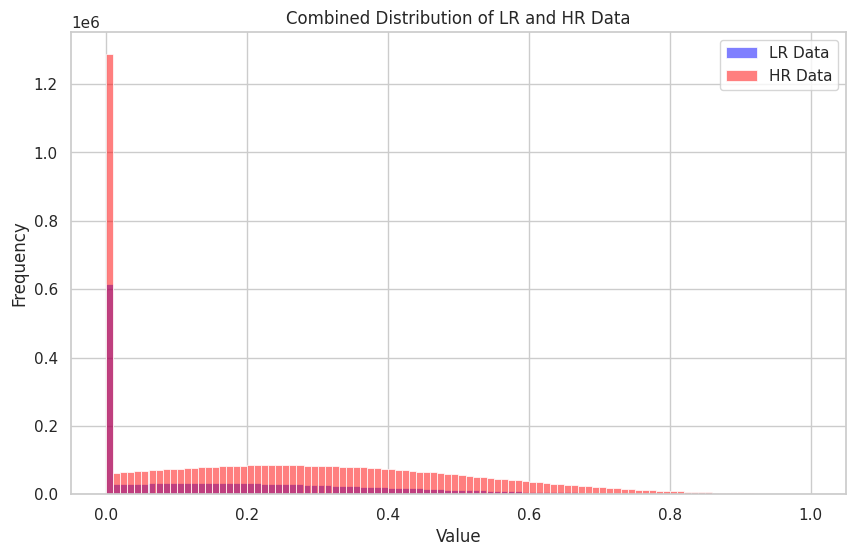

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Setting the Seaborn theme for nice aesthetics
sns.set_theme(style="whitegrid")

# Plotting histograms on the same figure for comparison
plt.figure(figsize=(10, 6))

# Correctly flattening the 2D pandas DataFrame to 1D numpy arrays and plotting
sns.histplot(lr_array.flatten(), bins=100, color='blue', alpha=0.5, label='LR Data')
sns.histplot(hr_array.flatten(), bins=100, color='red', alpha=0.5, label='HR Data')

# Adding titles and labels
plt.title('Combined Distribution of LR and HR Data')
plt.xlabel('Value')
plt.ylabel('Frequency')

# Adding a legend to differentiate between LR and HR data
plt.legend()

plt.show()


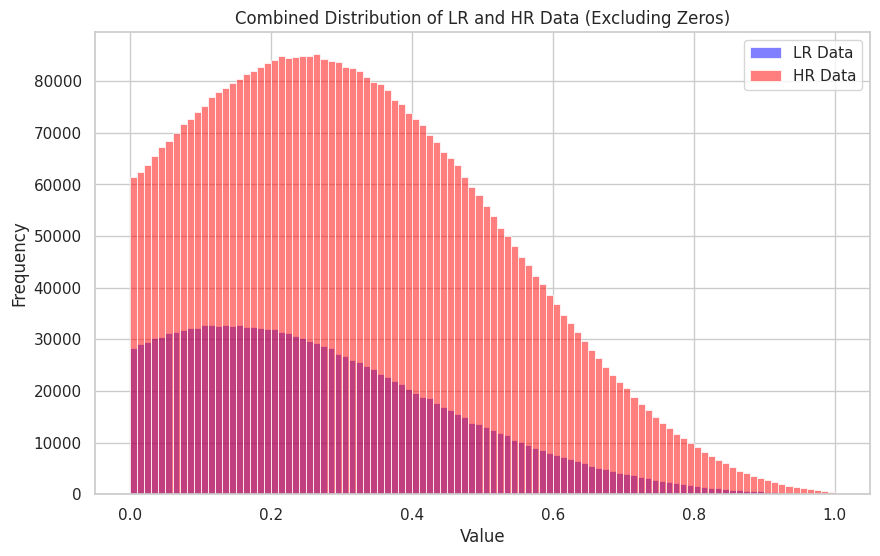

In [ ]:
# Setting the Seaborn theme for aesthetics
sns.set_theme(style="whitegrid")

# Plotting histograms on the same figure for comparison, excluding zeros
plt.figure(figsize=(10, 6))

# Making histograms semi-transparent with alpha and using a higher bin count for finer detail
# We filter out the zeros using lr_array[lr_array > 0].flatten() and hr_array[hr_array > 0].flatten()
sns.histplot(lr_array[lr_array > 0].flatten(), bins=100, color='blue', alpha=0.5, label='LR Data')
sns.histplot(hr_array[hr_array > 0].flatten(), bins=100, color='red', alpha=0.5, label='HR Data')

# Adding titles and labels
plt.title('Combined Distribution of LR and HR Data (Excluding Zeros)')
plt.xlabel('Value')
plt.ylabel('Frequency')

# Adding a legend to differentiate between LR and HR data
plt.legend()

# Display the plot
plt.show()

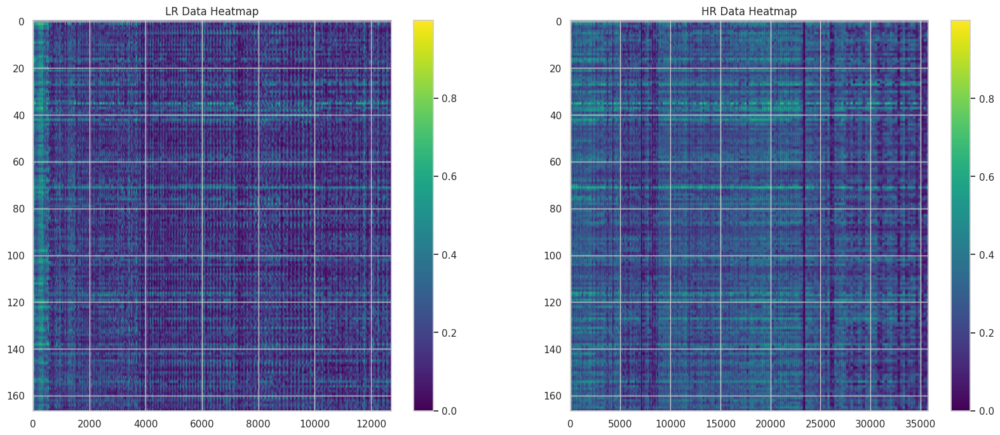

In [ ]:
plt.figure(figsize=(20, 8))

# Heatmap of a subset of LR data
plt.subplot(1, 2, 1)
plt.imshow(lr_array, aspect='auto', cmap='viridis')  # Adjust subset size as needed
plt.colorbar()
plt.title('LR Data Heatmap')

# Heatmap of a subset of HR data
plt.subplot(1, 2, 2)
plt.imshow(hr_array, aspect='auto', cmap='viridis')  # Adjust subset size as needed
plt.colorbar()
plt.title('HR Data Heatmap')

plt.show()

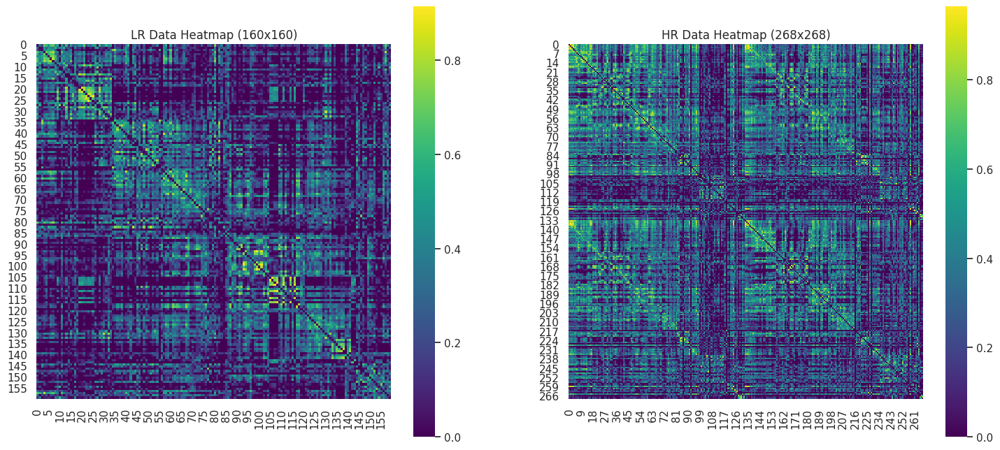

In [ ]:
i = 0

import numpy as np

class MatrixVectorizer:
    """
    A class for transforming between matrices and vector representations.

    This class provides methods to convert a symmetric matrix into a vector (vectorize)
    and to reconstruct the matrix from its vector form (anti_vectorize), focusing on
    vertical (column-based) traversal and handling of elements.
    """

    def __init__(self):
        """
        Initializes the MatrixVectorizer instance.

        The constructor currently does not perform any actions but is included for
        potential future extensions where initialization parameters might be required.
        """
        pass

    @staticmethod
    def vectorize(matrix, include_diagonal=False):
        """
        Converts a matrix into a vector by vertically extracting elements.

        This method traverses the matrix column by column, collecting elements from the
        upper triangle, and optionally includes the diagonal elements immediately below
        the main diagonal based on the include_diagonal flag.

        Parameters:
        - matrix (numpy.ndarray): The matrix to be vectorized.
        - include_diagonal (bool, optional): Flag to include diagonal elements in the vectorization.
          Defaults to False.

        Returns:
        - numpy.ndarray: The vectorized form of the matrix.
        """
        # Determine the size of the matrix based on its first dimension
        matrix_size = matrix.shape[0]

        # Initialize an empty list to accumulate vector elements
        vector_elements = []

        # Iterate over columns and then rows to collect the relevant elements
        for col in range(matrix_size):
            for row in range(matrix_size):
                # Skip diagonal elements if not including them
                if row != col:
                    if row < col:
                        # Collect upper triangle elements
                        vector_elements.append(matrix[row, col])
                    elif include_diagonal and row == col + 1:
                        # Optionally include the diagonal elements immediately below the diagonal
                        vector_elements.append(matrix[row, col])

        return np.array(vector_elements)

    @staticmethod
    def anti_vectorize(vector, matrix_size, include_diagonal=False):
        """
        Reconstructs a matrix from its vector form, filling it vertically.

        The method fills the matrix by reflecting vector elements into the upper triangle
        and optionally including the diagonal elements based on the include_diagonal flag.

        Parameters:
        - vector (numpy.ndarray): The vector to be transformed into a matrix.
        - matrix_size (int): The size of the square matrix to be reconstructed.
        - include_diagonal (bool, optional): Flag to include diagonal elements in the reconstruction.
          Defaults to False.

        Returns:
        - numpy.ndarray: The reconstructed square matrix.
        """
        # Initialize a square matrix of zeros with the specified size
        matrix = np.zeros((matrix_size, matrix_size))

        # Index to keep track of the current position in the vector
        vector_idx = 0

        # Fill the matrix by iterating over columns and then rows
        for col in range(matrix_size):
            for row in range(matrix_size):
                # Skip diagonal elements if not including them
                if row != col:
                    if row < col:
                        # Reflect vector elements into the upper triangle and its mirror in the lower triangle
                        matrix[row, col] = vector[vector_idx]
                        matrix[col, row] = vector[vector_idx]
                        vector_idx += 1
                    elif include_diagonal and row == col + 1:
                        # Optionally fill the diagonal elements after completing each column
                        matrix[row, col] = vector[vector_idx]
                        matrix[col, row] = vector[vector_idx]
                        vector_idx += 1

        return matrix



# Now, we use the function for LR and HR data with the right flags
lr_vector = lr_dataset.iloc[i]
hr_vector = hr_dataset.iloc[i]

# Now, we use the function for LR and HR data with the right flags
lr_matrix = MatrixVectorizer.anti_vectorize(lr_vector, 160, include_diagonal=False)
hr_matrix = MatrixVectorizer.anti_vectorize(hr_vector, 268, include_diagonal=False)

# Plot the heatmaps
plt.figure(figsize=(18, 8))

# LR Data Heatmap
plt.subplot(1, 2, 1)
sns.heatmap(lr_matrix, square=True, cmap='viridis')
plt.title('LR Data Heatmap (160x160)')

# HR Data Heatmap
plt.subplot(1, 2, 2)
sns.heatmap(hr_matrix, square=True, cmap='viridis')
plt.title('HR Data Heatmap (268x268)')

plt.show()

# Baseline Model

Creating a simple baseline model to make comparisons from.

# Prepare Dataset

In [ ]:
lr_matrices = [MatrixVectorizer.anti_vectorize(lr_vector, 160, include_diagonal=False) for _, lr_vector in lr_dataset.iterrows()]
hr_matrices = [MatrixVectorizer.anti_vectorize(hr_vector, 260, include_diagonal=False) for _, hr_vector in hr_dataset.iterrows()]

In [ ]:
!pip install torch_geometric

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 14.5 MB/s eta 0:00:00


In [ ]:
lr_matrices[0].shape, hr_matrices[0].shape

((160, 160), (260, 260))

In [ ]:
!pip install wandb

In [ ]:
import wandb

sweep_config = {
    'method': 'random', #grid, random
    'metric': {
      'name': 'val_train_average',
      'goal': 'minimise'
    },
    'parameters': {
        'learning_rate': {
            'values': [1e-5, 1e-4, 1e-3]
        },
        'batch_size': {
            'values': [8, 16, 32]
        },
        'starting_features': {
            'values':  ['identity_matrix', 'all_ones']
        },
          # only if we have all_ones
        'num_features': {
            'values': [8, 10, 16, 32]
        },

        'epochs': {
            'values': [10, 20, 40, 60, 80, 100]
        },
        'loss_function': {
            'values': ['mae', 'mse', 'huber', 'focal']
        },
        'optimizer': {
            'values': ['sgd', 'adam', 'rmsprop', 'adamw', 'adagrad']
        }
    }
}
sweep_defaults = {
        'learning_rate': 1e-5,
        'batch_size': 32,
        'epochs': 2,
        'starting_features': 'identity_matrix',
        'num_features': 8,
        'epochs': 8,
        'loss_function': 'mae',
        'optimizer': 'adam'
}

sweep_id = wandb.sweep(sweep_config)

wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. 'minimise' is not one of ['minimize', 'maximize']


Create sweep with ID: wmgft08v
Sweep URL: https://wandb.ai/sp1d5r/uncategorized/sweeps/wmgft08v


In [ ]:
from torch_geometric.data import Data, DataLoader
import torch
from sklearn.model_selection import train_test_split
from torch_geometric.data import Data, DataLoader


def create_graph_data_object(lr_connectivity_matrix, index, x):
    # Assuming connectivity_matrix is a numpy array or similar
    # Find non-zero entries which represent edges (i, j) and their weights w
    edge_indices = torch.tensor(np.nonzero(lr_connectivity_matrix), dtype=torch.long)
    edge_weights = torch.tensor(lr_connectivity_matrix[edge_indices[0], edge_indices[1]], dtype=torch.float)

    data = Data(
        x=x,
        y=index,
        edge_index=edge_indices,
        edge_attr=edge_weights,
        num_nodes=lr_connectivity_matrix.shape[0]
      )

    return data



def return_data():
  """
    Returns the dataset for the
  """
  starting_features = wandb.config.starting_features
  x = None
  num_features = wandb.config.num_features

  if starting_features == "identity_matrix":
    x = torch.eye(160, dtype=torch.float)
    num_features = 160
  elif starting_features == "all_ones":
    x = torch.ones((160, num_features), dtype=torch.float)
  else:
    raise Exception("FAILED")


  dataset = [create_graph_data_object(lr_matrix, index, x) for index, lr_matrix in enumerate(lr_matrices)]
  hr_mapping = {index: torch.tensor(hr_matrix) for index, hr_matrix in enumerate(hr_matrices)}

  print("NUMBER OF FEATURES:", num_features)
  print("STARTING FEATURE:", starting_features)

  return dataset, hr_mapping, num_features


def return_dataloader(dataset):
  """
  """
  batch_size = wandb.config.batch_size
  print("BATCH SIZE:", batch_size)

  # Splitting the data lists into training and validation sets
  training_dataset, validation_dataset = train_test_split(dataset, test_size=0.2, random_state=42)

  # Creating DataLoaders for the training sets
  train_loader = DataLoader(training_dataset, batch_size=batch_size, shuffle=True)

  # Creating DataLoaders for the validation sets
  val_loader = DataLoader(validation_dataset, batch_size=batch_size, shuffle=False)

  return train_loader, val_loader

# Create Base Architecture

In [ ]:
import torch
import torch.nn as nn
from torch_geometric.nn import GCNConv, global_mean_pool
import torch.nn.functional as F
import torch.optim as optim

class GraphSuperResolutionGNN(nn.Module):
    def __init__(self, num_nodes_lr, num_nodes_hr, num_of_features):
        super(GraphSuperResolutionGNN, self).__init__()
        self.num_of_features = num_of_features
        self.num_nodes_hr = num_nodes_hr
        self.num_nodes_lr = num_nodes_lr

        # x = (n, num_nodes_lr) = (n, 160) features
        self.conv_layers = nn.ModuleList()

        # Dynamically create convolutional layers
        current_features = num_of_features
        while current_features < 512:
            next_features = min(current_features * 2, 512)
            self.conv_layers.append(GCNConv(current_features, next_features))
            current_features = next_features

        # Project LR features to HR dimensions
        self.node_dim_upscale = nn.Parameter(torch.randn(num_nodes_lr, num_nodes_hr))

        self.edge_predictor = nn.Linear(512*2, 1) # take the representations and predict the strength

    def forward(self, data):
        x, edge_index, batch = data.x, data.edge_index, data.batch

        # x = (batch x 160, 160), edge_index
        # print('Input Shape', x.shape)
        for conv in self.conv_layers:
            x = F.relu(conv(x, edge_index))

        #  x = (batch x 160, 512)
        all_predictions = []

        for b in range(batch.max() + 1):
            node_indices = torch.where(batch == b)[0]
            nodes_current_graph = torch.matmul(self.node_dim_upscale.T, x[node_indices])

            # Create all pairs using broadcasting
            ni = nodes_current_graph.unsqueeze(1).expand(-1, nodes_current_graph.size(0), -1)
            nj = nodes_current_graph.unsqueeze(0).expand(nodes_current_graph.size(0), -1, -1)

            # Concatenate features of all pairs
            node_pair_features = torch.cat((ni, nj), dim=-1)

            # Flatten the pair features to have a shape: [num_pairs, feature_length*2]
            node_pair_features_flat = node_pair_features.view(-1, 512 * 2)

            # Predict edge existence for all pairs
            edge_predictions = torch.sigmoid(self.edge_predictor(node_pair_features_flat))

            # Reshape predictions to form a matrix for the current graph
            num_nodes_current_graph = nodes_current_graph.size(0)
            graph_predictions_matrix = edge_predictions.view(num_nodes_current_graph, num_nodes_current_graph)

            all_predictions.append(graph_predictions_matrix)

        # Stack all graph prediction matrices together
        predictions_matrix = torch.stack(all_predictions)

        return predictions_matrix


def mae_loss(output, target):
    """
    Computes the Mean Absolute Error (MAE) between the predicted and target adjacency matrices.

    Parameters:
    - output: Tensor of shape [batch_size, num_nodes_hr, num_nodes_hr] representing the predicted adjacency matrices.
    - target: Tensor of shape [batch_size, num_nodes_hr, num_nodes_hr] representing the true HR adjacency matrices.

    Returns:
    - loss: The MAE loss as a single scalar tensor.
    """
    loss = torch.mean(torch.abs(output - target))
    return loss


def mse_loss(output, target):
    """
    Computes the Mean Squared Error (MSE) between predicted and target adjacency matrices.

    Parameters are the same as in mae_loss.
    """
    loss = torch.mean((output - target) ** 2)
    return loss

def huber_loss(output, target, delta=1.0):
    """
    Computes the Huber loss between predicted and target adjacency matrices.

    Parameters:
    - output, target: Tensors of shape [batch_size, num_nodes_hr, num_nodes_hr].
    - delta: The threshold at which to switch from quadratic to linear loss.

    Returns:
    - loss: The Huber loss as a single scalar tensor.
    """
    abs_error = torch.abs(output - target)
    quadratic = torch.min(abs_error, torch.tensor([delta]).to(abs_error.device))
    linear = abs_error - quadratic
    loss = 0.5 * quadratic ** 2 + delta * linear
    return torch.mean(loss)

def focal_loss(output, target, alpha=0.25, gamma=2.0, epsilon=1e-8):
    """
    Computes the Focal loss for binary classification of edges, handling probabilities.
    """
    output = torch.clamp(output, min=epsilon, max=1-epsilon)  # Prevent log(0)
    bce_loss = -(target * torch.log(output) + (1 - target) * torch.log(1 - output))
    pt = torch.exp(-bce_loss)
    loss = alpha * (1 - pt) ** gamma * bce_loss
    return loss.mean()


def return_loss():
    """Return the corresponding loss function based on loss_name."""
    loss_name = wandb.config.loss_function
    print("LOSS FUNCTION: ", loss_name)
    if loss_name == 'mae':
        return mae_loss  # Mean Absolute Error
    elif loss_name == 'mse':
        return mse_loss
    elif loss_name == 'huber':
        return huber_loss  # Custom Huber loss
    elif loss_name == 'focal':
        return focal_loss  # Custom Focal loss
    else:
        raise ValueError("Unknown loss function")

def return_model(num_features):
    num_nodes_lr = 160
    num_nodes_hr = 260 # The number of nodes in your HR graphs
    model = GraphSuperResolutionGNN(num_nodes_lr=num_nodes_lr, num_nodes_hr=num_nodes_hr, num_of_features=num_features).to(device)
    return model



def return_optimizer(optimizer_name, model_params, learning_rate):
    print("USING OPTIMIZER:", optimizer_name)
    print("USING LERANING RATE:", learning_rate)
    if optimizer_name == 'sgd':
        return optim.SGD(model_params, lr=learning_rate)
    elif optimizer_name == 'adam':
        return optim.Adam(model_params, lr=learning_rate)
    elif optimizer_name == 'rmsprop':
        return optim.RMSprop(model_params, lr=learning_rate)
    elif optimizer_name == 'adamw':
        return optim.AdamW(model_params, lr=learning_rate)
    elif optimizer_name == 'adagrad':
        return optim.Adagrad(model_params, lr=learning_rate)
    else:
        raise ValueError("Unknown optimizer")



In [ ]:
# Evaluation Metrics
import numpy as np
from sklearn.metrics import mean_absolute_error, mean_squared_error, roc_auc_score

def calculate_validation_losses(output, target, threshold=0.5):
    """
    Calculates various validation loss metrics between binarized target and predictions.

    Parameters are the same as in the original function, with an added threshold.
    """

    # Calculate loss metrics
    losses = {
        'MAE': mae_loss(output, target).item(),
        'MSE': mse_loss(output, target).item(),
        'HUBERLOSS': huber_loss(output, target).item(),
        'FOCALLOSS': focal_loss(output, target).item()
    }

    # Ensure inputs are numpy arrays
    if not isinstance(target, np.ndarray):
        target = target.detach().cpu().numpy()
    if not isinstance(output, np.ndarray):
        output = output.detach().cpu().numpy()

    # Flatten arrays
    target_flat = target.flatten()
    outputs_flat = output.flatten()

    # Binarize based on the threshold
    target_binary = (target_flat >= threshold).astype(int)
    outputs_binary = (outputs_flat >= threshold).astype(int)

    # Calculate AUC if applicable
    if np.unique(target_binary).size > 1:  # Ensure both classes are present
        losses['AUC'] = roc_auc_score(target_binary, outputs_binary)
    else:
        losses['AUC'] = np.nan  # Not applicable

    return losses


In [ ]:
import torch.optim as optim
from torch_geometric.utils import to_dense_batch, to_dense_adj
from torch_geometric.data import Batch


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


def train():


    wandb.init()

    # Load Datasets
    dataset, hr_mapping, num_features = return_data()
    train_loader, val_loader = return_dataloader(dataset)

    # Load Model
    model = return_model(num_features)
    model.to(device)

    # load loss function
    loss_fun = return_loss()

    optimizer_name = wandb.config.optimizer
    learning_rate = wandb.config.learning_rate
    optimizer = return_optimizer(optimizer_name, model.parameters(), learning_rate)

    num_epochs = 20

    for epoch in range(num_epochs):
        model.train()  # Set model to training mode
        total_loss = 0

        for batch_idx, data in enumerate(train_loader):  # Assuming your DataLoader correctly batches your Data objects
              data = data.to(device)
              optimizer.zero_grad()
              # print("Data Shape - ", data)
              output = model(data)

              index = [int(i) for i in data.y]
              target = [hr_mapping[i] for i in index]
              target = torch.stack(target).to(device)
              # print(target.shape, output.shape)
              loss = loss_fun(output, target)
              print(f"For batch {batch_idx}, we have loss{loss.item()}")
              wandb.log({'train_batch_loss': loss.item()})
              loss.backward()
              optimizer.step()


              total_loss += loss.item()  # Accumulate the loss

        # Print average loss for the epoch
        print(f'Epoch {epoch+1}/{num_epochs}, Loss: {total_loss/len(train_loader)}')
        wandb.log({'train_epoch_loss': total_loss/len(train_loader)})

        # Assuming you've already defined or imported calculate_validation_losses function

        total_loss = 0
        model.eval()  # Set the model to evaluation mode

        accumulated_losses = {'MAE': 0, 'MSE': 0, 'HUBERLOSS':0, 'FOCALLOSS':0,  'AUC': 0}
        num_batches = 0

        for batch_idx, data in enumerate(val_loader):
            data = data.to(device)

            with torch.no_grad():  # Do not calculate gradients
                output = model(data)

            # Assuming hr_mapping is a dictionary mapping indices to target matrices
            # and data.y contains the indices for selecting the right target matrices
            index = [int(i) for i in data.y]
            target = [hr_mapping[i] for i in index]
            target = torch.stack(target).to(device)

            # Calculate validation losses for the current batch
            losses = calculate_validation_losses(target, output)
            batch_losses = {f"val_{key}_batch": value for key, value in losses.items()}
            wandb.log(batch_losses)

            # Accumulate the losses from this batch
            for key in accumulated_losses.keys():
                accumulated_losses[key] += losses.get(key, 0)

            num_batches += 1

        # Calculate the average losses over all batches
        average_losses = {k: v / num_batches for k, v in accumulated_losses.items()}
        epoch_losses = {f"val_{key}_epoch": value for key, value in average_losses.items()}
        wandb.log(epoch_losses)

        # Print the average losses for the epoch

        print(f'Validation Losses: {average_losses}')

    print("Training complete!")
    del model
    del train_loader
    torch.cuda.empty_cache()

    # Call the garbage collector
    gc.collect()

    # Ensure CUDA is aware of the freed memory
    torch.cuda.empty_cache()

In [ ]:
wandb.agent(sweep_id,function=train)

wandb: Agent Starting Run: 3zkrtf4h with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones
wandb: Currently logged in as: sp1d5r. Use `wandb login --relogin` to force relogin


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2703834140439222
For batch 1, we have loss0.2783509623283473
For batch 2, we have loss0.27586586876007946
For batch 3, we have loss0.2808137605884635
For batch 4, we have loss0.2684716701317489
Epoch 1/20, Loss: 0.2747771351705123
Validation Losses: {'MAE': 0.28266457870441997, 'MSE': 0.10754014062622973, 'HUBERLOSS': 0.053770070313114864, 'FOCALLOSS': 0.5806750939011729, 'AUC': 0.5067351668678528}
For batch 0, we have loss0.2776276468735426
For batch 1, we have loss0.2683418838337936
For batch 2, we have loss0.275556792194235
For batch 3, we have loss0.2817808404309918
For batch 4, we have loss0.2778060388096693
Epoch 2/20, Loss: 0.27622264042844646
Validation Losses: {'MAE': 0.28250729979721595, 'MSE': 0.10742152791918268, 'HUBERLOSS': 0.05371076395959134, 'FOCALLOSS': 0.5804005579080289, 'AUC': 0.5067607444000266}
For batch 0, we have loss0.28043321380657626
For batch 1, we have loss0.27554012819991086
For batch 2, we have loss0.26345131301329283
For batch

train_batch_loss,▃▅▆▅▇▁▅▆▆▁▃█▂▆▆▄▅▂▃▃█▄▆▇▄▃▄▄▆▃▄▅▂▅▄█▇▃▆▅
train_epoch_loss,▃▄▆▃▅▃▃█▄▃▂▄▃▃▃▁▆▄▁▃
val_AUC_batch,▁▇▁▇▁▇▂▇▂▇▂█▂█▂█▂█▂█▂▇▂▇▂▇▂█▂▇▂▇▂▇▂▇▃▇▂▇
val_AUC_epoch,▁▁▁▂▅▆▆▇█▆▆▅▇█▇▇▆▆▆▅
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▂█▂█▂█▂█▂█▂█▂█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▂█▂█▂█▂█▂█▂█▂█▂█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: ja4p2saa with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.11276887010188545
For batch 1, we have loss0.1053602726990231
For batch 2, we have loss0.10560968104165301
For batch 3, we have loss0.10646405926520007
For batch 4, we have loss0.11816052956997537
Epoch 1/20, Loss: 0.1096726825355474
Validation Losses: {'MAE': 0.2894379830596424, 'MSE': 0.11243043983230992, 'HUBERLOSS': 0.05621521991615496, 'FOCALLOSS': 0.5942241188054724, 'AUC': 0.4982386057931056}
For batch 0, we have loss0.10831780946444741
For batch 1, we have loss0.11035010646270677
For batch 2, we have loss0.10479401901973788
For batch 3, we have loss0.10840948616402248
For batch 4, we have loss0.10718175558188359
Epoch 2/20, Loss: 0.10781063533855964
Validation Losses: {'MAE': 0.2894283357973484, 'MSE': 0.11242386909551359, 'HUBERLOSS': 0.056211934547756796, 'FOCALLOSS': 0.594216176965772, 'AUC': 0.4978425832184191}
For batch 0, we have loss0.11046368770680225
For batch 1, we have loss0.10799928122703253
For batch 2, we have loss0.10943113462504353
For

train_batch_loss,▇▃▄▃▆▅▃▅▄▇▆▄▃▄▁▆▃▇▆▄▅▁▅▄▃▇▅▃▂▃▃▅▃▅▄▃▄▄▁█
train_epoch_loss,▆▄▆▃▅▆▇▃▆▇▃▄▁▅▆▇█▅▂▆
val_AUC_batch,█▄█▃█▃█▃▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁
val_AUC_epoch,█▆▆▅▄▄▄▄▃▄▄▃▂▂▁▁▁▁▂▂
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: 25dqhab3 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.3077355931589042


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.27543668079786565
For batch 2, we have loss0.27576696677194307
For batch 3, we have loss0.27805800835584
For batch 4, we have loss0.2831555448662195
For batch 5, we have loss0.27204264967622055
For batch 6, we have loss0.2786586079260145
For batch 7, we have loss0.26624662036766855
For batch 8, we have loss0.2786168316140143
Epoch 1/20, Loss: 0.27952416705940997
Validation Losses: {'MAE': 0.2807177994948075, 'MSE': 0.10765102195854111, 'HUBERLOSS': 0.053825510979270554, 'FOCALLOSS': 0.561354241455046, 'AUC': 0.49791254281152586}
For batch 0, we have loss0.27058973971401
For batch 1, we have loss0.2920051973580317
For batch 2, we have loss0.27386540378269286
For batch 3, we have loss0.26759214720367286
For batch 4, we have loss0.2781728252197339
For batch 5, we have loss0.2741818636570831
For batch 6, we have loss0.2772273989714696
For batch 7, we have loss0.2836895999871388
For batch 8, we have loss0.2885413171497252
Epoch 2/20, Loss: 0.278429499227062
Valida

train_batch_loss,▅▅▄▆█▁▇▅▆▅▅▆▅▅▅▅▅▆▄▃▅▆▄▅▃▂▆▃▆▂▁▃▂▁▄▄▁▃▃▂
train_epoch_loss,██▇▇▆▆▆▆▅▅▄▄▄▃▃▂▂▂▁▁
val_AUC_batch,▂▁▃▁▃▁▃▂▃▂▃▂▃▂▃▂▃▂▄▂▄▂▄▂▄▂▄▂▃▁▃▁▃▂▃▁▃▁▃█
val_AUC_epoch,▁▃▂▄▆▇▆▇▇▇▇█▇█▇▇▇▅▆▅
val_FOCALLOSS_batch,▇▄▇▄▇▄▆▃▆▃▆▃▆▃▆▃▆▃▅▃▆▃▅▂▅▂▅▂▅▂▄▂▄▁▄▁▃▁▄█
val_FOCALLOSS_epoch,███▇▇▇▆▆▆▅▆▄▅▃▄▂▂▂▁▂
val_HUBERLOSS_batch,█▄█▄█▄▇▄▇▄▇▄▇▄▇▃▆▃▆▃▆▂▆▃▅▂▅▂▄▁▄▂▄▁▄▁▃▁▃▅
val_HUBERLOSS_epoch,█▇▇▇▇▇▇▆▆▅▅▆▄▄▃▃▃▂▂▁
val_MAE_batch,█▄█▄█▄▇▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▆▃▅▂▅▂▅▂▄▂▄▁▄▁▃▁▃▆
val_MAE_epoch,███▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▁▁
val_MSE_batch,█▄█▄█▄▇▄▇▄▇▄▇▄▇▃▆▃▆▃▆▂▆▃▅▂▅▂▄▁▄▂▄▁▄▁▃▁▃▅


wandb: Agent Starting Run: 44v2cokt with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04248966658262069


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04253082932890059
For batch 2, we have loss0.04239058744449417
For batch 3, we have loss0.04250851611549837
For batch 4, we have loss0.042472023161174294
For batch 5, we have loss0.04244487090439389
For batch 6, we have loss0.04252334046769026
For batch 7, we have loss0.04256315230772294
For batch 8, we have loss0.04241008478067487
Epoch 1/20, Loss: 0.04248145234368556
Validation Losses: {'MAE': 0.279534533666776, 'MSE': 0.10565471458179426, 'HUBERLOSS': 0.05282735729089713, 'FOCALLOSS': 0.5620211663872561, 'AUC': 0.4989722052224781}
For batch 0, we have loss0.042417518572815976
For batch 1, we have loss0.04258268218834774
For batch 2, we have loss0.04250747160114039
For batch 3, we have loss0.04242479606187637
For batch 4, we have loss0.04253919105451413
For batch 5, we have loss0.042366729343960866
For batch 6, we have loss0.04246331080668157
For batch 7, we have loss0.04247960617538859
For batch 8, we have loss0.04256223670986555
Epoch 2/20, Loss: 0.042482

train_batch_loss,▇▅▄▇▄▄▆▅█▄▅▃▇▅▄▄▅▃▅▅▄▆▅▅▇▇▄▅▆▅▅▅▅▇▄▃▅▆▄▁
train_epoch_loss,██▇▅▆▅▅▅▄▄▄▂▃▃▃▁▂▃▄▁
val_AUC_batch,▁▅▁▅▂▆▂▆▃▇▃▇▃▇▃▇▄█▄█▄█▄█▄█▄█▄█▄█▄█▄█▄█▄▅
val_AUC_epoch,▃▂▃▁▂▂▂▃▄▅▆▆▆▅▅▅▆▇██
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▇▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▆▅▅▅▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: f90d0uzn with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.10761075710532617


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.23366105805905468
For batch 2, we have loss0.10862518327608235
For batch 3, we have loss0.10251406131740763
For batch 4, we have loss0.09450140424906808
For batch 5, we have loss0.1091449346216234
For batch 6, we have loss0.11005104975142067
For batch 7, we have loss0.09978114474599174
For batch 8, we have loss0.09574950030137463
Epoch 1/20, Loss: 0.11795989926970549
Validation Losses: {'MAE': 0.26976207973594085, 'MSE': 0.09980113497970171, 'HUBERLOSS': 0.049900567489850854, 'FOCALLOSS': 0.5373694296850405, 'AUC': 0.49980744809266336}
For batch 0, we have loss0.10044397808202134
For batch 1, we have loss0.09443414001031712
For batch 2, we have loss0.0920241356149183
For batch 3, we have loss0.08996145600503458
For batch 4, we have loss0.10077514509976111
For batch 5, we have loss0.09697181749254523
For batch 6, we have loss0.0905930499281604
For batch 7, we have loss0.08595271878748775
For batch 8, we have loss0.08265139522400564
Epoch 2/20, Loss: 0.09264531

train_batch_loss,█▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▆▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁
val_AUC_batch,▅▅▅▄▅▄▅▄▅▄▄▄▅▅▅▅▅▅▆▅▇▇██▅▄▆▄▂▁▂▁▂▁
val_AUC_epoch,▄▄▄▄▄▄▄▄▅▅▇█▅▃▁▁▁
val_FOCALLOSS_batch,█▇█▇▆▅▅▄▄▄▄▄▄▃▄▃▃▂▂▁▃▂▃▂▄▄▃▂▃▃▃▂▁▁▃▃▄▃▂▃
val_FOCALLOSS_epoch,██▅▅▄▄▄▄▂▂▃▃▄▂▃▃▁▃▄▂
val_HUBERLOSS_batch,█▇▇▆▅▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▂▁▁▂▂▁▁
val_HUBERLOSS_epoch,█▇▅▄▃▃▃▂▂▂▂▁▂▁▁▁▁▁▂▁
val_MAE_batch,█▇▇▆▅▅▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▂▂▂▁▁▁▂▂▁▂▂▁▁
val_MAE_epoch,█▇▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▂▁
val_MSE_batch,█▇▇▆▅▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▂▁▁▂▂▁▁


wandb: Agent Starting Run: o1iex5ip with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05627334645537769
For batch 1, we have lossinf
For batch 2, we have lossnan
For batch 3, we have lossnan
For batch 4, we have lossnan
Epoch 1/20, Loss: nan
Validation Losses: {'MAE': nan, 'MSE': nan, 'HUBERLOSS': nan, 'FOCALLOSS': nan, 'AUC': nan}
For batch 0, we have lossnan
For batch 1, we have lossnan
For batch 2, we have lossnan
For batch 3, we have lossnan
For batch 4, we have lossnan
Epoch 2/20, Loss: nan
Validation Losses: {'MAE': nan, 'MSE': nan, 'HUBERLOSS': nan, 'FOCALLOSS': nan, 'AUC': nan}
For batch 0, we have lossnan
For batch 1, we have lossnan
For batch 2, we have lossnan
For batch 3, we have lossnan
For batch 4, we have lossnan
Epoch 3/20, Loss: nan
Validation Losses: {'MAE': nan, 'MSE': nan, 'HUBERLOSS': nan, 'FOCALLOSS': nan, 'AUC': nan}
For batch 0, we have lossnan
For batch 1, we have lossnan
For batch 2, we have lossnan
For batch 3, we have lossnan
For batch 4, we have lossnan
Epoch 4/20, Loss: nan
Validation Losses: {'MAE': nan, 'MSE': n

train_batch_loss,▁
train_batch_loss,nan
train_epoch_loss,nan
val_AUC_batch,nan
val_AUC_epoch,nan
val_FOCALLOSS_batch,nan
val_FOCALLOSS_epoch,nan
val_HUBERLOSS_batch,nan
val_HUBERLOSS_epoch,nan
val_MAE_batch,nan
val_MAE_epoch,nan


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 1iuxusnc with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.2930470803359052
For batch 1, we have loss0.27153557571277503
For batch 2, we have loss0.28049484468945785
For batch 3, we have loss0.27752443392841286
For batch 4, we have loss0.2683658763615169
For batch 5, we have loss0.29972595767074994
For batch 6, we have loss0.28994043885943155
For batch 7, we have loss0.2828514235360717
For batch 8, we have loss0.2767935611685079
Epoch 1/20, Loss: 0.2822532435847587
Validation Losses: {'MAE': 0.2850991080542325, 'MSE': 0.1096375316224732, 'HUBERLOSS': 0.0548187658112366, 'FOCALLOSS': 0.5716408856280237, 'AUC': 0.49939438361256894}
For batch 0, we have loss0.2936035074608921
For batch 1, we have loss0.2831992296706037
For batch 2, we have loss0.28002836187681973
For batch 3, we have loss0.28694498287339004
For batch 4, we have loss0.2815639743110073
For batch 5, we have loss0.28663008

train_batch_loss,▃▇▆▄▅▆▅▄▆▄▄█▄▃▃▂▅▅▁▆▄▄▄▅▆▆▅▅▃▄▅▃▅▃▂▂▆▅▃█
train_epoch_loss,▅▄▅▁▂█▂▄▁▆▅▃▆▅▃▅▄▃▂▆
val_AUC_batch,▇▂█▂▇▁█▂▇▂▇▂▇▂█▂█▂█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▁
val_AUC_epoch,▂▄▁▄▄▄▃▂▃▅▅▆▆▇▇▆████
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇█▇▆▆▆▆▅▄▄▄▃▃▃▃▂▁▂▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▄▄▄▃▃▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: tvzm6aca with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones
wandb: W&B API key is configured. Use `wandb login --relogin` to force relogin


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.05321780104812588


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.06157953765578348
For batch 2, we have loss0.0584501664250083
For batch 3, we have loss0.049999094761592325
For batch 4, we have loss0.05304029344640441
For batch 5, we have loss0.062185953781404554
For batch 6, we have loss0.055794383141456634
For batch 7, we have loss0.04706543925886867
For batch 8, we have loss0.05901314536669985
For batch 9, we have loss0.05618450747150442
For batch 10, we have loss0.05223297927618739
For batch 11, we have loss0.05578355753666817
For batch 12, we have loss0.062262239410611986
For batch 13, we have loss0.053851420964291165
For batch 14, we have loss0.05424957067831598
For batch 15, we have loss0.05335882075680265
For batch 16, we have loss0.05321997314504838
Epoch 1/20, Loss: 0.05538169906616319
Validation Losses: {'MAE': 0.28508591437894154, 'MSE': 0.11055046238061887, 'HUBERLOSS': 0.055275231190309436, 'FOCALLOSS': 0.5568644566941133, 'AUC': 0.5027097649114836}
For batch 0, we have loss0.05397379939983431
For batch 1, we

train_batch_loss,▂▄▄▃▅▄▄▆▂▄▅▁▄▂▆▂▂▃▆▁█▄▃▄▃▅▃▂▃▃▃▄▁▄▄▄▂▃▅▂
train_epoch_loss,█▆▅▄▃▂▃▂▂▂▂▂▂▂▂▁▂▂▂▁
val_AUC_batch,▂▃▂▄▁▄▁▄▁▅▁▅▁▄▁▄▁▄▁▄▁▅▂▅▂▅▅▅▅▅▅▅▅▅▅▅▅▄▅█
val_AUC_epoch,▁▂▂▃▄▄▅▅▆▆▇▇▇███████
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▁▁▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,█▆▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▆▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: pg3zzo6e with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.27172409524637187
For batch 1, we have loss0.2773060323862497
For batch 2, we have loss0.27595435642840105
For batch 3, we have loss0.28651553075904523
For batch 4, we have loss0.2836853766010201
Epoch 1/20, Loss: 0.2790370782842176
Validation Losses: {'MAE': 0.28464567945239433, 'MSE': 0.1092077412773649, 'HUBERLOSS': 0.05460387063868245, 'FOCALLOSS': 0.5849308879202124, 'AUC': 0.49857030229957444}
For batch 0, we have loss0.2742670978119028
For batch 1, we have loss0.28490803960056876
For batch 2, we have loss0.2752275105504334
For batch 3, we have loss0.27724179605950416
For batch 4, we have loss0.2711609726148364
Epoch 2/20, Loss: 0.2765610833274491
Validation Losses: {'MAE': 0.28435227989736267, 'MSE': 0.10892324255210542, 'HUBERLOSS': 0.05446162127605271, 'FOCALLOSS': 0.5846123716531814, 'AUC': 0.49885191052165295}
For batch 0, we have loss0.28020794126469184
For batch 1, we have loss0.2736996576916703
For batch 2, we have loss0.27422628005694566
For ba

train_batch_loss,▆▆▆▆▇▆▆▇▇▆▇▇▄█▅▇▅▅▇▇▇▅█▅█▆▅██▅█▅▇▇▇▅▆▅▆▁
train_epoch_loss,▇▅▆▁▂▇▇▄▆▄▂▃▂▇██▄▇▃▁
val_AUC_batch,▇▄▇▄█▅█▄█▃█▂▇▃▇▂▇▂▇▁▆▁▆▁▆▂▆▂▆▁▆▁▆▃▆▂▆▃▆▃
val_AUC_epoch,▅▆█▆▅▄▄▄▃▂▁▁▂▃▁▁▄▃▃▃
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁▁
val_HUBERLOSS_batch,▂█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,█▆▅▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▆▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁
val_MSE_batch,▂█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: euk9xcvf with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.043722445511751244
For batch 1, we have loss0.04401831104134412


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.043679267685253764
For batch 3, we have loss0.0436216722226824
For batch 4, we have loss0.04361462785692774
For batch 5, we have loss0.04366619474182722
For batch 6, we have loss0.04362137458353665
For batch 7, we have loss0.043585032905240385
For batch 8, we have loss0.04354627406441186
For batch 9, we have loss0.0435076447600758
For batch 10, we have loss0.04349926371376124
For batch 11, we have loss0.04352185579196083
For batch 12, we have loss0.04350884694545422
For batch 13, we have loss0.043498001926294876
For batch 14, we have loss0.04345916795543685
For batch 15, we have loss0.04343404166483383
For batch 16, we have loss0.04339981141870336
Epoch 1/20, Loss: 0.043582578517029194
Validation Losses: {'MAE': 0.2807526078385807, 'MSE': 0.106933316466904, 'HUBERLOSS': 0.053466658233452, 'FOCALLOSS': 0.5526666708065302, 'AUC': 0.4962265968685028}
For batch 0, we have loss0.043379429803520775
For batch 1, we have loss0.04338168860286427
For batch 2, we have l

train_batch_loss,████▇▇▇▇▇▆▆▆▆▆▆▅▅▄▅▄▄▅▅▄▄▃▃▃▃▅▃▂▂▂▁▃▁▄▂▁
train_epoch_loss,██▇▇▆▆▅▅▅▄▄▃▃▃▂▂▂▂▁▁
val_AUC_batch,▆▁▆▂▆▃▆▂▇▂▆▂▆█▇▇▇▇▇▇▇▆▇▆▆▇▆▇▆▇▆▇▇▇▆█▇▇▇▅
val_AUC_epoch,▁▃▄▄▄▄▅▅▅▄▄▄▄▄▄▄▄▆▇█
val_FOCALLOSS_batch,█▃█▂▇▂▇▂▇▂▆▁▆▄▆▄▅▄▅▃▅▃▄▃▄▂▃▂▃▂▄▃▂▁▃▂▂▁▁▆
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▄▂▃▂▁
val_HUBERLOSS_batch,█▅█▅▇▄▇▄▆▄▆▄▆▄▅▄▅▄▅▃▄▃▄▃▃▂▃▂▂▂▃▂▂▁▂▂▁▁▁▃
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▅▄▄▃▃▃▂▃▂▂▂▁
val_MAE_batch,█▅█▄▇▄▇▄▆▄▆▃▆▄▅▄▅▃▅▃▄▃▄▂▄▂▃▂▃▂▃▂▂▁▂▂▂▁▁▃
val_MAE_epoch,██▇▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▁
val_MSE_batch,█▅█▅▇▄▇▄▆▄▆▄▆▄▅▄▅▄▅▃▄▃▄▃▃▂▃▂▂▂▃▂▂▁▂▂▁▁▁▃


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: ol6541cs with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2838171837486655
For batch 1, we have loss0.27732302393254765
For batch 2, we have loss0.28145711721394256
For batch 3, we have loss0.2806949771292741
For batch 4, we have loss0.28146961701463724
Epoch 1/20, Loss: 0.28095238380781345
Validation Losses: {'MAE': 0.2875981356645184, 'MSE': 0.11110420188721676, 'HUBERLOSS': 0.05555210094360838, 'FOCALLOSS': 0.5909329656505857, 'AUC': 0.5011983381854503}
For batch 0, we have loss0.2725074376653265
For batch 1, we have loss0.2846313144041055
For batch 2, we have loss0.2728724337362808
For batch 3, we have loss0.2897802139783327
For batch 4, we have loss0.30342901347420387
Epoch 2/20, Loss: 0.28464408265164987
Validation Losses: {'MAE': 0.28758009385860706, 'MSE': 0.11109143335691082, 'HUBERLOSS': 0.05554571667845541, 'FOCALLOSS': 0.5909028859392709, 'AUC': 0.5012304704739432}
For batch 0, we have loss0.2740516530063375
For batch 1, we have loss0.2861385359831194
For batch 2, we have loss0.28500683653470704
For batc

train_batch_loss,▄▄▁▂▂▄▅▃▃▃▄▂▃▂▄▄▃▅▄▂▅▃▃▃▄▃▄▂▃▆▃▅▃▄▃▄▄▁▃█
train_epoch_loss,▄▇▂▃▇▇▄▁▃█▅▅▃▁▄▂▅▇▅▆
val_AUC_batch,▂▆▂▆▂▆▂▆▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁█▁█▁█▁█▁█▁█▁█
val_AUC_epoch,▁▁▂▃▄▄▅▅▆▅▆▆▆▇▇▆▆▇▇█
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: ijnfze8t with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.0450615709848642


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04489414294337103
For batch 2, we have loss0.044750423149839354
For batch 3, we have loss0.04456630610058119
For batch 4, we have loss0.04447226113858131
For batch 5, we have loss0.04447142127546166
For batch 6, we have loss0.04439594088751553
For batch 7, we have loss0.04429973820207787
For batch 8, we have loss0.04420125330317695
Epoch 1/20, Loss: 0.044568117553941015
Validation Losses: {'MAE': 0.28301089927182743, 'MSE': 0.10908222865812922, 'HUBERLOSS': 0.05454111432906461, 'FOCALLOSS': 0.5637028052990231, 'AUC': 0.5030349212883932}
For batch 0, we have loss0.0441579325096395
For batch 1, we have loss0.04423445456112605
For batch 2, we have loss0.04408490358813227
For batch 3, we have loss0.04408332508470881
For batch 4, we have loss0.04398121093247465
For batch 5, we have loss0.04400449462478272
For batch 6, we have loss0.04388618332133954
For batch 7, we have loss0.043898497163724695
For batch 8, we have loss0.04381431539610598
Epoch 2/20, Loss: 0.04401

train_batch_loss,█▇▆▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁
train_epoch_loss,█▆▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁
val_AUC_batch,▆▃▆▂▆▂▆▂▆▂▆▁▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▂▅▂▅▃▅█
val_AUC_epoch,█▇▆▅▅▄▃▃▂▂▃▂▂▁▂▂▁▁▁▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁▁
val_HUBERLOSS_batch,▆▂▆▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▆▅▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁
val_MAE_batch,▆▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁
val_MSE_batch,▆▂▆▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: c3pgj2tq with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10103944988270655
For batch 1, we have loss0.1039948045509248
For batch 2, we have loss0.10107646154103511
For batch 3, we have loss0.10661824628662585
For batch 4, we have loss0.10582707480060866
Epoch 1/20, Loss: 0.10371120741238019
Validation Losses: {'MAE': 0.28268724265662504, 'MSE': 0.10752040804015735, 'HUBERLOSS': 0.053760204020078674, 'FOCALLOSS': 0.5820278680740723, 'AUC': 0.5070491980941275}
For batch 0, we have loss0.1003793402112486
For batch 1, we have loss0.10336193690412768
For batch 2, we have loss0.10171311532596751
For batch 3, we have loss0.10906569722699534
For batch 4, we have loss0.09392158242669923
Epoch 2/20, Loss: 0.10168833441900767
Validation Losses: {'MAE': 0.282670657373097, 'MSE': 0.10750761299329004, 'HUBERLOSS': 0.05375380649664502, 'FOCALLOSS': 0.58199684714212, 'AUC': 0.5052442731984175}
For batch 0, we have loss0.10049654386371247
For batch 1, we have loss0.10356041374749228
For batch 2, we have loss0.10305353857702514
For 

train_batch_loss,▃▃▃▃▃▄▄▃▅▃▃▅▄▆▄▅▄▄▃▅▄▁▃▅▅▂▃▃▁▄▄▅▆▃▅▃▂▅▂█
train_epoch_loss,▅▂▇█▆▁▃▃▅▅▅▅█▅▇▆▁▇▇█
val_AUC_batch,▆█▅▇▄▅▃▆▃▆▃▆▃▆▃▆▃▅▃▅▂▄▁▅▁▅▁▅▁▅▁▅▁▆▁▆▂▆▂▅
val_AUC_epoch,█▇▄▄▄▅▄▄▃▃▁▁▁▁▁▂▂▃▂▂
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: c1ruuz8c with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.14208574736832838
For batch 1, we have loss0.3154871387319277
For batch 2, we have loss0.10438805234516148
For batch 3, we have loss0.255547980154838
For batch 4, we have loss0.10264240715198067
Epoch 1/20, Loss: 0.18403026515044724
Validation Losses: {'MAE': 0.3106165134136324, 'MSE': 0.13798611843099062, 'HUBERLOSS': 0.06899305921549531, 'FOCALLOSS': 0.588030583153365, 'AUC': 0.5000523114564224}
For batch 0, we have loss0.13542858489919846
For batch 1, we have loss0.09916543012211185
For batch 2, we have loss0.10139716952109183
For batch 3, we have loss0.10279754526226693
For batch 4, we have loss0.09327729945584765
Epoch 2/20, Loss: 0.10641320585210334
Validation Losses: {'MAE': 0.27792334018828313, 'MSE': 0.10407233201689381, 'HUBERLOSS': 0.052036166008446905, 'FOCALLOSS': 0.5728579333725499, 'AUC': 0.48759320564706266}
For batch 0, we have loss0.10060625722747331
For batch 1, we have loss0.09994981478033066
For batch 2, we have loss0.09847705798689274
Fo

train_batch_loss,█▅█▅▅▅▅▅▅▅▅▅▄▄▄▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▂▁▁▁
train_epoch_loss,█▄▄▄▃▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▂▂▁▁▁▂▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▃▂▄▂▄▂▅▂▅▂▆▂▆▃▇▃█▃█
val_AUC_epoch,▃▁▂▂▃▃▃▃▃▂▃▄▄▅▅▅▆▇██
val_FOCALLOSS_batch,▆█▆█▆█▆█▅▇▅▆▃▄▃▅▂▃▂▃▂▃▂▃▂▃▁▂▂▃▁▂▁▂▂▃▂▄▁▂
val_FOCALLOSS_epoch,███▇▇▆▃▄▂▃▂▂▂▁▃▁▁▂▃▁
val_HUBERLOSS_batch,▇█▅▆▅▅▄▅▄▅▄▄▃▃▂▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▅▅▅▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁
val_MAE_batch,▇█▅▆▅▆▅▆▅▆▄▅▃▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▂▂▁▁▁▁▁▁▂▂▁▁
val_MAE_epoch,█▆▆▆▆▅▄▃▂▂▂▂▂▁▂▁▁▁▂▁
val_MSE_batch,▇█▅▆▅▅▄▅▄▅▄▄▃▃▂▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: t278rhpb with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05658188986549528
For batch 1, we have loss0.056753161133210696
For batch 2, we have loss0.050886873595603115
For batch 3, we have loss0.05514079937750053
For batch 4, we have loss0.05707480918538662
Epoch 1/20, Loss: 0.05528750663143924
Validation Losses: {'MAE': 0.2921563515908885, 'MSE': 0.11441583598117505, 'HUBERLOSS': 0.057207917990587526, 'FOCALLOSS': 0.5989322491942004, 'AUC': 0.49643631886509965}
For batch 0, we have loss0.05654389169049187
For batch 1, we have loss0.05217653977152239
For batch 2, we have loss0.053561305262599064
For batch 3, we have loss0.057328150768444455
For batch 4, we have loss0.055435095982050674
Epoch 2/20, Loss: 0.055008996695021684
Validation Losses: {'MAE': 0.2921502589118221, 'MSE': 0.11441132449403463, 'HUBERLOSS': 0.057205662247017314, 'FOCALLOSS': 0.5989216563304058, 'AUC': 0.4964239708861285}
For batch 0, we have loss0.05377363481704262
For batch 1, we have loss0.05569080972672426
For batch 2, we have loss0.0542923713

train_batch_loss,▇▁▇▄▄▄▆▆▄▄▇▃▆▄▇▄▅▇▆▂▆▇█▄▁▄▆▂▆▇▅▅▆▆▄▆▃█▅▂
train_epoch_loss,▅▄▄▅██▆▃▇▁▇▇▄▅▄▄▄▇▃▃
val_AUC_batch,█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁
val_AUC_epoch,▇▇▇▇▆▆▆▅▇█▇▆▅▅▄▃▂▁▃▃
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: fxw5ikhf with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.054937026960499104
For batch 1, we have loss0.05113174209654074
For batch 2, we have loss0.05225083154054502
For batch 3, we have loss0.05062506608393226
For batch 4, we have loss0.056971613136602935
Epoch 1/20, Loss: 0.05318325596362401
Validation Losses: {'MAE': 0.28256205212874785, 'MSE': 0.10741483299062997, 'HUBERLOSS': 0.053707416495314984, 'FOCALLOSS': 0.5815527287756492, 'AUC': 0.5044213066323142}
For batch 0, we have loss0.04987899616693881
For batch 1, we have loss0.05373700063507671
For batch 2, we have loss0.051452267315961205
For batch 3, we have loss0.05076639476566712
For batch 4, we have loss0.05380047791066905
Epoch 2/20, Loss: 0.05192702735886258
Validation Losses: {'MAE': 0.28217029347471034, 'MSE': 0.10715783602593866, 'HUBERLOSS': 0.05357891801296933, 'FOCALLOSS': 0.5801544043762399, 'AUC': 0.5028416390802428}
For batch 0, we have loss0.05198065475068903
For batch 1, we have loss0.050972489128792625
For batch 2, we have loss0.051338206527

train_batch_loss,█▅▃▄▅▄▄▅▂▆▅▅▃▅▁▄▅▄▄▆█▁▃▅▅▅▁▇▆▅▅▄▄▅▆▂▁▃▄▆
train_epoch_loss,█▅▅▄▂▄▃▅▅▄▃▅▂▁▄▅▄▄▄▅
val_AUC_batch,▂█▂▄▂▅▁▄▁▅▁▅▁▅▁▅▁▅▁▄▁▄▁▄▁▄▁▄▁▄▁▅▁▄▁▄▁▄▁▄
val_AUC_epoch,█▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▅▅▄▄▄▃▃▃▃▂▂▃▂▂▁▁▁▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▆▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▆▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: uzlyfc8g with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.056692452650023054


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.06904847328143147
For batch 2, we have loss0.08806690801182657
For batch 3, we have loss0.05110569685111019
For batch 4, we have loss0.05485428242551217
For batch 5, we have loss0.05148065282468758
For batch 6, we have loss0.044661875149094615
For batch 7, we have loss0.04795971299268295
For batch 8, we have loss0.05046386898704869
Epoch 1/20, Loss: 0.057148213685935256
Validation Losses: {'MAE': 0.26487649423373444, 'MSE': 0.09716212422478675, 'HUBERLOSS': 0.048581062112393374, 'FOCALLOSS': 0.523155581167279, 'AUC': 0.5056025227123564}
For batch 0, we have loss0.04989705994501534
For batch 1, we have loss0.046426845014966134
For batch 2, we have loss0.045319047902000066
For batch 3, we have loss0.04356964798996968
For batch 4, we have loss0.047256250194234406
For batch 5, we have loss0.0418468918963673
For batch 6, we have loss0.04377395038236984
For batch 7, we have loss0.04324173064545507
For batch 8, we have loss0.03893926111442831
Epoch 2/20, Loss: 0.044

train_batch_loss,█▅▅▅▄▃▃▃▃▂▃▂▂▂▂▂▂▁▂▂▁▂▁▁▂▁▁▂▁▁▁▁▁▂▁▁▁▁▁▁
train_epoch_loss,█▅▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▁▂▂▂▂▂▂▃▃▃▃▄▅▅▄▅▇▇██▁▅
val_AUC_epoch,▂▂▂▃▃▄▆▅██▁
val_FOCALLOSS_batch,█▇▆▅▅▅▄▄▄▃▃▂▃▂▂▁▄▃▂▂▃▂▃▃▂▁▁▁▂▂▂▂▂▂▂▂▃▃▂▃
val_FOCALLOSS_epoch,█▆▅▄▄▂▃▁▄▂▂▃▁▁▂▂▂▂▃▂
val_HUBERLOSS_batch,█▇▆▅▄▄▃▃▃▃▂▃▂▂▂▂▂▂▁▂▁▂▁▁▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▆▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▇▆▅▄▄▃▃▃▃▂▃▂▂▂▂▂▂▁▂▁▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▂▂▁▁
val_MAE_epoch,█▆▄▄▃▂▂▂▂▂▁▂▁▁▁▁▁▁▂▁
val_MSE_batch,█▇▆▅▄▄▃▃▃▃▂▃▂▂▂▂▂▂▁▂▁▂▁▁▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: tdkdao3k with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.112886182297182


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10635203575422084
For batch 2, we have loss0.1070131191672432
For batch 3, we have loss0.10584073335577113
For batch 4, we have loss0.10830111465669771
For batch 5, we have loss0.103667941779052
For batch 6, we have loss0.10077472025057219
For batch 7, we have loss0.10770593249399615
For batch 8, we have loss0.09748673065385638
Epoch 1/20, Loss: 0.1055587233787324
Validation Losses: {'MAE': 0.2831129702598026, 'MSE': 0.1082400520834697, 'HUBERLOSS': 0.05412002604173485, 'FOCALLOSS': 0.5681492315861907, 'AUC': 0.49686813264862223}
For batch 0, we have loss0.11387385035795508
For batch 1, we have loss0.10386606565513931
For batch 2, we have loss0.10990816600898289
For batch 3, we have loss0.1017725922354349
For batch 4, we have loss0.10754701381578394
For batch 5, we have loss0.09902021526386029
For batch 6, we have loss0.10093123933255123
For batch 7, we have loss0.11057518858536604
For batch 8, we have loss0.10726441837494073
Epoch 2/20, Loss: 0.1060843055144

train_batch_loss,▆▅█▆▄▅▇▄▇▅▆▄▆▆▃▇▆▅▅▇▃▅▄▅▅▅▃▅█▅▅▅▁▄▄▄▆▆▅▄
train_epoch_loss,▄▅▇▆█▃▅▄▅▂▇▁▇▂▄▇▃▂▁▂
val_AUC_batch,▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▇█▇█▇█▇█▇█▇█▇█▇█▇▁
val_AUC_epoch,▁▁▂▁▂▂▂▃▄▄▅▅▅▅▆▆▇▇▇█
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▆▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▁▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: lymi049w with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.051711358101514976


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.051349316408805475
For batch 2, we have loss0.0464762099541977
For batch 3, we have loss0.05573173523024067
For batch 4, we have loss0.05333413832468886
For batch 5, we have loss0.04868268642869304
For batch 6, we have loss0.05344865328604096
For batch 7, we have loss0.052097124717345906
For batch 8, we have loss0.050889034874546976
Epoch 1/20, Loss: 0.051524473036230506
Validation Losses: {'MAE': 0.27883816090278696, 'MSE': 0.10517409949993183, 'HUBERLOSS': 0.05258704974996591, 'FOCALLOSS': 0.5610042906288186, 'AUC': 0.48933823665223625}
For batch 0, we have loss0.05111948595473932
For batch 1, we have loss0.04666340754910257
For batch 2, we have loss0.05541636308924323
For batch 3, we have loss0.0542338958439179
For batch 4, we have loss0.04912935636706963
For batch 5, we have loss0.053482111100291115
For batch 6, we have loss0.05134621776108409
For batch 7, we have loss0.04859534907676449
For batch 8, we have loss0.059146053225501705
Epoch 2/20, Loss: 0.05

train_batch_loss,▄▂▄▂▂▆▅▅▄▂▅▃▆▆▁▄▂▆▄▃▅▃▃▃▆▄▄▆▅▅▂▄▃▂█▄▅▂▄▁
train_epoch_loss,▅█▇▃▄▃▆▃▄▄▂▄▆▄▂▃▁▅▂▁
val_AUC_batch,▆▆▆▆▆▅▆▅▆▅▆▅▆▅▆▄▆▄▆▄▆▄▆▃▆▃▆▂▆▂▆▃▇▂█▂█▁█▃
val_AUC_epoch,██▇▇▆▆▅▅▅▄▄▃▂▂▂▁▂▃▁▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: 8kzy9gv8 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.3347301147954981
For batch 1, we have loss0.4750507414028895


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.4024681525676112
For batch 3, we have loss0.3313892784914096
For batch 4, we have loss0.3026093288552078
For batch 5, we have loss0.28544276304655475
For batch 6, we have loss0.28045675644834733
For batch 7, we have loss0.26757819929625626
For batch 8, we have loss0.2669350689890018
For batch 9, we have loss0.2711075968944749
For batch 10, we have loss0.2664909777282204
For batch 11, we have loss0.257719047698243
For batch 12, we have loss0.23619151262551916
For batch 13, we have loss0.23816740073084663
For batch 14, we have loss0.24205328733091255
For batch 15, we have loss0.23207866334034863
For batch 16, we have loss0.23102277478245478
Epoch 1/20, Loss: 0.2894995097072821
Validation Losses: {'MAE': 0.2275680761223458, 'MSE': 0.07492047619827177, 'HUBERLOSS': 0.03746023809913589, 'FOCALLOSS': 0.4007220055272368, 'AUC': 0.5102189559048692}
For batch 0, we have loss0.22654408772768492
For batch 1, we have loss0.2238278774091043
For batch 2, we have loss0.2213

train_batch_loss,█▅▄▃▃▂▃▂▂▂▂▂▂▂▁▁▂▁▂▂▁▁▁▁▂▁▃▁▂▁▂▂▁▂▂▁▁▁▁▂
train_epoch_loss,█▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▃▃▃▃▃▄▄▅▅▇▆▇▆▅▄▄▆▇▆▅▇▆▆▅▇▅█▅▁▅█▅▇▆▆▆ ▆▁▁
val_AUC_epoch,▁▁▂▃▅▇▇▄█▆▇▇█▆ ▆▇▇ ▃
val_FOCALLOSS_batch,█▆▄▃▅▃▄▂▃▂▃▂▃▂▂▂▄▃▃▃▃▂▃▃▃▂▃▂▁▁▃▃▃▃▃▃▂▂▃▃
val_FOCALLOSS_epoch,█▄▄▃▂▃▂▂▃▃▂▃▃▂▁▃▃▃▂▂
val_HUBERLOSS_batch,█▇▄▄▃▂▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▂▁▂▁▂▁▂▂▃▁▂▁▂▁▁▂▂▁▁
val_HUBERLOSS_epoch,█▄▂▂▂▁▁▂▁▁▁▁▁▁▂▁▁▁▁▁
val_MAE_batch,█▇▄▄▃▃▂▂▂▂▂▂▁▂▁▂▂▂▁▂▁▂▂▂▁▂▁▂▂▂▁▂▁▁▁▂▁▂▁▁
val_MAE_epoch,█▄▃▂▂▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁
val_MSE_batch,█▇▄▄▃▂▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▂▁▂▁▂▁▂▂▃▁▂▁▂▁▁▂▂▁▁


wandb: Agent Starting Run: 8isirec6 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.11789713456842454
For batch 1, we have loss0.10616598292944986
For batch 2, we have loss0.10158958252282602
For batch 3, we have loss0.1036473143112883
For batch 4, we have loss0.11508135223464346
Epoch 1/20, Loss: 0.10887627331332643
Validation Losses: {'MAE': 0.2843967085313811, 'MSE': 0.1087601581498879, 'HUBERLOSS': 0.05438007907494395, 'FOCALLOSS': 0.5850500897034528, 'AUC': 0.5005943235979207}
For batch 0, we have loss0.10677374465995093
For batch 1, we have loss0.10649130706256245
For batch 2, we have loss0.10319676628378002
For batch 3, we have loss0.10237388706832169
For batch 4, we have loss0.09664773482032284
Epoch 2/20, Loss: 0.10309668797898756
Validation Losses: {'MAE': 0.2842389356492494, 'MSE': 0.10865240799575043, 'HUBERLOSS': 0.054326203997875216, 'FOCALLOSS': 0.5848576007165085, 'AUC': 0.5046002497930772}
For batch 0, we have loss0.09574786417326184
For batch 1, we have loss0.10574005561279178
For batch 2, we have loss0.10302497610893667
Fo

train_batch_loss,█▅▆▅▄▅▆▄▅▅▅▇▅▆▅▅▅▅▅▅▆▄▅▆▆▄▅▆▆▆▅▄▆▅▆▆▅▅▆▁
train_epoch_loss,█▃▅▇▃▄▄▅▃▃▃▅▄▆▆▄▆▃▄▁
val_AUC_batch,▁▁▄▆▅█▄▆▅▇▃▆▄▆▄▆▄▇▄▆▄▆▄▆▄▆▄▆▄▆▄▆▄▆▄▆▄▆▄▆
val_AUC_epoch,▁▆█▆▇▅▆▆▆▆▆▆▆▆▆▇▆▆▇▆
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▆▆▆▆▅▅▄▄▄▄▃▃▃▂▃▂▁▂
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▆▅▅▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▆▆▅▅▅▅▄▄▄▃▃▃▂▂▂▂▂▁▂
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: qjg964oz with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.04417566383092562


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.1533759619162837
For batch 2, we have loss0.07325258229790033
For batch 3, we have loss0.0648139316517424
For batch 4, we have loss0.046060246262610995
For batch 5, we have loss0.05342083725817378
For batch 6, we have loss0.045004488844025824
For batch 7, we have loss0.047486711203257884
For batch 8, we have loss0.04495847191576195
For batch 9, we have loss0.044769075798053566
For batch 10, we have loss0.04876539109230882
For batch 11, we have loss0.043846442972840016
For batch 12, we have loss0.04227448784710669
For batch 13, we have loss0.046327584142173604
For batch 14, we have loss0.04103960818876596
For batch 15, we have loss0.038817111201397976
For batch 16, we have loss0.035701675208362114
Epoch 1/20, Loss: 0.05377001597833478
Validation Losses: {'MAE': 0.23452473544843633, 'MSE': 0.07707560725525914, 'HUBERLOSS': 0.03853780362762957, 'FOCALLOSS': 0.4439716243188653, 'AUC': 0.5009559167627582}
For batch 0, we have loss0.03498932260752765
For batch 1, w

train_batch_loss,█▅▄▃▃▃▂▂▂▂▂▃▂▁▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▂▁▁▂▁▁▁▁▁▂▁
train_epoch_loss,█▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▅▅▅▅▅▅▅▆▇▆█▇▂▁
val_AUC_epoch,▅▅▆▆▇█▁
val_FOCALLOSS_batch,█▆▅▃▄▃▃▁▃▁▂▁▃▃▃▂▂▁▂▂▂▂▃▂▂▂▂▁▂▂▂▁▂▂▃▂▂▂▂▃
val_FOCALLOSS_epoch,█▄▄▂▂▂▃▂▁▂▂▂▂▁▂▁▂▂▂▂
val_HUBERLOSS_batch,█▇▅▅▃▃▂▃▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▅▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▇▅▅▃▃▂▃▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_epoch,█▅▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▅▅▃▃▂▃▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: w50vmjt4 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05386075453367799
For batch 1, we have loss0.061687936667581586
For batch 2, we have loss0.05138746613614332
For batch 3, we have loss0.050643689078420075
For batch 4, we have loss0.04599889880551791
Epoch 1/20, Loss: 0.052715749044268165
Validation Losses: {'MAE': 0.2833958424225339, 'MSE': 0.10833148419114233, 'HUBERLOSS': 0.054165742095571165, 'FOCALLOSS': 0.582412370053625, 'AUC': 0.5031556497523431}
For batch 0, we have loss0.05274120228499689
For batch 1, we have loss0.05169694800055807
For batch 2, we have loss0.05284729006887984
For batch 3, we have loss0.050892056232899205
For batch 4, we have loss0.050658154096567695
Epoch 2/20, Loss: 0.05176713013678034
Validation Losses: {'MAE': 0.28306651158297885, 'MSE': 0.10790659230229216, 'HUBERLOSS': 0.05395329615114608, 'FOCALLOSS': 0.5824813775018536, 'AUC': 0.5026521479579134}
For batch 0, we have loss0.051361592616389784
For batch 1, we have loss0.05212163440104001
For batch 2, we have loss0.051792868674

train_batch_loss,█▅▇▇▅▆▄▇▅▄▆▃▂▅▄▅▅▄▂▃▁▅▃▂▄▃▃▃▅▃▂▂▃▃▁▂▃▃▁▁
train_epoch_loss,█▇▇▇▇▆▅▆▆▅▆▄▅▄▅▂▃▂▁▂
val_AUC_batch,▂█▁▇▂▇▂█▁▇▂▇▂▇▂█▂▇▂█▁▇▁▇▁▆▁▇▁▇▁▆▁▆▁▅▁▅▁▅
val_AUC_epoch,▇▅▇█▅▆▆▆▆▆▆▆▃▄▄▃▃▁▁▁
val_FOCALLOSS_batch,▃█▃█▃█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▆▁▆▁▆▁▆▁▆▁▆▁▆
val_FOCALLOSS_epoch,███▇▇▇▆▆▅▅▄▄▅▃▂▃▂▂▂▁
val_HUBERLOSS_batch,▄█▄█▄█▄▇▃▇▃▇▃▇▃▇▃▆▃▆▂▆▂▆▂▆▂▅▂▅▂▅▁▅▁▅▁▅▁▄
val_HUBERLOSS_epoch,██▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▂▂▁
val_MAE_batch,▄█▄█▄█▄▇▃▇▃▇▃▇▃▇▃▆▃▆▂▆▂▆▂▆▂▅▂▅▂▅▁▅▁▅▁▅▁▄
val_MAE_epoch,██▇▇▇▇▆▆▅▅▄▄▄▃▂▃▂▂▂▁
val_MSE_batch,▄█▄█▄█▄▇▃▇▃▇▃▇▃▇▃▆▃▆▂▆▂▆▂▆▂▅▂▅▂▅▁▅▁▅▁▅▁▄


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: li2wfy7a with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.055608411238429266
For batch 1, we have loss0.11098112529132736
For batch 2, we have loss0.05291551345341039
For batch 3, we have loss0.0522199949528826
For batch 4, we have loss0.056696632064706855
Epoch 1/20, Loss: 0.06568433540015131
Validation Losses: {'MAE': 0.28417504435784546, 'MSE': 0.10912033481523528, 'HUBERLOSS': 0.05456016740761764, 'FOCALLOSS': 0.5834054968224351, 'AUC': 0.4978140221332863}
For batch 0, we have loss0.05150110370737829
For batch 1, we have loss0.04914193844462187
For batch 2, we have loss0.0553067672025841
For batch 3, we have loss0.05151788515471321
For batch 4, we have loss0.046595466045425776
Epoch 2/20, Loss: 0.050812632110944646
Validation Losses: {'MAE': 0.2773357691108217, 'MSE': 0.10446758190189967, 'HUBERLOSS': 0.052233790950949835, 'FOCALLOSS': 0.5694477470541073, 'AUC': 0.49721538520457453}
For batch 0, we have loss0.050575789535450555
For batch 1, we have loss0.05020036492223734
For batch 2, we have loss0.0487194770604

train_batch_loss,█▇▇█▇▆▆▆▅▅▅▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▂▁▁
train_epoch_loss,█▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁▁▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂▃▃▄▄▄▅▅▅▆█
val_AUC_epoch,▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▃▄▅▆█
val_FOCALLOSS_batch,▆█▆█▅▇▅▇▄▆▅▆▃▅▃▄▃▄▂▄▃▄▃▄▁▂▂▃▂▃▁▂▂▃▂▃▁▂▁▂
val_FOCALLOSS_epoch,██▇▇▆▆▅▃▄▃▄▄▂▂▂▁▂▃▁▂
val_HUBERLOSS_batch,▇█▆▇▆▇▅▆▄▅▄▅▃▄▃▄▃▃▂▃▂▃▂▃▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▇▆▅▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁
val_MAE_batch,▇█▆█▆▇▅▆▄▅▄▆▄▄▃▄▃▃▂▃▂▃▂▃▂▂▂▂▂▂▁▁▁▁▁▂▁▁▁▁
val_MAE_epoch,██▇▆▅▅▄▄▃▃▃▃▂▂▂▁▁▂▁▁
val_MSE_batch,▇█▆▇▆▇▅▆▄▅▄▅▃▄▃▄▃▃▂▃▂▃▂▃▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: flzl8r9e with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10756632579732257
For batch 1, we have loss0.1128549152866654
For batch 2, we have loss0.10881803773142959
For batch 3, we have loss0.1028680122879963
For batch 4, we have loss0.11270091389751004
Epoch 1/20, Loss: 0.1089616410001848
Validation Losses: {'MAE': 0.28808517363759567, 'MSE': 0.11150674972944388, 'HUBERLOSS': 0.05575337486472194, 'FOCALLOSS': 0.5908485837567402, 'AUC': 0.5051541184810313}
For batch 0, we have loss0.10780122861495323
For batch 1, we have loss0.10510646652038728
For batch 2, we have loss0.10457617931451675
For batch 3, we have loss0.10588844870890998
For batch 4, we have loss0.11904598261688297
Epoch 2/20, Loss: 0.10848366115513004
Validation Losses: {'MAE': 0.2827186882474163, 'MSE': 0.10876167486357688, 'HUBERLOSS': 0.05438083743178844, 'FOCALLOSS': 0.5744458792203653, 'AUC': 0.5035306754336291}
For batch 0, we have loss0.10494329620380778
For batch 1, we have loss0.10016551784628933
For batch 2, we have loss0.10633479325219256
For

train_batch_loss,███▇███▇▇▇▆▆▆▅▅▅▅▄▄▄▄▄▄▃▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁
train_epoch_loss,██▇▇▆▆▅▅▄▄▃▃▂▂▂▂▂▂▁▁
val_AUC_batch,▇▆▆▅▆▄▆▃▆▃▆▂▆▂▆▂▆▂▆▂▆▁▆▂▆▂▆▃▆▂▆▂▇▁▇▂▇▄█▄
val_AUC_epoch,█▅▅▄▃▂▂▂▂▂▁▁▂▃▂▃▂▃▆▇
val_FOCALLOSS_batch,▆█▅█▅█▅▇▅▇▄▆▄▆▄▆▃▅▃▄▃▄▃▄▂▃▂▄▂▄▁▂▂▄▁▂▂▃▁▂
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▄▄▄▃▃▃▁▃▁▂▁
val_HUBERLOSS_batch,▇█▆█▆▇▅▇▅▆▅▆▄▅▄▅▃▄▃▄▃▃▂▃▂▃▂▂▂▂▂▂▂▂▁▂▁▂▁▁
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▄▄▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▇█▆█▆▇▅▇▅▆▅▆▄▅▄▅▃▄▃▄▃▃▃▃▂▃▂▃▂▃▂▂▂▂▁▂▁▂▁▁
val_MAE_epoch,██▇▇▆▆▅▅▄▄▃▃▂▂▂▂▂▁▂▁
val_MSE_batch,▇█▆█▆▇▅▇▅▆▅▆▄▅▄▅▃▄▃▄▃▃▂▃▂▃▂▂▂▂▂▂▂▂▁▂▁▂▁▁


wandb: Agent Starting Run: 4ou8rcpp with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.2866251678881398
For batch 1, we have loss0.31599400070704503


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.27354222395035865
For batch 3, we have loss0.29229747818417634
For batch 4, we have loss0.2889307417954168
For batch 5, we have loss0.27163385263135326
For batch 6, we have loss0.2628252642407889
For batch 7, we have loss0.2958025204671844
For batch 8, we have loss0.26862375849953557
For batch 9, we have loss0.26458600357588546
For batch 10, we have loss0.2713265213723308
For batch 11, we have loss0.288872859946422
For batch 12, we have loss0.262041326527329
For batch 13, we have loss0.29394708001937164
For batch 14, we have loss0.2762805504584265
For batch 15, we have loss0.2845417715235689
For batch 16, we have loss0.28045016955701907
Epoch 1/20, Loss: 0.281077723020256
Validation Losses: {'MAE': 0.27642734722548595, 'MSE': 0.10390642311690412, 'HUBERLOSS': 0.05195321155845206, 'FOCALLOSS': 0.5448549669443539, 'AUC': 0.4969588248385916}
For batch 0, we have loss0.2685033785185848
For batch 1, we have loss0.26480246594745716
For batch 2, we have loss0.282566

train_batch_loss,▇▇▆▇▆▄█▄▆▄▃▅▅▄▃▃▅▃▄▄▄▄▁▃▁▂▃▂▃▄▄▄▃▂▁▃▂▁▂▃
train_epoch_loss,█▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁▁
val_AUC_batch,▇▁▇▁▇▁▇▁▇▂▇▁▇▆▇▆▇▆▇▆▇▆▇▆▇▆▄▆▅▆▅▆▅▇▅▇▅▇▅█
val_AUC_epoch,▂▁▃▂▃▄▄▅▅▅▆▆▆▆▇▇▇▇██
val_FOCALLOSS_batch,█▄█▃█▃▇▃▇▃▇▃▆▅▆▄▅▄▅▄▅▄▄▃▄▂▃▂▃▂▃▂▂▂▃▂▂▁▂▆
val_FOCALLOSS_epoch,███▇▇▇▆▅▅▅▅▃▃▃▃▃▂▂▁▁
val_HUBERLOSS_batch,█▄█▄▇▄▇▄▇▄▇▃▆▄▆▄▅▄▅▃▄▃▄▃▄▃▃▂▃▂▂▁▂▁▂▁▂▁▂▃
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▄▄▄▄▃▂▂▂▁▁▁
val_MAE_batch,█▄█▄█▄▇▄▇▃▇▃▆▄▅▄▅▃▅▃▄▃▄▃▃▂▃▂▃▂▂▂▂▁▂▁▂▁▂▃
val_MAE_epoch,██▇▇▇▇▆▅▅▄▄▄▃▃▂▂▂▂▁▁
val_MSE_batch,█▄█▄▇▄▇▄▇▄▇▃▆▄▆▄▅▄▅▃▄▃▄▃▄▃▃▂▃▂▂▁▂▁▂▁▂▁▂▃


wandb: Agent Starting Run: y43t372o with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.09876146292539394


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.1018816598619466
For batch 2, we have loss0.10375955805454269
For batch 3, we have loss0.1001123793758039
For batch 4, we have loss0.10765251824330342
For batch 5, we have loss0.1068671368025899
For batch 6, we have loss0.10403021550769592
For batch 7, we have loss0.11371718449628782
For batch 8, we have loss0.10026245266578777
Epoch 1/20, Loss: 0.10411606310370579
Validation Losses: {'MAE': 0.27932748120065604, 'MSE': 0.1061110376613139, 'HUBERLOSS': 0.05305551883065695, 'FOCALLOSS': 0.5595491542711376, 'AUC': 0.49833627031958555}
For batch 0, we have loss0.09686839633760189
For batch 1, we have loss0.10631686409074312
For batch 2, we have loss0.10280660966251441
For batch 3, we have loss0.11212473043591456
For batch 4, we have loss0.10765080131008012
For batch 5, we have loss0.10546018871499875
For batch 6, we have loss0.09352556336708005
For batch 7, we have loss0.10452438153232355
For batch 8, we have loss0.11525279391967566
Epoch 2/20, Loss: 0.1049478143

train_batch_loss,▄▆▁▇█▄▄█▆▃▅▇▇▆▄▅▂█▅▆▅▃▇▆▆▃▃▇▄▃▄▃▅▅▃▃▅▁▆▇
train_epoch_loss,▆▇▃█▅▅▁▃▄▆▃▃▄▅▄▂▃▇▃▅
val_AUC_batch,▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃█
val_AUC_epoch,▁▂▃▂▄▄▆▄▄▄▆▆▇▆▇█▇███
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,▇▆█▅▆▅█▅▃▃▅▃▅▂▃▄▃▂▂▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▆▆▅▆▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇█▆▆▅▇▅▄▄▄▃▄▂▃▃▂▂▂▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: 0ldji3c9 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.044131569344326015


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04405404726434697
For batch 2, we have loss0.044136965233508185
For batch 3, we have loss0.04410604445315403
For batch 4, we have loss0.04412088610495549
For batch 5, we have loss0.04415365119449175
For batch 6, we have loss0.04409448710766416
For batch 7, we have loss0.04411276312575413
For batch 8, we have loss0.044015493458557736
Epoch 1/20, Loss: 0.044102878587417606
Validation Losses: {'MAE': 0.28731761740644973, 'MSE': 0.11128181428013507, 'HUBERLOSS': 0.05564090714006754, 'FOCALLOSS': 0.5758058006765204, 'AUC': nan}
For batch 0, we have loss0.04410551968648108
For batch 1, we have loss0.0441055389443487
For batch 2, we have loss0.04406879890237734
For batch 3, we have loss0.044126794567175866
For batch 4, we have loss0.04415246235357839
For batch 5, we have loss0.04403673101246805
For batch 6, we have loss0.04405726993860397
For batch 7, we have loss0.0441525518658741
For batch 8, we have loss0.044093039324958665
Epoch 2/20, Loss: 0.04409985628842958
V

train_batch_loss,▄▇▆▇▅▅▆▆▅▄▆▄▄▄▃█▅▇▅▅▃▆▄▇▆▁▆▅▄▃▅▆▂▅▄▅▅▅▃█
train_epoch_loss,█▇▆▆▆▅▄▂▂▃▃▃▂▂▂▃▁▁▃▃
val_AUC_batch,█▆▃▂▃▁▃▁▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▁
val_AUC_epoch,▁▄▅▅▅▅▆▆▆▇▇▇▇▇▇████
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▆▅▅▄▄▃▃▃▃▂▂▂▂▂▁▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: lwoosa6z with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.05566793795116042


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.052008228407854885
For batch 2, we have loss0.05290740964303282
For batch 3, we have loss0.05825680271903489
For batch 4, we have loss0.057100684732738646
For batch 5, we have loss0.05291033585261931
For batch 6, we have loss0.05242330961558202
For batch 7, we have loss0.05346068387491244
For batch 8, we have loss0.05071907746725392
Epoch 1/20, Loss: 0.05393938558490992
Validation Losses: {'MAE': 0.2860663304485198, 'MSE': 0.11037608576534004, 'HUBERLOSS': 0.05518804288267002, 'FOCALLOSS': 0.5732000290342639, 'AUC': 0.5062417983965434}
For batch 0, we have loss0.05546800909401149
For batch 1, we have loss0.05412741603669122
For batch 2, we have loss0.057338179981008444
For batch 3, we have loss0.05420344059121264
For batch 4, we have loss0.055029799111267506
For batch 5, we have loss0.05569936926796996
For batch 6, we have loss0.05155028679884199
For batch 7, we have loss0.049403765519633984
For batch 8, we have loss0.0533322610563775
Epoch 2/20, Loss: 0.0540

train_batch_loss,▆▆███▇█▇▂▇█▆▆▅▇▆▆▅▅▇▆▅▇▃▆▅▇▃▄▄▃▃▃▄▅▄▂▅▁▁
train_epoch_loss,████▇▇▇▆▆▅▆▅▄▄▄▃▃▂▂▁
val_AUC_batch,▂▁▂▁▂▁▂▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂█
val_AUC_epoch,▁▄▄▄▄▅▆▆▇█████▇▇▆▆▅▆
val_FOCALLOSS_batch,▇▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▆▃▆▃▅▃▅▂▅▂▅▂▅▂▅▂▄▂▄▁▄▁▄█
val_FOCALLOSS_epoch,████▇▇▇▆▆▆▅▅▄▄▃▃▂▂▁▁
val_HUBERLOSS_batch,█▅█▅█▅█▄█▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▅▂▅▂▅▂▄▂▄▁▄▁▃▅
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▆▅▅▄▄▃▃▂▂▁▁
val_MAE_batch,█▅█▅█▄█▄█▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▅▂▅▂▅▂▄▂▄▁▄▁▃▅
val_MAE_epoch,███▇▇▇▇▆▆▆▅▅▄▄▃▃▂▂▁▁
val_MSE_batch,█▅█▅█▅█▄█▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▅▂▅▂▅▂▄▂▄▁▄▁▃▅


wandb: Agent Starting Run: lth6029z with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.103049354029808
For batch 1, we have loss0.11249808462786275
For batch 2, we have loss0.10546843381045397
For batch 3, we have loss0.10991069266639937
For batch 4, we have loss0.10143004614818706
Epoch 1/20, Loss: 0.10647132225654221
Validation Losses: {'MAE': 0.2876608445117312, 'MSE': 0.11116050395718047, 'HUBERLOSS': 0.055580251978590234, 'FOCALLOSS': 0.5898236878590606, 'AUC': 0.5046085058886951}
For batch 0, we have loss0.1043486483799877
For batch 1, we have loss0.10838889804204663
For batch 2, we have loss0.10962425188338572
For batch 3, we have loss0.10318265973979363
For batch 4, we have loss0.10130109749520462
Epoch 2/20, Loss: 0.10536911110808367
Validation Losses: {'MAE': 0.28484022924423436, 'MSE': 0.10936646911200631, 'HUBERLOSS': 0.05468323455600316, 'FOCALLOSS': 0.5824985304097171, 'AUC': 0.5039232398571633}
For batch 0, we have loss0.11035647976872967
For batch 1, we have loss0.0990023200799138
For batch 2, we have loss0.10336233731531934
For

train_batch_loss,▇▇▇██▇▇▇▇▆▆▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▁▁
train_epoch_loss,███▇▇▆▆▅▄▄▃▃▃▂▂▂▁▁▁▁
val_AUC_batch,▃▂▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▄▂▄▂▄▂▅▃▅▃▅▃▆▄▇▅▇▆█▇
val_AUC_epoch,▁▁▁▁▁▁▁▁▁▁▂▂▃▃▄▄▄▆▇█
val_FOCALLOSS_batch,▆█▆█▅█▅▇▅▇▅▇▄▆▄▆▄▅▃▅▃▅▃▄▂▄▂▄▂▃▂▄▁▃▁▃▂▃▁▂
val_FOCALLOSS_epoch,███▇▇▆▆▅▅▄▄▃▃▃▂▃▂▂▃▁
val_HUBERLOSS_batch,▆█▆█▆▇▆▇▅▇▅▆▄▅▄▅▃▄▃▄▃▃▂▃▂▃▂▂▂▂▂▂▁▂▁▂▁▂▁▁
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▄▄▃▃▂▂▂▂▁▁▁▁
val_MAE_batch,▇█▆█▆▇▆▇▅▇▅▆▄▆▄▅▄▅▃▄▃▄▃▃▂▃▂▃▂▂▂▂▁▂▁▂▁▂▁▁
val_MAE_epoch,██▇▇▆▆▅▅▄▄▃▃▃▂▂▂▂▁▂▁
val_MSE_batch,▆█▆█▆▇▆▇▅▇▅▆▄▅▄▅▃▄▃▄▃▃▂▃▂▃▂▂▂▂▂▂▁▂▁▂▁▂▁▁


wandb: Agent Starting Run: erdsrmr6 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05383086247274509
For batch 1, we have loss0.0532029765546635
For batch 2, we have loss0.05217107756065687
For batch 3, we have loss0.051589247285396225
For batch 4, we have loss0.05092777067215691
Epoch 1/20, Loss: 0.05234438690912372
Validation Losses: {'MAE': 0.29077787358958995, 'MSE': 0.11881838179903134, 'HUBERLOSS': 0.05940919089951567, 'FOCALLOSS': 0.5678124259371573, 'AUC': 0.491884772026363}
For batch 0, we have loss0.05003041688418541
For batch 1, we have loss0.04929616189404861
For batch 2, we have loss0.048940670267321476
For batch 3, we have loss0.0477761330401601
For batch 4, we have loss0.0477001850745619
Epoch 2/20, Loss: 0.048748713432055495
Validation Losses: {'MAE': 0.2869508433189155, 'MSE': 0.11418378394560341, 'HUBERLOSS': 0.057091891972801706, 'FOCALLOSS': 0.5708546699969919, 'AUC': 0.49189630484171487}
For batch 0, we have loss0.04689645232048851
For batch 1, we have loss0.046448554310382674
For batch 2, we have loss0.0462347508744509

train_batch_loss,█▇▆▅▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,█▂█▂█▂█▂█▂█▂█▂▇▂▇▁▇▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂
val_AUC_epoch,▇▇▇▆▆▇▇▄▁▄▅▇████████
val_FOCALLOSS_batch,▁▇▁▇▁▇▁█▁█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█
val_FOCALLOSS_epoch,▁▂▄▅▆▇█████▇▇▇▇▇▇▇▇▇
val_HUBERLOSS_batch,▄█▃▇▂▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅
val_HUBERLOSS_epoch,█▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▃█▂▇▁▇▁▆▁▆▁▆▁▆▁▇▁▇▁▇▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆
val_MAE_epoch,█▅▂▁▁▁▂▂▂▂▂▂▁▁▁▁▁▁▁▁
val_MSE_batch,▄█▃▇▂▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅


wandb: Agent Starting Run: 3vl18yde with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.044746136454084186
For batch 1, we have loss0.06408867877322641
For batch 2, we have loss0.04577443307151955
For batch 3, we have loss0.04613329096713545
For batch 4, we have loss0.05022058807469208
Epoch 1/20, Loss: 0.05019262546813154
Validation Losses: {'MAE': 0.2975015922483739, 'MSE': 0.12157043529748213, 'HUBERLOSS': 0.06078521764874106, 'FOCALLOSS': 0.594426727128361, 'AUC': 0.5012366205593861}
For batch 0, we have loss0.049015531077992586
For batch 1, we have loss0.04595263625934979
For batch 2, we have loss0.04412801919198247
For batch 3, we have loss0.04383305512869721
For batch 4, we have loss0.04416424447070237
Epoch 2/20, Loss: 0.04541869722574489
Validation Losses: {'MAE': 0.2917293304658405, 'MSE': 0.11440983749522565, 'HUBERLOSS': 0.057204918747612826, 'FOCALLOSS': 0.5950935884904031, 'AUC': 0.4981421163471087}
For batch 0, we have loss0.044691834570481453
For batch 1, we have loss0.04456663719801118
For batch 2, we have loss0.0441881937472525

train_batch_loss,▆▆█▅▆▅▅▅▅▅▅▅▅▄▄▄▄▄▄▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▁▁▁▁
train_epoch_loss,█▆▅▅▄▄▄▄▄▄▄▄▃▃▃▂▂▂▁▁
val_AUC_batch,▃▄▁▁▂▃▄▄▄▄▄▄▄▄▄▄▄▃▄▄▄▄▅▄▅▄▅▄▆▇▇▇████▇▇▇▇
val_AUC_epoch,▄▁▃▄▄▄▄▄▄▄▄▄▅▅▇▇██▇▇
val_FOCALLOSS_batch,▄█▄█▄█▄█▄█▄█▄█▄█▄▇▄▇▄▇▄▇▃▇▃▆▃▆▂▆▂▅▂▅▁▄▁▄
val_FOCALLOSS_epoch,█████▇▇▇▇▇▇▆▆▅▅▄▃▃▁▁
val_HUBERLOSS_batch,▆█▅▇▅▇▅▇▅▇▅▆▅▆▅▆▄▆▄▆▄▆▄▆▄▅▃▅▃▅▃▄▂▄▂▃▁▂▁▂
val_HUBERLOSS_epoch,█▇▆▆▆▆▆▆▆▆▅▅▅▄▄▃▃▂▁▁
val_MAE_batch,▆█▆█▅▇▅▇▅▇▅▇▅▇▅▇▅▇▅▆▄▆▄▆▄▆▄▅▃▅▃▄▂▄▂▃▁▃▁▂
val_MAE_epoch,█▇▇▇▇▇▆▆▆▆▆▆▅▅▄▃▃▂▁▁
val_MSE_batch,▆█▅▇▅▇▅▇▅▇▅▆▅▆▅▆▄▆▄▆▄▆▄▆▄▅▃▅▃▅▃▄▂▄▂▃▁▂▁▂


wandb: Agent Starting Run: fyhbafgm with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04335291290091946
For batch 1, we have loss0.04334256829453757
For batch 2, we have loss0.04333932482120409
For batch 3, we have loss0.04334054552994997
For batch 4, we have loss0.043332348214120395
Epoch 1/20, Loss: 0.043341539952146305
Validation Losses: {'MAE': 0.2872921416341526, 'MSE': 0.11087645908138898, 'HUBERLOSS': 0.05543822954069449, 'FOCALLOSS': 0.5904736032826094, 'AUC': 0.49474126886382896}
For batch 0, we have loss0.04333117480091987
For batch 1, we have loss0.04332808057614141
For batch 2, we have loss0.04332244380776937
For batch 3, we have loss0.043323836665755726
For batch 4, we have loss0.0433237528484772
Epoch 2/20, Loss: 0.04332585773981272
Validation Losses: {'MAE': 0.28722382426241655, 'MSE': 0.11082700446207447, 'HUBERLOSS': 0.055413502231037234, 'FOCALLOSS': 0.5903476420201801, 'AUC': 0.4955705491979132}
For batch 0, we have loss0.043316233281412174
For batch 1, we have loss0.04331910823008848
For batch 2, we have loss0.0433133885735

train_batch_loss,█▇▇▇▆▆▆▆▅▅▅▅▅▅▅▄▄▄▄▄▃▃▄▃▃▃▄▃▂▃▃▂▂▃▂▂▂▃▂▁
train_epoch_loss,█▇▆▆▅▅▅▅▄▄▄▃▃▂▃▂▂▂▁▁
val_AUC_batch,▁▃▂▅▁▄▂▅▂▅▃█▂▆▂▆▂▆▂▆▂▆▃▇▂▆▂▆▃▇▂▆▂▆▂▆▂▆▂▆
val_AUC_epoch,▁▃▂▄▄█▆▆▆▅▆▆▅▅▇▆▆▆▅▆
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▇▆▆▆▅▅▄▄▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▄▄▄▃▃▂▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▆▆▆▆▅▅▅▄▄▄▃▂▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: x0pb4ekj with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.2768675226990427
For batch 1, we have loss0.5078480352025382


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.4777926843529184
For batch 3, we have loss0.43933569474175477
For batch 4, we have loss0.3236645358386759
For batch 5, we have loss0.3990759205597114
For batch 6, we have loss0.3086505398090104
For batch 7, we have loss0.3137774272005265
For batch 8, we have loss0.26426090139284225
For batch 9, we have loss0.29521284304500434
For batch 10, we have loss0.27378478134287
For batch 11, we have loss0.2615093582696249
For batch 12, we have loss0.26614057151908427
For batch 13, we have loss0.27221873669871915
For batch 14, we have loss0.25190486642636195
For batch 15, we have loss0.28688140621084707
For batch 16, we have loss0.25982795589181223
Epoch 1/20, Loss: 0.3222796341883145
Validation Losses: {'MAE': 0.25993125957043434, 'MSE': 0.09334899771362129, 'HUBERLOSS': 0.046674498856810645, 'FOCALLOSS': 0.5077535048356763, 'AUC': 0.4991357771267639}
For batch 0, we have loss0.25718010475112657
For batch 1, we have loss0.2533901147207903
For batch 2, we have loss0.257

train_batch_loss,█▄▃▃▂▂▂▂▃▂▂▂▂▁▁▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▂▁▂▁▁▁▁▂▁
train_epoch_loss,█▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▃▃▃▃▃▃▃▃▂▃▁▁▁▁▆▇▆▆▇▆▆▆▆▅▅▆▇▆█▆▆▅█▇▁▅▅▄▆▇
val_AUC_epoch,▃▃▃▃▂▁▂▇▇▇▇▇▆▆▇▆█▅▄▄
val_FOCALLOSS_batch,█▆▆▅▃▂▄▃▂▁▂▁▂▂▃▂▂▁▂▂▂▂▂▂▂▁▂▁▂▁▂▁▂▂▂▁▂▂▂▃
val_FOCALLOSS_epoch,█▆▂▃▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_batch,█▇▅▄▄▄▂▂▂▃▂▂▁▂▁▁▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▁▁▂▁▁▁▁
val_HUBERLOSS_epoch,█▅▄▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▇▅▄▃▄▂▂▂▂▂▂▁▂▁▂▁▂▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_epoch,█▅▄▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▅▄▄▄▂▂▂▃▂▂▁▂▁▁▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▁▁▂▁▁▁▁


wandb: Agent Starting Run: ehtb8ktc with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05
For batch 0, we have loss0.09624223292589336


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.11142020799002256
For batch 2, we have loss0.11355999883568807
For batch 3, we have loss0.10983074673938872
For batch 4, we have loss0.10648161782850045
For batch 5, we have loss0.108629580688603
For batch 6, we have loss0.10622210213399132
For batch 7, we have loss0.11482007833691092
For batch 8, we have loss0.11622526801224639
Epoch 1/20, Loss: 0.1092702037212494
Validation Losses: {'MAE': 0.2867135034242443, 'MSE': 0.11083203080184312, 'HUBERLOSS': 0.05541601540092156, 'FOCALLOSS': 0.5746886839964139, 'AUC': 0.5024269603319084}
For batch 0, we have loss0.11667385036754174
For batch 1, we have loss0.10426162011892808
For batch 2, we have loss0.11248183753532041
For batch 3, we have loss0.10304911950780758
For batch 4, we have loss0.10599549135116666
For batch 5, we have loss0.1151996535866633
For batch 6, we have loss0.10571982436827806
For batch 7, we have loss0.10545695462025043
For batch 8, we have loss0.1085503746262481
Epoch 2/20, Loss: 0.1085987473424

train_batch_loss,▄▄▆▃▃▂▄▁▃▅▂▆▂▁▃▃▃▄▂▂▄▄▃▁▂▂▃▃▃▅▃▂▄▆▅▅▆▅▆█
train_epoch_loss,▇▅▅▅▄▇▄▅▅█▆▇▁▃▃▅▄▄▂▆
val_AUC_batch,█▅█▆█▆▇▅█▅▇▅▇▅▇▅▇▅▇▅▇▅▇▅█▅█▅▇▅▇▅▇▅▇▅▇▅▇▁
val_AUC_epoch,█▄▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▆▆▆▅▅▄▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: csm04tu0 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.10604491849483934


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.1292412311857385
For batch 2, we have loss0.10212284657179979
For batch 3, we have loss0.09850597876113894
For batch 4, we have loss0.10739820097523115
For batch 5, we have loss0.11574241306876776
For batch 6, we have loss0.10915991608558313
For batch 7, we have loss0.09162251209551438
For batch 8, we have loss0.11537716903567878
For batch 9, we have loss0.10570677658866999
For batch 10, we have loss0.10232957782668427
For batch 11, we have loss0.10441092299746643
For batch 12, we have loss0.10655443721406917
For batch 13, we have loss0.09705579785623589
For batch 14, we have loss0.11507822521321333
For batch 15, we have loss0.09796810475927761
For batch 16, we have loss0.0924555283390695
Epoch 1/20, Loss: 0.10569262100405752
Validation Losses: {'MAE': 0.26985935792189714, 'MSE': 0.10045955150991318, 'HUBERLOSS': 0.05022977575495659, 'FOCALLOSS': 0.5293034450285611, 'AUC': 0.49211932645226486}
For batch 0, we have loss0.10416666194266294
For batch 1, we have 

train_batch_loss,▇▇█▆▆▄▄▅▃▃▂▄▄▂▂▄▂▂▂▂▁▂▁▂▂▁▁▁▁▂▁▂▂▂▁▁▂▂▁▂
train_epoch_loss,█▇▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▅▅▅▅▅▅▅▅▅▅▅▅▅▆▆▆▆▇▇▇▇█▇█▇██▆▃▁▂▁
val_AUC_epoch,▅▅▅▅▅▅▅▆▆▇███▇▂▁
val_FOCALLOSS_batch,█▆▆▅▅▄▄▃▄▃▄▂▃▃▃▃▂▂▂▂▂▁▁▁▃▂▂▂▂▂▃▂▂▂▁▁▂▂▂▂
val_FOCALLOSS_epoch,█▆▅▄▄▃▃▃▂▂▁▁▂▂▂▂▂▁▂▁
val_HUBERLOSS_batch,█▇▆▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▆▅▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▇▆▅▅▄▄▄▃▃▃▃▂▃▂▂▂▂▁▂▁▂▁▂▂▂▁▂▁▁▁▂▁▁▁▁▁▁▁▁
val_MAE_epoch,█▆▅▄▃▃▂▂▂▂▁▁▂▁▁▁▁▁▁▁
val_MSE_batch,█▇▆▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: 399gmgud with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.1114607288724575
For batch 1, we have loss0.11418271320934793
For batch 2, we have loss0.11210008975324892
For batch 3, we have loss0.10532863939275972
For batch 4, we have loss0.09609583205325856
Epoch 1/20, Loss: 0.10783360065621453
Validation Losses: {'MAE': 0.2926477357079186, 'MSE': 0.11477727478104469, 'HUBERLOSS': 0.05738863739052234, 'FOCALLOSS': 0.5998221050194724, 'AUC': 0.5219250937083442}
For batch 0, we have loss0.11246466149329651
For batch 1, we have loss0.11134276871789216
For batch 2, we have loss0.1077959319728015
For batch 3, we have loss0.10982037349811831
For batch 4, we have loss0.10633502808270676
Epoch 2/20, Loss: 0.10955175275296306
Validation Losses: {'MAE': 0.2926311122879369, 'MSE': 0.11476488508478003, 'HUBERLOSS': 0.057382442542390014, 'FOCALLOSS': 0.5997929233434571, 'AUC': 0.5216461415271021}
For batch 0, we have loss0.10592121197092307
For batch 1, we have loss0.11407415233571927
For batch 2, we have loss0.11026138789335338
Fo

train_batch_loss,▅▆▆▃▂▅▂▅▁▇▃▅▅▂▃▄▇▄▄▄▆█▄▂▅▂▆▄▆▆▇▃▂▅▆▃█▄▁▂
train_epoch_loss,▁▃▂▅▃▄▂▂▄▃▃▅█▅▃▆▃▆▃▃
val_AUC_batch,▁▃▁▃▁▃▁▃▁▃▁▃▁▄▁▄▁▄▂▄▂▅▂▅▂▅▂▅▂▆▂▆▂▇▂█▂█▂█
val_AUC_epoch,▁▁▁▂▁▂▂▃▃▃▄▄▄▄▅▅▇███
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: s466folh with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04424759981043488
For batch 1, we have loss0.04433054429183537
For batch 2, we have loss0.04428811238675122
For batch 3, we have loss0.04431026524528324
For batch 4, we have loss0.04432004111294327
Epoch 1/20, Loss: 0.04429931256944959
Validation Losses: {'MAE': 0.2919033965725936, 'MSE': 0.11422897326882733, 'HUBERLOSS': 0.057114486634413666, 'FOCALLOSS': 0.5985530804550471, 'AUC': nan}
For batch 0, we have loss0.04428156082714191
For batch 1, we have loss0.04421585869792493
For batch 2, we have loss0.04433921623028302
For batch 3, we have loss0.04433200170756831
For batch 4, we have loss0.04417076075463528
Epoch 2/20, Loss: 0.04426787964351069
Validation Losses: {'MAE': 0.29186954959046385, 'MSE': 0.11420395257433456, 'HUBERLOSS': 0.05710197628716728, 'FOCALLOSS': 0.5984922414107113, 'AUC': nan}
For batch 0, we have loss0.044296525196873764
For batch 1, we have loss0.04425136726039488
For batch 2, we have loss0.04433850522894143
For batch 3, we have loss0.0

train_batch_loss,▅▆▆█▇█▆▅▇▄▄▆▇▅▄▅▄▆▃▅▃▆▅▃▄▆▄▄▃▃▂▃▅▃▃▃▂▃▁█
train_epoch_loss,█▇▆▇▆▆▆▅▃▃▅▅▄▃▂▂▃▃▁▃
val_AUC_batch,█ ▆ ▅ ▃ ▃ ▃ ▂ ▂ ▂ ▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MSE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁


wandb: Agent Starting Run: o39e860f with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.05461545880790434


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05055442014426648
For batch 2, we have loss0.050577359966654536
For batch 3, we have loss0.05032183371439425
For batch 4, we have loss0.050922498269390146
For batch 5, we have loss0.051791163526702634
For batch 6, we have loss0.05419970409533886
For batch 7, we have loss0.05016830603454583
For batch 8, we have loss0.0508763527543674
Epoch 1/20, Loss: 0.05155856636817383
Validation Losses: {'MAE': 0.27881380970617, 'MSE': 0.10512152643035755, 'HUBERLOSS': 0.052560763215178774, 'FOCALLOSS': 0.560106571884782, 'AUC': 0.503532477536463}
For batch 0, we have loss0.05029004777283754
For batch 1, we have loss0.05555555887155899
For batch 2, we have loss0.053680533128005074
For batch 3, we have loss0.05352550768180033
For batch 4, we have loss0.04976221148327796
For batch 5, we have loss0.051689588473832565
For batch 6, we have loss0.04836724800229316
For batch 7, we have loss0.049317930836709
For batch 8, we have loss0.05123522386968596
Epoch 2/20, Loss: 0.051491538

train_batch_loss,▅▆▅▅▆▄▃▇█▆▇▆█▆▆▆▆▄█▄▄▄▄▄▇▄▄▄▄▃▄▃▃▃▅▃▃▄▂▁
train_epoch_loss,█████▇█▇▆▆▆▅▄▄▄▃▃▂▂▁
val_AUC_batch,▂▇▁▇▃▇▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▂▇▃▇▂▇▂▇▂▅
val_AUC_epoch,▂▁▅▆▇▇████▇▇▇▆▆▅▅▅▄▄
val_FOCALLOSS_batch,▆▄▆▄▆▄▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▂▅▂▅▂▅▂▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,████▇▇▇▇▆▆▅▅▅▄▃▄▂▂▁▂
val_HUBERLOSS_batch,█▅█▅█▅█▄█▄▇▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▅▂▅▂▅▂▄▂▄▁▄▁▃▆
val_HUBERLOSS_epoch,████▇▇▇▆▆▆▅▅▄▄▄▃▂▂▁▁
val_MAE_batch,█▅█▄█▄█▄█▄▇▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▆▂▅▂▅▂▅▂▄▁▄▁▄▆
val_MAE_epoch,████▇▇▇▇▆▆▅▅▅▄▃▃▂▂▁▁
val_MSE_batch,█▅█▅█▅█▄█▄▇▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▅▂▅▂▅▂▄▂▄▁▄▁▃▆


wandb: Agent Starting Run: bccxfkey with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.058838166000492874


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.07305718431498534
For batch 2, we have loss0.056092946872748455
For batch 3, we have loss0.043252391213749714
For batch 4, we have loss0.04984663671844967
For batch 5, we have loss0.051302690460999924
For batch 6, we have loss0.047324719210202745
For batch 7, we have loss0.043552220047874374
For batch 8, we have loss0.0434494205332554
Epoch 1/20, Loss: 0.05185737504141762
Validation Losses: {'MAE': 0.2847799327265721, 'MSE': 0.11060635754449734, 'HUBERLOSS': 0.05530317877224867, 'FOCALLOSS': 0.5619633465484936, 'AUC': 0.500212448722131}
For batch 0, we have loss0.04492857302290469
For batch 1, we have loss0.045587665897697194
For batch 2, we have loss0.04476100556024016
For batch 3, we have loss0.043623211447550346
For batch 4, we have loss0.04290232520997683
For batch 5, we have loss0.04317998505837649
For batch 6, we have loss0.04366561131932561
For batch 7, we have loss0.04369049752672602
For batch 8, we have loss0.04327959845354648
Epoch 2/20, Loss: 0.043

train_batch_loss,█▄▃▃▃▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▂▂▁▁▁▁▁▂
train_epoch_loss,█▅▄▄▄▄▄▄▃▃▃▂▂▂▂▁▁▁▁▁
val_AUC_batch,▃▃▁▁▂▂▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▃▄▄▄▄▅▄▅▄▆▄▆▅▆▄█▅█▁
val_AUC_epoch,▂▁▁▄▄▄▄▄▃▃▃▄▄▅▅▆▇▅██
val_FOCALLOSS_batch,█▆█▆█▆█▆█▆▇▅▇▅▇▅▆▅▆▄▅▄▄▃▄▃▄▂▃▁▃▂▂▁▃▁▃▂▄▆
val_FOCALLOSS_epoch,████▇▇▇▇▆▅▅▄▃▃▁▂▁▁▂▂
val_HUBERLOSS_batch,█▇█▆▇▆▇▆▇▆▇▅▆▅▆▅▅▄▅▄▄▃▃▃▃▂▃▂▂▁▂▂▁▁▁▁▂▁▂▃
val_HUBERLOSS_epoch,█▇▇▇▇▇▆▆▅▅▄▃▃▂▂▂▁▁▁▂
val_MAE_batch,█▇█▆█▆▇▆▇▆▇▅▇▅▆▅▆▄▅▄▅▃▄▃▃▃▃▂▂▁▂▂▂▁▂▁▂▁▂▃
val_MAE_epoch,██▇▇▇▇▆▆▆▅▄▃▃▃▁▂▁▁▁▂
val_MSE_batch,█▇█▆▇▆▇▆▇▆▇▅▆▅▆▅▅▄▅▄▄▃▃▃▃▂▃▂▂▁▂▂▁▁▁▁▂▁▂▃


wandb: Agent Starting Run: c5gixfn0 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.12033891583169692
For batch 1, we have loss0.10268881828541741


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.12457689508917551
For batch 3, we have loss0.12333575429295383
For batch 4, we have loss0.1281253691930769
For batch 5, we have loss0.11315194205325911
For batch 6, we have loss0.11214376190668245
For batch 7, we have loss0.11165014811180712
For batch 8, we have loss0.1102481966692721
For batch 9, we have loss0.11510285869947026
For batch 10, we have loss0.11338595107534188
For batch 11, we have loss0.11776097358381356
For batch 12, we have loss0.11904813110876764
For batch 13, we have loss0.11946168064045984
For batch 14, we have loss0.10464228227294832
For batch 15, we have loss0.10117578567179122
For batch 16, we have loss0.1251449287048263
Epoch 1/20, Loss: 0.1154107290112212
Validation Losses: {'MAE': 0.2882037630523546, 'MSE': 0.11367547833033584, 'HUBERLOSS': 0.05683773916516792, 'FOCALLOSS': 0.5557789236930489, 'AUC': 0.49307235014927747}
For batch 0, we have loss0.11878485331299898
For batch 1, we have loss0.11145818256271543
For batch 2, we have los

train_batch_loss,█▇▇▅▇▇▄▆▄▄▆▆▅▃▆▃▇▃▆▄▃▄▇▃▅▅▅▄▅▃▅▆▆▄▁▄▅▃▄▅
train_epoch_loss,█▆▅▄▄▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁
val_AUC_batch,▃▁▃▁▃▁▃▁▃▁▃▁▄▄▄▃▃▃▃▃▃▃▃▃▃▄▃▄▃▅▄▅▅▆▆▇▇▇█▇
val_AUC_epoch,▁▁▁▁▁▂▁▁▁▁▂▂▂▂▃▄▅▆▇█
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁▁
val_HUBERLOSS_batch,█▃▇▂▇▂▆▁▆▁▆▁▆▃▆▃▅▃▅▂▅▂▅▂▅▂▄▂▄▂▄▂▄▂▄▂▄▂▄▇
val_HUBERLOSS_epoch,█▆▅▅▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁
val_MAE_batch,█▃▇▂▇▂▇▁▇▁▆▁▆▃▆▃▆▃▆▃▆▂▆▂▆▂▅▂▅▂▄▂▄▂▄▂▄▂▄█
val_MAE_epoch,█▆▅▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁
val_MSE_batch,█▃▇▂▇▂▆▁▆▁▆▁▆▃▆▃▅▃▅▂▅▂▅▂▅▂▄▂▄▂▄▂▄▂▄▂▄▂▄▇


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 716a3yhd with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.3016539394420557


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2959243475210142
For batch 2, we have loss0.28565467617586715
For batch 3, we have loss0.2924271127948741
For batch 4, we have loss0.3061067617255516
For batch 5, we have loss0.2835629538466839
For batch 6, we have loss0.27121987775267503
For batch 7, we have loss0.2726790079211843
For batch 8, we have loss0.2885729636740605
Epoch 1/20, Loss: 0.28864462676155184
Validation Losses: {'MAE': 0.28722586729249044, 'MSE': 0.11123041324745471, 'HUBERLOSS': 0.055615206623727355, 'FOCALLOSS': 0.5755035977866695, 'AUC': 0.5053511171864865}
For batch 0, we have loss0.3044182005213884
For batch 1, we have loss0.28953671907924694
For batch 2, we have loss0.27593744924369873
For batch 3, we have loss0.2716612226412988
For batch 4, we have loss0.2741311381681712
For batch 5, we have loss0.29031719984324883
For batch 6, we have loss0.2809946518848655
For batch 7, we have loss0.2849052771271046
For batch 8, we have loss0.28390949776947283
Epoch 2/20, Loss: 0.28397903958649956

train_batch_loss,▆▄█▂▆▄▅▅▂▆▃▆▅▅▄▂▇▅▆▅▆▃▄▄▄▂▆▄▄▅▅▂▂▃▇▃▃▄▁▃
train_epoch_loss,█▄▂▃▃▁▄▃▆▂▂▄▂▄▃▄▄▃▄▂
val_AUC_batch,▃▁▇▆▆▅▇▅▇▆▇▅▇▅▇▅▇▅▇▆▇▆▇▅▇▆█▅█▆█▆█▅█▅▇▆▇█
val_AUC_epoch,▁▆▆▆▇▇▇█▇██▇███████▇
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▆▆▆▆▅▄▅▄▄▄▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▆▆▅▅▅▄▅▄▃▄▃▃▃▃▂▁▂▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▆▆▅▅▄▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: apmpgm51 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.043188852687969716
For batch 1, we have loss0.04309894450461503
For batch 2, we have loss0.04303935672628062
For batch 3, we have loss0.04298917444916503
For batch 4, we have loss0.04297126005454654
Epoch 1/20, Loss: 0.04305751768451539
Validation Losses: {'MAE': 0.2850724021285317, 'MSE': 0.10928657576487266, 'HUBERLOSS': 0.05464328788243633, 'FOCALLOSS': 0.5859875886532449, 'AUC': 0.5026509961764254}
For batch 0, we have loss0.04289377340742338
For batch 1, we have loss0.04292000738281768
For batch 2, we have loss0.04288680556054356
For batch 3, we have loss0.04283466796294345
For batch 4, we have loss0.042940391324651835
Epoch 2/20, Loss: 0.04289512912767598
Validation Losses: {'MAE': 0.28405091009773126, 'MSE': 0.10867159504629549, 'HUBERLOSS': 0.054335797523147746, 'FOCALLOSS': 0.5834231552993395, 'AUC': 0.5031445298421279}
For batch 0, we have loss0.042815005756472256
For batch 1, we have loss0.04285853632280486
For batch 2, we have loss0.04286041724284

train_batch_loss,█▇▇▇▇▇▆▇▆▆▆▆▆▆▆▆▆▅▅▅▅▅▅▅▅▅▄▃▄▄▃▃▃▂▃▂▃▂▃▁
train_epoch_loss,█▇▇▇▆▆▆▆▅▅▄▄▄▄▃▃▂▂▁▁
val_AUC_batch,▂▇▃█▃▇▃█▂▇▂▇▂▇▂▇▂▆▂▆▂▆▂▆▂▅▂▅▁▄▁▄▁▅▁▄▁▄▁▃
val_AUC_epoch,▆█▇█▆▆▆▆▅▅▅▅▄▃▃▃▃▂▂▁
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,█▇▇▇▇▆▆▆▆▅▅▄▄▄▃▃▂▂▁▁
val_HUBERLOSS_batch,▃█▃█▃█▃█▃█▃▇▃▇▃▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▂▆▁▆▁▆▁▅▁▅
val_HUBERLOSS_epoch,█▇▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▁▁
val_MAE_batch,▃█▃█▃█▃█▃█▃▇▃▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▁▆▁▆▁▆▁▆
val_MAE_epoch,█▇▇▇▇▆▆▆▆▅▅▄▄▄▃▃▂▂▁▁
val_MSE_batch,▃█▃█▃█▃█▃█▃▇▃▇▃▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▂▆▁▆▁▆▁▅▁▅


wandb: Agent Starting Run: wa7a5oi4 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.043217142431653185
For batch 1, we have loss0.07466109162131965
For batch 2, we have loss0.04623511455689349
For batch 3, we have loss0.04528027017462163
For batch 4, we have loss0.05122588663018388
Epoch 1/20, Loss: 0.05212390108293437
Validation Losses: {'MAE': 0.29779207697403387, 'MSE': 0.12252740066861023, 'HUBERLOSS': 0.061263700334305116, 'FOCALLOSS': 0.5865370001426138, 'AUC': 0.5022723745830853}
For batch 0, we have loss0.05021033223971975
For batch 1, we have loss0.046711288594667055
For batch 2, we have loss0.044121518136667495
For batch 3, we have loss0.04283839927784199
For batch 4, we have loss0.042938694895992544
Epoch 2/20, Loss: 0.04536404662897777
Validation Losses: {'MAE': 0.28583265800865437, 'MSE': 0.11011740682787315, 'HUBERLOSS': 0.05505870341393657, 'FOCALLOSS': 0.5858772171366842, 'AUC': 0.49770446199084695}
For batch 0, we have loss0.04336596587256144
For batch 1, we have loss0.043623696269342434
For batch 2, we have loss0.0435981163

train_batch_loss,▅▆█▅▅▅▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▁▁
train_epoch_loss,█▅▄▄▄▃▃▃▃▃▃▃▃▃▂▂▂▂▁▁
val_AUC_batch,▄▃▁▂▂▃▄▄▆▇▆▇▅▅▅▆▅▆▆▆▅▆▅▆▅▆▆▆▆▆▆▇▆▇▇▇▇█▆█
val_AUC_epoch,▃▁▂▄▇▇▆▆▆▆▆▆▆▆▆▇▇███
val_FOCALLOSS_batch,▄█▄█▄█▄█▄█▄█▄█▄█▄▇▃▇▃▇▃▇▃▇▃▇▃▇▃▆▂▆▂▅▁▅▁▄
val_FOCALLOSS_epoch,█████▇▇▇▇▇▇▆▆▆▅▅▄▃▂▁
val_HUBERLOSS_batch,▆█▅▆▄▆▄▆▄▆▄▆▄▆▄▆▄▆▄▅▄▅▄▅▃▅▃▅▃▄▃▄▂▄▂▃▁▃▁▂
val_HUBERLOSS_epoch,█▆▆▆▅▅▅▅▅▅▅▅▄▄▄▃▃▂▂▁
val_MAE_batch,▆█▅▇▅▇▅▇▅▇▄▆▄▆▄▆▄▆▄▆▄▆▄▆▄▆▃▅▃▅▃▅▂▄▂▄▁▃▁▃
val_MAE_epoch,█▇▆▆▆▆▆▆▆▅▅▅▅▅▄▄▃▂▂▁
val_MSE_batch,▆█▅▆▄▆▄▆▄▆▄▆▄▆▄▆▄▆▄▅▄▅▄▅▃▅▃▅▃▄▃▄▂▄▂▃▁▃▁▂


wandb: Agent Starting Run: 4tp52voz with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04320996528721565


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04322424392078334
For batch 2, we have loss0.0432248189587867
For batch 3, we have loss0.043218398505708154
For batch 4, we have loss0.04321396501940946
For batch 5, we have loss0.043201617814481806
For batch 6, we have loss0.043196974949698166
For batch 7, we have loss0.043207088065248304
For batch 8, we have loss0.04318807551047508
Epoch 1/20, Loss: 0.04320946089242297
Validation Losses: {'MAE': 0.28305852910523144, 'MSE': 0.10818498873572818, 'HUBERLOSS': 0.05409249436786409, 'FOCALLOSS': 0.5683343339542356, 'AUC': 0.49969722562483704}
For batch 0, we have loss0.04319958282651303
For batch 1, we have loss0.043190413978528526
For batch 2, we have loss0.043206843507537805
For batch 3, we have loss0.04321099193199771
For batch 4, we have loss0.04318702603752593
For batch 5, we have loss0.04319493423499966
For batch 6, we have loss0.043183731979446326
For batch 7, we have loss0.04318358394745429
For batch 8, we have loss0.04317985696330929
Epoch 2/20, Loss: 0.

train_batch_loss,█▇▇▆▇▇▆▆▇▅▆▆▆▆▅▄▄▅▄▅▅▄▄▃▄▃▃▄▃▃▃▂▂▃▄▂▄▂▂▁
train_epoch_loss,█▇▇▆▆▆▅▅▅▅▄▄▄▃▃▃▂▂▁▁
val_AUC_batch,█▃▄▁▃▁▃▁▃▁▄▁▄▁▄▁▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▁
val_AUC_epoch,█▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▆▆▆▆▅▅▅▄▄▄▄▃▃▃▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▆▆▆▆▅▅▅▄▄▄▃▃▃▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▆▆▆▆▅▅▅▄▄▄▃▃▃▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 465gnsys with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.11103850039949698


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10897017694174416
For batch 2, we have loss0.10587627297196454
For batch 3, we have loss0.09771353408324167
For batch 4, we have loss0.09324820816130368
For batch 5, we have loss0.10250866064195585
For batch 6, we have loss0.12227199676280949
For batch 7, we have loss0.10638303881726276
For batch 8, we have loss0.10166012664354303
For batch 9, we have loss0.10566922652496288
For batch 10, we have loss0.10333244907049909
For batch 11, we have loss0.09429294127769638
For batch 12, we have loss0.09937567492189037
For batch 13, we have loss0.10336523260129081
For batch 14, we have loss0.10267281849282521
For batch 15, we have loss0.10729623933331013
For batch 16, we have loss0.10533598528758412
Epoch 1/20, Loss: 0.10417712252549301
Validation Losses: {'MAE': 0.27684708683192677, 'MSE': 0.10420793817131924, 'HUBERLOSS': 0.05210396908565962, 'FOCALLOSS': 0.5446426470262599, 'AUC': 0.5054784146289858}
For batch 0, we have loss0.1077253021588751
For batch 1, we have 

train_batch_loss,▅▄▆█▅▇▄▆▆▃▄▅▅▄▄▄▅▃▅▁▅▃▃▄▃▂▂▂▃▄▃▂▂▃▃▂▁▂▁▁
train_epoch_loss,███▇▇▇▇▆▆▅▅▅▄▄▃▃▂▂▁▁
val_AUC_batch,▃▆▃▇▃▇▃▇▃█▃█▃▄▃▃▃▄▃▄▃▃▂▂▁▂▃▂▃▂▂▁▃▂▃▁▃▂▄▃
val_AUC_epoch,▁▄▄▄▅▇▆▆█▇▆▄▄▄▃▄▆▅▇█
val_FOCALLOSS_batch,█▃█▃█▃█▃▇▃▇▃▇▅▆▅▆▅▆▄▅▄▅▄▅▃▃▂▃▂▃▂▃▂▂▂▂▁▁▅
val_FOCALLOSS_epoch,████▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▁
val_HUBERLOSS_batch,█▅█▅█▅▇▄▇▄▇▄▇▅▆▅▆▄▅▄▅▄▅▃▄▃▃▃▃▂▃▂▂▂▂▁▂▁▁▃
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▅▅▄▄▄▃▃▂▂▁▁
val_MAE_batch,█▅█▄█▄█▄▇▄▇▄▇▅▆▄▆▄▅▄▅▃▅▃▄▃▃▂▃▂▃▂▂▂▂▁▂▁▁▃
val_MAE_epoch,███▇▇▇▇▆▆▅▅▄▄▃▃▃▂▂▂▁
val_MSE_batch,█▅█▅█▅▇▄▇▄▇▄▇▅▆▅▆▄▅▄▅▄▅▃▄▃▃▃▃▂▃▂▂▂▂▁▂▁▁▃


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: bqdiwb0q with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.04930943613577925


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.056018088099723085
For batch 2, we have loss0.0535208902226963
For batch 3, we have loss0.0553936815125454
For batch 4, we have loss0.0512489352635266
For batch 5, we have loss0.051895601253105286
For batch 6, we have loss0.05323198036875255
For batch 7, we have loss0.05547478869594042
For batch 8, we have loss0.051354066800196156
Epoch 1/20, Loss: 0.05304971870580723
Validation Losses: {'MAE': 0.2825300229267141, 'MSE': 0.10824715238477715, 'HUBERLOSS': 0.05412357619238858, 'FOCALLOSS': 0.5664244859057784, 'AUC': 0.4989315580917051}
For batch 0, we have loss0.0482778547029669
For batch 1, we have loss0.054861791823356335
For batch 2, we have loss0.053674757795527064
For batch 3, we have loss0.05336676716260053
For batch 4, we have loss0.05257611014746965
For batch 5, we have loss0.052484137705199135
For batch 6, we have loss0.05472451030920491
For batch 7, we have loss0.055141692407720225
For batch 8, we have loss0.048452268702366526
Epoch 2/20, Loss: 0.0526

train_batch_loss,█▅▂▅▆█▄▆▇▅▆▇▃█▅▆▅▂▅▇▆▅▇▇▁▆▇▆▆█▂▅▅▄▄▆▅▄▄▁
train_epoch_loss,▇▅█▆▁▆▆▇▃▃▂▆▂▂▅▅▄▃▅▁
val_AUC_batch,▆█▅█▅▇▅▇▅▆▄▅▃▅▃▄▂▃▂▃▂▃▂▃▂▃▃▄▃▄▃▄▃▄▃▄▃▄▃▁
val_AUC_epoch,█▆▆▅▅▃▃▂▁▁▁▂▁▂▁▁▁▂▂▂
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,███▇▇▇▆▆▅▅▅▄▄▃▃▃▂▂▁▁
val_HUBERLOSS_batch,▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▆▅▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▆▅▅▅▄▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: mwf0uqtz with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.2919798940818409
For batch 1, we have loss0.28026286854825017


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.27101693662109816
For batch 3, we have loss0.2902492858774398
For batch 4, we have loss0.26871136735016043
For batch 5, we have loss0.29018455589388964
For batch 6, we have loss0.279300090803922
For batch 7, we have loss0.29001450795612604
For batch 8, we have loss0.2878905892574469
For batch 9, we have loss0.2829534805391191
For batch 10, we have loss0.2799074884534753
For batch 11, we have loss0.2787505109098668
For batch 12, we have loss0.2859154396951004
For batch 13, we have loss0.2772123605059407
For batch 14, we have loss0.29286147531361173
For batch 15, we have loss0.25971196101716354
For batch 16, we have loss0.2898513382055725
Epoch 1/20, Loss: 0.2821631853547073
Validation Losses: {'MAE': 0.2821342983000979, 'MSE': 0.10783429474035251, 'HUBERLOSS': 0.053917147370176256, 'FOCALLOSS': 0.5550381681874184, 'AUC': 0.49485856416640495}
For batch 0, we have loss0.27774971420751626
For batch 1, we have loss0.27850782630040005
For batch 2, we have loss0.271

train_batch_loss,▆▄▃▅▅▆▅▃▅▄▂█▄▂▄▄▂▆▅▅▅▆▃▅▂▃▁▁▅▅▅▅▃▆▄▇▆▅▂█
train_epoch_loss,██▇▇▆▆▄▅▆▄▆▅▄▄▂▂▃▂▁▃
val_AUC_batch,▂▅▃▆▄▆▃▆▃▆▃▆▃█▃█▃█▃█▃█▃█▃█▅█▄█▅█▄█▄█▄█▄▁
val_AUC_epoch,▁▅██▇▇▇▇▇▇▇▇█▇▇██▇▇▇
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,███▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,██▇▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: etbqks26 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.0648624731485242
For batch 1, we have loss0.06368082156801055
For batch 2, we have loss0.06305028636703058
For batch 3, we have loss0.062129498773240976
For batch 4, we have loss0.060848487271900786
Epoch 1/20, Loss: 0.06291431342574141
Validation Losses: {'MAE': 0.3119179379901347, 'MSE': 0.1386555060426934, 'HUBERLOSS': 0.0693277530213467, 'FOCALLOSS': 0.5888311080502558, 'AUC': 0.4960917013072288}
For batch 0, we have loss0.06103712554650722
For batch 1, we have loss0.06054751611325373
For batch 2, we have loss0.060106411031251236
For batch 3, we have loss0.05978911663865285
For batch 4, we have loss0.058810660383192846
Epoch 2/20, Loss: 0.06005816594257157
Validation Losses: {'MAE': 0.3093778733994084, 'MSE': 0.13587464960237716, 'HUBERLOSS': 0.06793732480118858, 'FOCALLOSS': 0.5885138921854017, 'AUC': 0.49616847107843703}
For batch 0, we have loss0.05899633981884995
For batch 1, we have loss0.05901358113205158
For batch 2, we have loss0.05826438801306555

train_batch_loss,█▇▆▆▆▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
train_epoch_loss,█▇▆▅▅▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁
val_AUC_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_AUC_epoch,▁▇▇▆▅▄▅▂▄▄▄█▄▃▃▆▅█▂▅
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▅█▅▇▄▇▄▇▄▆▃▆▃▆▃▅▃▅▂▅▂▅▂▅▂▅▂▄▂▄▁▄▁▄▁▄▁▄▁▄
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▅█▄█▄▇▃▇▃▇▃▆▃▆▃▆▂▆▂▆▂▆▂▆▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅
val_MAE_epoch,█▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_MSE_batch,▅█▅▇▄▇▄▇▄▆▃▆▃▆▃▅▃▅▂▅▂▅▂▅▂▅▂▄▂▄▁▄▁▄▁▄▁▄▁▄


wandb: Agent Starting Run: b20bdkqm with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.0586638653964774
For batch 1, we have loss0.06306331892415366


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.062263468394215676
For batch 3, we have loss0.06193898907279829
For batch 4, we have loss0.05666760244076044
For batch 5, we have loss0.06043868369360615
For batch 6, we have loss0.0596760289327564
For batch 7, we have loss0.061285853922033104
For batch 8, we have loss0.062301036497135705
For batch 9, we have loss0.0625491982119659
For batch 10, we have loss0.06501049286701766
For batch 11, we have loss0.058194451168437036
For batch 12, we have loss0.057782101511205886
For batch 13, we have loss0.058354648849863744
For batch 14, we have loss0.04510302123782956
For batch 15, we have loss0.05450866023827458
For batch 16, we have loss0.06354978415217012
Epoch 1/20, Loss: 0.05949124738298244
Validation Losses: {'MAE': 0.2851490342828168, 'MSE': 0.11060673124066586, 'HUBERLOSS': 0.05530336562033293, 'FOCALLOSS': 0.5567292647438288, 'AUC': 0.5024178761016322}
For batch 0, we have loss0.05607110637091222
For batch 1, we have loss0.06113918173684807
For batch 2, we h

train_batch_loss,█▆▅▁▅▄▅▂▅▄▅▄▄▄▅▂▄▅▅▃▂▂▄▁▄▃▄▆▃▅▅▁▃▁▂▄▄▅▆█
train_epoch_loss,█▂▂▂▁▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁
val_AUC_batch,▇█▅▂▅▂▅▂▅▂▅▂▅▃▅▃▅▃▅▃▅▃▅▃▅▃▃▃▃▃▃▃▃▃▃▃▃▃▃▁
val_AUC_epoch,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▄▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▁▁
val_HUBERLOSS_batch,▇▂▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▄▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁
val_MAE_batch,▇▂▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁
val_MSE_batch,▇▂▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▄▃▄▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: dguvvd59 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.28500908884930165
For batch 1, we have loss0.2865728541594895
For batch 2, we have loss0.2890924668174447
For batch 3, we have loss0.2692507143169047
For batch 4, we have loss0.2694898244828725
Epoch 1/20, Loss: 0.27988298972520265
Validation Losses: {'MAE': 0.2879616476173552, 'MSE': 0.11134651992605908, 'HUBERLOSS': 0.05567325996302954, 'FOCALLOSS': 0.5908399194545351, 'AUC': 0.5004915465613036}
For batch 0, we have loss0.28498950386975236
For batch 1, we have loss0.28102604201269205
For batch 2, we have loss0.2821100898950231
For batch 3, we have loss0.2763593297858102
For batch 4, we have loss0.2736857256817532
Epoch 2/20, Loss: 0.2796341382490062
Validation Losses: {'MAE': 0.2871266661733196, 'MSE': 0.11078901639541688, 'HUBERLOSS': 0.05539450819770844, 'FOCALLOSS': 0.5887815850351866, 'AUC': 0.5008532788881802}
For batch 0, we have loss0.27692095301596226
For batch 1, we have loss0.29123673708407943
For batch 2, we have loss0.27610195978273744
For batch

train_batch_loss,▆▇▆▅▄▃▂▃▅▃▃▅▂▆▃▃▃▃▅▃▅▁▅▅▃▅▅▂▂▄▄▂▅▁▃▃▄▄▄█
train_epoch_loss,▆▆▁█▄▇▇▆▅▇▄▅▄▅▆▄▄▅▃▆
val_AUC_batch,█▁█▂█▂█▂█▂█▂█▂█▁█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂
val_AUC_epoch,▁██▇▇▅▅▃▃▃▄▅▅▄▃▂▃▃▃▂
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▂█▂█▂█▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,█▆▆▅▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁
val_MAE_batch,▂█▂█▂█▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,█▇▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁▁
val_MSE_batch,▂█▂█▂█▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: 0alvxkfd with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.3094365589792577


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.30430526042194295
For batch 2, we have loss0.2968332050202427
For batch 3, we have loss0.28308764182921126
For batch 4, we have loss0.28863495110689125
For batch 5, we have loss0.2959492973403524
For batch 6, we have loss0.27273369479004184
For batch 7, we have loss0.28905170521165896
For batch 8, we have loss0.25858967155967166
Epoch 1/20, Loss: 0.2887357762510301
Validation Losses: {'MAE': 0.28717626981460836, 'MSE': 0.11153591156490746, 'HUBERLOSS': 0.05576795578245373, 'FOCALLOSS': 0.5738234711675161, 'AUC': 0.5001146718945786}
For batch 0, we have loss0.2880371235408135
For batch 1, we have loss0.2852839352605594
For batch 2, we have loss0.2728956143860105
For batch 3, we have loss0.2720740835741107
For batch 4, we have loss0.2837970779940384
For batch 5, we have loss0.28245473706327306
For batch 6, we have loss0.2833873542645457
For batch 7, we have loss0.2969129023003787
For batch 8, we have loss0.28749924109372244
Epoch 2/20, Loss: 0.2835935632752725


train_batch_loss,██▇▇▆▆▇▇▇▇▆▆▅▅▄▄▄▃▃▃▃▃▂▂▂▂▃▂▂▂▂▁▁▁▂▁▂▂▁▁
train_epoch_loss,███▇▇▆▅▄▄▃▃▂▂▂▂▁▁▁▁▁
val_AUC_batch,▄▄▄▄▃▄▃▄▃▄▃▄▃▄▃▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▃▂▃▁▄▁▅▁█▂
val_AUC_epoch,███▇▇▇▇▆▅▃▂▁▁▁▃▄▃▄▅▆
val_FOCALLOSS_batch,█▇█▇█▇█▇▇▆▆▅▆▅▅▄▃▃▃▃▃▂▃▂▃▂▃▂▂▁▂▁▂▁▁▁▂▂▂▂
val_FOCALLOSS_epoch,████▇▆▆▄▃▃▂▃▂▃▁▁▂▁▂▁
val_HUBERLOSS_batch,█▇█▇█▇▇▆▇▆▆▅▅▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁
val_HUBERLOSS_epoch,███▇▇▆▅▄▄▃▂▂▂▂▂▂▁▁▁▁
val_MAE_batch,█▇█▇█▇▇▆▇▆▆▅▅▄▄▄▃▄▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▂▁▂▁▁▁▁
val_MAE_epoch,███▇▇▆▅▄▃▃▃▂▂▂▂▁▁▁▁▁
val_MSE_batch,█▇█▇█▇▇▆▇▆▆▅▅▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁


wandb: Agent Starting Run: pjpfgkvs with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.10279806728569243


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10822297089724854
For batch 2, we have loss0.10213147682288316
For batch 3, we have loss0.1098854282515749
For batch 4, we have loss0.10438321958787844
For batch 5, we have loss0.11607702453589586
For batch 6, we have loss0.10523235396602959
For batch 7, we have loss0.11341715990461675
For batch 8, we have loss0.12358263890248243
Epoch 1/20, Loss: 0.10952559335047801
Validation Losses: {'MAE': 0.2863292250852012, 'MSE': 0.11055888583856889, 'HUBERLOSS': 0.055279442919284445, 'FOCALLOSS': 0.5740649309511695, 'AUC': 0.49422955672902696}
For batch 0, we have loss0.10749594846226672
For batch 1, we have loss0.11029407626028007
For batch 2, we have loss0.10985348811919096
For batch 3, we have loss0.10614746303127662
For batch 4, we have loss0.11403883747028767
For batch 5, we have loss0.1074829199308625
For batch 6, we have loss0.10959396642824722
For batch 7, we have loss0.10246878920460743
For batch 8, we have loss0.10681434443564586
Epoch 2/20, Loss: 0.10824331

train_batch_loss,▄▇▄▆▄▆▅▆▂▆▂▁▄▆▄▄▃▅▃▆▁▅▆▄▇▄▆▄▆▄▆█▂▆▅▇▃▄▇▁
train_epoch_loss,▇▄▃▆▆▇▃▄▄▅▆▅▂▄▆▆█▆▁▂
val_AUC_batch,█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▄
val_AUC_epoch,▁▂▂▂▂▂▂▃▃▃▄▄▄▅▆▆▆▆▇█
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: qt5tfz4x with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.11113408179220129
For batch 1, we have loss0.11077924700713516
For batch 2, we have loss0.10229238593613749
For batch 3, we have loss0.10145865619048726
For batch 4, we have loss0.0988903490363679
Epoch 1/20, Loss: 0.10491094399246581
Validation Losses: {'MAE': 0.28466986680919326, 'MSE': 0.10895590718612917, 'HUBERLOSS': 0.054477953593064586, 'FOCALLOSS': 0.58552581110487, 'AUC': 0.4989206472503377}
For batch 0, we have loss0.10225396970596541
For batch 1, we have loss0.10521790938608623
For batch 2, we have loss0.10963137639778649
For batch 3, we have loss0.10002636396677062
For batch 4, we have loss0.10778721573750799
Epoch 2/20, Loss: 0.10498336703882334
Validation Losses: {'MAE': 0.28380729020321843, 'MSE': 0.10841285922733751, 'HUBERLOSS': 0.054206429613668755, 'FOCALLOSS': 0.5832470331203832, 'AUC': 0.49973877705364683}
For batch 0, we have loss0.10075622710646193
For batch 1, we have loss0.10605187589922994
For batch 2, we have loss0.11125065838469071

train_batch_loss,█▅▅▇▄█▆▇▅▆▄▄▆▃▂▆▃▃▄▅▃▃▃▃▅▂▃▄▂▃▄▃▃▃▂▃▂▂▁▄
train_epoch_loss,██▇▆▇▇▆▅▅▅▅▃▄▃▄▂▁▃▂▂
val_AUC_batch,▅▄█▂█▃█▃█▂█▂█▃█▃█▃█▃▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▂▇▁▇▁
val_AUC_epoch,▃▇▇▇▆▇████▆▅▆▆▃▃▂▃▁▁
val_FOCALLOSS_batch,▃█▃█▃█▃█▃█▃▇▃▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▂▇▂▆▂▆▁▆▁▆▁▆
val_FOCALLOSS_epoch,███▇▇▆▇▆▅▅▅▅▄▃▄▃▃▁▁▁
val_HUBERLOSS_batch,▄█▄█▄█▄█▄▇▃▇▃▇▃▇▃▇▃▆▂▆▂▆▂▆▂▆▂▅▂▅▁▅▁▅▁▅▁▄
val_HUBERLOSS_epoch,██▇▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▁▁
val_MAE_batch,▄█▄█▄█▄█▄▇▃▇▃▇▃▇▃▇▃▆▃▆▃▆▂▆▂▆▂▆▂▅▂▅▁▅▁▅▁▄
val_MAE_epoch,██▇▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▁▁
val_MSE_batch,▄█▄█▄█▄█▄▇▃▇▃▇▃▇▃▇▃▆▂▆▂▆▂▆▂▆▂▅▂▅▁▅▁▅▁▅▁▄


wandb: Agent Starting Run: 6d4y9d6b with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.10382942153150373


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10843444222789912
For batch 2, we have loss0.10038848123421451
For batch 3, we have loss0.1111751469108706
For batch 4, we have loss0.10521256485980392
For batch 5, we have loss0.10294255531438533
For batch 6, we have loss0.0992311288769094
For batch 7, we have loss0.10553745101474188
For batch 8, we have loss0.09019291520316303
Epoch 1/20, Loss: 0.10299378968594351
Validation Losses: {'MAE': 0.27577058354450634, 'MSE': 0.10362102655917066, 'HUBERLOSS': 0.05181051327958533, 'FOCALLOSS': 0.5512216388914926, 'AUC': 0.5025414155538378}
For batch 0, we have loss0.10034204784713056
For batch 1, we have loss0.10782906747763107
For batch 2, we have loss0.10042007963314695
For batch 3, we have loss0.10389152793383535
For batch 4, we have loss0.08403934986453254
For batch 5, we have loss0.09848283279440075
For batch 6, we have loss0.10010702871055452
For batch 7, we have loss0.10253911385262295
For batch 8, we have loss0.1000026325913727
Epoch 2/20, Loss: 0.0997392978

train_batch_loss,█▇▇▅▇▆▆▅▅▅▅▄▄▄▄▃▃▃▂▃▃▂▃▂▂▂▂▂▂▂▁▁▂▁▂▁▁▁▁▁
train_epoch_loss,██▇▆▅▄▄▃▃▂▂▂▂▂▂▁▁▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂▃▂▃▃▃▃▄▄▅▅▆▆█▇▆
val_AUC_epoch,▁▁▁▁▁▁▁▂▂▂▂▂▃▃▃▄▅▆█▇
val_FOCALLOSS_batch,█▇▇▆▇▆▆▅▅▄▅▄▄▃▄▃▄▃▃▂▂▂▁▁▂▁▁▁▂▂▂▂▂▂▂▂▂▂▂▃
val_FOCALLOSS_epoch,█▇▇▆▅▄▄▄▄▃▂▁▁▁▂▂▂▂▂▂
val_HUBERLOSS_batch,█▇▇▆▆▆▆▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▆▆▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁
val_MAE_batch,█▇▇▆▆▆▆▅▅▄▄▄▄▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▁▂▁▂▁▂▁▁▁▁▁▁
val_MAE_epoch,█▇▇▆▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁
val_MSE_batch,█▇▇▆▆▆▆▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: qujblht4 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.08511185552921699
For batch 1, we have loss0.08465856398646615
For batch 2, we have loss0.08525569101062978
For batch 3, we have loss0.08477031223891647
For batch 4, we have loss0.08791085849493535
Epoch 1/20, Loss: 0.08554145625203294
Validation Losses: {'MAE': 0.34202540855937746, 'MSE': 0.16899646470683244, 'HUBERLOSS': 0.08449823235341622, 'FOCALLOSS': 0.6101913516585956, 'AUC': 0.5061734731703088}
For batch 0, we have loss0.08499067563797633
For batch 1, we have loss0.08468416797300966
For batch 2, we have loss0.08393289907141262
For batch 3, we have loss0.08504584742842244
For batch 4, we have loss0.08744536278578198
Epoch 2/20, Loss: 0.08521979057932061
Validation Losses: {'MAE': 0.34178428490312524, 'MSE': 0.16871610605199167, 'HUBERLOSS': 0.08435805302599583, 'FOCALLOSS': 0.6101507356336411, 'AUC': 0.5061741688855188}
For batch 0, we have loss0.08355180781997683
For batch 1, we have loss0.08548242358126362
For batch 2, we have loss0.08380184300213385

train_batch_loss,███▇▆▇▆▇▇▇▇▆▇▇▆▆▅▆▅▆▅▅▄▅▆▅▅▄▄▄▃▃▃▄▄▃▃▃▄▁
train_epoch_loss,██▇▆▆▆▅▆▅▅▃▄▄▃▃▂▂▃▂▁
val_AUC_batch,▁▇▁▇▁▇▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_AUC_epoch,▁▁▁▅▆▆▄▅▄▆▅▇▆▆▇▇█▆▇▆
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▁▁
val_HUBERLOSS_batch,▃█▃█▃█▃█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▃█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▃█▃█▃█▃█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▆▁▆▁▆▁▆


wandb: Agent Starting Run: vkbvppha with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.28600037538433376
For batch 1, we have loss0.2976942111137882
For batch 2, we have loss0.28377265184181755
For batch 3, we have loss0.280513483997073
For batch 4, we have loss0.2926951880108524
Epoch 1/20, Loss: 0.28813518206957295
Validation Losses: {'MAE': 0.29389487787230106, 'MSE': 0.11761961205475155, 'HUBERLOSS': 0.058809806027375774, 'FOCALLOSS': 0.5923754633803351, 'AUC': 0.4971731407496978}
For batch 0, we have loss0.28245733282365393
For batch 1, we have loss0.29188448885325635
For batch 2, we have loss0.2949868899945107
For batch 3, we have loss0.278826849021283
For batch 4, we have loss0.28896999523290723
Epoch 2/20, Loss: 0.28742511118512226
Validation Losses: {'MAE': 0.2937971999619894, 'MSE': 0.11752082785347963, 'HUBERLOSS': 0.058760413926739814, 'FOCALLOSS': 0.5923266556456637, 'AUC': 0.49720053146375626}
For batch 0, we have loss0.2781162840740909
For batch 1, we have loss0.2907563533973334
For batch 2, we have loss0.2908412830035577
For bat

train_batch_loss,▅▄▄█▂▇▄▅▄▅▅▂▃▄▅▄▅▇▆▄▄▆▇▁▄▆▂▆▆▆▃▅█▃▇▆▄▄▂▅
train_epoch_loss,▆▅▄▃█▅▇▄▂▆▆▁▁▅▄▅▅▅▆▄
val_AUC_batch,▇▁▇▁▇▁█▁█▁█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂
val_AUC_epoch,▁▁▂▂▃▄▄▄▅▅▆▆▆▆▆▇▇▇██
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▂█▂█▂█▂█▂█▂█▂█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: vovf514z with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.06226151662715096
For batch 1, we have loss0.06191843171259837


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.061217176298260914
For batch 3, we have loss0.06094589400040077
For batch 4, we have loss0.06056854604709743
For batch 5, we have loss0.06016753265614238
For batch 6, we have loss0.05911022255259865
For batch 7, we have loss0.058489315660212114
For batch 8, we have loss0.05809493016309196
For batch 9, we have loss0.05615997782628046
For batch 10, we have loss0.05577917512110739
For batch 11, we have loss0.05630221517840071
For batch 12, we have loss0.05467721960158346
For batch 13, we have loss0.0551730446983948
For batch 14, we have loss0.05433541824137605
For batch 15, we have loss0.05410201525690879
For batch 16, we have loss0.05385105052302933
Epoch 1/20, Loss: 0.05783256953909615
Validation Losses: {'MAE': 0.2970757191912143, 'MSE': 0.12351992166397477, 'HUBERLOSS': 0.061759960831987384, 'FOCALLOSS': 0.5494743223142415, 'AUC': 0.5047667250054527}
For batch 0, we have loss0.053507369060800856
For batch 1, we have loss0.05247439090102087
For batch 2, we ha

train_batch_loss,█▆▅▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,█▆█▆█▆█▆█▇▄▃▃█▁▄▁▄▁▄▁▄▁▄▁▄▆▄▆▄▆▄▆▄▆▄▆▄▆▁
val_AUC_epoch,█████▁▇▃▃▃▄▄▄▄▄▄▄▃▄▃
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▅▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁
val_HUBERLOSS_batch,█▅▆▃▅▂▄▁▄▁▄▁▄▂▄▂▄▂▄▂▄▂▄▂▄▂▃▂▃▂▃▂▃▂▃▂▃▂▃▆
val_HUBERLOSS_epoch,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▅▇▃▆▂▅▁▅▁▅▁▅▂▅▂▅▂▅▂▅▂▅▂▅▂▄▂▄▂▄▂▄▂▄▂▄▂▄▇
val_MAE_epoch,█▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▅▆▃▅▂▄▁▄▁▄▁▄▂▄▂▄▂▄▂▄▂▄▂▄▂▃▂▃▂▃▂▃▂▃▂▃▂▃▆


wandb: Agent Starting Run: y1yvfvm0 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.05251092849056941


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05332019975319999
For batch 2, we have loss0.05619047835236735
For batch 3, we have loss0.054877297599642175
For batch 4, we have loss0.05605646842917695
For batch 5, we have loss0.05481786367094263
For batch 6, we have loss0.05486135564675538
For batch 7, we have loss0.05074850219042919
For batch 8, we have loss0.050382866511193634
Epoch 1/20, Loss: 0.05375177340491963
Validation Losses: {'MAE': 0.28421454397488904, 'MSE': 0.1092642452370199, 'HUBERLOSS': 0.05463212261850995, 'FOCALLOSS': 0.5703745176460514, 'AUC': 0.4993898544474022}
For batch 0, we have loss0.04940215759196404
For batch 1, we have loss0.05752479312104627
For batch 2, we have loss0.05386212136029197
For batch 3, we have loss0.05127312734531239
For batch 4, we have loss0.05344375230041956
For batch 5, we have loss0.05108772107463191
For batch 6, we have loss0.05700217698872006
For batch 7, we have loss0.05381742370120023
For batch 8, we have loss0.04997515062541093
Epoch 2/20, Loss: 0.053043

train_batch_loss,▇█▅▇▇▇█▅▅█▇▄▆▆█▃▅▄▆▄▅▄▄▄▃▅▄▅▃▅▄▅▄▄▅▅▄▃▄▁
train_epoch_loss,█▇▇▆▅▆▅▅▅▄▄▃▃▃▃▃▂▂▂▁
val_AUC_batch,▃▂▃▂▃▂▂▂▂▂▂▂▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂█
val_AUC_epoch,██▇▆▆▄▃▃▃▂▁▂▁▁▁▂▂▂▂▁
val_FOCALLOSS_batch,▇▄▇▄▇▄▇▄▇▄▆▃▅▃▆▃▅▃▅▂▅▂▅▂▄▂▄▂▄▁▄▂▄▁▄▁▃▁▄█
val_FOCALLOSS_epoch,█▇▇▇▇▆▅▅▄▄▄▄▃▃▂▂▂▂▁▂
val_HUBERLOSS_batch,█▅█▅▇▅▇▄▇▄▆▄▆▃▆▃▅▃▅▃▅▂▄▂▄▂▄▂▄▂▃▁▃▁▃▁▃▁▃▄
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁▁
val_MAE_batch,█▅█▅▇▄▇▄▇▄▆▄▆▃▆▃▅▃▅▃▅▂▅▂▄▂▄▂▃▂▄▂▃▁▃▁▃▁▃▄
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▂▁▁▁
val_MSE_batch,█▅█▅▇▅▇▄▇▄▆▄▆▃▆▃▅▃▅▃▅▂▄▂▄▂▄▂▄▂▃▁▃▁▃▁▃▁▃▄


wandb: Agent Starting Run: 6jcbp58c with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.2959345096936554


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.33253341205873016
For batch 2, we have loss0.3322050979409744
For batch 3, we have loss0.3036146140510763
For batch 4, we have loss0.27683916065653713
For batch 5, we have loss0.2906959407592687
For batch 6, we have loss0.29618038194032176
For batch 7, we have loss0.3030455667904617
For batch 8, we have loss0.25837930187738173
Epoch 1/20, Loss: 0.2988253317520453
Validation Losses: {'MAE': 0.2778565508369946, 'MSE': 0.10605795626283587, 'HUBERLOSS': 0.053028978131417936, 'FOCALLOSS': 0.5534612101056327, 'AUC': 0.5003666471217983}
For batch 0, we have loss0.281739846957051
For batch 1, we have loss0.2708489026495259
For batch 2, we have loss0.279326497718124
For batch 3, we have loss0.2766092772104595
For batch 4, we have loss0.27117748312178813
For batch 5, we have loss0.2762345159708191
For batch 6, we have loss0.2623585476825586
For batch 7, we have loss0.2713751757398107
For batch 8, we have loss0.2901028856109408
Epoch 2/20, Loss: 0.27553034807345306
Vali

train_batch_loss,█▆▆▅▅▅▅▄▄▄▄▄▄▃▃▃▂▃▃▂▂▂▂▂▂▂▂▂▂▁▁▂▁▂▂▁▂▁▁▁
train_epoch_loss,█▇▆▅▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁
val_AUC_batch,▃▄▃▄▃▄▃▄▃▄▃▄▄▄▄▄▄▅▄▅▅▅▅▆▅▇▅▇▅▇▅█▅█▅█▄█▅▁
val_AUC_epoch,▁▁▁▁▁▂▃▃▄▅▆▇▇▇▇▇█▆▄▅
val_FOCALLOSS_batch,█▇█▇▇▆▇▆▆▅▅▄▅▄▄▃▄▃▄▄▃▂▃▂▃▃▃▂▃▂▂▂▁▁▂▂▂▁▂▃
val_FOCALLOSS_epoch,██▇▇▆▅▅▃▃▄▃▂▃▃▂▂▁▂▁▂
val_HUBERLOSS_batch,█▇█▇▇▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁
val_HUBERLOSS_epoch,██▇▆▅▅▄▄▃▃▂▂▂▂▁▁▂▁▁▁
val_MAE_batch,█▇█▇▇▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁
val_MAE_epoch,██▇▆▅▅▄▄▃▃▃▂▂▂▂▁▁▁▁▁
val_MSE_batch,█▇█▇▇▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 8vnl2qei with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.05596203227047929


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05106654319587961
For batch 2, we have loss0.047559497092821944
For batch 3, we have loss0.04524710135005005
For batch 4, we have loss0.044037158300261135
For batch 5, we have loss0.04371896749194308
For batch 6, we have loss0.04401003712693055
For batch 7, we have loss0.044573301924068824
For batch 8, we have loss0.045274092915709545
Epoch 1/20, Loss: 0.046827636852016005
Validation Losses: {'MAE': 0.28924190301596875, 'MSE': 0.11364482957352469, 'HUBERLOSS': 0.056822414786762344, 'FOCALLOSS': 0.5750197324882033, 'AUC': 0.5043958471771908}
For batch 0, we have loss0.04562833414201313
For batch 1, we have loss0.04564630234943738
For batch 2, we have loss0.04545452429932408
For batch 3, we have loss0.04499863752316159
For batch 4, we have loss0.04468120921587165
For batch 5, we have loss0.044285332792928386
For batch 6, we have loss0.04399097998435274
For batch 7, we have loss0.04379205910814398
For batch 8, we have loss0.04360865594958882
Epoch 2/20, Loss: 0.

train_batch_loss,█▂▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▄▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
val_AUC_batch,▆█▇▅▆▅▇█▇▅▇▅▇▅▆▅▆▅▆▄▆▄▆▄▆▄▆▄▆▄▆▄▆▄▆▄▆▄▆▁
val_AUC_epoch,█▂▂█▂▂▃▂▂▂▂▂▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,█▆▅▆▅▅▅▄▄▄▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▇▃▆▂▆▂▆▂▅▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁
val_MAE_batch,▇▃▆▂▆▂▆▂▆▂▆▂▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▁▁▁
val_MSE_batch,▇▃▆▂▆▂▆▂▅▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: mcq19iki with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.2755755111632239
For batch 1, we have loss0.4958036026936875


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.3622135695888049
For batch 3, we have loss0.38257391293265675
For batch 4, we have loss0.27539857731701295
For batch 5, we have loss0.27504591701045195
For batch 6, we have loss0.25856243946586954
For batch 7, we have loss0.2713290621796488
For batch 8, we have loss0.2596600401123684
For batch 9, we have loss0.2760681785640028
For batch 10, we have loss0.2840582320851579
For batch 11, we have loss0.27110170675723666
For batch 12, we have loss0.27813689215694143
For batch 13, we have loss0.27766956328012404
For batch 14, we have loss0.29295409625784435
For batch 15, we have loss0.23523285065360466
For batch 16, we have loss0.27736813616520095
Epoch 1/20, Loss: 0.29698542872846095
Validation Losses: {'MAE': 0.2658812985397078, 'MSE': 0.09633275525935625, 'HUBERLOSS': 0.048166377629678125, 'FOCALLOSS': 0.5262655457448894, 'AUC': 0.5155908345805281}
For batch 0, we have loss0.2800126849518561
For batch 1, we have loss0.2674377781156521
For batch 2, we have loss0.

train_batch_loss,█▄▄▄▄▃▃▂▂▂▂▁▂▂▁▂▁▁▁▁▂▁▁▁▂▁▁▁▂▂▂▁▁▂▁▁▁▁▂▁
train_epoch_loss,█▆▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▂▁▁▁▁▁▂▂▄▄▆▆▅▅▆▅▆▇▇▇▇▆▆▅█▆▇▄▇▄▂▄ █▅▄▇
val_AUC_epoch,▁▁▁▂▄▆▇▃▇█▇▇█▇▇▄ ▇▇
val_FOCALLOSS_batch,█▆█▆▄▃▃▂▃▂▂▂▂▁▂▁▂▂▁▁▂▁▂▂▂▂▂▁▁▁▂▁▁▁▂▁▂▂▁▂
val_FOCALLOSS_epoch,██▃▂▂▂▁▁▂▁▁▂▂▁▁▂▁▂▂▁
val_HUBERLOSS_batch,█▇▇▆▅▅▂▃▂▂▁▂▁▂▁▂▁▁▁▂▁▁▁▁▁▁▁▁▁▂▁▁▁▂▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▆▇▆▄▄▃▃▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_epoch,█▇▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▇▆▅▅▂▃▂▂▁▂▁▂▁▂▁▁▁▂▁▁▁▁▁▁▁▁▁▂▁▁▁▂▁▁▁▁▁▁


wandb: Agent Starting Run: reisl98g with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10902192930376163
For batch 1, we have loss0.10363868650499856
For batch 2, we have loss0.10856374006288896
For batch 3, we have loss0.1055335950344938
For batch 4, we have loss0.09406062205221127
Epoch 1/20, Loss: 0.10416371459167087
Validation Losses: {'MAE': 0.28643734848712005, 'MSE': 0.11061077662652241, 'HUBERLOSS': 0.055305388313261206, 'FOCALLOSS': 0.5874977945580944, 'AUC': 0.49498613885087595}
For batch 0, we have loss0.1026304511371322
For batch 1, we have loss0.10542704338920053
For batch 2, we have loss0.10779014442091407
For batch 3, we have loss0.10783054114320931
For batch 4, we have loss0.11368260554329616
Epoch 2/20, Loss: 0.10747215712675044
Validation Losses: {'MAE': 0.28643358913979033, 'MSE': 0.1106072450503245, 'HUBERLOSS': 0.05530362252516225, 'FOCALLOSS': 0.5874946910175672, 'AUC': 0.4949854051595739}
For batch 0, we have loss0.10850645117402459
For batch 1, we have loss0.10280783995432667
For batch 2, we have loss0.10785393821364637


train_batch_loss,▅▄▂▄▄▄▄▂▁▄▂▅▃▄▃▆▄▃▄▃▃▄▄▃▁▄▃▅▆▂▃▄▃▅▂▃▃▄▅█
train_epoch_loss,▃▇▂▃▄▄▁▃▄▄▇▆▂▅▆▆█▄▅█
val_AUC_batch,█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁
val_AUC_epoch,▆▆▇▇█▆▄▄▅▅▄▄▂▃▂▁▁▁▁▃
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: uvkqhjdf with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.12746370398347323


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.1320909763473894
For batch 2, we have loss0.1056161956704409
For batch 3, we have loss0.10123384109868165
For batch 4, we have loss0.11166864585398255
For batch 5, we have loss0.1118974498649054
For batch 6, we have loss0.12008047691947701
For batch 7, we have loss0.11447809723212342
For batch 8, we have loss0.11582604448885474
Epoch 1/20, Loss: 0.11559504793992535
Validation Losses: {'MAE': 0.2804902158626382, 'MSE': 0.10654408473668513, 'HUBERLOSS': 0.05327204236834256, 'FOCALLOSS': 0.5625135901587445, 'AUC': 0.49980660326226006}
For batch 0, we have loss0.10845639129367927
For batch 1, we have loss0.1088768822612155
For batch 2, we have loss0.0933849371753992
For batch 3, we have loss0.10115148986947951
For batch 4, we have loss0.10602592442296836
For batch 5, we have loss0.10076020136537947
For batch 6, we have loss0.1101741038271304
For batch 7, we have loss0.10320457376531252
For batch 8, we have loss0.09905955623253054
Epoch 2/20, Loss: 0.1034548955792

train_batch_loss,█▅▄▄▃▅▃▄▃▄▃▄▃▄▂▃▅▂▂▄▄▃▄▂▃▄▁▄▃▃▃▁▂▄▁▄▃▃▁▄
train_epoch_loss,█▃▃▂▂▃▂▂▂▂▂▁▂▂▂▁▂▁▁▁
val_AUC_batch,██▆▅▇▆▅▅▇▅▇▆▆▅▄▁███▇▇▆▅▃█▇▇▆█▇▇▇█▇█▇█▇█▇
val_AUC_epoch,█▅▆▄▆▇▅▁██▇▃▇▇▇▇▇▇▇▇
val_FOCALLOSS_batch,▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,████▇▇▇▇▆▇▆▆▅▆▅▆▄▃▃▁
val_HUBERLOSS_batch,▇▃▇▃▇▃▇▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▁▅▁▅▁▄█
val_HUBERLOSS_epoch,█▇▇▆▆▆▆▆▆▅▅▅▅▄▄▅▃▂▂▁
val_MAE_batch,▇▃▇▃▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▇▇▆▆▆▆▆▅▅▅▅▄▅▃▃▂▁
val_MSE_batch,▇▃▇▃▇▃▇▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▁▅▁▅▁▄█


wandb: Agent Starting Run: ah9831c1 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2762138907066641
For batch 1, we have loss0.28652202730459264
For batch 2, we have loss0.27959511579777957
For batch 3, we have loss0.2685813466562373
For batch 4, we have loss0.27043400931567574
Epoch 1/20, Loss: 0.2762692779561899
Validation Losses: {'MAE': 0.27968027151494956, 'MSE': 0.10788958471624466, 'HUBERLOSS': 0.05394479235812233, 'FOCALLOSS': 0.5471224483368448, 'AUC': 0.5081609466446368}
For batch 0, we have loss0.2684152583732495
For batch 1, we have loss0.2646572534088366
For batch 2, we have loss0.27805155127315556
For batch 3, we have loss0.2715877844183318
For batch 4, we have loss0.2682907754574327
Epoch 2/20, Loss: 0.27020052458620125
Validation Losses: {'MAE': 0.27333037600467525, 'MSE': 0.10245741455556132, 'HUBERLOSS': 0.05122870727778066, 'FOCALLOSS': 0.5424056024851095, 'AUC': 0.5080916938593352}
For batch 0, we have loss0.2648723034129736
For batch 1, we have loss0.2741865395887027
For batch 2, we have loss0.26358378656119447
For batc

train_batch_loss,██▇█▇▇▆▆▆▆▅▅▅▅▄▅▄▄▄▃▃▃▃▃▃▃▂▃▂▂▂▁▂▁▂▁▁▂▁▁
train_epoch_loss,██▇▇▆▅▅▄▄▃▃▃▃▂▂▂▁▁▁▁
val_AUC_batch,▃▁▃▁▃▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▅▁▅▂▅▂▅▂▅▃▆▃▆▄▇▅█▆█▆
val_AUC_epoch,▁▁▁▁▁▂▂▂▂▂▂▂▂▃▄▄▆▇██
val_FOCALLOSS_batch,▆█▆█▅▇▅▇▄▆▄▆▄▅▄▅▃▄▃▄▂▃▃▄▂▃▂▂▂▃▁▂▂▂▁▂▁▂▁▂
val_FOCALLOSS_epoch,██▇▇▆▆▅▅▄▄▃▄▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▇█▆▇▆▇▅▆▅▆▄▅▄▅▃▄▃▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▄▄▃▃▂▂▂▂▂▁▁▁▁
val_MAE_batch,▇█▆█▆▇▅▆▅▆▄▅▄▅▄▄▃▄▃▄▃▃▂▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁
val_MAE_epoch,██▇▆▆▅▅▄▄▃▃▃▂▂▂▂▂▁▁▁
val_MSE_batch,▇█▆▇▆▇▅▆▅▆▄▅▄▅▃▄▃▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: nh0lmt8r with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.15030828660343465
For batch 1, we have loss0.1851778680197362


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.19468313797722195
For batch 3, we have loss0.13175202785439638
For batch 4, we have loss0.11814901692933635
For batch 5, we have loss0.13238278261772357
For batch 6, we have loss0.12454370269724518
For batch 7, we have loss0.10515920787401613
For batch 8, we have loss0.09467903502815672
For batch 9, we have loss0.11016033108186488
For batch 10, we have loss0.11346957014268091
For batch 11, we have loss0.09920355271984367
For batch 12, we have loss0.10837962608516842
For batch 13, we have loss0.09245495016931495
For batch 14, we have loss0.09639546509778756
For batch 15, we have loss0.09731096129438219
For batch 16, we have loss0.0984476030199262
Epoch 1/20, Loss: 0.12074453677719035
Validation Losses: {'MAE': 0.2662585640060403, 'MSE': 0.09829106293763282, 'HUBERLOSS': 0.04914553146881641, 'FOCALLOSS': 0.5143135816109471, 'AUC': 0.5062368066161457}
For batch 0, we have loss0.09723163634307581
For batch 1, we have loss0.10489097179444222
For batch 2, we have l

train_batch_loss,█▆▅▅▄▅▃▃▃▂▂▃▄▂▂▂▁▁▁▂▁▁▁▁▁▁▁▂▄▁▂▁▁▁▁▁▁▁▁▂
train_epoch_loss,█▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▅▅▅▅▅▅▅▅▅▅▅▆▆▆▆▆▆▇▆▇▆█▇█▇▅▁▁▁▁▁▁
val_AUC_epoch,▃▃▃▄▄▄▅▆▆▇██▄▁▂
val_FOCALLOSS_batch,█▆▇▅▅▄▄▃▄▃▃▂▃▃▃▃▂▂▂▂▂▁▁▁▃▂▃▂▁▁▂▁▂▂▁▁▂▂▂▃
val_FOCALLOSS_epoch,█▇▅▄▄▃▃▃▂▂▁▁▂▂▁▂▂▁▂▂
val_HUBERLOSS_batch,█▇▆▅▅▄▄▃▃▃▂▂▂▂▂▂▁▂▁▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▆▅▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▇▆▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▁▂▁▂▁▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_epoch,█▆▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▆▅▅▄▄▃▃▃▂▂▂▂▂▂▁▂▁▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: lok2axi7 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.10564197184776668
For batch 1, we have loss0.3657174210596658


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.2931897821963242
For batch 3, we have loss0.29118789146802043
For batch 4, we have loss0.14988679111947603
For batch 5, we have loss0.2001742991826328
For batch 6, we have loss0.1521866591460969
For batch 7, we have loss0.12716129920118746
For batch 8, we have loss0.10943433695230316
For batch 9, we have loss0.09478010371723011
For batch 10, we have loss0.09486631684835511
For batch 11, we have loss0.0922060771070717
For batch 12, we have loss0.09815344454202396
For batch 13, we have loss0.10047478463059803
For batch 14, we have loss0.09410349012358074
For batch 15, we have loss0.10157990567435513
For batch 16, we have loss0.0864063492180851
Epoch 1/20, Loss: 0.15042064259028082
Validation Losses: {'MAE': 0.2637067880626023, 'MSE': 0.09500783331795042, 'HUBERLOSS': 0.04750391665897521, 'FOCALLOSS': 0.522026502818918, 'AUC': 0.49486300807947814}
For batch 0, we have loss0.08642343361465964
For batch 1, we have loss0.08288853632146741
For batch 2, we have loss0

train_batch_loss,█▂▃▃▂▂▂▂▁▁▁▂▁▂▁▁▁▁▁▂▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▂▁▁
train_epoch_loss,█▄▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▅▄▅▄▅▅▅▅▅▅▆▅▇█ ▁ ▂
val_AUC_epoch,▁▁▂▅▄█▇
val_FOCALLOSS_batch,█▆▇▆▆▅▄▃▃▂▄▃▃▂▂▂▂▁▃▂▂▁▃▂▂▂▁▁▂▂▂▂▂▁▂▂▃▂▂▃
val_FOCALLOSS_epoch,█▇▆▄▂▄▂▂▁▂▁▂▂▁▂▂▂▂▂▁
val_HUBERLOSS_batch,█▇▇▆▅▄▃▃▂▃▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▅▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▆▇▆▅▄▄▃▂▃▃▂▂▂▁▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_epoch,█▇▅▄▃▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▇▆▅▄▃▃▂▃▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: nlxy610i with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.058601727368092806
For batch 1, we have loss0.052700318166582695


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.053345127786634944
For batch 3, we have loss0.05284304558847997
For batch 4, we have loss0.04786647185971189
For batch 5, we have loss0.055970613046553874
For batch 6, we have loss0.051215414500470416
For batch 7, we have loss0.047936512787142144
For batch 8, we have loss0.05758014092796182
For batch 9, we have loss0.05612572642322229
For batch 10, we have loss0.0530209133706556
For batch 11, we have loss0.05695525087278168
For batch 12, we have loss0.054381433829766165
For batch 13, we have loss0.057178836125398994
For batch 14, we have loss0.0495850941448482
For batch 15, we have loss0.05183223667911932
For batch 16, we have loss0.05494358648920968
Epoch 1/20, Loss: 0.05365190882156662
Validation Losses: {'MAE': 0.2809431324411653, 'MSE': 0.10719585077120772, 'HUBERLOSS': 0.05359792538560386, 'FOCALLOSS': 0.5516652594837927, 'AUC': 0.5018155301099929}
For batch 0, we have loss0.057856928562525854
For batch 1, we have loss0.04857491921493568
For batch 2, we 

train_batch_loss,▅▇▆▂▇▇▄▃▂▅▅▆▄▃▁▃█▄▄▅▁▇▇▅▆▂▄▆▅▄▄▄▆▃▇█▇▅▇▆
train_epoch_loss,█▆▄▁▄▄▁▂▂▃▁▂▁▃▂▃▁▂▁▂
val_AUC_batch,▁▂▂▄▃▄▃▄▄▄▆▅▆▇▇▇▇▇▇▇█▇█▇█▇▄▇▄▇▄▇▄▇▄▇▄▇▄█
val_AUC_epoch,▁▂▂▃▄▆▇▇▇▇██████████
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▆▅▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,█▆▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▆▅▄▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: 7e9oscq6 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10940578243312367
For batch 1, we have loss0.10204713265439996
For batch 2, we have loss0.10049960980451247
For batch 3, we have loss0.1123837202925626
For batch 4, we have loss0.10228005724723756
Epoch 1/20, Loss: 0.10532326048636724
Validation Losses: {'MAE': 0.28518578163455255, 'MSE': 0.1098806357059552, 'HUBERLOSS': 0.0549403178529776, 'FOCALLOSS': 0.5842648092639777, 'AUC': 0.5000095269682129}
For batch 0, we have loss0.10600482915354946
For batch 1, we have loss0.10662849014522846
For batch 2, we have loss0.10595541404280667
For batch 3, we have loss0.10173757206845051
For batch 4, we have loss0.1112036625837475
Epoch 2/20, Loss: 0.10630599359875652
Validation Losses: {'MAE': 0.28412250556167457, 'MSE': 0.10858415256828617, 'HUBERLOSS': 0.054292076284143086, 'FOCALLOSS': 0.5845885494298391, 'AUC': 0.4993870685837271}
For batch 0, we have loss0.10748897045863234
For batch 1, we have loss0.10532075875974027
For batch 2, we have loss0.09922640127213762
Fo

train_batch_loss,█▃▆▆▇▃▃▇▆▄▄▆▅▄▄▇▂▄▇▄▃▇▅▆▆▄▇▅▄▅▃▃▅▆▃▅▃▅▃▁
train_epoch_loss,▇█▇▄▂▅▅▄▄█▅▆▄▄▄▆▁▅▃▁
val_AUC_batch,▂▂▁▁▂▅▁▁▂▁▃█▂▃▁▁▂▁▁▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▂▁
val_AUC_epoch,▂▁▅▁▁█▃▁▁▁▂▂▂▂▂▂▂▁▂▂
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇
val_FOCALLOSS_epoch,▇██▇▇▇▇▇▇▆▆▆▅▅▄▄▃▂▂▁
val_HUBERLOSS_batch,▂█▂▇▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▆▁▆
val_HUBERLOSS_epoch,█▆▆▅▅▅▅▅▅▄▄▄▄▃▃▃▂▂▂▁
val_MAE_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,█▇▇▆▆▆▆▆▅▅▅▅▄▄▄▃▃▂▂▁
val_MSE_batch,▂█▂▇▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▆▁▆


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 9d8rhkqc with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.10771354553652775


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.1152335755434486
For batch 2, we have loss0.10456550746777027
For batch 3, we have loss0.09901421665219959
For batch 4, we have loss0.10039806262339947
For batch 5, we have loss0.10307507275627315
For batch 6, we have loss0.10301006356730472
For batch 7, we have loss0.10595542741939896
For batch 8, we have loss0.10816249723117756
Epoch 1/20, Loss: 0.10523644097750001
Validation Losses: {'MAE': 0.2813498561780095, 'MSE': 0.10696519036911534, 'HUBERLOSS': 0.05348259518455767, 'FOCALLOSS': 0.5653346259854027, 'AUC': 0.5026910181121343}
For batch 0, we have loss0.09786940638040284
For batch 1, we have loss0.0993107769936185
For batch 2, we have loss0.1019255978706236
For batch 3, we have loss0.10547845915653034
For batch 4, we have loss0.1103123527794446
For batch 5, we have loss0.1009772595814956
For batch 6, we have loss0.10601819146394693
For batch 7, we have loss0.11463126766798273
For batch 8, we have loss0.1116743156719406
Epoch 2/20, Loss: 0.10535529195177

train_batch_loss,█▄▂▆▄▄▅▅▃▃▃▂▄▄▄▇▅▅▄▂▃▄▃▅▅▄▂▆▄▃▄▆▂▃▄▄▄▁▄▁
train_epoch_loss,██▇▅▆▆▂▅▄▄▅▁▃▄▂▅▅▃▂▂
val_AUC_batch,▅▁▄▁▄▁▄▁▄▁▃▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_AUC_epoch,█▅▄▃▂▃▃▃▃▄▃▂▁▂▁▂▁▁▁▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 6smyphbi with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001
For batch 0, we have loss0.06627651045121065


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.06873407554202601
For batch 2, we have loss0.0640779294504952
For batch 3, we have loss0.06314281187597448
For batch 4, we have loss0.0635382047368835
For batch 5, we have loss0.06246908226305057
For batch 6, we have loss0.06713373213110231
For batch 7, we have loss0.06016259802121409
For batch 8, we have loss0.06493562956320113
Epoch 1/20, Loss: 0.06449673044835087
Validation Losses: {'MAE': 0.3032334840949921, 'MSE': 0.13022338239764228, 'HUBERLOSS': 0.06511169119882114, 'FOCALLOSS': 0.5668866197238047, 'AUC': 0.4999126843811264}
For batch 0, we have loss0.06760263240541145
For batch 1, we have loss0.06440483640038384
For batch 2, we have loss0.06338453525977308
For batch 3, we have loss0.06679805516624066
For batch 4, we have loss0.06322342232956754
For batch 5, we have loss0.06437754561389475
For batch 6, we have loss0.061789733636765695
For batch 7, we have loss0.05966650661958858
For batch 8, we have loss0.060427423113561037
Epoch 2/20, Loss: 0.06351941

train_batch_loss,█▆█▆▆▄▅▆▄▅▆▄▄▆▄▅▄▄▄▄▄▅▄▅▄▅▂▄▄▃▂▅▂▃▂▁▃▅▄▁
train_epoch_loss,█▇▇▇▆▆▅▅▅▄▄▃▃▃▃▂▂▂▁▁
val_AUC_batch,▁▁▂▂▂▂▃▃▃▄▃▄▃▃▃▃▃▃▃▃▃▃▃▃▄▄▄▄▄▄▄▄▄▄▅▅▅▅▅█
val_AUC_epoch,▁▂▃▄▄▅▄▄▅▅▅▅▆▆▆▇▇▇▇█
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,█▆█▅▇▅▇▅▇▄▆▄▆▄▆▃▅▃▅▃▅▃▅▂▄▂▄▂▄▂▄▁▄▁▄▁▃▁▃▆
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁▁
val_MAE_batch,█▅█▅▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▆▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▄▁▄▇
val_MAE_epoch,█▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁▁
val_MSE_batch,█▆█▅▇▅▇▅▇▄▆▄▆▄▆▃▅▃▅▃▅▃▅▂▄▂▄▂▄▂▄▁▄▁▄▁▃▁▃▆


wandb: Agent Starting Run: ab6d86ih with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04424780502546534
For batch 1, we have loss0.044189384700242605
For batch 2, we have loss0.044198345847961604
For batch 3, we have loss0.04412398833892413
For batch 4, we have loss0.04423852813478464
Epoch 1/20, Loss: 0.044199610409475655
Validation Losses: {'MAE': 0.2898333082258549, 'MSE': 0.11301514910549391, 'HUBERLOSS': 0.05650757455274696, 'FOCALLOSS': 0.593670977061063, 'AUC': 0.5028638700120198}
For batch 0, we have loss0.044133339484329355
For batch 1, we have loss0.04414372853774111
For batch 2, we have loss0.04414023067437637
For batch 3, we have loss0.04417732375479376
For batch 4, we have loss0.04412463545243408
Epoch 2/20, Loss: 0.04414385158073493
Validation Losses: {'MAE': 0.2897313720301166, 'MSE': 0.11292032389359294, 'HUBERLOSS': 0.05646016194679647, 'FOCALLOSS': 0.5935756564418111, 'AUC': 0.5028807681468992}
For batch 0, we have loss0.04409630584904496
For batch 1, we have loss0.04410456647332678
For batch 2, we have loss0.0441356868437927

train_batch_loss,█▇▇▇▆▇▆▆▆▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁
train_epoch_loss,█▇▇▆▆▅▅▅▄▄▃▃▃▃▂▂▂▂▁▁
val_AUC_batch,█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁
val_AUC_epoch,▇███▇▅▅▄▄▄▄▄▄▃▂▁▂▂▁▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▂█▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▂█▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: j539mn8x with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.31205786613446823
For batch 1, we have loss0.36626356350073025
For batch 2, we have loss0.3039614319315341
For batch 3, we have loss0.3068103198001515
For batch 4, we have loss0.2900369278228815
Epoch 1/20, Loss: 0.31582602183795305
Validation Losses: {'MAE': 0.28659718201726103, 'MSE': 0.11127435055521764, 'HUBERLOSS': 0.05563717527760882, 'FOCALLOSS': 0.5840489862576833, 'AUC': 0.5007176516876567}
For batch 0, we have loss0.27350967165542356
For batch 1, we have loss0.2855250971086874
For batch 2, we have loss0.2777429675136651
For batch 3, we have loss0.2919267161349113
For batch 4, we have loss0.28005466582481015
Epoch 2/20, Loss: 0.2817518236474995
Validation Losses: {'MAE': 0.2835767647392664, 'MSE': 0.10973037192013549, 'HUBERLOSS': 0.054865185960067744, 'FOCALLOSS': 0.5716247781185412, 'AUC': 0.5020857076767409}
For batch 0, we have loss0.2780962419553796
For batch 1, we have loss0.27307136876461846
For batch 2, we have loss0.27181614372413043
For bat

train_batch_loss,█▇▃▄▄▃▂▃▄▄▄▂▂▄▃▃▃▃▂▂▂▂▂▂▃▂▃▃▂▃▂▃▁▂▃▂▁▃▁▅
train_epoch_loss,█▃▃▂▂▂▂▂▂▂▂▂▁▁▂▂▂▂▁▂
val_AUC_batch,▄▃▅▅▇▃▇▂█▁█▁█▁█▁▇▂█▁█▁█▁█▂█▂█▁█▂█▂█▂█▁█▂
val_AUC_epoch,▁█▆▅▅▄▅▄▆▅▄▅▆▅▅▅▆▆▅▇
val_FOCALLOSS_batch,▃█▃▇▃▇▃█▃▇▃▇▃▇▃▇▃▇▃▇▂▆▂▆▂▇▂▇▂▆▂▆▂▅▂▆▂▇▁▅
val_FOCALLOSS_epoch,█▇▇▇▆▆▆▆▇▆▄▄▅▅▃▃▃▃▅▁
val_HUBERLOSS_batch,▄█▄▇▃▇▃▇▃▆▃▆▂▆▂▆▂▆▂▆▃▇▂▆▂▅▂▅▃▆▃▆▂▆▂▅▁▄▃▆
val_HUBERLOSS_epoch,█▇▅▅▅▅▄▄▄▃▆▄▃▂▅▄▄▃▁▅
val_MAE_batch,▄█▃▇▃▇▃▇▃▇▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▁▅▂▅▂▅▁▅▁▅▁▅▂▅
val_MAE_epoch,█▇▆▅▅▅▄▄▄▃▄▃▂▂▃▂▂▁▁▁
val_MSE_batch,▄█▄▇▃▇▃▇▃▆▃▆▂▆▂▆▂▆▂▆▃▇▂▆▂▅▂▅▃▆▃▆▂▆▂▅▁▄▃▆


wandb: Agent Starting Run: l1o16q1h with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.056134866276716114
For batch 1, we have loss0.053174280441644274
For batch 2, we have loss0.05001227001692837
For batch 3, we have loss0.05422261358912819
For batch 4, we have loss0.05961471888533608
Epoch 1/20, Loss: 0.05463174984195061
Validation Losses: {'MAE': 0.2883885274697318, 'MSE': 0.11170347714980705, 'HUBERLOSS': 0.055851738574903526, 'FOCALLOSS': 0.5922608304453386, 'AUC': 0.4888806460037165}
For batch 0, we have loss0.0523223249823831
For batch 1, we have loss0.05319263015227808
For batch 2, we have loss0.05343701608487645
For batch 3, we have loss0.05482401640639623
For batch 4, we have loss0.05796493758034177
Epoch 2/20, Loss: 0.054348185041255125
Validation Losses: {'MAE': 0.2883750689816709, 'MSE': 0.11169718661389841, 'HUBERLOSS': 0.055848593306949204, 'FOCALLOSS': 0.5922290615440711, 'AUC': 0.48889929357932194}
For batch 0, we have loss0.05238934758598012
For batch 1, we have loss0.0546895612699218
For batch 2, we have loss0.052561908780519

train_batch_loss,▆▂▃▄▄▄▆▄▃▅▄▅▅▄▆▆▅▅▆▄▄▇▄▁▆▄▄▃▄▆▃▆▃▅▄▄▅▃▄█
train_epoch_loss,▅▄▅▁▃▇▃▃▃▅▅█▃▁▃▄▄▃▅▄
val_AUC_batch,█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁
val_AUC_epoch,▂▃▆▆▄▃▄▂▂▁▁▂▂▃▂▄▄▆▇█
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▆▆▅▅▅▄▄▃▃▃▃▂▂▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▆▆▅▅▅▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: jiiur7dc with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001
For batch 0, we have loss0.05587437675810498


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05121869576836017
For batch 2, we have loss0.05525657357735633
For batch 3, we have loss0.05396989837644657
For batch 4, we have loss0.054275737108329135
For batch 5, we have loss0.05528339018006758
For batch 6, we have loss0.052517681064753616
For batch 7, we have loss0.05229141175099343
For batch 8, we have loss0.055031720080813834
Epoch 1/20, Loss: 0.05396883162946951
Validation Losses: {'MAE': 0.2854712324713877, 'MSE': 0.10993576185049704, 'HUBERLOSS': 0.05496788092524852, 'FOCALLOSS': 0.5725055982572552, 'AUC': 0.5035004915111303}
For batch 0, we have loss0.0580730894150967
For batch 1, we have loss0.04934708536932957
For batch 2, we have loss0.05322950455362408
For batch 3, we have loss0.057848308328202994
For batch 4, we have loss0.05384957003983759
For batch 5, we have loss0.05035869348775845
For batch 6, we have loss0.053753395303604935
For batch 7, we have loss0.05587906721560431
For batch 8, we have loss0.04965904034196429
Epoch 2/20, Loss: 0.0535

train_batch_loss,▃▆█▅▅▆▄▆▅▆▃▅▆▂▇▅▄▄▅▄▅▅▆▆▄▆▁▇▃▅▇▂▆▄▅█▆▄▄▇
train_epoch_loss,▆▃▆▇▄▃▆▃▅▃▅▆▄▁█▃▃▄▆▇
val_AUC_batch,▂█▂█▁█▁█▁█▁█▁█▁▇▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁█
val_AUC_epoch,██▇▇▇▇▇▆▆▅▅▄▃▃▂▂▁▁▁▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: ikvi8epk with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.10952105365251236


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10708602909732957
For batch 2, we have loss0.09912200284553331
For batch 3, we have loss0.10596012649093109
For batch 4, we have loss0.09948640378678225
For batch 5, we have loss0.10893442762451608
For batch 6, we have loss0.10769458539251177
For batch 7, we have loss0.09840104170320906
For batch 8, we have loss0.09263641396455893
Epoch 1/20, Loss: 0.10320467606198715
Validation Losses: {'MAE': 0.27278286132762797, 'MSE': 0.10178912440748511, 'HUBERLOSS': 0.050894562203742555, 'FOCALLOSS': 0.5401048770849585, 'AUC': 0.49925847135931756}
For batch 0, we have loss0.09525238612566451
For batch 1, we have loss0.101276073062229
For batch 2, we have loss0.09830855428744639
For batch 3, we have loss0.10170124781498974
For batch 4, we have loss0.09311242510727973
For batch 5, we have loss0.09677211621615972
For batch 6, we have loss0.0970446104796701
For batch 7, we have loss0.09233980384829016
For batch 8, we have loss0.10376641046371407
Epoch 2/20, Loss: 0.09773040

train_batch_loss,██▇▆▆▅▅▅▄▅▄▄▃▃▃▄▂▂▃▃▂▄▃▂▂▂▁▁▂▃▂▁▁▁▁▁▁▂▁▁
train_epoch_loss,█▇▆▅▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▄▄▄▄▅▅▅▅▆▆▆▆▇▆█
val_AUC_epoch,▁▁▁▁▁▁▁▂▂▂▃▃▄▄▅▆▇▇▇█
val_FOCALLOSS_batch,█▇▇▆▇▆▅▄▅▄▄▄▄▃▃▂▃▂▃▂▃▂▂▁▃▂▂▁▂▁▂▁▂▁▂▁▂▁▁▂
val_FOCALLOSS_epoch,█▇▇▅▅▄▄▃▃▃▃▂▂▂▁▂▂▂▂▁
val_HUBERLOSS_batch,█▇▇▆▆▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▆▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁
val_MAE_batch,█▇▇▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁
val_MAE_epoch,█▇▆▅▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁
val_MSE_batch,█▇▇▆▆▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: x6t98ofi with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.09781208213378978
For batch 1, we have loss0.11075681188719175
For batch 2, we have loss0.10293635746755583
For batch 3, we have loss0.10156158074491362
For batch 4, we have loss0.10013489262002026
Epoch 1/20, Loss: 0.10264034497069426
Validation Losses: {'MAE': 0.28251348534774867, 'MSE': 0.10738592008066558, 'HUBERLOSS': 0.05369296004033279, 'FOCALLOSS': 0.5815551119966849, 'AUC': 0.4946231205451054}
For batch 0, we have loss0.10683109231141587
For batch 1, we have loss0.10072543056314093
For batch 2, we have loss0.10842835982147814
For batch 3, we have loss0.0947254935985624
For batch 4, we have loss0.11519866174002996
Epoch 2/20, Loss: 0.10518180760692546
Validation Losses: {'MAE': 0.28251249816661017, 'MSE': 0.10738520755750672, 'HUBERLOSS': 0.05369260377875336, 'FOCALLOSS': 0.5815533332712125, 'AUC': 0.4946397516744864}
For batch 0, we have loss0.09763254473403443
For batch 1, we have loss0.10653062915266079
For batch 2, we have loss0.10596312036374525


train_batch_loss,▄▅▆▇▄▆▅▇▆▄▅▆▄▅▅▅▆▆▅▅▆▄▅▅▆▅▅▆▆▆▆▆▅▅▄▆█▅▅▁
train_epoch_loss,▄▇▃▄▅▅▆▆▂▇▅▆▅▅▆▅█▆▄▁
val_AUC_batch,▁█▁█▁█▁▇▁█▁▇▁▇▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁█▁▇▁▇▁▇▁▇
val_AUC_epoch,▇█▆▂▅▁▂▅▆▇▆▄▄▃▃▆▂▃▁▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: 3pvr3g1f with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.11601693184240121
For batch 1, we have loss0.11944130190958506


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.1302764538277184
For batch 3, we have loss0.12278596428174843
For batch 4, we have loss0.12078756218039778
For batch 5, we have loss0.13164635187427806
For batch 6, we have loss0.1280080987031737
For batch 7, we have loss0.12157152594759446
For batch 8, we have loss0.12630154894653844
For batch 9, we have loss0.12319179401302138
For batch 10, we have loss0.11521857215864585
For batch 11, we have loss0.11416232652431835
For batch 12, we have loss0.11984381618804876
For batch 13, we have loss0.12392098725337504
For batch 14, we have loss0.12253060342081226
For batch 15, we have loss0.10466190048576357
For batch 16, we have loss0.11813080434899642
Epoch 1/20, Loss: 0.12108803199449515
Validation Losses: {'MAE': 0.2947699560606666, 'MSE': 0.12102346119185459, 'HUBERLOSS': 0.06051173059592729, 'FOCALLOSS': 0.5605609143593591, 'AUC': 0.4961853289285608}
For batch 0, we have loss0.12482528432480611
For batch 1, we have loss0.12085526537628245
For batch 2, we have lo

train_batch_loss,▆▄▄▆▅▆▆▅▃▅▅▇▇▅█▄▄▅▅▅▆▆▇▆█▃▄▆▅▄▅▅▁▄▃▅▆▄▆▇
train_epoch_loss,█▇█▆▆▇▆▅▅▅▄▃▃▂▂▂▁▁▁▁
val_AUC_batch,█▂█▂█▂█▂█▂█▂█▁█▁█▁█▁█▁█▁█▁▄▁▄▁▄▁▄▁▄▁▄▁▄▃
val_AUC_epoch,▁▂▁▁▁▂▃▄▄▅▆▆▆▆▆▇▇███
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▂▄▂▄▂▄▂▄█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▄▂▄█
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▂▄▂▄▂▄▂▄█


wandb: Agent Starting Run: 4pdc8dy4 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05338197601372009
For batch 1, we have loss0.05559423931769093
For batch 2, we have loss0.05096806540385485
For batch 3, we have loss0.05269253353868375
For batch 4, we have loss0.052240037461877484
Epoch 1/20, Loss: 0.052975370347165415
Validation Losses: {'MAE': 0.2866294103131316, 'MSE': 0.11040235453121977, 'HUBERLOSS': 0.055201177265609885, 'FOCALLOSS': 0.588934272044894, 'AUC': 0.5063356620724198}
For batch 0, we have loss0.05110045473384168
For batch 1, we have loss0.054334732147077874
For batch 2, we have loss0.05087354802114473
For batch 3, we have loss0.05557767263687145
For batch 4, we have loss0.05407427441249496
Epoch 2/20, Loss: 0.05319213639028614
Validation Losses: {'MAE': 0.28635943363763317, 'MSE': 0.11023918440762384, 'HUBERLOSS': 0.05511959220381192, 'FOCALLOSS': 0.5882651480470087, 'AUC': 0.5064119977078003}
For batch 0, we have loss0.051413700818240315
For batch 1, we have loss0.051913528754752074
For batch 2, we have loss0.0552060322525

train_batch_loss,▅▂▃▂▃▆▅▃▅▃▄▃▂▂▃▅▃▅▂▂▄▃▄▂▃▃▃▄▃▃▁▆▅▃▄▅▃▄▃█
train_epoch_loss,▅▆▅▅▄▄▂▄▅▄▁█▄▅▄▅▁▃▆▆
val_AUC_batch,▁▆▁▆▁▆▁▆▁▆▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂█▂█▂█▂█▂█▂█▂█
val_AUC_epoch,▁▂▁▂▂▃▄▄▅▅▅▆▆▆▇▇▇███
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇
val_MAE_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: 6yrfdyie with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04638226784207734


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.046185388633412844
For batch 2, we have loss0.04617593748431237
For batch 3, we have loss0.04566554281471814
For batch 4, we have loss0.04558785313335483
For batch 5, we have loss0.04539061517247392
For batch 6, we have loss0.04528141309463579
For batch 7, we have loss0.044971606324407
For batch 8, we have loss0.04470539912186187
For batch 9, we have loss0.04464211132777861
For batch 10, we have loss0.04443950876142437
For batch 11, we have loss0.04426062696700343
For batch 12, we have loss0.04414346858250499
For batch 13, we have loss0.04411022758109116
For batch 14, we have loss0.044043436854000896
For batch 15, we have loss0.043982985196697445
For batch 16, we have loss0.04383625398223064
Epoch 1/20, Loss: 0.04492968487494033
Validation Losses: {'MAE': 0.28164420935835793, 'MSE': 0.10771062866541489, 'HUBERLOSS': 0.053855314332707446, 'FOCALLOSS': 0.5528413443638681, 'AUC': 0.5014726740295748}
For batch 0, we have loss0.043746569171443254
For batch 1, we h

train_batch_loss,█▄▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
val_AUC_batch,▃▂▄▃▃▃▃▂▃▂▃▂▃█▃█▃█▃█▃█▃█▃▇▁▇▁▇▁▇▁█▁█▁█▁▂
val_AUC_epoch,▄█▇▃▃▂▂▂▂▂▁▁▁▁▁▂▂▂▂▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,▇██▇▇▇▆▆▆▅▅▄▄▄▄▃▂▃▂▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▄▃▄█
val_HUBERLOSS_epoch,█▆▆▅▅▅▅▄▄▄▄▃▃▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▆▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▄▃▄█


wandb: Agent Starting Run: hq187nbr with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.13119386852664905
For batch 1, we have loss0.137483946418693
For batch 2, we have loss0.13470653828834553
For batch 3, we have loss0.1323057544029597
For batch 4, we have loss0.14559624326419499
Epoch 1/20, Loss: 0.13625727018016845
Validation Losses: {'MAE': 0.3090941599250913, 'MSE': 0.13420422700029083, 'HUBERLOSS': 0.06710211350014542, 'FOCALLOSS': 0.591470495551919, 'AUC': 0.5007238994559281}
For batch 0, we have loss0.13254121612217598
For batch 1, we have loss0.12982265811525215
For batch 2, we have loss0.12654424356621413
For batch 3, we have loss0.12229406495562989
For batch 4, we have loss0.1294655263749458
Epoch 2/20, Loss: 0.12813354182684358
Validation Losses: {'MAE': 0.3035729272802452, 'MSE': 0.12824485288233645, 'HUBERLOSS': 0.06412242644116822, 'FOCALLOSS': 0.5908233977176942, 'AUC': 0.5012308331221259}
For batch 0, we have loss0.12154017056643404
For batch 1, we have loss0.1279928833954412
For batch 2, we have loss0.11980154370958834
For bat

train_batch_loss,▇██▆▅▅▄▅▃▅▃▂▂▂▃▂▂▂▄▂▂▂▃▂▃▂▂▂▃▂▂▁▁▂▃▂▁▂▂▃
train_epoch_loss,█▆▅▄▃▃▂▁▂▂▁▁▁▂▁▂▁▁▁▁
val_AUC_batch,▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▄▄▄▄▅▄▅▅▅▅▇▆▇▆▇▆█▆█▆█▆█▆█
val_AUC_epoch,▁▁▂▂▂▃▃▄▄▅▅▅▇▇▇█████
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▆█▄▇▄▆▃▅▂▅▂▄▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃▁▃▁▃▁▃▁▃
val_HUBERLOSS_epoch,█▆▅▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▅█▄▇▃▆▃▆▂▆▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▄▁▄▁▄▁▄▁▄
val_MAE_epoch,█▆▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,▆█▄▇▄▆▃▅▂▅▂▄▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃▁▃▁▃▁▃▁▃


wandb: Agent Starting Run: 4jhwiopn with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.28967982345383186


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.27637229403936386
For batch 2, we have loss0.2915609728475826
For batch 3, we have loss0.2656829044488977
For batch 4, we have loss0.2781334454849769
For batch 5, we have loss0.29284368938298255
For batch 6, we have loss0.28357467757655114
For batch 7, we have loss0.2658151737775156
For batch 8, we have loss0.2634749901403945
Epoch 1/20, Loss: 0.27857088568356636
Validation Losses: {'MAE': 0.27906305326112973, 'MSE': 0.10643199127167567, 'HUBERLOSS': 0.053215995635837836, 'FOCALLOSS': 0.5583980639165547, 'AUC': 0.5007895918702644}
For batch 0, we have loss0.2806789512610459
For batch 1, we have loss0.2758608940981069
For batch 2, we have loss0.26797426094136023
For batch 3, we have loss0.26288568685013797
For batch 4, we have loss0.2773724010673497
For batch 5, we have loss0.2677891487728043
For batch 6, we have loss0.27810040306558803
For batch 7, we have loss0.2728760417191729
For batch 8, we have loss0.2684160439706472
Epoch 2/20, Loss: 0.27243931463846816

train_batch_loss,▇█▇▇▆▆▆▆▅▅▅▄▄▄▃▃▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁
train_epoch_loss,██▇▆▅▅▄▃▃▃▂▂▂▂▂▁▁▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▂▁▂▁▂▂▃▁▃▂▃▁▂▂▃▂▃▃█
val_AUC_epoch,▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▂▅▆█
val_FOCALLOSS_batch,█▇▇▇▇▆▆▅▅▄▅▅▄▄▄▄▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▃▃▂▂▂▂▁▂
val_FOCALLOSS_epoch,█▇▇▆▅▅▄▄▄▃▂▂▂▂▂▁▃▂▂▁
val_HUBERLOSS_batch,█▇▇▇▇▆▆▅▅▅▄▄▃▃▃▃▂▃▂▂▂▃▂▂▁▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▇▆▅▄▃▃▃▂▂▂▂▂▁▂▁▁▁▁
val_MAE_batch,█▇▇▇▇▆▆▅▅▅▄▄▄▄▃▃▃▃▂▃▂▃▂▂▂▂▂▂▁▂▁▂▁▂▁▂▁▁▁▁
val_MAE_epoch,█▇▇▆▅▄▄▃▃▃▂▂▂▂▁▁▁▁▁▁
val_MSE_batch,█▇▇▇▇▆▆▅▅▅▄▄▃▃▃▃▂▃▂▂▂▃▂▂▁▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: 6dbz2n59 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001
For batch 0, we have loss0.04389585821988737


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.043896335012842555
For batch 2, we have loss0.043886850730295836
For batch 3, we have loss0.04392213536216871
For batch 4, we have loss0.04388989364937284
For batch 5, we have loss0.043893621412652475
For batch 6, we have loss0.04379837674089815
For batch 7, we have loss0.04383592457779821
For batch 8, we have loss0.04393854550737864
Epoch 1/20, Loss: 0.043884171245921644
Validation Losses: {'MAE': 0.2862272895727489, 'MSE': 0.11048482939344954, 'HUBERLOSS': 0.05524241469672477, 'FOCALLOSS': 0.573791535326234, 'AUC': 0.49956211884753676}
For batch 0, we have loss0.04385129880914074
For batch 1, we have loss0.04390684893019802
For batch 2, we have loss0.043865931214410445
For batch 3, we have loss0.043907755293263975
For batch 4, we have loss0.04384714114324429
For batch 5, we have loss0.04388347214822486
For batch 6, we have loss0.043847594636290524
For batch 7, we have loss0.04389908445617134
For batch 8, we have loss0.04393814556545008
Epoch 2/20, Loss: 0.0

train_batch_loss,▇▆▄▄▅▅▆▄▅▅▅▆▅▃▄▆▆▄▃▆▅█▃▆▆▅▇▆▃▆▄▇▁▄▅▅▄▆▄█
train_epoch_loss,██▅▆▄▄▄▅▅▅▄▅▅▃▂▄▄▂▁▃
val_AUC_batch,▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▅▇▆▇▆█▆█▆█▆█▆█▆█▆█▆█▆▁
val_AUC_epoch,▄▆▄▂▆▃▁▂▃▁▂▃▄▅▄▄▄▆█▇
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: lqjjlq2w with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10738036141260111
For batch 1, we have loss0.10786732422200587
For batch 2, we have loss0.10653859912937391
For batch 3, we have loss0.09941126129766337
For batch 4, we have loss0.09594558814270025
Epoch 1/20, Loss: 0.10342862684086891
Validation Losses: {'MAE': 0.28510619834177514, 'MSE': 0.10927706710021456, 'HUBERLOSS': 0.05463853355010728, 'FOCALLOSS': 0.5864761214894804, 'AUC': 0.505205807361841}
For batch 0, we have loss0.109885892357419
For batch 1, we have loss0.10505812942058365
For batch 2, we have loss0.10492119341865631
For batch 3, we have loss0.10047869823233747
For batch 4, we have loss0.1011660038440605
Epoch 2/20, Loss: 0.10430198345461139
Validation Losses: {'MAE': 0.2850933017127417, 'MSE': 0.10926743116395878, 'HUBERLOSS': 0.05463371558197939, 'FOCALLOSS': 0.5864511421954011, 'AUC': 0.5053148662496386}
For batch 0, we have loss0.10668863733565899
For batch 1, we have loss0.1039172003296184
For batch 2, we have loss0.09967483301224246
For b

train_batch_loss,▆▆▇▅▆▂▄▅▃█▅▇▃▆▂█▆▄▃▄▆▆▅▅▄▅▄▆▃▇▄▄▆▂▇█▅▆▁▅
train_epoch_loss,▄▅▇▆▆▆▃▆██▆█▆▂▅█▁▄▅▆
val_AUC_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂▇▂█▂█▂█▁█▁█▁█▁█▁█
val_AUC_epoch,▇▇███▇▇▇▇▆▅▅▅▄▃▃▃▂▂▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: bc5m0tpy with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.0611845828087863
For batch 1, we have loss0.055206558823332974


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.054380608344098615
For batch 3, we have loss0.052221703274003294
For batch 4, we have loss0.05093666656289506
For batch 5, we have loss0.057949244954925545
For batch 6, we have loss0.0520587848381754
For batch 7, we have loss0.05775761797442338
For batch 8, we have loss0.056996324174314196
For batch 9, we have loss0.05281663442762884
For batch 10, we have loss0.04964968399213874
For batch 11, we have loss0.053010927720231124
For batch 12, we have loss0.04863808009907924
For batch 13, we have loss0.04777603761924693
For batch 14, we have loss0.05749333388166211
For batch 15, we have loss0.04565293863492583
For batch 16, we have loss0.05636631802068419
Epoch 1/20, Loss: 0.05353506153826775
Validation Losses: {'MAE': 0.2720763670939995, 'MSE': 0.1020699063283433, 'HUBERLOSS': 0.05103495316417165, 'FOCALLOSS': 0.5302350710750416, 'AUC': 0.5045704591733661}
For batch 0, we have loss0.05427403033758058
For batch 1, we have loss0.05131063485862741
For batch 2, we ha

train_batch_loss,███▆▅▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▂▂▁▂▂▂▂▁▁▂▁▁▁▂▂▂▁▁▂▁
train_epoch_loss,█▇▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▃▃▃▃▃▃▃▃▃▃▃▃▂▃▂▃▂▃▂▃▂▃▂▂▃▃▅▃▃▁▁ █ ▁
val_AUC_epoch,▇▇▇▆▆▆▇▇▇▇█▇▇█▁
val_FOCALLOSS_batch,█▆▆▅▅▃▄▃▃▂▄▃▃▃▃▃▃▂▂▂▃▂▃▂▂▂▁▁▁▁▂▁▂▂▁▁▂▂▁▁
val_FOCALLOSS_epoch,█▆▅▄▃▄▃▃▂▂▂▂▂▁▁▂▂▁▂▁
val_HUBERLOSS_batch,█▇▆▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▆▅▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▇▆▅▅▄▄▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▂▁▂▁▁▁▂▁▁
val_MAE_epoch,█▆▅▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▆▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: z4ow4tdd with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.10916637540957833


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10571191173487532
For batch 2, we have loss0.09421746679861902
For batch 3, we have loss0.10997907484049943
For batch 4, we have loss0.10669725774599242
For batch 5, we have loss0.11063927206249863
For batch 6, we have loss0.09308995408694948
For batch 7, we have loss0.09997274459662617
For batch 8, we have loss0.10438561100512274
Epoch 1/20, Loss: 0.10376218536452907
Validation Losses: {'MAE': 0.27715121614907745, 'MSE': 0.10414907825497065, 'HUBERLOSS': 0.052074539127485324, 'FOCALLOSS': 0.5537959128182597, 'AUC': 0.5009922757579696}
For batch 0, we have loss0.105717384034194
For batch 1, we have loss0.10325238955500739
For batch 2, we have loss0.09749658369980589
For batch 3, we have loss0.09994531741146684
For batch 4, we have loss0.09624534108190153
For batch 5, we have loss0.10110467764291176
For batch 6, we have loss0.1016514244348816
For batch 7, we have loss0.10009791516557599
For batch 8, we have loss0.09271621273582271
Epoch 2/20, Loss: 0.099803027

train_batch_loss,███▇▇▆▆▆▆▅▄▄▄▄▃▃▄▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁
train_epoch_loss,██▇▆▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁
val_AUC_batch,▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▆▅▆▆▆▅▆▆▇▆▇▆▆█▆▁
val_AUC_epoch,▃▃▃▄▄▃▃▃▃▃▄▄▄▅▅▆▇█▇▁
val_FOCALLOSS_batch,█▇█▆▇▆▆▅▅▄▄▄▄▃▂▂▂▂▃▂▃▂▃▂▂▂▂▂▂▁▂▁▂▂▂▂▂▁▁▂
val_FOCALLOSS_epoch,██▇▆▅▄▄▃▂▃▃▃▂▂▂▂▂▂▂▁
val_HUBERLOSS_batch,█▇▇▆▇▆▆▅▅▄▄▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▇▆▅▄▃▃▃▂▂▂▂▁▁▁▁▁▁▁
val_MAE_batch,█▇▇▆▇▆▆▅▅▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▂▁▂▂▂▁▁▁▁
val_MAE_epoch,█▇▇▆▅▄▄▃▃▃▂▂▂▂▁▁▁▂▁▁
val_MSE_batch,█▇▇▆▇▆▆▅▅▄▄▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: rdb013lg with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.29580336466739177


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.28403117812789647
For batch 2, we have loss0.2875574385738944
For batch 3, we have loss0.2709243535542606
For batch 4, we have loss0.27561647609516077
For batch 5, we have loss0.27320954610186987
For batch 6, we have loss0.2803515769344628
For batch 7, we have loss0.289165416916389
For batch 8, we have loss0.27501388740146177
Epoch 1/20, Loss: 0.28129702648586524
Validation Losses: {'MAE': 0.2847984845625249, 'MSE': 0.10947373662114941, 'HUBERLOSS': 0.054736868310574706, 'FOCALLOSS': 0.5714835630603754, 'AUC': 0.494536469145993}
For batch 0, we have loss0.28099223320547073
For batch 1, we have loss0.27459903625415055
For batch 2, we have loss0.2745452463780449
For batch 3, we have loss0.29384750322017944
For batch 4, we have loss0.29524617681652165
For batch 5, we have loss0.2817486909602855
For batch 6, we have loss0.27284242187960767
For batch 7, we have loss0.2698465652381828
For batch 8, we have loss0.30786069108583736
Epoch 2/20, Loss: 0.2835031738931423

train_batch_loss,▅▃▄▇▃█▇▅▂▂▂▅▆▂▂▄▅▅▃▅▃▄▃▁▄▄▅▂▄▂▅▅▃▄▅▃▃▅▁▁
train_epoch_loss,▆█▅▇▇▇▅▅▆▄▄▇▄▄▂▂▂▃▁▁
val_AUC_batch,▂▁▂▁▂▁▂▁▂▁▂▂▂▃▂▃▂▃▂▃▂▃▃▄▃▄▃▄▃▄▄▅▄▅▄▅▄▅▄█
val_AUC_epoch,▁▁▁▁▁▂▃▄▅▅▅▆▆▇▇▇████
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: 9ovi6fg6 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.11679230210081881
For batch 1, we have loss0.10560503069086731
For batch 2, we have loss0.11373401813783394
For batch 3, we have loss0.10801956718108287
For batch 4, we have loss0.10549893763686506
Epoch 1/20, Loss: 0.10992997114949359
Validation Losses: {'MAE': 0.29193594971802406, 'MSE': 0.11482036367612579, 'HUBERLOSS': 0.057410181838062894, 'FOCALLOSS': 0.5958529538338422, 'AUC': 0.5011513430123244}
For batch 0, we have loss0.1020791707247296
For batch 1, we have loss0.1128515822728821
For batch 2, we have loss0.10976844178289369
For batch 3, we have loss0.11477178724326514
For batch 4, we have loss0.12246132575043991
Epoch 2/20, Loss: 0.11238646155484208
Validation Losses: {'MAE': 0.29154013258564493, 'MSE': 0.11440798714360079, 'HUBERLOSS': 0.05720399357180039, 'FOCALLOSS': 0.5957121448426029, 'AUC': 0.5012398959711403}
For batch 0, we have loss0.10988476179426337
For batch 1, we have loss0.11227254747687397
For batch 2, we have loss0.11049306158598134


train_batch_loss,█▇▄▆▆▆▆▅▆▆▆█▅▆▆▄▇▅▆▅▆▄▅▆▅▅▇▅▅▅▄▇▅▅▄▆▆▅▅▁
train_epoch_loss,▆█▄▇▅▂▅▄▅▆▆▅▄▅▆▄▄▆▄▁
val_AUC_batch,▁▆▁▆▁▇▁▇▁▇▁▇▁▇▁▇▁▆▂▆▂▇▂▇▂▇▂█▂█▂▇▂█▂█▁▇▁▇
val_AUC_epoch,▁▂▂▂▂▃▃▃▂▃▅▅▅█▇▆▇▆▄▃
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▁▁
val_HUBERLOSS_batch,▂█▂█▂█▂█▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▃▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▂█▂█▂█▂█▂█▂█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▂█▂█▂█▂█▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: iyluv1nk with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.2848128775085359


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2806115663904521
For batch 2, we have loss0.27742436006575505
For batch 3, we have loss0.2708592679304048
For batch 4, we have loss0.27724738063479193
For batch 5, we have loss0.2885384163629416
For batch 6, we have loss0.28229512340179336
For batch 7, we have loss0.25979770062178387
For batch 8, we have loss0.3082014562505161
Epoch 1/20, Loss: 0.28108757212966384
Validation Losses: {'MAE': 0.27881202523486565, 'MSE': 0.1052135115399997, 'HUBERLOSS': 0.05260675576999985, 'FOCALLOSS': 0.5607102164394311, 'AUC': 0.4963986909110949}
For batch 0, we have loss0.26641887479585574
For batch 1, we have loss0.28452004808438464
For batch 2, we have loss0.2615654699606029
For batch 3, we have loss0.2799107616251765
For batch 4, we have loss0.2948877597874716
For batch 5, we have loss0.2713739676705633
For batch 6, we have loss0.2673487619828196
For batch 7, we have loss0.2741859382549043
For batch 8, we have loss0.28801948104343805
Epoch 2/20, Loss: 0.276470118133913
Va

train_batch_loss,▆▇▄█▄▆█▅▅▇▆▆▅▅▃▅▆▃▅▄▃▃▄▂▃▂▃▂▂▄▃▄▃▃▂▃▃▁▁▁
train_epoch_loss,█▇▇▇▆▆▆▆▅▄▅▃▄▃▃▃▂▂▂▁
val_AUC_batch,▁▅▂█▂▇▂▇▁▇▁▇▁▆▂▇▂▆▂▇▂▇▂▇▂▇▂█▂▇▂█▂█▂█▂█▂▅
val_AUC_epoch,▁█▅▂▃▄▁▂▃▃▃▅▄▅▅▅▆▆▇▇
val_FOCALLOSS_batch,▇▄▇▄▇▄▇▄▇▄▆▄▆▃▆▃▆▃▆▃▅▃▆▃▅▂▅▂▄▁▄▂▄▂▃▁▄▂▄█
val_FOCALLOSS_epoch,█████▇▆▇▆▆▅▆▄▄▂▂▂▁▂▃
val_HUBERLOSS_batch,█▅█▅█▅█▄█▄▇▄█▅▇▄▇▄▆▃▆▃▆▃▆▃▅▂▆▄▅▂▄▂▄▂▃▁▃▅
val_HUBERLOSS_epoch,████▇▇█▆▆▅▅▄▄▄▅▃▂▃▁▁
val_MAE_batch,█▅█▅█▄█▄█▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▅▂▅▂▅▃▄▂▄▁▄▂▄▁▃▆
val_MAE_epoch,████▇▇▇▆▆▅▅▅▄▃▃▂▂▂▁▁
val_MSE_batch,█▅█▅█▅█▄█▄▇▄█▅▇▄▇▄▆▃▆▃▆▃▆▃▅▂▆▄▅▂▄▂▄▂▃▁▃▅


wandb: Agent Starting Run: eysg8s67 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05
For batch 0, we have loss0.294342509598112
For batch 1, we have loss0.2640110896154248

/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)



For batch 2, we have loss0.28043592977397985
For batch 3, we have loss0.26798137963219765
For batch 4, we have loss0.2832703307996222
For batch 5, we have loss0.2790934084120244
For batch 6, we have loss0.29936496660742834
For batch 7, we have loss0.286905355372329
For batch 8, we have loss0.274758075006838
For batch 9, we have loss0.27250682912110935
For batch 10, we have loss0.2858983367442301
For batch 11, we have loss0.27703404923546404
For batch 12, we have loss0.30060959622815137
For batch 13, we have loss0.2651644425145296
For batch 14, we have loss0.27185287267524894
For batch 15, we have loss0.27959758473012397
For batch 16, we have loss0.2811111952001801
Epoch 1/20, Loss: 0.2802316441921761
Validation Losses: {'MAE': 0.2798671985029716, 'MSE': 0.1062425810702382, 'HUBERLOSS': 0.0531212905351191, 'FOCALLOSS': 0.5513020253503609, 'AUC': 0.4958260628996144}
For batch 0, we have loss0.2785727045153298
For batch 1, we have loss0.2686757043131367
For batch 2, we have loss0.2759181

train_batch_loss,▄▅▅▅▄▅▃▄▇█▃▅▅▄▇▅▄▆▅▄▆▅▇▃▃▃▆▆▆▆▇▆▄▄▆▆▇▃▆▁
train_epoch_loss,██▆▅▄▅▆▆▆▂▃▆▂▃▄▃▄▂▂▁
val_AUC_batch,▆▂▆▂▆▂▄▁▅▂▆▂▅█▆█▆█▅█▆█▆█▅█▅█▅█▅█▅█▅█▅█▅█
val_AUC_epoch,▇█▇▁▇█▇██▆██▇█▇█████
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▇▆▆▆▆▆▄▅▄▃▃▂▂▂▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▄▃▄▃▄█
val_HUBERLOSS_epoch,██▇▇▆▆▇▆▆▅▄▅▄▄▃▃▃▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▆▆▅▅▅▄▄▃▃▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▄▃▄▃▄█


wandb: Agent Starting Run: nzh946wr with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.2686642768940452
For batch 1, we have loss0.2848982985211458


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.284358298153428
For batch 3, we have loss0.289277668576784
For batch 4, we have loss0.2857868013032824
For batch 5, we have loss0.28663028646272687
For batch 6, we have loss0.2908503607552513
For batch 7, we have loss0.2794912475125812
For batch 8, we have loss0.29706148862293014
For batch 9, we have loss0.2850610217580881
For batch 10, we have loss0.28464501682641485
For batch 11, we have loss0.2788088461727574
For batch 12, we have loss0.29036126413820257
For batch 13, we have loss0.28603162101876795
For batch 14, we have loss0.2908778808290088
For batch 15, we have loss0.30386905348638055
For batch 16, we have loss0.29482645621138576
Epoch 1/20, Loss: 0.2871470521907753
Validation Losses: {'MAE': 0.287140787982187, 'MSE': 0.1117964711741608, 'HUBERLOSS': 0.0558982355870804, 'FOCALLOSS': 0.5621529990311944, 'AUC': 0.4999777654523857}
For batch 0, we have loss0.2918788641813835
For batch 1, we have loss0.281958762633108
For batch 2, we have loss0.26480138986

train_batch_loss,▆▄▃▆▆▇▃▅▄▇▅▇▆▅▇▄▄▇▄▄▃▅▄▅▁▅▃▆█▅▅▅▆▃▆▅▄▅▅█
train_epoch_loss,▆▇▅▅▁▂▅█▃▁▁█▃█▂▅▄▄▅▇
val_AUC_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▄▆▄▆▄▆▄▆▄▆▄▆▄▃▄▃▄▃▄▃▄▃▄▃▄▃█
val_AUC_epoch,▇█▇▆▆▆▆▅▄▄▄▅▆▃▃▁▁▃▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: 6t7xadpb with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.09986077706643985


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10618672620392587
For batch 2, we have loss0.10618463963629665
For batch 3, we have loss0.10583718741293865
For batch 4, we have loss0.09704019148429453
For batch 5, we have loss0.10320179584601967
For batch 6, we have loss0.10548172590086922
For batch 7, we have loss0.10900164938237929
For batch 8, we have loss0.09210115924824301
Epoch 1/20, Loss: 0.1027662057979341
Validation Losses: {'MAE': 0.279616638561277, 'MSE': 0.1057173151094593, 'HUBERLOSS': 0.05285865755472965, 'FOCALLOSS': 0.5623475597165227, 'AUC': nan}
For batch 0, we have loss0.09949254726283158
For batch 1, we have loss0.1118146658947057
For batch 2, we have loss0.101987015722001
For batch 3, we have loss0.09624557443220053
For batch 4, we have loss0.1020896486331563
For batch 5, we have loss0.10207077686424736
For batch 6, we have loss0.10888106638600685
For batch 7, we have loss0.10438313244977299
For batch 8, we have loss0.11072500860153549
Epoch 2/20, Loss: 0.10418771513849528
Validation L

train_batch_loss,▅▄▃▄▅▂▇▅▅▅▂▇▅▄▄▄█▅▄▆▁▇▇▄█▇▄▆▅▅▅▆▄▅▇▄▇▄▄▇
train_epoch_loss,▂▆▄▁█▆▅▆▆▆▄▄▃▆▄▅▄▄▂▆
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MSE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
train_batch_loss,0.10993


wandb: Agent Starting Run: 03sy9dds with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.05148877965141262
For batch 1, we have loss0.10314855468283232
For batch 2, we have loss0.0522836205962881
For batch 3, we have loss0.051477118245889866
For batch 4, we have loss0.042551172046529064
Epoch 1/20, Loss: 0.06018984904459039
Validation Losses: {'MAE': 0.27771395232991936, 'MSE': 0.10412008332177068, 'HUBERLOSS': 0.05206004166088534, 'FOCALLOSS': 0.5730759900211, 'AUC': 0.4884830687834648}
For batch 0, we have loss0.052204381118822
For batch 1, we have loss0.050269085643808296
For batch 2, we have loss0.047589802487406505
For batch 3, we have loss0.04509785730715897
For batch 4, we have loss0.04389004174158776
Epoch 2/20, Loss: 0.047810233659756715
Validation Losses: {'MAE': 0.2631048165457792, 'MSE': 0.09572608433891154, 'HUBERLOSS': 0.04786304216945577, 'FOCALLOSS': 0.5344663182115461, 'AUC': 0.4913463

train_batch_loss,███▇▇▆▆▆▅▅▅▄▄▄▃▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▂▂▁
train_epoch_loss,█▆▅▄▄▄▃▃▂▂▂▂▁▁▁▁▁▁▂▁
val_AUC_batch,▇▇▇▇▇▇▇▇▇▇▇▇▇▆▇▆▇▆█▆█▆█▆█▇▆▅▆▇▃▂▁
val_AUC_epoch,▇▇▇▇▇▇▇▇▇▇▇▇█▅▆▁
val_FOCALLOSS_batch,▆█▅▇▅▇▄▆▃▅▃▄▄▅▃▅▃▄▂▃▃▄▂▃▂▃▃▄▁▂▁▂▁▂▁▂▃▄▁▂
val_FOCALLOSS_epoch,█▇▇▆▄▃▅▄▃▃▃▂▂▃▁▁▁▁▃▁
val_HUBERLOSS_batch,▇█▆▇▅▆▅▅▄▅▄▄▃▄▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▂▂▁▁
val_HUBERLOSS_epoch,█▇▆▅▅▄▄▃▃▂▂▂▂▂▂▁▁▁▂▁
val_MAE_batch,▇█▆▇▅▆▅▅▄▅▄▄▃▄▃▄▃▃▂▃▂▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▂▂▁▁
val_MAE_epoch,█▇▆▅▅▄▄▄▃▃▃▂▂▂▁▁▁▁▂▁
val_MSE_batch,▇█▆▇▅▆▅▅▄▅▄▄▃▄▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▂▂▁▁


wandb: Agent Starting Run: cqh75xx4 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.27356176788158576


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.28146722895868637
For batch 2, we have loss0.2799502776797963
For batch 3, we have loss0.2923814492700341
For batch 4, we have loss0.2665606368930051
For batch 5, we have loss0.27765888227258595
For batch 6, we have loss0.27762148673997106
For batch 7, we have loss0.2821560768955863
For batch 8, we have loss0.24907516668791999
Epoch 1/20, Loss: 0.2756036636976857
Validation Losses: {'MAE': 0.2803380706158738, 'MSE': 0.10623196625328434, 'HUBERLOSS': 0.05311598312664217, 'FOCALLOSS': 0.5635760505808133, 'AUC': 0.48510742137948265}
For batch 0, we have loss0.28865466288310965
For batch 1, we have loss0.2854649984056808
For batch 2, we have loss0.2618009542910772
For batch 3, we have loss0.27466017375475366
For batch 4, we have loss0.26658102694767016
For batch 5, we have loss0.27209174677015824
For batch 6, we have loss0.2805165652514586
For batch 7, we have loss0.276091143840195
For batch 8, we have loss0.29968516804539425
Epoch 2/20, Loss: 0.2783940489099442


train_batch_loss,▇▆█▅▆▆▇▄▄▄▆▅▆▃▅▃▃▇▄▅▃▅▂▅▃▄▆▃▄▅▄▁▅▂▂▃▂▄▄▁
train_epoch_loss,▇█▆▇▆▆▅▅▄▅▄▄▃▃▂▂▂▂▂▁
val_AUC_batch,▄▁██▄▅██▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇▇▇▇▇█▆▇▆▇▆▇
val_AUC_epoch,▁█▄█▇▇▇▇▇▇▇▇▇▇▇▇▇▆▆▅
val_FOCALLOSS_batch,▇▅▇▅▇▅▇▄▇▄▇▄▆▄▆▄▆▃▅▃▅▃▅▂▅▂▄▂▄▂▄▂▄▂▄▁▃▁▄█
val_FOCALLOSS_epoch,███▇▇▆▆▆▆▄▅▄▃▃▃▂▂▂▁▃
val_HUBERLOSS_batch,█▅█▅▇▄▇▄▇▄▆▃▆▃▆▃▅▂▅▃▅▂▅▂▄▂▄▂▄▁▄▁▄▁▃▁▃▁▂▅
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▅▅▄▄▄▃▃▃▃▂▂▁
val_MAE_batch,█▅█▅█▄▇▄▇▄▆▃▆▃▆▃▅▃▅▃▅▂▄▂▄▂▄▂▄▁▃▁▃▁▃▁▃▁▃▅
val_MAE_epoch,██▇▇▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁▁
val_MSE_batch,█▅█▅▇▄▇▄▇▄▆▃▆▃▆▃▅▂▅▃▅▂▅▂▄▂▄▂▄▁▄▁▄▁▃▁▃▁▂▅


wandb: Agent Starting Run: paq6v66q with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05243081209590607
For batch 1, we have loss0.05226567117755498
For batch 2, we have loss0.04964486957454929
For batch 3, we have loss0.05361106554118958
For batch 4, we have loss0.0482168299418908
Epoch 1/20, Loss: 0.051233849666218134
Validation Losses: {'MAE': 0.2809327528971839, 'MSE': 0.10664797157425641, 'HUBERLOSS': 0.05332398578712821, 'FOCALLOSS': 0.577574083238356, 'AUC': 0.5035992038284044}
For batch 0, we have loss0.05017811710463269
For batch 1, we have loss0.05002296452998258
For batch 2, we have loss0.05341355128853158
For batch 3, we have loss0.050313552137297726
For batch 4, we have loss0.04523497439233722
Epoch 2/20, Loss: 0.04983263189055636
Validation Losses: {'MAE': 0.27598639374285716, 'MSE': 0.10391852694484244, 'HUBERLOSS': 0.05195926347242122, 'FOCALLOSS': 0.5639493557815904, 'AUC': 0.5034897396062908}
For batch 0, we have loss0.05036789431903061
For batch 1, we have loss0.04862857224330837
For batch 2, we have loss0.04926493406586822


train_batch_loss,█▇▇█▇▇▇▇▇▆▆▆▅▅▅▄▄▄▄▄▃▃▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁
train_epoch_loss,██▇▇▆▆▅▅▄▄▃▃▃▂▂▂▂▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▂▂▂▂▂▂▃▂▂▂▃▂▃▂▄▃▄▃▄▃▄▃▅▃▅▃▆▃▇▄▇▅█
val_AUC_epoch,▁▁▁▂▂▂▂▂▃▃▄▄▄▄▅▅▆▆▇█
val_FOCALLOSS_batch,▆█▆█▅▇▅▇▅▇▄▆▄▆▃▅▃▅▃▅▂▄▃▄▂▃▂▄▂▃▂▃▂▄▁▂▁▂▂▃
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▄▃▄▃▃▂▂▃▂▁▂
val_HUBERLOSS_batch,▇█▆█▆▇▅▇▅▆▅▆▄▅▄▅▃▄▃▄▃▃▂▃▂▃▂▂▂▂▂▂▁▂▁▂▁▁▁▁
val_HUBERLOSS_epoch,██▇▇▆▆▅▄▄▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▇█▆█▆▇▆▇▅▆▅▆▄▅▄▅▃▄▃▄▃▃▂▃▂▃▂▃▂▂▁▂▂▂▁▂▁▁▁▁
val_MAE_epoch,██▇▇▆▆▅▄▄▄▃▃▂▂▂▂▂▁▁▁
val_MSE_batch,▇█▆█▆▇▅▇▅▆▅▆▄▅▄▅▃▄▃▄▃▃▂▃▂▃▂▂▂▂▂▂▁▂▁▂▁▁▁▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: ussvlcz1 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.05339824853440407


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05388013155472891
For batch 2, we have loss0.05414019195788259
For batch 3, we have loss0.05724907587949561
For batch 4, we have loss0.055634412003714606
For batch 5, we have loss0.05153857743867276
For batch 6, we have loss0.05387437504576944
For batch 7, we have loss0.05504575424520955
For batch 8, we have loss0.05622926659791192
Epoch 1/20, Loss: 0.05455444813975438
Validation Losses: {'MAE': 0.28653178695858905, 'MSE': 0.1108240248121506, 'HUBERLOSS': 0.0554120124060753, 'FOCALLOSS': 0.573024260620396, 'AUC': 0.500322009409486}
For batch 0, we have loss0.0532024172311303
For batch 1, we have loss0.052508134435226055
For batch 2, we have loss0.05777285985760045
For batch 3, we have loss0.05679710234468057
For batch 4, we have loss0.05418534189890775
For batch 5, we have loss0.0517824637319382
For batch 6, we have loss0.050394464462622586
For batch 7, we have loss0.058788351097989966
For batch 8, we have loss0.050108269915431075
Epoch 2/20, Loss: 0.05394882

train_batch_loss,▅▄▅▅▅▇▆▃▅▇▄▅▆▄▆▃▁█▄▅▅▄▄▅▁▂▂▃▅▃▃▂▄▃▃▃▁▄▂▁
train_epoch_loss,█▇▇▇▇▇▇▆▆▅▅▅▄▃▃▃▂▂▁▁
val_AUC_batch,▁▂▁▂▁▃▁▃▂▄▃▄▄▅▄▆▄▇▄▇▄█▄█▄█▄█▅█▄█▄▇▄▇▃▇▄▄
val_AUC_epoch,▁▁▂▂▃▄▆▇▇▇██████▇▆▅▅
val_FOCALLOSS_batch,▇▄▆▄▆▃▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▂▅▂▅▂▅▂▄▂▄▂▄▁▄▁▄█
val_FOCALLOSS_epoch,████▇▇▇▇▆▆▅▅▄▄▄▃▃▂▁▁
val_HUBERLOSS_batch,█▅█▅█▄█▄▇▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▅▂▅▂▅▂▄▂▄▁▄▁▃▆
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁
val_MAE_batch,█▅█▄█▄█▄█▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▆▃▅▂▅▂▅▂▅▂▄▁▄▁▃▆
val_MAE_epoch,███▇▇▇▇▆▆▆▅▅▄▄▃▃▃▂▁▁
val_MSE_batch,█▅█▅█▄█▄▇▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▅▂▅▂▅▂▄▂▄▁▄▁▃▆


wandb: Agent Starting Run: 41it54ns with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.10938095569196576


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10439403994480588
For batch 2, we have loss0.10501556848211574
For batch 3, we have loss0.10707285997908801
For batch 4, we have loss0.10895113578730731
For batch 5, we have loss0.11391463668100121
For batch 6, we have loss0.11389999961870834
For batch 7, we have loss0.09700427259450868
For batch 8, we have loss0.09112788054961778
Epoch 1/20, Loss: 0.10564014992545763
Validation Losses: {'MAE': 0.28212966561363767, 'MSE': 0.10787514650207651, 'HUBERLOSS': 0.053937573251038255, 'FOCALLOSS': 0.5629220466138695, 'AUC': 0.49889838852736124}
For batch 0, we have loss0.10183845270929598
For batch 1, we have loss0.09519001557380521
For batch 2, we have loss0.10108686522325419
For batch 3, we have loss0.10843725273376185
For batch 4, we have loss0.11142074023964212
For batch 5, we have loss0.10580432069481308
For batch 6, we have loss0.1113059121225374
For batch 7, we have loss0.10706215326122576
For batch 8, we have loss0.09562719633995848
Epoch 2/20, Loss: 0.104196

train_batch_loss,▆█▅▇▆▇▆▇▅▅▆▄▅▆▄▅▃▄▃▅▃▄▃▅▄▃▄▂▃▄▄▁▃▂▃▂▄▃▃▂
train_epoch_loss,█▇▇▆▆▅▅▅▄▄▄▄▃▃▂▂▂▂▁▁
val_AUC_batch,▄▆▅▆▅▆▅▇▅▇▅▇▅▇▅▇▅▇▆▇▅▇▅▇▆▇▆▇▆█▆█▆█▆█▆█▆▁
val_AUC_epoch,▁▂▂▃▃▃▄▄▄▅▅▆▆▆▆▆▇▇██
val_FOCALLOSS_batch,█▅█▄▇▄▇▄▇▄▆▃▆▃▅▂▅▂▆▃▅▂▄▂▅▂▄▂▄▂▄▁▄▁▄▁▅▂▄█
val_FOCALLOSS_epoch,██▇▇▆▆▅▄▄▅▃▂▃▂▂▁▁▁▃▁
val_HUBERLOSS_batch,█▅█▅▇▄▇▄▆▄▆▄▆▃▅▃▅▃▅▃▅▂▄▂▄▂▄▂▄▂▃▁▃▁▃▁▃▁▃▅
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▂▁
val_MAE_batch,█▅█▅▇▄▇▄▇▄▆▃▆▃▅▃▅▃▅▃▄▂▄▂▄▂▄▂▄▂▃▁▃▁▃▁▃▁▃▅
val_MAE_epoch,█▇▇▇▆▅▅▄▄▄▃▃▃▂▂▂▂▁▂▁
val_MSE_batch,█▅█▅▇▄▇▄▆▄▆▄▆▃▅▃▅▃▅▃▅▂▄▂▄▂▄▂▄▂▃▁▃▁▃▁▃▁▃▅


wandb: Agent Starting Run: 9eip6qol with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.057423828770156955
For batch 1, we have loss0.10241640545714059
For batch 2, we have loss0.05464353504679056
For batch 3, we have loss0.054113297709526574
For batch 4, we have loss0.051140179167795036
Epoch 1/20, Loss: 0.06394744923028195
Validation Losses: {'MAE': 0.2869482864475491, 'MSE': 0.11058680478399328, 'HUBERLOSS': 0.05529340239199664, 'FOCALLOSS': 0.5894084990565699, 'AUC': 0.49786756804865334}
For batch 0, we have loss0.052040407026268776
For batch 1, we have loss0.05133104732603912
For batch 2, we have loss0.053238102149695675
For batch 3, we have loss0.05367080400879394
For batch 4, we have loss0.05364079522160424
Epoch 2/20, Loss: 0.052784231146480357
Validation Losses: {'MAE': 0.2823941229017497, 'MSE': 0.10740387161660928, 'HUBERLOSS': 0.05370193580830464, 'FOCALLOSS': 0.5789660402905019, 'AUC': 0.4977979397367071}
For batch 0, we have loss0.05044974749156559
For batch 1, we have loss0.04884850298988044
For batch 2, we have loss0.052150588532

train_batch_loss,█▇▇▇▇▇▆▆▅▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▂▁▁▁▁
train_epoch_loss,█▆▆▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁
val_AUC_batch,▅▄▅▄▅▄▅▄▅▄▅▄▅▄▅▄▅▄▅▄▅▄▆▂▆▁█▁▇▁▁▁
val_AUC_epoch,██▇▇▇▇▇▇▇▇█▆▆█▇▁
val_FOCALLOSS_batch,▆█▆█▆▇▅▆▄▅▄▅▂▃▂▃▂▃▁▂▂▃▁▂▁▂▂▃▂▃▁▂▁▂▁▂▂▃▁▂
val_FOCALLOSS_epoch,██▇▆▅▅▃▃▃▁▂▁▁▃▂▂▁▂▂▁
val_HUBERLOSS_batch,▇█▆█▆▇▅▆▄▄▃▄▂▃▂▂▂▂▂▂▂▂▂▁▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,██▇▆▄▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁
val_MAE_batch,▇█▇█▆▇▅▆▄▅▃▄▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁
val_MAE_epoch,██▇▆▅▄▃▃▂▂▂▂▂▂▂▁▁▁▁▁
val_MSE_batch,▇█▆█▆▇▅▆▄▄▃▄▂▃▂▂▂▂▂▂▂▂▂▁▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: 7sbj0prj with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.057376148557010426


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.1748347696902892
For batch 2, we have loss0.07091892951580167
For batch 3, we have loss0.07295975172248138
For batch 4, we have loss0.05085910056157104
For batch 5, we have loss0.05146532409251226
For batch 6, we have loss0.05569491108150479
For batch 7, we have loss0.05393345953184593
For batch 8, we have loss0.058526443152732505
Epoch 1/20, Loss: 0.07184098198952768
Validation Losses: {'MAE': 0.28020011010447227, 'MSE': 0.10615789550987903, 'HUBERLOSS': 0.053078947754939515, 'FOCALLOSS': 0.5633130740415933, 'AUC': 0.5024272931363171}
For batch 0, we have loss0.052228979120087095
For batch 1, we have loss0.04876671842407337
For batch 2, we have loss0.053771150950627684
For batch 3, we have loss0.0518481177890412
For batch 4, we have loss0.05131478100858836
For batch 5, we have loss0.051283895541743944
For batch 6, we have loss0.051306924926524486
For batch 7, we have loss0.051544421956316096
For batch 8, we have loss0.046568779438317054
Epoch 2/20, Loss: 0.0

train_batch_loss,█▂▂▂▂▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▅▅▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▆▆▆▇▇██▇▇▃▄▂▁
val_AUC_epoch,▅▅▅▅▅▅▅▅▆▇█▇▂▁
val_FOCALLOSS_batch,█▇█▇█▇▇▆▆▅▅▄▃▃▃▃▂▂▃▂▂▁▂▁▃▂▂▂▂▁▃▂▃▂▃▂▂▁▁▂
val_FOCALLOSS_epoch,███▇▆▅▃▃▂▃▂▂▃▂▂▃▃▃▂▁
val_HUBERLOSS_batch,█▇█▇▇▆▇▆▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,██▇▇▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▇█▇▇▆▇▆▆▅▄▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▁▂▂▂▂▂▂▂▁▁▁▁
val_MAE_epoch,██▇▇▆▄▃▃▂▂▂▂▂▂▁▂▂▂▁▁
val_MSE_batch,█▇█▇▇▆▇▆▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: tbr4zqil with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.06151326203184822
For batch 1, we have loss0.09874242467022988
For batch 2, we have loss0.05504484344708587
For batch 3, we have loss0.06206797782533378
For batch 4, we have loss0.06104119611961896
Epoch 1/20, Loss: 0.06768194081882334
Validation Losses: {'MAE': 0.2930289494884589, 'MSE': 0.11733540284637411, 'HUBERLOSS': 0.05866770142318706, 'FOCALLOSS': 0.593215112596652, 'AUC': 0.4983457280384369}
For batch 0, we have loss0.057785831221785613
For batch 1, we have loss0.05660088581773477
For batch 2, we have loss0.052672220928331036
For batch 3, we have loss0.05251178024403001
For batch 4, we have loss0.04731541698052462
Epoch 2/20, Loss: 0.05337722703848121
Validation Losses: {'MAE': 0.28634004834768534, 'MSE': 0.11032028562815711, 'HUBERLOSS': 0.05516014281407856, 'FOCALLOSS': 0.5859639892353928, 'AUC': 0.502254510785375}
For batch 0, we have loss0.055495196469275435
For batch 1, we have loss0.05275866942932182
For batch 2, we have loss0.0517966785086075


train_batch_loss,█▄▆▃▅▂▂▃▂▃▂▂▃▂▃▃▃▄▂▄▂▂▄▁▂▂▂▂▂▂▂▄▂▂▁▁▂▃▁▃
train_epoch_loss,█▂▂▂▂▁▂▁▁▁▂▂▂▁▂▁▁▁▁▁
val_AUC_batch,▃▁▆▇▆█▆▆▆▅▆▅▆▆▆▅▆█▆▆▆█▆█▆▆▆▇▆▆▆█▆▆▆█▆▅▆▆
val_AUC_epoch,▁▇█▇▆▆▆▅█▇██▇▇▇█▇█▆▇
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▁▇▂█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,█▆▆▆▅▆▅▅▅▅▄▄▄▄▄▄▂▃▁▃
val_HUBERLOSS_batch,▄█▂▆▂▆▂▆▂▆▂▆▂▅▂▆▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅
val_HUBERLOSS_epoch,█▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁
val_MAE_batch,▄█▂▇▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▅▁▆
val_MAE_epoch,█▄▄▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▁▁
val_MSE_batch,▄█▂▆▂▆▂▆▂▆▂▆▂▅▂▆▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅


wandb: Agent Starting Run: 1csvbmwh with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.10080937642838127


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10849838290618302
For batch 2, we have loss0.11551475933077406
For batch 3, we have loss0.10644971115182696
For batch 4, we have loss0.11257162987824547
For batch 5, we have loss0.10243841857439144
For batch 6, we have loss0.11182088569369228
For batch 7, we have loss0.1001442762693522
For batch 8, we have loss0.09911105625469839
Epoch 1/20, Loss: 0.10637316627639389
Validation Losses: {'MAE': 0.28271137755997194, 'MSE': 0.10824500721175045, 'HUBERLOSS': 0.05412250360587523, 'FOCALLOSS': 0.5666610466623953, 'AUC': 0.5119948464681392}
For batch 0, we have loss0.09947581211030396
For batch 1, we have loss0.10403343709959537
For batch 2, we have loss0.10892060316621481
For batch 3, we have loss0.09707321638359723
For batch 4, we have loss0.10798514136216064
For batch 5, we have loss0.10949290773401198
For batch 6, we have loss0.10634824216988334
For batch 7, we have loss0.11048067434037605
For batch 8, we have loss0.11786298811867255
Epoch 2/20, Loss: 0.10685255

train_batch_loss,▇▅▄▆▆▇▄█▃▆█▆▅▅▅▃▂▆▅▆▃▅▄▂▄▃▂▂▄▂▁▄▄▂▂▄▁▂▃▂
train_epoch_loss,██▇▇▇▆▅▆▅▅▅▅▄▄▃▂▂▂▁▁
val_AUC_batch,▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂█
val_AUC_epoch,▁▁▂▂▃▃▃▃▃▄▃▄▄▄▆▅▇▇▇█
val_FOCALLOSS_batch,▆▄▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▂▅▂▅▂▅▂▄▂▄▂▄▁▄▁▃▁▃█
val_FOCALLOSS_epoch,█▇▇▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▁▁
val_HUBERLOSS_batch,█▅█▅█▄▇▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▅▂▅▂▅▂▄▂▄▂▄▁▄▁▃▆
val_HUBERLOSS_epoch,██▇▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▁▁
val_MAE_batch,█▅█▄█▄▇▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▅▂▅▂▅▂▅▂▄▁▄▁▄▁▃▅
val_MAE_epoch,██▇▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁▁
val_MSE_batch,█▅█▅█▄▇▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▅▂▅▂▅▂▄▂▄▂▄▁▄▁▃▆


wandb: Agent Starting Run: cr2cgmcm with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.055213229059110545


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05034537962822174
For batch 2, we have loss0.052662517906094705
For batch 3, we have loss0.05124911791031627
For batch 4, we have loss0.049174588524041524
For batch 5, we have loss0.05538365179297683
For batch 6, we have loss0.05166637054866235
For batch 7, we have loss0.05448934935894064
For batch 8, we have loss0.05116400832946173
Epoch 1/20, Loss: 0.052372023673091815
Validation Losses: {'MAE': 0.28141236963636035, 'MSE': 0.10700524526086945, 'HUBERLOSS': 0.053502622630434725, 'FOCALLOSS': 0.5654420421290361, 'AUC': 0.5077661793410729}
For batch 0, we have loss0.05448557530343173
For batch 1, we have loss0.05690062283990654
For batch 2, we have loss0.049979312291031315
For batch 3, we have loss0.051975630866638006
For batch 4, we have loss0.05645911308832967
For batch 5, we have loss0.04682264927283075
For batch 6, we have loss0.05257745355590858
For batch 7, we have loss0.051656914485852745
For batch 8, we have loss0.048474101282290155
Epoch 2/20, Loss: 0

train_batch_loss,▄▇▇█▆▅▄▇▆▇▇▃▃▅▆▇█▆▇▄▅▁▅▃▇▇▃▆▅▄▅▅▆▄▄▇▃▄▇█
train_epoch_loss,▅▃▄▇▇▆▄█▁▃▇▆▁▄▅▂█▇▃▇
val_AUC_batch,████▇▇▆▇▆▅▆▅▅▆▃▆▂▄▃▂▁▂▂▄▃▅▅▅▆▆▆▆▇▆▇▆▇▆▇▆
val_AUC_epoch,██▇▆▅▄▃▃▂▂▁▂▄▅▅▆▆▆▆▆
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: g9vof83f with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.0514176021847207
For batch 1, we have loss0.05713679330094118


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.04792791180686172
For batch 3, we have loss0.05332573466657491
For batch 4, we have loss0.04874431056210298
For batch 5, we have loss0.05787852717419643
For batch 6, we have loss0.055967982801163954
For batch 7, we have loss0.05612296141984951
For batch 8, we have loss0.05112545531594425
For batch 9, we have loss0.05452846670078762
For batch 10, we have loss0.056150559205706496
For batch 11, we have loss0.04887153344979605
For batch 12, we have loss0.055352920313254124
For batch 13, we have loss0.054922503578364784
For batch 14, we have loss0.05416978621929229
For batch 15, we have loss0.054506640241487346
For batch 16, we have loss0.04536872317608126
Epoch 1/20, Loss: 0.05314814188924268
Validation Losses: {'MAE': 0.2789996553907814, 'MSE': 0.10592934440131148, 'HUBERLOSS': 0.05296467220065574, 'FOCALLOSS': 0.549357792536895, 'AUC': 0.5002441178322818}
For batch 0, we have loss0.05085570730969865
For batch 1, we have loss0.052781910639737965
For batch 2, we 

train_batch_loss,▇▅▅█▅▆▆▄▅▅▄▄▅▅▆▃▂▅▃▃▃▃▃▃▃▂▂▃▃▃▃▂▃▂▁▁▂▃▃▂
train_epoch_loss,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_AUC_batch,▄▁▄▁▃▁▃▁▃▁▃▁▃▃▃▃▃▃▃▃▃▄▃▄▃▃▁▃▁▄▁▄▁▄▁▄▁▄▁█
val_AUC_epoch,▃▂▁▂▁▂▃▄▅▅▅▆▆▆▆▆▆▆█▇
val_FOCALLOSS_batch,█▄▇▃▆▃▆▃▆▂▅▂▅▄▄▃▄▃▄▃▄▃▄▃▃▂▃▂▃▂▂▂▂▁▂▁▃▂▁▅
val_FOCALLOSS_epoch,█▇▆▆▅▅▅▄▄▄▄▄▃▃▃▂▂▂▃▁
val_HUBERLOSS_batch,█▅▇▄▆▄▆▄▆▃▅▃▅▄▄▃▄▃▄▃▃▂▃▂▃▂▂▂▂▂▂▁▂▁▂▁▂▁▁▃
val_HUBERLOSS_epoch,█▇▆▆▅▅▅▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,█▅▇▄▆▄▆▃▅▃▅▃▅▃▄▃▄▃▄▂▃▂▃▂▃▂▂▂▂▂▂▁▂▁▂▁▂▁▁▃
val_MAE_epoch,█▇▆▆▅▅▅▄▄▃▃▃▃▂▂▂▂▁▂▁
val_MSE_batch,█▅▇▄▆▄▆▄▆▃▅▃▅▄▄▃▄▃▄▃▃▂▃▂▃▂▂▂▂▂▂▁▂▁▂▁▂▁▁▃


wandb: Agent Starting Run: 4lqqjivi with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04351506597956722
For batch 1, we have loss0.04350907226401469
For batch 2, we have loss0.043505204312901086
For batch 3, we have loss0.0434977406071365
For batch 4, we have loss0.04348563151670278
Epoch 1/20, Loss: 0.04350254293606445
Validation Losses: {'MAE': 0.28808111907610334, 'MSE': 0.11144789522284011, 'HUBERLOSS': 0.055723947611420056, 'FOCALLOSS': 0.5917541053070506, 'AUC': 0.4972853525180794}
For batch 0, we have loss0.04348742493300822
For batch 1, we have loss0.04349080711855041
For batch 2, we have loss0.04348348678055365
For batch 3, we have loss0.043489340249546815
For batch 4, we have loss0.043480928210071434
Epoch 2/20, Loss: 0.04348639745834611
Validation Losses: {'MAE': 0.28802852118148176, 'MSE': 0.11139805694547915, 'HUBERLOSS': 0.055699028472739574, 'FOCALLOSS': 0.5916457103044512, 'AUC': 0.49834387028480814}
For batch 0, we have loss0.043477074170554915
For batch 1, we have loss0.04347387137235471
For batch 2, we have loss0.04346674024

train_batch_loss,██▇▆▆▆▆▅▅▅▄▅▅▅▄▄▄▄▄▅▄▅▅▄▄▄▄▄▄▄▃▃▄▃▃▃▃▃▃▁
train_epoch_loss,█▇▆▅▄▄▄▄▄▄▄▃▃▃▂▂▃▂▂▁
val_AUC_batch,▁▁▁▂▂▂▃▅▅▇▆▇▆▇▆▇▆▇▆▇▆▇▆█▆█▆█▆█▆█▆█▆█▆█▆█
val_AUC_epoch,▁▂▂▄▇███████████████
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▆▅▅▅▄▄▄▃▃▃▃▃▂▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▆▆▅▅▅▄▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: sswot4j0 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.11248301739468158
For batch 1, we have loss0.10335742906837539


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.11210260884860912
For batch 3, we have loss0.10863890200831257
For batch 4, we have loss0.11405269867670914
For batch 5, we have loss0.1138458385816269
For batch 6, we have loss0.10270337116110595
For batch 7, we have loss0.10621531904710685
For batch 8, we have loss0.11525372915037849
For batch 9, we have loss0.10958353655152853
For batch 10, we have loss0.11274541409913656
For batch 11, we have loss0.10634104644795936
For batch 12, we have loss0.10848251270920133
For batch 13, we have loss0.08926636030204801
For batch 14, we have loss0.11516043347216616
For batch 15, we have loss0.11015021653845881
For batch 16, we have loss0.09523217169303333
Epoch 1/20, Loss: 0.10797732975002577
Validation Losses: {'MAE': 0.2822601620241455, 'MSE': 0.10801769741997713, 'HUBERLOSS': 0.054008848709988566, 'FOCALLOSS': 0.5533689482391886, 'AUC': 0.5016230877627624}
For batch 0, we have loss0.10745124341599856
For batch 1, we have loss0.10874371646095474
For batch 2, we have 

train_batch_loss,▅▄▃▅▄▆▁▃▆▆▅▃▄▃▅▄▂▅▅▅▆▆▆▃▅▂▃▃▅▄█▅▂▆▆▅▃▄▄▄
train_epoch_loss,█▆▅▅▅▆▄▃▄▃▅▃▃▄▃▄▃▁▂▁
val_AUC_batch,▄▃▃▃▄▃▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂▁▂▂▂▂▂▂▂▂▂▂▂▂█
val_AUC_epoch,▅█▇▅▄▅▃▄▄▃▂▃▂▁▃▂▂▂▂▂
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▄▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇█▇▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,██▇▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,███▇▇▇▆▆▅▅▅▅▄▄▃▃▂▂▂▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▃▄█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 72n1c1li with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05
For batch 0, we have loss0.05735080889813571
For batch 1, we have loss0.0539736317365752


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.05547308273877714
For batch 3, we have loss0.056041388218419357
For batch 4, we have loss0.05158244309062759
For batch 5, we have loss0.05608201188880156
For batch 6, we have loss0.054125002206813745
For batch 7, we have loss0.05149620689840612
For batch 8, we have loss0.05552096328495041
For batch 9, we have loss0.049407448271251216
For batch 10, we have loss0.05139860137934964
For batch 11, we have loss0.057210221414066946
For batch 12, we have loss0.04744015116048649
For batch 13, we have loss0.04727872899728256
For batch 14, we have loss0.06228612551318077
For batch 15, we have loss0.05197302219436774
For batch 16, we have loss0.054350901377380044
Epoch 1/20, Loss: 0.053705337604051315
Validation Losses: {'MAE': 0.2817281171488518, 'MSE': 0.1075879809072073, 'HUBERLOSS': 0.05379399045360365, 'FOCALLOSS': 0.553828414595062, 'AUC': 0.5056598309168876}
For batch 0, we have loss0.053511912471456
For batch 1, we have loss0.052309244830778
For batch 2, we have 

train_batch_loss,▆▇▅▆▅▇▆▆▇▅▃▆▅▆▂▅▇▃▅▄▄▄▅▂▂█▅▃▅▆▅▅▅▃▅▅▄▆▃▁
train_epoch_loss,█▇▇▇▇▆▄▅▅▅▄▄▄▃▃▃▃▃▂▁
val_AUC_batch,▃▂▃▂▃▂▃▂▃▂▃▂▃▃▃▃▃▃▃▃▃▃▃▃▃▃▁▃▁▃▁▃▁▃▁▃▁▃▁█
val_AUC_epoch,█▆▅▅▅▄▅▄▃▃▃▃▄▄▃▃▂▂▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,█▇▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▇▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: 7tmonwr1 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.055648488933091995
For batch 1, we have loss0.06044081778328966
For batch 2, we have loss0.05738983567650057
For batch 3, we have loss0.05366702462522782
For batch 4, we have loss0.06000925949898661
Epoch 1/20, Loss: 0.05743108530341934
Validation Losses: {'MAE': 0.2934125130295798, 'MSE': 0.11611870980183853, 'HUBERLOSS': 0.05805935490091926, 'FOCALLOSS': 0.599918116611103, 'AUC': 0.497559750573834}
For batch 0, we have loss0.05494214470796917
For batch 1, we have loss0.05548934485694224
For batch 2, we have loss0.052458855583773605
For batch 3, we have loss0.05587838295675977
For batch 4, we have loss0.05833321322135177
Epoch 2/20, Loss: 0.05542038826535931
Validation Losses: {'MAE': 0.29056478664740343, 'MSE': 0.11348695078124958, 'HUBERLOSS': 0.05674347539062479, 'FOCALLOSS': 0.5914907059296379, 'AUC': 0.5008610100705754}
For batch 0, we have loss0.05597274694959216
For batch 1, we have loss0.053581805921857975
For batch 2, we have loss0.05533731602898305

train_batch_loss,██▇▇█▇▆█▆▇▇▇▆▇▆▆▆▅▅▄▅▄▄▄▄▃▃▃▂▂▂▂▂▁▂▁▁▁▁▁
train_epoch_loss,█▇▇▇▇▇▆▆▅▅▄▃▃▂▂▂▁▁▁▁
val_AUC_batch,▁▃▄▂▄▂▄▂▄▂▄▃▄▃▄▃▅▃▅▃▅▄▅▄▅▄▅▄▅▄▆▅▆▅▇▆█▇██
val_AUC_epoch,▁▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▆▇█
val_FOCALLOSS_batch,▆█▅█▅█▅█▅█▅▇▅▇▄▇▄▆▄▆▃▅▃▅▂▄▂▄▂▃▂▃▁▃▁▃▁▃▁▂
val_FOCALLOSS_epoch,████▇▇▇▆▆▅▄▄▃▃▂▂▁▂▂▁
val_HUBERLOSS_batch,▇█▆█▆█▆▇▆▇▆▇▅▇▅▆▄▅▄▅▃▄▃▄▃▃▂▃▂▂▂▂▂▂▁▂▁▂▁▁
val_HUBERLOSS_epoch,██▇▇▇▇▆▆▅▅▄▄▃▃▂▂▂▁▁▁
val_MAE_batch,▇█▆█▆█▆█▆▇▆▇▅▇▅▆▄▆▄▅▃▄▃▄▃▃▂▃▂▃▂▂▁▂▁▂▁▂▁▁
val_MAE_epoch,████▇▇▇▆▅▅▄▄▃▃▂▂▂▂▁▁
val_MSE_batch,▇█▆█▆█▆▇▆▇▆▇▅▇▅▆▄▅▄▅▃▄▃▄▃▃▂▃▂▂▂▂▂▂▁▂▁▂▁▁


wandb: Agent Starting Run: 5zl0qxoj with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.052484338708791


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.06708346316453585
For batch 2, we have loss0.049666769692128694
For batch 3, we have loss0.05515057008043273
For batch 4, we have loss0.050963476768094026
For batch 5, we have loss0.05020570302717926
For batch 6, we have loss0.050257245677400635
For batch 7, we have loss0.04813736029113708
For batch 8, we have loss0.05647104853932028
Epoch 1/20, Loss: 0.053379997327668835
Validation Losses: {'MAE': 0.27632771269188366, 'MSE': 0.10368286170881631, 'HUBERLOSS': 0.051841430854408156, 'FOCALLOSS': 0.5540630376978946, 'AUC': 0.49734885825341846}
For batch 0, we have loss0.046647700142062716
For batch 1, we have loss0.05396559213757616
For batch 2, we have loss0.05001053695879097
For batch 3, we have loss0.05005835600866958
For batch 4, we have loss0.05222007195971534
For batch 5, we have loss0.04967938296652873
For batch 6, we have loss0.051651165367029336
For batch 7, we have loss0.05071379036704357
For batch 8, we have loss0.053247345340459766
Epoch 2/20, Loss: 

train_batch_loss,█▄▃▄▄▃▄▃▄▄▄▄▃▃▃▄▃▃▃▄▄▄▃▃▃▃▃▂▂▂▃▂▃▃▂▃▂▁▂▃
train_epoch_loss,█▆▅▅▅▄▅▄▄▃▃▃▃▃▂▂▂▂▁▁
val_AUC_batch,▂▂▂▂▂▁▂▂▂▂▂▁▂▂▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂█
val_AUC_epoch,▄▆▄▇▇▅▇█▄▅▃▅▄▄▃▂▂▂▁▂
val_FOCALLOSS_batch,▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▂▅▂▅▂▅▂▄▂▄▂▄▂▄▁▄▁▃▁▃█
val_FOCALLOSS_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
val_HUBERLOSS_batch,█▅█▄█▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▅▂▅▂▅▂▅▂▄▂▄▁▄▁▄▁▃▁▃▅
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,█▄█▄█▄▇▄▇▄▇▃▆▃▆▃▆▃▆▃▆▃▅▂▅▂▅▂▅▂▄▂▄▁▄▁▄▁▃▆
val_MAE_epoch,██▇▇▇▆▆▅▅▅▅▄▄▃▃▃▂▂▁▁
val_MSE_batch,█▅█▄█▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▅▂▅▂▅▂▅▂▄▂▄▁▄▁▄▁▃▁▃▅


wandb: Agent Starting Run: u0w3vmoo with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.06851066376740807
For batch 1, we have loss0.06236463963705951
For batch 2, we have loss0.05501128497080847
For batch 3, we have loss0.04891610035697798
For batch 4, we have loss0.06275385091237223
Epoch 1/20, Loss: 0.05951130792892525
Validation Losses: {'MAE': 0.2909108725222911, 'MSE': 0.11508578462269847, 'HUBERLOSS': 0.057542892311349236, 'FOCALLOSS': 0.5863399230212007, 'AUC': 0.5002706373124997}
For batch 0, we have loss0.05622109041822889
For batch 1, we have loss0.05764067321462025
For batch 2, we have loss0.05342181699541361
For batch 3, we have loss0.054980161091878865
For batch 4, we have loss0.049068389654581296
Epoch 2/20, Loss: 0.05426642627494458
Validation Losses: {'MAE': 0.2830394940403692, 'MSE': 0.10792476907836765, 'HUBERLOSS': 0.053962384539183825, 'FOCALLOSS': 0.5822916253287633, 'AUC': 0.5013315944201808}
For batch 0, we have loss0.052146327877407535
For batch 1, we have loss0.05406143058775946
For batch 2, we have loss0.05255819229535

train_batch_loss,█▄▅▄▃▄▃▃▄▃▄▄▂▃▄▃▂▃▃▃▄▂▃▃▃▂▃▃▄▃▃▃▃▃▃▃▃▃▃▁
train_epoch_loss,█▄▃▄▂▂▃▂▂▂▂▃▁▂▂▁▂▂▃▁
val_AUC_batch,▆▆▇▇▆▆▁▅▆█▂▅▃▅▆▆▁▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▂▅
val_AUC_epoch,▆█▆▁█▂▃▆▁▂▂▁▁▁▂▁▁▁▁▂
val_FOCALLOSS_batch,▂█▂█▁█▁█▂█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,█▆▄▅▆▅▅▅▅▄▄▄▄▃▃▂▂▂▁▂
val_HUBERLOSS_batch,▄█▂▆▃▇▂▆▂▆▂▆▂▆▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅
val_HUBERLOSS_epoch,█▃▅▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁
val_MAE_batch,▄█▂▆▂▇▂▆▂▇▂▆▂▆▂▆▂▆▂▆▂▆▁▆▁▆▁▆▁▆▁▅▁▅▁▅▁▅▁▅
val_MAE_epoch,█▄▅▃▄▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁
val_MSE_batch,▄█▂▆▃▇▂▆▂▆▂▆▂▆▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅


wandb: Agent Starting Run: ghmbq8yx with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04269450117775897
For batch 1, we have loss0.04281126269254661
For batch 2, we have loss0.04252722848542924
For batch 3, we have loss0.042548171673382776
For batch 4, we have loss0.042531749467486175
Epoch 1/20, Loss: 0.04262258269932075
Validation Losses: {'MAE': 0.2824506988115578, 'MSE': 0.10747464088235961, 'HUBERLOSS': 0.053737320441179806, 'FOCALLOSS': 0.5811716237695579, 'AUC': 0.5012972678703572}
For batch 0, we have loss0.042447182891611424
For batch 1, we have loss0.04243184762516366
For batch 2, we have loss0.0423804798295051
For batch 3, we have loss0.042307394727212684
For batch 4, we have loss0.04250645182081932
Epoch 2/20, Loss: 0.04241467137886244
Validation Losses: {'MAE': 0.2821133942987823, 'MSE': 0.10715147733308289, 'HUBERLOSS': 0.053575738666541445, 'FOCALLOSS': 0.580767392452176, 'AUC': 0.5029173618676064}
For batch 0, we have loss0.042357443614218435
For batch 1, we have loss0.04234606290176946
For batch 2, we have loss0.04224802491861

train_batch_loss,██▇▇▇▇▇▇▆▆▆▆▅▅▅▅▅▅▅▄▄▄▄▄▄▃▃▄▄▃▃▂▃▂▂▂▃▁▂▄
train_epoch_loss,█▇▇▆▆▅▅▄▅▄▃▃▃▃▂▂▂▂▁▁
val_AUC_batch,▁▅▁█▁▅▁▅▁▅▁▆▁▆▁▅▁▇▁▇▂▅▂▅▂▆▂▆▂▆▂▆▁█▂▇▂▇▁█
val_AUC_epoch,▂█▁▁▃▄▄▂▆▆▃▄▄▆▆▆▇▇▇█
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▆▁▇▁▇▁▆▁▇
val_FOCALLOSS_epoch,██▇▇▆▆▅▅▆▅▃▃▃▃▂▂▃▂▁▃
val_HUBERLOSS_batch,▄█▄█▃█▃▇▃▇▃▇▃▇▂▆▃▇▂▆▂▆▂▆▂▅▂▅▁▅▁▅▂▅▁▅▁▅▁▅
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▅▅▃▃▃▃▂▂▃▂▁▂
val_MAE_batch,▄█▄█▃█▃▇▃▇▃▇▃▇▂▆▃▇▂▇▂▆▂▆▂▆▂▆▁▅▁▅▂▆▁▅▁▅▂▆
val_MAE_epoch,██▇▇▆▆▅▅▅▅▃▃▃▃▂▂▃▂▁▂
val_MSE_batch,▄█▄█▃█▃▇▃▇▃▇▃▇▂▆▃▇▂▆▂▆▂▆▂▅▂▅▁▅▁▅▂▅▁▅▁▅▁▅


wandb: Agent Starting Run: a5lks40n with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.30022510335322034
For batch 1, we have loss0.4644719989228533
For batch 2, we have loss0.2975892680360014
For batch 3, we have loss0.4157865915943071
For batch 4, we have loss0.2967405081501515
Epoch 1/20, Loss: 0.35496269401130676
Validation Losses: {'MAE': 0.29167443636014323, 'MSE': 0.11457757769506693, 'HUBERLOSS': 0.05728878884753347, 'FOCALLOSS': 0.597750147395864, 'AUC': 0.5009490336298447}
For batch 0, we have loss0.2884252343590569
For batch 1, we have loss0.27362070743665623
For batch 2, we have loss0.2848315639416638
For batch 3, we have loss0.27514208938977447
For batch 4, we have loss0.25027838623307924
Epoch 2/20, Loss: 0.27445959627204614
Validation Losses: {'MAE': 0.2737176512066299, 'MSE': 0.10191570187945619, 'HUBERLOSS': 0.05095785093972809, 'FOCALLOSS': 0.5554393684661537, 'AUC': 0.49935625563481856}
For batch 0, we have loss0.2651653239725184
For batch 1, we have loss0.267621469138929
For batch 2, we have loss0.26548423793742615
For batch

train_batch_loss,██▇▇▆▆▆▅▅▅▄▄▄▃▃▃▃▃▃▂▃▃▂▃▂▂▂▂▁▂▁▂▂▂▂▁▂▁▁▁
train_epoch_loss,█▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁
val_AUC_batch,▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▅▄▅▄▅▄▆▄▆▄▆▅▆▅▇▅▇▃▇▁█▁
val_AUC_epoch,▁▁▁▁▁▂▂▂▃▃▄▄▅▆▇▇█▅▂▄
val_FOCALLOSS_batch,▆█▆▇▆▇▄▆▃▄▄▅▃▅▃▄▃▄▃▃▂▃▃▃▂▃▂▂▂▃▃▃▂▃▂▂▂▃▁▁
val_FOCALLOSS_epoch,█▇▇▅▄▅▄▄▃▃▃▃▃▂▂▃▃▂▃▁
val_HUBERLOSS_batch,▇█▆▇▅▆▅▅▄▅▃▄▃▃▂▃▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▂▁
val_HUBERLOSS_epoch,█▇▆▅▅▄▃▃▂▂▂▂▁▂▁▁▁▁▁▁
val_MAE_batch,▇█▆▇▅▇▅▅▄▅▃▄▃▄▃▃▂▃▂▂▂▂▂▂▂▂▂▁▂▁▂▂▁▁▁▁▁▁▂▁
val_MAE_epoch,█▇▆▅▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁
val_MSE_batch,▇█▆▇▅▆▅▅▄▅▃▄▃▃▂▃▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▂▁


wandb: Agent Starting Run: uezfo1vi with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.2691901340369322
For batch 1, we have loss0.288457977163935


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.2779773808326176
For batch 3, we have loss0.28884468180862205
For batch 4, we have loss0.2912091146556121
For batch 5, we have loss0.28227617019627504
For batch 6, we have loss0.30017973628567574
For batch 7, we have loss0.28488385294879215
For batch 8, we have loss0.29513249745542697
For batch 9, we have loss0.2656908831856817
For batch 10, we have loss0.2797835960144624
For batch 11, we have loss0.2881093318843467
For batch 12, we have loss0.3043627919831316
For batch 13, we have loss0.2701392762112065
For batch 14, we have loss0.28693650447344177
For batch 15, we have loss0.2732221588118041
For batch 16, we have loss0.2921683731893383
Epoch 1/20, Loss: 0.2846214388904295
Validation Losses: {'MAE': 0.28461409343882055, 'MSE': 0.10965398125818973, 'HUBERLOSS': 0.054826990629094866, 'FOCALLOSS': 0.5593299373315702, 'AUC': 0.5000562950124271}
For batch 0, we have loss0.29422774284717224
For batch 1, we have loss0.26821337988291966
For batch 2, we have loss0.28

train_batch_loss,▅▅▅▆▃▃▆▅▇▃▆▂▅▆▃▆▄▄▅▅█▆▄▇▄▆▄▆▃▃▄▆▅▁▅▇▅▅▇▄
train_epoch_loss,█▅▆▇▆▅▅▆▄▅▆██▁▅▅▅▅▆▅
val_AUC_batch,▂▆▃▆▄▅▄▅▄▅▄▅▅▂▅▂▅▂▅▂▅▁▅▁▅▁▆▁▆▁▆▁▅▁▅▁▆▁▆█
val_AUC_epoch,██▆▅▅▄▃▃▂▃▃▂▂▂▁▁▁▁▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▁▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▃▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: vjlrv49a with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.267339857591614


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.28211929529747876
For batch 2, we have loss0.2984183883544444
For batch 3, we have loss0.2975331820237804
For batch 4, we have loss0.272832545041975
For batch 5, we have loss0.2783677811442796
For batch 6, we have loss0.2734262962745739
For batch 7, we have loss0.30127390495102413
For batch 8, we have loss0.2955821199036367
Epoch 1/20, Loss: 0.2852103745092008
Validation Losses: {'MAE': 0.2869226048722578, 'MSE': 0.11107766230683898, 'HUBERLOSS': 0.05553883115341949, 'FOCALLOSS': 0.574796387246361, 'AUC': 0.4950374362811956}
For batch 0, we have loss0.26792504605748296
For batch 1, we have loss0.28888733085468293
For batch 2, we have loss0.2777398968365786
For batch 3, we have loss0.2802979565972634
For batch 4, we have loss0.29468215201526643
For batch 5, we have loss0.2848597979646407
For batch 6, we have loss0.29551949629954605
For batch 7, we have loss0.2789708922683882
For batch 8, we have loss0.2859285611982389
Epoch 2/20, Loss: 0.2838679033435654
Valid

train_batch_loss,▅▄▂▇▇▂█▆▇▄▄▄█▄▄▆▃▅▆▃▃▃▅▅█▄▄▂█▄▄▁▃▃▃▅▆▇▅▁
train_epoch_loss,█▆▅▆▇█▄▄▇▅▇▅▁▄▁▂▄▂▄▂
val_AUC_batch,▄▁▆▂▆▁▆▂▆▁▆▂▆▃▆▂▇▃▇▂▇▃▇▃▇▃▇▃▇▄▇▃▇▄▇▄▇▄▇█
val_AUC_epoch,▁▃▂▅▃▅▅▅▆▅▅▅▆▆▇▅▇█▇█
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▆▆▆▆▆▅▅▅▅▄▄▃▄▃▃▂▂▂▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,███▆▆▆▆▅▅▄▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▆▆▆▅▅▅▄▄▄▃▃▃▃▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: kikpi963 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05727128072017382
For batch 1, we have loss0.04993384901532118
For batch 2, we have loss0.04712610853406129
For batch 3, we have loss0.04570941465569546
For batch 4, we have loss0.04507891384793153
Epoch 1/20, Loss: 0.049023913354636656
Validation Losses: {'MAE': 0.29263590916715887, 'MSE': 0.11483615563204155, 'HUBERLOSS': 0.05741807781602078, 'FOCALLOSS': 0.5977377489997666, 'AUC': 0.49108594297262503}
For batch 0, we have loss0.0446643973646768
For batch 1, we have loss0.04440690653404
For batch 2, we have loss0.044254117765285275
For batch 3, we have loss0.04416262324484007
For batch 4, we have loss0.0441026297512078
Epoch 2/20, Loss: 0.04431813493200999
Validation Losses: {'MAE': 0.29125067443773045, 'MSE': 0.11375079558416676, 'HUBERLOSS': 0.05687539779208338, 'FOCALLOSS': 0.5973205320142924, 'AUC': 0.4978406401381562}
For batch 0, we have loss0.044117542998886934
For batch 1, we have loss0.04416905231926982
For batch 2, we have loss0.044130530383199626

train_batch_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▄▁▅▄██▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇
val_AUC_epoch,▁▄█▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▅▅▄▄▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▂█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,█▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,█▃▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁
val_MSE_batch,▂█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: duj9k6qq with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.2787650404426798
For batch 1, we have loss0.26953333735458224

/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)



For batch 2, we have loss0.3128389210244764
For batch 3, we have loss0.28376937332082297
For batch 4, we have loss0.27844523445913993
For batch 5, we have loss0.29314019868246016
For batch 6, we have loss0.28551481427343256
For batch 7, we have loss0.27929730246991047
For batch 8, we have loss0.27117949952317355
For batch 9, we have loss0.28151485845320745
For batch 10, we have loss0.27828319865931833
For batch 11, we have loss0.2846614438611875
For batch 12, we have loss0.2597044398985987
For batch 13, we have loss0.2787382482945005
For batch 14, we have loss0.27100459105199076
For batch 15, we have loss0.2621731228718946
For batch 16, we have loss0.291588171991495
Epoch 1/20, Loss: 0.2800089292136983
Validation Losses: {'MAE': 0.27973386686282276, 'MSE': 0.10619738701695174, 'HUBERLOSS': 0.05309869350847587, 'FOCALLOSS': 0.5488055935564374, 'AUC': 0.5031314493008328}
For batch 0, we have loss0.26719558257268367
For batch 1, we have loss0.29372725879802397
For batch 2, we have loss0.

train_batch_loss,▄▅▄▅▅▃▂▄▆▅▅▂▅▃▁▆▂▃▆▂▅▄▃▃▅▅▅▅▄▆▁▃▆▆▆▇█▄▃▅
train_epoch_loss,█▇▇▁▂▃▃▅▂▁▄▄▂▇▆▃▅▁▁▂
val_AUC_batch,▂▁▅▄▆▅▇▆▇▇▇▇▇▅█▆▇▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▅
val_AUC_epoch,▁▄▅▆▇▇▇▇████████████
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▆▅▅▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,█▆▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▆▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: izx1vljm with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.2975148515744521


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2794797075327573
For batch 2, we have loss0.27042909331531834
For batch 3, we have loss0.2760599554135389
For batch 4, we have loss0.2879601501233311
For batch 5, we have loss0.28565123578142504
For batch 6, we have loss0.2754324046719003
For batch 7, we have loss0.2907309881946348
For batch 8, we have loss0.25168716843551897
Epoch 1/20, Loss: 0.2794383950047641
Validation Losses: {'MAE': 0.2846639516889581, 'MSE': 0.10950306870125188, 'HUBERLOSS': 0.05475153435062594, 'FOCALLOSS': 0.5710518638635261, 'AUC': 0.4965099361568974}
For batch 0, we have loss0.2874768657536304
For batch 1, we have loss0.2711625544519824
For batch 2, we have loss0.27238350083561763
For batch 3, we have loss0.28919483902926313
For batch 4, we have loss0.2766741451621126
For batch 5, we have loss0.2742517031025396
For batch 6, we have loss0.28495119894786497
For batch 7, we have loss0.29060714546516936
For batch 8, we have loss0.2936848966094137
Epoch 2/20, Loss: 0.2822652054841771
Va

train_batch_loss,▇██▆▅▇▇▇▅▅▆▇▇▇▆▅▇▄▇▅▆▇▇▄▃▆▆▃▅▅▅▄▅▄▅▃▅▄▃▁
train_epoch_loss,▇██▇█▇▇▇▅▅▆▅▅▄▄▄▃▂▁▁
val_AUC_batch,▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇█▇█▇█▇█▇█▇█▆█▆█▆█▆▁
val_AUC_epoch,▁▃▅▆▆▅▇▆▇▇█▇▆▇▅▆▅▄▃▁
val_FOCALLOSS_batch,▇▄▇▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▆▃▆▃▆▃▅▂▅▂▅▂▅▂▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,████▇▇▇▇▆▆▅▅▄▄▃▃▂▂▂▁
val_HUBERLOSS_batch,█▄█▄█▄█▄█▄▇▄▇▄▇▄▇▃▇▃▆▃▆▃▆▃▅▂▅▂▅▂▅▂▄▁▄▁▄▆
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▆▅▅▅▄▄▃▃▂▁▁
val_MAE_batch,█▄█▄█▄█▄█▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▆▃▅▂▅▂▅▂▄▂▄▁▄▁▃▆
val_MAE_epoch,████▇▇▇▆▆▆▅▅▄▄▃▃▂▂▁▁
val_MSE_batch,█▄█▄█▄█▄█▄▇▄▇▄▇▄▇▃▇▃▆▃▆▃▆▃▅▂▅▂▅▂▅▂▄▁▄▁▄▆


wandb: Agent Starting Run: skqgxyay with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.275425683222541


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2583728963087693
For batch 2, we have loss0.25911381710055237
For batch 3, we have loss0.2647916519280075
For batch 4, we have loss0.29657574580133256
For batch 5, we have loss0.2842698794527728
For batch 6, we have loss0.2751194819261965
For batch 7, we have loss0.2652308033477954
For batch 8, we have loss0.2496364476354739
For batch 9, we have loss0.2826365865407284
For batch 10, we have loss0.26302344255384363
For batch 11, we have loss0.2902192672413301
For batch 12, we have loss0.2964220205448655
For batch 13, we have loss0.29031485665099427
For batch 14, we have loss0.2925735845709473
For batch 15, we have loss0.27898048090319477
For batch 16, we have loss0.3015846043735118
Epoch 1/20, Loss: 0.27789948530016806
Validation Losses: {'MAE': 0.27751923301185255, 'MSE': 0.10453465459904927, 'HUBERLOSS': 0.05226732729952464, 'FOCALLOSS': 0.5471924753822803, 'AUC': 0.4845493802316355}
For batch 0, we have loss0.26423234693686565
For batch 1, we have loss0.2849

train_batch_loss,▃▆▅▄▅▄▆▅█▄▇▅▇▅▄▃▇█▆▅▂▇▆▅▁▆▇▄▅▆▅▆▅▅▂▄▅▅▃▆
train_epoch_loss,█▆▄▆▅▃▁▇▅▅▂▆▄▂▆▇▆▅▇▆
val_AUC_batch,█▂█▃█▃█▂█▂█▂█▁█▁█▁█▁█▁█▂█▂▄▂▄▂▄▂▃▂▃▂▄▂▄▄
val_AUC_epoch,▂▅▆▅▃▂▄▆█▆▅▄▇▇▂▁▁▁▅▆
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: ffv0epf8 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.05755487909164283
For batch 1, we have loss0.05679490447157377


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.05132520477331958
For batch 3, we have loss0.05347665407394415
For batch 4, we have loss0.05761525948423954
For batch 5, we have loss0.05308786686063828
For batch 6, we have loss0.05567708145628288
For batch 7, we have loss0.05403458825098666
For batch 8, we have loss0.0508222031223321
For batch 9, we have loss0.058701793102369525
For batch 10, we have loss0.05115670922120705
For batch 11, we have loss0.0584637350885729
For batch 12, we have loss0.056720228035774416
For batch 13, we have loss0.05482702477479251
For batch 14, we have loss0.05469795147812799
For batch 15, we have loss0.054128444298346616
For batch 16, we have loss0.05238582989991971
Epoch 1/20, Loss: 0.054792373969651205
Validation Losses: {'MAE': 0.28495011775468554, 'MSE': 0.1099020913725282, 'HUBERLOSS': 0.0549510456862641, 'FOCALLOSS': 0.5597133025989812, 'AUC': 0.5105107348263793}
For batch 0, we have loss0.05085028508232582
For batch 1, we have loss0.053292289297149534
For batch 2, we hav

train_batch_loss,▆█▆▇▅▆▆▆█▆▅▇▅▆▄▆▅▅▅▅▅▄▅▃▃▄▃▅▃▄▄▃▃▃▂▂▂▂▁▂
train_epoch_loss,████▇▇▇▆▆▅▅▄▄▃▃▃▂▂▁▁
val_AUC_batch,██▇▆▇▅▆▅▇▄▆▄▆▅▆▄▆▄▇▄▇▄▇▄▇▄▃▃▃▃▃▃▃▃▃▃▃▃▃▁
val_AUC_epoch,█▆▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁
val_FOCALLOSS_batch,█▄█▄█▄█▄▇▄▇▃▇▅▇▅▆▅▆▅▆▄▅▄▅▃▄▃▄▃▃▂▂▂▂▁▂▁▂▅
val_FOCALLOSS_epoch,████▇▇▇▆▆▆▅▅▄▄▃▂▂▁▁▁
val_HUBERLOSS_batch,█▅█▅█▅▇▅▇▄▇▄▇▅▆▅▆▄▅▄▅▄▄▃▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▃
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▅▅▄▄▃▃▃▂▂▁▁
val_MAE_batch,█▅█▅█▅▇▅▇▄▇▄▇▅▆▅▆▄▅▄▅▄▄▃▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▃
val_MAE_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▂▂▂▁▁
val_MSE_batch,█▅█▅█▅▇▅▇▄▇▄▇▅▆▅▆▄▅▄▅▄▄▃▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▃


wandb: Agent Starting Run: 6hhw13bi with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05583666358500613
For batch 1, we have loss0.05354215009032697
For batch 2, we have loss0.052792257354343786
For batch 3, we have loss0.05484230180668503
For batch 4, we have loss0.04863935671945062
Epoch 1/20, Loss: 0.05313054591116251
Validation Losses: {'MAE': 0.28801032028920287, 'MSE': 0.11137046134132647, 'HUBERLOSS': 0.055685230670663236, 'FOCALLOSS': 0.5909445551034204, 'AUC': 0.5045566739765404}
For batch 0, we have loss0.05359912814921186
For batch 1, we have loss0.05143872953323026
For batch 2, we have loss0.05313195409111235
For batch 3, we have loss0.05597443388282096
For batch 4, we have loss0.0514824153116307
Epoch 2/20, Loss: 0.05312533219360123
Validation Losses: {'MAE': 0.2879283331044177, 'MSE': 0.1113030101016105, 'HUBERLOSS': 0.05565150505080525, 'FOCALLOSS': 0.5908481831098493, 'AUC': 0.5062203587608745}
For batch 0, we have loss0.055741579105025044
For batch 1, we have loss0.05301080088818963
For batch 2, we have loss0.05390654510364697

train_batch_loss,▅▃▄▃▅▄▆▁▂▅▅▅▅▁▄▂▄▄▄▄▃▃▂▅▂▅▂▄▄▆▆▄▅▂▄▅▅▂▂█
train_epoch_loss,▅▅▅▅▆▄▅█▅▅▅▆▅▅▆▁▆▅▄▇
val_AUC_batch,▆▁█▅█▅█▅█▅█▅█▅█▅█▄█▅█▅█▅█▄█▅█▅█▅█▅█▅█▅█▅
val_AUC_epoch,▁██▇▇▇█▇▇▇▇▇▇▇▇▇▇▇▇▇
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▆▆▅▆▅▆▄▃▄▄▃▂▃▃▂▂▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▆▆▆▅▅▄▄▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▇▆▆▅▅▅▅▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: 5mecs5km with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.054429007987229105
For batch 1, we have loss0.05685741930566193


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.057945776358466476
For batch 3, we have loss0.05364595484551359
For batch 4, we have loss0.05193332655801656
For batch 5, we have loss0.04691664303188223
For batch 6, we have loss0.052465292775282224
For batch 7, we have loss0.056179896862687914
For batch 8, we have loss0.04597425756108429
For batch 9, we have loss0.05877932768021119
For batch 10, we have loss0.058500795658286045
For batch 11, we have loss0.05462319910798624
For batch 12, we have loss0.05572510224980166
For batch 13, we have loss0.0515072062390508
For batch 14, we have loss0.04817956983109505
For batch 15, we have loss0.05715499389468007
For batch 16, we have loss0.05510149104868834
Epoch 1/20, Loss: 0.053877603587977864
Validation Losses: {'MAE': 0.280985240537833, 'MSE': 0.10736179264189402, 'HUBERLOSS': 0.05368089632094701, 'FOCALLOSS': 0.5509730456451184, 'AUC': 0.49574340591688504}
For batch 0, we have loss0.051296633021399994
For batch 1, we have loss0.05459063854483109
For batch 2, we 

train_batch_loss,▇▇▆▅▆█▆▃▇▇▅▇▅▆▄▆▆▄▄▄▅▄▅▃▅▄▃▄▄▄▄▄▃▃▃▃▂▁▃▃
train_epoch_loss,██▇▇▇▇▆▆▅▅▄▄▄▃▃▂▂▂▁▁
val_AUC_batch,█▆█▆█▅█▆█▆█▆█▅█▅█▅█▅█▅█▅█▅▃▆▂▆▂▅▂▅▂▅▂▅▂▁
val_AUC_epoch,▅▅▄▄▅▆▆▇▇████▇▇▅▄▃▂▁
val_FOCALLOSS_batch,█▃█▃█▃▇▃▇▃▇▂▆▅▆▄▆▄▅▄▅▄▅▃▄▃▃▂▂▂▃▂▂▂▂▁▂▁▁▆
val_FOCALLOSS_epoch,███▇▇▇▆▆▅▅▅▄▄▃▃▃▂▂▂▁
val_HUBERLOSS_batch,█▅█▅█▅▇▄▇▄▇▄▆▅▆▅▅▄▅▄▅▄▄▃▄▃▃▃▃▂▃▂▂▂▂▁▂▁▁▃
val_HUBERLOSS_epoch,███▇▇▇▆▆▅▅▅▄▄▃▃▃▂▂▁▁
val_MAE_batch,█▅█▅█▄▇▄▇▄▇▄▆▅▆▄▅▄▅▄▅▃▄▃▄▃▃▂▃▂▃▂▂▂▂▁▂▁▁▃
val_MAE_epoch,███▇▇▇▆▆▅▅▅▄▄▃▃▃▂▂▁▁
val_MSE_batch,█▅█▅█▅▇▄▇▄▇▄▆▅▆▅▅▄▅▄▅▄▄▃▄▃▃▃▃▂▃▂▂▂▂▁▂▁▁▃


wandb: Agent Starting Run: kw6we3bw with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.3067341035746152
For batch 1, we have loss0.3827489441143435
For batch 2, we have loss0.30373719686725786
For batch 3, we have loss0.3412083579429233
For batch 4, we have loss0.30637495579987706
Epoch 1/20, Loss: 0.3281607116598034
Validation Losses: {'MAE': 0.32940487293882326, 'MSE': 0.15669448110549442, 'HUBERLOSS': 0.07834724055274721, 'FOCALLOSS': 0.5909961481320006, 'AUC': 0.5020291108368544}
For batch 0, we have loss0.32321908640376135
For batch 1, we have loss0.2896606543847612
For batch 2, we have loss0.2897625950957037
For batch 3, we have loss0.2949259247375175
For batch 4, we have loss0.2753254333428023
Epoch 2/20, Loss: 0.2945787387929092
Validation Losses: {'MAE': 0.29296080241284994, 'MSE': 0.11784327810816479, 'HUBERLOSS': 0.058921639054082396, 'FOCALLOSS': 0.5889439256642031, 'AUC': 0.49729989461431534}
For batch 0, we have loss0.28692564949896404
For batch 1, we have loss0.2892529230982614
For batch 2, we have loss0.28526399236984906
For bat

train_batch_loss,▆▆█▄▄▃▃▃▁▃▂▂▃▂▂▃▂▃▂▂▄▂▄▂▂▂▃▁▃▂▂▁▃▁▂▂▃▃▂▄
train_epoch_loss,█▄▁▂▂▂▁▁▁▁▁▂▁▂▂▁▁▁▂▁
val_AUC_batch,▆▅▂▄█▆▁▂▁▃▂▃▄▄▁▃▁▃▁▂█▆▁▂▁▃▂▃▂▃▂▃▂▄▁▃▂▂▂▃
val_AUC_epoch,▆▃█▁▂▂▄▂▂▁█▁▂▂▂▂▃▂▂▂
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▁▇▁▇▁▇▂█▁▇▁▇▁▇
val_FOCALLOSS_epoch,█▇▇▇▇▆▇▆▆▅▇▅▅▃▅▃▅▃▂▁
val_HUBERLOSS_batch,▆█▂▄▂▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▂▃▁▃▁▃▁▃▁▂▁▃▁▂▁▂▁▂▁▂
val_HUBERLOSS_epoch,█▂▂▁▁▁▁▁▁▁▂▁▁▂▁▁▁▁▁▁
val_MAE_batch,▆█▂▄▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▂▄▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃
val_MAE_epoch,█▃▃▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁
val_MSE_batch,▆█▂▄▂▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▂▃▁▃▁▃▁▃▁▂▁▃▁▂▁▂▁▂▁▂


wandb: Agent Starting Run: 40kjrna8 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.06117800486849975


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.06208786858248861
For batch 2, we have loss0.056711099370609905
For batch 3, we have loss0.06272594086304796
For batch 4, we have loss0.05988603346248375
For batch 5, we have loss0.057205091922736304
For batch 6, we have loss0.06098004519543757
For batch 7, we have loss0.06344509147699981
For batch 8, we have loss0.05445136482560508
Epoch 1/20, Loss: 0.059852282285323195
Validation Losses: {'MAE': 0.28999283205395293, 'MSE': 0.11614857804489505, 'HUBERLOSS': 0.058074289022447524, 'FOCALLOSS': 0.5645330977505477, 'AUC': 0.49852224018771946}
For batch 0, we have loss0.05817680382547667
For batch 1, we have loss0.05698256950484302
For batch 2, we have loss0.053583625277571705
For batch 3, we have loss0.05561731253442919
For batch 4, we have loss0.052958581041118745
For batch 5, we have loss0.05195509795904179
For batch 6, we have loss0.055472664808248306
For batch 7, we have loss0.05566521011303317
For batch 8, we have loss0.056375857149060585
Epoch 2/20, Loss: 

train_batch_loss,█▆▆▃▄▄▁▅▂▄▄▄▃▁▂▁▃▃▃▁▁▂▄▂▁▂▂▂▃▂▃▃▁▄▃▂▂▄▂▃
train_epoch_loss,█▄▂▁▁▂▁▁▁▁▁▁▁▁▁▂▁▁▁▁
val_AUC_batch,▅▅▅▅▅▅▅▅▅▅▅▅▄▅ ▂█ ▅▇▄▅▂▁ ▂▁ ▅▆▅▆▅▆▂▂
val_AUC_epoch,▇▇▇▇▇▇▆ ▅ █▆▁ ▁ ▆▆▆▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▄▂▁▁▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_batch,█▅▅▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▇
val_HUBERLOSS_epoch,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▇▄▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▅▅▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▇


wandb: Agent Starting Run: urcfy2xc with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05528065547612571
For batch 1, we have loss0.0653673067263604
For batch 2, we have loss0.05216502938547553
For batch 3, we have loss0.05190492977258533
For batch 4, we have loss0.04683405680428075
Epoch 1/20, Loss: 0.054310395632965545
Validation Losses: {'MAE': 0.28430023288869355, 'MSE': 0.10901255483697202, 'HUBERLOSS': 0.05450627741848601, 'FOCALLOSS': 0.5830926731727397, 'AUC': 0.5006423233859065}
For batch 0, we have loss0.04927590464626067
For batch 1, we have loss0.05625368853320928
For batch 2, we have loss0.05257024720482984
For batch 3, we have loss0.05333522387763658
For batch 4, we have loss0.05174299448187097
Epoch 2/20, Loss: 0.05263561174876147
Validation Losses: {'MAE': 0.2829280511471658, 'MSE': 0.1077344771636412, 'HUBERLOSS': 0.0538672385818206, 'FOCALLOSS': 0.5824079317931533, 'AUC': 0.5026881768369102}
For batch 0, we have loss0.051391512157350674
For batch 1, we have loss0.05277431315628768
For batch 2, we have loss0.053259106957353745


train_batch_loss,█▅▂▅▄▆▆▄▄▄▂▅▄▆▂▅▂▄▅▄▄▃▄▅▅▄▃▂▂▃▂▂▂▆▁▄▅▃▃▆
train_epoch_loss,█▅▄▂▅▃▂▂▂▁▃▄▂▂▂▂▁▃▂▁
val_AUC_batch,▆▅▇▇█▇█▆▇▅▇▅▅▁█▆█▅▇▅▇▆▇▆▇▅▇▆▇▆▇▆▇▆▇▆▇▅▇▆
val_AUC_epoch,▅▇█▇▆▆▁▇▆▆▆▆▆▆▆▆▆▆▆▆
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇
val_FOCALLOSS_epoch,██▇▇▇▇▇▇▆▆▆▆▆▅▄▄▄▂▂▁
val_HUBERLOSS_batch,▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▆▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,█▆▆▆▅▅▅▅▅▄▄▄▄▄▃▃▃▂▂▁
val_MAE_batch,▃█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▆▁▆
val_MAE_epoch,█▇▆▆▆▆▆▅▅▅▅▄▄▄▄▃▃▂▂▁
val_MSE_batch,▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▆▁▆▁▆▁▆▁▆


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 0q0jydca with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.26434904620689
For batch 1, we have loss0.26596622952618343


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.2860802863856498
For batch 3, we have loss0.2622254370652399
For batch 4, we have loss0.2783808699894688
For batch 5, we have loss0.2659741343935425
For batch 6, we have loss0.2779694581285264
For batch 7, we have loss0.28082559598605694
For batch 8, we have loss0.27974148310879476
For batch 9, we have loss0.25657863309177037
For batch 10, we have loss0.26897534213855506
For batch 11, we have loss0.29070264159612635
For batch 12, we have loss0.27196311680923396
For batch 13, we have loss0.2694521238562594
For batch 14, we have loss0.26878039511417245
For batch 15, we have loss0.2864875549916823
For batch 16, we have loss0.27460271528050295
Epoch 1/20, Loss: 0.27347382727462677
Validation Losses: {'MAE': 0.26634502886065503, 'MSE': 0.10055339758796474, 'HUBERLOSS': 0.05027669879398237, 'FOCALLOSS': 0.5007422365223719, 'AUC': 0.5022596104088667}
For batch 0, we have loss0.27601802857268704
For batch 1, we have loss0.26767509495911396
For batch 2, we have loss0.

train_batch_loss,▆█▆▅▅▅▄▄▃▃▃▂▃▂▃▂▃▂▂▂▁▂▂▂▂▁▂▁▃▁▁▁▂▁▁▁▂▁▁▁
train_epoch_loss,█▇▅▄▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁▁▁▁▁▂▂▁▂▂▂▂▂▂▂▄▄█▅▃▅▂▅▂▅▁▆▃▆▁▇▃▄
val_AUC_epoch,▁▁▁▁▁▂▂▂▂▂▃▅██▇▇▆▇▇▇
val_FOCALLOSS_batch,█▆▇▅▅▄▅▄▄▃▄▃▃▃▃▃▃▂▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▂▁▂▂
val_FOCALLOSS_epoch,█▇▅▅▃▃▃▃▃▃▂▂▂▂▂▁▁▁▂▂
val_HUBERLOSS_batch,█▇▆▅▅▅▄▃▃▃▂▂▂▂▂▂▂▂▁▁▁▂▁▂▁▁▁▁▁▁▁▂▁▂▁▂▁▁▁▁
val_HUBERLOSS_epoch,█▆▅▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▇▆▆▅▅▄▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▁▂▂▂▁▂▁▁▁▂▁▂▁▂▁▁▁▁
val_MAE_epoch,█▆▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▆▅▅▅▄▃▃▃▂▂▂▂▂▂▂▂▁▁▁▂▁▂▁▁▁▁▁▁▁▂▁▂▁▂▁▁▁▁


wandb: Agent Starting Run: e9gee3gp with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.26022428567446865
For batch 1, we have loss0.2658892058267519


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.2939621184198625
For batch 3, we have loss0.27853937189542205
For batch 4, we have loss0.2825703150925596
For batch 5, we have loss0.26909888183826014
For batch 6, we have loss0.29161203672818586
For batch 7, we have loss0.2819103122998531
For batch 8, we have loss0.2808672842244193
For batch 9, we have loss0.2975470703230456
For batch 10, we have loss0.292760742582128
For batch 11, we have loss0.27767176008613403
For batch 12, we have loss0.2687359088345419
For batch 13, we have loss0.2712465397190925
For batch 14, we have loss0.2707216860706575
For batch 15, we have loss0.2763893781063249
For batch 16, we have loss0.27559008420587666
Epoch 1/20, Loss: 0.27854923423103434
Validation Losses: {'MAE': 0.2785755764074179, 'MSE': 0.10528246572675778, 'HUBERLOSS': 0.05264123286337889, 'FOCALLOSS': 0.5484692242737188, 'AUC': 0.49791351150256824}
For batch 0, we have loss0.2841871294929142
For batch 1, we have loss0.29117230877496536
For batch 2, we have loss0.27121

train_batch_loss,▄▄▃▇▂▆▄▃▂▄▄▃▃▃▆▃▃▇▆▄▅▆▂▄▅▄▅▂▅▃▄▂▄█▃▃▅▄▅▁
train_epoch_loss,██▆▇▇▆▅▃▅▄▄▄▄▄▄▃▃▄▄▁
val_AUC_batch,▃▆▃▅▃▅▃▅▂▆▃▆▃▅▃▅▃▅▂▅▃▆▃▆▃▆▇▆█▆█▆█▆█▆█▆█▁
val_AUC_epoch,█▃▃▄▄▃▃▃▁▁▂▂▂▃▂▃▃▄▄▄
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: pa9kppbk with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.12179615305725511
For batch 1, we have loss0.3495125214097004
For batch 2, we have loss0.33241014554419157
For batch 3, we have loss0.2944970343836462
For batch 4, we have loss0.1713958289382338
Epoch 1/20, Loss: 0.2539223366666054
Validation Losses: {'MAE': 0.39046828582041354, 'MSE': 0.23285973829848877, 'HUBERLOSS': 0.11642986914924439, 'FOCALLOSS': 0.5907164531760513, 'AUC': 0.5002997858939414}
For batch 0, we have loss0.22805790909034893
For batch 1, we have loss0.09917658198970583
For batch 2, we have loss0.12427059374320519
For batch 3, we have loss0.10673715359889721
For batch 4, we have loss0.08878390109744295
Epoch 2/20, Loss: 0.12940522790392
Validation Losses: {'MAE': 0.2744057253937448, 'MSE': 0.10174368076917183, 'HUBERLOSS': 0.05087184038458591, 'FOCALLOSS': 0.5659646844460284, 'AUC': 0.48886590028145227}
For batch 0, we have loss0.09993457730638135
For batch 1, we have loss0.0978322662237075
For batch 2, we have loss0.09017510285756726
For bat

train_batch_loss,▃█▅▃▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂
train_epoch_loss,█▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▆▆▆▅▆▆▆▆▆▆▆▅▆▅▅▅▅▅▄▅▄▅▄▅▄▅▄▄▄▅▃█▁ ▁
val_AUC_epoch,█▆▆▆▆▅▆▅▄▃▃▃▃▁▂▅
val_FOCALLOSS_batch,▆█▆█▆▇▅▇▅▆▅▆▃▄▃▄▃▃▄▅▃▄▂▂▂▂▃▄▂▃▂▂▂▃▁▁▁▂▃▄
val_FOCALLOSS_epoch,██▇▇▆▆▄▃▃▅▄▂▂▃▃▂▃▁▁▃
val_HUBERLOSS_batch,██▃▃▃▃▂▃▂▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,██▄▄▄▄▃▄▃▄▃▃▂▃▂▂▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▂
val_MAE_epoch,█▄▄▄▃▃▂▂▂▂▂▁▁▂▁▁▁▁▁▁
val_MSE_batch,██▃▃▃▃▂▃▂▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: c9ch2ddf with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.04919707419665567


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.09354624957983916
For batch 2, we have loss0.07610397212744514
For batch 3, we have loss0.05503972918183576
For batch 4, we have loss0.05140690614074574
For batch 5, we have loss0.04897075119701856
For batch 6, we have loss0.049820709641692815
For batch 7, we have loss0.04150246325649602
For batch 8, we have loss0.046222089576078394
For batch 9, we have loss0.043615186068292136
For batch 10, we have loss0.04039592977790172
For batch 11, we have loss0.04707447535826432
For batch 12, we have loss0.04593295845599717
For batch 13, we have loss0.03819070446111886
For batch 14, we have loss0.04862215118492998
For batch 15, we have loss0.03840187331251903
For batch 16, we have loss0.04349664391853395
Epoch 1/20, Loss: 0.050443521613844966
Validation Losses: {'MAE': 0.23803123845394986, 'MSE': 0.08108872932014102, 'HUBERLOSS': 0.04054436466007051, 'FOCALLOSS': 0.4279071356126403, 'AUC': 0.5040288717408377}
For batch 0, we have loss0.03795492159918439
For batch 1, we 

train_batch_loss,█▆▅▄▄▃▃▂▂▂▂▂▁▁▃▂▁▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▄▁▁▁▁▁▂▂
train_epoch_loss,█▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▄▄▄▄▄▄▄▄▆▇▂▁ ▁ ▁ ▇ ▁ ▁ ▁ █▂
val_AUC_epoch,▄▄▅▆█▁
val_FOCALLOSS_batch,█▆▆▄▄▃▄▃▃▂▃▂▃▂▃▃▃▂▃▂▃▃▅▄▂▁▁▁▂▂▂▁▃▂▃▂▁▁▄▅
val_FOCALLOSS_epoch,█▆▄▄▃▃▃▃▂▃▃▄▁▁▂▁▃▃▁▄
val_HUBERLOSS_batch,█▇▅▄▃▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▂▂▁▂▁▂▁▁▁▂▁▁▁▁▁▂▁▁
val_HUBERLOSS_epoch,█▅▃▂▂▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁
val_MAE_batch,█▇▅▄▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▂▁▂▂▂▁▂▁▂▁▁▁▂▁▁▁▁▁▂▂▂
val_MAE_epoch,█▅▃▃▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▂
val_MSE_batch,█▇▅▄▃▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▂▂▁▂▁▂▁▁▁▂▁▁▁▁▁▂▁▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 1obrmj06 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.2795981929391508


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.28188476958529035
For batch 2, we have loss0.279261895492592
For batch 3, we have loss0.2784061734350281
For batch 4, we have loss0.28769956474224345
For batch 5, we have loss0.27080669146895825
For batch 6, we have loss0.2910651844525487
For batch 7, we have loss0.2705832675603444
For batch 8, we have loss0.27655427178146014
Epoch 1/20, Loss: 0.27954000127306844
Validation Losses: {'MAE': 0.2790006771604809, 'MSE': 0.1064894398158585, 'HUBERLOSS': 0.05324471990792925, 'FOCALLOSS': 0.5579678597390788, 'AUC': 0.5000616621203969}
For batch 0, we have loss0.2633475263699478
For batch 1, we have loss0.2866908118136968
For batch 2, we have loss0.28557091060583695
For batch 3, we have loss0.26095692801588877
For batch 4, we have loss0.28498373347918
For batch 5, we have loss0.2737217306374651
For batch 6, we have loss0.2643647987332067
For batch 7, we have loss0.2756017817852813
For batch 8, we have loss0.2561505398206833
Epoch 2/20, Loss: 0.27237652902902076
Valid

train_batch_loss,█▇▇█▇▆▇▆▆▆▆▅▄▅▄▄▃▄▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁
train_epoch_loss,██▇▆▆▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▂▁▂▂▃▂▃▃▄▃▅▄▆▄▆▄▇▆█▆▇
val_AUC_epoch,▁▁▁▁▁▁▁▂▂▂▂▃▃▄▅▅▆▆██
val_FOCALLOSS_batch,█▇█▇▇▆▇▆▅▅▅▄▄▃▄▃▄▃▃▃▃▂▃▂▂▁▃▂▂▁▂▁▂▁▂▁▂▁▂▃
val_FOCALLOSS_epoch,██▇▇▅▄▄▄▃▃▂▂▁▃▂▁▂▁▁▁
val_HUBERLOSS_batch,█▇█▇▇▆▆▅▅▅▅▄▄▄▃▃▃▃▃▃▂▃▂▂▂▃▂▂▂▂▂▂▁▂▁▂▁▁▁▁
val_HUBERLOSS_epoch,██▇▆▅▅▄▃▃▃▂▂▂▂▂▁▁▁▁▁
val_MAE_batch,█▇█▇▇▆▆▅▅▅▄▄▄▄▃▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▁▂▁▂▁▂▁▁▁▁
val_MAE_epoch,██▇▆▅▅▄▃▃▃▂▂▂▂▂▁▁▁▁▁
val_MSE_batch,█▇█▇▇▆▆▅▅▅▅▄▄▄▃▃▃▃▃▃▂▃▂▂▂▃▂▂▂▂▂▂▁▂▁▂▁▁▁▁


wandb: Agent Starting Run: 40wykwfs with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.2945079015043033


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.28491613525461995
For batch 2, we have loss0.27574227234222143
For batch 3, we have loss0.28617296587085234
For batch 4, we have loss0.29047050065574287
For batch 5, we have loss0.27376111627603483
For batch 6, we have loss0.28729925271240264
For batch 7, we have loss0.27984697690595595
For batch 8, we have loss0.27838327252500805
Epoch 1/20, Loss: 0.28345559933857123
Validation Losses: {'MAE': 0.28626136675154795, 'MSE': 0.11080635934293781, 'HUBERLOSS': 0.055403179671468905, 'FOCALLOSS': 0.5730236314757063, 'AUC': 0.49212784409570903}
For batch 0, we have loss0.2869563146068993
For batch 1, we have loss0.27611071047411356
For batch 2, we have loss0.27602132340831786
For batch 3, we have loss0.2948957058436721
For batch 4, we have loss0.2716613915507144
For batch 5, we have loss0.2757490445157229
For batch 6, we have loss0.2868051654092083
For batch 7, we have loss0.29536473856551226
For batch 8, we have loss0.2798319567348083
Epoch 2/20, Loss: 0.28259959456

train_batch_loss,▅▄▆▄▅▆▄▅▄▄▆█▄▇▅▄▆▆▄▅▆▆▇▅▅▄▇▄▃▇▆▄▆▆▆▂▅▅▆▁
train_epoch_loss,▆▅▄▃▄▆▅▅▁▄▆▅█▃▅▅▃▆▆▃
val_AUC_batch,▇▅▇▅▆▅▆▆▇▇█▆█▆█▆▇▅▇▆▆▅█▆▇▆▇▆▇▆▇▆▇▆▇▆▆▅▇▁
val_AUC_epoch,▄▅▄▄█▇██▄▄▁▄▂▄▃▄▄▃▁▃
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▅▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: z2y1qrbr with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.11835855105517142
For batch 1, we have loss0.0944124860676383


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.09755555230131441
For batch 3, we have loss0.11866509140966548
For batch 4, we have loss0.10188301060355923
For batch 5, we have loss0.10633376299255097
For batch 6, we have loss0.11817648493070457
For batch 7, we have loss0.12074165292563947
For batch 8, we have loss0.1149399869921952
For batch 9, we have loss0.106621971506069
For batch 10, we have loss0.11300005396114995
For batch 11, we have loss0.11843006761192279
For batch 12, we have loss0.11058789605629177
For batch 13, we have loss0.0976196633083743
For batch 14, we have loss0.09753016869185596
For batch 15, we have loss0.10389579466721705
For batch 16, we have loss0.11428970674513178
Epoch 1/20, Loss: 0.10900246481332068
Validation Losses: {'MAE': 0.28375091523532414, 'MSE': 0.10901576377515354, 'HUBERLOSS': 0.05450788188757677, 'FOCALLOSS': 0.5576207656310991, 'AUC': 0.4987122553454819}
For batch 0, we have loss0.10473323300472269
For batch 1, we have loss0.08945803879444207
For batch 2, we have los

train_batch_loss,██▆▅▇▆▇█▅▇▇█▆▆▇▃▅▅▅▄▄▅▄▅▅▄▅▄▃▄▄▂▂▃▂▂▂▂▁▃
train_epoch_loss,████▇▇▇▆▆▅▅▄▄▄▃▃▂▂▁▁
val_AUC_batch,▇█▇█▇█▇█▇█▇█▇▆▇▆▇▅▇▅▇▅▆▅▆▅▆▅▆▅▆▅▆▅▆▄▆▅▆▁
val_AUC_epoch,█▇▆▆▆▇▆▆▅▅▅▄▄▄▄▃▃▂▂▁
val_FOCALLOSS_batch,█▄█▄█▄█▃▇▃▇▃▇▅▇▅▆▅▆▅▅▄▅▄▄▃▃▃▃▃▃▂▂▂▂▁▂▁▂▅
val_FOCALLOSS_epoch,████▇▇▆▆▆▅▅▄▄▃▃▃▂▁▁▁
val_HUBERLOSS_batch,█▅█▅█▅▇▅▇▄▇▄▆▅▆▅▆▄▅▄▅▄▄▃▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▃
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
val_MAE_batch,█▅█▅█▅▇▄▇▄▇▄▆▅▆▅▆▄▅▄▅▄▄▃▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▃
val_MAE_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▂▂▂▁▁
val_MSE_batch,█▅█▅█▅▇▅▇▄▇▄▆▅▆▅▆▄▅▄▅▄▄▃▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▃


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: mf0k97tz with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.09307239366478631
For batch 1, we have loss0.09237127778428886


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.09592101314123379
For batch 3, we have loss0.08804485753243338
For batch 4, we have loss0.08868152973668912
For batch 5, we have loss0.08208440655411761
For batch 6, we have loss0.08617353241311541
For batch 7, we have loss0.07630296458025876
For batch 8, we have loss0.08759155307301154
For batch 9, we have loss0.0884607904713656
For batch 10, we have loss0.07945920704267544
For batch 11, we have loss0.0793095806782305
For batch 12, we have loss0.08272511428884978
For batch 13, we have loss0.08299258537537083
For batch 14, we have loss0.08270563413316517
For batch 15, we have loss0.08229558103555035
For batch 16, we have loss0.07276227512579876
Epoch 1/20, Loss: 0.0847620174488789
Validation Losses: {'MAE': 0.32405385893506317, 'MSE': 0.1573205209703829, 'HUBERLOSS': 0.07866026048519145, 'FOCALLOSS': 0.5239372769264161, 'AUC': 0.49763097340138096}
For batch 0, we have loss0.07757195018209948
For batch 1, we have loss0.0745416184912279
For batch 2, we have los

train_batch_loss,█▇▆▆▅▄▄▃▃▃▃▃▂▄▃▃▂▃▄▂▃▂▃▃▃▃▂▃▃▃▃▃▂▂▃▃▂▂▃▁
train_epoch_loss,█▆▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▄▂▄▂▄▂▄▂▄▁▄▁▄█▄█▄█▄█▄█▄█▄█▄█▄█▄█▄█▄█▄█▄▆
val_AUC_epoch,▄▄▅▇▁▃██▇▆▆▆▇▆▆▅▆▆▆▅
val_FOCALLOSS_batch,▄▁▄▁▄▁▅▁▅▂▅▂▅▄▅▄▅▄▅▄▅▄▅▄▅▄▄▄▄▄▄▄▄▄▄▄▄▄▄█
val_FOCALLOSS_epoch,▁▃▅▇████████████▇▇▇▇
val_HUBERLOSS_batch,█▇▅▄▃▂▂▁▂▁▂▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▃
val_HUBERLOSS_epoch,█▅▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▇▆▄▄▂▄▁▄▁▄▁▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▅
val_MAE_epoch,█▅▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▅▄▃▂▂▁▂▁▂▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▃


wandb: Agent Starting Run: 8sax14an with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.2679706358703272


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2767547510733691
For batch 2, we have loss0.2774628520361339
For batch 3, we have loss0.28591604903742485
For batch 4, we have loss0.29044058765658953
For batch 5, we have loss0.25434883744109765
For batch 6, we have loss0.26994467909792885
For batch 7, we have loss0.26473887256096695
For batch 8, we have loss0.26845712444961267
For batch 9, we have loss0.2947994896631828
For batch 10, we have loss0.2811332504553164
For batch 11, we have loss0.2797726512377605
For batch 12, we have loss0.26569344559879765
For batch 13, we have loss0.30967542493757366
For batch 14, we have loss0.2626888885419895
For batch 15, we have loss0.25983530692685214
For batch 16, we have loss0.2854264065724157
Epoch 1/20, Loss: 0.2761799560680787
Validation Losses: {'MAE': 0.27570121828167826, 'MSE': 0.10326640307810235, 'HUBERLOSS': 0.051633201539051175, 'FOCALLOSS': 0.5438953462839282, 'AUC': 0.5011997001004382}
For batch 0, we have loss0.26577760049173565
For batch 1, we have loss0.

train_batch_loss,▇▇▇▄▇▆█▅▆▆▆▆▅▄▆▆▄▅▄▄▅▃▄▅▃▆▄▃▃▄▄▂▃▄▂▂▂▁▁▄
train_epoch_loss,████▇▇▇▆▆▅▅▄▄▃▃▃▂▂▁▁
val_AUC_batch,▇█▆▂▅▂▅▂▅▂▅▂▅▃▅▃▅▃▆▃▆▃▆▄▆▄▁▄▁▄▁▄▁▄▁▄▁▅▁▂
val_AUC_epoch,█▂▁▁▁▁▁▁▁▂▂▃▃▃▃▃▃▃▃▃
val_FOCALLOSS_batch,█▄█▄█▄█▄▇▄▇▃▇▅▆▅▆▄▆▄▅▄▅▄▄▃▃▃▃▃▂▂▂▂▁▁▁▁▁▅
val_FOCALLOSS_epoch,████▇▇▇▆▅▅▅▄▄▃▃▂▂▁▁▁
val_HUBERLOSS_batch,█▅█▅█▅█▄▇▄▇▄▇▅▆▅▆▅▅▄▅▄▄▃▄▃▃▃▃▂▃▂▂▂▂▂▁▁▁▂
val_HUBERLOSS_epoch,████▇▇▇▆▆▆▅▄▄▄▃▃▂▂▁▁
val_MAE_batch,█▅█▅█▅█▄▇▄▇▄▇▅▆▅▆▄▅▄▅▄▄▃▄▃▃▂▃▂▃▂▂▂▂▁▁▁▁▃
val_MAE_epoch,████▇▇▇▆▆▅▅▄▄▃▃▃▂▂▁▁
val_MSE_batch,█▅█▅█▅█▄▇▄▇▄▇▅▆▅▆▅▅▄▅▄▄▃▄▃▃▃▃▂▃▂▂▂▂▂▁▁▁▂


wandb: Agent Starting Run: uku32lcq with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05070282513713484
For batch 1, we have loss0.05559518702275184
For batch 2, we have loss0.05502226751815235
For batch 3, we have loss0.05538018893969197
For batch 4, we have loss0.056767325300306065
Epoch 1/20, Loss: 0.05469355878360741
Validation Losses: {'MAE': 0.2903212319291535, 'MSE': 0.11304622151310365, 'HUBERLOSS': 0.05652311075655182, 'FOCALLOSS': 0.5954366189616196, 'AUC': 0.5063860909648525}
For batch 0, we have loss0.05362803877587963
For batch 1, we have loss0.05283814288469676
For batch 2, we have loss0.05429626309391317
For batch 3, we have loss0.05650319768131496
For batch 4, we have loss0.052820415820950345
Epoch 2/20, Loss: 0.05401721165135097
Validation Losses: {'MAE': 0.2903035797447582, 'MSE': 0.11303354546426375, 'HUBERLOSS': 0.056516772732131876, 'FOCALLOSS': 0.5953750348411713, 'AUC': 0.5063834514403481}
For batch 0, we have loss0.05283574536326725
For batch 1, we have loss0.056301171307400345
For batch 2, we have loss0.055802664037555

train_batch_loss,▁▆▄▅▃▇▆▅▇▃▆▃▂▂▃▅▅▆▄▆▆▃▂█▅▄▃▅▄▆▆▄▂▅▇▅▄▄█▆
train_epoch_loss,▅▃▃▄▄▄▆▃█▂▃▁▂▅▄▁▄▆▃▄
val_AUC_batch,█▁█▁█▂█▁▇▁▇▁▇▁▇▂▇▁▇▁▇▁▇▁▇▁▇▂▇▂▇▁▇▂▇▂▇▁▇▂
val_AUC_epoch,▇▇█▇▆▆▆▆▄▄▃▂▃▄▄▂▂▂▁▂
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: r2l4taoh with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.29535497521865384
For batch 1, we have loss0.3126222669343597
For batch 2, we have loss0.29095817451006317
For batch 3, we have loss0.2903364238076026
For batch 4, we have loss0.2806806882787454
Epoch 1/20, Loss: 0.29399050574988494
Validation Losses: {'MAE': 0.2876713846888632, 'MSE': 0.11201427598240551, 'HUBERLOSS': 0.05600713799120276, 'FOCALLOSS': 0.5859693456254454, 'AUC': 0.5005421538087197}
For batch 0, we have loss0.28193885861973933
For batch 1, we have loss0.27920430911191824
For batch 2, we have loss0.2838095663466325
For batch 3, we have loss0.2743509928816262
For batch 4, we have loss0.2592777876048602
Epoch 2/20, Loss: 0.2757163029129553
Validation Losses: {'MAE': 0.28455060998676607, 'MSE': 0.10887416072779629, 'HUBERLOSS': 0.054437080363898147, 'FOCALLOSS': 0.5852755172604958, 'AUC': 0.49884372702806734}
For batch 0, we have loss0.2666889691523036
For batch 1, we have loss0.2857592269366034
For batch 2, we have loss0.28562105086335904
For bat

train_batch_loss,█▇▆▆▃▆▄▃▄▅▅▃▅▅▄▅▄▄▄▅▅▅▅▄▃▅▄▆▅▂▃▄▄▄▄▄▄▄▃▁
train_epoch_loss,█▃▄▅▄▃▄▃▃▁▄▃▄▄▃▄▃▂▃▂
val_AUC_batch,▅█▂▃▅▅▅▅▅▅▆▇▅▅▄▂▄▁▄▅▅▅▅▅▅▅▅▆▅▆▅▆▅▆▅▅▅▆▃▂
val_AUC_epoch,█▁▅▅▅▇▅▂▁▄▅▅▅▆▆▆▆▅▆▁
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▆▁▇
val_FOCALLOSS_epoch,██▇▇▇▇▇▇▇█▆▆▅▅▄▄▃▃▁▄
val_HUBERLOSS_batch,▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▃▇▂▆▂▆▂▆▂▆▂▆▁▆▁▆▁▆▁▅▁▅
val_HUBERLOSS_epoch,█▅▅▅▅▄▄▄▄▆▄▃▃▃▂▂▂▂▂▁
val_MAE_batch,▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▃█▂▇▂▇▂▇▂▆▁▆▁▆▁▆▁▆▁▆▁▆
val_MAE_epoch,█▆▆▅▅▅▅▅▅▇▄▄▄▃▃▂▂▂▁▂
val_MSE_batch,▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▃▇▂▆▂▆▂▆▂▆▂▆▁▆▁▆▁▆▁▅▁▅


wandb: Agent Starting Run: t2hjc68u with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.05092630846774726


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05388863295901672
For batch 2, we have loss0.054158427047317596
For batch 3, we have loss0.0473215322548688
For batch 4, we have loss0.052444088071257236
For batch 5, we have loss0.052535264029805226
For batch 6, we have loss0.05290600892501681
For batch 7, we have loss0.05637647998014592
For batch 8, we have loss0.055535303522912347
Epoch 1/20, Loss: 0.05289911613978755
Validation Losses: {'MAE': 0.2820363173461434, 'MSE': 0.10748158469915324, 'HUBERLOSS': 0.05374079234957662, 'FOCALLOSS': 0.5667389358338766, 'AUC': 0.49023326497510444}
For batch 0, we have loss0.05543060823590368
For batch 1, we have loss0.056925257700908255
For batch 2, we have loss0.05250657797203332
For batch 3, we have loss0.053616055920790946
For batch 4, we have loss0.04791459606533069
For batch 5, we have loss0.05272095619134446
For batch 6, we have loss0.05194594097078112
For batch 7, we have loss0.0511077013628607
For batch 8, we have loss0.05037187563414996
Epoch 2/20, Loss: 0.052

train_batch_loss,▆▆▇▂▅▆▅█▇▆▄█▆▆█▄▅▂▇▇█▄▆▁▆▇▇▄▁▅▄▆▅▅▇█▅▃▆▇
train_epoch_loss,▆▃▃▃▃▅▃▇█▅▅▁▆▁▇▁▇▅█▅
val_AUC_batch,█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▄
val_AUC_epoch,██▇▆▆▆▅▅▄▅▄▃▃▃▂▂▁▁▂▂
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: yceunl8v with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.12409380757444462


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.12058090097400705
For batch 2, we have loss0.11856982238494417
For batch 3, we have loss0.11548008902939881
For batch 4, we have loss0.11284357809008574
For batch 5, we have loss0.1073772194110392
For batch 6, we have loss0.11809027208851137
For batch 7, we have loss0.11913134060635484
For batch 8, we have loss0.12950692590603374
For batch 9, we have loss0.10195184756250757
For batch 10, we have loss0.11462196708526289
For batch 11, we have loss0.10954833005068176
For batch 12, we have loss0.11901482143781565
For batch 13, we have loss0.10731747375084777
For batch 14, we have loss0.10958376334909152
For batch 15, we have loss0.10781114093228482
For batch 16, we have loss0.10631741856130213
Epoch 1/20, Loss: 0.11422592463497727
Validation Losses: {'MAE': 0.28323166219394147, 'MSE': 0.1097815278368985, 'HUBERLOSS': 0.05489076391844925, 'FOCALLOSS': 0.5498826048368974, 'AUC': 0.4983388107925014}
For batch 0, we have loss0.10882619790043838
For batch 1, we have l

train_batch_loss,▇▆▅▁▇▆▇█▆▁▆▇▄▃▆▄▆▆▆▇▂▄▆▂▆▆█▅▅▆▅▄▅▅▅▇▂▅▄▂
train_epoch_loss,█▃▂▂▂▂▂▂▂▂▁▁▁▂▂▁▁▁▁▁
val_AUC_batch,▆▂▇▂█▂█▂█▁█▁█▂█▂█▂█▂█▂█▂█▂▃▂▃▂▃▂▃▂▃▂▃▂▃▃
val_AUC_epoch,▃▂▇█▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,▆▇██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▁
val_HUBERLOSS_batch,▇▂▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
val_MAE_batch,▇▂▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁
val_MSE_batch,▇▂▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▄▃▄▃▄█


wandb: Agent Starting Run: r1xgfh7p with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.11504987261129647


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.1016364580136756
For batch 2, we have loss0.09326700233848736
For batch 3, we have loss0.10721952151181942
For batch 4, we have loss0.11984557684508021
For batch 5, we have loss0.10729431993460507
For batch 6, we have loss0.1071508678954079
For batch 7, we have loss0.09875185905525331
For batch 8, we have loss0.11411280382257614
Epoch 1/20, Loss: 0.10714758689202236
Validation Losses: {'MAE': 0.28225372935564397, 'MSE': 0.10794240481081514, 'HUBERLOSS': 0.05397120240540757, 'FOCALLOSS': 0.5642373726926886, 'AUC': 0.5006619743757018}
For batch 0, we have loss0.10501306485914225
For batch 1, we have loss0.11560302983243821
For batch 2, we have loss0.10467369722224318
For batch 3, we have loss0.0977526137843234
For batch 4, we have loss0.10820963502958617
For batch 5, we have loss0.10475386330307562
For batch 6, we have loss0.10393298807378194
For batch 7, we have loss0.1020240197997432
For batch 8, we have loss0.1026881037168278
Epoch 2/20, Loss: 0.104961223957

train_batch_loss,▅▇▆▇▅▆█▅▄▆█▄█▇▇▃▂▄▃▄▄▃▅▆▅▆▄▄▃▂▁▄▄▄▂▄▃▅▁▅
train_epoch_loss,█▇▇▆▆▇▅▅▅▅▅▄▄▄▃▃▂▃▁▁
val_AUC_batch,▃▂▇▅▆▂▇▂▆▁▆▂▆▁▆▂▆▂▆▂▆▂▇▂▇▂▇▂▇▃▇▃█▂█▂█▃█▄
val_AUC_epoch,▁▅▇▆▆▆▅▆▇▆▆█████████
val_FOCALLOSS_batch,▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▂▅▂▅▂▅▂▅▂▄▂▄▁▄▁▄▁▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,███▇▇▇▇▇▆▆▅▅▅▄▃▃▃▃▃▁
val_HUBERLOSS_batch,█▅█▄▇▄▇▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▆▃▅▂▅▂▅▂▄▂▄▁▄▁▄▁▃▆
val_HUBERLOSS_epoch,█▇▇▇▇▆▆▆▆▅▅▅▄▄▃▃▂▂▂▁
val_MAE_batch,█▄█▄█▄▇▄▇▄▇▄▇▃▇▃▇▃▆▃▆▃▆▃▆▂▅▂▅▂▅▂▄▁▄▁▄▁▃▆
val_MAE_epoch,██▇▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▁
val_MSE_batch,█▅█▄▇▄▇▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▆▃▅▂▅▂▅▂▄▂▄▁▄▁▄▁▃▆


wandb: Agent Starting Run: v1b303u7 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.042349360329951125
For batch 1, we have loss0.04241859803229281
For batch 2, we have loss0.04227317762173544
For batch 3, we have loss0.042197730582571674
For batch 4, we have loss0.042544598481368615
Epoch 1/20, Loss: 0.04235669300958393
Validation Losses: {'MAE': 0.28122715648198315, 'MSE': 0.10656835510038415, 'HUBERLOSS': 0.053284177550192074, 'FOCALLOSS': 0.5789966977288958, 'AUC': 0.4950074813861932}
For batch 0, we have loss0.042170173299857006
For batch 1, we have loss0.04219223284680868
For batch 2, we have loss0.04233776590590611
For batch 3, we have loss0.042061475710395035
For batch 4, we have loss0.04210150715153057
Epoch 2/20, Loss: 0.04217263098289948
Validation Losses: {'MAE': 0.28039045734448914, 'MSE': 0.1060949885839479, 'HUBERLOSS': 0.05304749429197395, 'FOCALLOSS': 0.5768993238186572, 'AUC': 0.49489164467340974}
For batch 0, we have loss0.0422353371465581
For batch 1, we have loss0.0421979827221034
For batch 2, we have loss0.0421268259745

train_batch_loss,▇▇▆▇▇▆▆▆▆▆▅▆▅▅▅▄▆▄▅▃▄▄▄▄▃▃▃▃▃▃▂▃▃▁▂▁▁▂▁█
train_epoch_loss,█▇▇▆▆▆▆▆▅▅▄▄▃▃▃▂▂▂▁▂
val_AUC_batch,█▃█▂█▂█▂█▂█▁█▁█▁▇▁█▁█▁▇▁▇▂▇▂▇▂▇▂▇▂▇▃▇▂▇▃
val_AUC_epoch,█▇▇▅▅▃▃▁▁▃▂▁▃▃▂▂▂▄▃▇
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,█▇▇▇▇▆▆▆▆▅▅▅▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▃█▃█▃█▃█▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▁▆▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,█▇▇▇▇▆▆▆▆▅▅▄▄▃▃▂▂▂▁▁
val_MAE_batch,▃█▃█▃█▃█▃█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▆▁▆▁▆▁▆▁▆
val_MAE_epoch,█▇▇▇▇▆▆▆▆▅▅▄▄▃▃▂▂▂▁▁
val_MSE_batch,▃█▃█▃█▃█▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▁▆▁▆▁▆▁▆▁▆


wandb: Agent Starting Run: c4h0x582 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.04263336777990023


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.042590747559721434
For batch 2, we have loss0.04244890235748229
For batch 3, we have loss0.0424697428150821
For batch 4, we have loss0.042321737733940976
For batch 5, we have loss0.042374111098725326
For batch 6, we have loss0.042347543383979704
For batch 7, we have loss0.0421957366229034
For batch 8, we have loss0.04209525845669086
Epoch 1/20, Loss: 0.04238634975649182
Validation Losses: {'MAE': 0.2770292629576944, 'MSE': 0.10413320565952626, 'HUBERLOSS': 0.05206660282976313, 'FOCALLOSS': 0.5572798113525713, 'AUC': 0.4908143000788631}
For batch 0, we have loss0.04233134657917918
For batch 1, we have loss0.04208226044731844
For batch 2, we have loss0.04221268135836789
For batch 3, we have loss0.041894239124322115
For batch 4, we have loss0.04207197676233682
For batch 5, we have loss0.04192136322663053
For batch 6, we have loss0.041950728960481236
For batch 7, we have loss0.04195402706169684
For batch 8, we have loss0.042273392233212664
Epoch 2/20, Loss: 0.042

train_batch_loss,███▇▇▆▆▆▆▆▆▅▅▅▅▅▅▄▃▄▄▄▃▃▃▃▄▃▂▄▃▂▃▂▂▃▁▁▂▃
train_epoch_loss,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁▁▁
val_AUC_batch,█▆█▅█▅█▅█▅▇▅█▅█▅▇▄▇▄▇▅▇▄▇▄▇▄▆▃▆▃▇▄▆▂▅▁▆▃
val_AUC_epoch,█▇███▇█▇▆▆▆▆▆▅▄▄▄▂▁▃
val_FOCALLOSS_batch,▆▃▆▃▆▃▅▃▅▃▅▃▅▂▅▂▅▂▅▂▄▂▄▂▄▁▄▁▄▂▄▁▃▁▄▁▄▂▃█
val_FOCALLOSS_epoch,██▇▆▆▆▅▅▅▅▄▃▃▂▃▂▁▂▃▁
val_HUBERLOSS_batch,█▅█▅▇▄▇▄▇▄▆▄▆▃▆▃▆▃▅▃▅▂▅▂▄▂▄▂▄▂▄▁▃▁▄▁▄▂▃▅
val_HUBERLOSS_epoch,██▇▆▆▆▅▅▅▄▃▃▃▂▃▂▁▂▂▁
val_MAE_batch,█▅█▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▆▃▅▂▅▂▄▂▄▂▅▂▄▁▄▁▄▁▄▂▃▆
val_MAE_epoch,██▇▆▆▆▅▅▅▄▃▃▃▂▃▂▁▂▃▁
val_MSE_batch,█▅█▅▇▄▇▄▇▄▆▄▆▃▆▃▆▃▅▃▅▂▅▂▄▂▄▂▄▂▄▁▃▁▄▁▄▂▃▅


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: ox9dwvha with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.09828412560426368


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.22740826825911784
For batch 2, we have loss0.11468379173572636
For batch 3, we have loss0.14740313586424497
For batch 4, we have loss0.12008698060410221
For batch 5, we have loss0.1260852951056991
For batch 6, we have loss0.11179361380460183
For batch 7, we have loss0.11112660050858252
For batch 8, we have loss0.1088815100842437
Epoch 1/20, Loss: 0.1295281468411758
Validation Losses: {'MAE': 0.28376903339368714, 'MSE': 0.10885824307516458, 'HUBERLOSS': 0.05442912153758229, 'FOCALLOSS': 0.5690010141919769, 'AUC': 0.4968585158560193}
For batch 0, we have loss0.1063357202298291
For batch 1, we have loss0.10976110076800295
For batch 2, we have loss0.1005519703703169
For batch 3, we have loss0.10341962161712909
For batch 4, we have loss0.10926351970353632
For batch 5, we have loss0.10832737160383063
For batch 6, we have loss0.10129784396522938
For batch 7, we have loss0.10269687318303625
For batch 8, we have loss0.10064639900360646
Epoch 2/20, Loss: 0.104700046716

train_batch_loss,█▃▂▂▂▂▂▂▁▂▂▂▂▂▂▁▁▂▂▂▂▂▂▂▂▁▂▂▁▂▂▁▂▂▁▁▁▂▁▁
train_epoch_loss,█▃▃▂▃▂▃▂▂▂▂▂▂▂▂▂▂▁▁▁
val_AUC_batch,▃▁▄▅▄▅▄▅▄▅▄▅▄▅▄▅▄▅▄▅▄▅▄▅▄▅▄▅▄▅▄▅▄▅▄▅▄▅▄█
val_AUC_epoch,▁███████████████████
val_FOCALLOSS_batch,▆▃▅▃▅▃▅▃▅▂▅▂▅▂▅▂▅▂▅▂▄▂▄▂▄▂▄▁▄▁▄▂▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▆▆▆▆▆▅▅▅▅▄▃▃▃▃▄▁▂▂▁
val_HUBERLOSS_batch,█▅▇▄▇▃▇▃▆▃▆▃▆▃▆▃▆▃▆▂▅▂▅▂▅▂▅▂▅▂▅▂▄▁▄▁▄▁▄▆
val_HUBERLOSS_epoch,█▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▂▂▁▁
val_MAE_batch,█▄▇▃▇▃▇▃▆▃▆▃▆▃▆▃▆▃▆▂▅▂▅▂▅▂▅▂▅▂▅▂▄▁▄▁▄▁▄▆
val_MAE_epoch,█▆▆▆▅▅▅▅▅▄▄▃▃▃▃▃▂▂▁▁
val_MSE_batch,█▅▇▄▇▃▇▃▆▃▆▃▆▃▆▃▆▃▆▂▅▂▅▂▅▂▅▂▅▂▅▂▄▁▄▁▄▁▄▆


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: zyqp9ksu with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.13177236335235037


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.12472932602411739
For batch 2, we have loss0.1294911386475304
For batch 3, we have loss0.11966917712182612
For batch 4, we have loss0.107663755845881
For batch 5, we have loss0.11873037464432852
For batch 6, we have loss0.12707085308763053
For batch 7, we have loss0.1208427681438962
For batch 8, we have loss0.14205776908330833
Epoch 1/20, Loss: 0.12466972510565211
Validation Losses: {'MAE': 0.29677507244852236, 'MSE': 0.12218118521905176, 'HUBERLOSS': 0.06109059260952588, 'FOCALLOSS': 0.5710490109347947, 'AUC': 0.5000778988033482}
For batch 0, we have loss0.12236387693708643
For batch 1, we have loss0.1194616350624258
For batch 2, we have loss0.12353752746780297
For batch 3, we have loss0.10919963628579925
For batch 4, we have loss0.11277099409548245
For batch 5, we have loss0.11518585954642187
For batch 6, we have loss0.1183905349624064
For batch 7, we have loss0.12416537705101122
For batch 8, we have loss0.11466946315137659
Epoch 2/20, Loss: 0.1177494338399

train_batch_loss,█▇▇▅▄▅▄▅▅▅▅▃▁▄▃▄▄▃▃▂▄▂▅▄▆▃▄▁▃▄▃▃▂▃▅▃▄▄▂▅
train_epoch_loss,█▆▄▃▃▂▂▂▁▁▂▂▁▁▁▁▂▁▁▂
val_AUC_batch,▃▃▃▃▃▃▃▃▄▄▃▃▁▂▁▂▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁█
val_AUC_epoch,▄▄▄▄▆▄▁▄███████▇▇▇▇▇
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▆▅▄▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁
val_HUBERLOSS_batch,█▅▇▄▆▃▅▂▄▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▆
val_HUBERLOSS_epoch,█▆▄▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▅▇▄▆▃▆▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▆▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▅▇▄▆▃▅▂▄▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▆


wandb: Agent Starting Run: 28oxkdeu with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.10839167009185097
For batch 1, we have loss0.11933172648881031


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.10845086993976161
For batch 3, we have loss0.10487424116182714
For batch 4, we have loss0.11362868142331953
For batch 5, we have loss0.11486864080218366
For batch 6, we have loss0.10542853024972161
For batch 7, we have loss0.1056376527499915
For batch 8, we have loss0.11872786710143887
For batch 9, we have loss0.0933348787488292
For batch 10, we have loss0.11484620257578695
For batch 11, we have loss0.11621785125583912
For batch 12, we have loss0.09758168497148303
For batch 13, we have loss0.1061363938202004
For batch 14, we have loss0.09325315380127616
For batch 15, we have loss0.12036996185397332
For batch 16, we have loss0.11289817834351053
Epoch 1/20, Loss: 0.10905754031645906
Validation Losses: {'MAE': 0.284191976552895, 'MSE': 0.10932149263532946, 'HUBERLOSS': 0.05466074631766473, 'FOCALLOSS': 0.558580871693718, 'AUC': 0.4654951475119541}
For batch 0, we have loss0.11769883080402554
For batch 1, we have loss0.1113965359938337
For batch 2, we have loss0.

train_batch_loss,▃▆▃▃▄▄▅▄▃▆▃▁▃▅▇▅▄▄▂▅█▁▅▁▆▄▄▂▆▅▄▅▃▄▄▅▅▆▇▁
train_epoch_loss,▇▃▄▄▇▇▁▂▆▅▂▄▇▄█▅▂▅▃▂
val_AUC_batch,█▁▇▄▆▅▆▅▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆
val_AUC_epoch,▁▅██████████████████
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▁▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▃▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: zcl1j6mj with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.053118228047995555
For batch 1, we have loss0.048327131590300415
For batch 2, we have loss0.05071790926807846
For batch 3, we have loss0.05439297575728541
For batch 4, we have loss0.05689317077299515
Epoch 1/20, Loss: 0.052689883087331
Validation Losses: {'MAE': 0.28303679835899576, 'MSE': 0.10782380233060289, 'HUBERLOSS': 0.053911901165301444, 'FOCALLOSS': 0.58214028016153, 'AUC': 0.4981439211717558}
For batch 0, we have loss0.05271327756399139
For batch 1, we have loss0.05176447752230092
For batch 2, we have loss0.051180309589885065
For batch 3, we have loss0.05002455436496694
For batch 4, we have loss0.05878059608847705
Epoch 2/20, Loss: 0.052892643025924266
Validation Losses: {'MAE': 0.282833418868651, 'MSE': 0.10764269748517316, 'HUBERLOSS': 0.05382134874258658, 'FOCALLOSS': 0.5822871515296493, 'AUC': 0.49831647805426116}
For batch 0, we have loss0.05131111682555504
For batch 1, we have loss0.0526446500709575
For batch 2, we have loss0.05223182211820695


train_batch_loss,▇▄▆▅▅▆▆▄▆▇▄▆▅▆▁▆█▆▅▅▅▆▅▆▄▆▅▄▅█▆▄▅▃▆▃▇▂▅▂
train_epoch_loss,▇█▃▃▄▄█▆▄▄▃▃▅▅▄▃▁▃▃▂
val_AUC_batch,█▅▇▅█▃▆▂▄██▃▆▁█▂█▃█▃█▅█▅█▄█▅█▅█▅█▅█▆█▅█▅
val_AUC_epoch,▇█▅▂▆▆▁▅▆▅█▇▇▇██████
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇
val_FOCALLOSS_epoch,█████▇▇▇▇▇▆▆▆▅▅▄▄▃▂▁
val_HUBERLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,██▇▇▇▇▇▆▆▆▆▅▅▅▄▄▃▂▂▁
val_MAE_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,███▇▇▇▇▇▇▆▆▆▅▅▄▄▃▂▂▁
val_MSE_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: 6cnooamn with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10518726433383328
For batch 1, we have loss0.2494868007728606
For batch 2, we have loss0.09896580565377244
For batch 3, we have loss0.09926736813886095
For batch 4, we have loss0.10039025937554463
Epoch 1/20, Loss: 0.13065949965497436
Validation Losses: {'MAE': 0.2774156992387148, 'MSE': 0.10385541629719905, 'HUBERLOSS': 0.051927708148599525, 'FOCALLOSS': 0.5725370984119491, 'AUC': 0.5070117975281003}
For batch 0, we have loss0.09703080499044865
For batch 1, we have loss0.10563546858340178
For batch 2, we have loss0.09757612773334703
For batch 3, we have loss0.09576242466368408
For batch 4, we have loss0.10045940946138636
Epoch 2/20, Loss: 0.09929284708645358
Validation Losses: {'MAE': 0.27380081409407764, 'MSE': 0.10132424291599909, 'HUBERLOSS': 0.050662121457999545, 'FOCALLOSS': 0.5656817700410257, 'AUC': 0.5082539547281184}
For batch 0, we have loss0.09825451305678386
For batch 1, we have loss0.08861684352011175
For batch 2, we have loss0.10095324966311521

train_batch_loss,█▇▇▇▇▇▆▇▆▇▆▆▆▅▅▅▅▄▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁
train_epoch_loss,█▅▅▅▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁
val_AUC_batch,▁▂▁▂▁▁▁▂▁▁▁▂▁▁▁▂▂▂▁▂▂▃▂▃▃▅▃▅▃▅▅▇▄▇▆▇▆█▅▆
val_AUC_epoch,▁▁▁▁▁▁▁▁▂▂▃▂▄▄▅▇▆▇█▆
val_FOCALLOSS_batch,▆█▆█▆█▆█▅▇▅▇▅▆▄▆▅▆▃▅▄▆▂▃▄▅▃▄▂▃▃▅▁▂▂▃▁▂▁▂
val_FOCALLOSS_epoch,████▇▇▆▆▆▄▅▃▅▄▂▄▁▂▁▁
val_HUBERLOSS_batch,▇█▆█▆▇▆▇▅▇▅▆▄▅▄▅▄▅▃▄▃▄▃▃▂▃▂▂▂▂▂▂▂▂▁▁▂▁▁▁
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▅▄▄▃▃▂▂▂▂▁▁▁
val_MAE_batch,▇█▆█▆▇▆▇▅▇▅▆▅▆▄▅▄▅▃▄▃▄▃▃▃▃▂▃▂▂▂▃▂▁▁▁▁▁▁▁
val_MAE_epoch,██▇▇▇▆▅▅▅▄▄▃▃▃▂▃▂▁▁▁
val_MSE_batch,▇█▆█▆▇▆▇▅▇▅▆▄▅▄▅▄▅▃▄▃▄▃▃▂▃▂▂▂▂▂▂▂▂▁▁▂▁▁▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: rf95jctb with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04431945531064336
For batch 1, we have loss0.04446164353107975
For batch 2, we have loss0.044181072165052286
For batch 3, we have loss0.044191762587837524
For batch 4, we have loss0.04434216156847372
Epoch 1/20, Loss: 0.04429921903261733
Validation Losses: {'MAE': 0.2909453019378458, 'MSE': 0.11351693250225933, 'HUBERLOSS': 0.056758466251129666, 'FOCALLOSS': 0.5967981808365304, 'AUC': 0.5589126444174244}
For batch 0, we have loss0.044034705956038055
For batch 1, we have loss0.04397602205767376
For batch 2, we have loss0.04393233511893633
For batch 3, we have loss0.04384473417326162
For batch 4, we have loss0.04387122407102506
Epoch 2/20, Loss: 0.04393180427538697
Validation Losses: {'MAE': 0.28818728619445455, 'MSE': 0.11162113182768339, 'HUBERLOSS': 0.055810565913841696, 'FOCALLOSS': 0.5907317381965329, 'AUC': 0.4990540668888661}
For batch 0, we have loss0.04374264061537861
For batch 1, we have loss0.04362500435265167
For batch 2, we have loss0.0435684937285

train_batch_loss,██████▇▇▇▇▇▆▆▅▅▅▅▄▄▄▃▄▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁
train_epoch_loss,███▇▇▆▆▅▄▄▃▃▂▂▂▂▂▁▁▁
val_AUC_batch,▅█▂▂▂▂▂▁▂▂▂▂▂▁▂▁▂▂▂▂▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁
val_AUC_epoch,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▅█▅█▅█▅▇▄▇▄▆▄▆▃▆▃▅▃▅▂▄▃▅▁▃▂▄▁▃▂▄▁▃▁▃▁▃▁▃
val_FOCALLOSS_epoch,███▇▇▆▆▅▅▄▃▄▂▃▂▂▂▂▂▁
val_HUBERLOSS_batch,▆█▆█▆█▆▇▅▇▅▆▄▆▄▅▄▅▃▄▃▃▃▄▂▃▂▃▂▂▂▂▁▂▁▂▁▂▁▁
val_HUBERLOSS_epoch,███▇▇▆▅▅▄▄▃▄▂▃▂▂▂▁▁▁
val_MAE_batch,▆█▆█▆█▆▇▅▇▅▆▄▆▄▅▄▅▃▄▃▄▃▄▂▃▂▃▂▂▂▃▁▂▁▂▁▂▁▂
val_MAE_epoch,███▇▇▆▆▅▄▄▃▄▂▃▂▂▂▂▁▁
val_MSE_batch,▆█▆█▆█▆▇▅▇▅▆▄▆▄▅▄▅▃▄▃▃▃▄▂▃▂▃▂▂▂▂▁▂▁▂▁▂▁▁


wandb: Agent Starting Run: 1rjpbsyo with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04460093393314642
For batch 1, we have loss0.04355674177989267
For batch 2, we have loss0.043531276768225734
For batch 3, we have loss0.043874676371470626
For batch 4, we have loss0.043922694233528604
Epoch 1/20, Loss: 0.04389726461725281
Validation Losses: {'MAE': 0.28842870599990406, 'MSE': 0.11185313855115803, 'HUBERLOSS': 0.05592656927557901, 'FOCALLOSS': 0.5925674945864527, 'AUC': 0.50477209151778}
For batch 0, we have loss0.04367441492074594
For batch 1, we have loss0.04347956211726391
For batch 2, we have loss0.04340487142050535
For batch 3, we have loss0.043473407008072985
For batch 4, we have loss0.043569035388207035
Epoch 2/20, Loss: 0.043520258170959045
Validation Losses: {'MAE': 0.28786217741898745, 'MSE': 0.11135933649738763, 'HUBERLOSS': 0.05567966824869382, 'FOCALLOSS': 0.5891871281593527, 'AUC': 0.4949264298677853}
For batch 0, we have loss0.0436096039753648
For batch 1, we have loss0.043573264962856864
For batch 2, we have loss0.0434639574387

train_batch_loss,█▃▄▃▄▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
train_epoch_loss,█▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▁▁
val_AUC_batch,▆█▃▁▄▅▄▁▃▁▄▂▃▁▃▁▃▂▃▁▃▁▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▁▃▂
val_AUC_epoch,█▁▅▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▅▇▆▅▆▅▅▅▄▅▄▄▄▃▃▃▂▁▁
val_HUBERLOSS_batch,▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,█▇▆▆▅▅▅▅▅▄▄▄▄▃▃▃▂▂▁▁
val_MAE_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,█▇▆▆▆▆▅▅▅▅▄▄▄▄▃▃▂▂▁▁
val_MSE_batch,▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: u6t672lg with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10841103467532558
For batch 1, we have loss0.10038859470445304
For batch 2, we have loss0.11135886854024069
For batch 3, we have loss0.10731900223417898
For batch 4, we have loss0.09345015852570084
Epoch 1/20, Loss: 0.10418553173597982
Validation Losses: {'MAE': 0.2866126665200285, 'MSE': 0.1103698408000634, 'HUBERLOSS': 0.0551849204000317, 'FOCALLOSS': 0.5891414166561378, 'AUC': 0.500626082958384}
For batch 0, we have loss0.11193604083216982
For batch 1, we have loss0.09973885888882998
For batch 2, we have loss0.10763758498125273
For batch 3, we have loss0.10372852532190358
For batch 4, we have loss0.1148342130152397
Epoch 2/20, Loss: 0.10757504460787914
Validation Losses: {'MAE': 0.286520293258842, 'MSE': 0.11029226369900719, 'HUBERLOSS': 0.055146131849503593, 'FOCALLOSS': 0.5889625274488111, 'AUC': 0.49193942693074155}
For batch 0, we have loss0.10408869782401452
For batch 1, we have loss0.10753201837058401
For batch 2, we have loss0.10525973415646178
For 

train_batch_loss,▆▇▇▆▄▅▆▅▆▄▆▆▅▄▄▆▄▆█▆▆▁▆▅▅▄▅▅▂▆▅▄▄▃▅▃▄▃▃▅
train_epoch_loss,▄▇▁█▇▄▂▄▅▃▆▂▅▅▂▃▄▅▅▄
val_AUC_batch,██▇▂▆▅██▆▅██▄▄█▇▆▁█▇▇▆█▇█▇█▇███▇████████
val_AUC_epoch,█▂▄█▄█▂▇▁▇▆▇▇▇█▇████
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,████▇▇▇▇▇▇▆▆▆▆▅▅▃▃▁▁
val_HUBERLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,███▇▇▇▇▇▆▆▆▆▅▅▅▄▃▃▂▁
val_MAE_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▁█▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,███▇▇▇▇▇▇▆▆▆▅▅▅▄▃▃▂▁
val_MSE_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: zxa86cco with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001
For batch 0, we have loss0.0678486864876741
For batch 1, we have loss0.06662628017165045


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.06819876460125227
For batch 3, we have loss0.06772480980162941
For batch 4, we have loss0.06675205825104326
For batch 5, we have loss0.0661123582990165
For batch 6, we have loss0.06593121571958256
For batch 7, we have loss0.06570098599112062
For batch 8, we have loss0.06462127469626544
For batch 9, we have loss0.06499922029326269
For batch 10, we have loss0.06397259989644037
For batch 11, we have loss0.06380047013096495
For batch 12, we have loss0.06371254656235426
For batch 13, we have loss0.06264657550716497
For batch 14, we have loss0.06238568506325841
For batch 15, we have loss0.06241140223473488
For batch 16, we have loss0.061010403477717634
Epoch 1/20, Loss: 0.06496796101089015
Validation Losses: {'MAE': 0.31034920051344583, 'MSE': 0.13745113025323655, 'HUBERLOSS': 0.06872556512661827, 'FOCALLOSS': 0.5620539587989344, 'AUC': 0.5012441901364164}
For batch 0, we have loss0.06237720358230848
For batch 1, we have loss0.06090910607799134
For batch 2, we have

train_batch_loss,█▇▆▅▅▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▆▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▂▄▃▄▂▄▂▃▂▃▂▃▂█▂█▂▇▂▇▂▆▂▅▂▅▅▅▅▄▄▄▄▄▂▁▁▁▁▁
val_AUC_epoch,███▇▇▆▆▆▅▅▄▄▄▄▃▃▃▁▂▂
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▆▆▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁
val_HUBERLOSS_batch,█▅▇▄▆▃▅▂▄▂▄▁▄▂▃▂▃▂▃▁▃▁▃▁▃▁▂▁▂▁▂▁▂▁▂▁▂▁▂▄
val_HUBERLOSS_epoch,█▆▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▅▇▄▆▃▆▂▅▁▅▁▄▂▄▂▄▂▄▁▄▁▄▁▄▁▃▁▃▁▃▁▃▁▃▁▃▁▃▅
val_MAE_epoch,█▇▅▄▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▅▇▄▆▃▅▂▄▂▄▁▄▂▃▂▃▂▃▁▃▁▃▁▃▁▂▁▂▁▂▁▂▁▂▁▂▁▂▄


wandb: Agent Starting Run: i3zpwzpd with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05
For batch 0, we have loss0.11775723526113777
For batch 1, we have loss0.10679535424697112


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.10144238902049225
For batch 3, we have loss0.1118433531303903
For batch 4, we have loss0.11081142886672438
For batch 5, we have loss0.10987174613212533
For batch 6, we have loss0.09829771004976119
For batch 7, we have loss0.09828552214356728
For batch 8, we have loss0.10410806369533047
For batch 9, we have loss0.10384755713523319
For batch 10, we have loss0.09254324659815807
For batch 11, we have loss0.11623488269904238
For batch 12, we have loss0.10508010854257611
For batch 13, we have loss0.11313109622293484
For batch 14, we have loss0.09559902703441896
For batch 15, we have loss0.10172055216073048
For batch 16, we have loss0.0952346276728391
Epoch 1/20, Loss: 0.10485905297720197
Validation Losses: {'MAE': 0.2754337075480236, 'MSE': 0.10351501452071805, 'HUBERLOSS': 0.05175750726035903, 'FOCALLOSS': 0.5387982797142362, 'AUC': 0.5076237543525322}
For batch 0, we have loss0.10462916692263048
For batch 1, we have loss0.09799017794413678
For batch 2, we have lo

train_batch_loss,▇█▇▆▆▄▃▆▅▂▆█▂▄▄▃▃▁▇▃▄▅▆▅▅▇▂▆▄▄▅▄▅▄▃▄▅▅█▆
train_epoch_loss,█▅▅▅▄▄▄▃▃▄▃▃▂▂▂▂▂▁▁▁
val_AUC_batch,▃▇▄▇▄▇▄▇▄█▄█▄▁▄▂▄▂▄▁▅▁▄▁▄▁█▁█▁█▁█▁█▁█▁█▇
val_AUC_epoch,▁▂▄▅▄▄▅▆▆▆▆▅▅▅▅▅▆███
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▅▆▅▅▆▄▄▄▄▄▃▃▂▃▂▃▁
val_HUBERLOSS_batch,▇▁▇▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▇▁▇▁▇▁▇▁▇▁▇▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▄█
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▄▄▃▃▃▂▂▂▂▁
val_MSE_batch,▇▁▇▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▄▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: wk6moq8q with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10833126670452471
For batch 1, we have loss0.1117842102524761
For batch 2, we have loss0.10663740833188896
For batch 3, we have loss0.10966226481257337
For batch 4, we have loss0.10371326530103625
Epoch 1/20, Loss: 0.1080256830804999
Validation Losses: {'MAE': 0.29080389387300853, 'MSE': 0.11341995959690925, 'HUBERLOSS': 0.05670997979845462, 'FOCALLOSS': 0.5965671873244678, 'AUC': 0.5029667232083486}
For batch 0, we have loss0.10805280433870433
For batch 1, we have loss0.1128914859658452
For batch 2, we have loss0.10912994526229322
For batch 3, we have loss0.10393549049487683
For batch 4, we have loss0.11890793703776911
Epoch 2/20, Loss: 0.11058353261989776
Validation Losses: {'MAE': 0.29079282500198594, 'MSE': 0.11341185098168322, 'HUBERLOSS': 0.05670592549084161, 'FOCALLOSS': 0.5965477558945147, 'AUC': 0.5027645664005878}
For batch 0, we have loss0.11265700782802969
For batch 1, we have loss0.10891509186734213
For batch 2, we have loss0.11111045418899113
Fo

train_batch_loss,▄▃▄▅▇▆▂▇▃▅█▁▄▅▃▄█▅▃▄▇▆▃▅▅▅▇▅▆▃▅▄▃▃▅▄▄▄▇▂
train_epoch_loss,▄▇▇▄▅▃▅▇▄█▃▆▂▁▃▅▃▂▅▄
val_AUC_batch,█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁
val_AUC_epoch,█▄▃▄▆▅▅█▁▁▂▆▂▃▂▃▁▂▁▂
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 9nb8hqfp with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05484743863426603
For batch 1, we have loss0.05309789330657167
For batch 2, we have loss0.05203032246915037
For batch 3, we have loss0.054403737704824144
For batch 4, we have loss0.05017924086198257
Epoch 1/20, Loss: 0.052911726595358956
Validation Losses: {'MAE': 0.2869286476658033, 'MSE': 0.11071082488072131, 'HUBERLOSS': 0.05535541244036066, 'FOCALLOSS': 0.5890686616906919, 'AUC': 0.5018523387594036}
For batch 0, we have loss0.05134795079152022
For batch 1, we have loss0.05437247573125197
For batch 2, we have loss0.052651784708480046
For batch 3, we have loss0.05464578141908738
For batch 4, we have loss0.05187684844536073
Epoch 2/20, Loss: 0.05297896821914007
Validation Losses: {'MAE': 0.28699119609221935, 'MSE': 0.11091490866596554, 'HUBERLOSS': 0.05545745433298277, 'FOCALLOSS': 0.5884077237611878, 'AUC': 0.5023459204090812}
For batch 0, we have loss0.054377787596266686
For batch 1, we have loss0.052887790580917894
For batch 2, we have loss0.0516617966072

train_batch_loss,█▃▂▄▇▂▂▇▆▂▆▇▃▁▅▇▇▄▇▆▄▄▃▆▅▃█▅▅▅▅▄▅▇▅▅▇▄▇▄
train_epoch_loss,▄▄▃█▇▂▄▁▆▆▅▄▄▄▄▅▃▅▁▄
val_AUC_batch,▁▇▁█▁▇▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_AUC_epoch,▂▇▂█▅▂▂▂▁▂▃▂▂▂▂▂▂▁▂▂
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,▅▁▄█▇▄▄▅▅▄▄▃▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,▅█▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,▆▇▆█▇▅▅▅▅▅▄▃▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: erj7kx48 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.28644137784228013


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.28829327332081967
For batch 2, we have loss0.2740114645601679
For batch 3, we have loss0.2645350345752691
For batch 4, we have loss0.2978905454762943
For batch 5, we have loss0.2796133049100408
For batch 6, we have loss0.2962103359678158
For batch 7, we have loss0.2740364108658755
For batch 8, we have loss0.28746122740539265
Epoch 1/20, Loss: 0.2831658861026618
Validation Losses: {'MAE': 0.28585035197932585, 'MSE': 0.11020891300482592, 'HUBERLOSS': 0.05510445650241296, 'FOCALLOSS': 0.5731791319652545, 'AUC': 0.5077478086039077}
For batch 0, we have loss0.2939960296274472
For batch 1, we have loss0.28268319900502414
For batch 2, we have loss0.2727040530394008
For batch 3, we have loss0.2809285798386015
For batch 4, we have loss0.27824951024489736
For batch 5, we have loss0.26932252693526243
For batch 6, we have loss0.29412204807424536
For batch 7, we have loss0.2878975957111017
For batch 8, we have loss0.2872754668582322
Epoch 2/20, Loss: 0.28301988992602367
V

train_batch_loss,▆▄▇▄▅▅▄▆▃▃▄█▅▄▃▇▄▅▂▂▅▄▄▂▅▂▆▇█▂▅▆▄▅▅▆▅▂▃▁
train_epoch_loss,▆▆▆▆▂▅█▆▃▂▅▂▄▄▃▄▃▂▄▁
val_AUC_batch,▁▁▂▂▂▂▂▂▂▂▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂█
val_AUC_epoch,▁▄▅▅▆▆▆▇▇▇▇█████████
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,▆▁▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 48fc1tx2 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.04351619851322158


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04353207858699799
For batch 2, we have loss0.04352461428326342
For batch 3, we have loss0.04355079612401252
For batch 4, we have loss0.04350603693032644
For batch 5, we have loss0.04352558455906465
For batch 6, we have loss0.04348834098355979
For batch 7, we have loss0.04354247632675772
For batch 8, we have loss0.043506993644902
Epoch 1/20, Loss: 0.04352145777245624
Validation Losses: {'MAE': 0.2845061747595364, 'MSE': 0.10923324243758668, 'HUBERLOSS': 0.05461662121879334, 'FOCALLOSS': 0.5707527748493745, 'AUC': 0.5042055058735592}
For batch 0, we have loss0.04353435446416963
For batch 1, we have loss0.04351442676444987
For batch 2, we have loss0.04351055752444853
For batch 3, we have loss0.04350932921310273
For batch 4, we have loss0.043486839022628794
For batch 5, we have loss0.04351830730807132
For batch 6, we have loss0.04349811475308824
For batch 7, we have loss0.04349731178211368
For batch 8, we have loss0.0434946715227768
Epoch 2/20, Loss: 0.0435071013

train_batch_loss,███▇█▇▇▆▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁
train_epoch_loss,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_AUC_batch,▁▇▁▇▁▇▁▇▁▇▁▇▂█▂█▂█▂█▂█▂█▂▇▃▇▃▇▃▇▃▇▃▇▃▆▂█
val_AUC_epoch,▁▁▁▂▂▃▃▄▅▅▆▆▆▇▇██▇▇▆
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: hoqufqzg with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05642646697387573
For batch 1, we have loss0.06275022686276424
For batch 2, we have loss0.05916716079877224
For batch 3, we have loss0.05835733910101419
For batch 4, we have loss0.06567105157102465
Epoch 1/20, Loss: 0.06047444906149021
Validation Losses: {'MAE': 0.3013516159694596, 'MSE': 0.1236353946126271, 'HUBERLOSS': 0.06181769730631355, 'FOCALLOSS': 0.605648880481749, 'AUC': 0.5001390820068039}
For batch 0, we have loss0.05675810141799652
For batch 1, we have loss0.05756575015240109
For batch 2, we have loss0.06390979365628247
For batch 3, we have loss0.05900761510735987
For batch 4, we have loss0.06108559091067864
Epoch 2/20, Loss: 0.059665370248943715
Validation Losses: {'MAE': 0.30125838875185584, 'MSE': 0.12354819228996139, 'HUBERLOSS': 0.061774096144980695, 'FOCALLOSS': 0.6055627399810545, 'AUC': 0.500127342478363}
For batch 0, we have loss0.06050236692084734
For batch 1, we have loss0.06246324382217113
For batch 2, we have loss0.05844627607628456
F

train_batch_loss,▁▄▂█▅▃▂▅▁▆▂▇▃▃▅▄▃▄▄▁▆▄▃▄▆▃▄▁▃▃▃▄▃▃▄▃▃▄▄▇
train_epoch_loss,▇▅▄▆▅█▃█▆▅▂▂▄▅▁▂▅▂▅▅
val_AUC_batch,█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁
val_AUC_epoch,▃▁▃▅▃▆██▅▆▇▅▅▄▆█▄▄▅▄
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▂█▂█▂█▂█▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▂█▂█▂█▂█▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: wqgdx8ri with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.2701728701353779


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2835639459713145
For batch 2, we have loss0.2842027953556812
For batch 3, we have loss0.27680731569547307
For batch 4, we have loss0.2844305372440646
For batch 5, we have loss0.2782866758432016
For batch 6, we have loss0.29000409202967403
For batch 7, we have loss0.2932296446445868
For batch 8, we have loss0.3037595640694402
Epoch 1/20, Loss: 0.2849397156654238
Validation Losses: {'MAE': 0.2861284073233112, 'MSE': 0.11072289456617194, 'HUBERLOSS': 0.05536144728308597, 'FOCALLOSS': 0.5730291343267723, 'AUC': 0.4956985427854179}
For batch 0, we have loss0.28101487711928597
For batch 1, we have loss0.2736483054133479
For batch 2, we have loss0.2910600879164251
For batch 3, we have loss0.27475470971082516
For batch 4, we have loss0.2669610133089734
For batch 5, we have loss0.2861388613569947
For batch 6, we have loss0.29815040764964
For batch 7, we have loss0.2908978314044614
For batch 8, we have loss0.2884392024192616
Epoch 2/20, Loss: 0.2834516995888017
Validat

train_batch_loss,▄▃▄▁▄▄▄▄▃▄▄▄▂▄▃▅▅▄▅▄▅▃▄▄▂▃▄▃▄▃▅▄▃▃▆▂▅█▂▁
train_epoch_loss,▇▅▃▃▁▁▅▄▂▄▆▄▃▃▅▂██▆▂
val_AUC_batch,█▃▇▂▇▁▇▁▇▁▇▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▃
val_AUC_epoch,█▅▃▂▁▂▃▄▄▄▄▄▃▄▄▃▄▄▄▃
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,▁▃▅▆▇▇▇████▇▇▇▇▇▇▆▆▇
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▅▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▅▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: hrfq6fnh with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.27793826041337577
For batch 1, we have loss0.35117266916060574


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.2979262933839468
For batch 3, we have loss0.2600114937452182
For batch 4, we have loss0.24513422339583335
For batch 5, we have loss0.2539958244305904
For batch 6, we have loss0.2418116886597433
For batch 7, we have loss0.2538451387854008
For batch 8, we have loss0.24846620966812913
For batch 9, we have loss0.22603571054565857
For batch 10, we have loss0.22048832135454344
For batch 11, we have loss0.21566735281497415
For batch 12, we have loss0.2230432822267019
For batch 13, we have loss0.2325576109926344
For batch 14, we have loss0.22553214533317187
For batch 15, we have loss0.21953418536104444
For batch 16, we have loss0.2185436709869875
Epoch 1/20, Loss: 0.2477472988975623
Validation Losses: {'MAE': 0.2140859005559447, 'MSE': 0.06658751654307145, 'HUBERLOSS': 0.033293758271535724, 'FOCALLOSS': 0.3642301730936025, 'AUC': 0.5143903682609351}
For batch 0, we have loss0.2155340562905902
For batch 1, we have loss0.20612311335314634
For batch 2, we have loss0.209

train_batch_loss,█▅▅▅▄▃▄▃▃▂▂▃▂▂▂▂▂▂▂▂▂▁▂▂▂▂▂▂▃▂▂▂▂▂▂▂▂▂▂▁
train_epoch_loss,█▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▁▁▁▂▂▂▂▂▃▂▃▁▂▃▃▄▂▇▃▅▇▅▁▂▂▅▄▄▃▃▄▆▇▆▄▅▃▆▅█
val_AUC_epoch,▁▁▂▂▃▃▁▂▄▅▇▄▄▇▆▇█▄▆▇
val_FOCALLOSS_batch,█▆▆▄▆▅▅▄▃▂▄▃▄▄▃▃▄▃▅▄▄▄▁▁▂▂▄▃▄▃▄▃▃▂▄▃▃▃▃▃
val_FOCALLOSS_epoch,█▆▆▅▂▄▄▃▃▅▄▁▂▃▄▄▃▄▃▂
val_HUBERLOSS_batch,█▇▅▅▄▃▃▃▃▄▂▂▂▂▂▃▂▂▂▂▂▂▃▅▂▃▁▂▁▂▁▂▁▂▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▅▃▃▃▂▁▂▁▁▁▄▂▁▁▁▁▁▁▁
val_MAE_batch,█▇▅▅▄▄▃▃▃▄▂▃▂▃▂▃▂▂▃▂▂▂▂▃▂▂▁▂▂▂▁▂▁▂▁▂▁▂▁▁
val_MAE_epoch,█▅▄▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▅▅▄▃▃▃▃▄▂▂▂▂▂▃▂▂▂▂▂▂▃▅▂▃▁▂▁▂▁▂▁▂▁▁▁▁▁▁


wandb: Agent Starting Run: oe15jbad with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.11070546286611664


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10740965127774692
For batch 2, we have loss0.11325980615663507
For batch 3, we have loss0.10589288316520216
For batch 4, we have loss0.11410157145756748
For batch 5, we have loss0.10574645462238642
For batch 6, we have loss0.09933250900433219
For batch 7, we have loss0.10900972069718493
For batch 8, we have loss0.1104986820793755
Epoch 1/20, Loss: 0.10843963792517193
Validation Losses: {'MAE': 0.2859985315084866, 'MSE': 0.1103580034249389, 'HUBERLOSS': 0.05517900171246945, 'FOCALLOSS': 0.5734109951628438, 'AUC': 0.5090313286014617}
For batch 0, we have loss0.11222796073964164
For batch 1, we have loss0.09883310259550832
For batch 2, we have loss0.11177233156791705
For batch 3, we have loss0.11015225134751293
For batch 4, we have loss0.10284287609096907
For batch 5, we have loss0.12083807250768284
For batch 6, we have loss0.09990646974670145
For batch 7, we have loss0.10906655865022555
For batch 8, we have loss0.10419444020082133
Epoch 2/20, Loss: 0.1077593403

train_batch_loss,▅▅▇▄█▇▆▆▅▅▅▄▆▅▆▄▇▄▃▅▅▄▅▄▄▃▅▆▅▃▄▂▂▃▂▃▄▄▁▄
train_epoch_loss,█████▇▇▆▅▅▆▅▄▄▃▃▃▂▁▁
val_AUC_batch,▁▆▁▆▁▆▁▆▂▆▁▆▂▆▂▇▂▇▁▇▁▇▂█▁█▁█▁█▂█▂█▂█▂█▂▁
val_AUC_epoch,▂▁▃▆▇▇▇█▇▆▄▅▅▆▄▅▆▄▄▅
val_FOCALLOSS_batch,▆▃▆▃▆▃▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▂▅▂▅▂▅▂▄▁▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,████▇▇▇▇▆▆▆▅▅▄▄▃▂▂▂▁
val_HUBERLOSS_batch,█▅█▅█▄█▄█▄▇▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▆▂▅▂▅▂▅▂▄▁▄▁▄▆
val_HUBERLOSS_epoch,████▇▇▇▆▆▆▅▅▅▄▄▃▃▂▁▁
val_MAE_batch,█▄█▄█▄█▄█▄▇▄▇▄▇▄▇▃▇▃▆▃▆▃▆▃▅▂▅▂▅▂▄▂▄▁▄▁▃▆
val_MAE_epoch,████▇▇▇▇▆▆▆▅▅▄▄▃▂▂▂▁
val_MSE_batch,█▅█▅█▄█▄█▄▇▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▆▂▅▂▅▂▅▂▄▁▄▁▄▆


wandb: Agent Starting Run: hglb4mhv with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10880438030951269
For batch 1, we have loss0.10567854008215989
For batch 2, we have loss0.11553119965052161
For batch 3, we have loss0.10911611258004532
For batch 4, we have loss0.1058122293681846
Epoch 1/20, Loss: 0.10898849239808484
Validation Losses: {'MAE': 0.29184057766927085, 'MSE': 0.11417813550233624, 'HUBERLOSS': 0.05708906775116812, 'FOCALLOSS': 0.5984031395392901, 'AUC': 0.5397973382194627}
For batch 0, we have loss0.11265785248220461
For batch 1, we have loss0.10336060950030562
For batch 2, we have loss0.11726554657381125
For batch 3, we have loss0.10913455067375662
For batch 4, we have loss0.08474736437489495
Epoch 2/20, Loss: 0.10543318472099461
Validation Losses: {'MAE': 0.29183952065118834, 'MSE': 0.1141773626856367, 'HUBERLOSS': 0.05708868134281835, 'FOCALLOSS': 0.5984012941423191, 'AUC': 0.5397973382194627}
For batch 0, we have loss0.11028638757335657
For batch 1, we have loss0.10860434778533584
For batch 2, we have loss0.11239889526942351
F

train_batch_loss,▄▇▅█▄▅▅▄▅▅▆▃▃█▆▄▅▃▄▇▁▅▄▄▃▄▄▄▅▄▅▆▃▅▆▁▃█▆▄
train_epoch_loss,▆▁▆▇█▇▇▆▅▇▇▇█▇▅▇▅█▆▆
val_AUC_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_AUC_epoch,▆▆▆▆█▆▃▃▃▃▃▃▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: 0soa222p with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.1077559568784954


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10993637324809664
For batch 2, we have loss0.10371715645656826
For batch 3, we have loss0.1093980471493027
For batch 4, we have loss0.11063125204244618
For batch 5, we have loss0.09551177680684642
For batch 6, we have loss0.09749819625838702
For batch 7, we have loss0.10585661541935305
For batch 8, we have loss0.10489789622623626
Epoch 1/20, Loss: 0.10502258560952578
Validation Losses: {'MAE': 0.2812747695749951, 'MSE': 0.10691602897483264, 'HUBERLOSS': 0.05345801448741632, 'FOCALLOSS': 0.565262057724205, 'AUC': 0.49335496276864815}
For batch 0, we have loss0.10248029734792664
For batch 1, we have loss0.104539815303117
For batch 2, we have loss0.10256545475494223
For batch 3, we have loss0.10740772719341606
For batch 4, we have loss0.10682118248101505
For batch 5, we have loss0.11664361216199402
For batch 6, we have loss0.09738506077025277
For batch 7, we have loss0.09899416225716008
For batch 8, we have loss0.10583860293544879
Epoch 2/20, Loss: 0.10474176835

train_batch_loss,▆▃▄▅▇▆▄▅▆▂▄▄▃▅█▅▅▄▅▄▃▅▂▅▂▄▃▆▃▄▄▅▄▅▁▄▅▅▃▅
train_epoch_loss,██▇▆▇▆▅▃▆▅▄▃▃▄▅▃▂▄▁▂
val_AUC_batch,▂▂▅▅▇▆▇▇▇▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▁
val_AUC_epoch,▁▄▆▇▇▇▇█████████████
val_FOCALLOSS_batch,▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,██▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▁▁
val_HUBERLOSS_batch,▇▃▇▃▆▃▆▂▆▂▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▄▁▄█
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁▁
val_MAE_batch,▇▃▇▃▇▃▇▂▇▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▇▃▇▃▆▃▆▂▆▂▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▄▁▄█


wandb: Agent Starting Run: w5m0623c with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.05110792024569621


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.07622259345472565
For batch 2, we have loss0.05614585333338375
For batch 3, we have loss0.05636241284798795
For batch 4, we have loss0.0606760409608625
For batch 5, we have loss0.0513842264450733
For batch 6, we have loss0.055885712747294494
For batch 7, we have loss0.05391599284671438
For batch 8, we have loss0.06334566305780943
Epoch 1/20, Loss: 0.05833849065994975
Validation Losses: {'MAE': 0.28309940073381284, 'MSE': 0.10871741945804503, 'HUBERLOSS': 0.054358709729022514, 'FOCALLOSS': 0.5634688832443415, 'AUC': 0.5040298847828611}
For batch 0, we have loss0.05642281517267852
For batch 1, we have loss0.05533013267789931
For batch 2, we have loss0.05017478184926813
For batch 3, we have loss0.05224114407565754
For batch 4, we have loss0.046319884242045216
For batch 5, we have loss0.052623417979778805
For batch 6, we have loss0.05076424429440242
For batch 7, we have loss0.05230778847000561
For batch 8, we have loss0.05034670379251311
Epoch 2/20, Loss: 0.05183

train_batch_loss,█▅▅▄▄▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▂▂▁▁
train_epoch_loss,█▇▆▆▆▅▅▄▄▃▃▂▂▂▂▁▁▂▁▁
val_AUC_batch,██▇▇▇▇▇▇▇▇▇▇▇▇█▇█▇█▇█▇█▇█▇▇▆▇▆█▇█▇█▆▆▅▄▁
val_AUC_epoch,█▇▇▇▇▇▇▇█████▇▇▇█▇▆▁
val_FOCALLOSS_batch,█▇█▇█▇█▆▇▆▇▆▆▅▅▄▄▃▄▃▄▃▄▃▂▂▃▂▃▂▂▁▃▂▂▂▂▁▂▃
val_FOCALLOSS_epoch,████▇▇▆▅▄▄▄▄▂▂▃▁▂▂▁▂
val_HUBERLOSS_batch,█▇▇▇▇▆▇▆▇▆▆▅▅▅▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▇▇▇▆▅▄▄▃▃▂▂▂▂▁▁▁▁▁
val_MAE_batch,█▇█▆▇▆▇▆▇▆▆▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁
val_MAE_epoch,██▇▇▇▆▅▄▄▃▃▃▂▂▂▁▂▁▁▁
val_MSE_batch,█▇▇▇▇▆▇▆▇▆▆▅▅▅▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: a7ielarf with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.04355915018946105


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04391946464008361
For batch 2, we have loss0.043528033313971856
For batch 3, we have loss0.043476190101390685
For batch 4, we have loss0.043450435390303375
For batch 5, we have loss0.0434059540997417
For batch 6, we have loss0.0433878624912191
For batch 7, we have loss0.04338385157554499
For batch 8, we have loss0.04336528271106696
Epoch 1/20, Loss: 0.04349735827919816
Validation Losses: {'MAE': 0.2833811550411074, 'MSE': 0.10847879611054291, 'HUBERLOSS': 0.054239398055271455, 'FOCALLOSS': 0.5685217338379062, 'AUC': 0.4973938973962442}
For batch 0, we have loss0.0433178006625909
For batch 1, we have loss0.04330140924958509
For batch 2, we have loss0.043270341853633994
For batch 3, we have loss0.04326146664171951
For batch 4, we have loss0.0432486848774903
For batch 5, we have loss0.043234650027567226
For batch 6, we have loss0.04317975712165404
For batch 7, we have loss0.04315808872626963
For batch 8, we have loss0.04309868659379876
Epoch 2/20, Loss: 0.043230

train_batch_loss,█▇▇▇▇▆▆▆▆▆▆▅▅▅▅▄▄▄▅▄▄▄▄▃▃▃▄▂▃▂▃▂▂▃▂▂▁▂▁▂
train_epoch_loss,█▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁▁
val_AUC_batch,█▅▇▄▇▄▇▄▇▃▇▃▆▂▆▂▆▂▆▂▅▂▅▁▅▁▅▁▅▁▅▁▅▂▅▂▅▂▅▄
val_AUC_epoch,█▆▆▄▄▃▃▃▃▃▂▂▂▂▂▂▂▃▂▁
val_FOCALLOSS_batch,▆▃▆▃▆▃▆▃▅▃▅▃▅▂▅▂▅▂▅▂▅▂▄▂▅▂▄▂▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▆▆▅▅▅▄▄▃▄▃▃▂▂▁▁▁
val_HUBERLOSS_batch,█▅█▅▇▅▇▄▇▄▇▄▆▄▆▃▆▃▅▃▅▃▅▂▅▂▄▂▄▂▄▂▄▁▃▁▃▁▃▅
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▅▄▄▄▄▃▃▂▂▁▁▁
val_MAE_batch,█▅█▅▇▄▇▄▇▄▇▄▆▃▆▃▆▃▅▃▅▃▅▂▅▂▅▂▄▂▄▁▄▁▃▁▃▁▃▆
val_MAE_epoch,██▇▇▆▆▅▅▅▄▄▃▄▃▂▂▂▁▁▁
val_MSE_batch,█▅█▅▇▅▇▄▇▄▇▄▆▄▆▃▆▃▅▃▅▃▅▂▅▂▄▂▄▂▄▂▄▁▃▁▃▁▃▅


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: irkgi3g4 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04380647427437415
For batch 1, we have loss0.043900347590062755
For batch 2, we have loss0.04377081831981951
For batch 3, we have loss0.04388226454308051
For batch 4, we have loss0.04399041834964112
Epoch 1/20, Loss: 0.0438700646153956
Validation Losses: {'MAE': 0.28522937827196354, 'MSE': 0.11001035850192492, 'HUBERLOSS': 0.05500517925096246, 'FOCALLOSS': 0.5779440923405335, 'AUC': 0.5032939337852587}
For batch 0, we have loss0.043857768164761224
For batch 1, we have loss0.043841591845615785
For batch 2, we have loss0.04383301141836615
For batch 3, we have loss0.04384122896330604
For batch 4, we have loss0.04387701477967997
Epoch 2/20, Loss: 0.043850123034345836
Validation Losses: {'MAE': 0.28522750625041077, 'MSE': 0.11000851111443957, 'HUBERLOSS': 0.055004255557219786, 'FOCALLOSS': 0.5779445887236285, 'AUC': 0.503294980930385}
For batch 0, we have loss0.04383451489784058
For batch 1, we have loss0.04382712568042823
For batch 2, we have loss0.04385159760316

train_batch_loss,▄▃▆▅▅▆▆▅▇▆▇▆▇▄▆▄▃▅▄▆▅▆▇▆▄▅▆▅▅▆▅▄█▆▇▅▅▄█▁
train_epoch_loss,█▆█▇▇▄▂▅▆▅▅▃▄▄▇▅▁▃▅▂
val_AUC_batch,█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁
val_AUC_epoch,▅▅▇▆▆▆▆████▆▇▄▄▄▄▃▂▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,▁▁▂▂▃▃▃▄▄▄▅▅▅▆▆▇▇▇██
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: gfotp8mw with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04348707596773752


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04346786773426369
For batch 2, we have loss0.043453321389628034
For batch 3, we have loss0.04347308677473833
For batch 4, we have loss0.043468199154972485
For batch 5, we have loss0.043461175004951384
For batch 6, we have loss0.04344034660815183
For batch 7, we have loss0.04344769159583416
For batch 8, we have loss0.04344685598540474
Epoch 1/20, Loss: 0.043460624468409134
Validation Losses: {'MAE': 0.28419564052504703, 'MSE': 0.10901341903890642, 'HUBERLOSS': 0.05450670951945321, 'FOCALLOSS': 0.5703574290961249, 'AUC': 0.49940860735694187}
For batch 0, we have loss0.043440315071102374
For batch 1, we have loss0.043428645012797
For batch 2, we have loss0.04342104949337775
For batch 3, we have loss0.04342526392372182
For batch 4, we have loss0.043418488633227816
For batch 5, we have loss0.04342000502097869
For batch 6, we have loss0.04341836762880699
For batch 7, we have loss0.04341278338890756
For batch 8, we have loss0.04339976176437516
Epoch 2/20, Loss: 0.04

train_batch_loss,██▇▇▆▆▆▆▅▅▅▅▅▅▅▄▄▄▄▄▄▄▃▃▄▄▃▃▃▃▃▂▂▂▂▁▁▁▂▃
train_epoch_loss,█▇▆▅▅▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁
val_AUC_batch,▆█▅▇▅▆▅▆▄▆▄▅▄▅▄▅▄▅▃▅▃▅▃▅▃▅▃▅▃▅▃▅▃▅▃▅▃▅▃▁
val_AUC_epoch,█▄▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃▁▃█
val_FOCALLOSS_epoch,█▇▆▆▅▅▄▄▄▄▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▆▅▅▄▄▄▄▃▃▃▃▂▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: kcgqeg2o with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.05299764504384037


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.054234241437983555
For batch 2, we have loss0.055879746988153574
For batch 3, we have loss0.05333294388008419
For batch 4, we have loss0.05478036994930233
For batch 5, we have loss0.05323075876505656
For batch 6, we have loss0.05515472602999941
For batch 7, we have loss0.0541738024650158
For batch 8, we have loss0.050206487930167146
Epoch 1/20, Loss: 0.05377674694328922
Validation Losses: {'MAE': 0.2859282139840837, 'MSE': 0.11027516525285018, 'HUBERLOSS': 0.05513758262642509, 'FOCALLOSS': 0.5734168143317446, 'AUC': 0.5109414008881258}
For batch 0, we have loss0.05591950138154752
For batch 1, we have loss0.05228538865921094
For batch 2, we have loss0.05635197434141682
For batch 3, we have loss0.05273235488270876
For batch 4, we have loss0.055227343790392326
For batch 5, we have loss0.055148375589634
For batch 6, we have loss0.051521727950881085
For batch 7, we have loss0.05378351335029904
For batch 8, we have loss0.05194605860430043
Epoch 2/20, Loss: 0.053879

train_batch_loss,▅▄▆▆▇▄▆▃▆▄▂▇▃▆▃▆▅▄▆▇▂▇█▄▄▆▃▂▆▅▁▅▄▂▄▆▂▁▁▂
train_epoch_loss,▄▅█▇▄▆▄▆▅▂▅▄▄▅▃▁▅▃▁▂
val_AUC_batch,█▆█▆▇▆▇▅▇▅▇▅▇▅▇▅▆▄▆▄▅▄▅▄▅▃▄▃▄▃▃▃▃▂▂▂▁▂▁▄
val_AUC_epoch,████▇▇▇▇▆▆▅▅▅▄▃▃▂▂▁▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: n52296r5 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.07823318012830054


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.09742934332535393
For batch 2, we have loss0.09086415086538929
For batch 3, we have loss0.07448488325325374
For batch 4, we have loss0.05546330841299338
For batch 5, we have loss0.06815806795642361
For batch 6, we have loss0.07165881520184587
For batch 7, we have loss0.0578756095157716
For batch 8, we have loss0.05241084615407177
For batch 9, we have loss0.05703129604210342
For batch 10, we have loss0.05556717766953295
For batch 11, we have loss0.05452990229223511
For batch 12, we have loss0.05891788101097418
For batch 13, we have loss0.05668973496115669
For batch 14, we have loss0.0520617208059923
For batch 15, we have loss0.05293277396111021
For batch 16, we have loss0.060943482127707754
Epoch 1/20, Loss: 0.06442659845201273
Validation Losses: {'MAE': 0.282571356452024, 'MSE': 0.1085172796427896, 'HUBERLOSS': 0.0542586398213948, 'FOCALLOSS': 0.554076334123667, 'AUC': 0.501751278027179}
For batch 0, we have loss0.05778784350620757
For batch 1, we have loss0.

train_batch_loss,█▅▆▅▆▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▂▂▁▂▁▂▂▁▁▁▃▁▁▁▂▂▁▁▁▂
train_epoch_loss,█▆▆▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▇▇▆▆▆▆▆▆▆▇▇▇▇▆▇▆▇▅█▄▇▄▂▁▂▁
val_AUC_epoch,███████▇▇▆▄▁
val_FOCALLOSS_batch,█▆█▆▇▆▆▅▅▄▄▃▄▃▃▂▃▃▃▂▃▃▃▂▂▂▂▂▂▂▂▁▂▁▂▂▁▁▂▃
val_FOCALLOSS_epoch,██▇▆▅▄▃▂▃▃▃▂▂▂▂▁▁▂▁▂
val_HUBERLOSS_batch,█▇▇▆▇▆▆▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▇▆▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▇█▆▇▆▆▅▅▄▄▃▃▃▂▃▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_epoch,██▇▆▅▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▇▆▇▆▆▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: zo6iiw34 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05
For batch 0, we have loss0.0437473387846926
For batch 1, we have loss0.04368183048938495


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.043651424762982
For batch 3, we have loss0.043589165793780665
For batch 4, we have loss0.043548908808314434
For batch 5, we have loss0.043579746829228806
For batch 6, we have loss0.04359441994757894
For batch 7, we have loss0.04355431887912615
For batch 8, we have loss0.043552164642274384
For batch 9, we have loss0.04352623102672789
For batch 10, we have loss0.043536030239130545
For batch 11, we have loss0.04351347257775616
For batch 12, we have loss0.04353336124411868
For batch 13, we have loss0.04349970626211065
For batch 14, we have loss0.043521697747847664
For batch 15, we have loss0.04349583304411453
For batch 16, we have loss0.04355416042913495
Epoch 1/20, Loss: 0.04356940067695906
Validation Losses: {'MAE': 0.2811022390752469, 'MSE': 0.1071574797759989, 'HUBERLOSS': 0.05357873988799945, 'FOCALLOSS': 0.5524161876183153, 'AUC': 0.5012886934089759}
For batch 0, we have loss0.0435360685647664
For batch 1, we have loss0.0434729072023942
For batch 2, we have

train_batch_loss,█▇▇▆▆▇▆▆▆▆▅▅▅▅▅▄▅▄▅▅▄▃▂▃▃▃▃▃▂▃▂▃▂▂▃▂▁▂▃▂
train_epoch_loss,█▇▆▆▅▅▅▄▄▄▄▃▃▃▂▂▂▂▁▁
val_AUC_batch,▇█▇█▇██▇███▇█▁█▁█▁█▁█▁█▁█▁▄▁▄▁▄▁▄▁▄▁▄▁▄▄
val_AUC_epoch,▅▇█▇█▆▆▆▆▄▄▂▃▄▃▃▄▂▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▁▂▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▁▁▁
val_MAE_batch,▇▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▆▆▆▅▅▅▄▄▃▃▃▃▃▂▂▁▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▄▃▄▃▄█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: nnxlwrgl with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.04883581297928803


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04674943337879111
For batch 2, we have loss0.04525096332694459
For batch 3, we have loss0.044549404227992
For batch 4, we have loss0.04399250515735186
For batch 5, we have loss0.043981873212987466
For batch 6, we have loss0.04408868367616101
For batch 7, we have loss0.044308713167795166
For batch 8, we have loss0.04463695852925331
For batch 9, we have loss0.044715301376140625
For batch 10, we have loss0.0445708870240459
For batch 11, we have loss0.04456032200495275
For batch 12, we have loss0.04444767604745674
For batch 13, we have loss0.04428483065821431
For batch 14, we have loss0.04406000590536982
For batch 15, we have loss0.043850397008460724
For batch 16, we have loss0.04387551845819412
Epoch 1/20, Loss: 0.044750546243494095
Validation Losses: {'MAE': 0.28309244541721507, 'MSE': 0.10852424875653284, 'HUBERLOSS': 0.05426212437826642, 'FOCALLOSS': 0.5559720245967679, 'AUC': 0.4961909038865883}
For batch 0, we have loss0.04388243907275452
For batch 1, we ha

train_batch_loss,██▇▇▇▇▇▇▇▇▆▆▆▆▆▆▆▆▆▅▅▅▄▄▄▃▄▄▃▃▃▄▂▃▁▂▂▂▁▃
train_epoch_loss,█▇▇▇▆▆▆▆▅▅▅▄▄▄▃▃▂▂▁▁
val_AUC_batch,▇▂▇▂█▂▇▂▇▂▇▁▇▆▇▆▇▆▇▆▇▅█▆█▆▇▆▇▅▇▆▇▆▇▅▇▅▇▄
val_AUC_epoch,▅█▇▆▆▂▁▂▃▄▅▇▇▇▄▄▄▄▃▁
val_FOCALLOSS_batch,▇▁▇▁▇▁▇▁▇▁▇▁▇▅▇▄▆▄▆▄▆▄▅▃▅▃▄▃▃▂▃▂▃▁▂▁▂▁▂█
val_FOCALLOSS_epoch,█████▇▇▇▆▆▆▅▅▄▄▃▂▂▁▁
val_HUBERLOSS_batch,█▄█▄█▄█▄█▄▇▄▇▅▇▅▇▅▆▄▆▄▆▄▅▃▄▃▄▃▃▂▃▂▂▁▂▁▂▄
val_HUBERLOSS_epoch,████▇▇▇▇▆▆▆▅▅▄▄▃▂▂▁▁
val_MAE_batch,█▄█▄█▄█▄█▄▇▃▇▅▇▅▇▄▆▄▆▄▆▃▅▃▄▃▄▂▃▂▃▂▂▁▂▁▂▄
val_MAE_epoch,████▇▇▇▇▆▆▆▅▅▄▄▃▂▂▁▁
val_MSE_batch,█▄█▄█▄█▄█▄▇▄▇▅▇▅▇▅▆▄▆▄▆▄▅▃▄▃▄▃▃▂▃▂▂▁▂▁▂▄


wandb: Agent Starting Run: tugs8d23 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.27960737327944546
For batch 1, we have loss0.2708582134558636


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.2892451782196334
For batch 3, we have loss0.2872310306821438
For batch 4, we have loss0.28271136303299604
For batch 5, we have loss0.272032151605149
For batch 6, we have loss0.27770913372924466
For batch 7, we have loss0.29755112314078835
For batch 8, we have loss0.28508107061873583
For batch 9, we have loss0.2638121104742817
For batch 10, we have loss0.2806707507103076
For batch 11, we have loss0.2697349296643187
For batch 12, we have loss0.2707062630607333
For batch 13, we have loss0.2661353086587013
For batch 14, we have loss0.2592959951136505
For batch 15, we have loss0.26204368342401707
For batch 16, we have loss0.27315808572701444
Epoch 1/20, Loss: 0.2757402214468838
Validation Losses: {'MAE': 0.27536375858250545, 'MSE': 0.10299277554074919, 'HUBERLOSS': 0.051496387770374595, 'FOCALLOSS': 0.5421613764259192, 'AUC': 0.5086458642619929}
For batch 0, we have loss0.26498869041070366
For batch 1, we have loss0.2775933991989951
For batch 2, we have loss0.2846

train_batch_loss,▇▅▆▅▄▅▇▄▆▆▅▄▃▅▅▄▆▄▅▅▆▁▅▆▆▂▃▆█▂▅▃▇▆▅▇▆▄▄▆
train_epoch_loss,█▆▅▆▅▄▂▃▂▃▃▃▂▁▁▂▁▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁▁▁▁▁▁█▁█▁█▁█▁█▁█▁█▅█▅█▅█▅█▅█▅█▅▄
val_AUC_epoch,▃█▅▆▃▂▁▁▁▂▂▃▄▅▃▅▆▆▆▅
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▇▁▇▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▆▅▅▄▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▃▄█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: s17mknk9 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10318479507224457
For batch 1, we have loss0.10029863829158697
For batch 2, we have loss0.1035736377510559
For batch 3, we have loss0.10985769132527123
For batch 4, we have loss0.10348859582483542
Epoch 1/20, Loss: 0.10408067165299881
Validation Losses: {'MAE': 0.28293267829884483, 'MSE': 0.10810591429953653, 'HUBERLOSS': 0.054052957149768266, 'FOCALLOSS': 0.5809187609862119, 'AUC': 0.5051005985522635}
For batch 0, we have loss0.09993415016265782
For batch 1, we have loss0.10608079537756997
For batch 2, we have loss0.10287933146077338
For batch 3, we have loss0.10903340565151501
For batch 4, we have loss0.09332816125604067
Epoch 2/20, Loss: 0.10225116878171137
Validation Losses: {'MAE': 0.2827872647373327, 'MSE': 0.10797586128662431, 'HUBERLOSS': 0.05398793064331216, 'FOCALLOSS': 0.5807680356920311, 'AUC': 0.5050653899529475}
For batch 0, we have loss0.10692912750475382
For batch 1, we have loss0.10469098853614708
For batch 2, we have loss0.10515410439896691


train_batch_loss,▄▄▂▃▅▄▁▆▄▅▃▃▄▃▄▄▄▃▃▅▂▅▃▃▃▄▄▄▃▂▄▂▄▃▂▅▃▄▃█
train_epoch_loss,▆▄▂█▄█▅▆▇▁▇▃▃▄▃▃▄▃▄▆
val_AUC_batch,▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_AUC_epoch,▂▂▁▁▂▁▂▃▃▃▄▆▆▆▇██▇▆▇
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▁▁
val_HUBERLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▂█▂█▂█▂█▂█▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,██▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▂█▂█▂█▂█▂█▂█▂█▂█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: hwpbx1m6 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10297388537573428
For batch 1, we have loss0.10190120969690532
For batch 2, we have loss0.10710654190355502
For batch 3, we have loss0.10335622932928379
For batch 4, we have loss0.10550933530226221
Epoch 1/20, Loss: 0.10416944032154814
Validation Losses: {'MAE': 0.28315849529775494, 'MSE': 0.10791968484463062, 'HUBERLOSS': 0.05395984242231531, 'FOCALLOSS': 0.5824799908396119, 'AUC': 0.505271143084717}
For batch 0, we have loss0.1002967021682177
For batch 1, we have loss0.10444257864382407
For batch 2, we have loss0.108685071714189
For batch 3, we have loss0.10333970743526731
For batch 4, we have loss0.08950316274824076
Epoch 2/20, Loss: 0.10125344454194778
Validation Losses: {'MAE': 0.28290571731192515, 'MSE': 0.10777952462015392, 'HUBERLOSS': 0.05388976231007696, 'FOCALLOSS': 0.5817751822448767, 'AUC': 0.5058549966349808}
For batch 0, we have loss0.10045852273056259
For batch 1, we have loss0.10721006081820099
For batch 2, we have loss0.1078337173989855
For 

train_batch_loss,▆▇▅█▅▇▅▇█▆▅▆▆▆▆▅▆▅▅▇▆▆▅▅▅▇▆▇▆▆▅▆▃▆▅▇▇▄▇▁
train_epoch_loss,▆▂▇▅▇▅▇█▄▂▆▂▆▄▄▃▄▇▁▁
val_AUC_batch,▁▅▁▆▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇
val_AUC_epoch,▁▄▇█████▇▇██▇▇▇▇▇▇▇▇
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▄▄▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇
val_MAE_epoch,█▇▆▅▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: 5fezc9yk with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.08181626736233268
For batch 1, we have loss0.08743923754777992


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.0807013294906214
For batch 3, we have loss0.08104565512210112
For batch 4, we have loss0.07992356508995649
For batch 5, we have loss0.08497921233949501
For batch 6, we have loss0.07789658969278705
For batch 7, we have loss0.08008247924333979
For batch 8, we have loss0.07381114589245727
For batch 9, we have loss0.06974848365640746
For batch 10, we have loss0.07765496960886523
For batch 11, we have loss0.08045512836009837
For batch 12, we have loss0.07841606690665368
For batch 13, we have loss0.0771583526529597
For batch 14, we have loss0.07530753970072346
For batch 15, we have loss0.07405137429124391
For batch 16, we have loss0.07400477985644263
Epoch 1/20, Loss: 0.07849953981260384
Validation Losses: {'MAE': 0.3234228592149016, 'MSE': 0.15136641073453183, 'HUBERLOSS': 0.07568320536726592, 'FOCALLOSS': 0.557304699965709, 'AUC': 0.4984668342504979}
For batch 0, we have loss0.0806193090043504
For batch 1, we have loss0.0757831266275081
For batch 2, we have loss0

train_batch_loss,██▆▆▇▅▅▅▅▅▅▆▃▄▄▅▄▃▅▁▃▄▄▃▃▃▄▄▄▄▃▁▁▄▃▃▃▃▃▂
train_epoch_loss,█▇▆▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁
val_AUC_batch,█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇▄▆▃▆▃▆▃▆▂▆▂▅▁▆
val_AUC_epoch,███▇▇▇▇▆▆▆▆▆▅▅▄▄▄▃▂▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▄▄▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,█▆▇▅▆▄▆▃▅▃▅▃▄▃▄▃▄▂▃▂▃▂▃▂▃▂▂▁▂▁▂▁▂▁▂▁▂▁▂▃
val_HUBERLOSS_epoch,█▇▆▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁
val_MAE_batch,█▅▇▄▆▄▆▃▆▃▅▂▅▃▅▃▄▂▄▂▄▂▄▂▄▂▃▁▃▁▃▁▃▁▂▁▂▁▂▅
val_MAE_epoch,█▇▆▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁
val_MSE_batch,█▆▇▅▆▄▆▃▅▃▅▃▄▃▄▃▄▂▃▂▃▂▃▂▃▂▂▁▂▁▂▁▂▁▂▁▂▁▂▃


wandb: Agent Starting Run: fxepvdxq with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2849535700222333
For batch 1, we have loss0.2719793104816996
For batch 2, we have loss0.26816045814130335
For batch 3, we have loss0.27148235929856085
For batch 4, we have loss0.2850586729970563
Epoch 1/20, Loss: 0.2763268741881707
Validation Losses: {'MAE': 0.2790474347291489, 'MSE': 0.10619687430844135, 'HUBERLOSS': 0.053098437154220676, 'FOCALLOSS': 0.5705496156772841, 'AUC': 0.4983338421384271}
For batch 0, we have loss0.2642665816582022
For batch 1, we have loss0.28365222847643756
For batch 2, we have loss0.27008174944269026
For batch 3, we have loss0.2700840934409845
For batch 4, we have loss0.2851978604668228
Epoch 2/20, Loss: 0.27465650269702746
Validation Losses: {'MAE': 0.27727843292553583, 'MSE': 0.10549637657608806, 'HUBERLOSS': 0.05274818828804403, 'FOCALLOSS': 0.5640849450873257, 'AUC': 0.4984837807921356}
For batch 0, we have loss0.2681555085437771
For batch 1, we have loss0.2693040471512419
For batch 2, we have loss0.2680306927097559
For batch

train_batch_loss,█▅▄▅▅▅▆▄▅▂▅▅▅▆▄▄▄▄▃▅▄▃▅▃▄▅▅▃▃▃▃▄▄▁▃▄▃▃▄▄
train_epoch_loss,██▇▅▆▄▅▆▅▄▅▄▃▂▃▂▃▂▁▂
val_AUC_batch,▃▇▄▇▄▇▃▇▃█▂▇▃▇▃█▃█▃▆▃█▃▇▂▇▂▇▃█▁▆▂█▂▇▁▇▁▇
val_AUC_epoch,▆▇▆▇█▄▆▇▆▃▇▅▂▂▅▁▄▄▂▂
val_FOCALLOSS_batch,▃█▃█▃▇▃█▂▇▃▇▂▇▂▆▂▇▂▇▂▆▂▆▂▆▂▆▁▅▂▆▁▅▁▅▂▆▁▆
val_FOCALLOSS_epoch,█▇▇▇▆▇▅▄▅▅▃▃▄▄▂▃▂▁▃▂
val_HUBERLOSS_batch,▄█▄█▄▇▃▇▄▇▃▆▃▆▃▆▃▆▂▆▃▆▃▆▂▅▂▅▂▅▁▅▂▅▂▅▁▄▁▄
val_HUBERLOSS_epoch,██▇▆▆▅▅▆▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▄█▄█▄▇▃▇▃▇▃▇▃▆▃▆▃▆▂▆▂▅▂▅▂▅▂▅▂▅▁▅▁▄▁▄▁▄▁▄
val_MAE_epoch,█▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁▁
val_MSE_batch,▄█▄█▄▇▃▇▄▇▃▆▃▆▃▆▃▆▂▆▃▆▃▆▂▅▂▅▂▅▁▅▂▅▂▅▁▄▁▄


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 267vkzu8 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.09625744113497611


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10216012983176072
For batch 2, we have loss0.10711628079706366
For batch 3, we have loss0.10044358497798295
For batch 4, we have loss0.10211515175944558
For batch 5, we have loss0.10659474814721194
For batch 6, we have loss0.11499453113757592
For batch 7, we have loss0.09818409193658012
For batch 8, we have loss0.09630859886588745
For batch 9, we have loss0.11341743347957851
For batch 10, we have loss0.09980064762077177
For batch 11, we have loss0.10383778545404183
For batch 12, we have loss0.10180631223942835
For batch 13, we have loss0.10176788890332562
For batch 14, we have loss0.09442025559630711
For batch 15, we have loss0.110435966969311
For batch 16, we have loss0.10473501522940892
Epoch 1/20, Loss: 0.10319975671062691
Validation Losses: {'MAE': 0.27370598846217653, 'MSE': 0.10200482057817903, 'HUBERLOSS': 0.051002410289089514, 'FOCALLOSS': 0.5387585976921627, 'AUC': 0.5061744355832329}
For batch 0, we have loss0.10258184599648841
For batch 1, we have 

train_batch_loss,▇▇█▇▅▇▇▆▆▆▅▆▅▅▅▄▄▅▅▅▄▆▅▄▄▄▃▃▃▄▄▃▃▂▃▂▃▃▂▁
train_epoch_loss,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁▁▁▁▁▁▄▁▄▁▄▁▄▁▄▁▄▁▄▂▄▂▄▂▄▃▅▃▅▃▅▃█
val_AUC_epoch,▁▁▁▂▂▂▃▃▃▄▄▄▄▄▄▄▅▆▇█
val_FOCALLOSS_batch,█▅▇▄▇▄▇▄▆▃▆▃▅▄▅▄▅▄▄▃▄▃▄▃▄▃▃▃▂▂▂▂▂▂▁▁▃▂▂▄
val_FOCALLOSS_epoch,█▇▇▇▆▆▅▅▄▄▄▄▃▃▂▂▂▁▂▁
val_HUBERLOSS_batch,█▅▇▅▇▅▆▄▆▄▆▄▅▄▅▄▄▃▄▃▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▂
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,█▅▇▅▇▅▆▄▆▄▆▄▅▄▅▄▄▃▄▃▄▃▃▂▃▂▃▂▂▂▂▂▂▁▁▁▂▁▁▂
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▃▃▃▃▂▂▂▁▂▁
val_MSE_batch,█▅▇▅▇▅▆▄▆▄▆▄▅▄▅▄▄▃▄▃▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▂


wandb: Agent Starting Run: qmshuzo4 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001
For batch 0, we have loss0.2523452065720523
For batch 1, we have loss0.3061094624433586


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.26737951622678624
For batch 3, we have loss0.29667418387511846
For batch 4, we have loss0.29361433143107035
For batch 5, we have loss0.27149734174219314
For batch 6, we have loss0.2665729027837798
For batch 7, we have loss0.26095458498928903
For batch 8, we have loss0.2738643948366047
For batch 9, we have loss0.28796600609833095
For batch 10, we have loss0.26885295782838503
For batch 11, we have loss0.2737609503322832
For batch 12, we have loss0.28476971348993485
For batch 13, we have loss0.2962507317849362
For batch 14, we have loss0.26353134830222413
For batch 15, we have loss0.2926350269692304
For batch 16, we have loss0.27944217332418214
Epoch 1/20, Loss: 0.27860122547233884
Validation Losses: {'MAE': 0.278708791307292, 'MSE': 0.10537434387352607, 'HUBERLOSS': 0.05268717193676303, 'FOCALLOSS': 0.5491814228574412, 'AUC': 0.5010611677253733}
For batch 0, we have loss0.26694975857043823
For batch 1, we have loss0.2531099190316695
For batch 2, we have loss0.2

train_batch_loss,█▅▆▇▆▄▆▇▅▅▅▅▄▃▁▆█▅▆▄▄▅▆▄▄▇█▃▇▅▄▇▇▅▄▆▅▄█▂
train_epoch_loss,█▆█▇▅▆▆▆▇▅▅▆▄▄▁▆▂▃▄▂
val_AUC_batch,▁▂▁▂▁▃▁▃▁▃▁▄▁▂▁▂▂▃▂▃▃▃▃▃▃▃▆▄▆▄▆▄▇▄▇▄▇▄▇█
val_AUC_epoch,▁▁▁▁▂▂▂▃▄▅▅▆▆▆▇▇▇███
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▄▃▄▃▄█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▄▃▄▃▄█


wandb: Agent Starting Run: q57y8x3v with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.05329015097114918
For batch 1, we have loss0.05398515147077369


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.05933913510277271
For batch 3, we have loss0.05086812142847689
For batch 4, we have loss0.05402251672580155
For batch 5, we have loss0.0541688145050726
For batch 6, we have loss0.05542418390994982
For batch 7, we have loss0.051817632341308074
For batch 8, we have loss0.04972406856187386
For batch 9, we have loss0.05145461257032945
For batch 10, we have loss0.05607079940116707
For batch 11, we have loss0.04766787518192172
For batch 12, we have loss0.06322088164520775
For batch 13, we have loss0.05578332654244645
For batch 14, we have loss0.05400236071511512
For batch 15, we have loss0.05354446164118517
For batch 16, we have loss0.05409819233519807
Epoch 1/20, Loss: 0.05402836970880878
Validation Losses: {'MAE': 0.2822474337551994, 'MSE': 0.10793394225356515, 'HUBERLOSS': 0.05396697112678257, 'FOCALLOSS': 0.5552247635716716, 'AUC': 0.5046516760469771}
For batch 0, we have loss0.05845322319189033
For batch 1, we have loss0.050772263992875405
For batch 2, we have

train_batch_loss,▃▁▂▇▇▂▄▅▆▇▇▁▆▄▁█▅▇▅▃▇▁█▃▂▅▆▂▂▅▄▂▆▃▆▆▄▄▆▂
train_epoch_loss,█▅▆▅▆▃▄▅▅▃▃▄▄▃▄▄▂▂▁▁
val_AUC_batch,▅▁█▅█▅▇▅▇▅▇▅▇▃▇▃▇▃▇▃▆▃▆▃▆▃▁▃▁▃▁▃▁▃▁▃▁▃▁▄
val_AUC_epoch,▁██▇▇▇▇▇▆▆▆▆▆▆▆▆▆▆▆▆
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▄█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▄█


wandb: Agent Starting Run: 1o4lzzs2 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.1035422078448771


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10631513171607916
For batch 2, we have loss0.10876084056896751
For batch 3, we have loss0.1060325740548168
For batch 4, we have loss0.11167335320145057
For batch 5, we have loss0.09885112048814731
For batch 6, we have loss0.11249420057333842
For batch 7, we have loss0.10883620137134281
For batch 8, we have loss0.0967538852889995
Epoch 1/20, Loss: 0.10591772390089105
Validation Losses: {'MAE': 0.27819640495454645, 'MSE': 0.105695974970285, 'HUBERLOSS': 0.0528479874851425, 'FOCALLOSS': 0.5506120235275106, 'AUC': 0.5041698139788546}
For batch 0, we have loss0.10305585282796838
For batch 1, we have loss0.10073651753358094
For batch 2, we have loss0.10158905256091473
For batch 3, we have loss0.10529945767795919
For batch 4, we have loss0.10329182228063684
For batch 5, we have loss0.10302911639131822
For batch 6, we have loss0.10386669014700799
For batch 7, we have loss0.09781134414216396
For batch 8, we have loss0.08293605217119426
Epoch 2/20, Loss: 0.100179545081

train_batch_loss,█▇██▆▆▆▆▆▅▅▄▄▄▃▃▃▃▃▂▃▂▂▂▂▃▂▂▂▁▂▁▂▁▁▂▁▂▁▁
train_epoch_loss,█▇▇▆▅▄▄▃▃▂▂▂▂▂▂▁▁▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▂▂▂▃▃▄▃▄▄▅▄▅▅▆▅▇▅▇▅█▆▂
val_AUC_epoch,▁▁▁▁▂▂▂▂▂▃▃▄▅▅▆▆▇▇██
val_FOCALLOSS_batch,█▇█▆▇▆▆▅▅▄▄▄▄▄▄▃▄▃▂▂▂▁▃▂▃▂▁▁▂▁▂▂▂▂▂▂▂▁▁▂
val_FOCALLOSS_epoch,██▇▆▅▄▄▄▃▂▁▃▃▁▁▂▂▂▁▁
val_HUBERLOSS_batch,█▇▇▆▆▆▅▅▅▄▄▄▄▃▃▃▃▃▂▃▂▃▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▆▅▅▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁
val_MAE_batch,█▇▇▆▆▆▆▅▅▄▄▄▄▄▃▃▃▃▂▃▂▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁
val_MAE_epoch,█▇▆▆▅▄▄▃▃▂▂▂▂▂▂▂▁▁▁▁
val_MSE_batch,█▇▇▆▆▆▅▅▅▄▄▄▄▃▃▃▃▃▂▃▂▃▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: 18yy2k1j with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05394577877772668
For batch 1, we have loss0.0516462564410081
For batch 2, we have loss0.05037342491820228
For batch 3, we have loss0.05283548664960887
For batch 4, we have loss0.05134118405560943
Epoch 1/20, Loss: 0.05202842616843108
Validation Losses: {'MAE': 0.28418557030912384, 'MSE': 0.10860167612839983, 'HUBERLOSS': 0.05430083806419991, 'FOCALLOSS': 0.5847532798050851, 'AUC': 0.4856458750064796}
For batch 0, we have loss0.05289184158657945
For batch 1, we have loss0.0516953571997434
For batch 2, we have loss0.05541883839983588
For batch 3, we have loss0.04802810809007583
For batch 4, we have loss0.055615927648437945
Epoch 2/20, Loss: 0.052730014584934495
Validation Losses: {'MAE': 0.284119111234279, 'MSE': 0.1085633752233667, 'HUBERLOSS': 0.05428168761168335, 'FOCALLOSS': 0.5846813942776755, 'AUC': 0.4891400244794194}
For batch 0, we have loss0.05309617635601486
For batch 1, we have loss0.05152480287944875
For batch 2, we have loss0.049949433256275245
F

train_batch_loss,▆▂▅█▅▁▃▅▃▄▁▂▃▅▅▃▅▂▅▄▇▇▄▇▁█▂▃▆▄▇▂▄▅▅▃▃▆▂▁
train_epoch_loss,▆█▆▅█▆▁▆█▅▃▅▆▆▆▃▆▅▅▄
val_AUC_batch,▁▇▂█▅█▆█▆█▇█▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇
val_AUC_epoch,▁▃▆▇▇▇██████████████
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: tmsh6j6h with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.05118990098368593


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.17993840513351272
For batch 2, we have loss0.06762898140941842
For batch 3, we have loss0.07259921926609939
For batch 4, we have loss0.05304482137415929
For batch 5, we have loss0.057329444266228796
For batch 6, we have loss0.05254873094940213
For batch 7, we have loss0.04936635161981025
For batch 8, we have loss0.04467385113368615
Epoch 1/20, Loss: 0.06981330068177813
Validation Losses: {'MAE': 0.2754652709962977, 'MSE': 0.10275334464577938, 'HUBERLOSS': 0.05137667232288969, 'FOCALLOSS': 0.5549091368201081, 'AUC': nan}
For batch 0, we have loss0.05078675459482356
For batch 1, we have loss0.04845199125026024
For batch 2, we have loss0.05052244297492971
For batch 3, we have loss0.044708922443595756
For batch 4, we have loss0.04846894060068354
For batch 5, we have loss0.05460338449339203
For batch 6, we have loss0.05217406214317968
For batch 7, we have loss0.049128386163538464
For batch 8, we have loss0.04707609938083757
Epoch 2/20, Loss: 0.04954677600502673
Va

train_batch_loss,█▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▅▅▅▄▄▄▄▃▃▂▂▂▁▁▁▁▁▁▁
val_AUC_batch,▅▆▇▇▆▆▇▇▇▇▇▇▇█▆▆▅█▂▁
val_AUC_epoch,▁▅▅▆▆██▃▁
val_FOCALLOSS_batch,█▇█▇█▇█▆█▆▇▆▇▆▇▆▆▅▄▄▃▂▃▂▃▂▂▁▂▁▂▁▂▁▂▁▂▁▂▃
val_FOCALLOSS_epoch,████▇▇▇▆▆▄▂▂▂▁▁▁▁▁▁▁
val_HUBERLOSS_batch,█▇█▇▇▆▇▆▇▆▇▆▆▆▆▅▅▄▃▃▃▃▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,██▇▇▇▇▇▆▅▃▃▂▂▂▁▁▁▁▁▁
val_MAE_batch,█▇█▇▇▆▇▆▇▆▇▆▇▆▆▅▅▄▄▃▃▃▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁
val_MAE_epoch,██▇▇▇▇▇▆▅▄▃▂▂▂▁▁▁▁▁▁
val_MSE_batch,█▇█▇▇▆▇▆▇▆▇▆▆▆▆▅▅▄▃▃▃▃▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: hefal6fe with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.05026975447951653
For batch 1, we have loss0.051888967912197735


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.05610503036401261
For batch 3, we have loss0.05549025847029524
For batch 4, we have loss0.04805946175734678
For batch 5, we have loss0.05705477428029353
For batch 6, we have loss0.05385011643995717
For batch 7, we have loss0.04681224027971036
For batch 8, we have loss0.05702107014738926
For batch 9, we have loss0.046746614368072745
For batch 10, we have loss0.054779606772846774
For batch 11, we have loss0.05691683751311679
For batch 12, we have loss0.05339110845616722
For batch 13, we have loss0.05290953136454138
For batch 14, we have loss0.05745444883237888
For batch 15, we have loss0.06002588905095409
For batch 16, we have loss0.05819663727791796
Epoch 1/20, Loss: 0.0539395498686303
Validation Losses: {'MAE': 0.2820846930101096, 'MSE': 0.10781562435053034, 'HUBERLOSS': 0.05390781217526517, 'FOCALLOSS': 0.5546771226457912, 'AUC': 0.5062732920784944}
For batch 0, we have loss0.05755572165862052
For batch 1, we have loss0.04885727092951168
For batch 2, we have

train_batch_loss,▇█▆▇▅▆▆█▆▄▆▆▅▅▆▅▆▃▄▅▅▅▄▅▄▅▃▄▄▃▃▃▃▃▃▂▄▄▂▁
train_epoch_loss,███▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁▁
val_AUC_batch,▅█▅▇▅▇▅▇▄▇▄▇▄▄▄▄▄▄▄▄▄▄▄▄▄▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃
val_AUC_epoch,█▆▆▆▅▅▄▃▃▂▂▁▂▁▁▁▂▂▂▂
val_FOCALLOSS_batch,█▄█▄█▃█▃▇▃▇▃▇▅▆▅▆▅▆▄▅▄▅▄▅▃▃▃▃▂▂▁▂▁▂▁▂▁▁▅
val_FOCALLOSS_epoch,████▇▇▇▆▆▅▅▄▄▃▂▂▂▁▂▁
val_HUBERLOSS_batch,█▅█▅█▅▇▅▇▄▇▄▇▅▆▅▆▄▅▄▅▄▅▃▄▃▃▃▃▂▃▂▂▂▂▁▁▁▁▂
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
val_MAE_batch,█▅█▅█▅▇▄▇▄▇▄▇▅▆▄▆▄▅▄▅▃▅▃▄▃▃▂▃▂▂▂▂▂▂▁▂▁▁▃
val_MAE_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▂▂▂▁▁
val_MSE_batch,█▅█▅█▅▇▅▇▄▇▄▇▅▆▅▆▄▅▄▅▄▅▃▄▃▃▃▃▂▃▂▂▂▂▁▁▁▁▂


wandb: Agent Starting Run: s0lolit5 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.10996921732698182


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.11131687255777652
For batch 2, we have loss0.1087610184359155
For batch 3, we have loss0.10472564722549577
For batch 4, we have loss0.10750061373935764
For batch 5, we have loss0.11877992254116916
For batch 6, we have loss0.10108562526583509
For batch 7, we have loss0.10698931522925553
For batch 8, we have loss0.1122659410556317
Epoch 1/20, Loss: 0.10904379704193541
Validation Losses: {'MAE': 0.28618065151777533, 'MSE': 0.1105978458031777, 'HUBERLOSS': 0.05529892290158885, 'FOCALLOSS': 0.5735613610869069, 'AUC': 0.4969822174697554}
For batch 0, we have loss0.11841617084789485
For batch 1, we have loss0.10639475181448728
For batch 2, we have loss0.10787606396624878
For batch 3, we have loss0.11018308823701832
For batch 4, we have loss0.10235567149649145
For batch 5, we have loss0.1040318640994196
For batch 6, we have loss0.1122373332348184
For batch 7, we have loss0.10397984301589201
For batch 8, we have loss0.11180531811180307
Epoch 2/20, Loss: 0.108586678313

train_batch_loss,▆██▄▅▅▆▆▆▅▇▄▅▅▄▂▅▄▄▄▄▃▄▅▄▄▂▂▄▄▁▃▂▂▂▂▂▂▃▁
train_epoch_loss,██▇▇▆▇▇▇▆▅▄▅▄▄▄▃▃▂▁▁
val_AUC_batch,▆▁▆▁▆▂▇▂▇▂▇▂▇▃▇▃▇▃█▃█▃▇▃█▄█▃█▄█▄█▄█▄█▄█▆
val_AUC_epoch,▁▂▃▃▄▅▅▆▆▇▇▆█▇█▇▇█▇█
val_FOCALLOSS_batch,▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▂▅▂▅▂▅▂▄▂▄▁▄▂▄▁▄█
val_FOCALLOSS_epoch,███▇▇▇▇▆▆▆▅▄▅▄▄▃▂▂▁▁
val_HUBERLOSS_batch,█▅█▅█▄█▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▅▃▅▂▅▂▄▂▄▂▄▁▃▁▃▅
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▅▅▅▄▄▃▃▂▂▁▁
val_MAE_batch,█▅█▄█▄█▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▅▃▅▃▅▂▅▂▄▂▄▂▄▁▃▁▃▅
val_MAE_epoch,███▇▇▇▇▆▆▅▅▄▄▄▃▃▂▂▁▁
val_MSE_batch,█▅█▅█▄█▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▅▃▅▂▅▂▄▂▄▂▄▁▃▁▃▅


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: m18mie42 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.05657167620243784


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05817696969905722
For batch 2, we have loss0.054560103591971346
For batch 3, we have loss0.05895429766746216
For batch 4, we have loss0.05877874899874788
For batch 5, we have loss0.05469925072176678
For batch 6, we have loss0.05439618118294205
For batch 7, we have loss0.053106520174351045
For batch 8, we have loss0.05598565775938024
Epoch 1/20, Loss: 0.05613660066645739
Validation Losses: {'MAE': 0.2900279628366173, 'MSE': 0.11393339963332383, 'HUBERLOSS': 0.056966699816661914, 'FOCALLOSS': 0.5752789562936664, 'AUC': 0.5064135408960505}
For batch 0, we have loss0.05279447222948383
For batch 1, we have loss0.0512650498913252
For batch 2, we have loss0.05855255996552315
For batch 3, we have loss0.053646748384180536
For batch 4, we have loss0.058537895722877493
For batch 5, we have loss0.05809644184548872
For batch 6, we have loss0.05296754144212022
For batch 7, we have loss0.06048297373549771
For batch 8, we have loss0.05531493960903607
Epoch 2/20, Loss: 0.0557

train_batch_loss,▇▅▄▇▆▁▆▆▇▅▅▇▄▆▄█▅▄█▄▆▆▆▅▇▄▆▆▆▄▅▄▆▃▇▃▄▃▅▅
train_epoch_loss,█▆▆▄▅▄▄▅▃▁▃▃▄▆▃▂▅▆▃▄
val_AUC_batch,▄█▄█▄█▄█▄█▅█▅█▅█▅█▅█▅▇▅▇▅▇▅▇▅▇▅█▅█▅▇▅▇▅▁
val_AUC_epoch,▅▃▃▁▄▅▅▆▄▆▅▄▆▆██▆▆▅▄
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,▁▂▃▄▄▅▅▅▆▆▆▇▇▇▇▇████
val_HUBERLOSS_batch,▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▆▅▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▆▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁
val_MSE_batch,▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: aclbxfkb with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.2782602668029921


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.27946553136063923
For batch 2, we have loss0.29205715271966254
For batch 3, we have loss0.2607348294294535
For batch 4, we have loss0.2835795120395187
For batch 5, we have loss0.28780008212911207
For batch 6, we have loss0.2805670294214153
For batch 7, we have loss0.284866356025106
For batch 8, we have loss0.28811060123730203
Epoch 1/20, Loss: 0.2817157067961335
Validation Losses: {'MAE': 0.28123460425988805, 'MSE': 0.1086790614248722, 'HUBERLOSS': 0.0543395307124361, 'FOCALLOSS': 0.5544785454137059, 'AUC': 0.4992125292913417}
For batch 0, we have loss0.2875163561439522
For batch 1, we have loss0.2790464981322958
For batch 2, we have loss0.28111359841149625
For batch 3, we have loss0.27672447981516374
For batch 4, we have loss0.26915312967271504
For batch 5, we have loss0.27469524070467355
For batch 6, we have loss0.27263603941361003
For batch 7, we have loss0.27721872905553824
For batch 8, we have loss0.2762275230309287
Epoch 2/20, Loss: 0.27714795493115263


train_batch_loss,▆▇▇▄▄▄▇▃▄█▇▆▅▂▅▄▂▇▅▆▄▅▅▅▃▄▆▄▅▄▅▇▅▅▄▄▄▄▆▁
train_epoch_loss,█▄▃▃▃▄▂▃▂▂▂▃▄▂▃▃▃▃▃▁
val_AUC_batch,▆▄▆▇█▇▆▄▆▅▇████▇▇███▇▇▇██▇▇██▇▇▇▇█▇████▁
val_AUC_epoch,▁▃▇▅▅▇▇▇▇▇▇█▇▇██▇▇▆▇
val_FOCALLOSS_batch,▃▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,▁▄▇█▇▆▆▆▆▆▆▅▅▄▅▄▄▄▃▃
val_HUBERLOSS_batch,▆▃▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁
val_MSE_batch,▆▃▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: k3nt0rc0 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.10325548346796676


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.11027136721956579
For batch 2, we have loss0.10267900833314872
For batch 3, we have loss0.11454725695549973
For batch 4, we have loss0.09854706478719573
For batch 5, we have loss0.1031036597978856
For batch 6, we have loss0.11627847336871364
For batch 7, we have loss0.10041563527533104
For batch 8, we have loss0.11310133921231016
Epoch 1/20, Loss: 0.1069110320464019
Validation Losses: {'MAE': 0.28272641503040313, 'MSE': 0.10822122191420232, 'HUBERLOSS': 0.05411061095710116, 'FOCALLOSS': 0.5673238637117272, 'AUC': 0.5039680358766127}
For batch 0, we have loss0.10693897076376516
For batch 1, we have loss0.1129988823524909
For batch 2, we have loss0.10847568006768779
For batch 3, we have loss0.10186720315279851
For batch 4, we have loss0.10512159556056928
For batch 5, we have loss0.10674894494137406
For batch 6, we have loss0.10346507150217589
For batch 7, we have loss0.09864071759694219
For batch 8, we have loss0.11732464307780217
Epoch 2/20, Loss: 0.1068424121

train_batch_loss,█▆▇▆▇▆▇▆▇██▆▇▇▆▆▆▆▄▆▇▅▄▅▄▄▂▄▃▄▅▆▅▂▃▅▃▄▂▁
train_epoch_loss,██▇▇▇▆▇▇▆▅▅▅▄▄▄▃▃▂▂▁
val_AUC_batch,▃▁▄▁▄▂▄▂▅▂▅▃▅▄▅▄▆▄▇▄▇▅▇▅▇▅▇▅▆▄▅▄▅▅▅▆▆▆▆█
val_AUC_epoch,▃▁▂▃▃▄▅▅▄▆▇██▇▆▅▆▅▅▅
val_FOCALLOSS_batch,▇▄▇▄▇▄▇▃▆▃▆▃▆▃▆▃▆▃▆▃▅▂▅▂▅▂▅▂▅▂▅▂▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,███▇▇▇▇▆▆▆▅▅▅▃▃▃▂▂▂▁
val_HUBERLOSS_batch,█▅█▅█▅█▅▇▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▅▃▅▂▅▂▄▂▄▂▄▁▃▁▃▅
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▅▅▅▄▄▃▃▂▂▁▁
val_MAE_batch,█▅█▅█▄█▄▇▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▅▃▅▂▅▂▅▂▄▁▄▁▄▁▃▅
val_MAE_epoch,███▇▇▇▇▆▆▅▅▅▄▄▃▃▂▂▂▁
val_MSE_batch,█▅█▅█▅█▅▇▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▅▃▅▂▅▂▄▂▄▂▄▁▃▁▃▅


wandb: Agent Starting Run: 8zup74kg with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.07470394556559197
For batch 1, we have loss0.055944466350377677


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.04572930418010636
For batch 3, we have loss0.042642659291331236
For batch 4, we have loss0.04437787041699673
For batch 5, we have loss0.047868284119898435
For batch 6, we have loss0.050347491450702296
For batch 7, we have loss0.05032524290598158
For batch 8, we have loss0.04875144657747148
For batch 9, we have loss0.04662169667770218
For batch 10, we have loss0.04441928805088542
For batch 11, we have loss0.04290734808456529
For batch 12, we have loss0.04250603430278628
For batch 13, we have loss0.042940238575982614
For batch 14, we have loss0.04373742840506193
For batch 15, we have loss0.044598283240613844
For batch 16, we have loss0.04508186775050833
Epoch 1/20, Loss: 0.047853111526268456
Validation Losses: {'MAE': 0.28246964951894815, 'MSE': 0.10936415502577387, 'HUBERLOSS': 0.05468207751288694, 'FOCALLOSS': 0.5493628096443376, 'AUC': 0.49901600227596354}
For batch 0, we have loss0.04500509095561572
For batch 1, we have loss0.044515730592721056
For batch 2,

train_batch_loss,▆▆█▇▆▆▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▄▅▄▄▃▄▃▃▃▃▃▃▂▁▄▂▁▂
train_epoch_loss,█▄▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▁▁▁
val_AUC_batch,▂▁▂▂▃▇▃▇▃▇▃▇▃▆▃▆▃▆▃▆▃▆▃▆▃▆▅▆▅▆▅▆▆▆▆▆▆▆▆█
val_AUC_epoch,▁▂▆▇▇▇▇▇▇▇▇▇▇▇▇▇████
val_FOCALLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▄▅▄▅▄▅▄▅▄▅▃▅▃▄▃▄▃▄▃▄▃▃▂▃▂▃█
val_FOCALLOSS_epoch,█▇▇▇▇▇▇▇▆▆▆▅▅▅▄▄▃▂▁▁
val_HUBERLOSS_batch,█▄▇▃▆▂▆▂▆▂▆▂▆▄▆▄▆▄▆▃▆▃▅▃▅▃▄▃▄▂▃▂▃▂▃▁▂▁▂▅
val_HUBERLOSS_epoch,█▆▆▆▅▅▅▅▅▅▅▄▄▄▃▃▂▂▁▁
val_MAE_batch,█▄▇▂▇▂▇▂▇▂▇▂▇▄▇▄▆▄▆▃▆▃▆▃▆▃▄▃▄▂▄▂▄▂▃▁▂▁▂▅
val_MAE_epoch,█▆▆▆▆▆▆▆▅▅▅▅▄▄▃▃▃▂▁▁
val_MSE_batch,█▄▇▃▆▂▆▂▆▂▆▂▆▄▆▄▆▄▆▃▆▃▅▃▅▃▄▃▄▂▃▂▃▂▃▁▂▁▂▅


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 95m0o6o9 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.05299914663975157
For batch 1, we have loss0.05621342122657666


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.05506300560162827
For batch 3, we have loss0.05168987749267925
For batch 4, we have loss0.05139455803097285
For batch 5, we have loss0.053159482196329745
For batch 6, we have loss0.051994979118854145
For batch 7, we have loss0.051381853032648424
For batch 8, we have loss0.0480215410239099
For batch 9, we have loss0.05393931539830719
For batch 10, we have loss0.05617448659965047
For batch 11, we have loss0.055386734024092374
For batch 12, we have loss0.05020197128100577
For batch 13, we have loss0.05870562308915559
For batch 14, we have loss0.050738498937156366
For batch 15, we have loss0.05706168510546194
For batch 16, we have loss0.04121578845097402
Epoch 1/20, Loss: 0.05266717454406792
Validation Losses: {'MAE': 0.2797936331337613, 'MSE': 0.10615378523160283, 'HUBERLOSS': 0.05307689261580142, 'FOCALLOSS': 0.5510705321226101, 'AUC': 0.49283558120039067}
For batch 0, we have loss0.04974522573309289
For batch 1, we have loss0.050086212501283915
For batch 2, we

train_batch_loss,▃▅▆▂▄▃▅▄▃▅▆▃▂▄▁▂▆▃▁▃█▅▄▂▅▄▃▃▃█▄▄▂▄▅▆▂█▂▁
train_epoch_loss,▅▇█▇█▅▆▇▅▆▄▄▄▄▃▄▄▂▂▁
val_AUC_batch,▇▄█▅█▆█▆█▆█▇█▅█▅█▅█▆█▆█▆█▆▄▆▄▆▄▆▄▆▄▆▄▆▄▁
val_AUC_epoch,▁▃▄▅▆▇▇▇▇▇▇▇████████
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,███▇▇▇▇▆▆▆▅▅▄▄▃▃▃▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,██▇▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▂▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,███▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: k1cluj4u with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.06760987894106957


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.1841310873215574
For batch 2, we have loss0.058639170028869286
For batch 3, we have loss0.1381524433984813
For batch 4, we have loss0.055336931312827534
For batch 5, we have loss0.08540644205784677
For batch 6, we have loss0.05524392245839993
For batch 7, we have loss0.05237681356350287
For batch 8, we have loss0.054663545159553864
Epoch 1/20, Loss: 0.08350669269356763
Validation Losses: {'MAE': 0.27690977554955043, 'MSE': 0.10413712560606636, 'HUBERLOSS': 0.05206856280303318, 'FOCALLOSS': 0.5550150138481055, 'AUC': 0.494501550296742}
For batch 0, we have loss0.052554128277609774
For batch 1, we have loss0.053340644541482504
For batch 2, we have loss0.05121032579004137
For batch 3, we have loss0.04892573687692686
For batch 4, we have loss0.05033505811226553
For batch 5, we have loss0.05107093323286778
For batch 6, we have loss0.046057939729400324
For batch 7, we have loss0.04706591714649918
For batch 8, we have loss0.04701274486496589
Epoch 2/20, Loss: 0.0497

train_batch_loss,█▄▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▄▄▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▇▆▇▇▇███▂▃ ▁
val_AUC_epoch,▁▁▁▁▁▁▂▂▃▃▄█
val_FOCALLOSS_batch,█▇█▇▇▆▇▆▆▅▅▄▄▃▅▄▄▄▃▂▂▂▂▂▃▂▂▁▃▃▁▁▃▂▂▂▂▁▂▃
val_FOCALLOSS_epoch,██▇▇▆▅▄▅▄▂▂▂▂▁▃▁▂▂▁▂
val_HUBERLOSS_batch,█▇▇▇▇▆▆▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▁▂▁▂▁▁▁▂▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▇▆▅▄▃▃▃▂▂▂▁▁▁▁▁▁▁▁
val_MAE_batch,█▇█▇▇▆▆▅▅▅▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁
val_MAE_epoch,██▇▆▅▄▄▃▃▂▂▂▂▁▂▁▁▁▁▁
val_MSE_batch,█▇▇▇▇▆▆▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▁▂▁▂▁▁▁▂▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: bt6b2ljy with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04349428583330566
For batch 1, we have loss0.042954476040335476
For batch 2, we have loss0.042719031746652245
For batch 3, we have loss0.042634920041314146
For batch 4, we have loss0.0425293469543707
Epoch 1/20, Loss: 0.042866412123195655
Validation Losses: {'MAE': 0.2834133486545776, 'MSE': 0.10807640100757585, 'HUBERLOSS': 0.05403820050378792, 'FOCALLOSS': 0.582846134087161, 'AUC': 0.4997092700897007}
For batch 0, we have loss0.04259476590140949
For batch 1, we have loss0.04261102880526096
For batch 2, we have loss0.042551766135074665
For batch 3, we have loss0.0425992850471337
For batch 4, we have loss0.042594179997562334
Epoch 2/20, Loss: 0.04259020517728823
Validation Losses: {'MAE': 0.2834950038576663, 'MSE': 0.10811284652283978, 'HUBERLOSS': 0.05405642326141989, 'FOCALLOSS': 0.5832174311346037, 'AUC': 0.5007295248705211}
For batch 0, we have loss0.04253492368596846
For batch 1, we have loss0.04264678147756198
For batch 2, we have loss0.0425860408285938

train_batch_loss,█▃▂▂▂▂▂▂▂▂▂▂▂▁▂▂▂▂▁▂▂▁▂▂▂▂▂▂▁▂▁▁▁▂▁▁▁▂▂▁
train_epoch_loss,█▃▃▂▂▂▂▂▃▃▂▂▂▂▁▂▂▂▁▁
val_AUC_batch,▁▇▁█▁▇▁▇▁█▁█▁█▁▇▁▇▁▇▁█▁█▁█▁█▁▇▁▇▁█▁█▁▇▁▇
val_AUC_epoch,▁█▄▆█▇▇▄▄▄▇█▇▆▅▆▇█▅▅
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,▅██▆▆▆▆▇▇▆▅▄▄▄▂▄▃▃▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,▇██▆▆▆▆▆▆▆▅▄▄▄▂▃▃▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,▇██▆▆▆▆▆▇▆▅▄▄▄▂▃▃▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: xleccx79 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10211609602245122
For batch 1, we have loss0.10367857565461686
For batch 2, we have loss0.10292919128834888
For batch 3, we have loss0.10274777803854786
For batch 4, we have loss0.10837422425516947
Epoch 1/20, Loss: 0.10396917305182687
Validation Losses: {'MAE': 0.2819535972717183, 'MSE': 0.10716430716363928, 'HUBERLOSS': 0.05358215358181964, 'FOCALLOSS': 0.5808376875272669, 'AUC': 0.49992592697462845}
For batch 0, we have loss0.10364871002444087
For batch 1, we have loss0.10702199076934032
For batch 2, we have loss0.10185169394369194
For batch 3, we have loss0.09944809583124248
For batch 4, we have loss0.1009523980901887
Epoch 2/20, Loss: 0.10258457773178087
Validation Losses: {'MAE': 0.2817308575832565, 'MSE': 0.10700694609358755, 'HUBERLOSS': 0.05350347304679377, 'FOCALLOSS': 0.5804431882441135, 'AUC': 0.4998732940669336}
For batch 0, we have loss0.09756906868880527
For batch 1, we have loss0.10594053270535041
For batch 2, we have loss0.10488734634542024
F

train_batch_loss,▆▆▇▆▄▇▇▄▇▇▅▇▅▇▆▇▅▅▅▄█▄▃▆▆▅▇▆▆▆▄▆▅▅▄▆▆▄▄▁
train_epoch_loss,▇▆▅▆▅▅█▇▇▅▄▅▅▅▄▄▃▃▃▁
val_AUC_batch,▂▆▂▆▁▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▇▂▇▂█▂▇▂█▂█▂▇▂█▂█▂█
val_AUC_epoch,▄▄▁▃▅▃▃▅▅▅▆▅█▇██▇▇▇▇
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,████▇▇▇▆▆▆▆▅▅▄▄▃▃▂▂▁
val_HUBERLOSS_batch,▃█▃█▃█▃█▃█▃█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁
val_MAE_batch,▃█▃█▃█▃█▃█▃█▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▁▆▁▆▁▆▁▆
val_MAE_epoch,███▇▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁
val_MSE_batch,▃█▃█▃█▃█▃█▃█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▁▆▁▆▁▆▁▆


wandb: Agent Starting Run: nhtbf1h8 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.04353367516578806
For batch 1, we have loss0.04353167797250674


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.04351834780949405
For batch 3, we have loss0.04350421370835588
For batch 4, we have loss0.0435009141639706
For batch 5, we have loss0.043466663600603576
For batch 6, we have loss0.043493009907402645
For batch 7, we have loss0.04352533970504198
For batch 8, we have loss0.04349172859360533
For batch 9, we have loss0.043475517469539655
For batch 10, we have loss0.043441056315944956
For batch 11, we have loss0.04344114196069617
For batch 12, we have loss0.04345122139720149
For batch 13, we have loss0.043486572962063666
For batch 14, we have loss0.04346794027278482
For batch 15, we have loss0.043476395743460274
For batch 16, we have loss0.04345080360397575
Epoch 1/20, Loss: 0.04348566002073151
Validation Losses: {'MAE': 0.2812022664058299, 'MSE': 0.10720952094578348, 'HUBERLOSS': 0.05360476047289174, 'FOCALLOSS': 0.5534541524544173, 'AUC': 0.5005173837636099}
For batch 0, we have loss0.0434625612629094
For batch 1, we have loss0.04343704438562709
For batch 2, we h

train_batch_loss,█▇▇▇▇▇▆▆▆▇▆▆▆▅▆▅▆▅▅▄▅▅▅▄▅▅▄▄▃▄▄▄▄▄▄▃▄▃▃▁
train_epoch_loss,█▇▇▆▆▅▅▄▄▄▄▃▃▃▂▂▂▂▁▁
val_AUC_batch,▁█▁█▁█▁█▁█▁█▁▃▁▃▁▃▁▃▁▃▁▃▁▃▄▃▄▃▄▃▄▃▄▃▄▃▄▆
val_AUC_epoch,▁▂▅▅▅▄▅▄▅▅▅▆▆▆▆██▇▇▇
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: lzdgbn51 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.05204709933109762


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.0518968855676417
For batch 2, we have loss0.054277240873903385
For batch 3, we have loss0.04936738878717923
For batch 4, we have loss0.05524921186234157
For batch 5, we have loss0.05385880595804219
For batch 6, we have loss0.05438702420909299
For batch 7, we have loss0.052469374213449445
For batch 8, we have loss0.04434295321960479
Epoch 1/20, Loss: 0.05198844266915032
Validation Losses: {'MAE': 0.27895168881930615, 'MSE': 0.1057531355768649, 'HUBERLOSS': 0.05287656778843245, 'FOCALLOSS': 0.5580204404796072, 'AUC': 0.5048883773603547}
For batch 0, we have loss0.050231154241855674
For batch 1, we have loss0.0535173925134702
For batch 2, we have loss0.04854998643661404
For batch 3, we have loss0.05305273958174293
For batch 4, we have loss0.052516915378335
For batch 5, we have loss0.05059266025095682
For batch 6, we have loss0.051620563564656295
For batch 7, we have loss0.05204043198537052
For batch 8, we have loss0.05008980506096538
Epoch 2/20, Loss: 0.05135684

train_batch_loss,▇█▇▇▆▆▇▆▅▇▅▅▆▆▅▆▆▅▅▅▅▄▅▅▄▅▅▄▆▄▃▄▃▄▄▄▄▄▃▁
train_epoch_loss,██▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁
val_AUC_batch,▃█▃█▃▇▃█▃█▃█▃█▄█▄█▃█▄█▄█▄█▄█▄█▄█▄█▄█▄█▄▁
val_AUC_epoch,▁▅▆█▅▄▂▅▅▆▇▇▆▆▆▃▄▄▆▂
val_FOCALLOSS_batch,█▅▇▄▇▄▇▄▆▄▆▃▆▃▅▃▅▃▅▂▅▃▄▂▄▂▄▂▄▂▅▂▄▂▃▁▃▁▄█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▄▅▄▄▃▂▃▃▃▃▁▁▂
val_HUBERLOSS_batch,█▆▇▅▇▅▇▄▆▄▆▄▆▄▅▃▅▃▅▃▅▃▄▂▄▂▄▂▄▂▄▂▃▁▃▁▃▁▃▄
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,█▅▇▅▇▄▇▄▆▄▆▄▆▃▅▃▅▃▅▃▅▃▄▂▄▂▄▂▄▂▄▂▄▂▃▁▃▁▃▅
val_MAE_epoch,█▇▇▆▆▅▅▄▄▄▄▃▃▃▂▃▂▁▁▂
val_MSE_batch,█▆▇▅▇▅▇▄▆▄▆▄▆▄▅▃▅▃▅▃▅▃▄▂▄▂▄▂▄▂▄▂▃▁▃▁▃▁▃▄


wandb: Agent Starting Run: rxh9sfbl with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.05464438414529298
For batch 1, we have loss0.05338536380463277


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.05180041961602155
For batch 3, we have loss0.057947494003125107
For batch 4, we have loss0.048985201563100066
For batch 5, we have loss0.04995577625295389
For batch 6, we have loss0.05794178128475797
For batch 7, we have loss0.04914589279680751
For batch 8, we have loss0.051127110675967244
For batch 9, we have loss0.0516039404240297
For batch 10, we have loss0.04627973180235354
For batch 11, we have loss0.04884102124853551
For batch 12, we have loss0.0512756899659975
For batch 13, we have loss0.05235462082130848
For batch 14, we have loss0.04758416095495073
For batch 15, we have loss0.04854031107854333
For batch 16, we have loss0.04682963757190549
Epoch 1/20, Loss: 0.05107309047119314
Validation Losses: {'MAE': 0.26629213669704194, 'MSE': 0.09756929670372275, 'HUBERLOSS': 0.04878464835186137, 'FOCALLOSS': 0.5194725128250092, 'AUC': 0.4970231513221418}
For batch 0, we have loss0.04948941669541577
For batch 1, we have loss0.047478011276006295
For batch 2, we ha

train_batch_loss,█▆▆▆▄▄▄▃▃▃▄▃▂▃▃▃▂▂▂▂▂▁▂▁▃▂▂▂▃▂▁▁▂▂▁▁▁▁▁▁
train_epoch_loss,█▇▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▆▅▆▆▆▆▅▆▅▆▆▆▆▆█▆▁▁▁
val_AUC_epoch,▅▅▅▅▅▅▅▅▆▆▆▆▆▆▆▇██▁
val_FOCALLOSS_batch,█▆▇▅▅▄▅▄▃▂▄▃▄▃▃▃▃▃▂▂▂▂▂▂▃▃▂▂▂▂▂▂▂▂▁▁▃▂▁▂
val_FOCALLOSS_epoch,█▇▅▅▃▄▄▃▃▂▂▂▃▂▂▂▂▁▃▁
val_HUBERLOSS_batch,█▇▆▅▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▆▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▇▆▆▅▅▄▄▃▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▂▁▂▁▁▁▂▁▁
val_MAE_epoch,█▆▅▄▃▃▃▂▂▂▂▁▂▁▁▁▁▁▁▁
val_MSE_batch,█▇▆▅▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: lxgpmjit with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04436598666267198


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.044335150040000826
For batch 2, we have loss0.04425166594249413
For batch 3, we have loss0.044386524548863895
For batch 4, we have loss0.044413668062549094
For batch 5, we have loss0.04430679700307023
For batch 6, we have loss0.04430476161970633
For batch 7, we have loss0.044288456868531424
For batch 8, we have loss0.04442334677043223
Epoch 1/20, Loss: 0.04434181750203557
Validation Losses: {'MAE': 0.28837635063321826, 'MSE': 0.11204731887455764, 'HUBERLOSS': 0.05602365943727882, 'FOCALLOSS': 0.5775900967573361, 'AUC': nan}
For batch 0, we have loss0.04422456209832313
For batch 1, we have loss0.044417564588059406
For batch 2, we have loss0.044316182104697385
For batch 3, we have loss0.04432726321624428
For batch 4, we have loss0.04430059720495986
For batch 5, we have loss0.04432007830383672
For batch 6, we have loss0.04445026403539511
For batch 7, we have loss0.0443065438579357
For batch 8, we have loss0.04421425736299748
Epoch 2/20, Loss: 0.04431970141916101

train_batch_loss,▅▄▂▄▂▆▇▄▄▆▅▇▆▇█▂▄▄▆▂▃▆▄▄▇▄▅▁▄▂▃▂▄▁▄▄▄▂▄▆
train_epoch_loss,█▄▅▅▄▄▄▅▂▃▂▃▃▂▁▁▂▃▁▂
val_AUC_batch,█ ▁▂▂▂▂▂▂▃▂▃▂▃▂▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃
val_AUC_epoch,█▂▃▂▁▄▄▅▄▄▄▅▆▇▇▇▇
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: zq0rhvn4 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04341783999816546
For batch 1, we have loss0.04362305016837002
For batch 2, we have loss0.04334615527040483
For batch 3, we have loss0.043267720466007686
For batch 4, we have loss0.043264403391278385
Epoch 1/20, Loss: 0.043383833858845276
Validation Losses: {'MAE': 0.2868714448529359, 'MSE': 0.11056592516238027, 'HUBERLOSS': 0.055282962581190136, 'FOCALLOSS': 0.5895899325862138, 'AUC': 0.4956422883141091}
For batch 0, we have loss0.043228674806264404
For batch 1, we have loss0.043160324241499334
For batch 2, we have loss0.04311420476941128
For batch 3, we have loss0.043082115773552525
For batch 4, we have loss0.04303145532258627
Epoch 2/20, Loss: 0.043123354982662766
Validation Losses: {'MAE': 0.28548818786694263, 'MSE': 0.10957122674909979, 'HUBERLOSS': 0.054785613374549895, 'FOCALLOSS': 0.586817563497829, 'AUC': 0.5044301655165162}
For batch 0, we have loss0.04300146466205498
For batch 1, we have loss0.04297017923076316
For batch 2, we have loss0.0429081354

train_batch_loss,████████▇▇▇▇▇▇▆▆▆▆▅▅▅▄▄▄▄▄▄▃▃▃▃▃▂▃▂▃▂▃▂▁
train_epoch_loss,████▇▇▆▆▅▅▄▃▃▃▃▂▂▁▁▁
val_AUC_batch,▂▁▅▇▅▇▅▇▅▇▅▇▅▇▅▇▅█▅▇▅█▅█▅█▄█▄█▄▇▃▇▃▇▃▅▂▅
val_AUC_epoch,▁▇▇▇▇▇▇▇▇▇███▇▇▇▆▆▄▄
val_FOCALLOSS_batch,▅█▅█▅█▅█▅█▄▇▄▇▄▇▄▆▃▅▃▅▂▅▃▅▂▄▂▄▂▄▂▃▁▃▂▃▁▃
val_FOCALLOSS_epoch,████▇▇▇▆▆▅▅▄▄▃▃▃▂▂▂▁
val_HUBERLOSS_batch,▆█▆█▆█▆█▆▇▅▇▅▆▅▆▄▅▄▄▃▄▃▄▃▃▂▃▂▃▂▃▂▂▁▂▁▂▁▁
val_HUBERLOSS_epoch,████▇▇▆▆▅▄▄▃▃▃▃▂▂▂▂▁
val_MAE_batch,▆█▆█▆█▆█▆▇▅▇▅▆▅▆▄▆▄▅▃▅▃▄▃▄▂▃▂▃▂▃▂▂▁▂▂▂▁▂
val_MAE_epoch,████▇▇▆▆▅▄▄▃▃▃▃▂▂▂▂▁
val_MSE_batch,▆█▆█▆█▆█▆▇▅▇▅▆▅▆▄▅▄▄▃▄▃▄▃▃▂▃▂▃▂▃▂▂▁▂▁▂▁▁


wandb: Agent Starting Run: hc736o6x with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.2970684134149803


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.28138545819378963
For batch 2, we have loss0.28247394531238756
For batch 3, we have loss0.2761272313943549
For batch 4, we have loss0.26942774625091487
For batch 5, we have loss0.284942453463169
For batch 6, we have loss0.2819892483115042
For batch 7, we have loss0.28039697711452705
For batch 8, we have loss0.30366921434873806
Epoch 1/20, Loss: 0.28416452086715177
Validation Losses: {'MAE': 0.2844997696540508, 'MSE': 0.10970010080537408, 'HUBERLOSS': 0.05485005040268704, 'FOCALLOSS': 0.5694258618048958, 'AUC': 0.497238278528477}
For batch 0, we have loss0.28140785668911916
For batch 1, we have loss0.28065422373341525
For batch 2, we have loss0.27735502330239226
For batch 3, we have loss0.2906893684099565
For batch 4, we have loss0.28636397481119574
For batch 5, we have loss0.28896115744054335
For batch 6, we have loss0.27132930146072215
For batch 7, we have loss0.26855128827017744
For batch 8, we have loss0.28496173386857854
Epoch 2/20, Loss: 0.28114154755401

train_batch_loss,▆▇▆▇▅█▇▄▆▅▅▅▇█▃█▅▅▅▄▄▇▄▆▅▃▅▅▇▆▆▆▅▅▅▄▃▆▆▁
train_epoch_loss,█▇▇▆▆▆▆▆▆▆▅▅▅▄▄▃▃▃▂▁
val_AUC_batch,▆▁▇▇▆▁▆▁▆▁▇▂▇▂▇▂▇▂▇▂▇▂▇▂█▂█▃█▃█▃█▃█▃█▃█▆
val_AUC_epoch,▁█▁▂▂▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆
val_FOCALLOSS_batch,▆▃▆▃▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▂▅▂▅▂▅▂▅▂▄▂▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,██████▇▇▇▇▆▆▅▅▅▄▃▃▂▁
val_HUBERLOSS_batch,█▄█▄█▄▇▄▇▄▇▄▇▄▇▃▇▃▇▃▆▃▆▃▆▃▅▂▅▂▅▂▅▂▄▁▄▁▃▇
val_HUBERLOSS_epoch,█▇▇▇▇▇▇▆▆▆▆▅▅▄▄▃▃▂▁▁
val_MAE_batch,█▄█▄█▄█▄█▄▇▄▇▄▇▃▇▃▇▃▇▃▆▃▆▃▆▂▅▂▅▂▅▂▄▁▄▁▃▆
val_MAE_epoch,███▇▇▇▇▇▇▆▆▅▅▄▄▃▃▂▂▁
val_MSE_batch,█▄█▄█▄▇▄▇▄▇▄▇▄▇▃▇▃▇▃▆▃▆▃▆▃▅▂▅▂▅▂▅▂▄▁▄▁▃▇


wandb: Agent Starting Run: jbibb0rn with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.10464451851314163


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.11229541175436203
For batch 2, we have loss0.10689047271198053
For batch 3, we have loss0.11065463557441005
For batch 4, we have loss0.10338872915661754
For batch 5, we have loss0.10687038986233183
For batch 6, we have loss0.10147433734166059
For batch 7, we have loss0.09902688233254006
For batch 8, we have loss0.10189062959306261
Epoch 1/20, Loss: 0.10523733409334521
Validation Losses: {'MAE': 0.2791293085417316, 'MSE': 0.10536970741969798, 'HUBERLOSS': 0.05268485370984899, 'FOCALLOSS': 0.561471779902233, 'AUC': 0.4534567710848671}
For batch 0, we have loss0.10510507134943582
For batch 1, we have loss0.10022489516476714
For batch 2, we have loss0.10222712679443442
For batch 3, we have loss0.10070541221323635
For batch 4, we have loss0.10379493852114291
For batch 5, we have loss0.0997598534376763
For batch 6, we have loss0.10086758159492205
For batch 7, we have loss0.10977664366799589
For batch 8, we have loss0.11245005302263154
Epoch 2/20, Loss: 0.1038790639

train_batch_loss,█▆▆▅▄▇▅▄▃▅▆▆▃▆▆▄▆▄▅▄▂▆▃▃▆▃▄▅▆▅▃▄▂▃▅▁▁▃▁▁
train_epoch_loss,█▇▆▆▆▆▅▅▅▅▄▄▄▄▃▂▂▂▁▁
val_AUC_batch,▄▁██████████████████████████████████████
val_AUC_epoch,▁███████████████████
val_FOCALLOSS_batch,▅▃▅▃▅▃▅▃▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▄▂▄▁▄▁▄▁▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,█████▇▇▇▆▆▆▅▅▄▃▄▃▃▃▁
val_HUBERLOSS_batch,█▄█▄█▄█▄█▄▇▄▇▄▇▃▇▃▇▃▆▃▆▃▆▂▅▂▅▂▅▂▅▁▄▁▄▁▄▇
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▆▅▅▄▄▃▃▂▂▂▁
val_MAE_batch,█▄█▄█▄█▄█▄█▄▇▃▇▃▇▃▇▃▇▃▆▂▆▂▅▂▅▂▅▂▅▁▅▁▄▁▄▇
val_MAE_epoch,████▇▇▇▇▆▆▆▅▅▄▃▃▂▂▂▁
val_MSE_batch,█▄█▄█▄█▄█▄▇▄▇▄▇▃▇▃▇▃▆▃▆▃▆▂▅▂▅▂▅▂▅▁▄▁▄▁▄▇


wandb: Agent Starting Run: q9biiyk1 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.10684787490512573


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.11127984365262926
For batch 2, we have loss0.11112898531588924
For batch 3, we have loss0.10332273129173515
For batch 4, we have loss0.11775463040787915
For batch 5, we have loss0.1079065033490447
For batch 6, we have loss0.09512387198728739
For batch 7, we have loss0.10463956657829376
For batch 8, we have loss0.09067756890342257
Epoch 1/20, Loss: 0.10540906404347855
Validation Losses: {'MAE': 0.2837175077158284, 'MSE': 0.10866721106169118, 'HUBERLOSS': 0.05433360553084559, 'FOCALLOSS': 0.5694668824130097, 'AUC': 0.5007658363443208}
For batch 0, we have loss0.096432963804395
For batch 1, we have loss0.10463661974526285
For batch 2, we have loss0.11384664011485846
For batch 3, we have loss0.11388502303222377
For batch 4, we have loss0.10188008504595314
For batch 5, we have loss0.10368494321186644
For batch 6, we have loss0.1118843681011482
For batch 7, we have loss0.10728908526619861
For batch 8, we have loss0.09929631379250427
Epoch 2/20, Loss: 0.105870671346

train_batch_loss,▇▆▁▃▇▆▅▆▅▇▇▅▅▆▅▄▄▅▆▆▄▄▆▅▆▂▁▃▅▆▅▃▅▆▃█▅▂▆▁
train_epoch_loss,▆▇██▇▅▆▅▆▅█▄▃▅▄▃▄▂▃▁
val_AUC_batch,▇▇████████▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▁
val_AUC_epoch,▅██▆▅▄▄▄▃▃▃▂▂▂▂▂▂▁▁▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▂▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▄█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▆▂▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▄█


wandb: Agent Starting Run: 0b5sz7h1 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.10120906253992298
For batch 1, we have loss0.10816781743166953


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.0927346908074173
For batch 3, we have loss0.10938023052178993
For batch 4, we have loss0.10917722678250252
For batch 5, we have loss0.11289635307584822
For batch 6, we have loss0.10578799611901606
For batch 7, we have loss0.10756003252864028
For batch 8, we have loss0.11371607406245066
For batch 9, we have loss0.10743523853685638
For batch 10, we have loss0.09459617660651257
For batch 11, we have loss0.1122291563210426
For batch 12, we have loss0.11097250607708968
For batch 13, we have loss0.10921701214294237
For batch 14, we have loss0.0875364403066486
For batch 15, we have loss0.11005934999388949
For batch 16, we have loss0.1143174987506722
Epoch 1/20, Loss: 0.1062936978002889
Validation Losses: {'MAE': 0.2800952934935427, 'MSE': 0.10638482846553006, 'HUBERLOSS': 0.05319241423276503, 'FOCALLOSS': 0.5516521965204354, 'AUC': 0.4982167111519985}
For batch 0, we have loss0.09797871990603309
For batch 1, we have loss0.10429863792178423
For batch 2, we have loss0

train_batch_loss,▅▆▆▃▄▄▅▄▄▄▃▃▃▆▂▅▆▂▆▂▆▅▃▄▃▂▄▄█▁▄▅▆▅▃▅▄▃▃▃
train_epoch_loss,██▇▅▇▄▇▅▅▆▆▅▃▅▂▄▂▂▁▁
val_AUC_batch,▁▂▁▂▁▂▁▂▁▂▂▂▂▃▂▃▁▃▂▃▂▃▂▃▂▃█▃█▃█▃█▃█▃█▃█▄
val_AUC_epoch,▁▂▂▃▄▆▅▆▆▆▆▇▇█▇██▇██
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▂▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▄▃▄█
val_HUBERLOSS_epoch,██▇▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▄▃▄█


wandb: Agent Starting Run: znpe3al8 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.11223095133890415
For batch 1, we have loss0.11490304126618114
For batch 2, we have loss0.10894003524117453
For batch 3, we have loss0.1115983581362324
For batch 4, we have loss0.09512441327868246
Epoch 1/20, Loss: 0.10855935985223494
Validation Losses: {'MAE': 0.2938358627949533, 'MSE': 0.1158520550875051, 'HUBERLOSS': 0.05792602754375255, 'FOCALLOSS': 0.599921455722978, 'AUC': 0.5021385219515855}
For batch 0, we have loss0.11274414859968217
For batch 1, we have loss0.10959757465043017
For batch 2, we have loss0.11568889951509657
For batch 3, we have loss0.10766476164910928
For batch 4, we have loss0.10197459768949223
Epoch 2/20, Loss: 0.10953399642076207
Validation Losses: {'MAE': 0.2935717882080894, 'MSE': 0.11562687179965456, 'HUBERLOSS': 0.05781343589982728, 'FOCALLOSS': 0.599676785232367, 'AUC': 0.501514301074536}
For batch 0, we have loss0.1101615213277409
For batch 1, we have loss0.10602498362016931
For batch 2, we have loss0.11549586016422075
For bat

train_batch_loss,▆▄▆█▅█▇▅▆▃▆▄▅▅▆▂▃▆▆▄▆▆▄▃▅▆▄▇▅▄▃▆▆▃▆▄▄▅▄▁
train_epoch_loss,▂▄█▇▇▄▅▃▅▅▄█▄▇▄▁▄▄▅▁
val_AUC_batch,█▆█▅█▄▇▄▇▄▇▄▇▃▇▃▇▃▇▃▆▂▆▂▆▂▆▂▆▂▆▁▆▁▅▁▅▁▅▁
val_AUC_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁▁▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▂█▂█▂█▂█▂█▂█▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁▁
val_MAE_batch,▂█▂█▂█▂█▂█▂█▂█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,█▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▂█▂█▂█▂█▂█▂█▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: lixqxpt7 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04606057249075892


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04564895083569794
For batch 2, we have loss0.04532202906647103
For batch 3, we have loss0.04492293077075967
For batch 4, we have loss0.04456387387337465
For batch 5, we have loss0.04430830891471818
For batch 6, we have loss0.0440225905625911
For batch 7, we have loss0.043901846613259195
For batch 8, we have loss0.043693595879344856
For batch 9, we have loss0.04361398330897093
For batch 10, we have loss0.04353686722883235
For batch 11, we have loss0.04352630756058302
For batch 12, we have loss0.04350869379089338
For batch 13, we have loss0.04351548627712126
For batch 14, we have loss0.043561612739858875
For batch 15, we have loss0.04351964539187013
For batch 16, we have loss0.0436192389549222
Epoch 1/20, Loss: 0.04416744319176633
Validation Losses: {'MAE': 0.2817917495905908, 'MSE': 0.10769024518837023, 'HUBERLOSS': 0.05384512259418511, 'FOCALLOSS': 0.5547173944898797, 'AUC': 0.5019866224177892}
For batch 0, we have loss0.043606488862085534
For batch 1, we hav

train_batch_loss,█▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
val_AUC_batch,█▆▂▆▂▆▂▆▂▆▂▆▂▁▂▁▂▁▂▁▂▁▂▁▂▁▃▁▃▁▃▁▃▁▃▁▃▁▃▅
val_AUC_epoch,█▁▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▅▅▅▄▄▄▄▄▃▃▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,█▅▅▅▄▄▄▄▄▃▃▃▃▂▂▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▆▅▅▅▅▄▄▄▄▃▃▃▃▂▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: dthwbe37 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.06755225834644507
For batch 1, we have loss0.07385577044547319
For batch 2, we have loss0.052220142940958766
For batch 3, we have loss0.055696205001029266
For batch 4, we have loss0.06403913475815126
Epoch 1/20, Loss: 0.06267270229841151
Validation Losses: {'MAE': 0.29051777519961913, 'MSE': 0.11486873637328543, 'HUBERLOSS': 0.057434368186642715, 'FOCALLOSS': 0.5874879812914788, 'AUC': 0.5032673659480722}
For batch 0, we have loss0.05820174436987402
For batch 1, we have loss0.05175410573918476
For batch 2, we have loss0.05351725969962323
For batch 3, we have loss0.05190280108032849
For batch 4, we have loss0.056755765713923816
Epoch 2/20, Loss: 0.05442633532058686
Validation Losses: {'MAE': 0.28593892684635747, 'MSE': 0.1102772749060981, 'HUBERLOSS': 0.05513863745304905, 'FOCALLOSS': 0.5854283692519708, 'AUC': 0.5104388004293694}
For batch 0, we have loss0.05452231492669274
For batch 1, we have loss0.05202958855617223
For batch 2, we have loss0.05160955620230

train_batch_loss,█▃▅▃▄▃▄▂▂▃▄▂▄▃▃▃▂▄▃▄▃▂▃▃▂▂▂▃▁▃▂▂▂▂▂▂▂▂▂▃
train_epoch_loss,█▄▃▃▃▂▂▂▂▃▂▂▁▂▂▁▁▁▁▁
val_AUC_batch,▁▃▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃▇▃▇▃▇▃▇
val_AUC_epoch,▁██████████████▇▇▇▇▇
val_FOCALLOSS_batch,▃█▃█▂█▂█▂█▂█▂█▂▇▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▆▁▇▁▆
val_FOCALLOSS_epoch,██▇▇▇▇▇▆█▅▆▅▆▄▄▅▄▃▃▁
val_HUBERLOSS_batch,▄█▃▇▃▆▃▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▂▆▂▅▁▅▁▅▁▅▁▅▁▄▁▄
val_HUBERLOSS_epoch,█▅▅▅▅▄▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▄█▃▇▃▇▃▇▃▇▃▇▃▇▃▆▃▇▂▆▂▆▂▆▂▆▂▆▂▅▂▆▁▅▁▅▁▅▁▄
val_MAE_epoch,█▆▆▆▆▅▅▅▆▄▄▄▄▃▃▃▂▂▂▁
val_MSE_batch,▄█▃▇▃▆▃▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▂▆▂▅▁▅▁▅▁▅▁▅▁▄▁▄


wandb: Agent Starting Run: kht2vd1x with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.060007806396636845
For batch 1, we have loss0.059933263229987065
For batch 2, we have loss0.05998389984636041
For batch 3, we have loss0.05982539334695266
For batch 4, we have loss0.059495057268758526
Epoch 1/20, Loss: 0.0598490840177391
Validation Losses: {'MAE': 0.31306324470205005, 'MSE': 0.1383129948550572, 'HUBERLOSS': 0.0691564974275286, 'FOCALLOSS': 0.5946046658653321, 'AUC': 0.4993233583034244}
For batch 0, we have loss0.060122971132070394
For batch 1, we have loss0.05987604991772213
For batch 2, we have loss0.05951501907832717
For batch 3, we have loss0.05987400802429195
For batch 4, we have loss0.059184319952053824
Epoch 2/20, Loss: 0.059714473620893084
Validation Losses: {'MAE': 0.31293783633802774, 'MSE': 0.1381757399030307, 'HUBERLOSS': 0.06908786995151535, 'FOCALLOSS': 0.5945875862780868, 'AUC': 0.4993237985421861}
For batch 0, we have loss0.059622737392217275
For batch 1, we have loss0.05968268298497114
For batch 2, we have loss0.05981786957277

train_batch_loss,███▆▆▇▇▇▆▆▇▅▆▆▆▅▄▅▅▄▅▅▅▄▄▄▄▄▄▃▃▃▂▃▃▂▂▁▂▃
train_epoch_loss,█▇▇▇▆▆▆▆▅▄▄▄▃▃▂▂▂▂▂▁
val_AUC_batch,▁▇▁▇▁▇▁▇▁▇▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇
val_AUC_epoch,▁▁▂▄▄▆▇▅▇██▇██▄▃▃▂▁▃
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▂█▂█▂█▂█▂█▂█▂█▂█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: j4gh31wt with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.2745809669412069


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.40925608444027084
For batch 2, we have loss0.2842767541186315
For batch 3, we have loss0.2822374157415038
For batch 4, we have loss0.2755199513531039
For batch 5, we have loss0.27249446844781605
For batch 6, we have loss0.2674206221417232
For batch 7, we have loss0.27575730288928785
For batch 8, we have loss0.24684080754882373
Epoch 1/20, Loss: 0.28759826373581865
Validation Losses: {'MAE': 0.27427778593170676, 'MSE': 0.10191012252851041, 'HUBERLOSS': 0.050955061264255204, 'FOCALLOSS': 0.5527467592764151, 'AUC': nan}
For batch 0, we have loss0.26603009447889786
For batch 1, we have loss0.28549412160099613
For batch 2, we have loss0.2803633198729473
For batch 3, we have loss0.261429015517895
For batch 4, we have loss0.28625456982831077
For batch 5, we have loss0.2633538477909626
For batch 6, we have loss0.26054341105931844
For batch 7, we have loss0.2537081402047407
For batch 8, we have loss0.26203537714776337
Epoch 2/20, Loss: 0.268801321944648
Validation Los

train_batch_loss,█▄▄▄▄▃▄▃▃▃▂▂▂▂▂▂▂▁▂▁▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▇▆▆▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁▁▁▂▂▂▂▃▃▃▄▅▆▅▆▅▄▆▂▇▅█▅▆▆▆▅▆▃▆▄
val_AUC_epoch,▁▁▁▁▁▂▂▄▅▇▇█▆▄▄█▄▆▇
val_FOCALLOSS_batch,█▇█▇▇▆▅▄▄▄▄▃▄▄▂▂▂▂▂▂▁▁▂▁▂▁▃▂▃▂▂▁▂▁▂▁▃▂▂▂
val_FOCALLOSS_epoch,██▇▅▄▃▄▂▂▂▁▁▂▃▂▁▁▂▂▂
val_HUBERLOSS_batch,█▇█▇▇▆▆▆▄▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,██▇▆▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▇█▇▇▆▆▅▄▄▃▃▃▃▂▃▂▂▂▂▂▂▁▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_epoch,██▇▆▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▇█▇▇▆▆▆▄▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: kdyvmdtg with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.05533847914976713
For batch 1, we have loss0.050987544371659116


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.05022180234613164
For batch 3, we have loss0.0467325524785622
For batch 4, we have loss0.054563725482347405
For batch 5, we have loss0.05552879467234187
For batch 6, we have loss0.051959250735265486
For batch 7, we have loss0.050665595375151896
For batch 8, we have loss0.05194615072777231
For batch 9, we have loss0.049982548357489026
For batch 10, we have loss0.04681954529443496
For batch 11, we have loss0.05208748785854153
For batch 12, we have loss0.052964287180867244
For batch 13, we have loss0.05066092226037029
For batch 14, we have loss0.04747549773107558
For batch 15, we have loss0.059070481973699844
For batch 16, we have loss0.04522007928656596
Epoch 1/20, Loss: 0.05130733795776726
Validation Losses: {'MAE': 0.2755518752881376, 'MSE': 0.103139382773176, 'HUBERLOSS': 0.051569691386588, 'FOCALLOSS': 0.5437562204926131, 'AUC': 0.5014864285679603}
For batch 0, we have loss0.04419550779659955
For batch 1, we have loss0.05214913012593252
For batch 2, we have

train_batch_loss,▂▅▅▄▅▂▃▅▄▆▃▅▅▆▃▄▃█▂▁▅▄▄▄▃▃▇▄▄▂▂▃▇▄▇▅▄▃▄█
train_epoch_loss,▇▇█▇▇▅▄▆▄▅▄▄▄▃▂▃▁▂▁▂
val_AUC_batch,▁▁▁▁▁▁▁▂▁▂▁▂▁▃▂▃▂▃▂▃▂▄▂▄▃▄▅▄▅▄▅▄▅▄▅▄▅▄▅█
val_AUC_epoch,▁▁▁▂▂▂▃▃▄▄▅▅▆▇▇█████
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▄▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▄▃▄▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: llxo5026 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04800518740718235


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.047799704090559406
For batch 2, we have loss0.04750483489381191
For batch 3, we have loss0.04710911148811598
For batch 4, we have loss0.04741217405646274
For batch 5, we have loss0.047255382816517914
For batch 6, we have loss0.046877462490040815
For batch 7, we have loss0.04706912725459482
For batch 8, we have loss0.046416908531791465
Epoch 1/20, Loss: 0.04727221033656416
Validation Losses: {'MAE': 0.29376174067063515, 'MSE': 0.11722009266707056, 'HUBERLOSS': 0.05861004633353528, 'FOCALLOSS': 0.5814326674624518, 'AUC': 0.4998321283419193}
For batch 0, we have loss0.0468402990275895
For batch 1, we have loss0.04670618103682281
For batch 2, we have loss0.0466324542529266
For batch 3, we have loss0.04641130939702535
For batch 4, we have loss0.04641819124717032
For batch 5, we have loss0.04632201494096935
For batch 6, we have loss0.04648046317002727
For batch 7, we have loss0.046371609317870544
For batch 8, we have loss0.046311124739690034
Epoch 2/20, Loss: 0.046

train_batch_loss,█▇▆▅▅▅▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▆▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁
val_AUC_batch,▂▁▂▁▂▁▂▁▂▁▂▁▂▂▂▂▂▃▃▃▃▄▃▄▃▅▃▅▃▅▃▆▃▆▃▇▃▇▃█
val_AUC_epoch,▁▁▁▁▂▂▂▂▃▄▄▅▅▆▆▇▇███
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▆▆▅▅▄▄▃▃▃▃▂▂▂▂▁▁▁▁
val_HUBERLOSS_batch,▇▃▆▃▆▂▆▂▆▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▆▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁
val_MAE_batch,▆▂▆▂▆▂▆▂▆▂▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▅▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁▁
val_MSE_batch,▇▃▆▃▆▂▆▂▆▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: sszwvk8a with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.043780666673793704
For batch 1, we have loss0.044064126827601496


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.04367610950955272
For batch 3, we have loss0.043651484510880696
For batch 4, we have loss0.04363378848864379
For batch 5, we have loss0.04350429502243151
For batch 6, we have loss0.0433763210792712
For batch 7, we have loss0.0432839269080782
For batch 8, we have loss0.0432157722500065
For batch 9, we have loss0.04314954664156275
For batch 10, we have loss0.043089403641136295
For batch 11, we have loss0.043022474911280376
For batch 12, we have loss0.04282938984101462
For batch 13, we have loss0.04255611699707376
For batch 14, we have loss0.04250514021092195
For batch 15, we have loss0.04270825283902032
For batch 16, we have loss0.04223776674175338
Epoch 1/20, Loss: 0.04319321077023667
Validation Losses: {'MAE': 0.2726059802041009, 'MSE': 0.1015671656264441, 'HUBERLOSS': 0.05078358281322205, 'FOCALLOSS': 0.5356627654281201, 'AUC': 0.500944873844698}
For batch 0, we have loss0.04199221730938451
For batch 1, we have loss0.04189378272135431
For batch 2, we have lo

train_batch_loss,██▇▇▇▅▅▅▄▄▅▃▄▂▂▄▄▃▅▃▃▂▂▁▃▃▃▃▂▃▃▂▂▂▃▁▂▃▃▂
train_epoch_loss,█▇▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▇▇▇▇▇█▇█▇█▇█▇▇▇▇▆▇▆▇▅▇▆▆▆▅▅▅▃▄▂▅▂▁▂▁▂▁
val_AUC_epoch,█████▇██▇▇▇▇▇▆▅▃▁▁
val_FOCALLOSS_batch,█▆▇▅▆▄▅▃▄▂▅▃▄▃▃▂▄▃▃▂▃▂▃▃▃▃▂▂▂▂▂▂▁▁▂▂▂▂▁▃
val_FOCALLOSS_epoch,█▇▆▅▄▄▄▂▄▂▂▃▃▂▂▂▁▂▂▁
val_HUBERLOSS_batch,█▇▆▅▅▄▅▄▃▃▄▃▃▃▂▂▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▂▁▂▁▁
val_HUBERLOSS_epoch,█▆▅▅▃▃▃▂▃▂▂▂▂▂▂▁▁▁▁▁
val_MAE_batch,█▆▇▅▆▄▅▄▄▃▄▃▃▃▂▂▃▃▂▂▂▂▃▂▃▂▂▂▂▂▂▂▁▁▂▂▂▂▁▁
val_MAE_epoch,█▇▅▅▄▄▃▂▃▂▂▂▃▂▂▂▁▂▂▁
val_MSE_batch,█▇▆▅▅▄▅▄▃▃▄▃▃▃▂▂▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▂▁▂▁▁


wandb: Agent Starting Run: kbn3razl with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.042473558983468045
For batch 1, we have loss0.04244211030667722
For batch 2, we have loss0.042415968149813764
For batch 3, we have loss0.04243408445908231
For batch 4, we have loss0.04230371296751908
Epoch 1/20, Loss: 0.04241388697331209
Validation Losses: {'MAE': 0.28285552730433355, 'MSE': 0.10763640659622391, 'HUBERLOSS': 0.053818203298111954, 'FOCALLOSS': 0.5822809447292101, 'AUC': 0.5198895818225397}
For batch 0, we have loss0.04245718777537267
For batch 1, we have loss0.04233988668050621
For batch 2, we have loss0.042417233918509704
For batch 3, we have loss0.04240743214095556
For batch 4, we have loss0.04256773041158192
Epoch 2/20, Loss: 0.042437894185385204
Validation Losses: {'MAE': 0.28272543351534213, 'MSE': 0.10754116529643579, 'HUBERLOSS': 0.05377058264821789, 'FOCALLOSS': 0.581969378153434, 'AUC': 0.5085066497853858}
For batch 0, we have loss0.0423351977842796
For batch 1, we have loss0.04239674341659229
For batch 2, we have loss0.04245563571485

train_batch_loss,█▆█▆▄█▆▆▄▆▄▅▄▅▅▅▅▃▃▃▃▄▄▆▂▅▃▄▄▃▃▂▄▄▃▂▂▂▄▁
train_epoch_loss,▇█▅▅▄▅▅▃▃▅▃▁▃▂▃▄▃▁▁▁
val_AUC_batch,▆█▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄
val_AUC_epoch,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▆▆▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▆▆▅▄▄▄▃▃▃▂▂▂▂▂▂▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▆▆▅▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: 1l0pzzh4 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.11442908540783943
For batch 1, we have loss0.11015678391355099


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.12059389597000676
For batch 3, we have loss0.0954192159573457
For batch 4, we have loss0.1102776691318317
For batch 5, we have loss0.1007867288177903
For batch 6, we have loss0.11852449759628682
For batch 7, we have loss0.1022154303471038
For batch 8, we have loss0.10849867070416351
For batch 9, we have loss0.10504357865556847
For batch 10, we have loss0.09392394873835527
For batch 11, we have loss0.10678232165624305
For batch 12, we have loss0.11281890730576054
For batch 13, we have loss0.11703564144520334
For batch 14, we have loss0.10512376373446754
For batch 15, we have loss0.09504033354726502
For batch 16, we have loss0.09692716908631124
Epoch 1/20, Loss: 0.10668221423618196
Validation Losses: {'MAE': 0.2811093985292633, 'MSE': 0.10719557256650378, 'HUBERLOSS': 0.05359778628325189, 'FOCALLOSS': 0.5514536041282385, 'AUC': 0.4959281929072124}
For batch 0, we have loss0.11313273537862674
For batch 1, we have loss0.11031961734632212
For batch 2, we have loss

train_batch_loss,▂▄▅▁▅▆▅▇▄▄▅▃▄▅▂█▇▄▅▅▇▂▅▄▃█▃▆▄▅▃▃▂▃▄▆▆▃▆▅
train_epoch_loss,▃▃▃▆▄█▂▅▅▄▂▂▂▁▁▇▇▄▃▅
val_AUC_batch,▂▂▂▂▂▂▂▂▂▂▂▂▂█▂█▂█▂█▂█▂█▂█▄█▄█▄█▄█▄█▄█▄▁
val_AUC_epoch,▁▁▂▂▁▂▂▂▁▂▃▄▃▄▅▅▅▆▇█
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: za5lz14n with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04256709393162602
For batch 1, we have loss0.04260561890500535
For batch 2, we have loss0.0424993274407621
For batch 3, we have loss0.0425273025405877
For batch 4, we have loss0.042464716760764694
Epoch 1/20, Loss: 0.042532811915749175
Validation Losses: {'MAE': 0.2834138256710803, 'MSE': 0.10811492551994062, 'HUBERLOSS': 0.05405746275997031, 'FOCALLOSS': 0.583730938988607, 'AUC': 0.49316143919880506}
For batch 0, we have loss0.042498290170060904
For batch 1, we have loss0.04255206500395992
For batch 2, we have loss0.04253121916307394
For batch 3, we have loss0.0425425449380197
For batch 4, we have loss0.04260869313466572
Epoch 2/20, Loss: 0.04254656248195604
Validation Losses: {'MAE': 0.28333105328254693, 'MSE': 0.10807517010646422, 'HUBERLOSS': 0.05403758505323211, 'FOCALLOSS': 0.583645935365015, 'AUC': 0.49253211320566775}
For batch 0, we have loss0.042482901859960266
For batch 1, we have loss0.04256752627773069
For batch 2, we have loss0.04250817420479163

train_batch_loss,█▅▅▆▄▅▄▇▇▆█▂▂▆▆▃▁▆▄▄▃▅▄▃▃▄▅▄▃▃▃▃▁▄▄▃▃▄▂▇
train_epoch_loss,▇█▆▅▅▆▅▇▅▄▄▄▃▃▃▂▄▁▆▃
val_AUC_batch,▇▄▆▂▅▁▅▁▅▂▆▂▆▂▆▂▇▂▇▃▇▃▇▃▇▄▇▄▇▄█▄█▅█▅█▅█▆
val_AUC_epoch,▅▂▁▁▂▂▃▃▃▄▄▅▆▆▆▇▇███
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▇▆▅▅▄▄▄▄▃▃▃▃▂▂▂▁▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: wd4xiit2 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.06610508987524963
For batch 1, we have loss0.058274268616334904
For batch 2, we have loss0.05163987250710672
For batch 3, we have loss0.056995461307583345
For batch 4, we have loss0.05379512754219457
Epoch 1/20, Loss: 0.05736196396969384
Validation Losses: {'MAE': 0.288498204333965, 'MSE': 0.11179798222920648, 'HUBERLOSS': 0.05589899111460324, 'FOCALLOSS': 0.5926644936365695, 'AUC': 0.49770330907406746}
For batch 0, we have loss0.05442439324229011
For batch 1, we have loss0.0523663317174851
For batch 2, we have loss0.053680433939419736
For batch 3, we have loss0.05394117570627981
For batch 4, we have loss0.05416580508004682
Epoch 2/20, Loss: 0.05371562793710431
Validation Losses: {'MAE': 0.28836235271966854, 'MSE': 0.11163134349683684, 'HUBERLOSS': 0.05581567174841842, 'FOCALLOSS': 0.5922274883534204, 'AUC': 0.5029110262252043}
For batch 0, we have loss0.05338082795279233
For batch 1, we have loss0.04955450396697484
For batch 2, we have loss0.0543414101675327

train_batch_loss,█▁▃▂▂▃▂▃▂▂▃▂▂▁▂▁▁▃▂▃▂▂▂▂▃▃▃▃▂▂▂▂▂▂▂▁▃▂▂▃
train_epoch_loss,█▃▄▃▃▂▄▂▃▁▄▃▁▃▂▂▄▃▃▃
val_AUC_batch,▅▂▇▆▅▂▆▆▆▇▆▇▇▅▆▇▅▁▆▇▆▃██▆█▇▅▅▁█▄▅▂▆█▅▁▇▄
val_AUC_epoch,▂▆▂▆▆▇▅▆▁▆▃█▆▅▁▆▂▇▁▅
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▅▆▄▄▄▄▃▅▃▄▃▂▃▄▂▃▁▃▂
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▅▅▄▄▃▃▃▅▃▃▂▂▂▃▂▂▁▂▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▆▆▅▄▄▄▄▅▃▃▃▃▂▃▂▂▂▂▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: i9qwdo6a with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.1189136179391117


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.12303821577948588
For batch 2, we have loss0.11709177280995915
For batch 3, we have loss0.11422928851308789
For batch 4, we have loss0.11801847201414088
For batch 5, we have loss0.12243002302915912
For batch 6, we have loss0.12892159371121997
For batch 7, we have loss0.12043920244359606
For batch 8, we have loss0.12690535350113222
Epoch 1/20, Loss: 0.12110972663787699
Validation Losses: {'MAE': 0.2960879626476074, 'MSE': 0.12273791668290752, 'HUBERLOSS': 0.06136895834145376, 'FOCALLOSS': 0.5690601344604421, 'AUC': 0.4996362320845664}
For batch 0, we have loss0.11943413660268833
For batch 1, we have loss0.12370715839697954
For batch 2, we have loss0.1201786605738242
For batch 3, we have loss0.12238407244796357
For batch 4, we have loss0.1237023011730244
For batch 5, we have loss0.12127807151826367
For batch 6, we have loss0.11270838116336691
For batch 7, we have loss0.12324105952862575
For batch 8, we have loss0.1116993955839728
Epoch 2/20, Loss: 0.11981480410

train_batch_loss,▅▅▄▅▇█▆▆▅▄▄▅▆▄▃▄▆▄▃▅▃▁▄▃▄▃▆▅▃▅▄▃▂▂▃▃▃▅▄▅
train_epoch_loss,█▅▅▅▆▇▅█▅▅▅▁▁▁▁▃▄▃▅▂
val_AUC_batch,▇▂▇▂▇▂▇▂▇▁▇▁▇▂▇▂▇▁▇▂▇▂▇▂▇▁▇▁▇▂▇▂▇▂▇▂▇▂█▂
val_AUC_epoch,█▇▇▇▇█▅▆▃▄▂▃▁▁▃▄▃▃▂▄
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▆▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: m4uf8izw with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2847094450715887
For batch 1, we have loss0.28217631525588555
For batch 2, we have loss0.2883281766533361
For batch 3, we have loss0.2790431675063371
For batch 4, we have loss0.3203946186579929
Epoch 1/20, Loss: 0.29093034462902806
Validation Losses: {'MAE': 0.2917353003930986, 'MSE': 0.1146351877578898, 'HUBERLOSS': 0.0573175938789449, 'FOCALLOSS': 0.595712731244679, 'AUC': 0.5002032359633349}
For batch 0, we have loss0.2980305152814669
For batch 1, we have loss0.2717283778686884
For batch 2, we have loss0.28738070670253696
For batch 3, we have loss0.2840551734513034
For batch 4, we have loss0.2758506203504162
Epoch 2/20, Loss: 0.28340907873088234
Validation Losses: {'MAE': 0.291729820568271, 'MSE': 0.11462963482105051, 'HUBERLOSS': 0.05731481741052526, 'FOCALLOSS': 0.5957094627482693, 'AUC': 0.5002168917087225}
For batch 0, we have loss0.27348159752341644
For batch 1, we have loss0.29510328136521363
For batch 2, we have loss0.2803930284498418
For batch 3, w

train_batch_loss,▅▅█▅▂▃▆▄▆▄▆▃▃▁▆▅▄█▅▆▅▃▄▅▃▅▇▃▄▅▃▄▄▅▅▅▆▂▆▄
train_epoch_loss,█▂▂▂▃▃▆▂▂▂▂▃▆▂▁█▁▆▄▃
val_AUC_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇
val_AUC_epoch,▃▅▅▇▆▇▇███▇▆▅▄▁▃▃▃▃▃
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: 8x792dof with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.10900340865431467


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10187581382381408
For batch 2, we have loss0.10256351636607978
For batch 3, we have loss0.10756141313557196
For batch 4, we have loss0.11962645031754368
For batch 5, we have loss0.11480686497791083
For batch 6, we have loss0.1084451954687009
For batch 7, we have loss0.10907586744866199
For batch 8, we have loss0.10841718146870413
For batch 9, we have loss0.09600312610619575
For batch 10, we have loss0.11408558875959002
For batch 11, we have loss0.10003409223693019
For batch 12, we have loss0.1070423017657806
For batch 13, we have loss0.0989737685703391
For batch 14, we have loss0.10474222766406811
For batch 15, we have loss0.10951355752157298
For batch 16, we have loss0.08761576856693347
Epoch 1/20, Loss: 0.10584624369721837
Validation Losses: {'MAE': 0.2696325000159586, 'MSE': 0.10081825408606274, 'HUBERLOSS': 0.05040912704303137, 'FOCALLOSS': 0.5242706374831718, 'AUC': 0.5017778466412919}
For batch 0, we have loss0.10425580869113395
For batch 1, we have los

train_batch_loss,█▇▇▆▆▆▅▄▃▃▃▃▂▂▂▂▂▂▃▁▁▁▂▁▂▁▃▁▁▂▁▁▁▁▂▁▁▁▂▁
train_epoch_loss,█▇▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▄▄▄▄▄▄▄▄▄▄▄▄▅▅▅▆▆▆▆█▇███▂▄▁▁▁▁
val_AUC_epoch,▄▄▄▄▅▅▅▅▆██▇▄▁
val_FOCALLOSS_batch,█▆▇▅▅▄▅▄▄▃▃▂▃▂▃▂▂▂▃▂▁▁▂▂▁▁▁▁▂▂▂▂▂▁▁▁▂▂▂▂
val_FOCALLOSS_epoch,█▇▅▅▃▂▂▂▂▂▁▂▁▁▂▂▂▁▂▂
val_HUBERLOSS_batch,█▇▆▅▅▄▄▃▃▃▂▃▂▂▂▂▂▂▂▂▁▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▆▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▇▆▅▅▄▄▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▂▁▂▁▁▁▁▁▂▁▁
val_MAE_epoch,█▆▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▆▅▅▄▄▃▃▃▂▃▂▂▂▂▂▂▂▂▁▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: m20731b4 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.3018514271518429


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.3499217451916269
For batch 2, we have loss0.36153452765163785
For batch 3, we have loss0.33489692151475986
For batch 4, we have loss0.2939913648988658
For batch 5, we have loss0.2928496404717482
For batch 6, we have loss0.3043394210847726
For batch 7, we have loss0.29107476072154914
For batch 8, we have loss0.2656687928024301
Epoch 1/20, Loss: 0.31068095572102594
Validation Losses: {'MAE': 0.2790954356930699, 'MSE': 0.10547304314954409, 'HUBERLOSS': 0.052736521574772044, 'FOCALLOSS': 0.5612500948103921, 'AUC': 0.4962260840417663}
For batch 0, we have loss0.2795310586731303
For batch 1, we have loss0.27041024965038396
For batch 2, we have loss0.29224085715798853
For batch 3, we have loss0.2914429290071575
For batch 4, we have loss0.28128855930365926
For batch 5, we have loss0.26841854745556787
For batch 6, we have loss0.26630033996894875
For batch 7, we have loss0.27802561795600245
For batch 8, we have loss0.24519617461670257
Epoch 2/20, Loss: 0.27476159264328

train_batch_loss,█▆▅▅▅▅▅▅▅▅▄▄▄▃▄▃▃▃▃▂▂▃▂▂▂▂▂▂▂▁▁▂▂▁▁▁▁▁▁▁
train_epoch_loss,█▆▆▆▅▅▄▄▃▃▃▂▂▂▂▁▁▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▅▅▆▆█▅
val_AUC_epoch,▁▁▂▂▂▂▂▂▂▂▂▃▃▃▃▄▄▅▆█
val_FOCALLOSS_batch,█▇█▇█▇▇▆▇▆▆▅▆▅▅▄▄▄▄▄▃▂▂▂▃▂▂▂▂▂▂▁▂▁▁▁▂▁▁▂
val_FOCALLOSS_epoch,███▇▇▆▆▅▄▄▃▂▃▂▂▂▂▁▂▁
val_HUBERLOSS_batch,█▇█▇█▇▇▆▇▆▆▅▅▅▄▄▄▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▁▂▁▂▁▂▁▁
val_HUBERLOSS_epoch,██▇▇▇▆▅▄▄▃▃▂▂▂▁▁▁▁▁▁
val_MAE_batch,█▇█▇█▇▇▆▇▆▆▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁
val_MAE_epoch,███▇▇▆▅▄▄▃▃▂▂▂▂▂▁▁▁▁
val_MSE_batch,█▇█▇█▇▇▆▇▆▆▅▅▅▄▄▄▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▁▂▁▂▁▂▁▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: wpy7ku69 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.04271179801891105


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04257025570347717
For batch 2, we have loss0.04257713102693007
For batch 3, we have loss0.04252068000000222
For batch 4, we have loss0.04239063985224817
For batch 5, we have loss0.04244475469312228
For batch 6, we have loss0.04243272259429968
For batch 7, we have loss0.04228556170709621
For batch 8, we have loss0.04218926709908982
Epoch 1/20, Loss: 0.042458090077241856
Validation Losses: {'MAE': 0.2776361219705141, 'MSE': 0.10456010391310537, 'HUBERLOSS': 0.052280051956552685, 'FOCALLOSS': 0.5587620398578396, 'AUC': 0.49743766708644377}
For batch 0, we have loss0.042129063916749664
For batch 1, we have loss0.04210104478138827
For batch 2, we have loss0.04222484737122492
For batch 3, we have loss0.042164357239089435
For batch 4, we have loss0.04222891305113063
For batch 5, we have loss0.04213147764149441
For batch 6, we have loss0.042027123043926404
For batch 7, we have loss0.04223711013969631
For batch 8, we have loss0.04212686795735193
Epoch 2/20, Loss: 0.04

train_batch_loss,██▇█▇▇▇▇▆▆▆▆▆▅▆▅▅▅▅▅▄▅▃▄▄▅▄▃▃▃▃▃▄▃▃▂▂▄▂▁
train_epoch_loss,█▇▇▇▆▆▅▅▅▄▄▃▃▃▃▂▂▁▁▁
val_AUC_batch,▇▁█▁▆▁▇▁▇▁▇▁▇▂▆▂▆▁▇▂▇▂▇▂▇▁▇▁▇▁▇▂▇▁█▂█▂█▆
val_AUC_epoch,▅▆▄▆▅█▆▃▃▄▄▅▄▁▁▃▁▄▁▃
val_FOCALLOSS_batch,▇▄▇▄▇▄▆▄▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▂▅▂▅▂▅▂▄▁▅▂▄▁▄▁▃█
val_FOCALLOSS_epoch,███▇▇▆▆▆▆▅▅▄▄▄▄▂▄▁▂▁
val_HUBERLOSS_batch,█▅█▅▇▅▇▅▇▄▆▄▆▄▆▄▆▃▅▃▅▃▄▂▄▂▄▂▄▂▃▁▄▂▃▁▃▁▂▄
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▅▅▄▄▃▄▃▂▃▂▂▁
val_MAE_batch,█▅█▅█▅▇▄▇▄▆▄▆▄▆▄▆▃▆▃▅▃▄▂▄▂▅▂▄▂▃▁▄▂▃▁▃▁▂▅
val_MAE_epoch,██▇▇▇▆▆▆▅▅▄▄▄▄▃▂▃▁▂▁
val_MSE_batch,█▅█▅▇▅▇▅▇▄▆▄▆▄▆▄▆▃▅▃▅▃▄▂▄▂▄▂▄▂▃▁▄▂▃▁▃▁▂▄


wandb: Agent Starting Run: tkv224dy with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.047279533470391884


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04265769664117443
For batch 2, we have loss0.04372103021216618
For batch 3, we have loss0.04485085811011173
For batch 4, we have loss0.04418630794314249
For batch 5, we have loss0.042898923683284136
For batch 6, we have loss0.042458995835299336
For batch 7, we have loss0.04287161984319697
For batch 8, we have loss0.043492958476091734
For batch 9, we have loss0.043511834954106446
For batch 10, we have loss0.043291811076526944
For batch 11, we have loss0.042775448235677214
For batch 12, we have loss0.0427452516556294
For batch 13, we have loss0.042564241880717675
For batch 14, we have loss0.042850587114180154
For batch 15, we have loss0.04302820410494289
For batch 16, we have loss0.04292764853783743
Epoch 1/20, Loss: 0.04341840892791042
Validation Losses: {'MAE': 0.2769532074852133, 'MSE': 0.10428542993779137, 'HUBERLOSS': 0.052142714968895686, 'FOCALLOSS': 0.5452019629170191, 'AUC': 0.50698528327323}
For batch 0, we have loss0.04277351248705021
For batch 1, we

train_batch_loss,█▆▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▄▄▄▄▄▄▄▃▄▄▃▂▃▂▃▃▁▂▂▂
train_epoch_loss,█▇▆▆▆▆▆▆▆▆▅▅▅▅▄▃▃▂▂▁
val_AUC_batch,▄▄▁▂▄▆▄▆▄▆▄▅▄▆▄▅▄▅▄▅▄▆▄▆▄▆▆▅▆▆▆▆▆▆▆▆▆▆▆█
val_AUC_epoch,▄▁▆▆▆█▇▅▅▅▅▅▅▅▅▅▆▆▆▆
val_FOCALLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▄▆▄▆▄▆▄▆▄▆▄▆▄▄▃▄▃▄▃▄▃▃▂▃▂▃█
val_FOCALLOSS_epoch,███████▇▇▇▇▇▆▅▅▄▃▂▁▁
val_HUBERLOSS_batch,█▄█▄█▃█▃█▃▇▃▇▅▇▅▇▅▇▅▇▄▇▄▆▄▅▄▅▃▄▃▄▂▃▂▂▁▂▄
val_HUBERLOSS_epoch,████▇▇▇▇▇▇▇▆▆▅▄▄▃▂▁▁
val_MAE_batch,█▃█▃█▃█▃█▃█▃█▅▇▅▇▄▇▄▇▄▇▄▇▄▅▃▅▃▄▃▄▂▃▂▂▁▂▅
val_MAE_epoch,█████▇▇▇▇▇▇▆▆▅▅▄▃▂▁▁
val_MSE_batch,█▄█▄█▃█▃█▃▇▃▇▅▇▅▇▅▇▅▇▄▇▄▆▄▅▄▅▃▄▃▄▂▃▂▂▁▂▄


wandb: Agent Starting Run: og9hjmpn with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.10946348255816961


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.1137190829545624
For batch 2, we have loss0.10336445528947584
For batch 3, we have loss0.11094075492333182
For batch 4, we have loss0.11055566360145082
For batch 5, we have loss0.11152948960955544
For batch 6, we have loss0.10830097879109951
For batch 7, we have loss0.10483247995667883
For batch 8, we have loss0.10752852774043886
Epoch 1/20, Loss: 0.10891499060275148
Validation Losses: {'MAE': 0.28411269119015875, 'MSE': 0.10923373138146858, 'HUBERLOSS': 0.05461686569073429, 'FOCALLOSS': 0.5660117567832592, 'AUC': 0.5047116142635993}
For batch 0, we have loss0.10033652867083419
For batch 1, we have loss0.10386478383561824
For batch 2, we have loss0.10694289747919976
For batch 3, we have loss0.1028507336264734
For batch 4, we have loss0.11010149152481007
For batch 5, we have loss0.10146879204188793
For batch 6, we have loss0.10506444537486352
For batch 7, we have loss0.10844912628303532
For batch 8, we have loss0.1115079300928982
Epoch 2/20, Loss: 0.1056207476

train_batch_loss,██▇█▇▆▆▆▅▆▄▄▄▅▄▃▃▄▃▂▃▃▂▂▂▂▂▂▁▂▂▂▁▂▁▁▁▁▂▁
train_epoch_loss,██▇▆▅▄▄▃▃▂▂▂▂▂▂▁▁▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▂▂▂▂▂▂▃▂▃▂▂▂▂▁▃▂▄▂▆▄█▃▅
val_AUC_epoch,▁▁▁▁▁▁▁▂▂▂▃▃▃▃▃▃▄▆██
val_FOCALLOSS_batch,█▇█▇▇▆▆▅▅▅▅▄▄▃▄▃▄▃▃▃▃▂▃▂▂▂▂▂▃▂▃▂▂▂▂▂▂▁▁▁
val_FOCALLOSS_epoch,██▇▆▆▅▄▄▄▃▃▃▂▂▃▃▂▂▂▁
val_HUBERLOSS_batch,█▇▇▇▇▆▆▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▇▆▅▄▃▃▃▂▂▂▂▁▁▁▁▁▁▁
val_MAE_batch,█▇▇▇▇▆▆▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁
val_MAE_epoch,█▇▇▆▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁
val_MSE_batch,█▇▇▇▇▆▆▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: 9ozys06d with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.11477727397348189


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10094464797433729
For batch 2, we have loss0.11809136909889902
For batch 3, we have loss0.1063305142788427
For batch 4, we have loss0.10713041771916923
For batch 5, we have loss0.10895388410837308
For batch 6, we have loss0.11392352595005097
For batch 7, we have loss0.10163566389520563
For batch 8, we have loss0.10511045467263194
Epoch 1/20, Loss: 0.10854419463011018
Validation Losses: {'MAE': 0.2835247555495318, 'MSE': 0.1108124186276503, 'HUBERLOSS': 0.05540620931382515, 'FOCALLOSS': 0.5560157029947718, 'AUC': 0.4995665913267396}
For batch 0, we have loss0.10802909956347602
For batch 1, we have loss0.10727706184371613
For batch 2, we have loss0.10880664569095408
For batch 3, we have loss0.10859429248362092
For batch 4, we have loss0.11406267345092144
For batch 5, we have loss0.10939152572780352
For batch 6, we have loss0.113637954095496
For batch 7, we have loss0.10546723892704758
For batch 8, we have loss0.0926652711623156
Epoch 2/20, Loss: 0.1075479736605

train_batch_loss,▂▄▄▆▆▂▃▃▄▃▅▄▆▄▅▆▂▃▅▄▃▆▃▅▃▃▆▄▅▃▄█▇▅▆▄▄▃▄▁
train_epoch_loss,▆▃█▇▄▃█▇▃▁▅▄█▅▄▃▁▆▄▁
val_AUC_batch,▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂█
val_AUC_epoch,█▇██▅▃▃▂▄▂▂▁▁▂▄▂▂▃▃▄
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,▁▁▂▂▃▃▃▄▄▄▅▅▅▆▆▇▇▇██
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: icvfpoy8 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04793802094783646
For batch 1, we have loss0.05455826203583483


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.055786990500487584
For batch 3, we have loss0.05214121131046671
For batch 4, we have loss0.052688546860395646
For batch 5, we have loss0.05282595659596658
For batch 6, we have loss0.04784984564524338
For batch 7, we have loss0.049832742303951
For batch 8, we have loss0.0547217798423424
For batch 9, we have loss0.05591908667127601
For batch 10, we have loss0.049879544672206524
For batch 11, we have loss0.0514230133812888
For batch 12, we have loss0.055380746820691225
For batch 13, we have loss0.04923157515901767
For batch 14, we have loss0.050182785790781635
For batch 15, we have loss0.04878401527064799
For batch 16, we have loss0.04990700107527236
Epoch 1/20, Loss: 0.05170888969904158
Validation Losses: {'MAE': 0.27651375128209943, 'MSE': 0.10381337681830916, 'HUBERLOSS': 0.05190668840915458, 'FOCALLOSS': 0.5453027527147328, 'AUC': 0.49658654163948457}
For batch 0, we have loss0.05429539881388752
For batch 1, we have loss0.05282382843498414
For batch 2, we ha

train_batch_loss,▆▅▃▆▃▆▇▆▅▆▄▅▄▅▄█▆▂▆▄▅▆▄▄▆▆▆▃█▅▆▅▆▆▅▆▇▄▁▇
train_epoch_loss,▅▆▅▄▇▆▆▅▇▄▄█▁▇▆▅▄█▆▇
val_AUC_batch,█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇▆▇▆▇▆▇▆▇▆▇▆▇▆▁
val_AUC_epoch,▃▂▁▂▁▁▄▅▅▅▅▅▅▅▄▆▇▆██
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: 2pjwjb0c with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.053551805034243505
For batch 1, we have loss0.05536411719606685
For batch 2, we have loss0.0538593412633203
For batch 3, we have loss0.054886237128058256
For batch 4, we have loss0.057537715927575415
Epoch 1/20, Loss: 0.055039843309852864
Validation Losses: {'MAE': 0.289960395729143, 'MSE': 0.11280167029207247, 'HUBERLOSS': 0.056400835146036235, 'FOCALLOSS': 0.5948121643187673, 'AUC': 0.505304800195792}
For batch 0, we have loss0.05154157423359387
For batch 1, we have loss0.05591270106912332
For batch 2, we have loss0.05296228722514619
For batch 3, we have loss0.05421830811655589
For batch 4, we have loss0.05925667002989085
Epoch 2/20, Loss: 0.05477830813486203
Validation Losses: {'MAE': 0.28639432788477526, 'MSE': 0.11074057447490884, 'HUBERLOSS': 0.05537028723745442, 'FOCALLOSS': 0.5845444936968336, 'AUC': 0.5044130115259658}
For batch 0, we have loss0.05314373982556483
For batch 1, we have loss0.053183305960305495
For batch 2, we have loss0.052223874198923

train_batch_loss,██▇█████▆▇▇▆▆▆▅▅▅▅▄▄▄▃▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▁▁▁
train_epoch_loss,██▇▇▇▆▅▅▄▄▃▃▃▂▂▂▂▁▁▁
val_AUC_batch,▁▆▁▅▁▄▂▄▂▅▂▄▃▃▃▂▂▂▃▂▄▃▄▂▆▃▇▃▇▃▆▄▆▃▆▂█▅█▅
val_AUC_epoch,▄▂▂▃▃▃▃▂▁▂▃▃▅▆▆▆▅▄██
val_FOCALLOSS_batch,▆█▆█▅█▅▇▅▇▄▆▄▆▃▅▃▅▂▄▂▄▂▃▂▄▂▃▁▂▁▂▂▃▁▂▁▂▁▂
val_FOCALLOSS_epoch,███▇▆▆▅▄▅▃▃▂▃▂▂▁▂▁▁▁
val_HUBERLOSS_batch,▇█▆█▆▇▆▇▅▆▅▆▄▅▄▅▃▄▃▄▃▃▂▃▂▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▄▃▃▃▂▂▂▂▁▁▁▁
val_MAE_batch,▇█▆█▆▇▆▇▅▆▅▆▄▅▄▅▄▄▃▄▃▃▂▃▂▃▂▂▂▂▁▂▁▂▁▂▁▁▁▁
val_MAE_epoch,██▇▇▆▆▅▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▇█▆█▆▇▆▇▅▆▅▆▄▅▄▅▃▄▃▄▃▃▂▃▂▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁


wandb: Agent Starting Run: jkr52wv9 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.043115817861945696
For batch 1, we have loss0.043123438707423335


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.042939276350428955
For batch 3, we have loss0.04287958135258245
For batch 4, we have loss0.04287936768648395
For batch 5, we have loss0.04285181913208799
For batch 6, we have loss0.04290706501210337
For batch 7, we have loss0.042808805679621476
For batch 8, we have loss0.04263936652128455
For batch 9, we have loss0.042672282872105775
For batch 10, we have loss0.04273861020056942
For batch 11, we have loss0.042644946504915945
For batch 12, we have loss0.0426306436649397
For batch 13, we have loss0.04254948243793075
For batch 14, we have loss0.04268865384473458
For batch 15, we have loss0.04243039144079268
For batch 16, we have loss0.042390013337243626
Epoch 1/20, Loss: 0.042758209565129074
Validation Losses: {'MAE': 0.27582768695682924, 'MSE': 0.10345622828821639, 'HUBERLOSS': 0.051728114144108196, 'FOCALLOSS': 0.542829136760305, 'AUC': 0.5019075412630396}
For batch 0, we have loss0.04238349445561372
For batch 1, we have loss0.04243343731307054
For batch 2, we

train_batch_loss,███▇▇▇▆▇▆▆▆▆▅▇▅▅▅▅▅▄▄▃▅▄▄▄▃▃▃▃▃▄▂▃▃▄▃▂▄▁
train_epoch_loss,█▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_AUC_batch,▂▄▂▄▂▅▂▅▂▅▂▅▂▆▁▆▁▆▁▆▂▇▂▇▂▇▅▇▄█▄█▄█▄█▃█▄▄
val_AUC_epoch,▂▁▂▃▃▄▄▄▄▅▆▆▇██▇▆▆▅▆
val_FOCALLOSS_batch,█▃█▃▇▂▇▂▆▂▆▁▆▄▆▄▆▄▅▃▅▃▄▂▄▃▃▂▃▂▃▂▃▂▂▁▃▂▂▆
val_FOCALLOSS_epoch,█▇▇▇▆▆▆▅▅▅▄▃▄▃▃▂▂▂▂▁
val_HUBERLOSS_batch,█▅█▅▇▄▇▄▆▄▆▃▆▄▅▄▅▄▅▃▄▃▄▂▄▂▃▂▂▂▂▁▂▁▂▁▂▁▁▃
val_HUBERLOSS_epoch,█▇▇▇▆▆▅▅▅▄▄▃▃▃▂▂▂▂▂▁
val_MAE_batch,█▅█▄▇▄▇▄▆▃▆▃▆▄▅▄▅▃▅▃▄▃▄▂▄▂▃▂▃▂▂▁▂▁▂▁▂▁▁▃
val_MAE_epoch,█▇▇▇▆▆▅▅▅▄▄▃▃▃▂▂▂▂▂▁
val_MSE_batch,█▅█▅▇▄▇▄▆▄▆▃▆▄▅▄▅▄▅▃▄▃▄▂▄▂▃▂▂▂▂▁▂▁▂▁▂▁▁▃


wandb: Agent Starting Run: l3hsshwi with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.30968374962366596
For batch 1, we have loss0.3017833223709431
For batch 2, we have loss0.3064376906311397
For batch 3, we have loss0.29927615136208624
For batch 4, we have loss0.3028622681394953
Epoch 1/20, Loss: 0.30400863642546605
Validation Losses: {'MAE': 0.3073331001742426, 'MSE': 0.13260281780043146, 'HUBERLOSS': 0.06630140890021573, 'FOCALLOSS': 0.5904200726156759, 'AUC': 0.5003564349797412}
For batch 0, we have loss0.30247366550361654
For batch 1, we have loss0.3072639127487724
For batch 2, we have loss0.2964383694437453
For batch 3, we have loss0.29523156656948124
For batch 4, we have loss0.2868939879187469
Epoch 2/20, Loss: 0.29766030043687247
Validation Losses: {'MAE': 0.30319892573569884, 'MSE': 0.12823065788262406, 'HUBERLOSS': 0.06411532894131203, 'FOCALLOSS': 0.5893873678551751, 'AUC': 0.5003154665156435}
For batch 0, we have loss0.29092318398928146
For batch 1, we have loss0.29450651119801813
For batch 2, we have loss0.3055852612407297
For bat

train_batch_loss,█▇▇▆▅▇▅▅▄▅▄▃▄▃▃▂▄▁▅▃▂▄▂▃▃▂▃▃▄▂▂▅▃▃▃▃▃▃▃▆
train_epoch_loss,█▆▆▅▄▄▃▃▂▃▁▂▁▂▃▂▂▂▂▃
val_AUC_batch,▃▄▃▃▃▃▄▁▃▂▄▄▆▇▅█▂▅▁▃▁▃▁▃▁▃▁▃▁▄▁▄▁▃▁▃▁▄▁▄
val_AUC_epoch,▃▃▃▂▂▄██▃▁▁▁▁▁▂▂▂▂▂▂
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▆▆▅▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁
val_HUBERLOSS_batch,▅█▄▇▄▆▃▆▂▅▂▅▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄
val_HUBERLOSS_epoch,█▇▅▄▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▅█▄▇▃▇▃▆▂▆▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▄▁▄▁▄▁▄
val_MAE_epoch,█▇▅▄▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,▅█▄▇▄▆▃▆▂▅▂▅▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄


wandb: Agent Starting Run: 11lwbgb2 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.04701390909073574


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.07451337288602027
For batch 2, we have loss0.04818837426797896
For batch 3, we have loss0.0452113702881012
For batch 4, we have loss0.05066604480048537
For batch 5, we have loss0.04969674891198889
For batch 6, we have loss0.046412007491370394
For batch 7, we have loss0.04394002435455015
For batch 8, we have loss0.04358785371888262
Epoch 1/20, Loss: 0.04991441175667929
Validation Losses: {'MAE': 0.2868301805983347, 'MSE': 0.11103955530482255, 'HUBERLOSS': 0.05551977765241128, 'FOCALLOSS': 0.5739229851118888, 'AUC': 0.5093471142865754}
For batch 0, we have loss0.044036499924487486
For batch 1, we have loss0.04418663095385239
For batch 2, we have loss0.04371020988444357
For batch 3, we have loss0.043308196234620844
For batch 4, we have loss0.04335407283542371
For batch 5, we have loss0.04348474877362729
For batch 6, we have loss0.04327688728716253
For batch 7, we have loss0.04310641381783049
For batch 8, we have loss0.04312893647212426
Epoch 2/20, Loss: 0.043510

train_batch_loss,█▄▃▃▃▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▂▂▂▁▂▂▁▂▁▁▁▁▁
train_epoch_loss,█▅▅▅▅▅▄▄▃▃▃▂▂▂▂▁▁▁▁▁
val_AUC_batch,▅▅▄▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▄▃▄▃▄▃▄▄▄▅▅▆▆▇▆▇▆█▆▁
val_AUC_epoch,█▃▂▁▁▁▁▁▁▁▂▂▂▂▃▄▆▆▇█
val_FOCALLOSS_batch,█▆█▆█▆█▆▇▆▇▅▇▅▆▄▅▄▅▄▄▃▄▃▃▂▃▂▂▁▃▂▃▂▂▁▃▂▂▄
val_FOCALLOSS_epoch,███▇▇▇▆▆▅▄▄▄▂▂▁▂▂▁▂▁
val_HUBERLOSS_batch,█▇█▆▇▆▇▆▇▆▆▅▆▅▅▄▅▄▄▃▃▃▃▃▂▂▂▂▁▁▂▂▂▁▁▁▂▁▁▂
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▄▄▃▃▂▂▁▂▂▁▁▁
val_MAE_batch,█▇█▆▇▆▇▆▇▆▇▅▆▅▅▄▅▄▄▃▃▃▃▃▂▂▂▂▂▁▂▂▂▂▁▁▂▁▁▂
val_MAE_epoch,██▇▇▇▆▆▅▅▄▃▃▂▂▁▂▂▁▂▁
val_MSE_batch,█▇█▆▇▆▇▆▇▆▆▅▆▅▅▄▅▄▄▃▃▃▃▃▂▂▂▂▁▁▂▂▂▁▁▁▂▁▁▂


wandb: Agent Starting Run: 6ewtomgo with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05855251582908367
For batch 1, we have loss0.05614985616286861
For batch 2, we have loss0.05439447967644176
For batch 3, we have loss0.054602856591977625
For batch 4, we have loss0.05243108854222229
Epoch 1/20, Loss: 0.05522615936051879
Validation Losses: {'MAE': 0.2857874472185128, 'MSE': 0.11377529843433024, 'HUBERLOSS': 0.05688764921716512, 'FOCALLOSS': 0.5665096104746236, 'AUC': 0.5011865635339955}
For batch 0, we have loss0.056229733758263574
For batch 1, we have loss0.055187285400243126
For batch 2, we have loss0.05573585591745452
For batch 3, we have loss0.05311512653456609
For batch 4, we have loss0.05467009221243432
Epoch 2/20, Loss: 0.05498761876459233
Validation Losses: {'MAE': 0.28497803357480445, 'MSE': 0.11284201164280389, 'HUBERLOSS': 0.05642100582140194, 'FOCALLOSS': 0.5670679437565267, 'AUC': 0.5012051690922272}
For batch 0, we have loss0.0560082125005977
For batch 1, we have loss0.05339116947708718
For batch 2, we have loss0.0553432857103564

train_batch_loss,█▅▆▆▆▆▅▆▅▄▅▄▄▅▅▃▅▂▄▄▄▄▃▅▃▃▄▄▃▄▄▃▄▃▅▂▄▄▄▁
train_epoch_loss,██▆▅▆▄▅▅▆▆▄▃▁▂▁▃▅▄▄▂
val_AUC_batch,▁▇▁▇▁▇▁▇▁█▁█▁█▁█▁█▁█▁█▂█▂█▂█▂█▂█▂█▂█▂█▂█
val_AUC_epoch,▁▁▃▄▄▅▅▅▆▅▅▆▆▇▇▇█▇██
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,▁▂▃▃▄▄▄▅▅▅▆▆▆▇▇▇▇███
val_HUBERLOSS_batch,▃█▃█▃▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,█▇▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁▁
val_MAE_batch,▃█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,█▇▆▅▅▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁
val_MSE_batch,▃█▃█▃▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆


wandb: Agent Starting Run: s39lwgyf with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.27087002342248007
For batch 1, we have loss0.29464708186994126


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.30420137175697703
For batch 3, we have loss0.27812197749793366
For batch 4, we have loss0.28067604555114567
For batch 5, we have loss0.2840122643377892
For batch 6, we have loss0.2604098265523193
For batch 7, we have loss0.27413314521865234
For batch 8, we have loss0.2642531576210172
For batch 9, we have loss0.2702284003331929
For batch 10, we have loss0.28606868876954145
For batch 11, we have loss0.28629329807059256
For batch 12, we have loss0.2767086542262901
For batch 13, we have loss0.2802940549045586
For batch 14, we have loss0.29725253864286055
For batch 15, we have loss0.26163587897003604
For batch 16, we have loss0.27955442123288443
Epoch 1/20, Loss: 0.27937416641048307
Validation Losses: {'MAE': 0.27843783179940307, 'MSE': 0.1056544801695987, 'HUBERLOSS': 0.05282724008479935, 'FOCALLOSS': 0.5468357586650091, 'AUC': 0.49902881889343326}
For batch 0, we have loss0.27635865443143676
For batch 1, we have loss0.258813272109918
For batch 2, we have loss0.2

train_batch_loss,▇█▆▆▆▆██▆▇▆▆▅▇▆▅▅▅▆▅▅▅▅▃▅▄▃▄▄▄▃▃▄▃▃▂▃▃▄▁
train_epoch_loss,███▇▇▇▆▆▅▅▅▄▄▃▃▃▂▂▁▁
val_AUC_batch,▃▂▃▂▂▂▂▁▂▁▁▁▁▅▁▅▁▅▁▆▁▆▁▆▁▇▆▇▆▇▆▇▆▇▆▇▇█▇█
val_AUC_epoch,▅▃▂▁▁▁▁▁▂▂▃▃▄▄▅▆▆▆▇█
val_FOCALLOSS_batch,█▄█▄█▄▇▄▇▄▇▃▇▅▆▅▆▄▅▄▅▄▅▃▄▃▃▃▃▂▂▂▃▂▂▁▂▁▂▄
val_FOCALLOSS_epoch,███▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁▁▁
val_HUBERLOSS_batch,█▅█▅█▅▇▅▇▅▇▄▆▅▆▅▆▅▅▄▅▄▅▃▄▃▃▃▃▃▃▂▂▂▂▂▁▁▁▂
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁▁
val_MAE_batch,█▅█▅█▅▇▅▇▄▇▄▆▅▆▄▅▄▅▄▅▄▄▃▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▂
val_MAE_epoch,███▇▇▇▆▆▅▅▅▄▄▃▃▂▂▂▁▁
val_MSE_batch,█▅█▅█▅▇▅▇▅▇▄▆▅▆▅▆▅▅▄▅▄▅▃▄▃▃▃▃▃▃▂▂▂▂▂▁▁▁▂


wandb: Agent Starting Run: vn9bszmw with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.12997674330822437


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.11519933650859537
For batch 2, we have loss0.10851192343093922
For batch 3, we have loss0.10460066341648645
For batch 4, we have loss0.10278417984811641
For batch 5, we have loss0.10377759057215323
For batch 6, we have loss0.10357900740691957
For batch 7, we have loss0.11288223223711004
For batch 8, we have loss0.1114746351157279
Epoch 1/20, Loss: 0.11030959020491916
Validation Losses: {'MAE': 0.2796453182791238, 'MSE': 0.1057560183118959, 'HUBERLOSS': 0.05287800915594795, 'FOCALLOSS': 0.5620310909628619, 'AUC': 0.5080967274175046}
For batch 0, we have loss0.09400238496153168
For batch 1, we have loss0.10622093960417921
For batch 2, we have loss0.11519071130754961
For batch 3, we have loss0.10599220366279043
For batch 4, we have loss0.09759277967082462
For batch 5, we have loss0.10484336907089473
For batch 6, we have loss0.10298681249661873
For batch 7, we have loss0.10504087858218125
For batch 8, we have loss0.09521924247850422
Epoch 2/20, Loss: 0.1030099246

train_batch_loss,█▄▁▂▃▅▆▂▇▃▆▃▅▃▅▃▄▆▄▅▅▃▄▄▄▂▅▅▆▄▃▃▃▄▇▃▁▅▂▇
train_epoch_loss,█▂▂▃▃▂▁▁▂▂▂▃▂▂▂▂▂▂▁▂
val_AUC_batch,▃▅▃▅▃▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▁▅▂▅▁▅▂▅▁▅▂▅▂▅▂▅▁▅▁█
val_AUC_epoch,▄▇▇▅▄▆█▅▇▇▂▄▂▆▁▃▄▅▁▂
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▆▅▅▅▅▅▅▃▃▂▄▂▂▂▃▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▃▃▃▃▂▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: u9jqxc6d with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001
For batch 0, we have loss0.05801473480965584


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.059142971035044546
For batch 2, we have loss0.05329482707265572
For batch 3, we have loss0.06176123247927598
For batch 4, we have loss0.05964935427655946
For batch 5, we have loss0.05363079730792058
For batch 6, we have loss0.05667769223388765
For batch 7, we have loss0.05902626426154983
For batch 8, we have loss0.05751531280467311
Epoch 1/20, Loss: 0.05763479847569142
Validation Losses: {'MAE': 0.29442593381047194, 'MSE': 0.11763983114796994, 'HUBERLOSS': 0.05881991557398497, 'FOCALLOSS': 0.585534865566124, 'AUC': 0.5061401218327743}
For batch 0, we have loss0.057680037814229736
For batch 1, we have loss0.05999698904821319
For batch 2, we have loss0.056334327591205095
For batch 3, we have loss0.05604869494550015
For batch 4, we have loss0.05722100269895248
For batch 5, we have loss0.06012865313468436
For batch 6, we have loss0.057309350180020514
For batch 7, we have loss0.056750992036444646
For batch 8, we have loss0.056015270034506126
Epoch 2/20, Loss: 0.05

train_batch_loss,▅▂▄▄▆▅▄▄▆▃▄▆▃▄▅█▂▅▄▂█▅▇▃▃▃▆▃▄▂▆▇▂▆▃▁▅▂▃▂
train_epoch_loss,▅▅█▆▂▇▄▇▆▇▅▃▄▂▃▃▁▂▇▁
val_AUC_batch,▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃█
val_AUC_epoch,▁▁▁▄▃▁▃▄███▄▄▅▅▅▅▆▅█
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: f9opztwb with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.05337642791047117
For batch 1, we have loss0.053863891426376646


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.05205786779070698
For batch 3, we have loss0.049008372577792544
For batch 4, we have loss0.0565320375923135
For batch 5, we have loss0.05749341429877682
For batch 6, we have loss0.04919102630723544
For batch 7, we have loss0.05993366685725552
For batch 8, we have loss0.05128529067984066
For batch 9, we have loss0.05135682886378805
For batch 10, we have loss0.059461256428216605
For batch 11, we have loss0.05953904228991743
For batch 12, we have loss0.04950966794222137
For batch 13, we have loss0.05820184560436294
For batch 14, we have loss0.04904733151044963
For batch 15, we have loss0.052624727144416246
For batch 16, we have loss0.05400827599900004
Epoch 1/20, Loss: 0.05391123360136127
Validation Losses: {'MAE': 0.2819029784436804, 'MSE': 0.10777071833116156, 'HUBERLOSS': 0.05388535916558078, 'FOCALLOSS': 0.5543193697503742, 'AUC': 0.500182527425852}
For batch 0, we have loss0.05500532309110148
For batch 1, we have loss0.05219724997161733
For batch 2, we have

train_batch_loss,▄█▅▄▇▆▇█▅▇▅▅▅▄▄█▁▃▅▅▅▆▅▆▄█▆█▅▆▄▄▃▅▇▅▁▄▄▃
train_epoch_loss,█▇▆▅▅▅▄▄▄▄▃▃▃▂▂▂▂▂▂▁
val_AUC_batch,▄▅▄▃▅▂▆▂▇▁▇▂▇▄▇▄█▄█▄█▅█▅█▅▁▅▁▅▁▅▁▅▁▅▁▅▁▃
val_AUC_epoch,█▄▁▁▁▁▂▂▃▃▄▄▅▅▅▅▅▅▅▅
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▇▂▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▇▆▅▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▇▁▇▁▇▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▂▅▂▅▂▅█
val_MAE_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▇▂▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: hcp56pm4 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.2891267174748343


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.3330373663228517
For batch 2, we have loss0.2815290410067548
For batch 3, we have loss0.290694740198842
For batch 4, we have loss0.2895733596446397
For batch 5, we have loss0.2829733143780693
For batch 6, we have loss0.2952809033739812
For batch 7, we have loss0.2875386612288397
For batch 8, we have loss0.27250147073794556
For batch 9, we have loss0.27189952387844657
For batch 10, we have loss0.2809344656711772
For batch 11, we have loss0.2951289454429665
For batch 12, we have loss0.2920011493902978
For batch 13, we have loss0.2921019928898993
For batch 14, we have loss0.28370199645673433
For batch 15, we have loss0.28725994481682543
For batch 16, we have loss0.27205954967398654
Epoch 1/20, Loss: 0.2880790083874761
Validation Losses: {'MAE': 0.28324702604460483, 'MSE': 0.10866068487943437, 'HUBERLOSS': 0.05433034243971718, 'FOCALLOSS': 0.5565727306581683, 'AUC': 0.5047560524191713}
For batch 0, we have loss0.2795734368480587
For batch 1, we have loss0.2765207

train_batch_loss,▆▇▆█▆▅▅▃▅▃▅▄▄▄▃▃▅▄▃▅▄▄▅▃▄▃▃▄▃▂▁▂▃▅▂▁▁▁▁▂
train_epoch_loss,█▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_AUC_batch,▂▂▂▃▂▃▃▃▃▃▃▄▃▂▃▂▃▂▃▂▃▂▃▂▄▃▁▃▁▃▁▃▁▃▁▃▁▃▂█
val_AUC_epoch,▁▂▃▃▄▄▅▅▅▅▆▆▆▆▇▇▇▇██
val_FOCALLOSS_batch,█▄█▄▇▃▇▃▆▃▆▂▆▅▅▄▅▃▅▄▄▃▄▂▄▃▃▂▃▂▂▂▂▁▂▁▂▁▁▅
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▄▄▄▃▃▃▃▂▁▁▂▁
val_HUBERLOSS_batch,█▄█▄▇▄▇▄▇▄▆▃▆▄▅▄▅▄▅▃▄▃▄▃▄▂▃▂▂▂▃▂▃▂▂▂▂▁▂▂
val_HUBERLOSS_epoch,██▇▇▇▆▅▅▅▄▄▄▃▃▂▂▂▂▁▁
val_MAE_batch,█▄█▄▇▄▇▄▆▃▆▃▆▄▅▄▅▃▄▃▄▃▄▃▃▂▃▂▃▂▂▂▂▂▂▁▂▁▁▂
val_MAE_epoch,██▇▇▆▆▅▅▅▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,█▄█▄▇▄▇▄▇▄▆▃▆▄▅▄▅▄▅▃▄▃▄▃▄▂▃▂▂▂▃▂▃▂▂▂▂▁▂▂


wandb: Agent Starting Run: k7ln161h with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.0580107451343708
For batch 1, we have loss0.05572472191758087


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.052320352804875
For batch 3, we have loss0.060043123833774505
For batch 4, we have loss0.05259720553771476
For batch 5, we have loss0.05421347485062898
For batch 6, we have loss0.06209387511479012
For batch 7, we have loss0.04861338299193902
For batch 8, we have loss0.057226667874110446
For batch 9, we have loss0.05447702146517269
For batch 10, we have loss0.04998630277417624
For batch 11, we have loss0.05573299961393163
For batch 12, we have loss0.053692705651340385
For batch 13, we have loss0.05336236678533265
For batch 14, we have loss0.0574039138668908
For batch 15, we have loss0.04937449921222093
For batch 16, we have loss0.05353519792504995
Epoch 1/20, Loss: 0.05461226807964117
Validation Losses: {'MAE': 0.2844445928469718, 'MSE': 0.10952397115155457, 'HUBERLOSS': 0.054761985575777286, 'FOCALLOSS': 0.558624108694565, 'AUC': 0.5055527653702476}
For batch 0, we have loss0.053859007621730286
For batch 1, we have loss0.053356462648784346
For batch 2, we hav

train_batch_loss,▇▆▅▇▆▁▄▄▄▂▂▃▇▃▅▅▃▅▅▆█▄▅▄▄▆▇▇▅▇▆▅▅▅▅▆▄▅▅▅
train_epoch_loss,█▇█▅▆▆▄▅▆▁▅▆▄▁▃▃▃▁▃▁
val_AUC_batch,██▇▇▇▇▇▇▇▆▇▆▇█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆▁
val_AUC_epoch,█▇▅▅▄▃▃▃▃▂▂▂▂▂▁▁▁▁▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▄█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▄█


wandb: Agent Starting Run: 1stjlvy1 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05642489752166506
For batch 1, we have loss0.04660313607402918
For batch 2, we have loss0.04260887035441215
For batch 3, we have loss0.04352088083912573
For batch 4, we have loss0.04554630712431764
Epoch 1/20, Loss: 0.046940818382709956
Validation Losses: {'MAE': 0.2874042694211456, 'MSE': 0.11453793514734104, 'HUBERLOSS': 0.05726896757367052, 'FOCALLOSS': 0.5759568230396868, 'AUC': 0.4980448240781922}
For batch 0, we have loss0.04691771302190034
For batch 1, we have loss0.046441008701188516
For batch 2, we have loss0.0450808203610091
For batch 3, we have loss0.04352397610803473
For batch 4, we have loss0.04283771330006956
Epoch 2/20, Loss: 0.04496024629844045
Validation Losses: {'MAE': 0.283009577615682, 'MSE': 0.10778991752244474, 'HUBERLOSS': 0.05389495876122237, 'FOCALLOSS': 0.5827965656658388, 'AUC': 0.4964770230354706}
For batch 0, we have loss0.042466303311234806
For batch 1, we have loss0.04285322544713135
For batch 2, we have loss0.04354854259431284


train_batch_loss,█▁▃▃▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▅▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▅▂▄▁▅█▅▂▅▂▄▇▅▂▆▃▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂
val_AUC_epoch,▃▁█▃▃▆▃▄▂▃▄▃▂▃▃▃▃▃▃▂
val_FOCALLOSS_batch,▁█▁█▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,▁▅█▄▃▆▅▃▅▄▃▄▄▃▃▃▃▂▂▂
val_HUBERLOSS_batch,▄█▂▆▃▇▁▆▁▆▂▆▁▆▁▆▁▆▁▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅
val_HUBERLOSS_epoch,█▂▅▂▂▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁
val_MAE_batch,▃█▂▇▃█▁▇▁▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▆▁▆▁▆▁▆▁▆
val_MAE_epoch,█▄█▃▃▄▃▂▃▃▂▂▂▂▂▁▁▁▁▁
val_MSE_batch,▄█▂▆▃▇▁▆▁▆▂▆▁▆▁▆▁▆▁▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅


wandb: Agent Starting Run: gxb6err7 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05465798002281558
For batch 1, we have loss0.05686612309771259
For batch 2, we have loss0.05370409817044044
For batch 3, we have loss0.05463801945264786
For batch 4, we have loss0.04921571525562818
Epoch 1/20, Loss: 0.05381638719984892
Validation Losses: {'MAE': 0.2912925282938095, 'MSE': 0.11390191087013167, 'HUBERLOSS': 0.056950955435065835, 'FOCALLOSS': 0.5976436522090374, 'AUC': 0.493983174916505}
For batch 0, we have loss0.0520818093531134
For batch 1, we have loss0.05413966933757311
For batch 2, we have loss0.056810829391921065
For batch 3, we have loss0.05447958740929677
For batch 4, we have loss0.06224214136620701
Epoch 2/20, Loss: 0.05595080737162228
Validation Losses: {'MAE': 0.291083847963588, 'MSE': 0.113754831274368, 'HUBERLOSS': 0.056877415637184, 'FOCALLOSS': 0.5972641631332234, 'AUC': 0.49432438008695695}
For batch 0, we have loss0.05348234098420916
For batch 1, we have loss0.05619447154505921
For batch 2, we have loss0.055055147701879574
For 

train_batch_loss,▆▅▃█▅▆▁▇▆▇▅▇▇▃▄▇▅▃▆▅▄▃▃▂▅▁▄▂▅▅▃▁▇▄▃▆▅▃▃▅
train_epoch_loss,▄█▅▆▇▅▆▄▄▄▅▅▃▅▃▃▂▁▃▂
val_AUC_batch,▅▁▆▂▇▃▇▃▆▄▆▅▆▅▆▇▆█▆▇▆▇▅█▅▇▆█▅█▆█▆█▆█▆█▆█
val_AUC_epoch,▁▂▄▄▅▅▅▇█▇▆▇▆▇▇▇████
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,████▇▇▇▇▆▆▅▅▅▄▄▄▃▂▁▁
val_HUBERLOSS_batch,▃█▃█▃█▃█▃█▃█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁
val_MAE_batch,▃█▃█▃█▃█▃█▃█▃█▃▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▁▆▁▆▁▆▁▆
val_MAE_epoch,███▇▇▇▇▆▆▆▅▅▄▄▃▃▃▂▁▁
val_MSE_batch,▃█▃█▃█▃█▃█▃█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▁▆▁▆▁▆▁▆


wandb: Agent Starting Run: l95qtdhh with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.06228808150958734
For batch 1, we have loss0.06730800412229865


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.05093851900141094
For batch 3, we have loss0.056440101053534766
For batch 4, we have loss0.05635808657526836
For batch 5, we have loss0.06086571011656768
For batch 6, we have loss0.05843994348714786
For batch 7, we have loss0.053449656784481284
For batch 8, we have loss0.059784251949278264
For batch 9, we have loss0.05911121903359485
For batch 10, we have loss0.056104213274737226
For batch 11, we have loss0.05340651235112889
For batch 12, we have loss0.057638085414509974
For batch 13, we have loss0.053167195422501846
For batch 14, we have loss0.053964311225056
For batch 15, we have loss0.0597502268951443
For batch 16, we have loss0.05861875383145768
Epoch 1/20, Loss: 0.05750781600280623
Validation Losses: {'MAE': 0.2892025840023188, 'MSE': 0.11413874583118086, 'HUBERLOSS': 0.05706937291559043, 'FOCALLOSS': 0.5615258144729384, 'AUC': 0.49953648954867474}
For batch 0, we have loss0.05116759653851378
For batch 1, we have loss0.059361050079932774
For batch 2, we 

train_batch_loss,▅▃▄▅▅▇▂█▄▆▃▇▄▆▅▄▃▁▄▄▄▃▄█▃▅▅▅▁▃▅▃▅█▂▃█▂▄▂
train_epoch_loss,█▆▅▄▃▃▃▂▂▂▂▂▁▂▁▁▁▁▁▁
val_AUC_batch,███████▇▇▇▇▆▇▅▇▄▇▄▇▄▇▃▆▂▇▂▅▂▄▂▄▂▄▂▃▁▃▁▃▃
val_AUC_epoch,█▇▇▆▆▅▅▄▅▄▃▂▃▃▃▂▂▂▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁▁
val_HUBERLOSS_batch,▇▂▇▂▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▆▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁
val_MAE_batch,▇▂▇▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▆▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁
val_MSE_batch,▇▂▇▂▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: 6bxriu65 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.3025331268864375
For batch 1, we have loss0.30577417665845047
For batch 2, we have loss0.2877184319789454
For batch 3, we have loss0.2802846676608278
For batch 4, we have loss0.2732849108121339
Epoch 1/20, Loss: 0.28991906279935903
Validation Losses: {'MAE': 0.2933388562213558, 'MSE': 0.11548742350441497, 'HUBERLOSS': 0.05774371175220749, 'FOCALLOSS': 0.6011133349108997, 'AUC': 0.49427101891361025}
For batch 0, we have loss0.28380826757523064
For batch 1, we have loss0.29092901895973344
For batch 2, we have loss0.28011144975722896
For batch 3, we have loss0.27658380546377187
For batch 4, we have loss0.28698572273127054
Epoch 2/20, Loss: 0.2836836528974471
Validation Losses: {'MAE': 0.28741894109984556, 'MSE': 0.11200777589081026, 'HUBERLOSS': 0.05600388794540513, 'FOCALLOSS': 0.5815952272046279, 'AUC': 0.5053209152268159}
For batch 0, we have loss0.28248250804475106
For batch 1, we have loss0.2804319373472049
For batch 2, we have loss0.27890006649908194
For b

train_batch_loss,█▆▅▅▅▄▅▆▆▅▄▃▆▃▅▃▄▄▄▃▅▃▃▃▃▃▃▄▃▄▂▃▃▃▂▂▁▃▁▁
train_epoch_loss,█▆▆▆▅▄▅▅▄▄▂▄▂▃▂▂▂▂▂▁
val_AUC_batch,▃▁▆█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█
val_AUC_epoch,▁███████████████████
val_FOCALLOSS_batch,▄█▃▇▃▇▃▇▃▇▃▇▃▆▂▆▂▆▂▆▃▇▂▆▂▆▂▅▂▆▂▅▂▆▂▅▁▄▂▅
val_FOCALLOSS_epoch,█▇▆▆▆▆▅▅▄▄▆▄▄▃▃▃▄▃▁▃
val_HUBERLOSS_batch,▅█▄▇▄▇▄▇▃▆▃▆▃▆▃▆▃▆▃▆▂▅▂▅▂▅▂▅▂▄▂▄▁▄▁▄▂▄▁▃
val_HUBERLOSS_epoch,█▆▆▆▆▅▆▅▄▅▄▄▃▃▂▂▂▂▃▁
val_MAE_batch,▅█▄▇▄▇▄▇▃▆▃▆▃▆▃▆▃▅▃▅▃▆▂▅▂▅▂▄▂▄▂▄▂▄▁▄▁▄▁▄
val_MAE_epoch,█▆▆▆▅▅▅▄▄▄▄▃▃▃▂▂▂▁▁▁
val_MSE_batch,▅█▄▇▄▇▄▇▃▆▃▆▃▆▃▆▃▆▃▆▂▅▂▅▂▅▂▅▂▄▂▄▁▄▁▄▂▄▁▃


wandb: Agent Starting Run: a50b61gv with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04416765472614122
For batch 1, we have loss0.044477380402883175
For batch 2, we have loss0.04403853494206224
For batch 3, we have loss0.04403657726809368
For batch 4, we have loss0.04410802346092749
Epoch 1/20, Loss: 0.044165634160021554
Validation Losses: {'MAE': 0.2901057178547719, 'MSE': 0.11295045944207574, 'HUBERLOSS': 0.05647522972103787, 'FOCALLOSS': 0.5950785389942791, 'AUC': 0.4960819797066316}
For batch 0, we have loss0.043970748254169946
For batch 1, we have loss0.04382055123134619
For batch 2, we have loss0.0437652248162817
For batch 3, we have loss0.04365049022915274
For batch 4, we have loss0.04357726788088134
Epoch 2/20, Loss: 0.04375685648236639
Validation Losses: {'MAE': 0.28763910344393573, 'MSE': 0.11125963083439461, 'HUBERLOSS': 0.055629815417197304, 'FOCALLOSS': 0.5901973699042669, 'AUC': 0.5012978851505016}
For batch 0, we have loss0.04353870314235356
For batch 1, we have loss0.043441368736686296
For batch 2, we have loss0.04332331234426

train_batch_loss,██████▇▇▇▇▇▆▆▆▆▅▅▅▅▅▄▄▄▄▄▃▄▃▃▃▃▂▃▂▃▂▃▁▂▃
train_epoch_loss,██▇▇▇▆▅▅▄▄▃▃▂▂▂▁▂▁▁▁
val_AUC_batch,▃▁▄▃▄▃▅▃▅▃▅▃▅▃▅▄▅▄▆▅▆▅▆▅▆▅▇▅▇▅▇▅▇▅▇▆█▅█▅
val_AUC_epoch,▁▄▄▄▄▄▄▅▅▆▇▇▇▇▇▇▇███
val_FOCALLOSS_batch,▅█▅█▅█▅▇▄▇▄▇▄▇▄▆▃▅▃▅▃▅▂▄▂▄▂▄▂▄▁▃▂▄▁▃▁▃▁▃
val_FOCALLOSS_epoch,███▇▇▆▆▅▄▄▄▃▂▃▂▂▂▁▂▁
val_HUBERLOSS_batch,▆█▆█▆█▆▇▅▇▅▆▄▆▄▅▃▄▃▄▃▄▂▃▂▃▂▃▂▂▁▂▂▂▁▂▁▂▁▂
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▄▄▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▆█▆█▆█▆▇▅▇▅▆▄▆▄▅▃▅▃▅▃▄▂▃▂▃▂▃▂▃▁▂▂▃▁▂▁▂▁▂
val_MAE_epoch,██▇▇▇▆▆▅▄▄▄▃▂▃▂▂▂▁▁▁
val_MSE_batch,▆█▆█▆█▆▇▅▇▅▆▄▆▄▅▃▄▃▄▃▄▂▃▂▃▂▃▂▂▁▂▂▂▁▂▁▂▁▂


wandb: Agent Starting Run: rp21g3ew with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.10454860987737204


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.11412900331773235
For batch 2, we have loss0.10328891763537568
For batch 3, we have loss0.10482280981361652
For batch 4, we have loss0.10939880458014886
For batch 5, we have loss0.10887452742695965
For batch 6, we have loss0.10354713877640437
For batch 7, we have loss0.10504527687321041
For batch 8, we have loss0.09810897122676811
Epoch 1/20, Loss: 0.10575156216973199
Validation Losses: {'MAE': 0.2825667710991669, 'MSE': 0.10782839498294577, 'HUBERLOSS': 0.05391419749147289, 'FOCALLOSS': 0.5665563229349369, 'AUC': 0.508442563297716}
For batch 0, we have loss0.10016628149897687
For batch 1, we have loss0.10883667476535692
For batch 2, we have loss0.1053038614144046
For batch 3, we have loss0.10252300721542172
For batch 4, we have loss0.10359184412724086
For batch 5, we have loss0.1113530498274099
For batch 6, we have loss0.09893928446959778
For batch 7, we have loss0.10675664755385475
For batch 8, we have loss0.1172348927402658
Epoch 2/20, Loss: 0.106078393734

train_batch_loss,▇▆▄▅█▄▄▅▅▄▃▄▃▃▂▄▂▄▃▂▄▂▅▃▂▄▁▃▁▃▂▁▁▃▃▃▃▁▂▂
train_epoch_loss,██▇▇▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁▁
val_AUC_batch,▄█▃▇▄█▃█▃█▃▇▃▇▃▇▃▇▃▇▃▇▃▇▃▇▃▇▃█▃█▃█▃█▃█▃▁
val_AUC_epoch,▇▇▇▇▅▄▅▂▁▂▃▄▄▅▅▇▇█▇▇
val_FOCALLOSS_batch,█▅█▅▇▄▇▄▆▄▆▄▇▄▆▃▅▂▅▃▅▂▅▃▅▂▄▂▄▂▅▂▄▁▅▂▄▁▃█
val_FOCALLOSS_epoch,█▇▇▇▆▆▆▅▄▄▄▄▄▃▂▃▂▃▁▁
val_HUBERLOSS_batch,█▅█▅▇▅▇▄▇▄▆▄▆▄▆▃▅▃▅▃▅▃▅▂▄▂▄▂▄▂▄▂▃▁▃▁▃▁▃▅
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,█▅█▅▇▄▇▄▆▄▆▄▆▄▆▃▅▃▅▃▅▂▅▂▄▂▄▂▄▂▄▂▃▁▄▁▃▁▃▅
val_MAE_epoch,█▇▇▆▆▆▆▅▄▄▄▄▃▃▂▂▂▂▁▁
val_MSE_batch,█▅█▅▇▅▇▄▇▄▆▄▆▄▆▃▅▃▅▃▅▃▅▂▄▂▄▂▄▂▄▂▃▁▃▁▃▁▃▅


wandb: Agent Starting Run: b7o1njns with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.061705610891448964


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.06104938339171787
For batch 2, we have loss0.05986176435485451
For batch 3, we have loss0.05913262378308569
For batch 4, we have loss0.05713200538279743
For batch 5, we have loss0.05682530159987711
For batch 6, we have loss0.056478934017165514
For batch 7, we have loss0.054794021780570336
For batch 8, we have loss0.05399297325111746
Epoch 1/20, Loss: 0.05788584649473721
Validation Losses: {'MAE': 0.30076579459819175, 'MSE': 0.12637015861529746, 'HUBERLOSS': 0.06318507930764873, 'FOCALLOSS': 0.5732545480659136, 'AUC': 0.49810951809204984}
For batch 0, we have loss0.05328018117854296
For batch 1, we have loss0.05225927831404251
For batch 2, we have loss0.05179479660398093
For batch 3, we have loss0.051372109112639494
For batch 4, we have loss0.050570300634301235
For batch 5, we have loss0.04985111605646404
For batch 6, we have loss0.0492547785405732
For batch 7, we have loss0.048550281498594715
For batch 8, we have loss0.048471867774784794
Epoch 2/20, Loss: 0.0

train_batch_loss,█▆▅▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▅▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁▄▅▄▄▄▄▄▄▄▅▄▄▄▅▄▅▄▅▄▄▄▄▄▄▄▄▄▄▄▄▄█
val_AUC_epoch,▁▁▁▂█▆▆▇████████████
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▆▄▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_batch,█▆▆▃▄▂▄▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▆
val_HUBERLOSS_epoch,█▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▅▆▃▅▂▅▁▅▁▅▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▇
val_MAE_epoch,█▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▆▆▃▄▂▄▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▆


wandb: Agent Starting Run: 6efzh3uw with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.27900662975590534
For batch 1, we have loss0.2840011870247954


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.2961303117801432
For batch 3, we have loss0.281467388218641
For batch 4, we have loss0.2624411378575898
For batch 5, we have loss0.26084302372857865
For batch 6, we have loss0.2788108217286239
For batch 7, we have loss0.2667851832384838
For batch 8, we have loss0.29763698558784
For batch 9, we have loss0.2766439680131242
For batch 10, we have loss0.27415272892520337
For batch 11, we have loss0.29041298137936894
For batch 12, we have loss0.2664957375970166
For batch 13, we have loss0.2673257732254803
For batch 14, we have loss0.2766245776223138
For batch 15, we have loss0.28220471285957566
For batch 16, we have loss0.26527255830169544
Epoch 1/20, Loss: 0.27683857099084586
Validation Losses: {'MAE': 0.2762159557656926, 'MSE': 0.10365215279845877, 'HUBERLOSS': 0.051826076399229384, 'FOCALLOSS': 0.5446241440831013, 'AUC': 0.5010799727920234}
For batch 0, we have loss0.2661675947586795
For batch 1, we have loss0.2756036425677083
For batch 2, we have loss0.27965527

train_batch_loss,▅▆▅▂▆▄▆▄▅▃▂▄▄▃▄▄▅▇▄▅▆▅▆▆▆▅▆▂▅▅▄▄▄▇▆▅▄█▄▁
train_epoch_loss,█▆▇▆▅▄▅▄▅▃▄▆▄▄▄▄▃▄▂▁
val_AUC_batch,▅▅ ▁▃▂█▂▆▃▃▁▃▁▂▄▃▄▃▅▂▅▂▅▂▄▂▄▃▄▂▄▂▄▂▃▃▃▃
val_AUC_epoch,▄ ▁█▇▁▁▂▂▂▂▂▂▃▂▂▂▂▂▂
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█████▇▇▇▇▇▆▆▆▅▅▄▃▃▂▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▇▆▆▆▆▅▅▅▅▄▄▃▃▃▂▂▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▄▃▄▃▄█


wandb: Agent Starting Run: lrcetdgo with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.27848942834000806


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2887440044755214
For batch 2, we have loss0.2787804269791208
For batch 3, we have loss0.27716806772566666
For batch 4, we have loss0.2728659853974818
For batch 5, we have loss0.2985867379648822
For batch 6, we have loss0.2917353948267238
For batch 7, we have loss0.2940116304125283
For batch 8, we have loss0.29570321255383486
Epoch 1/20, Loss: 0.28623165429730757
Validation Losses: {'MAE': 0.28785475636228863, 'MSE': 0.11238103814700355, 'HUBERLOSS': 0.056190519073501775, 'FOCALLOSS': 0.5727342380838518, 'AUC': 0.504233544224631}
For batch 0, we have loss0.2841919020289511
For batch 1, we have loss0.2968943585755463
For batch 2, we have loss0.2682489224899291
For batch 3, we have loss0.30760861951738744
For batch 4, we have loss0.2982633722908802
For batch 5, we have loss0.2709904533326208
For batch 6, we have loss0.2762939847271831
For batch 7, we have loss0.27778069367401054
For batch 8, we have loss0.2765627238993869
Epoch 2/20, Loss: 0.28409278117065506
Va

train_batch_loss,▅▇▅▇▃▅▇▅▅█▄▄▃▆▃▅▅▄▂▄▅▄▆▅▃▆▆▄▅▁▅▁▄▃▅▅█▃▂▆
train_epoch_loss,█▅█▄▃█▆▁▃▂▇▄▆▁▃▂▃▁▆▄
val_AUC_batch,▁▇▁▇▁▇▁▇▁▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂█▂█▂█▂█▂█▃█▃▇
val_AUC_epoch,▁▂▂▃▃▃▃▄▄▅▅▅▆▇▇█████
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,▁▂▃▃▄▄▄▅▅▆▆▆▆▇▇▇▇███
val_HUBERLOSS_batch,▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▆▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▆▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁
val_MSE_batch,▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: x1cuja91 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.11276600110221192


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.09651701521114557
For batch 2, we have loss0.1087922604743796
For batch 3, we have loss0.10579986302807998
For batch 4, we have loss0.10337655994638309
For batch 5, we have loss0.10862073417070903
For batch 6, we have loss0.09733129127116588
For batch 7, we have loss0.1004440587353324
For batch 8, we have loss0.11844483538670347
Epoch 1/20, Loss: 0.10578806881401233
Validation Losses: {'MAE': 0.2811555908339729, 'MSE': 0.10682233088798188, 'HUBERLOSS': 0.05341116544399094, 'FOCALLOSS': 0.5650444322346004, 'AUC': 0.49298543560281294}
For batch 0, we have loss0.10907385862966743
For batch 1, we have loss0.09781214629178271
For batch 2, we have loss0.11087040093475958
For batch 3, we have loss0.10812235300626843
For batch 4, we have loss0.103872887715141
For batch 5, we have loss0.09993851377627315
For batch 6, we have loss0.10656760647431139
For batch 7, we have loss0.10352995857432312
For batch 8, we have loss0.09824044836599842
Epoch 2/20, Loss: 0.10422535264

train_batch_loss,▁▅▅▄▅▄▂▃▂▄▄▄▅▂▄▃▇▄▅▅▄█▂▅▅▄▄▂▆▂▆▃▅▄▄▄▂▃▅█
train_epoch_loss,▇▃▆▁▆▅▆▅▃▃▄▅█▅▆▄▆▄▇▇
val_AUC_batch,▁▂▄▅▅▆▅▆▅▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆█
val_AUC_epoch,▁▆▇▇████████████████
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▇▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▆▅▅▅▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 6a9b8ttd with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.044720602668503154


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04477824523127205
For batch 2, we have loss0.04482492152732266
For batch 3, we have loss0.04477538640164212
For batch 4, we have loss0.04460336002557822
For batch 5, we have loss0.045047309386551944
For batch 6, we have loss0.04479772936867481
For batch 7, we have loss0.044882713974759715
For batch 8, we have loss0.04481627957107662
For batch 9, we have loss0.044610576350125726
For batch 10, we have loss0.04468412169224795
For batch 11, we have loss0.04465942772402037
For batch 12, we have loss0.04472824553357374
For batch 13, we have loss0.04457134400852715
For batch 14, we have loss0.04473509204240982
For batch 15, we have loss0.04471587681590567
For batch 16, we have loss0.04464601670106355
Epoch 1/20, Loss: 0.04474101464842678
Validation Losses: {'MAE': 0.27998344145357956, 'MSE': 0.10756491427729671, 'HUBERLOSS': 0.053782457138648355, 'FOCALLOSS': 0.5411641974061264, 'AUC': 0.5037592674710833}
For batch 0, we have loss0.04475290650825143
For batch 1, we 

train_batch_loss,▅▃▄▃▅█▄█▆▃▄▃▂▂▅▄▄▃▂▄▃▄▄▂▄▄▂▄▃▃▁▂▃▂▃▁▄▅▂▄
train_epoch_loss,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_AUC_batch,▅█▅█▅█▅█▅█▅█▅▆▅▆▅▆▅▆▅▆▅▆▅▆▁▆▁▆▁▆▁▆▁▆▁▆▁▇
val_AUC_epoch,▁▁▂▂▄▄▅▅▅▆▆▇▆▇▇▆▇▇█▆
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,▁▁▂▂▂▃▃▄▄▄▅▅▅▆▆▇▇▇██
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: 711br77y with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.28843044089277925
For batch 1, we have loss0.27952949572396
For batch 2, we have loss0.2729215337388
For batch 3, we have loss0.2899723906266595
For batch 4, we have loss0.29614976260832254
Epoch 1/20, Loss: 0.28540072471810424
Validation Losses: {'MAE': 0.28791910720314795, 'MSE': 0.11203114022829211, 'HUBERLOSS': 0.056015570114146054, 'FOCALLOSS': 0.5886817072426933, 'AUC': 0.49830203608830304}
For batch 0, we have loss0.2740876596315488
For batch 1, we have loss0.2738854291423954
For batch 2, we have loss0.28686578658441286
For batch 3, we have loss0.28058494879827617
For batch 4, we have loss0.3080034606158569
Epoch 2/20, Loss: 0.28468545695449804
Validation Losses: {'MAE': 0.2837017108019183, 'MSE': 0.1102559898250414, 'HUBERLOSS': 0.0551279949125207, 'FOCALLOSS': 0.5740089749893769, 'AUC': 0.4976616655609615}
For batch 0, we have loss0.27365956164131333
For batch 1, we have loss0.279317052496068
For batch 2, we have loss0.2755794641837243
For batch 3, w

train_batch_loss,█▇▇█▇▇▇▆▇▆▆▆▅▅▅▅▄▄▄▃▄▃▃▃▃▃▃▂▂▃▂▂▂▂▂▂▁▂▁▁
train_epoch_loss,██▇▇▆▆▅▅▄▄▃▃▃▃▂▂▂▂▁▁
val_AUC_batch,▅▅▅▄▅▄▅▄▅▃▅▃▅▂▅▂▅▂▄▂▄▂▅▂▅▂▆▁▆▁▆▂▆▂▇▂█▃█▂
val_AUC_epoch,█▇▆▆▅▅▃▂▂▁▁▂▃▂▂▄▅▆█▇
val_FOCALLOSS_batch,▆█▆█▅▇▅▇▅▇▄▆▄▆▃▅▃▅▃▅▃▄▃▄▃▅▂▃▁▂▂▃▁▂▁▂▁▂▂▂
val_FOCALLOSS_epoch,██▇▇▇▅▅▅▄▄▄▃▄▂▂▂▂▂▁▂
val_HUBERLOSS_batch,▇█▆█▆▇▆▇▅▆▅▆▄▅▄▅▄▄▃▄▃▃▂▃▂▃▂▃▂▂▂▂▁▂▁▂▁▂▁▁
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▄▄▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▇█▆█▆▇▆▇▅▆▅▆▄▅▄▅▃▄▃▄▃▄▂▃▂▃▂▃▂▂▂▂▁▂▁▂▁▁▁▁
val_MAE_epoch,██▇▇▆▆▅▅▄▄▃▃▃▂▂▂▁▁▁▁
val_MSE_batch,▇█▆█▆▇▆▇▅▆▅▆▄▅▄▅▄▄▃▄▃▃▂▃▂▃▂▃▂▂▂▂▁▂▁▂▁▂▁▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: lsj520fq with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.27650080601282184


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2814301911697514
For batch 2, we have loss0.28145762056392465
For batch 3, we have loss0.28018119167498
For batch 4, we have loss0.29367748969312185
For batch 5, we have loss0.2962595224930404
For batch 6, we have loss0.2725995216062791
For batch 7, we have loss0.26815063688636553
For batch 8, we have loss0.29403295029814747
Epoch 1/20, Loss: 0.28269888115538133
Validation Losses: {'MAE': 0.28481782849334686, 'MSE': 0.10946426435446428, 'HUBERLOSS': 0.05473213217723214, 'FOCALLOSS': 0.5713016840095944, 'AUC': 0.49951994837788954}
For batch 0, we have loss0.293180575445138
For batch 1, we have loss0.28369198955183467
For batch 2, we have loss0.28490548945491145
For batch 3, we have loss0.2716305597863144
For batch 4, we have loss0.28870938514198763
For batch 5, we have loss0.2767088230626814
For batch 6, we have loss0.2732580650678704
For batch 7, we have loss0.28263104265462474
For batch 8, we have loss0.2769636907263806
Epoch 2/20, Loss: 0.2812977356546381
V

train_batch_loss,▅▇▇▆▅▅▆▅▇▆▄▇▅▆▄▅▆▆█▄█▃▆▅▄▆▄▇▅▅▄▅▄▅▃▄▅▅▆▁
train_epoch_loss,▇▄▇▅▁▇▇▄█▅▂█▆▅▄▄▅▅▅▁
val_AUC_batch,▆█▅█▅█▅█▄█▄█▄█▄█▄█▄█▄▇▄▇▄█▄▇▄▇▄█▅█▅█▅█▅▁
val_AUC_epoch,██▅▅▃▂▁▂▃▃▂▁▂▂▂▂▃▂▂▂
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: deq0pwz8 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.044372283871581104


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04572562731971966
For batch 2, we have loss0.04370500323164476
For batch 3, we have loss0.0436097640582292
For batch 4, we have loss0.04348861978438243
For batch 5, we have loss0.043446683041332645
For batch 6, we have loss0.04332990411478978
For batch 7, we have loss0.04328553795364565
For batch 8, we have loss0.04333822415166323
Epoch 1/20, Loss: 0.04381129416966537
Validation Losses: {'MAE': 0.2824959660038104, 'MSE': 0.10798159758196328, 'HUBERLOSS': 0.05399079879098164, 'FOCALLOSS': 0.566389981389811, 'AUC': 0.5021783363993063}
For batch 0, we have loss0.04327405105689787
For batch 1, we have loss0.04319074338331511
For batch 2, we have loss0.04314718114782263
For batch 3, we have loss0.04310900877660748
For batch 4, we have loss0.0431448502601189
For batch 5, we have loss0.043124861484119384
For batch 6, we have loss0.0430807536624012
For batch 7, we have loss0.04295913061808842
For batch 8, we have loss0.043103402789004354
Epoch 2/20, Loss: 0.043125998

train_batch_loss,█▅▅▅▅▅▅▅▄▄▄▄▃▄▃▃▃▃▃▃▃▃▃▂▃▂▂▂▂▂▁▂▂▂▂▁▂▁▂▁
train_epoch_loss,█▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▁▁▁
val_AUC_batch,████▇█▇▇▇▇▇▇▇▇▇▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▁
val_AUC_epoch,█▇▆▅▅▅▄▄▃▃▃▃▃▂▂▂▂▂▁▁
val_FOCALLOSS_batch,▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▂▅▂▅▂▄▂▄▂▄▂▄▂▄▁▄▁▄▁▄▁▃▁▄█
val_FOCALLOSS_epoch,██▇▆▆▆▆▅▄▄▄▄▃▄▂▂▂▂▁▂
val_HUBERLOSS_batch,█▅█▅▇▄▇▄▆▄▆▄▆▄▆▃▅▃▅▃▅▂▅▂▅▂▅▂▄▂▄▁▄▁▄▁▃▁▃▆
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▄▄▃▃▃▃▂▂▂▂▁▁
val_MAE_batch,█▅█▅▇▄▇▄▇▄▆▃▆▃▆▃▆▃▅▃▅▂▅▂▅▂▅▂▄▂▄▁▄▁▄▁▃▁▄▆
val_MAE_epoch,█▇▇▆▆▆▅▅▄▄▃▃▃▃▂▂▂▂▁▁
val_MSE_batch,█▅█▅▇▄▇▄▆▄▆▄▆▄▆▃▅▃▅▃▅▂▅▂▅▂▅▂▄▂▄▁▄▁▄▁▃▁▃▆


wandb: Agent Starting Run: lhgpecz9 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.1281170593209976


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.12878139224805962
For batch 2, we have loss0.11705468723330668
For batch 3, we have loss0.10443721563003877
For batch 4, we have loss0.11208416406602391
For batch 5, we have loss0.10984835151240951
For batch 6, we have loss0.11588949211461923
For batch 7, we have loss0.11609235433879068
For batch 8, we have loss0.10402585301837211
For batch 9, we have loss0.11130515584265195
For batch 10, we have loss0.12607663853085324
For batch 11, we have loss0.10417334699639733
For batch 12, we have loss0.09844947692703375
For batch 13, we have loss0.10691464458576924
For batch 14, we have loss0.10840799963803759
For batch 15, we have loss0.11596167151619015
For batch 16, we have loss0.13107751127295164
Epoch 1/20, Loss: 0.11404100087014722
Validation Losses: {'MAE': 0.28399125024771127, 'MSE': 0.10946588742649241, 'HUBERLOSS': 0.054732943713246204, 'FOCALLOSS': 0.5573888210846352, 'AUC': 0.49924939827586634}
For batch 0, we have loss0.1035849541306065
For batch 1, we hav

train_batch_loss,▅▅▆▇█▃▇▅▆▅▄▄▅▄▃▄▃▃▃▅▄▅▄▂▃▂▃▄▄▂▂▃▂▂▄▂▁▁▂▁
train_epoch_loss,█▇▇▆▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_AUC_batch,▂▁▄▃▄▃▄▃▄▄▄▄▄▆▄▇▄▇▄▇▄▇▄▇▄▇▅▇▅▇▅▇▅█▅█▅█▅█
val_AUC_epoch,▁▄▅▅▆▆▆▇▇▇▇▇▇▇▇█████
val_FOCALLOSS_batch,█▃█▃█▃█▃▇▃▇▃▇▅▆▅▆▅▆▄▅▄▅▃▅▃▃▂▃▂▂▁▂▂▂▁▂▁▂▇
val_FOCALLOSS_epoch,████▇▇▆▆▆▅▅▄▄▃▂▂▂▁▁▁
val_HUBERLOSS_batch,█▅█▅█▅▇▅▇▄▇▄▇▅▆▅▆▄▅▄▅▄▅▃▄▃▃▃▃▂▃▂▂▂▂▁▂▁▂▃
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▂▂▂▁▁
val_MAE_batch,█▅█▅█▅▇▄▇▄▇▄▆▅▆▄▆▄▅▄▅▃▄▃▄▃▃▂▃▂▃▂▂▂▂▁▂▁▂▃
val_MAE_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▂▂▁▁▁
val_MSE_batch,█▅█▅█▅▇▅▇▄▇▄▇▅▆▅▆▄▅▄▅▄▅▃▄▃▃▃▃▂▃▂▂▂▂▁▂▁▂▃


wandb: Agent Starting Run: kf06u2lo with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.30274495671080226


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.3214952968530215
For batch 2, we have loss0.3271735233040206
For batch 3, we have loss0.2732823167700811
For batch 4, we have loss0.28699406324873084
For batch 5, we have loss0.28258796261022
For batch 6, we have loss0.2738603739389717
For batch 7, we have loss0.27178353802614985
For batch 8, we have loss0.26264804067785386
Epoch 1/20, Loss: 0.2891744524599835
Validation Losses: {'MAE': 0.2693175409344404, 'MSE': 0.10110442025439875, 'HUBERLOSS': 0.050552210127199376, 'FOCALLOSS': 0.5284409258884755, 'AUC': 0.4988803551216181}
For batch 0, we have loss0.26559725712023247
For batch 1, we have loss0.26429654498220845
For batch 2, we have loss0.2520207209244644
For batch 3, we have loss0.265345713100213
For batch 4, we have loss0.24728635981037908
For batch 5, we have loss0.24825185896252489
For batch 6, we have loss0.23689826566252167
For batch 7, we have loss0.24717961720988987
For batch 8, we have loss0.23815451031928067
Epoch 2/20, Loss: 0.2516700942324127
V

train_batch_loss,█▆▅▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▂▂▁▁▂▁▁▁▁▁▁▁▁
train_epoch_loss,█▆▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▂▂▂▂▂▂▂▂▂▂▂▂▂▃▃▃▂▂▁▂▆▄▇▆█▇▇▇▇▇▇▇▆▇▇█▇▆▇▃
val_AUC_epoch,▁▁▁▂▂▂▂▂▁▁▅█▇█▇█▇▇▇▆
val_FOCALLOSS_batch,█▇▆▅▅▄▄▄▃▂▃▃▄▃▂▂▃▂▁▁▂▁▂▂▃▂▂▂▂▂▃▂▂▂▃▃▂▁▁▁
val_FOCALLOSS_epoch,█▆▅▄▃▃▄▂▃▁▁▂▃▂▂▂▂▃▁▁
val_HUBERLOSS_batch,█▇▅▅▄▃▃▃▂▃▂▂▂▂▂▂▁▁▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁
val_HUBERLOSS_epoch,█▅▄▃▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▂
val_MAE_batch,█▇▅▅▄▄▃▃▂▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▂▂▁▂▁▁
val_MAE_epoch,█▅▄▃▃▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▅▅▄▃▃▃▂▃▂▂▂▂▂▂▁▁▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁


wandb: Agent Starting Run: 424sr810 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.06325256167880254
For batch 1, we have loss0.06235630008882555


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.05222235648053234
For batch 3, we have loss0.05836059256462216
For batch 4, we have loss0.056538620305468634
For batch 5, we have loss0.056155863293117295
For batch 6, we have loss0.06036988584562284
For batch 7, we have loss0.0579592136855562
For batch 8, we have loss0.059458021737598135
For batch 9, we have loss0.060956769554827
For batch 10, we have loss0.048665260866235564
For batch 11, we have loss0.06159714673051628
For batch 12, we have loss0.058606545587461534
For batch 13, we have loss0.052494601922142156
For batch 14, we have loss0.052902241942390175
For batch 15, we have loss0.056309862800429746
For batch 16, we have loss0.06629342312607214
Epoch 1/20, Loss: 0.05791172165942472
Validation Losses: {'MAE': 0.28640081553052665, 'MSE': 0.11137106637249043, 'HUBERLOSS': 0.055685533186245216, 'FOCALLOSS': 0.5597576476541566, 'AUC': 0.502810824315414}
For batch 0, we have loss0.06095833744125504
For batch 1, we have loss0.054312482968327025
For batch 2, w

train_batch_loss,▅▆▁▄▁▂▃▂▃▂▃▃▆▄█▂▅▁▃▃▃▄▄▂▂▂▄▄▆▃▅▃▆▃▄▁▂▂▂▇
train_epoch_loss,█▂▂▂▂▂▁▂▁▁▁▁▂▁▁▁▁▁▁▂
val_AUC_batch,▇█▄▅▅▅▃▄ ▃▄▂▁▃▂▄▃▃▂▄▃▄▃▄▄▃▃▃▃▃▃▄▃▃▄▃▄▃▇
val_AUC_epoch,█▂▃▂ ▂▁▂▂▂▃▂▂▂▂▂▂▂▂▂
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▅▅▅▅▄▄▄▄▃▃▃▃▂▂▂▂▂▁▁
val_HUBERLOSS_batch,▆▂▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,█▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
val_MSE_batch,▆▂▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: xq87cwi6 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.17997618152696865
For batch 1, we have loss0.1679282011074659


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.14885499261627325
For batch 3, we have loss0.12245599567641363
For batch 4, we have loss0.11201258411958602
For batch 5, we have loss0.11685894615549806
For batch 6, we have loss0.10962610744793264
For batch 7, we have loss0.1307330376930627
For batch 8, we have loss0.11644921023023713
For batch 9, we have loss0.12304666454320806
For batch 10, we have loss0.1097267459703275
For batch 11, we have loss0.1181257890093761
For batch 12, we have loss0.10417667995678427
For batch 13, we have loss0.10538191684800244
For batch 14, we have loss0.11482128083023782
For batch 15, we have loss0.10872037767517499
For batch 16, we have loss0.11315708471530898
Epoch 1/20, Loss: 0.12365010565422695
Validation Losses: {'MAE': 0.289341227205341, 'MSE': 0.11551406943556239, 'HUBERLOSS': 0.057757034717781194, 'FOCALLOSS': 0.5507011244656167, 'AUC': 0.49794698904031137}
For batch 0, we have loss0.1099979017958315
For batch 1, we have loss0.11341828230147168
For batch 2, we have los

train_batch_loss,█▇▆▄▄▄▃▄▃▆▆▅▆▇▆▅▆▅▅▄▇▄▅▄▆▄▄▃▃▅▃▃▃▂▁▂▂▂▃▃
train_epoch_loss,█▅▅▅▅▄▄▄▄▄▄▃▃▃▃▂▂▂▁▁
val_AUC_batch,▆▂▇▃▇▄▇▄▇▄▇▄▇▆▇▆▇▇▇▇▇▇▇▇▇▇▆▇▆▇▆█▆█▆█▆█▆▁
val_AUC_epoch,▁▂▃▃▃▄▄▄▄▄▅▅▆▅▆▇▇▇██
val_FOCALLOSS_batch,█▂█▂█▂█▂█▂█▂█▅▇▅▇▅▇▅▇▄▆▄▆▄▄▃▄▃▄▃▃▂▃▂▂▁▂█
val_FOCALLOSS_epoch,███████▇▇▇▆▆▅▅▄▄▂▃▁▁
val_HUBERLOSS_batch,█▅▇▄▇▃▆▃▆▃▆▃▆▄▆▄▆▄▅▄▅▃▅▃▄▃▄▃▃▂▃▂▃▂▂▁▂▁▁▃
val_HUBERLOSS_epoch,█▇▆▆▆▆▆▅▅▅▅▄▄▄▃▃▂▂▁▁
val_MAE_batch,█▅▇▄▇▄▇▃▇▃▇▃▇▄▇▄▆▄▆▄▆▄▅▃▅▃▄▃▄▂▃▂▃▂▃▁▂▁▂▄
val_MAE_epoch,█▇▇▇▇▆▆▆▆▅▅▅▄▄▃▃▂▂▁▁
val_MSE_batch,█▅▇▄▇▃▆▃▆▃▆▃▆▄▆▄▆▄▅▄▅▃▅▃▄▃▄▃▃▂▃▂▃▂▂▁▂▁▁▃


wandb: Agent Starting Run: gi1p4mr6 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.2779811815529757
For batch 1, we have loss0.29822009959517337


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.28337092328482005
For batch 3, we have loss0.26817808558923856
For batch 4, we have loss0.2715692407500531
For batch 5, we have loss0.2907924544044651
For batch 6, we have loss0.2876006579110039
For batch 7, we have loss0.2806858172888038
For batch 8, we have loss0.29797280892747047
For batch 9, we have loss0.2810731860385334
For batch 10, we have loss0.29406605415774967
For batch 11, we have loss0.28166791297662247
For batch 12, we have loss0.2666877425390789
For batch 13, we have loss0.27178453443314304
For batch 14, we have loss0.29282037018299756
For batch 15, we have loss0.29289416127405954
For batch 16, we have loss0.2591810475140838
Epoch 1/20, Loss: 0.28214978108354544
Validation Losses: {'MAE': 0.2818087397124052, 'MSE': 0.10815290420339455, 'HUBERLOSS': 0.05407645210169727, 'FOCALLOSS': 0.5498480441709507, 'AUC': 0.49528328024651297}
For batch 0, we have loss0.26362054626141157
For batch 1, we have loss0.2672122099431841
For batch 2, we have loss0.2

train_batch_loss,▅▇▇▇▅▄█▅█▆▇▅▇▄▅▆▅▄▆▅▅▃▅▅▅▃▄▃▄▄▃▄▃▃▃▂▂▂▂▁
train_epoch_loss,██▇▇▇▇▆▆▅▅▅▄▄▃▃▂▂▂▁▁
val_AUC_batch,▁▂▂▃▂▃▂▃▂▃▂▃▂▇▂▇▂▇▂▇▂▇▂█▁█▇█▇▇▇▇▇█▇█▇█▇▅
val_AUC_epoch,▁▇▇▇▇▇▇▇▇▇▇▇▇▇▆▆▇▇▇█
val_FOCALLOSS_batch,█▄█▄▇▄▇▄▇▃▇▃▆▅▆▄▆▅▅▄▅▃▄▃▅▃▃▃▂▂▂▂▂▂▂▂▂▁▁▄
val_FOCALLOSS_epoch,██▇▇▇▇▆▆▆▅▄▄▄▃▂▃▂▂▂▁
val_HUBERLOSS_batch,█▅█▅█▅▇▅▇▄▇▄▇▅▆▅▆▄▅▄▅▄▅▃▄▃▃▃▃▃▃▂▂▂▂▁▁▁▁▂
val_HUBERLOSS_epoch,███▇▇▇▆▆▅▅▅▄▄▃▃▃▂▂▁▁
val_MAE_batch,█▅█▅█▅▇▄▇▄▇▄▆▅▆▄▆▄▅▄▅▃▄▃▄▃▃▂▃▂▂▂▂▂▂▁▂▁▁▂
val_MAE_epoch,██▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▂▁▁
val_MSE_batch,█▅█▅█▅▇▅▇▄▇▄▇▅▆▅▆▄▅▄▅▄▅▃▄▃▃▃▃▃▃▂▂▂▂▁▁▁▁▂


wandb: Agent Starting Run: raz683b6 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.052552334070459984
For batch 1, we have loss0.04570657979121754


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.04372768342169142
For batch 3, we have loss0.04495247899340557
For batch 4, we have loss0.04641254849769392
For batch 5, we have loss0.046559098830963076
For batch 6, we have loss0.04563172062247675
For batch 7, we have loss0.044645600302201556
For batch 8, we have loss0.043861169615957006
For batch 9, we have loss0.04378172549074584
For batch 10, we have loss0.04415203409112717
For batch 11, we have loss0.04455455972274031
For batch 12, we have loss0.044881429698482134
For batch 13, we have loss0.044813925824105594
For batch 14, we have loss0.04435874771149356
For batch 15, we have loss0.04391144399471117
For batch 16, we have loss0.04368921967710865
Epoch 1/20, Loss: 0.04518778237391654
Validation Losses: {'MAE': 0.2818076821059364, 'MSE': 0.1077740090419332, 'HUBERLOSS': 0.0538870045209666, 'FOCALLOSS': 0.5537063461186447, 'AUC': 0.4942786717660745}
For batch 0, we have loss0.04371547545055659
For batch 1, we have loss0.04388584354124787
For batch 2, we ha

train_batch_loss,██▇▇▇▆▆▆▆▆▆▆▆▆▆▆▅▅▅▅▅▅▅▅▄▄▃▃▂▃▃▂▂▂▂▃▂▂▁▃
train_epoch_loss,█▆▆▆▆▅▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_AUC_batch,█▄█▄█▄█▄█▃█▃█▅█▅█▅█▅█▅▇▅▇▅▄▅▄▅▄▄▄▄▃▄▄▄▃▁
val_AUC_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_FOCALLOSS_batch,▇▂▇▂▇▁▆▁▆▁▆▁▆▄▆▄▅▄▅▃▅▃▅▃▅▃▄▃▃▂▃▂▂▁▂▁▂▁▃█
val_FOCALLOSS_epoch,███▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▁▂
val_HUBERLOSS_batch,█▅█▄█▄▇▄▇▄▇▄▇▅▆▅▆▄▆▄▅▄▅▃▅▃▄▃▃▂▃▂▃▂▂▁▂▁▂▄
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁▁
val_MAE_batch,█▄█▄█▄▇▄▇▄▇▃▇▄▆▄▆▄▆▄▆▄▅▃▅▃▄▃▃▂▃▂▃▂▃▁▂▁▃▅
val_MAE_epoch,███▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁▂
val_MSE_batch,█▅█▄█▄▇▄▇▄▇▄▇▅▆▅▆▄▆▄▅▄▅▃▅▃▄▃▃▂▃▂▃▂▂▁▂▁▂▄


wandb: Agent Starting Run: soq72qf8 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04454237247478954


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04438619562794395
For batch 2, we have loss0.044438706781695786
For batch 3, we have loss0.044396252823000006
For batch 4, we have loss0.044484187633027354
For batch 5, we have loss0.044461035374061514
For batch 6, we have loss0.04430432264639809
For batch 7, we have loss0.04439633991567063
For batch 8, we have loss0.04447194172521091
Epoch 1/20, Loss: 0.04443126166686642
Validation Losses: {'MAE': 0.288655726420639, 'MSE': 0.11226891871817572, 'HUBERLOSS': 0.05613445935908786, 'FOCALLOSS': 0.5779450751560561, 'AUC': 0.49613371273992274}
For batch 0, we have loss0.04443996230662947
For batch 1, we have loss0.04434683560537419
For batch 2, we have loss0.044321880781562434
For batch 3, we have loss0.044461578265885496
For batch 4, we have loss0.04445264761552407
For batch 5, we have loss0.044300216503713116
For batch 6, we have loss0.04445239731060494
For batch 7, we have loss0.04447196135962016
For batch 8, we have loss0.044321806947342286
Epoch 2/20, Loss: 0.

train_batch_loss,▆█▇█▆▇▅██▄▅▇▆▅▇▄▅▅▄▅▃▅▆▅▆▆▂▇▂▃▃▅▆▂▆▆▅▁▃▅
train_epoch_loss,█▇▆▆▆▅▆▄▄▃▄▃▂▃▂▂▂▂▁▁
val_AUC_batch,▆▅▅▁▆▆▆▆▇▄▆▄▆▅▇▄▇▄▇▅▇▄▇▅▇▄▇▅▇▄█▅▇▅▇▅▇▅█▃
val_AUC_epoch,▆▁▆▆▅▅▅▅▅▇▇▇▇▇▇██▇██
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▄▄▃▃▃▃▂▂▂▂▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▅▄▄▃▃▃▃▂▂▂▂▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▄▄▃▃▃▃▂▂▂▂▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: 6vf1bya6 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05961630454703168
For batch 1, we have loss0.05309269657964698
For batch 2, we have loss0.05000363608472091
For batch 3, we have loss0.04812888772617511
For batch 4, we have loss0.04689679772475171
Epoch 1/20, Loss: 0.05154766453246527
Validation Losses: {'MAE': 0.2929433234348956, 'MSE': 0.11641265817091791, 'HUBERLOSS': 0.058206329085458954, 'FOCALLOSS': 0.5928137328993336, 'AUC': 0.5047852740295129}
For batch 0, we have loss0.04597536824893765
For batch 1, we have loss0.045232450479386524
For batch 2, we have loss0.04485572647504706
For batch 3, we have loss0.04449605015198735
For batch 4, we have loss0.04423914734904591
Epoch 2/20, Loss: 0.0449597485408809
Validation Losses: {'MAE': 0.28918354184056405, 'MSE': 0.11253077990705922, 'HUBERLOSS': 0.05626538995352961, 'FOCALLOSS': 0.5918606228079762, 'AUC': 0.5047687997372448}
For batch 0, we have loss0.044004218045790945
For batch 1, we have loss0.04382611283918083
For batch 2, we have loss0.0437371468787332

train_batch_loss,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▆█▆█▆▇▆█▆█▄▃▃▃▂▂▂▂▂▁▂▂▂▂▂▂▂▂▂▂▂▁▂▁▂▂▂▂▂▂
val_AUC_epoch,█████▄▃▂▁▁▂▁▂▂▂▁▁▁▂▂
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▅▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
val_HUBERLOSS_batch,▃█▂▇▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▂█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,▃█▂▇▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 92snbemu with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.2962676097158099
For batch 1, we have loss0.3843660928101155


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.29959887196108625
For batch 3, we have loss0.33430452307638914
For batch 4, we have loss0.271402181072631
For batch 5, we have loss0.2921429345336108
For batch 6, we have loss0.3207034588044244
For batch 7, we have loss0.30243353092884173
For batch 8, we have loss0.2635458061514295
For batch 9, we have loss0.2678558032772224
For batch 10, we have loss0.278301083896197
For batch 11, we have loss0.26508404421551
For batch 12, we have loss0.28824773692559563
For batch 13, we have loss0.28986808719810947
For batch 14, we have loss0.26818669251696836
For batch 15, we have loss0.2680556182551614
For batch 16, we have loss0.27982327590655953
Epoch 1/20, Loss: 0.2923639618379802
Validation Losses: {'MAE': 0.2760409342292916, 'MSE': 0.10364882547425736, 'HUBERLOSS': 0.05182441273712868, 'FOCALLOSS': 0.5434634775785451, 'AUC': 0.4997176941600269}
For batch 0, we have loss0.2864093826547697
For batch 1, we have loss0.2832266973671907
For batch 2, we have loss0.295537330

train_batch_loss,█▂▅▂▃▄▁▄▃▄▁▃▂▃▃▄▂▃▃▄▃▂▂▃▄▄▃▄▄▂▃▁▂▁▂▃▃▂▂▂
train_epoch_loss,█▄▄▄▄▄▄▄▄▄▃▄▃▃▃▃▂▂▁▁
val_AUC_batch,▇▇▇▇ ▂▁▇▆▇▇▇▇▇▄▇▆█▅▇▆▇▆▃▂▃▄▄▆▄▆▅▆▄▆▄▆▄▅
val_AUC_epoch,██ ▁▇██▆▇██▇▂▄▆▆▇▆▆▆
val_FOCALLOSS_batch,▇▁▇▁▇▁▇▁▇▁▆▁▆▄▆▄▆▄▆▄▆▄▆▄▆▄▅▄▅▄▄▃▄▃▄▃▂▁▃█
val_FOCALLOSS_epoch,██████▇▇▇▇▇▇▇▇▆▅▄▄▁▁
val_HUBERLOSS_batch,█▂█▂▇▁▇▁█▂█▂▇▄▇▃█▄▇▃▇▄▇▃▆▃▅▃▅▂▄▂▄▂▃▁▅▃▃▆
val_HUBERLOSS_epoch,██▇▇██▇▆█▆▆▆▅▅▄▄▄▂▅▁
val_MAE_batch,█▂█▂█▁▇▁█▂█▂▇▄▇▃▇▄▇▃▇▃▇▃▇▃▅▃▅▂▄▂▄▂▃▁▃▁▂▅
val_MAE_epoch,██▇▇██▇▇▇▇▇▆▆▆▅▄▄▃▃▁
val_MSE_batch,█▂█▂▇▁▇▁█▂█▂▇▄▇▃█▄▇▃▇▄▇▃▆▃▅▃▅▂▄▂▄▂▃▁▅▃▃▆


wandb: Agent Starting Run: dp7lcpln with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.2805556263029976


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2721078681069217
For batch 2, we have loss0.2830213615109092
For batch 3, we have loss0.2670000421425309
For batch 4, we have loss0.27328470379813175
For batch 5, we have loss0.2738493139939639
For batch 6, we have loss0.2749576282332831
For batch 7, we have loss0.27088300659102693
For batch 8, we have loss0.28517906901242907
Epoch 1/20, Loss: 0.27564873552135494
Validation Losses: {'MAE': 0.2726909191993698, 'MSE': 0.10282171308770337, 'HUBERLOSS': 0.051410856543851684, 'FOCALLOSS': 0.5354833502550478, 'AUC': 0.5028339729636956}
For batch 0, we have loss0.2647606632454333
For batch 1, we have loss0.27652059782630095
For batch 2, we have loss0.26161002986047965
For batch 3, we have loss0.2627970743588721
For batch 4, we have loss0.26763975966923126
For batch 5, we have loss0.26881251225880914
For batch 6, we have loss0.2745257245981801
For batch 7, we have loss0.2500014599921169
For batch 8, we have loss0.26923390366768635
Epoch 2/20, Loss: 0.26621130283079
V

train_batch_loss,██▇█▇▆▇▅▆▅▅▄▄▄▄▃▃▃▃▃▃▃▂▃▂▃▂▃▂▂▁▂▂▁▂▁▂▂▁▃
train_epoch_loss,█▇▇▆▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▂▁▂▁▂▁▂▂▂▁▂▂▃▃▄▄▅▆▆█▇
val_AUC_epoch,▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▃▄▅▇█
val_FOCALLOSS_batch,█▇▇▆▇▆▆▅▆▅▄▄▄▄▅▄▃▃▃▂▃▃▃▂▃▂▁▁▃▃▁▁▁▁▂▂▂▂▂▂
val_FOCALLOSS_epoch,█▇▇▆▅▄▄▄▃▃▃▂▂▁▃▁▁▂▂▂
val_HUBERLOSS_batch,█▇▇▆▆▆▅▅▅▄▄▄▃▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▁▂▂▂▂▂▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▆▅▅▄▃▃▃▃▂▂▂▂▁▂▂▁▁▁
val_MAE_batch,█▇▇▆▆▆▆▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▂▁▁▁▁
val_MAE_epoch,█▇▆▆▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁
val_MSE_batch,█▇▇▆▆▆▅▅▅▄▄▄▃▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▁▂▂▂▂▂▁▁▁▁▁▁


wandb: Agent Starting Run: pkgh8xi7 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.05702134554345084


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05480410452034373
For batch 2, we have loss0.05482201561602968
For batch 3, we have loss0.051902910568144174
For batch 4, we have loss0.053967389565828694
For batch 5, we have loss0.05149414170577173
For batch 6, we have loss0.050700273806362564
For batch 7, we have loss0.051949009975708206
For batch 8, we have loss0.04738667500288504
Epoch 1/20, Loss: 0.052671985144947184
Validation Losses: {'MAE': 0.2810665460580091, 'MSE': 0.10706377047314015, 'HUBERLOSS': 0.05353188523657008, 'FOCALLOSS': 0.5633376060289008, 'AUC': 0.4975257839843792}
For batch 0, we have loss0.048648427634181375
For batch 1, we have loss0.0488051479821087
For batch 2, we have loss0.05432777012449801
For batch 3, we have loss0.05072320440571052
For batch 4, we have loss0.051542756889314555
For batch 5, we have loss0.0545251268627635
For batch 6, we have loss0.05459819337134412
For batch 7, we have loss0.052471171595499674
For batch 8, we have loss0.049617857078027516
Epoch 2/20, Loss: 0.0

train_batch_loss,▇▅▃▅▅▄█▆▅▄▅▇█▃▄▄▆▃▃▄▄▁▄▂▅▅▅▃▃▅▃▃▄▃▄▂▅▁▂▂
train_epoch_loss,█▇▇▆▇▅▆▆▆▅▅▅▄▄▃▃▃▂▂▁
val_AUC_batch,▃▁▂▅▂▄▂▅▂▅▂▅▂▅▂▆▂▆▂▆▂▅▂▆▂▅▂▆▂▆▂▅▂▅▂▅▂▅▂█
val_AUC_epoch,▁▇▅▇▇██████████████▇
val_FOCALLOSS_batch,▆▃▅▃▅▃▅▃▅▃▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▄▂▄▂▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,█▇█▇▇▇▇▆▆▆▆▅▅▄▄▄▃▂▂▁
val_HUBERLOSS_batch,█▅█▄▇▄▇▄▇▄▇▃▇▃▇▃▇▃▆▃▆▃▆▃▆▂▆▂▅▂▅▂▅▂▄▁▄▁▄▆
val_HUBERLOSS_epoch,█▇▇▇▆▆▆▆▆▅▅▅▄▄▃▃▃▂▂▁
val_MAE_batch,█▄█▄█▄▇▄▇▃▇▃▇▃▇▃▇▃▇▃▆▃▆▃▆▂▆▂▆▂▅▂▅▁▅▁▄▁▄▇
val_MAE_epoch,█▇▇▇▇▆▆▆▆▅▅▅▄▄▄▃▃▂▂▁
val_MSE_batch,█▅█▄▇▄▇▄▇▄▇▃▇▃▇▃▇▃▆▃▆▃▆▃▆▂▆▂▅▂▅▂▅▂▄▁▄▁▄▆


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 2ayquiza with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10319902385868472
For batch 1, we have loss0.10705792118086266
For batch 2, we have loss0.10517233133690919
For batch 3, we have loss0.10383715391831763
For batch 4, we have loss0.10362328351395443
Epoch 1/20, Loss: 0.10457794276174573
Validation Losses: {'MAE': 0.28485142251041684, 'MSE': 0.10907003303321683, 'HUBERLOSS': 0.054535016516608414, 'FOCALLOSS': 0.5858842917480314, 'AUC': 0.4960697892939432}
For batch 0, we have loss0.10739361864466479
For batch 1, we have loss0.10950887708823379
For batch 2, we have loss0.10030166389111302
For batch 3, we have loss0.1002607294070837
For batch 4, we have loss0.1132908756523755
Epoch 2/20, Loss: 0.10615115293669417
Validation Losses: {'MAE': 0.284803722698959, 'MSE': 0.10903516406767025, 'HUBERLOSS': 0.054517582033835124, 'FOCALLOSS': 0.5857826254540816, 'AUC': 0.49578293414188224}
For batch 0, we have loss0.1077929854810543
For batch 1, we have loss0.10570113021424635
For batch 2, we have loss0.09939390381247497
F

train_batch_loss,▄▅▇▂▇▁▅▇▆▃▇▇█▅▄▄▅▅█▅▂▅▆▂▆▂▅▄▅▅▆▆▆▁▁█▅▅▅▃
train_epoch_loss,▅▇▆▇█▃▅█▂▆▅▅▄▃▅▆▁▅▆▄
val_AUC_batch,█▁▇▁▇▁▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂
val_AUC_epoch,▅▂▁▅▃▆▅▅█▆▆▄▆▅▄▄▄▄▄▃
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: ru9a538s with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04456257882262533
For batch 1, we have loss0.04429340023689558


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.044636066882227016
For batch 3, we have loss0.044500702879250044
For batch 4, we have loss0.044247662760391916
For batch 5, we have loss0.04436487618701214
For batch 6, we have loss0.04432130454286653
For batch 7, we have loss0.04444403047108965
For batch 8, we have loss0.04426733977102667
For batch 9, we have loss0.04443965569916225
For batch 10, we have loss0.04407818884121075
For batch 11, we have loss0.04436732346540559
For batch 12, we have loss0.04437485169216379
For batch 13, we have loss0.044456063756445244
For batch 14, we have loss0.044282125528908235
For batch 15, we have loss0.04422303106791449
For batch 16, we have loss0.044382399906901654
Epoch 1/20, Loss: 0.04436715308891158
Validation Losses: {'MAE': 0.28538656885227287, 'MSE': 0.11017188345884062, 'HUBERLOSS': 0.05508594172942031, 'FOCALLOSS': 0.560396821541041, 'AUC': 0.49348942743886004}
For batch 0, we have loss0.04437359333520697
For batch 1, we have loss0.04435880147851947
For batch 2, w

train_batch_loss,█▇▆▂▄▆▄▅▆▆▆▄▄▅▄▄▄▄▄▄▃▄▃▃▃▃▃▃▃▂▃▄▃▃▂▃▃▃▂▁
train_epoch_loss,█▇▆▆▆▅▅▅▄▄▄▄▃▃▃▂▂▂▁▁
val_AUC_batch,▇▃█▆▇▆▇▅▇▅▇▅▇▇▇▇▇▇█▇█▇█▇█▇▆█▆█▆█▆█▆█▆█▆▁
val_AUC_epoch,▁▇▇▆▇▇▇▇▇▇▇▇████████
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▆▆▆▅▅▅▄▄▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▄▃▄█
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▄▃▄█


wandb: Agent Starting Run: xg73xvov with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.049316495661096096
For batch 1, we have loss0.05595168409098441

/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)



For batch 2, we have loss0.05571116021371118
For batch 3, we have loss0.051490103827750655
For batch 4, we have loss0.05105681639533874
For batch 5, we have loss0.05779886901336554
For batch 6, we have loss0.054148896417109196
For batch 7, we have loss0.05031486215629677
For batch 8, we have loss0.054090650581702364
For batch 9, we have loss0.05482331204021511
For batch 10, we have loss0.05069746845219183
For batch 11, we have loss0.053238053527895124
For batch 12, we have loss0.04849041081616869
For batch 13, we have loss0.04789062620387618
For batch 14, we have loss0.04568864694701346
For batch 15, we have loss0.05477521214440737
For batch 16, we have loss0.05046855009871181
Epoch 1/20, Loss: 0.05211481285810791
Validation Losses: {'MAE': 0.2688229356745198, 'MSE': 0.09953928412814692, 'HUBERLOSS': 0.04976964206407346, 'FOCALLOSS': 0.52149703558445, 'AUC': 0.5046412458433631}
For batch 0, we have loss0.051434644955240916
For batch 1, we have loss0.047788471513910136
For batch 2, we 

train_batch_loss,██▇▇▆▄▄▄▃▃▃▃▂▂▃▂▄▂▂▃▂▂▁▁▁▂▂▂▂▃▁▁▁▁▂▂▂▁▁▁
train_epoch_loss,█▇▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▅▆▆▆▆▆▆▅▆▅▆▆▆▆▆▆███▆█▃▇▁▂
val_AUC_epoch,▄▄▄▄▄▅▅▅█▇▆▁
val_FOCALLOSS_batch,█▆▆▅▅▄▄▃▄▃▃▂▃▃▂▂▂▂▃▂▂▂▂▂▂▂▁▁▂▂▂▂▂▂▂▂▁▁▂▃
val_FOCALLOSS_epoch,█▆▅▄▄▃▃▂▂▂▂▂▂▁▂▂▂▂▁▃
val_HUBERLOSS_batch,█▇▆▅▅▄▃▃▃▃▂▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▆▅▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▇▆▅▅▄▄▄▃▃▂▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▂▁▂▁▁▁▁▁▁▁▁▁▂
val_MAE_epoch,█▆▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▆▅▅▄▃▃▃▃▂▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: hv38kzot with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05376182889589979
For batch 1, we have loss0.05187667973249562
For batch 2, we have loss0.05208814342854475
For batch 3, we have loss0.0546954767772333
For batch 4, we have loss0.0540540717927066
Epoch 1/20, Loss: 0.05329524012537601
Validation Losses: {'MAE': 0.286724086376727, 'MSE': 0.1105082606375295, 'HUBERLOSS': 0.05525413031876475, 'FOCALLOSS': 0.5892539447560712, 'AUC': 0.5056934746904227}
For batch 0, we have loss0.053099596817828394
For batch 1, we have loss0.05301685226662247
For batch 2, we have loss0.05246553844853519
For batch 3, we have loss0.05399097661415868
For batch 4, we have loss0.05091618726468995
Epoch 2/20, Loss: 0.05269783028236693
Validation Losses: {'MAE': 0.28648709336072753, 'MSE': 0.11034498808366419, 'HUBERLOSS': 0.055172494041832096, 'FOCALLOSS': 0.5887697324538761, 'AUC': 0.5056685710735704}
For batch 0, we have loss0.053606502838108555
For batch 1, we have loss0.052711615684176705
For batch 2, we have loss0.05302138053133953


train_batch_loss,▇▅▆▅▆▆▆▅▅█▆▆▂▇▅▇▆▅▅▆▃▅▃█▅▆▇▃▆▃▅▁▃▆▁▂▃▄▃▆
train_epoch_loss,█▆▅█▅▆▆▅▁▆▆▄▄▃▄▄▃▄▁▂
val_AUC_batch,▁█▂▇▂▆▃▆▃▇▃▇▂▇▂▇▂▇▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂█▁▆
val_AUC_epoch,▆▆▅▇█▇▇▇▇██▆▆▇▆▇▄▄▇▁
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,████▇▇▇▇▇▆▆▅▅▅▄▄▃▂▂▁
val_HUBERLOSS_batch,▃█▃█▃█▃█▃█▃█▃▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▅▅▅▄▄▃▃▂▂▁▁
val_MAE_batch,▃█▃█▃█▃█▃█▃█▃█▃▇▃▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▁▆▁▆▁▆▁▅
val_MAE_epoch,███▇▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▁
val_MSE_batch,▃█▃█▃█▃█▃█▃█▃▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▁▆▁▆▁▆▁▆


wandb: Agent Starting Run: 8ps5hyo3 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.0425759911957497


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04255538400345135
For batch 2, we have loss0.04246827502045495
For batch 3, we have loss0.04253616673900983
For batch 4, we have loss0.04248693643598368
For batch 5, we have loss0.042447341284990066
For batch 6, we have loss0.04258510797057767
For batch 7, we have loss0.04241036046326154
For batch 8, we have loss0.0424376291181633
Epoch 1/20, Loss: 0.04250035469240468
Validation Losses: {'MAE': 0.27848028867929114, 'MSE': 0.10511061268508098, 'HUBERLOSS': 0.05255530634254049, 'FOCALLOSS': 0.558155039533942, 'AUC': 0.4959886480318951}
For batch 0, we have loss0.042594356303794635
For batch 1, we have loss0.042423377853925685
For batch 2, we have loss0.042407483224900296
For batch 3, we have loss0.042485185999596164
For batch 4, we have loss0.042532669131102235
For batch 5, we have loss0.042495993409415914
For batch 6, we have loss0.042482684199306
For batch 7, we have loss0.04239859129139048
For batch 8, we have loss0.042367834724035644
Epoch 2/20, Loss: 0.042

train_batch_loss,█▆█▇▅▇▅▇▇▄▆▆▅▄▆▅▅▅▅▄▃▄▃▃▄▃▃▅▂▄▁▃▅▃▅▂▄▁▃▂
train_epoch_loss,█▇▇▇▆▆▅▅▄▄▄▃▃▃▃▂▂▁▁▁
val_AUC_batch,█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▇█▇█▇█▇█▇█▇█▁
val_AUC_epoch,▇▆▅▃▃▁▁▁▂▃▃▃▃▄▅▅▆▆▇█
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃█
val_FOCALLOSS_epoch,██▇▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▄▁▄▁▄█
val_HUBERLOSS_epoch,█▇▇▇▆▆▅▅▅▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▄▁▄▁▄█


wandb: Agent Starting Run: kvl0533o with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05401039544567877
For batch 1, we have loss0.050027742096884424
For batch 2, we have loss0.053057576112006045
For batch 3, we have loss0.0556123521254657
For batch 4, we have loss0.055593837011307205
Epoch 1/20, Loss: 0.053660380558268425
Validation Losses: {'MAE': 0.2874147458942745, 'MSE': 0.11093809950893331, 'HUBERLOSS': 0.055469049754466655, 'FOCALLOSS': 0.5905395561328537, 'AUC': 0.503336654597599}
For batch 0, we have loss0.05469198618971645
For batch 1, we have loss0.05472628717352209
For batch 2, we have loss0.05096071667907096
For batch 3, we have loss0.05248739349271709
For batch 4, we have loss0.0540294670662687
Epoch 2/20, Loss: 0.053379170120259056
Validation Losses: {'MAE': 0.2873761214710689, 'MSE': 0.1109098326805667, 'HUBERLOSS': 0.05545491634028335, 'FOCALLOSS': 0.5904499526534562, 'AUC': 0.5038322676737437}
For batch 0, we have loss0.0563867807479052
For batch 1, we have loss0.05094712725526548
For batch 2, we have loss0.05267963931142437


train_batch_loss,▄▃▅▁▇▃▁▅▄▃▃▄▃▄▄▃▇▃▃▂▃▅▅▄▅▄▄▂▂▃▅▂▂▂▃▃▄▃▄█
train_epoch_loss,▆▅▆▇▂▆▆▁▃▂▄▄█▄▅▆▆▃▇▆
val_AUC_batch,▆▁▇▁▇▃█▄█▄█▄█▄█▄█▄█▄█▄█▄█▃█▄█▄█▃█▃█▃█▃█▃
val_AUC_epoch,▁▃▆█████████▇██▇▇▇▇▇
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: mvw6dsi9 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10930864834367335
For batch 1, we have loss0.10261134083999397
For batch 2, we have loss0.10010608204358408
For batch 3, we have loss0.10478578549459826
For batch 4, we have loss0.1106278817857189
Epoch 1/20, Loss: 0.1054879477015137
Validation Losses: {'MAE': 0.28185271218274977, 'MSE': 0.10730243873219289, 'HUBERLOSS': 0.053651219366096445, 'FOCALLOSS': 0.5756769535436831, 'AUC': 0.5004247196978573}
For batch 0, we have loss0.10596895698124094
For batch 1, we have loss0.10553025905298487
For batch 2, we have loss0.10102567015980354
For batch 3, we have loss0.0998774319123607
For batch 4, we have loss0.09795951980200242
Epoch 2/20, Loss: 0.10207236758167851
Validation Losses: {'MAE': 0.27977919343046, 'MSE': 0.10612555257306386, 'HUBERLOSS': 0.05306277628653193, 'FOCALLOSS': 0.5692579603384378, 'AUC': 0.5002687457582944}
For batch 0, we have loss0.1011032280947882
For batch 1, we have loss0.10330847712388422
For batch 2, we have loss0.10115843906656284
For b

train_batch_loss,█▅▇▅▅▅▅▆▆▅▅▅▄▄▅▅▃▄▄▄▃▄▅▂▃▃▅▃▃▁▃▃▂▂▃▃▂▂▂▅
train_epoch_loss,█▇▇▆▅▄▅▃▅▅▄▄▄▃▂▃▂▁▁▂
val_AUC_batch,▁▂▁▁▁▂▁▂▁▃▂▄▂▃▁▂▁▄▂▄▁▅▁▄▁▅▁▄▁▄▂▅▂▆▂▇▁█▂█
val_AUC_epoch,▂▁▂▃▄▄▄▂▄▄▅▄▅▄▄▆▆▇██
val_FOCALLOSS_batch,▃█▃█▃█▃▇▃▇▃▇▃▇▃▇▂▇▂▆▂▆▂▆▃▇▂▆▂▆▂▆▂▅▂▆▂▆▁▅
val_FOCALLOSS_epoch,█▇▇▇▇▇▆▆▅▄▄▄▅▄▃▃▃▃▃▁
val_HUBERLOSS_batch,▅█▄█▄▇▄▇▄▇▃▇▃▆▃▆▃▆▃▆▂▅▂▅▂▅▂▅▂▅▂▄▁▄▁▄▁▄▁▃
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▄▄▄▃▄▃▃▂▂▂▂▁
val_MAE_batch,▅█▄█▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▅▂▅▂▅▃▆▂▅▂▅▂▄▂▄▁▄▁▄▁▄
val_MAE_epoch,█▇▇▆▆▆▅▅▅▄▄▄▄▃▃▂▂▂▂▁
val_MSE_batch,▅█▄█▄▇▄▇▄▇▃▇▃▆▃▆▃▆▃▆▂▅▂▅▂▅▂▅▂▅▂▄▁▄▁▄▁▄▁▃


wandb: Agent Starting Run: dc8jog7e with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.11112975390419737
For batch 1, we have loss0.09674045166752732
For batch 2, we have loss0.1074570181715403
For batch 3, we have loss0.10810492143130217
For batch 4, we have loss0.1181844120756367
Epoch 1/20, Loss: 0.10832331145004077
Validation Losses: {'MAE': 0.28529375240221444, 'MSE': 0.10967002357376351, 'HUBERLOSS': 0.05483501178688176, 'FOCALLOSS': 0.585984733096735, 'AUC': 0.49923284380722344}
For batch 0, we have loss0.1064941391587976
For batch 1, we have loss0.10579749237246987
For batch 2, we have loss0.10138563450738936
For batch 3, we have loss0.10573935014509839
For batch 4, we have loss0.10040844247468968
Epoch 2/20, Loss: 0.10396501173168897
Validation Losses: {'MAE': 0.2819077066646889, 'MSE': 0.10752751722311527, 'HUBERLOSS': 0.05376375861155763, 'FOCALLOSS': 0.578579121857069, 'AUC': 0.4991370873927855}
For batch 0, we have loss0.10229999400628356
For batch 1, we have loss0.104955037958555
For batch 2, we have loss0.10369964550609374
For ba

train_batch_loss,██▇▇▇▇▇▆▆▆▆▅▆▄▅▄▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁
train_epoch_loss,█▇▇▇▇▆▅▅▄▄▃▃▃▂▂▂▁▁▁▁
val_AUC_batch,▇█▇▇▇▇▇▇▇▇▆▇▆▆▅▅▅▅▅▄▅▄▄▄▄▃▅▃▅▂▅▂▆▂▇▁▇▂█▄
val_AUC_epoch,█████▇▅▄▃▃▃▂▁▁▁▁▂▂▄▆
val_FOCALLOSS_batch,▆█▆█▅█▅▇▅▇▄▆▄▆▄▆▃▅▃▅▃▄▂▄▂▄▂▄▂▃▂▃▂▃▂▃▁▂▁▂
val_FOCALLOSS_epoch,███▇▇▆▆▅▄▄▄▃▃▃▂▂▂▂▁▂
val_HUBERLOSS_batch,▇█▆█▆▇▆▇▅▆▅▆▄▅▄▅▄▄▃▄▃▃▂▃▂▃▂▃▂▂▂▂▁▂▁▂▁▁▁▁
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▄▄▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▇█▆█▆▇▆▇▅▆▅▆▄▅▄▅▃▄▃▄▃▄▂▃▂▃▂▃▂▂▂▂▁▂▁▂▁▁▁▁
val_MAE_epoch,██▇▇▆▆▅▅▄▄▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▇█▆█▆▇▆▇▅▆▅▆▄▅▄▅▄▄▃▄▃▃▂▃▂▃▂▃▂▂▂▂▁▂▁▂▁▁▁▁


wandb: Agent Starting Run: xw6jrxje with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.2825681754389508
For batch 1, we have loss0.2679404823043339


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.2726771049154265
For batch 3, we have loss0.2841048420249259
For batch 4, we have loss0.28820691487818534
For batch 5, we have loss0.28025080142848374
For batch 6, we have loss0.2719217882675116
For batch 7, we have loss0.27109271327133566
For batch 8, we have loss0.2766877358852065
For batch 9, we have loss0.27704840911405576
For batch 10, we have loss0.29559395812092065
For batch 11, we have loss0.26000999692217114
For batch 12, we have loss0.2742989259894542
For batch 13, we have loss0.28207943144789643
For batch 14, we have loss0.28874295886808715
For batch 15, we have loss0.2918634157861624
For batch 16, we have loss0.26179892268438704
Epoch 1/20, Loss: 0.27805215160867613
Validation Losses: {'MAE': 0.27850015303429715, 'MSE': 0.10524489948437925, 'HUBERLOSS': 0.052622449742189624, 'FOCALLOSS': 0.5489448820309768, 'AUC': 0.5046014035033544}
For batch 0, we have loss0.25744928349224144
For batch 1, we have loss0.2945041479221424
For batch 2, we have loss0

train_batch_loss,▅▁▂▅▁▃█▄▅▅▆▄▅▆▃▄▅▂▅▃▃▅▅▂▆▅▄▂▄▂▅▃▂▂▂▄▃▅▃▆
train_epoch_loss,▇█▄▆▇▇▅▆▆▄▅▅▂▂▃▁▅▁▄▃
val_AUC_batch,▂█▂▇▁▇▁▇▁▇▁▇▁▅▁▅▁▅▁▅▁▅▁▅▁▅▆▅▆▅▆▅▆▅▆▅▆▅▆▁
val_AUC_epoch,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▄▃▄▃▄▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: sa5wptbz with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04885260915203696
For batch 1, we have loss0.048401490992389176
For batch 2, we have loss0.048036039653308556
For batch 3, we have loss0.04795051673531707
For batch 4, we have loss0.04783570475106333
Epoch 1/20, Loss: 0.048215272256823025
Validation Losses: {'MAE': 0.29480444978070636, 'MSE': 0.11897060350261995, 'HUBERLOSS': 0.05948530175130998, 'FOCALLOSS': 0.5917128515518693, 'AUC': 0.4997473721065107}
For batch 0, we have loss0.047666136319729976
For batch 1, we have loss0.04770057334513277
For batch 2, we have loss0.04742390343954362
For batch 3, we have loss0.04726866289453636
For batch 4, we have loss0.047267236784762884
Epoch 2/20, Loss: 0.04746530255674112
Validation Losses: {'MAE': 0.2939869564568043, 'MSE': 0.11807263149090674, 'HUBERLOSS': 0.05903631574545337, 'FOCALLOSS': 0.5915901474617838, 'AUC': 0.49980523009680516}
For batch 0, we have loss0.04712986554239466
For batch 1, we have loss0.04714309030766477
For batch 2, we have loss0.047063503634

train_batch_loss,█▇▆▆▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
train_epoch_loss,█▇▆▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁
val_AUC_batch,▃▆▄█▅█▅▇▆▇▆▇▆█▅█▅▇▅▅▄▂▄▄▅▃▅▄▅▅▅▂▅▁▄▂▅▃▅▂
val_AUC_epoch,▄▆▇▇▇▆█▇▆▄▂▃▃▄▄▂▁▁▃▃
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▃█▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,█▇▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁▁
val_MAE_batch,▂█▂█▂█▂█▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,█▇▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁▁
val_MSE_batch,▃█▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆


wandb: Agent Starting Run: 2duva9p8 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2757065688344627
For batch 1, we have loss0.29535357646418
For batch 2, we have loss0.2822818138897409
For batch 3, we have loss0.2710712644520253
For batch 4, we have loss0.2916835562486415
Epoch 1/20, Loss: 0.28321935597781006
Validation Losses: {'MAE': 0.2868253691921976, 'MSE': 0.11058049255158942, 'HUBERLOSS': 0.05529024627579471, 'FOCALLOSS': 0.5894067081479482, 'AUC': 0.5023413289487947}
For batch 0, we have loss0.2863015874267628
For batch 1, we have loss0.2741368562503869
For batch 2, we have loss0.2745561490628015
For batch 3, we have loss0.2865127187722238
For batch 4, we have loss0.25695676623700536
Epoch 2/20, Loss: 0.27569281554983605
Validation Losses: {'MAE': 0.2850042279627481, 'MSE': 0.10946869453289977, 'HUBERLOSS': 0.054734347266449886, 'FOCALLOSS': 0.5853316184759045, 'AUC': 0.501975834492048}
For batch 0, we have loss0.28246510853463513
For batch 1, we have loss0.2691010420171932
For batch 2, we have loss0.28496481500700793
For batch 3, 

train_batch_loss,▆▇█▆▇█▇▅▆▅▅▅▅▆▇▅▄▆▅▅▅▅▅▅▄▃▅▅▅▄▅▅▃▆▅▄▄▅▅▁
train_epoch_loss,█▅▅▄▅▅▆▅▅▄▄▄▅▃▃▂▃▂▂▁
val_AUC_batch,█▂▆▂▆▄▆▄▆▃▇▃▇▃▇▃▇▂▇▂▇▂▇▂▇▃▇▂▇▃▇▃▇▃▇▂▇▁▆▁
val_AUC_epoch,█▂▆█▆▆█▇▄▅▅▅▆▅▆▆▅▄▁▁
val_FOCALLOSS_batch,▃█▃█▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▁▆▁▆▁▆▁▆▁▆▁▅▁▆
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▄▄▄▄▃▃▃▃▂▂▁▁▁
val_HUBERLOSS_batch,▃█▃█▃▇▃▇▃▇▃▇▃▇▃▇▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▁▅▁▅▁▅▁▅
val_HUBERLOSS_epoch,█▇▆▆▆▆▆▅▅▅▄▄▄▃▃▂▂▂▂▁
val_MAE_batch,▄█▄█▃▇▃▇▃▇▃▇▃▇▃▆▂▆▂▆▂▆▂▆▂▆▂▅▂▅▂▅▁▅▁▅▁▅▁▄
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▃█▃█▃▇▃▇▃▇▃▇▃▇▃▇▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▁▅▁▅▁▅▁▅


wandb: Agent Starting Run: i26hu901 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04412746936671743
For batch 1, we have loss0.04311953605180027
For batch 2, we have loss0.04272137790014258
For batch 3, we have loss0.04260221433544974
For batch 4, we have loss0.04278276892471255
Epoch 1/20, Loss: 0.043070673315764516
Validation Losses: {'MAE': 0.2839069382445649, 'MSE': 0.10865991709996595, 'HUBERLOSS': 0.054329958549982973, 'FOCALLOSS': 0.5816210230162765, 'AUC': 0.5056634047591186}
For batch 0, we have loss0.042945471928425655
For batch 1, we have loss0.04301397568149145
For batch 2, we have loss0.04291184723203802
For batch 3, we have loss0.04273988636449575
For batch 4, we have loss0.04260068210806634
Epoch 2/20, Loss: 0.042842372662903444
Validation Losses: {'MAE': 0.28349905737126097, 'MSE': 0.108130893664723, 'HUBERLOSS': 0.0540654468323615, 'FOCALLOSS': 0.5828083998110567, 'AUC': 0.5049623301391236}
For batch 0, we have loss0.04259526633722376
For batch 1, we have loss0.0425915244961159
For batch 2, we have loss0.04258655340484244


train_batch_loss,█▄▄▄▃▃▄▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁
train_epoch_loss,█▇▅▅▅▄▄▄▄▄▃▃▃▃▃▂▂▂▁▁
val_AUC_batch,▆█▅█▂▁▄▇▅█▅█▄▆▅▇▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█
val_AUC_epoch,██▁▇█▇▆▇█▇██████████
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇
val_FOCALLOSS_epoch,▆▇█▇▆▇▇▆▆▆▅▅▅▄▄▃▃▂▁▁
val_HUBERLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,█▇█▇▆▆▆▆▅▅▅▅▄▄▃▃▃▂▁▁
val_MAE_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,█▇█▇▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▁
val_MSE_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: rqmjnne1 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.13046316245542106


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.13589095554315397
For batch 2, we have loss0.11234646601787421
For batch 3, we have loss0.1002303576295822
For batch 4, we have loss0.11696833014954136
For batch 5, we have loss0.10758854501566198
For batch 6, we have loss0.10951987195546259
For batch 7, we have loss0.10410700210281607
For batch 8, we have loss0.10949959787797676
Epoch 1/20, Loss: 0.11406825430527667
Validation Losses: {'MAE': 0.27963269852040123, 'MSE': 0.10697856276403588, 'HUBERLOSS': 0.05348928138201794, 'FOCALLOSS': 0.5563779973866829, 'AUC': 0.5026223784998227}
For batch 0, we have loss0.10384776261116896
For batch 1, we have loss0.09866591373539822
For batch 2, we have loss0.10366010048896175
For batch 3, we have loss0.09566537786459138
For batch 4, we have loss0.10050937524059055
For batch 5, we have loss0.1039398222389226
For batch 6, we have loss0.10232010989776318
For batch 7, we have loss0.09914860591765053
For batch 8, we have loss0.11155621598716445
Epoch 2/20, Loss: 0.102145920

train_batch_loss,█▆▅▅▅▅▄▄▃▄▃▃▃▃▃▂▃▂▃▂▂▂▂▂▂▁▁▁▁▂▁▁▁▂▁▁▁▁▁▂
train_epoch_loss,█▇▆▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁
val_AUC_batch,▁▁▁▁▂▁▂▁▂▂▂▂▂▂▃▂▃▂▃▂▄▃▄▄▅▅▄▅▄▅▅▆▅█▅█▄█▄▄
val_AUC_epoch,▁▂▂▂▃▃▃▃▄▅▆▇▇▇▇█████
val_FOCALLOSS_batch,█▇▇▆▇▆▆▅▆▅▅▄▄▃▄▃▃▃▃▃▄▃▃▃▃▂▂▂▂▁▂▂▃▂▂▁▂▂▂▃
val_FOCALLOSS_epoch,█▇▇▆▆▄▄▃▃▃▃▃▂▂▁▂▂▁▂▁
val_HUBERLOSS_batch,█▇▇▆▆▆▅▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▆▅▅▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁
val_MAE_batch,█▇▇▆▆▆▅▅▅▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▂▁▂▂▂▁▁▁▁▁▁
val_MAE_epoch,█▇▆▆▅▄▃▃▃▃▃▂▂▂▁▁▂▁▁▁
val_MSE_batch,█▇▇▆▆▆▅▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: y6e3gvz9 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.11538820041650152
For batch 1, we have loss0.10679759924584638
For batch 2, we have loss0.10689975778883612
For batch 3, we have loss0.10723838678747664
For batch 4, we have loss0.09315083224485414
Epoch 1/20, Loss: 0.10589495529670297
Validation Losses: {'MAE': 0.28327984399916983, 'MSE': 0.10793159296780427, 'HUBERLOSS': 0.05396579648390214, 'FOCALLOSS': 0.5823682149163465, 'AUC': 0.5033308626974798}
For batch 0, we have loss0.1012632480294783
For batch 1, we have loss0.1047114810252867
For batch 2, we have loss0.10485352086349418
For batch 3, we have loss0.10394913224847625
For batch 4, we have loss0.10031356680214734
Epoch 2/20, Loss: 0.10301818979377655
Validation Losses: {'MAE': 0.2832157661064647, 'MSE': 0.10791908671557578, 'HUBERLOSS': 0.05395954335778789, 'FOCALLOSS': 0.5816639240300164, 'AUC': 0.5029946089744588}
For batch 0, we have loss0.1041649773334726
For batch 1, we have loss0.1003016869807332
For batch 2, we have loss0.1036300438720362
For b

train_batch_loss,█▅▃▄▄▄▃▅▄▃▄▃▂▃▃▃▃▃▃▃▃▁▄▃▂▃▃▂▄▁▂▅▅▂▂▅▅▄▁▂
train_epoch_loss,█▄▅▆▁▅▇▂▄▇▄▄▆▇█▇▂▄▅▄
val_AUC_batch,█▁█▁█▂█▂█▁█▂█▁█▂█▂█▂█▂█▂█▂█▁█▂█▂█▂█▂█▂█▂
val_AUC_epoch,▆▁▇▇▄█▄█▆▇▇█▇▄█▆▇▆▆▇
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▅▅▅▆▅▃▄▃▃▄▃▃▁▂▂▁▁▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▆▆▅▆▅▅▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: hhc8d9rw with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05
For batch 0, we have loss0.11362573707357426
For batch 1, we have loss0.10695751428876019


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.10603535743061278
For batch 3, we have loss0.10979869988236456
For batch 4, we have loss0.11103025858185221
For batch 5, we have loss0.0937673285218378
For batch 6, we have loss0.10611704055764978
For batch 7, we have loss0.10757333597408904
For batch 8, we have loss0.111666268663392
For batch 9, we have loss0.11655077013180686
For batch 10, we have loss0.10895876151544609
For batch 11, we have loss0.0995411903647404
For batch 12, we have loss0.10364056979856831
For batch 13, we have loss0.10926561289211721
For batch 14, we have loss0.10624810686179315
For batch 15, we have loss0.10596301912919046
For batch 16, we have loss0.08661814237601637
Epoch 1/20, Loss: 0.1060798655319889
Validation Losses: {'MAE': 0.2799734778157936, 'MSE': 0.10653857423789714, 'HUBERLOSS': 0.05326928711894857, 'FOCALLOSS': 0.5509381642543587, 'AUC': 0.49686189663106095}
For batch 0, we have loss0.09836410306357951
For batch 1, we have loss0.1011404370612067
For batch 2, we have loss0

train_batch_loss,▆▄▅▅▇▄▅▅▄█▃▆▆▃▄▃▆▆▄▅▄▅▇▇▆▅▁▆▄▄▄▇▃▅▃▆▆▅▆▁
train_epoch_loss,▇█▇▆▆▅▆▅▄▆▄▄▃▄▄▄▃▃▂▁
val_AUC_batch,▅▄▅▄▅▄▅▄▅▄▅▄▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_AUC_epoch,▁▆▇▇▆▆▅▅▅▅▆▅▇▇▇██▆▅▆
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▄▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁▂
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▇▇▇▆▆▅▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁▂
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▄▃▄▃▄▃▄▃▄▃▄▃▄█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: z406udy0 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05495074733462436
For batch 1, we have loss0.05296242991195699
For batch 2, we have loss0.05227284049420376
For batch 3, we have loss0.05075176408356721
For batch 4, we have loss0.0551131285148286
Epoch 1/20, Loss: 0.05321018206783619
Validation Losses: {'MAE': 0.28613588915272214, 'MSE': 0.10999184114758259, 'HUBERLOSS': 0.054995920573791296, 'FOCALLOSS': 0.5880450719893752, 'AUC': 0.4999439209754042}
For batch 0, we have loss0.05277701622472033
For batch 1, we have loss0.053352888774076755
For batch 2, we have loss0.05144961774663522
For batch 3, we have loss0.05448445852681265
For batch 4, we have loss0.047250795104201194
Epoch 2/20, Loss: 0.05186295527528924
Validation Losses: {'MAE': 0.28608788203588653, 'MSE': 0.10995843783434295, 'HUBERLOSS': 0.054979218917171474, 'FOCALLOSS': 0.587986087291072, 'AUC': 0.49993964382086964}
For batch 0, we have loss0.053014112684888905
For batch 1, we have loss0.054365148550498336
For batch 2, we have loss0.050599069463

train_batch_loss,▇▆▆▅▆▅▆▆▇▆▇▆▇▅▅█▆██▄▆▇▇▆▆▆▅▆▅▆█▅▆▆▇▄▅▆▇▁
train_epoch_loss,▇▄▄▆▄▆▃▅▂▆▃█▄█▆▁▆█▇▂
val_AUC_batch,█▆█▆█▆█▆█▆▇▆▇▅▇▅▇▅▆▅▆▅▅▅▅▅▄▅▂▅▁▆▁▇▁▆▁▇▂▇
val_AUC_epoch,████▇▇▆▆▆▅▅▄▄▃▁▁▂▁▂▃
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▇▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▆▆▅▅▅▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▇▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: jqya3use with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04546745117099914
For batch 1, we have loss0.045317368950670706
For batch 2, we have loss0.04516322919913215
For batch 3, we have loss0.044965790389371145
For batch 4, we have loss0.04482488584397644
Epoch 1/20, Loss: 0.04514774511082992
Validation Losses: {'MAE': 0.2915805522925978, 'MSE': 0.1145279993196559, 'HUBERLOSS': 0.05726399965982795, 'FOCALLOSS': 0.5948246397929609, 'AUC': 0.5027228426287234}
For batch 0, we have loss0.044838340811839954
For batch 1, we have loss0.044743206001196335
For batch 2, we have loss0.04465090580104732
For batch 3, we have loss0.044513517034402345
For batch 4, we have loss0.04447305893137466
Epoch 2/20, Loss: 0.044643805715972124
Validation Losses: {'MAE': 0.29111134013304457, 'MSE': 0.11395360739109968, 'HUBERLOSS': 0.05697680369554984, 'FOCALLOSS': 0.595209778012772, 'AUC': 0.5019438765293323}
For batch 0, we have loss0.04445650866649103
For batch 1, we have loss0.044441317669630706
For batch 2, we have loss0.0443787531108

train_batch_loss,█▇▅▄▃▃▂▃▂▂▂▂▂▂▂▂▁▂▂▁▂▁▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▅▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,██▇▆▆▄▅▃▄▂▄▂▄▂▅▁▄▁▅▁▅▁▅▂▅▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁
val_AUC_epoch,█▇▄▂▂▂▂▁▁▁▁▂▂▂▂▂▂▂▂▂
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,▁▃▅▆▇▇█████▇▇▇▆▆▆▆▅▅
val_HUBERLOSS_batch,▂█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,█▅▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▅▄▄▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁
val_MSE_batch,▂█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: moq0wv8l with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.2715127972307055
For batch 1, we have loss0.28756834452631813


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.2906155897285328
For batch 3, we have loss0.2847469709498688
For batch 4, we have loss0.2943506113829652
For batch 5, we have loss0.27378299891058877
For batch 6, we have loss0.2756671104266132
For batch 7, we have loss0.2905016799659622
For batch 8, we have loss0.2933775582873485
For batch 9, we have loss0.2736148913091053
For batch 10, we have loss0.28376045961276025
For batch 11, we have loss0.28000426749962076
For batch 12, we have loss0.2857353124659291
For batch 13, we have loss0.28405008689151756
For batch 14, we have loss0.27999887068609974
For batch 15, we have loss0.27915337441062665
For batch 16, we have loss0.3115598650351404
Epoch 1/20, Loss: 0.2847059287835119
Validation Losses: {'MAE': 0.2840128456676631, 'MSE': 0.10919085357655105, 'HUBERLOSS': 0.054595426788275524, 'FOCALLOSS': 0.5581476137390669, 'AUC': 0.5019539527440144}
For batch 0, we have loss0.29001835727658254
For batch 1, we have loss0.27219838078886216
For batch 2, we have loss0.291

train_batch_loss,▅▄▆▄▅▂▆▃▁▅▅█▃▇█▅▂█▅▁▇▅▆▄▇▂▇▃▆▃▃▇▄▅▆▄▇▂▄▄
train_epoch_loss,█▇▇▆▅▅▄▄▄▄▃▃▃▂▂▂▂▂▁▁
val_AUC_batch,█▅█▅█▅█▅█▅█▅█▅▇▅▇▅▇▅▇▅▇▅▇▅▄▅▄▅▄▅▄▅▄▅▄▅▄▁
val_AUC_epoch,▁█▇▆▅▅▆▆▆▅▅▅▅▅▅▆▆▆▇▇
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▄▄▄▃▃▂▂▂▁▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▃▃▃▃▃▂▂▂▂▂▁▁
val_MAE_batch,▇▂▇▁▇▁▇▁▇▁▇▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▂▅▂▅▂▄▂▄▂▄▂▄█
val_MAE_epoch,█▇▇▆▆▆▅▅▄▄▃▃▃▃▂▂▂▁▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: sblv8x8s with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.055465104951012735
For batch 1, we have loss0.055026895871527225
For batch 2, we have loss0.05545848309061174
For batch 3, we have loss0.05241445635238693
For batch 4, we have loss0.05318978759480134
Epoch 1/20, Loss: 0.05431094557206799
Validation Losses: {'MAE': 0.2905061123068905, 'MSE': 0.11325598162099726, 'HUBERLOSS': 0.05662799081049863, 'FOCALLOSS': 0.5958473387832093, 'AUC': 0.507625774518434}
For batch 0, we have loss0.052981851722280544
For batch 1, we have loss0.054898087758841085
For batch 2, we have loss0.05282946807313416
For batch 3, we have loss0.056815366975433566
For batch 4, we have loss0.053865955759627306
Epoch 2/20, Loss: 0.05427814605786333
Validation Losses: {'MAE': 0.29014570415146523, 'MSE': 0.11303513986010544, 'HUBERLOSS': 0.05651756993005272, 'FOCALLOSS': 0.595041620971997, 'AUC': 0.5072231407660022}
For batch 0, we have loss0.05410661496647817
For batch 1, we have loss0.05476808641735567
For batch 2, we have loss0.05431291747366

train_batch_loss,▆▆▃▃▄▅▆▃▇▄▄▄▅▄▄▆█▂▄▃▆▄▂▄▃▅▆▅▃▃▄▁▂▅▄▃▂▄▅█
train_epoch_loss,▄▃▃▆▁▁▂▆█▄▄▃▂▃▂▆▁▅▅▄
val_AUC_batch,▃█▃█▂▇▂▇▂▆▂▆▂▆▂▆▂▆▂▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▅▁▅▁▅
val_AUC_epoch,█▆▆▅▄▄▃▃▂▃▂▂▂▂▂▁▁▁▁▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▆▆▅▅▄▄▃▃▃▃▂▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,█▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,█▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁
val_MSE_batch,▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: 3oioy81a with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.05573206245989714
For batch 1, we have loss0.05554351591880684


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.05199926632201036
For batch 3, we have loss0.051176575230055955
For batch 4, we have loss0.0513886686209074
For batch 5, we have loss0.049775002493678555
For batch 6, we have loss0.051420951094941526
For batch 7, we have loss0.04811731201528427
For batch 8, we have loss0.051837774085887016
For batch 9, we have loss0.051689645205432934
For batch 10, we have loss0.049278062975443154
For batch 11, we have loss0.05585405471905165
For batch 12, we have loss0.05071634980826975
For batch 13, we have loss0.050864671249006725
For batch 14, we have loss0.0510164661129984
For batch 15, we have loss0.045344856094162264
For batch 16, we have loss0.053835331077395715
Epoch 1/20, Loss: 0.05150532738136645
Validation Losses: {'MAE': 0.27303530344644406, 'MSE': 0.10181075721957984, 'HUBERLOSS': 0.05090537860978992, 'FOCALLOSS': 0.5357874296599091, 'AUC': 0.5017621338428062}
For batch 0, we have loss0.04638666233739967
For batch 1, we have loss0.05080150018346711
For batch 2, 

train_batch_loss,▇█▇▅▅▆▆▆▅▄▆▅▄▅▄▅▅▄▃▃▃▄▅▃▄▄▃▄▃▃▄▂▂▂▁▁▂▃▂▂
train_epoch_loss,█▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_AUC_batch,▁▃▁▃▁▃▁▃▁▃▂▃▂▅▂▅▂▅▁▅▁▅▁▅▁▅▄▅▄▅▄▅▄▅▄▅▄▅▄█
val_AUC_epoch,▇▅▇▇███▇▇▆▇▆▇▆▄▁▃▅▂▃
val_FOCALLOSS_batch,█▄█▄▇▄▇▄▆▃▆▃▆▄▆▄▅▄▅▄▄▃▄▃▄▃▃▃▃▃▃▃▂▂▁▁▂▁▁▄
val_FOCALLOSS_epoch,██▇▇▆▆▅▅▅▄▃▄▃▃▃▃▂▁▂▁
val_HUBERLOSS_batch,█▅▇▅▇▅▇▄▆▄▆▄▅▄▅▄▅▃▄▃▄▃▄▃▃▂▃▂▂▂▂▂▂▁▂▁▁▁▁▂
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,█▅█▅▇▄▇▄▆▄▆▃▅▄▅▄▅▃▄▃▄▃▄▃▃▂▃▂▂▂▂▂▂▁▁▁▁▁▁▂
val_MAE_epoch,██▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▁▁▁
val_MSE_batch,█▅▇▅▇▅▇▄▆▄▆▄▅▄▅▄▅▃▄▃▄▃▄▃▃▂▃▂▂▂▂▂▂▁▂▁▁▁▁▂


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: i4h10va3 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05048312569671045
For batch 1, we have loss0.0499463294779092
For batch 2, we have loss0.04905597247145037
For batch 3, we have loss0.04840394111755773
For batch 4, we have loss0.04767927656419816
Epoch 1/20, Loss: 0.04911372906556519
Validation Losses: {'MAE': 0.29472647656286544, 'MSE': 0.11836758706297822, 'HUBERLOSS': 0.05918379353148911, 'FOCALLOSS': 0.5925483013086466, 'AUC': 0.5015090739314259}
For batch 0, we have loss0.047211615591447695
For batch 1, we have loss0.04662634592370248
For batch 2, we have loss0.04623549061869525
For batch 3, we have loss0.04577919514088901
For batch 4, we have loss0.0454218684356827
Epoch 2/20, Loss: 0.04625490314208343
Validation Losses: {'MAE': 0.29117685378273034, 'MSE': 0.11450699630452858, 'HUBERLOSS': 0.05725349815226429, 'FOCALLOSS': 0.5925565030565958, 'AUC': 0.5017332589665497}
For batch 0, we have loss0.045014928802735846
For batch 1, we have loss0.04472160359652402
For batch 2, we have loss0.04453967466398011

train_batch_loss,█▇▅▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▁▂▁▂▁▃▃▇▂▃▁▂▁▂▁▃▄▅▄█▃▇▃▇▃▇▄█▄█▄█▄█▄█▄█▄█
val_AUC_epoch,▁▁▂▇▂▁▁▂▅█▇▆▇███████
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,▂▂▃▅▇██▇▅▄▃▂▂▂▂▂▁▁▂▁
val_HUBERLOSS_batch,▃█▂▇▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,█▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▃█▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,█▄▂▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,▃█▂▇▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆


wandb: Agent Starting Run: lxncqg4a with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.27626524986703904


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2693058163540996
For batch 2, we have loss0.28163231177830805
For batch 3, we have loss0.26129841177981933
For batch 4, we have loss0.29603983624441244
For batch 5, we have loss0.2876759487207417
For batch 6, we have loss0.3001398640732906
For batch 7, we have loss0.28728729353834087
For batch 8, we have loss0.28986442330579787
Epoch 1/20, Loss: 0.2832787950735388
Validation Losses: {'MAE': 0.28197968768188564, 'MSE': 0.10961409489577097, 'HUBERLOSS': 0.05480704744788548, 'FOCALLOSS': 0.557776978531961, 'AUC': 0.5059893044993928}
For batch 0, we have loss0.2870643815688998
For batch 1, we have loss0.2791161248986407
For batch 2, we have loss0.2816534694411767
For batch 3, we have loss0.2640262479821694
For batch 4, we have loss0.27907440759252194
For batch 5, we have loss0.28343512801163984
For batch 6, we have loss0.2673544882408136
For batch 7, we have loss0.2721001067647206
For batch 8, we have loss0.2597850417799288
Epoch 2/20, Loss: 0.27484548847561235
V

train_batch_loss,▇███▇▆▆▆▆▅▅▅▄▄▄▄▃▄▃▃▃▃▃▃▂▃▂▃▃▂▂▂▂▂▂▂▂▂▃▁
train_epoch_loss,█▇▇▆▅▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▂▁▁▁▂▁▂▁▂▁▂▂▁▂▁▂▁▅█
val_AUC_epoch,▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▃█
val_FOCALLOSS_batch,█▇█▇▇▆▆▅▆▅▅▅▅▄▅▄▄▃▃▃▃▂▃▂▂▂▂▂▂▁▂▂▂▂▂▂▁▁▁▁
val_FOCALLOSS_epoch,██▇▆▆▅▅▅▄▃▃▃▂▂▂▂▂▂▁▁
val_HUBERLOSS_batch,█▇▇▆▇▆▆▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▇▆▅▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁
val_MAE_batch,█▇▇▆▇▆▆▅▅▅▄▄▄▄▃▃▃▃▃▃▂▃▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁
val_MAE_epoch,█▇▇▆▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁
val_MSE_batch,█▇▇▆▇▆▆▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: trkgkbnd with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05256737617131824
For batch 1, we have loss0.08668314537600054
For batch 2, we have loss0.060107611261210024
For batch 3, we have loss0.05209354147910782
For batch 4, we have loss0.051051970206484325
Epoch 1/20, Loss: 0.0605007288988242
Validation Losses: {'MAE': 0.27829980840979957, 'MSE': 0.10489682569333725, 'HUBERLOSS': 0.052448412846668624, 'FOCALLOSS': 0.5728988491524902, 'AUC': 0.5019957364467372}
For batch 0, we have loss0.05048282052715689
For batch 1, we have loss0.051936183564672965
For batch 2, we have loss0.04919057326814319
For batch 3, we have loss0.047532651675137635
For batch 4, we have loss0.04753045058485901
Epoch 2/20, Loss: 0.049334535923993936
Validation Losses: {'MAE': 0.26796868131621676, 'MSE': 0.09835252593415363, 'HUBERLOSS': 0.04917626296707681, 'FOCALLOSS': 0.5489996093331923, 'AUC': 0.5023924981098107}
For batch 0, we have loss0.046073874326031945
For batch 1, we have loss0.045631128573778705
For batch 2, we have loss0.0461354204

train_batch_loss,▇█▆▆▅▅▅▄▄▄▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▂▁▁
train_epoch_loss,█▆▅▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁
val_AUC_batch,███████▇█▇▇▇▇▇▇▆▅▅▅▄▅▄▅▃▄▂▃▂▃▂▂▂▃▂▁
val_AUC_epoch,███▇▇▇▇▆▅▄▄▃▂▂▂▁▂
val_FOCALLOSS_batch,▆█▆█▅▆▅▆▃▄▃▄▂▃▂▃▃▅▃▄▃▄▃▄▃▄▂▃▁▂▂▃▂▂▂▃▂▃▂▃
val_FOCALLOSS_epoch,██▆▆▄▄▃▃▄▄▃▃▃▂▁▂▂▂▃▂
val_HUBERLOSS_batch,▇█▆▇▅▆▄▅▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▆▅▄▃▃▂▂▂▂▂▂▁▂▁▁▁▁▁
val_MAE_batch,▇█▆▇▅▆▄▅▃▃▃▃▂▂▂▂▂▃▂▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_epoch,█▇▆▅▃▃▃▂▃▂▂▂▂▁▁▁▁▁▁▁
val_MSE_batch,▇█▆▇▅▆▄▅▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: 5m4kfxzj with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.043117097364673715
For batch 1, we have loss0.043136144330332485


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.043096989197157556
For batch 3, we have loss0.04311274261900797
For batch 4, we have loss0.0430790687329258
For batch 5, we have loss0.04309661468021492
For batch 6, we have loss0.04311403331439324
For batch 7, we have loss0.043072541057671485
For batch 8, we have loss0.043093213711061285
For batch 9, we have loss0.04308334254766739
For batch 10, we have loss0.04308370536122455
For batch 11, we have loss0.043099772430178526
For batch 12, we have loss0.04308495461711707
For batch 13, we have loss0.04307584699418467
For batch 14, we have loss0.04309132468797119
For batch 15, we have loss0.043087029030439546
For batch 16, we have loss0.04304327310734771
Epoch 1/20, Loss: 0.04309221728138641
Validation Losses: {'MAE': 0.27957763098469735, 'MSE': 0.10600094803109843, 'HUBERLOSS': 0.053000474015549214, 'FOCALLOSS': 0.5506416994932033, 'AUC': 0.5007127700315922}
For batch 0, we have loss0.04309688060735371
For batch 1, we have loss0.04306670612194586
For batch 2, we

train_batch_loss,▇▆▄▄▄▆▅█▇▃▅▅▄▇▃▃▃▅▄▂▆▄▄▃▆▇▁▅▂▂▄▆▁▄▂▄▄▂▁▁
train_epoch_loss,█▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▁▂▁
val_AUC_batch,▆█▆█▆█▆█▆█▆█▆▇▆▇▆▇▆▇▆▇▆▇▆▇▄▇▄▇▄▇▄▇▄▇▄▇▄▁
val_AUC_epoch,▇▆█▆▄▅▄▃▃▃▂▁▁▁▂▂▂▁▂▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▆▅▅▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,█▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: uhumfu33 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.05615952691661807
For batch 1, we have loss0.05703311296941802


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.057178150942099805
For batch 3, we have loss0.06213979220025851
For batch 4, we have loss0.06054318730089428
For batch 5, we have loss0.06248393658108089
For batch 6, we have loss0.05571472244252835
For batch 7, we have loss0.05382162424395537
For batch 8, we have loss0.05421945512533008
For batch 9, we have loss0.05610525400804292
For batch 10, we have loss0.05628182181303361
For batch 11, we have loss0.062122890451878854
For batch 12, we have loss0.06092141976394615
For batch 13, we have loss0.05235461217996047
For batch 14, we have loss0.05580965527771756
For batch 15, we have loss0.06250440163728241
For batch 16, we have loss0.0564831925720401
Epoch 1/20, Loss: 0.05775745626035797
Validation Losses: {'MAE': 0.2883523372078139, 'MSE': 0.11477629068660436, 'HUBERLOSS': 0.05738814534330218, 'FOCALLOSS': 0.5544175778170783, 'AUC': 0.4997822600099525}
For batch 0, we have loss0.055976064901755294
For batch 1, we have loss0.05890454595561483
For batch 2, we hav

train_batch_loss,███▆▄▅▇▅▆▅█▅▅▄▆▆▆▅▅▅▂▄▆▃▅▆▇▆▆▄▄▆▅▄▄▂▁▆▅▅
train_epoch_loss,█▇▆▅▄▄▃▃▃▃▂▂▂▂▁▁▁▁▁▁
val_AUC_batch,▁▂▁▂▁▂▁▃▂▃▂▄▂▄▃▄▃▅▃▅▄▅▄▆▅▆▇▆▇▇█▇█▇▇▇█▇██
val_AUC_epoch,▁▁▁▁▂▂▂▂▃▃▃▄▅▅▅▆▆▆▇█
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,█▃▇▃▇▂▆▂▆▁▆▁▆▃▅▃▅▂▅▂▅▂▅▂▅▂▄▂▄▂▄▂▃▂▃▂▃▂▃▇
val_HUBERLOSS_epoch,█▇▆▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁
val_MAE_batch,█▃█▂▇▂▇▁▇▁▇▁▆▃▆▃▆▃▆▃▆▂▆▂▆▂▅▂▄▂▄▂▄▂▄▂▄▂▄█
val_MAE_epoch,█▇▆▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁
val_MSE_batch,█▃▇▃▇▂▆▂▆▁▆▁▆▃▅▃▅▂▅▂▅▂▅▂▅▂▄▂▄▂▄▂▃▂▃▂▃▂▃▇


wandb: Agent Starting Run: 0413uvyg with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.1058243453444446


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10833794926311198
For batch 2, we have loss0.10535445903220152
For batch 3, we have loss0.10755372383234121
For batch 4, we have loss0.10219295928242665
For batch 5, we have loss0.10997825551915731
For batch 6, we have loss0.11283050374185406
For batch 7, we have loss0.10229328260567269
For batch 8, we have loss0.09859730635559515
Epoch 1/20, Loss: 0.1058847538863117
Validation Losses: {'MAE': 0.2835987931140922, 'MSE': 0.10857947684553891, 'HUBERLOSS': 0.054289738422769455, 'FOCALLOSS': 0.5693321148933158, 'AUC': 0.5022062842271895}
For batch 0, we have loss0.10831542883819921
For batch 1, we have loss0.10711677280568158
For batch 2, we have loss0.10863184675860386
For batch 3, we have loss0.11230680021206738
For batch 4, we have loss0.10453689000049592
For batch 5, we have loss0.1033134332451687
For batch 6, we have loss0.10370200596190367
For batch 7, we have loss0.10651693721285407
For batch 8, we have loss0.09622779508576887
Epoch 2/20, Loss: 0.105629767

train_batch_loss,▆▆▆▄▃▅▃▇▄▄▆█▄▄▂▃▇▄▆▄▂▅▂▂▃▅▄▄▅▄▂▅▆▁▇▆▄▂▂▂
train_epoch_loss,▃▂▃▄▃▂▁█▁▄▇▂▇▃▃▃█▄▁▂
val_AUC_batch,▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁█
val_AUC_epoch,▁▁▁▁▃▂▂▃▃▄▄▆▆▇▇▇▇███
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▁▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: tvk21e59 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.053361082759156755
For batch 1, we have loss0.0536933923021651


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.05986341452913257
For batch 3, we have loss0.05255005432943827
For batch 4, we have loss0.05250786414356185
For batch 5, we have loss0.05371106323274613
For batch 6, we have loss0.05532171424709455
For batch 7, we have loss0.058269557492866955
For batch 8, we have loss0.051584373429055815
For batch 9, we have loss0.05376785019140141
For batch 10, we have loss0.057015102114549875
For batch 11, we have loss0.04945222912666118
For batch 12, we have loss0.04827855439566173
For batch 13, we have loss0.0531788449509741
For batch 14, we have loss0.0451836756187025
For batch 15, we have loss0.04794481143692983
For batch 16, we have loss0.04496962368587427
Epoch 1/20, Loss: 0.052391365175645466
Validation Losses: {'MAE': 0.2766882177775429, 'MSE': 0.1039747818992692, 'HUBERLOSS': 0.0519873909496346, 'FOCALLOSS': 0.5458133863618077, 'AUC': 0.49712106541676465}
For batch 0, we have loss0.049957659800163895
For batch 1, we have loss0.05599119760202616
For batch 2, we hav

train_batch_loss,▇▆█▅▇▅▇▆▅▅▇▅▆▆▆▅▅▆▆▅█▅▃▂▃▅▄▄▂▅▃▄▅▂▂▃▃▄▁▁
train_epoch_loss,███▇▇▇▇▆▆▅▅▄▄▄▃▃▂▂▁▁
val_AUC_batch,▄▇▃▆▃▆▃▆▃▆▃▆▃▁▃▁▃▁▃▁▄▁▄▁▄▁▅▂▅▂▅▂▅▂▅▂▅▂▅█
val_AUC_epoch,▃▂▁▂▃▃▁▂▂▁▂▂▄▅▆▆▆▇▇█
val_FOCALLOSS_batch,█▃█▃█▃█▃█▃▇▃▇▅▇▅▇▅▆▄▆▄▄▃▅▄▄▃▃▃▂▂▂▁▃▂▂▁▁▆
val_FOCALLOSS_epoch,████▇▇▇▆▆▅▅▄▅▄▃▂▂▃▁▁
val_HUBERLOSS_batch,█▅█▅█▅█▄▇▄▇▄▇▅▆▅▆▄▆▄▅▄▅▄▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▂
val_HUBERLOSS_epoch,████▇▇▇▆▆▅▅▅▄▄▃▃▂▂▁▁
val_MAE_batch,█▅█▄█▄█▄▇▄▇▄▇▅▆▅▆▄▅▄▅▄▄▃▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▃
val_MAE_epoch,████▇▇▇▆▆▅▅▄▄▄▃▂▂▂▁▁
val_MSE_batch,█▅█▅█▅█▄▇▄▇▄▇▅▆▅▆▄▆▄▅▄▅▄▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▂


wandb: Agent Starting Run: 6kuz56j9 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.051003201005663475
For batch 1, we have loss0.055743746321941144


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.05486641005364936
For batch 3, we have loss0.050035719714572
For batch 4, we have loss0.049590393791834504
For batch 5, we have loss0.05706863187399918
For batch 6, we have loss0.05594272058166434
For batch 7, we have loss0.05200420590262501
For batch 8, we have loss0.049889390067269744
For batch 9, we have loss0.05198734965702356
For batch 10, we have loss0.05355641048144068
For batch 11, we have loss0.04722750234240881
For batch 12, we have loss0.04918780450670909
For batch 13, we have loss0.05915250806990844
For batch 14, we have loss0.05417349987514403
For batch 15, we have loss0.052214563820556906
For batch 16, we have loss0.052582536148040024
Epoch 1/20, Loss: 0.05271921142437942
Validation Losses: {'MAE': 0.27749631891480336, 'MSE': 0.10539602555478274, 'HUBERLOSS': 0.05269801277739137, 'FOCALLOSS': 0.5432049869194704, 'AUC': 0.5015893128126544}
For batch 0, we have loss0.054544826750598505
For batch 1, we have loss0.049985004800107286
For batch 2, we 

train_batch_loss,▄▂▃▅▄▄▅▅▇▆▁▆▇▆▅▆▄█▂▇▇▆▃▄▄▃▄█▃▅▅▃▃▄▃▄▆▄▄▅
train_epoch_loss,█▇▇▇▇▆▆▄▅▅▃▃▅▃▃▁▂▂▁▁
val_AUC_batch,▅▄▅▅▅▅▅▅▅▅▅▅▅▂▅▂▅▂▅▂▅▂▅▂▅▂▁▂▁▂▁▂▁▂▁▂▁▂▁█
val_AUC_epoch,▁▁█▃▂▆▅▆▄▄▄▁▅▄▄▅▃▄▃▅
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,▇█▇▇▇▇▆▇▅▆▅▅▄▄▃▃▃▃▃▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,█▇▇▇▆▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁
val_MAE_batch,▇▁▇▁▇▁▇▁▇▁▇▁▆▃▇▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: vvwlem12 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.0440295224683373
For batch 1, we have loss0.04419921870400381
For batch 2, we have loss0.04380069782325108
For batch 3, we have loss0.04379563880370308
For batch 4, we have loss0.0437230312047331
Epoch 1/20, Loss: 0.043909621800805675
Validation Losses: {'MAE': 0.2889503773126163, 'MSE': 0.11202095371919787, 'HUBERLOSS': 0.05601047685959894, 'FOCALLOSS': 0.5924781127472701, 'AUC': 0.5015198347574696}
For batch 0, we have loss0.04366009958051513
For batch 1, we have loss0.04353905314951203
For batch 2, we have loss0.04344091776118038
For batch 3, we have loss0.04335498502266081
For batch 4, we have loss0.04334159182473924
Epoch 2/20, Loss: 0.04346732946772151
Validation Losses: {'MAE': 0.2851200614712657, 'MSE': 0.10940721079413479, 'HUBERLOSS': 0.054703605397067395, 'FOCALLOSS': 0.5826647172583264, 'AUC': 0.5007634510326864}
For batch 0, we have loss0.04312415831554011
For batch 1, we have loss0.04304872153032327
For batch 2, we have loss0.042910724583417714


train_batch_loss,████▇▇▇▇▆▆▆▆▅▅▅▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁
train_epoch_loss,██▇▇▆▆▅▅▄▄▃▃▃▂▂▂▁▁▁▁
val_AUC_batch,█▅█▅█▅█▅█▅█▅█▅█▅█▅█▄█▄█▄█▃▇▃▇▃▇▂▇▂▇▁▇▁▆▂
val_AUC_epoch,█▇▇▇▇███▇▇▇▆▅▄▄▃▃▂▁▂
val_FOCALLOSS_batch,▅█▅█▅█▅▇▄▇▄▇▄▆▃▆▃▆▃▅▃▅▃▅▂▄▂▅▂▄▂▄▂▃▁▃▁▃▂▃
val_FOCALLOSS_epoch,██▇▇▇▆▅▅▅▄▄▄▃▃▂▃▂▁▂▂
val_HUBERLOSS_batch,▆█▆█▆▇▆▇▅▆▅▆▄▅▄▅▃▅▃▄▃▄▃▃▂▃▂▃▂▂▂▃▁▂▁▂▁▂▁▂
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▄▃▃▃▂▃▂▂▂▁▁▁
val_MAE_batch,▆█▆█▆▇▆▇▅▇▅▆▄▆▄▅▄▅▃▄▃▄▃▄▂▃▂▃▂▃▂▃▁▂▁▂▁▂▁▂
val_MAE_epoch,██▇▇▆▆▅▅▄▃▃▃▂▃▂▂▂▁▁▁
val_MSE_batch,▆█▆█▆▇▆▇▅▆▅▆▄▅▄▅▃▅▃▄▃▄▃▃▂▃▂▃▂▂▂▃▁▂▁▂▁▂▁▂


wandb: Agent Starting Run: pnjc8zj9 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.05288573397209493


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.056035327663604834
For batch 2, we have loss0.05699031451733699
For batch 3, we have loss0.05536719314449455
For batch 4, we have loss0.052037834794998336
For batch 5, we have loss0.051175982702326185
For batch 6, we have loss0.05016113506565287
For batch 7, we have loss0.054676412610312405
For batch 8, we have loss0.04885289424260739
Epoch 1/20, Loss: 0.05313142541260317
Validation Losses: {'MAE': 0.2824904291085662, 'MSE': 0.1081615714583647, 'HUBERLOSS': 0.05408078572918235, 'FOCALLOSS': 0.5660532193212783, 'AUC': 0.49837522737086043}
For batch 0, we have loss0.05327784158979186
For batch 1, we have loss0.05240502928727653
For batch 2, we have loss0.055128256323701136
For batch 3, we have loss0.05068305083325201
For batch 4, we have loss0.05223690336277031
For batch 5, we have loss0.05606098959090403
For batch 6, we have loss0.050154205097466355
For batch 7, we have loss0.05028983834237711
For batch 8, we have loss0.059672483512941354
Epoch 2/20, Loss: 0.0

train_batch_loss,█▆▇▆▇▇▅▆▆▅▆▅▅▆▃▆▃▄▄▄▆▄▄▂▅▃▄▃▃▂▄▃▃▄▁▃▂▂▂▃
train_epoch_loss,██▆▇▆▆▅▅▅▄▃▃▃▃▂▂▂▁▁▁
val_AUC_batch,▃▁▃▁▃▂▃▁▄▁▄▁▄▂▄▂▄▂▅▂▄▂▅▂▅▂▅▂▅▃▅▃▅▃▆▃▆▃▆█
val_AUC_epoch,▁▁▃▂▃▃▃▄▄▅▆▆▇▆▇▇████
val_FOCALLOSS_batch,█▅█▅█▅▇▄▇▄▆▄▆▃▆▃▆▃▅▃▆▃▅▂▅▃▄▂▅▂▄▁▄▂▄▁▃▁▃█
val_FOCALLOSS_epoch,█▇▇▆▆▆▅▅▄▄▅▃▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,█▅█▅▇▅▇▄▆▄▆▄▆▃▅▃▅▃▅▃▅▂▄▂▄▂▄▂▃▂▃▂▃▁▃▁▃▁▂▄
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,█▅█▅▇▄▇▄▇▄▆▄▆▃▅▃▅▃▅▃▅▃▄▂▄▂▄▂▄▂▃▁▃▁▃▁▃▁▃▄
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,█▅█▅▇▅▇▄▆▄▆▄▆▃▅▃▅▃▅▃▅▂▄▂▄▂▄▂▃▂▃▂▃▁▃▁▃▁▂▄


wandb: Agent Starting Run: 7npd8jfs with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10988701353467668
For batch 1, we have loss0.10577556653845156
For batch 2, we have loss0.10984871947949075
For batch 3, we have loss0.11029856177168326
For batch 4, we have loss0.09797558741620518
Epoch 1/20, Loss: 0.10675708974810147
Validation Losses: {'MAE': 0.29009116184787154, 'MSE': 0.11288679937581891, 'HUBERLOSS': 0.05644339968790946, 'FOCALLOSS': 0.5951795643022175, 'AUC': 0.49684791947521434}
For batch 0, we have loss0.10682815738534217
For batch 1, we have loss0.1086005908016421
For batch 2, we have loss0.10861872124582776
For batch 3, we have loss0.1075553340149448
For batch 4, we have loss0.1220098725134558
Epoch 2/20, Loss: 0.11072253519224251
Validation Losses: {'MAE': 0.29009119132482586, 'MSE': 0.11288616703136582, 'HUBERLOSS': 0.05644308351568291, 'FOCALLOSS': 0.5948059237707686, 'AUC': 0.5000506848221915}
For batch 0, we have loss0.10615961752507574
For batch 1, we have loss0.10911962977976802
For batch 2, we have loss0.1132291195993309
Fo

train_batch_loss,▅▅▄▅▄▇▃▅█▃▆▄▆▄▄▄▅▅▆▅▃▅▆▆▂▅▄▇▆▂▃▆▅▅▅▅▃▅▂▁
train_epoch_loss,▃█▁█▂▆▅▃▄▇▁▃▅▆▅▅▆▇▄▃
val_AUC_batch,▆▆▆█▇█ ▆▇▆█▆▆▁▃▆▆▇█▇▇▇█▆▇▆▇▆▇▆█▆▇▆▇▆█
val_AUC_epoch,▆██ ▇█▆▁▆█▇█▇▇██▇██
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,▇▂▅██▅▄▅▆▅▄▄▄▄▄▂▂▃▂▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇██▆▆▆▆▅▄▄▄▄▃▃▂▂▂▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇██▆▆▆▆▅▅▄▄▄▃▃▂▂▂▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: g4mp5vlp with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04284487302789648
For batch 1, we have loss0.05804197063052484
For batch 2, we have loss0.04243732938600674
For batch 3, we have loss0.04222554183611872
For batch 4, we have loss0.042037053843611935
Epoch 1/20, Loss: 0.04551735374483175
Validation Losses: {'MAE': 0.2807574074373888, 'MSE': 0.1065585513806756, 'HUBERLOSS': 0.0532792756903378, 'FOCALLOSS': 0.5761500138937374, 'AUC': 0.49961701568020245}
For batch 0, we have loss0.04234538090208178
For batch 1, we have loss0.042422633165872865
For batch 2, we have loss0.04236945052648883
For batch 3, we have loss0.04221271604030986
For batch 4, we have loss0.04189580038247468
Epoch 2/20, Loss: 0.042249196203445596
Validation Losses: {'MAE': 0.28077434020086767, 'MSE': 0.10623796450846379, 'HUBERLOSS': 0.053118982254231895, 'FOCALLOSS': 0.5780462452463608, 'AUC': 0.5016738191351995}
For batch 0, we have loss0.042053160222504354
For batch 1, we have loss0.04207778205554242
For batch 2, we have loss0.04202293183035

train_batch_loss,█▇▆▇▆▅▆▅▅▅▅▅▅▅▅▅▄▄▄▄▄▄▄▄▄▄▃▄▄▃▃▃▃▃▃▂▂▃▃▁
train_epoch_loss,█▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
val_AUC_batch,▁▅▂▇▂▆▂█▂▇▂▇▂▆▂▇▂▇▂█▂▇▂▇▂█▂▇▂▇▂▇▂▇▂█▂█▂▇
val_AUC_epoch,▁▆▄█▆▅▄▆▇▇▇▇▇▇▇▇▆█▇▇
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,▇█▇█▇▇▆▆▆▆▆▅▅▄▄▄▂▄▃▁
val_HUBERLOSS_batch,▃█▃█▃█▃█▃█▃▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▁▆▂▆▁▆▁▆
val_HUBERLOSS_epoch,██▇▇▇▆▆▆▅▅▅▅▄▄▃▃▂▃▂▁
val_MAE_batch,▃█▃█▃█▃█▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▂▇▁▆▂▆▁▆▁▆
val_MAE_epoch,██▇█▇▆▆▆▆▅▅▅▄▄▃▃▂▃▃▁
val_MSE_batch,▃█▃█▃█▃█▃█▃▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▁▆▂▆▁▆▁▆


wandb: Agent Starting Run: wdozkxc0 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.06652322507304859


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.06643946769742792
For batch 2, we have loss0.06949700872321636
For batch 3, we have loss0.06215994898817623
For batch 4, we have loss0.06814451621313382
For batch 5, we have loss0.060301496626225956
For batch 6, we have loss0.06521224064533702
For batch 7, we have loss0.06008411029120008
For batch 8, we have loss0.060895660500458075
Epoch 1/20, Loss: 0.06436196386202489
Validation Losses: {'MAE': 0.3000049630122848, 'MSE': 0.1257922838391642, 'HUBERLOSS': 0.0628961419195821, 'FOCALLOSS': 0.5690862296639027, 'AUC': 0.4993922662950041}
For batch 0, we have loss0.06480348559519962
For batch 1, we have loss0.06259512432577831
For batch 2, we have loss0.06270155400661892
For batch 3, we have loss0.06494940385065534
For batch 4, we have loss0.05389448534681361
For batch 5, we have loss0.06205422542958366
For batch 6, we have loss0.055012390607515484
For batch 7, we have loss0.05874811768298553
For batch 8, we have loss0.058849965295652035
Epoch 2/20, Loss: 0.060400

train_batch_loss,█▆▇▄▆▅▄▄▃▅▂▃▃▄▃▄▂▄▄▂▃▃▃▄▃▃▄▃▃▃▂▃▄▃▃▃▃▁▅▂
train_epoch_loss,█▆▄▃▂▂▂▂▂▁▂▂▂▁▁▂▁▁▂▁
val_AUC_batch,████████████████████████████████▇▇▅▇▁▅▃
val_AUC_epoch,████████▇▇▆▆▅▄▇▇▁▅
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▇▇▇▇▇▇▆▆▆▅▅▄▄▃▃▂▂▁
val_HUBERLOSS_batch,█▆▆▄▅▃▄▂▄▂▄▁▄▁▄▁▄▁▄▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▆
val_HUBERLOSS_epoch,█▅▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▅▇▄▆▃▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▄▁▄▁▄▇
val_MAE_epoch,█▅▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▆▆▄▅▃▄▂▄▂▄▁▄▁▄▁▄▁▄▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▆


wandb: Agent Starting Run: hktgi6p0 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.1016532656974677


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.1096571987434799
For batch 2, we have loss0.0995169888075495
For batch 3, we have loss0.11396231468961592
For batch 4, we have loss0.11170951926344007
For batch 5, we have loss0.1018988705934436
For batch 6, we have loss0.11180621257505038
For batch 7, we have loss0.1078070769711663
For batch 8, we have loss0.1187917335945682
Epoch 1/20, Loss: 0.1085336867706424
Validation Losses: {'MAE': 0.28483418239219327, 'MSE': 0.10950226850614408, 'HUBERLOSS': 0.05475113425307204, 'FOCALLOSS': 0.5711784552013087, 'AUC': 0.5041638674613749}
For batch 0, we have loss0.1071022412454295
For batch 1, we have loss0.11841645162037834
For batch 2, we have loss0.10846407868131637
For batch 3, we have loss0.09682478547388884
For batch 4, we have loss0.11376575691925798
For batch 5, we have loss0.10319575384915965
For batch 6, we have loss0.10115113546512991
For batch 7, we have loss0.1108417619148914
For batch 8, we have loss0.10227790005904057
Epoch 2/20, Loss: 0.106893318358721

train_batch_loss,▅▃▄▇▄▅▃▅▄▅▃▅▅▄▄▇▂▄▃▅▅▂▅▄▅▇▅▃▂█▃▃▄▃▅▆▁▅▁▂
train_epoch_loss,█▄▇▂▃▅▃▅▅▅▄▃▄▂▅▂▁▃▃▁
val_AUC_batch,▃▇▂▆▁▆▁▆▁▅▁▅▁▅▁▅▁▅▁▅▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁█
val_AUC_epoch,█▄▂▂▂▁▁▁▂▂▂▃▃▃▃▃▃▄▄▄
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▆▅▅▅▄▄▃▃▃▃▂▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▆▅▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▆▂▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▅▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_MSE_batch,▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: djx1lben with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.05373542642108274


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05413326859566309
For batch 2, we have loss0.05390861918870389
For batch 3, we have loss0.05558332519948084
For batch 4, we have loss0.0537291122155389
For batch 5, we have loss0.054871634761645395
For batch 6, we have loss0.04881003900689751
For batch 7, we have loss0.0518816803602416
For batch 8, we have loss0.05144856271017214
Epoch 1/20, Loss: 0.053122407606602896
Validation Losses: {'MAE': 0.2836691180808945, 'MSE': 0.10862967610614381, 'HUBERLOSS': 0.054314838053071905, 'FOCALLOSS': 0.5693620597215461, 'AUC': 0.5000889847397803}
For batch 0, we have loss0.05217171914858964
For batch 1, we have loss0.0499777664310431
For batch 2, we have loss0.052220122988840434
For batch 3, we have loss0.05361595123096824
For batch 4, we have loss0.05099367754200046
For batch 5, we have loss0.05436407099467746
For batch 6, we have loss0.05298265820981936
For batch 7, we have loss0.05842863590863968
For batch 8, we have loss0.056935261068458504
Epoch 2/20, Loss: 0.053521

train_batch_loss,▆▇▅▄▅▆▇▆▆▃▆▁▇▆█▇█▅▆▆▇▄▇▅▇▆▆▂▆▄▆▅█▄▆▇▄▇▃▇
train_epoch_loss,▅▇▆▄▆█▃█▄▆▆▃▁▆▆▅▅▄▅▅
val_AUC_batch,▅▂▄▂▄▂▄▂▄▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_AUC_epoch,▁▆▅▄▅▄▄▂▃▃▄▄▄▄▅▄▅▆▇█
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃▁▃█
val_FOCALLOSS_epoch,█▇▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▆▆▆▆▅▅▄▄▄▃▃▃▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▆▆▆▆▅▅▄▄▄▃▃▃▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: iars3b1d with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.28439266674642427
For batch 1, we have loss0.2840269389959819
For batch 2, we have loss0.26632879553873634
For batch 3, we have loss0.28254263317736494
For batch 4, we have loss0.2999892500987574
Epoch 1/20, Loss: 0.2834560569114529
Validation Losses: {'MAE': 0.2866696195893001, 'MSE': 0.11043222347602567, 'HUBERLOSS': 0.05521611173801284, 'FOCALLOSS': 0.588598539322736, 'AUC': 0.5010361023556917}
For batch 0, we have loss0.27072301326564624
For batch 1, we have loss0.2891688193904592
For batch 2, we have loss0.2789935312718138
For batch 3, we have loss0.27851954154547687
For batch 4, we have loss0.2911360026905365
Epoch 2/20, Loss: 0.28170818163278655
Validation Losses: {'MAE': 0.286410673149241, 'MSE': 0.1103252378387492, 'HUBERLOSS': 0.0551626189193746, 'FOCALLOSS': 0.587566702617961, 'AUC': 0.5008462092512044}
For batch 0, we have loss0.267225470452987
For batch 1, we have loss0.2779692442143424
For batch 2, we have loss0.28590873315608983
For batch 3, we

train_batch_loss,▇▁▃▅▂▇▇▄▆▄▆▂▂██▄▄▄▆▃▄▃▇▇▄▄▄▃▄▁▁▂▄▁▅▃▃▂▁▃
train_epoch_loss,█▇▇▇▅▆▄▃▅▄▅▄▃▃▄▂▄▁▃▂
val_AUC_batch,▂█▂▇▂▇▂▆▂▅▂▅▁▅▁▅▁▅▁▅▁▄▁▄▁▅▁▅▁▆▁▅▁▅▁▅▁▆▁▅
val_AUC_epoch,█▇▆▄▃▃▂▃▂▂▁▁▁▂▃▂▂▂▄▂
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▆
val_FOCALLOSS_epoch,████▇▇▇▇▆▆▆▅▅▄▄▄▃▂▂▁
val_HUBERLOSS_batch,▃█▃█▃█▃█▃█▃█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▁▆▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▆▅▅▄▄▃▃▂▂▁▁
val_MAE_batch,▃█▃█▃█▃█▃█▃█▃▇▃▇▃▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▁▆▁▆▁▆▁▅
val_MAE_epoch,███▇▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▁
val_MSE_batch,▃█▃█▃█▃█▃█▃█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▁▆▁▆▁▆▁▆▁▆


wandb: Agent Starting Run: mjeun1qr with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04239099201298117
For batch 1, we have loss0.04242842162523005
For batch 2, we have loss0.04242328180891067
For batch 3, we have loss0.042423766698766144
For batch 4, we have loss0.042358794563299655
Epoch 1/20, Loss: 0.042405051341837544
Validation Losses: {'MAE': 0.2824531767752266, 'MSE': 0.10740605759015742, 'HUBERLOSS': 0.05370302879507871, 'FOCALLOSS': 0.5815497900525124, 'AUC': 0.4992916908007743}
For batch 0, we have loss0.042325266569506775
For batch 1, we have loss0.04233768499824742
For batch 2, we have loss0.04244925863222273
For batch 3, we have loss0.042390966318554234
For batch 4, we have loss0.04218048904200737
Epoch 2/20, Loss: 0.042336733112107706
Validation Losses: {'MAE': 0.28229135280229156, 'MSE': 0.10726967194809175, 'HUBERLOSS': 0.05363483597404588, 'FOCALLOSS': 0.5812643427468682, 'AUC': 0.49768755712552176}
For batch 0, we have loss0.04234217115436745
For batch 1, we have loss0.0423110100249164
For batch 2, we have loss0.042360306928

train_batch_loss,██▇█▇▇▇▇▇▆▇▆▆▅▅▆▅▅▄▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▁▁▁▂
train_epoch_loss,██▇▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▁▁
val_AUC_batch,▄█▃▅▃▅▃▅▃▄▃▄▂▃▃▃▂▁▂▂▂▁▂▂▁▁▂▂▂▂▂▂▃▂▁▁▃▃▁▂
val_AUC_epoch,█▅▆▅▄▄▃▃▂▂▂▃▁▂▂▂▃▁▃▂
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,███▇▇▇▇▆▆▅▅▅▄▄▃▃▂▃▁▂
val_HUBERLOSS_batch,▃█▃█▃█▃█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▁▆▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,██▇▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
val_MAE_batch,▃█▃█▃█▃█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▆▁▆▁▆▁▆▁▆
val_MAE_epoch,███▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁▂
val_MSE_batch,▃█▃█▃█▃█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▁▆▁▆▁▆▁▆▁▆


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: dtmgo9dp with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.04293211000728385
For batch 1, we have loss0.04298628374691812


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.042877872698647325
For batch 3, we have loss0.04281771669009494
For batch 4, we have loss0.04276703753050996
For batch 5, we have loss0.042864767481238436
For batch 6, we have loss0.04278192166049265
For batch 7, we have loss0.04265590794762975
For batch 8, we have loss0.04258285074434334
For batch 9, we have loss0.04258535026363413
For batch 10, we have loss0.04262376739765943
For batch 11, we have loss0.04244972574760145
For batch 12, we have loss0.042447430359851594
For batch 13, we have loss0.04266674731758887
For batch 14, we have loss0.042465260859390994
For batch 15, we have loss0.042539126545137
For batch 16, we have loss0.04245070071581752
Epoch 1/20, Loss: 0.04267615163022583
Validation Losses: {'MAE': 0.27605386384690667, 'MSE': 0.10355151807626925, 'HUBERLOSS': 0.051775759038134625, 'FOCALLOSS': 0.5438173363676037, 'AUC': 0.4969506097006863}
For batch 0, we have loss0.04245385462549838
For batch 1, we have loss0.042242728221255084
For batch 2, we 

train_batch_loss,████▇▇▇▆▇▆▆▆▆▆▅▅▆▅▅▄▄▄▄▃▃▃▃▃▃▄▄▄▄▂▃▁▅▁▂▅
train_epoch_loss,█▇▇▆▆▅▅▅▄▄▃▃▃▂▂▂▂▁▁▁
val_AUC_batch,▄▇▄▇▅▇▅▇▅▇▅▇▅▄▅▄▅▄▅▄▅▄▅▄▆▄█▄█▄█▅█▄█▄█▄▇▁
val_AUC_epoch,▁▁▁▂▂▂▃▄▄▅▆▆▆█▇█▇▆▆▄
val_FOCALLOSS_batch,█▃█▂▇▂▇▂▆▁▆▁▆▄▅▄▅▃▅▃▅▃▄▂▄▃▂▂▃▂▂▁▂▂▂▂▂▁▃█
val_FOCALLOSS_epoch,█▇▇▆▆▆▅▄▄▄▄▃▃▂▂▁▂▂▁▂
val_HUBERLOSS_batch,█▅▇▅▇▄▇▄▆▃▆▃▅▄▅▄▄▃▄▃▄▃▃▂▃▂▂▂▂▂▁▁▂▁▂▁▁▁▂▄
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▁▁▁▁▁
val_MAE_batch,█▅▇▄▇▄▇▃▆▃▆▃▅▄▅▃▄▃▄▃▄▃▄▂▄▂▂▂▂▂▂▁▂▁▂▁▁▁▂▄
val_MAE_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▁▁▁▁▂
val_MSE_batch,█▅▇▅▇▄▇▄▆▃▆▃▅▄▅▄▄▃▄▃▄▃▃▂▃▂▂▂▂▂▁▁▂▁▂▁▁▁▂▄


wandb: Agent Starting Run: rvfqhbgx with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.11642403650549527
For batch 1, we have loss0.1024892809922746


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.1120849436902215
For batch 3, we have loss0.10503915124910385
For batch 4, we have loss0.11233060748651261
For batch 5, we have loss0.09494871792459925
For batch 6, we have loss0.11604942328481378
For batch 7, we have loss0.10085633487000617
For batch 8, we have loss0.0954316065295673
For batch 9, we have loss0.11186888336484924
For batch 10, we have loss0.10658947501642271
For batch 11, we have loss0.09459534282805843
For batch 12, we have loss0.11840093504186797
For batch 13, we have loss0.10866370852401082
For batch 14, we have loss0.10390559781700275
For batch 15, we have loss0.10466374314344833
For batch 16, we have loss0.11033125992849678
Epoch 1/20, Loss: 0.10674547342333829
Validation Losses: {'MAE': 0.27767473578304636, 'MSE': 0.10525187293599163, 'HUBERLOSS': 0.052625936467995814, 'FOCALLOSS': 0.5372236418930809, 'AUC': 0.5019153598230204}
For batch 0, we have loss0.1145301817666377
For batch 1, we have loss0.10482060158875127
For batch 2, we have l

train_batch_loss,▆▄▇█▆▅▆▄▅▅▆▃▄▃▃▅▂▄▃▄▄▄▃▃▄▃▃▃▂▃▄▃▃▂▃▃▃▃▁▃
train_epoch_loss,█▇▆▆▅▅▅▄▄▃▃▃▃▂▂▂▂▁▁▁
val_AUC_batch,▅▅▆▆▆▆▆▆▇▆▇▆▇▅▇▅▇▆▇▆▇▆█▆█▆▃▇▃▇▄▇▃▇▃▇▃▇▃▁
val_AUC_epoch,▁▃▄▅▅▆▆▅▆▆▆▇▇███████
val_FOCALLOSS_batch,█▄█▃▇▃▇▂▆▂▆▂▆▄▅▃▄▃▄▃▄▃▄▃▄▃▃▂▂▂▂▂▂▁▂▁▁▁▁▆
val_FOCALLOSS_epoch,██▇▆▆▆▅▄▄▄▃▃▃▃▂▂▂▁▁▁
val_HUBERLOSS_batch,█▅▇▄▇▄▆▃▆▃▅▃▅▄▅▃▄▃▄▃▄▃▃▂▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▃
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,█▅▇▄▇▄▆▃▆▃▆▃▅▄▅▃▄▃▄▃▄▃▃▂▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▃
val_MAE_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,█▅▇▄▇▄▆▃▆▃▅▃▅▄▅▃▄▃▄▃▄▃▃▂▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▃


wandb: Agent Starting Run: r4vqrz6c with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.28402811123989846
For batch 1, we have loss0.41662873649192256
For batch 2, we have loss0.2794390053374452
For batch 3, we have loss0.2923267915636594
For batch 4, we have loss0.2875610212963829
Epoch 1/20, Loss: 0.3119967331858617
Validation Losses: {'MAE': 0.2723682381927437, 'MSE': 0.10642380143485335, 'HUBERLOSS': 0.05321190071742667, 'FOCALLOSS': 0.5254641028651773, 'AUC': 0.5020461107983197}
For batch 0, we have loss0.26824444055981583
For batch 1, we have loss0.26705275733002615
For batch 2, we have loss0.25173885188977424
For batch 3, we have loss0.25148150585617635
For batch 4, we have loss0.24131814178803207
Epoch 2/20, Loss: 0.25596713948476496
Validation Losses: {'MAE': 0.23655848790861922, 'MSE': 0.08680382849870467, 'HUBERLOSS': 0.04340191424935234, 'FOCALLOSS': 0.36568483589419226, 'AUC': 0.5035331382596248}
For batch 0, we have loss0.2337996809134335
For batch 1, we have loss0.23126921846817072
For batch 2, we have loss0.22275599092443166
For 

train_batch_loss,██▇▆▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▂▂▂▂▁▁▁
train_epoch_loss,█▅▄▃▃▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▂▂▂▂▃▂▃▃▄▃▅▄▅▄▇▅▇▆▇▆▇▇███
val_AUC_epoch,▁▁▁▁▁▁▂▂▂▂▃▃▄▅▆▆▇▇██
val_FOCALLOSS_batch,▆█▄▅▄▅▂▃▃▅▃▄▂▃▃▄▂▂▃▄▃▄▁▂▂▃▂▃▁▂▂▂▂▃▂▃▂▃▂▃
val_FOCALLOSS_epoch,█▅▄▂▄▃▂▄▂▃▃▂▃▂▁▂▃▂▂▂
val_HUBERLOSS_batch,▇█▅▆▃▄▄▄▂▃▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▆▄▄▃▂▂▂▂▁▁▁▁▁▂▁▁▁▁▁
val_MAE_batch,▇█▅▅▄▄▄▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁
val_MAE_epoch,█▆▄▄▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
val_MSE_batch,▇█▅▆▃▄▄▄▂▃▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: 5buwxyqo with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.11779948458376474


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.09408138657258905
For batch 2, we have loss0.10642650168055257
For batch 3, we have loss0.10868921420188228
For batch 4, we have loss0.10894175302509664
For batch 5, we have loss0.12163308080455142
For batch 6, we have loss0.10886015813367526
For batch 7, we have loss0.10935974357500632
For batch 8, we have loss0.10845408185078778
Epoch 1/20, Loss: 0.10936060049198955
Validation Losses: {'MAE': 0.2877926891579731, 'MSE': 0.11161876316038273, 'HUBERLOSS': 0.055809381580191365, 'FOCALLOSS': 0.5765677385900211, 'AUC': nan}
For batch 0, we have loss0.11002053927893138
For batch 1, we have loss0.10734040466374649
For batch 2, we have loss0.11263146944077637
For batch 3, we have loss0.10902322716747552
For batch 4, we have loss0.11662482737574258
For batch 5, we have loss0.10463480283583206
For batch 6, we have loss0.10402558703742985
For batch 7, we have loss0.11219074973986722
For batch 8, we have loss0.1045796732151928
Epoch 2/20, Loss: 0.10900792008388824
Valid

train_batch_loss,▁█▅▇▄▃▅▄▅▅▅▅▄▄▆▆▄▄▆▆█▅▆▆▄▆▅▅▄▄▄▅▅▇▅▅▇▆▅▃
train_epoch_loss,▇▆▇▁█▇▄█▇▆▅▇█▆▅▆▃▆▆▄
val_AUC_batch,█▇▆▅▆▅▅▅▅▄▅▄▄▄▄▄▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▁
val_AUC_epoch,█▆▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: atq8ypzs with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.255298380392837
For batch 1, we have loss0.26528892824737144


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.2840013450614734
For batch 3, we have loss0.29493751127165235
For batch 4, we have loss0.285127230650748
For batch 5, we have loss0.2863509548735809
For batch 6, we have loss0.27903083008210017
For batch 7, we have loss0.2827446426492365
For batch 8, we have loss0.26726574302192246
For batch 9, we have loss0.27450478995423633
For batch 10, we have loss0.2926145067410582
For batch 11, we have loss0.295102830959163
For batch 12, we have loss0.27948554985543245
For batch 13, we have loss0.26458800781568853
For batch 14, we have loss0.27560458247711117
For batch 15, we have loss0.2568796391950296
For batch 16, we have loss0.2788978317883323
Epoch 1/20, Loss: 0.27751313559041024
Validation Losses: {'MAE': 0.2774005457578811, 'MSE': 0.10444868884769436, 'HUBERLOSS': 0.05222434442384718, 'FOCALLOSS': 0.5469544551158687, 'AUC': 0.5087441609525929}
For batch 0, we have loss0.28966541745509433
For batch 1, we have loss0.30089981720044745
For batch 2, we have loss0.2793

train_batch_loss,██▆▄▇▄▇▅▂█▆▇▆▂▄▅▄▇▅█▄▄▃▇▅▃▅▇▅▅▅▇▆▅▅▅▃▃▃▁
train_epoch_loss,██▇▇▆▆▆▅▅▅▄▅▄▄▃▃▃▂▂▁
val_AUC_batch,▇▇▇▇▇▇▇▇▆▇▆▇▆▇▇▅█▁
val_AUC_epoch,▇███▇▇▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,█▂█▂▇▁▇▁▇▁▇▁▇▃▇▃▆▃▆▃▆▃▆▃▆▃▅▂▄▂▄▂▄▂▄▂▄▂▄█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,█▂▇▁▇▁▇▁▇▁▇▁▇▃▇▃▇▃▇▃▆▃▆▃▆▂▅▂▅▂▅▂▄▂▄▂▄▂▄█
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,█▂█▂▇▁▇▁▇▁▇▁▇▃▇▃▆▃▆▃▆▃▆▃▆▃▅▂▄▂▄▂▄▂▄▂▄▂▄█


wandb: Agent Starting Run: 7lwct0pn with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.06457985944111384


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.06111874352663232
For batch 2, we have loss0.058702299197644345
For batch 3, we have loss0.056162448959280985
For batch 4, we have loss0.05422361416630538
For batch 5, we have loss0.05258077537047621
For batch 6, we have loss0.05118825041127733
For batch 7, we have loss0.04960928645770569
For batch 8, we have loss0.048497897372139
Epoch 1/20, Loss: 0.055184797211397234
Validation Losses: {'MAE': 0.28661578446870317, 'MSE': 0.11450806040736995, 'HUBERLOSS': 0.057254030203684976, 'FOCALLOSS': 0.5572348694020112, 'AUC': 0.4971916235541134}
For batch 0, we have loss0.04784324832569637
For batch 1, we have loss0.0469552108724508
For batch 2, we have loss0.04620027253313738
For batch 3, we have loss0.04564232870377634
For batch 4, we have loss0.04526353817903227
For batch 5, we have loss0.044642282950388745
For batch 6, we have loss0.04439235602315205
For batch 7, we have loss0.0441114653753185
For batch 8, we have loss0.0440229541100275
Epoch 2/20, Loss: 0.0454526

train_batch_loss,█▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▇█▆█▆▅▆▄▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁
val_AUC_epoch,█▇▄▅▃▃▄▄▄▄▄▄▄▃▃▃▃▂▂▁
val_FOCALLOSS_batch,▃▁▃▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,▁▄▆▇██████▇▇▇▇▇▇▇▆▆▆
val_HUBERLOSS_batch,█▅▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_HUBERLOSS_epoch,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▇▃▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▅▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█


wandb: Agent Starting Run: etmflxbv with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.28705668261033274


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.38278060222936433
For batch 2, we have loss0.38776911020570753
For batch 3, we have loss0.3759538592201582
For batch 4, we have loss0.34411942558334396
For batch 5, we have loss0.3008445256774159
For batch 6, we have loss0.2867298787528719
For batch 7, we have loss0.31129144815401255
For batch 8, we have loss0.32043774529990493
Epoch 1/20, Loss: 0.3329981419703458
Validation Losses: {'MAE': 0.28171361797163097, 'MSE': 0.10899910211499438, 'HUBERLOSS': 0.05449955105749719, 'FOCALLOSS': 0.557468561982495, 'AUC': 0.4993332018794987}
For batch 0, we have loss0.29106210189221754
For batch 1, we have loss0.2687576100984437
For batch 2, we have loss0.2750376918411308
For batch 3, we have loss0.2879360496547201
For batch 4, we have loss0.2735286633446104
For batch 5, we have loss0.2878472930165286
For batch 6, we have loss0.26256308434632714
For batch 7, we have loss0.2731299168322704
For batch 8, we have loss0.29597106656407696
Epoch 2/20, Loss: 0.27953705306559173


train_batch_loss,█▅▅▄▄▄▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▂
train_epoch_loss,█▆▅▅▅▄▄▃▃▂▂▂▂▂▂▁▁▁▁▁
val_AUC_batch,▂▂▂▂▁▁▁▁▁▁▁▁▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▂▂▃▃▄▂▅█
val_AUC_epoch,▂▂▂▂▂▂▂▂▂▂▂▁▁▁▂▂▃▄▄█
val_FOCALLOSS_batch,█▇█▇█▇▇▆▆▆▆▅▅▅▅▄▅▄▄▃▃▂▃▂▂▂▃▂▂▁▂▁▂▁▂▂▁▁▂▂
val_FOCALLOSS_epoch,███▇▆▆▅▅▄▄▃▂▂▂▁▁▁▂▁▁
val_HUBERLOSS_batch,█▇▇▇▇▆▇▆▆▅▅▅▅▄▄▄▃▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▁▂▁▁▁▂▁▁
val_HUBERLOSS_epoch,█▇▇▇▆▅▅▄▃▃▃▂▂▂▂▂▁▁▁▁
val_MAE_batch,█▇█▇▇▆▇▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▂▃▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁
val_MAE_epoch,██▇▇▆▅▅▄▄▃▃▂▂▂▂▂▁▁▁▁
val_MSE_batch,█▇▇▇▇▆▇▆▆▅▅▅▅▄▄▄▃▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▁▂▁▁▁▂▁▁


wandb: Agent Starting Run: tut0i4zc with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.054337190676980576
For batch 1, we have loss0.05380929762825979


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.05167565117202361
For batch 3, we have loss0.048520058256417024
For batch 4, we have loss0.053827915321523596
For batch 5, we have loss0.05294865207571738
For batch 6, we have loss0.04826123057434378
For batch 7, we have loss0.058318736613317365
For batch 8, we have loss0.04675029129111562
For batch 9, we have loss0.05956971041356245
For batch 10, we have loss0.05356015634216982
For batch 11, we have loss0.05821812629952358
For batch 12, we have loss0.05241015977067499
For batch 13, we have loss0.04424574834005217
For batch 14, we have loss0.05469469871181468
For batch 15, we have loss0.054535432221502395
For batch 16, we have loss0.0584581987455153
Epoch 1/20, Loss: 0.05318477967379494
Validation Losses: {'MAE': 0.28017889164926796, 'MSE': 0.10643556162220942, 'HUBERLOSS': 0.05321778081110471, 'FOCALLOSS': 0.5517399168136703, 'AUC': 0.5013610184735048}
For batch 0, we have loss0.057619011992320286
For batch 1, we have loss0.05439005271933896
For batch 2, we 

train_batch_loss,▄▆▇▅▄▄▄▅▆▅▅▇▄▅▅▆▅▇▄▆▆▇█▆▆▅▇▅▄▄▅▅▅▄▅▆▅▆▇▁
train_epoch_loss,█▆▇▅▅▆▇▆▃▄▅▃▆▄▅▇▄▄▅▁
val_AUC_batch,██▇█▆▇▅▇▅▆▅▆▅▅▅▅▅▅▄▅▄▅▄▅▄▅█▅█▅█▅█▅█▅█▅▇▁
val_AUC_epoch,█▆▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: 3p1cbk0h with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.25493297187248065
For batch 1, we have loss0.3008829458948209


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.28987520131167316
For batch 3, we have loss0.27537274037105697
For batch 4, we have loss0.27801470589651456
For batch 5, we have loss0.2743465499284945
For batch 6, we have loss0.2678194318629977
For batch 7, we have loss0.2604682594860675
For batch 8, we have loss0.26927326160133114
For batch 9, we have loss0.2984896727987536
For batch 10, we have loss0.28372682437476265
For batch 11, we have loss0.27268805390500195
For batch 12, we have loss0.2820997648873845
For batch 13, we have loss0.2675767004993552
For batch 14, we have loss0.2857706391121557
For batch 15, we have loss0.26823330200629303
For batch 16, we have loss0.2779045794830446
Epoch 1/20, Loss: 0.2769103297230699
Validation Losses: {'MAE': 0.27650145399894954, 'MSE': 0.1038528173406849, 'HUBERLOSS': 0.05192640867034245, 'FOCALLOSS': 0.5455354334674025, 'AUC': 0.4933731538227718}
For batch 0, we have loss0.30784962542271244
For batch 1, we have loss0.2881148474794411
For batch 2, we have loss0.2755

train_batch_loss,▇▇▇▇▆▇█▄▇▆█▇▅▆▅▆▄▇▅▇▄▄▆▄▄▅▄▆▅▄▂▂▃▂▅▁▃▁▁▂
train_epoch_loss,████▇▇▇▆▆▅▅▄▄▃▃▂▂▂▁▁
val_AUC_batch,▄▂▄▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▃▂▃▂▃▂▄▂▄▂▄▂▄█
val_AUC_epoch,▅▂▂▁▂▂▂▂▂▂▂▃▃▄▄▅▆▇▇█
val_FOCALLOSS_batch,█▄█▄█▄█▄█▃▇▃▇▅▆▅▆▅▆▄▆▄▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▁▁▅
val_FOCALLOSS_epoch,████▇▇▇▆▆▅▅▅▃▄▄▂▂▂▂▁
val_HUBERLOSS_batch,█▅█▅█▄█▄▇▄▇▄▇▅▆▅▆▅▆▄▅▄▅▄▅▄▃▃▃▂▃▂▂▂▂▁▁▁▁▂
val_HUBERLOSS_epoch,████▇▇▇▆▆▅▅▄▅▄▃▃▂▂▁▁
val_MAE_batch,█▄█▄█▄█▄▇▄▇▄▇▅▆▄▆▄▅▄▅▃▄▃▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▂
val_MAE_epoch,████▇▇▇▆▆▅▅▄▄▃▃▃▂▂▁▁
val_MSE_batch,█▅█▅█▄█▄▇▄▇▄▇▅▆▅▆▅▆▄▅▄▅▄▅▄▃▃▃▂▃▂▂▂▂▁▁▁▁▂


wandb: Agent Starting Run: e94f9mf6 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.29998155165727813
For batch 1, we have loss0.27547850909103433


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.2993120575163933
For batch 3, we have loss0.2816712333272234
For batch 4, we have loss0.2776377691852115
For batch 5, we have loss0.2904016722617287
For batch 6, we have loss0.30262237191811725
For batch 7, we have loss0.27845977367425107
For batch 8, we have loss0.2787679224682348
For batch 9, we have loss0.27300095584548717
For batch 10, we have loss0.29292878980084547
For batch 11, we have loss0.27389595557924334
For batch 12, we have loss0.2687102921991907
For batch 13, we have loss0.2550386296695639
For batch 14, we have loss0.268294817095812
For batch 15, we have loss0.2555042874848192
For batch 16, we have loss0.2955384417740947
Epoch 1/20, Loss: 0.28042617826756056
Validation Losses: {'MAE': 0.2803784892924486, 'MSE': 0.107446829800977, 'HUBERLOSS': 0.0537234149004885, 'FOCALLOSS': 0.5474073193952769, 'AUC': 0.4971015091410648}
For batch 0, we have loss0.29791983755914747
For batch 1, we have loss0.2830154121395942
For batch 2, we have loss0.296031070

train_batch_loss,▅▄▇▇▃▅▅▄▇▅▇▄▃▆▄█▅▆▇▄▆▂▄▄█▄▇▆█▆▅▆▁█▅▄▅▆▅▄
train_epoch_loss,█▅▇▄▂█▄▄▇▆▅▇▄▄▁▆▆▄▄▂
val_AUC_batch,▅▅▅▅▅▅▅▅▅▆▅▅▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅▁
val_AUC_epoch,▃▅▅▆█▆▄▂▂▁▃▆▆▅▄▂▃▂▂▄
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: et5hf274 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.044262490746189195


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.0442492002924731
For batch 2, we have loss0.04407227228387913
For batch 3, we have loss0.04392515206428561
For batch 4, we have loss0.04396223431682846
For batch 5, we have loss0.04387561336107856
For batch 6, we have loss0.043891873097294934
For batch 7, we have loss0.0438126113234855
For batch 8, we have loss0.04383765941468288
Epoch 1/20, Loss: 0.04398767854446637
Validation Losses: {'MAE': 0.28468506240397984, 'MSE': 0.10958327193795603, 'HUBERLOSS': 0.054791635968978014, 'FOCALLOSS': 0.570293329944662, 'AUC': 0.4974112299009607}
For batch 0, we have loss0.043673453641491604
For batch 1, we have loss0.04372128045134456
For batch 2, we have loss0.043694717885657354
For batch 3, we have loss0.043672374678114155
For batch 4, we have loss0.04361883619393203
For batch 5, we have loss0.04351700319007232
For batch 6, we have loss0.043563475547351384
For batch 7, we have loss0.04353205372993503
For batch 8, we have loss0.04350232965316687
Epoch 2/20, Loss: 0.0436

train_batch_loss,█▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▃▃▃▂▃▃▂▃▃▃▃▃▂▂▂▁▁▂
train_epoch_loss,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁▁
val_AUC_batch,▂█▃█▃▇▂▇▁▆▁▆▁▆▂▆▂▇▂▆▂▇▃▆▂▇▂▇▂▇▂▇▂█▂█▂█▂█
val_AUC_epoch,▇█▇▆▃▁▁▂▃▄▅▆▆▇▇▇▆▆▇▇
val_FOCALLOSS_batch,▆▃▆▃▆▃▆▃▅▃▅▂▅▂▅▂▅▂▅▂▅▂▄▂▄▂▄▁▄▂▄▁▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,██▇▆▆▅▅▅▄▄▅▄▃▂▃▂▂▁▁▁
val_HUBERLOSS_batch,█▅█▅▇▄▇▄▆▄▆▃▆▃▆▃▅▃▅▃▅▃▅▂▄▂▄▂▄▂▄▁▃▁▃▁▃▁▃▅
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▂▃▂▂▁▁▁
val_MAE_batch,█▅█▄▇▄▇▄▇▄▆▃▆▃▆▃▅▂▅▂▆▃▅▂▅▂▄▂▄▂▄▁▄▁▄▁▃▁▃▅
val_MAE_epoch,██▇▆▆▅▅▅▄▄▅▃▃▂▃▂▂▁▁▁
val_MSE_batch,█▅█▅▇▄▇▄▆▄▆▃▆▃▆▃▅▃▅▃▅▃▅▂▄▂▄▂▄▂▄▁▃▁▃▁▃▁▃▅


wandb: Agent Starting Run: t1gn2mrg with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.2625643099549834
For batch 1, we have loss0.27843892754507366


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.2933091706156584
For batch 3, we have loss0.29078495761084283
For batch 4, we have loss0.28756594564616694
For batch 5, we have loss0.262352405321569
For batch 6, we have loss0.28389938361945094
For batch 7, we have loss0.28200308611904074
For batch 8, we have loss0.26168761640610944
For batch 9, we have loss0.2576873544966201
For batch 10, we have loss0.2808541724241268
For batch 11, we have loss0.28532967543339743
For batch 12, we have loss0.2840040027896618
For batch 13, we have loss0.282687612943646
For batch 14, we have loss0.2870395933341627
For batch 15, we have loss0.27994579228063976
For batch 16, we have loss0.29236331459100534
Epoch 1/20, Loss: 0.2795598424195386
Validation Losses: {'MAE': 0.27812949866653064, 'MSE': 0.10584101547288935, 'HUBERLOSS': 0.052920507736444675, 'FOCALLOSS': 0.5412396129480636, 'AUC': 0.5041111449244328}
For batch 0, we have loss0.27837183903220153
For batch 1, we have loss0.28505004659958033
For batch 2, we have loss0.27

train_batch_loss,█▇▆▆▆▇█▇▆▆▇▇▄▅▅▆▅▆▅▄▆▄▄▅▄▄▃▄▄▃▂▃▁▂▃▁▂▁▂▂
train_epoch_loss,██▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▂▁▁
val_AUC_batch,█▆▇▆█▆█▆█▆█▆█▅█▅█▅▇▅▇▅▇▅▇▅▃▅▃▅▃▄▂▄▂▄▁▄▁▂
val_AUC_epoch,▆▅▆█▇▇▆▅▆▅▄▄▄▃▄▄▂▃▂▁
val_FOCALLOSS_batch,█▄█▄█▄▇▄▇▃▇▃▆▅▆▄▆▄▅▄▄▃▄▃▄▃▃▃▃▂▃▃▂▂▂▁▂▂▂▅
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▃▄▃▃▃▂▁▂▁
val_HUBERLOSS_batch,█▅█▅▇▅▇▅▇▄▇▄▆▅▆▅▅▄▅▄▅▄▄▄▄▃▃▃▃▂▃▂▂▂▂▂▂▁▁▃
val_HUBERLOSS_epoch,██▇▇▇▇▆▆▅▅▅▅▄▃▃▂▂▂▁▁
val_MAE_batch,█▅█▅▇▅▇▄▇▄▆▄▆▅▆▄▅▄▅▄▄▃▄▃▄▃▃▂▃▂▂▂▂▂▂▁▂▁▁▃
val_MAE_epoch,██▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,█▅█▅▇▅▇▅▇▄▇▄▆▅▆▅▅▄▅▄▅▄▄▄▄▃▃▃▃▂▃▂▂▂▂▂▂▁▁▃


wandb: Agent Starting Run: ergxxbqv with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.0529266476077465


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05323827670136996
For batch 2, we have loss0.059942494809960355
For batch 3, we have loss0.053327123329321865
For batch 4, we have loss0.05153895284215357
For batch 5, we have loss0.054592788902449424
For batch 6, we have loss0.052516979667987754
For batch 7, we have loss0.05943352742902807
For batch 8, we have loss0.05699051333558234
Epoch 1/20, Loss: 0.054945256069511096
Validation Losses: {'MAE': 0.2878684773777388, 'MSE': 0.11168094509781079, 'HUBERLOSS': 0.055840472548905395, 'FOCALLOSS': 0.5767093473704802, 'AUC': 0.5016877628971689}
For batch 0, we have loss0.05284768975258754
For batch 1, we have loss0.05959298036007976
For batch 2, we have loss0.054320245978790725
For batch 3, we have loss0.05165821863689561
For batch 4, we have loss0.054396018454943684
For batch 5, we have loss0.05247035653013219
For batch 6, we have loss0.05708503736914999
For batch 7, we have loss0.05593085648338433
For batch 8, we have loss0.05213854795192578
Epoch 2/20, Loss: 0.

train_batch_loss,▄▅▄▅▇█▅▃▄▅▅▅▆▄▄▅▆█▄▄▃▃▄▅▂▆▃▂▄▄▇▁▄▄▅▄▇▅▄▄
train_epoch_loss,█▆▆▆▅▇▇▅▅▄▄▁▄▆▃▂▂▅▃▂
val_AUC_batch,▁▂▆▅▇▄█▅█▅▇▅▇▄▇▄▇▄▇▄▇▄▇▄▆▄▆▄▆▃▆▃▆▃▆▃▆▃▆▁
val_AUC_epoch,▇█▆▆▅▄▄▃▃▃▃▂▂▂▂▁▁▁▁▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▃▃▃▃▂▂▂▁▁▁
val_MAE_batch,▆▂▆▂▆▁▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▆▆▅▅▅▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: vxvm9o6g with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.04366954894263916


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.0436906330704372
For batch 2, we have loss0.043599179142391684
For batch 3, we have loss0.04365168000555527
For batch 4, we have loss0.04367450395506009
For batch 5, we have loss0.0436642744280899
For batch 6, we have loss0.04370895447239705
For batch 7, we have loss0.04367957615394798
For batch 8, we have loss0.043697240203771144
Epoch 1/20, Loss: 0.043670621152698826
Validation Losses: {'MAE': 0.2852675505856346, 'MSE': 0.1097839008719677, 'HUBERLOSS': 0.05489195043598385, 'FOCALLOSS': 0.5721849492249772, 'AUC': 0.49913089521722304}
For batch 0, we have loss0.04367027150836818
For batch 1, we have loss0.04366629697516662
For batch 2, we have loss0.043643236755974896
For batch 3, we have loss0.043685760743072066
For batch 4, we have loss0.04367823381340236
For batch 5, we have loss0.04363767985166781
For batch 6, we have loss0.04361690029783969
For batch 7, we have loss0.04364915969825884
For batch 8, we have loss0.04367595178801385
Epoch 2/20, Loss: 0.04365

train_batch_loss,█▇▇█▆▇▇▅▆▆▆▇▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▃▃▂▂▂▁▂▁▂
train_epoch_loss,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_AUC_batch,█████████▇█▇█▇█▇█▇█▇▇▇▇▇▇▇▇▇▇▆▇▆▇▆▇▆▇▆▇▁
val_AUC_epoch,█▇▇▇▇▇▆▇▇▆▆▆▅▅▄▄▃▃▂▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: ih83uddn with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.2823981946402687
For batch 1, we have loss0.27993550174607984


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.2534996731237279
For batch 3, we have loss0.27407962234541916
For batch 4, we have loss0.26340229955157335
For batch 5, we have loss0.2659176125269798
For batch 6, we have loss0.2794320326189872
For batch 7, we have loss0.30060105593030506
For batch 8, we have loss0.28485911839998224
For batch 9, we have loss0.26782661889228865
For batch 10, we have loss0.27741873460824795
For batch 11, we have loss0.2839496259945755
For batch 12, we have loss0.2603606779928607
For batch 13, we have loss0.27315745615444464
For batch 14, we have loss0.2972713693842684
For batch 15, we have loss0.29220830462637354
For batch 16, we have loss0.2603176375922242
Epoch 1/20, Loss: 0.2762726785958004
Validation Losses: {'MAE': 0.2762716891877601, 'MSE': 0.10386008265901484, 'HUBERLOSS': 0.05193004132950742, 'FOCALLOSS': 0.5445247459164215, 'AUC': 0.499317662930271}
For batch 0, we have loss0.2768877178507025
For batch 1, we have loss0.3009474980744846
For batch 2, we have loss0.28305

train_batch_loss,▆█▇▅▄▆▆▆█▇▆▆▇▅▅▇▆▅▆▅▆▃▅▆▆▄▃▃▄▃▂▃▃▁▃▁▄▁▁▅
train_epoch_loss,████▇▇▇▆▆▅▅▄▄▃▃▃▂▂▁▁
val_AUC_batch,▁▃▁▃▁▃▁▃▁▃▁▃▂▃▂▃▂▄▂▄▂▄▂▅▃▅▆▅▇▅▇▆▇▆▇▆█▆█▆
val_AUC_epoch,▁▁▁▁▂▂▃▃▃▄▄▅▅▆▆▇▇▇▇█
val_FOCALLOSS_batch,█▄█▄█▄█▄▇▄▇▃▇▅▆▅▆▅▅▄▅▄▅▄▄▃▃▃▃▂▂▂▂▂▂▂▁▁▁▄
val_FOCALLOSS_epoch,███▇▇▇▇▆▆▅▅▅▄▃▃▂▂▂▂▁
val_HUBERLOSS_batch,█▅█▅█▅█▅▇▄▇▄▇▅▆▅▆▅▆▄▅▄▅▄▄▃▃▃▃▃▃▃▂▂▂▂▁▁▁▃
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
val_MAE_batch,█▅█▅█▅▇▅▇▄▇▄▇▅▆▅▆▄▅▄▅▄▅▃▄▃▃▃▃▃▂▂▂▂▂▂▁▁▁▃
val_MAE_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
val_MSE_batch,█▅█▅█▅█▅▇▄▇▄▇▅▆▅▆▅▆▄▅▄▅▄▄▃▃▃▃▃▃▃▂▂▂▂▁▁▁▃


wandb: Agent Starting Run: c52pzg5k with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.09996957219270863
For batch 1, we have loss0.11481573947079463


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.10815244605766458
For batch 3, we have loss0.10308054485466393
For batch 4, we have loss0.11955273067340787
For batch 5, we have loss0.0976970618856625
For batch 6, we have loss0.10395982063466619
For batch 7, we have loss0.10837546867768778
For batch 8, we have loss0.10885331569642091
For batch 9, we have loss0.11652847926694454
For batch 10, we have loss0.11202317113516445
For batch 11, we have loss0.10988385755114838
For batch 12, we have loss0.1096625411764948
For batch 13, we have loss0.12111620373258286
For batch 14, we have loss0.09272054649160516
For batch 15, we have loss0.109444884340731
For batch 16, we have loss0.09319194616304262
Epoch 1/20, Loss: 0.1075899017647877
Validation Losses: {'MAE': 0.28252361922616887, 'MSE': 0.10812795251424809, 'HUBERLOSS': 0.054063976257124044, 'FOCALLOSS': 0.5557678028257248, 'AUC': 0.4994184281985891}
For batch 0, we have loss0.10681143466327096
For batch 1, we have loss0.11333566334328547
For batch 2, we have los

train_batch_loss,▅▆▆▆▆▆▅▇▅▇▄█▅▅▅▃▅▅▄▄▆▄▅▁▅▆▇▇▆▅▄▆▇▄▅▆▄▅▆▅
train_epoch_loss,███▇▇▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_AUC_batch,▂▁▂▁▂▂▂▃▃▅▃▅▂▄▂▄▂▄▂▄▂▄▂▄▂▄▄▄▄▄▄▄▄▄▄▄▄▄▄█
val_AUC_epoch,▁▂▃▄▆▇▇▇▇▇▇▇▇███████
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▇▂▇▁▇▁▇▁▇▁▇▁▇▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▄▂▄▂▄▂▄▂▄▂▄█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▇▁▇▁▇▁▇▁▇▁▇▁▇▃▇▃▇▃▆▃▆▃▆▃▆▃▅▂▅▂▅▂▅▂▄▂▄▂▄█
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▇▂▇▁▇▁▇▁▇▁▇▁▇▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▄▂▄▂▄▂▄▂▄▂▄█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 8klivohs with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.2794795792186901


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.3901125272064567
For batch 2, we have loss0.27969787819784603
For batch 3, we have loss0.25468355781411717
For batch 4, we have loss0.28388777117670183
For batch 5, we have loss0.2912888520758129
For batch 6, we have loss0.27034998069671745
For batch 7, we have loss0.2842006343696227
For batch 8, we have loss0.27013977333605543
Epoch 1/20, Loss: 0.28931561712133563
Validation Losses: {'MAE': 0.2737328180013809, 'MSE': 0.10170845806947892, 'HUBERLOSS': 0.05085422903473946, 'FOCALLOSS': 0.5480344114890193, 'AUC': 0.4997025669534699}
For batch 0, we have loss0.2638467271804387
For batch 1, we have loss0.2615741625839962
For batch 2, we have loss0.25969102708571634
For batch 3, we have loss0.2666346252863867
For batch 4, we have loss0.27714557165817444
For batch 5, we have loss0.2512523958502897
For batch 6, we have loss0.26351093272353465
For batch 7, we have loss0.26395149457547423
For batch 8, we have loss0.2770569545464581
Epoch 2/20, Loss: 0.2649626546100522

train_batch_loss,█▅▄▄▃▃▃▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▇▅▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▄▄▅▆▅▁▁ ▁▁ ▃▄▁▃▆▆▅▇▅▆▆▆▅█
val_AUC_epoch,▃▃▃▃▃▃▃▄▅▇▁ ▃▂▆▇▇▇█
val_FOCALLOSS_batch,█▇▆▅▅▄▄▃▃▃▂▂▄▃▂▁▃▃▃▂▃▂▃▂▃▂▂▁▃▂▂▂▂▂▃▂▁▁▃▄
val_FOCALLOSS_epoch,█▆▅▄▃▂▄▁▃▂▂▂▂▂▂▂▂▃▁▃
val_HUBERLOSS_batch,█▇▇▇▄▄▃▃▂▃▂▃▂▂▂▃▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▂▂▁▁
val_HUBERLOSS_epoch,█▇▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▂▁
val_MAE_batch,█▇▇▆▄▄▃▃▂▃▂▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁
val_MAE_epoch,█▇▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▇▇▄▄▃▃▂▃▂▃▂▂▂▃▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▂▂▁▁


wandb: Agent Starting Run: 3z2syfdj with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.28664640074231623
For batch 1, we have loss0.2784885899909804
For batch 2, we have loss0.27076751853485864
For batch 3, we have loss0.27833282993040387
For batch 4, we have loss0.2970917138739403
Epoch 1/20, Loss: 0.28226541061449995
Validation Losses: {'MAE': 0.28475505900024894, 'MSE': 0.10901717769396826, 'HUBERLOSS': 0.05450858884698413, 'FOCALLOSS': 0.5839551914314118, 'AUC': 0.49909625335543173}
For batch 0, we have loss0.28247859699434474
For batch 1, we have loss0.2720631713139565
For batch 2, we have loss0.271622389945842
For batch 3, we have loss0.28321331085927354
For batch 4, we have loss0.2686706263741553
Epoch 2/20, Loss: 0.27560961909751447
Validation Losses: {'MAE': 0.281719201981532, 'MSE': 0.10740351857885598, 'HUBERLOSS': 0.05370175928942799, 'FOCALLOSS': 0.5717086862093008, 'AUC': 0.4991304880252181}
For batch 0, we have loss0.2728366354601092
For batch 1, we have loss0.27100059447965846
For batch 2, we have loss0.2777829222512529
For batc

train_batch_loss,█▇█▇▇▇▇▆▆▆▆▅▆▅▅▄▄▄▄▄▄▃▃▃▂▂▂▂▂▂▂▁▂▂▁▁▁▁▂▁
train_epoch_loss,█▇▇▇▇▆▅▅▄▄▄▃▃▂▂▂▁▂▁▁
val_AUC_batch,▁▁▁▁▂▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▃▃▃▄▃▄▃▅▄▅▄▆▅▆▆█
val_AUC_epoch,▁▁▁▂▂▂▂▂▂▂▂▂▃▄▄▄▅▆▆█
val_FOCALLOSS_batch,▆█▆█▆▇▅▇▅▇▅▆▄▆▄▆▄▅▃▄▃▅▃▄▃▄▂▃▂▃▃▄▁▂▃▄▁▂▂▃
val_FOCALLOSS_epoch,██▇▇▇▆▆▆▅▄▄▄▃▂▃▄▁▃▁▂
val_HUBERLOSS_batch,▇█▆█▆█▆▇▅▇▅▆▄▅▄▅▄▅▄▄▃▄▃▃▂▃▂▃▂▂▂▂▂▂▁▂▂▂▁▁
val_HUBERLOSS_epoch,███▇▆▆▅▅▄▄▃▃▃▃▂▂▂▁▂▁
val_MAE_batch,▇█▆█▆▇▆▇▅▇▅▆▄▆▄▅▄▄▃▄▃▄▃▃▂▃▂▃▂▂▂▂▂▂▁▂▁▁▁▁
val_MAE_epoch,██▇▇▆▆▅▅▄▄▃▃▃▂▂▂▂▂▁▁
val_MSE_batch,▇█▆█▆█▆▇▅▇▅▆▄▅▄▅▄▅▄▄▃▄▃▃▂▃▂▃▂▂▂▂▂▂▁▂▂▂▁▁


wandb: Agent Starting Run: 82qzt7ts with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.29177910572411
For batch 1, we have loss0.2963312083259687
For batch 2, we have loss0.28865066579828064
For batch 3, we have loss0.288886338137588
For batch 4, we have loss0.288472246533185
Epoch 1/20, Loss: 0.2908239129038265
Validation Losses: {'MAE': 0.2938624011101168, 'MSE': 0.11986666527034157, 'HUBERLOSS': 0.05993333263517078, 'FOCALLOSS': 0.582878213777622, 'AUC': 0.49753934581470627}
For batch 0, we have loss0.2852205746332774
For batch 1, we have loss0.2850367093832806
For batch 2, we have loss0.28687348610768165
For batch 3, we have loss0.28820414822230256
For batch 4, we have loss0.3026397935487983
Epoch 2/20, Loss: 0.28959494237906813
Validation Losses: {'MAE': 0.2906569485151785, 'MSE': 0.11586507147206061, 'HUBERLOSS': 0.057932535736030306, 'FOCALLOSS': 0.5851456830575046, 'AUC': 0.49744128292575823}
For batch 0, we have loss0.2863344907225998
For batch 1, we have loss0.27661734617406786
For batch 2, we have loss0.2863333619840908
For batch 3, 

train_batch_loss,█▇▆▇▇▇▄▇█▄▄▆▆▆▇▄▆▆▅▆▆▅▅▅▅▆▅▆▄█▅▇▇▅▅▆▆▆▆▁
train_epoch_loss,█▇▄▄▄▂▃▅▃▃▁▄▁▅▁▂▂▅▄▁
val_AUC_batch,▃▇▂▇▂▆▁▇▁▇▂▆▂▆▂▇▁▇▁▇▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_AUC_epoch,█▇▄▅▃▁▁▄▄▅▇▄▅▅▄▄▄▅▄▄
val_FOCALLOSS_batch,▁▇▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,▁▃▅▆▇██▇▇▆▆▆▆▆▆▆▆▆▆▆
val_HUBERLOSS_batch,▄█▂▇▂▆▁▆▁▆▁▆▁▆▁▆▁▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅
val_HUBERLOSS_epoch,█▅▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▃█▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,█▄▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,▄█▂▇▂▆▁▆▁▆▁▆▁▆▁▆▁▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅


wandb: Agent Starting Run: monsv89i with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.0436737737411201


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04695587755644064
For batch 2, we have loss0.043122764977711774
For batch 3, we have loss0.043232675064952326
For batch 4, we have loss0.043091729822262115
For batch 5, we have loss0.04286977087045236
For batch 6, we have loss0.042651060561717594
For batch 7, we have loss0.04269708212389973
For batch 8, we have loss0.04252529865168245
Epoch 1/20, Loss: 0.04342444815224879
Validation Losses: {'MAE': 0.2794458700885925, 'MSE': 0.1057525911440718, 'HUBERLOSS': 0.0528762955720359, 'FOCALLOSS': 0.5613387401341283, 'AUC': 0.5046910505031693}
For batch 0, we have loss0.04261302458245619
For batch 1, we have loss0.04249411267890294
For batch 2, we have loss0.04267285130143186
For batch 3, we have loss0.04253741544122748
For batch 4, we have loss0.042472401839014275
For batch 5, we have loss0.042454148403353535
For batch 6, we have loss0.04246912266543183
For batch 7, we have loss0.04242314284022761
For batch 8, we have loss0.04230010013868985
Epoch 2/20, Loss: 0.0424

train_batch_loss,█▅▅▅▄▄▄▄▄▄▄▄▄▄▄▄▄▃▄▃▃▃▃▃▃▃▃▃▂▃▃▂▂▃▃▂▃▂▂▁
train_epoch_loss,█▆▆▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▁▁
val_AUC_batch,▄█▄█▄█▄▇▄▇▄▇▄▇▄▇▄▇▄▇▄▇▄▇▄▇▄▇▄▇▄▇▄▇▄▇▄▇▄▁
val_AUC_epoch,█▇▆▇▇▇▆▅▄▃▄▃▄▃▂▂▃▁▂▁
val_FOCALLOSS_batch,▇▄▇▄▆▃▆▃▆▃▆▃▆▃▆▃▅▂▆▃▅▂▅▂▅▂▅▂▅▂▄▂▄▁▄▂▄▁▃█
val_FOCALLOSS_epoch,██▇▇▇▆▆▆▅▆▅▅▄▄▄▃▃▃▂▁
val_HUBERLOSS_batch,█▅█▅▇▅▇▅▇▄▇▄▆▄▆▄▆▃▆▃▅▃▅▃▅▂▅▂▄▂▄▂▄▂▄▂▃▁▃▅
val_HUBERLOSS_epoch,██▇▇▇▆▆▆▅▅▄▄▄▄▃▃▂▂▁▁
val_MAE_batch,█▅█▅▇▄▇▄▇▄▇▄▇▄▆▄▆▃▆▃▅▃▅▃▅▂▅▂▅▂▄▂▄▂▄▂▃▁▃▅
val_MAE_epoch,██▇▇▇▆▆▆▅▆▄▄▄▄▃▃▂▃▁▁
val_MSE_batch,█▅█▅▇▅▇▅▇▄▇▄▆▄▆▄▆▃▆▃▅▃▅▃▅▂▅▂▄▂▄▂▄▂▄▂▃▁▃▅


wandb: Agent Starting Run: h3qzqom4 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10285606447329217
For batch 1, we have loss0.10521038440950149
For batch 2, we have loss0.10113939242697706
For batch 3, we have loss0.11144476880976122
For batch 4, we have loss0.11863093706063986
Epoch 1/20, Loss: 0.10785630943603434
Validation Losses: {'MAE': 0.2860250288068028, 'MSE': 0.10993412923037058, 'HUBERLOSS': 0.05496706461518529, 'FOCALLOSS': 0.5880694179288994, 'AUC': 0.5005058689402269}
For batch 0, we have loss0.1008338069592277
For batch 1, we have loss0.10924953121391723
For batch 2, we have loss0.10416339833986757
For batch 3, we have loss0.10612380230800665
For batch 4, we have loss0.11651675885816414
Epoch 2/20, Loss: 0.10737745953583666
Validation Losses: {'MAE': 0.28580656748237765, 'MSE': 0.109770145952564, 'HUBERLOSS': 0.054885072976282, 'FOCALLOSS': 0.5876466766640548, 'AUC': 0.5039917850936301}
For batch 0, we have loss0.09725894634128705
For batch 1, we have loss0.11118334592501528
For batch 2, we have loss0.10702113135060003
For b

train_batch_loss,▄▃▃▅▁▆█▂▃▇▆▇▆▆▆▄▃▄▅▂▄▇▆▄▄▅▃▇▄▄▄█▅▃▅▄▃▅▅▁
train_epoch_loss,██▄▂▃▃▅▃▄▅▃▅▅▄▅▂▅▁▄▂
val_AUC_batch,▁▆▆▆▂▃▃▅▃▆▃▇▃▇▃▇▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█
val_AUC_epoch,▃█▁▃▅▆▆▇▇▇▇▇██▇██▇█▇
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇
val_FOCALLOSS_epoch,██▇▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▁▁
val_HUBERLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▅▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,▂█▂█▂█▂█▂█▂█▂█▂█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▂█▂█▂█▂█▂█▂█▂█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: sq3dx72c with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.043307883444065685
For batch 1, we have loss0.04330544778788809


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.043303203000399526
For batch 3, we have loss0.043294697785978
For batch 4, we have loss0.04329398825168229
For batch 5, we have loss0.04329494590387696
For batch 6, we have loss0.043285729909376965
For batch 7, we have loss0.04329500822012168
For batch 8, we have loss0.04329247634561729
For batch 9, we have loss0.043293191636909444
For batch 10, we have loss0.04328523508258146
For batch 11, we have loss0.043289822644252414
For batch 12, we have loss0.043279371376012864
For batch 13, we have loss0.043295510471889447
For batch 14, we have loss0.04327650031170436
For batch 15, we have loss0.04328498375640693
For batch 16, we have loss0.04327170144125495
Epoch 1/20, Loss: 0.0432911586688246
Validation Losses: {'MAE': 0.2804807333393299, 'MSE': 0.10663959422472631, 'HUBERLOSS': 0.053319797112363156, 'FOCALLOSS': 0.5520814910007925, 'AUC': 0.502730860097323}
For batch 0, we have loss0.043277034501779554
For batch 1, we have loss0.04328091739790794
For batch 2, we h

train_batch_loss,███▇▇█▇▇▇▇▆▆▆▇▆▆▆▆▅▅▅▅▅▆▆▅▅▄▄▄▄▃▃▅▃▂▁▃▂▃
train_epoch_loss,██▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▁▁
val_AUC_batch,▄▆▄▆▄▆▄▆▄▆▄▆▄▁▄▁▄▁▄▁▄▁▄▁▄▂█▂█▂█▂█▂█▂█▂█▂
val_AUC_epoch,▁▁▂▄▃▃▄▄▄▅▅▅▆▆▆▇▇███
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,██▇▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: iyg0qr7i with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.27549785245013336


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2764523922494374
For batch 2, we have loss0.2880508559272939
For batch 3, we have loss0.2855414783782882
For batch 4, we have loss0.27454073651002964
For batch 5, we have loss0.2777165539613257
For batch 6, we have loss0.2691035104995603
For batch 7, we have loss0.27101910376258137
For batch 8, we have loss0.3072304337038823
Epoch 1/20, Loss: 0.28057254638250356
Validation Losses: {'MAE': 0.2812400424706227, 'MSE': 0.10691094272478945, 'HUBERLOSS': 0.05345547136239472, 'FOCALLOSS': 0.5641864463113783, 'AUC': 0.4949944317495731}
For batch 0, we have loss0.28807224427963196
For batch 1, we have loss0.2662063289025659
For batch 2, we have loss0.26598601284162543
For batch 3, we have loss0.27690728776196044
For batch 4, we have loss0.2840819528379032
For batch 5, we have loss0.2760310580955503
For batch 6, we have loss0.2849021949300308
For batch 7, we have loss0.27422316272749886
For batch 8, we have loss0.2998807302252261
Epoch 2/20, Loss: 0.2795878858446659
Va

train_batch_loss,▆▆█▇▅▅▃▇▅█▃▇▆▇█▅▆▆█▇▅▅▄▄▆▅▅▄▃▇▃▂▆▁▂▁▂▁▂▂
train_epoch_loss,██▇▇▇▇▇▆▅▅▅▅▄▄▃▃▂▂▁▁
val_AUC_batch,▇▅▇▅▇▅▇▅▇▅▇▅█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▇█▁
val_AUC_epoch,▁▁▂▂▃▂▃▄▄▅▄▅▇▇▆▇█▆█▅
val_FOCALLOSS_batch,█▅█▅█▄█▄█▄▇▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▆▂▅▂▅▂▅▂▄▁▅▂▃█
val_FOCALLOSS_epoch,████▇▇▇▇▆▆▅▅▅▅▄▄▄▂▃▁
val_HUBERLOSS_batch,█▅█▅█▄█▄▇▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▅▃▅▂▅▂▄▂▄▂▄▂▃▁▄▇
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▅▅▅▄▄▃▃▂▂▁▂
val_MAE_batch,█▄█▄█▄█▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▅▂▅▂▅▂▄▂▄▂▄▂▃▁▃▆
val_MAE_epoch,███▇▇▇▇▆▆▆▅▅▄▄▃▃▂▂▁▁
val_MSE_batch,█▅█▅█▄█▄▇▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▅▃▅▂▅▂▄▂▄▂▄▂▃▁▄▇


wandb: Agent Starting Run: uqflqthz with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.05523421972774407
For batch 1, we have loss0.053424752356015286


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.051410947816483595
For batch 3, we have loss0.05057032989224483
For batch 4, we have loss0.049521733053677706
For batch 5, we have loss0.0482185903597862
For batch 6, we have loss0.04786271931166298
For batch 7, we have loss0.047151365750337404
For batch 8, we have loss0.0465643506700986
For batch 9, we have loss0.04630184370821549
For batch 10, we have loss0.046117526163498054
For batch 11, we have loss0.04570534911334821
For batch 12, we have loss0.045379149809981374
For batch 13, we have loss0.04505791185505583
For batch 14, we have loss0.04498185271415875
For batch 15, we have loss0.04490097466445751
For batch 16, we have loss0.04449763775858457
Epoch 1/20, Loss: 0.047817720866197094
Validation Losses: {'MAE': 0.28482238546081506, 'MSE': 0.11017230119159108, 'HUBERLOSS': 0.05508615059579554, 'FOCALLOSS': 0.5580720255592698, 'AUC': 0.4999687809413884}
For batch 0, we have loss0.04457146418663416
For batch 1, we have loss0.04454579183951841
For batch 2, we 

train_batch_loss,█▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▃▄▂▃▄▅▄▅▅▅▅▅▅█▄▇▄▇▄▇▄▇▄▇▃▇▂▇▁▆▁▆▁▆▁▆▁▆▁▄
val_AUC_epoch,▃▁▅▆██▇▅▆▆▅▆▅▅▄▄▃▃▃▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,▇███▇▇▆▆▅▅▅▄▄▃▃▃▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▅▅▅▅▄▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▆▆▆▅▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▃▄█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: pnmbwck1 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.2802252718568122
For batch 1, we have loss0.2885597555261912


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.2968064987803981
For batch 3, we have loss0.2680498924679184
For batch 4, we have loss0.2545317398397406
For batch 5, we have loss0.27502624121813285
For batch 6, we have loss0.28360210944856806
For batch 7, we have loss0.2876301523677458
For batch 8, we have loss0.28050032311694845
For batch 9, we have loss0.26967156173503026
For batch 10, we have loss0.28673294424761653
For batch 11, we have loss0.26117236623706847
For batch 12, we have loss0.2856673813781413
For batch 13, we have loss0.27454369072202717
For batch 14, we have loss0.2664020660707814
For batch 15, we have loss0.26450466596399036
For batch 16, we have loss0.2841994588391282
Epoch 1/20, Loss: 0.2769309482244846
Validation Losses: {'MAE': 0.27090849460862304, 'MSE': 0.1011978157219086, 'HUBERLOSS': 0.0505989078609543, 'FOCALLOSS': 0.5315981109951954, 'AUC': 0.49763590457117807}
For batch 0, we have loss0.2678201182330903
For batch 1, we have loss0.28257358892211076
For batch 2, we have loss0.270

train_batch_loss,█▇█▇▇▆▅▄▄▄▄▄▃▂▃▃▂▃▂▄▂▂▂▂▂▂▂▁▃▂▁▂▁▁▁▂▂▁▁▂
train_epoch_loss,█▇▆▄▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▂▁▂▁▂▂▂▂▃▃▄▄▅▅▅▇▆▇▇█▇▇▇▇▇▃▇▅██▆▇█
val_AUC_epoch,▁▁▁▁▁▂▂▃▄▄▄▆▇███▇▇█▇
val_FOCALLOSS_batch,█▆▇▅▅▄▄▃▄▃▄▃▃▂▃▂▂▂▃▃▂▂▂▂▁▁▂▁▂▁▁▁▁▁▁▁▂▂▂▂
val_FOCALLOSS_epoch,█▇▅▄▄▄▂▂▂▃▂▂▁▁▁▁▁▁▂▁
val_HUBERLOSS_batch,█▇▆▅▅▅▄▄▃▃▂▂▂▃▂▂▂▂▂▂▂▂▁▁▂▂▁▂▁▂▁▂▁▂▁▂▁▁▁▁
val_HUBERLOSS_epoch,█▆▅▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▇▇▆▅▅▄▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▂▁▂▁▂▁▂▁▁▁▁
val_MAE_epoch,█▇▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▆▅▅▅▄▄▃▃▂▂▂▃▂▂▂▂▂▂▂▂▁▁▂▂▁▂▁▂▁▂▁▂▁▂▁▁▁▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: cif4cudy with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.13277397444495634
For batch 1, we have loss0.1355661640853394


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.12427309072450576
For batch 3, we have loss0.11732319001142129
For batch 4, we have loss0.12297008745899789
For batch 5, we have loss0.12932405080837236
For batch 6, we have loss0.11958726433141958
For batch 7, we have loss0.12880359278313405
For batch 8, we have loss0.11169408829935519
For batch 9, we have loss0.11667711131061381
For batch 10, we have loss0.11450289582274704
For batch 11, we have loss0.11689472700359896
For batch 12, we have loss0.12435342030833346
For batch 13, we have loss0.12732044594564015
For batch 14, we have loss0.11841014087920132
For batch 15, we have loss0.1148616209852247
For batch 16, we have loss0.12180378315096911
Epoch 1/20, Loss: 0.12218468519728412
Validation Losses: {'MAE': 0.2864735612554231, 'MSE': 0.11532883672633203, 'HUBERLOSS': 0.05766441836316601, 'FOCALLOSS': 0.5369866892537278, 'AUC': 0.5005518886030347}
For batch 0, we have loss0.11284459287313324
For batch 1, we have loss0.11839048601931466
For batch 2, we have l

train_batch_loss,▆▆█▄▆▄▁▃▃▄▄▅▄▅▄▄▂▃▃▅▃▄▄▆▂▄▃▃▃▅▄▄▅▃▃▂▅▅▁▅
train_epoch_loss,█▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▁▆▁▇▁▇▁█▁█▁█▁▅▁▅▁▅▁▅▁▅▁▅▁▅▇▅▇▅▇▅▇▅▇▅▇▅▇█
val_AUC_epoch,▁▁▃▇▇█████████▇▇█▇██
val_FOCALLOSS_batch,▄▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,▁▄▇████▇▇▇▇▇▇▇▇▇▆▆▆▆
val_HUBERLOSS_batch,█▄▆▂▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▂▄▂▄▂▄▂▄▂▄▂▄▇
val_HUBERLOSS_epoch,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▃▆▂▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▄▆▂▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▂▄▂▄▂▄▂▄▂▄▂▄▇


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: es516s4p with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.16624330185006475


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.15061720568536796
For batch 2, we have loss0.10506045593996452
For batch 3, we have loss0.11443047575465655
For batch 4, we have loss0.11582942941067881
For batch 5, we have loss0.1148281512743819
For batch 6, we have loss0.11248701898509007
For batch 7, we have loss0.10568465635092224
For batch 8, we have loss0.11238171419974338
Epoch 1/20, Loss: 0.12195137882787448
Validation Losses: {'MAE': 0.28222801152457705, 'MSE': 0.10781857382086589, 'HUBERLOSS': 0.053909286910432945, 'FOCALLOSS': 0.5656878983730639, 'AUC': 0.5004310097343545}
For batch 0, we have loss0.1077158134608434
For batch 1, we have loss0.103192154697926
For batch 2, we have loss0.0936818301034417
For batch 3, we have loss0.09800065201236635
For batch 4, we have loss0.10539328542631077
For batch 5, we have loss0.10408320431365244
For batch 6, we have loss0.11060975714092895
For batch 7, we have loss0.11262210778513954
For batch 8, we have loss0.12114444143140371
Epoch 2/20, Loss: 0.10627147181

train_batch_loss,█▄▃▃▂▂▃▃▂▃▃▃▂▂▃▃▂▃▃▂▂▃▁▃▃▂▃▂▁▃▂▂▂▂▂▃▂▂▂▃
train_epoch_loss,█▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁
val_AUC_batch,▆▆▃▂▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▄▂▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃█
val_AUC_epoch,█▂▁▂▂▁▃▃▃▄▃▇▂▃▃▄▃▃▄▃
val_FOCALLOSS_batch,▄▂▄▂▄▂▄▂▄▂▄▁▄▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,█▇▇▇▇▆▇▆▆▆▅▆▄▄▄▄▃▃▃▁
val_HUBERLOSS_batch,▇▃▇▃▇▃▇▃▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▂▅▂▅▁▅▁▅▁▅▁▄█
val_HUBERLOSS_epoch,█▇▆▆▆▆▅▅▅▅▄▄▄▃▃▃▂▂▂▁
val_MAE_batch,▇▃▇▃▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▂▆▂▆▂▆▂▆▁▆▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▆▆▆▆▅▅▅▅▅▄▄▃▃▃▃▂▁
val_MSE_batch,▇▃▇▃▇▃▇▃▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▂▅▂▅▁▅▁▅▁▅▁▄█


wandb: Agent Starting Run: kzvl6k60 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.043579036278590846


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.043568110580485646
For batch 2, we have loss0.04358527784212432
For batch 3, we have loss0.04356954836578052
For batch 4, we have loss0.04358374519257964
For batch 5, we have loss0.04357009105459262
For batch 6, we have loss0.04356961910654766
For batch 7, we have loss0.04357685674011796
For batch 8, we have loss0.0435914524185475
Epoch 1/20, Loss: 0.043577081953262965
Validation Losses: {'MAE': 0.28475334330113977, 'MSE': 0.10941474875863388, 'HUBERLOSS': 0.05470737437931694, 'FOCALLOSS': 0.5712925448699577, 'AUC': 0.5030115921524051}
For batch 0, we have loss0.04354680705948218
For batch 1, we have loss0.04357799065754313
For batch 2, we have loss0.04356482234315939
For batch 3, we have loss0.04355000419549415
For batch 4, we have loss0.04355497865375195
For batch 5, we have loss0.04358398225030016
For batch 6, we have loss0.0435485331297173
For batch 7, we have loss0.04356360368288774
For batch 8, we have loss0.04354577216051217
Epoch 2/20, Loss: 0.0435596

train_batch_loss,██▇▇█▇▇▇▇▆▆▅▇▆▆▆▅▅▅▅▅▄▄▅▄▄▄▃▃▃▃▃▃▃▃▂▂▁▂▁
train_epoch_loss,█▇▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▁▁
val_AUC_batch,▁█▂▇▂▇▃▇▃▆▃▆▃▆▃▇▃▇▃▇▃▇▃▇▃▇▄▇▄▇▄▇▄▇▄▇▄▇▃█
val_AUC_epoch,▄▃▁▂▂▁▂▃▅▆▆▅▇█▇██▇██
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▇▆▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▆▆▆▆▅▅▅▄▄▄▃▃▃▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▆▆▆▆▅▅▅▄▄▄▃▃▃▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: cjleadl0 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05383729867191929
For batch 1, we have loss0.055182361502352485
For batch 2, we have loss0.05244914690965404
For batch 3, we have loss0.05297542816810791
For batch 4, we have loss0.052959227746716867
Epoch 1/20, Loss: 0.05348069259975012
Validation Losses: {'MAE': 0.28810311133446376, 'MSE': 0.11157478609687144, 'HUBERLOSS': 0.05578739304843572, 'FOCALLOSS': 0.5911863291049038, 'AUC': 0.5030440737057577}
For batch 0, we have loss0.053752639746506514
For batch 1, we have loss0.05191832362480588
For batch 2, we have loss0.05367082278066792
For batch 3, we have loss0.055788334330779496
For batch 4, we have loss0.04855902965894792
Epoch 2/20, Loss: 0.05273783002834155
Validation Losses: {'MAE': 0.2881018683487314, 'MSE': 0.11157393675926505, 'HUBERLOSS': 0.055786968379632526, 'FOCALLOSS': 0.5911838599967653, 'AUC': 0.5030558174402349}
For batch 0, we have loss0.054585005014943434
For batch 1, we have loss0.054700196091356734
For batch 2, we have loss0.05582883390

train_batch_loss,▅▃▅▅▆██▅▄▂▁▄▃▅▁▄▂▇▄▇▇▆▄▂▅▃▅▃▇▂▄▅▃▃▆▇▄▅▃▅
train_epoch_loss,▅▃▃▅█▇▆▅▁▆▃▆▅▅▇█▂▆▆▅
val_AUC_batch,▇▂▇▂▇▂▇▂▇▁▇▂▇▂▇▂▇▂▇▃▇▂▇▂▇▂▇▂█▃█▂█▂█▁█▂█▂
val_AUC_epoch,▂▃▂▂▁▂▄▄▄▆▅▅▅▇█▇▆▃▆▇
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: 5t6bm9ac with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.0429309903715831
For batch 1, we have loss0.04294720737668962
For batch 2, we have loss0.04278374032807748
For batch 3, we have loss0.04274100275981264
For batch 4, we have loss0.04274376257517563
Epoch 1/20, Loss: 0.04282934068226769
Validation Losses: {'MAE': 0.28391731385690233, 'MSE': 0.10841937961668455, 'HUBERLOSS': 0.05420968980834227, 'FOCALLOSS': 0.5831099967753726, 'AUC': 0.5026266501635415}
For batch 0, we have loss0.0426179700145701
For batch 1, we have loss0.04267010387368398
For batch 2, we have loss0.042602486020649304
For batch 3, we have loss0.04262199683729767
For batch 4, we have loss0.0427053602038353
Epoch 2/20, Loss: 0.042643583390007275
Validation Losses: {'MAE': 0.28317670542162815, 'MSE': 0.107876287171273, 'HUBERLOSS': 0.0539381435856365, 'FOCALLOSS': 0.5817208865520523, 'AUC': 0.5025132716450373}
For batch 0, we have loss0.04252384398186251
For batch 1, we have loss0.0425179482471078
For batch 2, we have loss0.0424415910725053
For b

train_batch_loss,██▇▇▇▇▇▇▆▆▆▆▆▆▅▅▅▅▅▄▅▄▄▄▄▄▄▄▃▄▄▂▂▃▂▃▂▂▂▁
train_epoch_loss,██▇▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▁▁
val_AUC_batch,█▃█▃█▃█▃█▃█▃█▃█▃▇▃▇▃▇▃▇▃█▃▇▂▇▂▆▂▆▂▆▂▆▁▆▁
val_AUC_epoch,█▇▇▇▇█▇▇▆▆▆▆▆▅▅▂▃▂▂▁
val_FOCALLOSS_batch,▃█▃█▃█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▆▂▇▁▆▂▇▁▆▁▆▁▆▁▆
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▅▄▃▃▃▄▂▂▁▁
val_HUBERLOSS_batch,▄█▄█▄█▄▇▄▇▃▇▃▇▃▇▃▆▃▆▃▆▂▆▂▅▂▅▂▅▂▅▁▅▁▅▁▄▁▄
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▃▃▃▃▂▂▁▁
val_MAE_batch,▄█▄█▄█▄▇▃▇▃▇▃▇▃▇▃▇▃▆▃▆▂▆▂▅▂▆▂▅▂▆▂▅▁▅▁▅▁▅
val_MAE_epoch,██▇▇▇▆▆▅▅▅▅▄▃▃▃▃▂▂▁▁
val_MSE_batch,▄█▄█▄█▄▇▄▇▃▇▃▇▃▇▃▆▃▆▃▆▂▆▂▅▂▅▂▅▂▅▁▅▁▅▁▄▁▄


wandb: Agent Starting Run: aoboouw6 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.0615039164590381
For batch 1, we have loss0.05692816017456293
For batch 2, we have loss0.057275627576226056
For batch 3, we have loss0.05411928669333399
For batch 4, we have loss0.04928106523960068
Epoch 1/20, Loss: 0.05582161122855235
Validation Losses: {'MAE': 0.2854187076527989, 'MSE': 0.10949744924225813, 'HUBERLOSS': 0.05474872462112906, 'FOCALLOSS': 0.5869891663190208, 'AUC': 0.4980002761760478}
For batch 0, we have loss0.05159734319060656
For batch 1, we have loss0.05092838204900487
For batch 2, we have loss0.05374441458729637
For batch 3, we have loss0.05090681847762188
For batch 4, we have loss0.06261793074569622
Epoch 2/20, Loss: 0.053958977810045175
Validation Losses: {'MAE': 0.28276736464932106, 'MSE': 0.10774172239725086, 'HUBERLOSS': 0.05387086119862543, 'FOCALLOSS': 0.5806349006749478, 'AUC': 0.4976421208476892}
For batch 0, we have loss0.05078715039522295
For batch 1, we have loss0.05340078919302244
For batch 2, we have loss0.05099814545134268

train_batch_loss,█▆▃▄▃▃▂▃▂▅▃▃▃▃▃▃▄▁▃▄▃▃▄▂▃▄▄▃▂▄▃▃▁▃▃▃▂▃▂▃
train_epoch_loss,█▆▃▃▄▃▂▂▁▂▁▄▂▂▂▂▂▃▂▂
val_AUC_batch,█▁▃▅▄▅▄▅▄▅▄▅▄▅▄▅▄▅▄▅▄▅▄▅▄▅▄▅▄▅▄▅▄▄▄▅▃▄▃▄
val_AUC_epoch,█▃▃▅▅▅▄▃▃▃▃▃▂▂▂▂▂▂▂▁
val_FOCALLOSS_batch,▂█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,█▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
val_HUBERLOSS_batch,▂█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,█▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
val_MAE_batch,▂█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,█▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
val_MSE_batch,▂█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: ar8g2en8 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04367944242095032
For batch 1, we have loss0.17126127362680704
For batch 2, we have loss0.04419058626444109
For batch 3, we have loss0.04223970735568594
For batch 4, we have loss0.04250768452458196
Epoch 1/20, Loss: 0.06877573883849328
Validation Losses: {'MAE': 0.2811365484281496, 'MSE': 0.10641386742705963, 'HUBERLOSS': 0.053206933713529816, 'FOCALLOSS': 0.5784505202142355, 'AUC': 0.507907779911125}
For batch 0, we have loss0.04208611992710522
For batch 1, we have loss0.04174779578046362
For batch 2, we have loss0.041272163734691954
For batch 3, we have loss0.0414574905966188
For batch 4, we have loss0.04096342202406579
Epoch 2/20, Loss: 0.04150539841258908
Validation Losses: {'MAE': 0.2714875621986066, 'MSE': 0.10011618404978892, 'HUBERLOSS': 0.05005809202489446, 'FOCALLOSS': 0.5553274375565178, 'AUC': 0.5084353206234331}
For batch 0, we have loss0.04107273800730007
For batch 1, we have loss0.040932266226538276
For batch 2, we have loss0.04048213897401869


train_batch_loss,██▆▆▆▅▅▅▄▅▄▄▄▄▃▃▃▃▃▃▃▃▂▂▃▂▂▂▂▁▂▂▂▁▂▁▂▁▁▂
train_epoch_loss,█▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▁▃▁▄▂▅▂▅▂▅▂▅▂▅▂▆▂▆▂▇▃▇▂▆▃▇▃▆▃▇▄▇▃▆▄▇▃▇▅█
val_AUC_epoch,▁▂▃▃▄▃▃▄▅▅▅▄▅▅▆▆▅▇▆█
val_FOCALLOSS_batch,▅█▄▇▄▇▃▇▃▆▃▆▃▆▃▆▃▆▃▅▂▅▃▆▂▅▂▄▂▅▂▄▂▅▁▄▂▅▁▄
val_FOCALLOSS_epoch,█▇▆▆▅▅▅▄▅▄▃▆▃▂▃▂▃▁▄▂
val_HUBERLOSS_batch,▆█▅▇▅▆▄▆▄▅▄▅▃▅▃▄▃▅▃▄▂▃▄▅▂▃▂▃▂▃▁▃▂▃▁▂▂▄▁▂
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▅▂▂▂▂▂▁▃▁
val_MAE_batch,▆█▅▇▅▇▄▆▄▆▄▅▃▅▃▅▃▅▃▄▂▄▄▅▂▃▂▃▂▃▂▃▂▃▁▂▂▄▁▃
val_MAE_epoch,█▇▆▆▅▅▄▄▄▄▃▅▂▂▂▂▂▁▃▁
val_MSE_batch,▆█▅▇▅▆▄▆▄▅▄▅▃▅▃▄▃▅▃▄▂▃▄▅▂▃▂▃▂▃▁▃▂▃▁▂▂▄▁▂


wandb: Agent Starting Run: mdh5ji2y with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2863300199481424
For batch 1, we have loss0.27204058723304025
For batch 2, we have loss0.2779062686444876
For batch 3, we have loss0.2843361756937964
For batch 4, we have loss0.31526138256465686
Epoch 1/20, Loss: 0.2871748868168247
Validation Losses: {'MAE': 0.28827261958240313, 'MSE': 0.1115616872222111, 'HUBERLOSS': 0.05578084361110555, 'FOCALLOSS': 0.5920218284006609, 'AUC': 0.5002438480418686}
For batch 0, we have loss0.2786001444932498
For batch 1, we have loss0.2729099565749105
For batch 2, we have loss0.28322780413858345
For batch 3, we have loss0.2902275817619796
For batch 4, we have loss0.2869995683282376
Epoch 2/20, Loss: 0.28239301105939224
Validation Losses: {'MAE': 0.2882571770817733, 'MSE': 0.11155036188594938, 'HUBERLOSS': 0.05577518094297469, 'FOCALLOSS': 0.5919933847697476, 'AUC': 0.49996294550327636}
For batch 0, we have loss0.27834881944394024
For batch 1, we have loss0.2787797278553702
For batch 2, we have loss0.2896186294874829
For batch 

train_batch_loss,▇▄▄▆▄█▆▁▅▆▇▄▆▅▅▆▂▇▅▅▆▇▄▅▃▆▆▂▇▄▅▆▇▅▅▆▃█▅▃
train_epoch_loss,█▄▄▃▇▅▄▃▂▁▃▅▇▃▂▅▄▂▅▃
val_AUC_batch,█▄█▄▇▄▇▃▇▃▆▄▆▃▆▃▆▃▆▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁
val_AUC_epoch,█▇▇▆▆▆▅▄▄▃▂▂▂▁▂▁▁▁▁▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: 6svtxlok with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.3548018542423546


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.3457732007904799
For batch 2, we have loss0.3333816619482507
For batch 3, we have loss0.32180185906856307
For batch 4, we have loss0.2933542481346092
For batch 5, we have loss0.2737709827710858
For batch 6, we have loss0.2778324965509267
For batch 7, we have loss0.28725722953142435
For batch 8, we have loss0.26012858045383647
Epoch 1/20, Loss: 0.30534467927683673
Validation Losses: {'MAE': 0.2900230829050552, 'MSE': 0.11584777778832828, 'HUBERLOSS': 0.05792388889416414, 'FOCALLOSS': 0.5670237853342125, 'AUC': 0.5028297119180699}
For batch 0, we have loss0.28581622297264137
For batch 1, we have loss0.2837014923160885
For batch 2, we have loss0.28969613849559733
For batch 3, we have loss0.28187269354076355
For batch 4, we have loss0.30506428167335836
For batch 5, we have loss0.28822703943057254
For batch 6, we have loss0.2769347577626302
For batch 7, we have loss0.2965186722800287
For batch 8, we have loss0.25758381450615747
Epoch 2/20, Loss: 0.2850461236642043

train_batch_loss,█▂▃▅▁▃▃▁▃▃▃▃▃▂▂▃▂▃▃▂▁▃▃▂▁▃▁▂▃▂▂▁▃▂▁▁▂▂▂▁
train_epoch_loss,█▃▂▂▂▂▂▁▂▁▂▂▂▂▁▂▁▁▁▁
val_AUC_batch,▂▃▁▂▁▁▂▂▂▂▂▂▁▂▂▂▁▂▁▂▁▂▂▂▂▂▂▂▁▂▂▂▂▂▂▂▂▂▂█
val_AUC_epoch,█▇▁█▂█████████▇█████
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,▇██▇▇▆▆▆▆▅▅▅▄▄▄▃▃▂▂▁
val_HUBERLOSS_batch,█▅▅▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▄▁▄▁▄▁▄▁▄▁▄▇
val_HUBERLOSS_epoch,█▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁
val_MAE_batch,█▄▆▂▆▂▆▂▆▂▆▂▆▁▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▃▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁
val_MSE_batch,█▅▅▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▄▁▄▁▄▁▄▁▄▁▄▇


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: finh92qq with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.11881952056776865


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.11415901169755936
For batch 2, we have loss0.10713380614103775
For batch 3, we have loss0.11049644834347612
For batch 4, we have loss0.10228770032158507
For batch 5, we have loss0.10773847789433823
For batch 6, we have loss0.11112215511221406
For batch 7, we have loss0.10232408112077888
For batch 8, we have loss0.1151645771584369
Epoch 1/20, Loss: 0.10991619759524388
Validation Losses: {'MAE': 0.2843855151908937, 'MSE': 0.10965015064169274, 'HUBERLOSS': 0.05482507532084637, 'FOCALLOSS': 0.5685832617479224, 'AUC': 0.504371830660028}
For batch 0, we have loss0.11370429356982398
For batch 1, we have loss0.1049883633810368
For batch 2, we have loss0.10659088204225521
For batch 3, we have loss0.09669537210284126
For batch 4, we have loss0.10561897995808966
For batch 5, we have loss0.1104401645324536
For batch 6, we have loss0.10907135700623023
For batch 7, we have loss0.11129873579294651
For batch 8, we have loss0.10480927619725915
Epoch 2/20, Loss: 0.107024158286

train_batch_loss,█▆█▅▇▅▅▇▄▅▄▅▄▄▆▂▃▃▂▄▂▄▃▄▄▄▂▃▃▂▂▃▂▂▃▂▂▂▁▂
train_epoch_loss,█▇▆▆▅▅▅▅▄▄▄▃▃▂▂▂▂▁▁▁
val_AUC_batch,▄█▄█▄█▃█▃█▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▆▁▆▁▆▁▇▁▆
val_AUC_epoch,██▇▇▆▅▅▄▄▄▃▃▃▂▂▂▁▁▁▁
val_FOCALLOSS_batch,█▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▅▂▅▂▅▂▄▁▅▂▄▁▅▂▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇█▇▇▆▅▅▅▄▃▄▂▃▂▃▁▂▂▁
val_HUBERLOSS_batch,█▅█▅▇▅▇▄▇▄▆▄▆▃▆▃▅▃▅▃▅▃▅▂▄▂▄▂▄▂▄▁▃▁▃▁▃▁▃▄
val_HUBERLOSS_epoch,█▇▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,█▅█▅▇▄▇▄▇▄▆▃▆▃▆▃▆▃▅▂▅▂▅▂▄▂▄▂▄▁▄▁▃▁▃▁▃▁▃▄
val_MAE_epoch,█▇▇▆▆▅▅▅▅▄▃▄▃▃▂▂▂▂▂▁
val_MSE_batch,█▅█▅▇▅▇▄▇▄▆▄▆▃▆▃▅▃▅▃▅▃▅▂▄▂▄▂▄▂▄▁▃▁▃▁▃▁▃▄


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: r2kob7nh with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.042402735332766


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04239891413116033
For batch 2, we have loss0.04236454229300105
For batch 3, we have loss0.042371674413755014
For batch 4, we have loss0.04238200230161629
For batch 5, we have loss0.04236832000718485
For batch 6, we have loss0.04237990341595929
For batch 7, we have loss0.04232210692288214
For batch 8, we have loss0.04224282317920593
Epoch 1/20, Loss: 0.042359224666392324
Validation Losses: {'MAE': 0.27887049376876627, 'MSE': 0.10518298670131125, 'HUBERLOSS': 0.052591493350655626, 'FOCALLOSS': 0.5608650709855802, 'AUC': 0.504844261179488}
For batch 0, we have loss0.042424021431141094
For batch 1, we have loss0.04241834163485177
For batch 2, we have loss0.042282806292695915
For batch 3, we have loss0.042231635810109115
For batch 4, we have loss0.04232486062285571
For batch 5, we have loss0.0424061239034915
For batch 6, we have loss0.04224612332324653
For batch 7, we have loss0.04227457035095836
For batch 8, we have loss0.04242524636675678
Epoch 2/20, Loss: 0.042

train_batch_loss,█▇█▆▅▆▅▅▆▅▃▅▄▆▅▅▅▃▅▅▄▅▇▆▅▄▄▅▄▃▃▄▄▁▂▂▄▂▅▂
train_epoch_loss,█▇▆▆▅▅▄▄▄▄▄▃▃▃▂▂▂▂▁▁
val_AUC_batch,▆▅▄▆▂▆▁▆▁▅▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁█
val_AUC_epoch,█▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▆▅▅▄▄▄▃▃▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▆▅▄▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: gsjnqs9y with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2873041039946952
For batch 1, we have loss0.27089209734839903
For batch 2, we have loss0.2826842792084898
For batch 3, we have loss0.27819734746832014
For batch 4, we have loss0.29467678408655995
Epoch 1/20, Loss: 0.28275092242129285
Validation Losses: {'MAE': 0.2861524979990244, 'MSE': 0.11005568504312829, 'HUBERLOSS': 0.055027842521564146, 'FOCALLOSS': 0.588319676871115, 'AUC': 0.48950223985207386}
For batch 0, we have loss0.2871416563886726
For batch 1, we have loss0.2711374459015731
For batch 2, we have loss0.26519937873099564
For batch 3, we have loss0.2894694062219955
For batch 4, we have loss0.2874217130132301
Epoch 2/20, Loss: 0.28007392005129345
Validation Losses: {'MAE': 0.2834643705519903, 'MSE': 0.10886355410504453, 'HUBERLOSS': 0.054431777052522265, 'FOCALLOSS': 0.5803216307644175, 'AUC': 0.4887795830876107}
For batch 0, we have loss0.27495211631252503
For batch 1, we have loss0.2844012922933731
For batch 2, we have loss0.2744587586860549
For bat

train_batch_loss,███▆▇▇▇▇▇▆▆▆▆▆▅▅▅▄▅▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▁▁▂▂▁
train_epoch_loss,██▇▇▇▆▅▅▄▄▄▃▃▃▂▂▂▁▁▁
val_AUC_batch,▆▃▆▂▆▂▆▃▆▃▆▃▆▃▇▃▇▃▇▄▇▄▇▄█▅█▆█▆▇▅█▃█▁▇▁▇▂
val_AUC_epoch,▂▁▂▂▂▂▃▃▄▄▅▅▆▇█▆▅▃▁▂
val_FOCALLOSS_batch,▆█▆█▆█▅▇▅▇▄▆▄▆▄▅▄▅▃▅▃▄▃▄▃▄▃▄▂▃▂▃▁▂▂▃▂▃▁▂
val_FOCALLOSS_epoch,███▇▇▆▆▅▅▄▄▃▃▃▂▃▁▂▂▁
val_HUBERLOSS_batch,▆█▆█▆█▆▇▅▇▅▆▄▆▄▅▄▄▃▄▃▃▃▃▂▃▂▂▂▂▁▂▂▂▁▁▁▁▁▁
val_HUBERLOSS_epoch,███▇▇▆▅▅▄▄▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▇█▆█▆█▆▇▅▇▅▆▅▆▄▅▄▅▃▄▃▄▃▃▂▃▂▃▂▂▂▂▂▂▁▂▁▁▁▁
val_MAE_epoch,██▇▇▇▆▆▅▄▄▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▆█▆█▆█▆▇▅▇▅▆▄▆▄▅▄▄▃▄▃▃▃▃▂▃▂▂▂▂▁▂▂▂▁▁▁▁▁▁


wandb: Agent Starting Run: c6yzskko with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05545935958850313
For batch 1, we have loss0.05253839946345671
For batch 2, we have loss0.05073141060273421
For batch 3, we have loss0.053594506452728535
For batch 4, we have loss0.05774315332507569
Epoch 1/20, Loss: 0.05401336588649965
Validation Losses: {'MAE': 0.28730650199714236, 'MSE': 0.11085352378719107, 'HUBERLOSS': 0.055426761893595536, 'FOCALLOSS': 0.5902670170263917, 'AUC': 0.4940997875911802}
For batch 0, we have loss0.0540746440779246
For batch 1, we have loss0.052851889783811654
For batch 2, we have loss0.05522884000224829
For batch 3, we have loss0.05170768773166733
For batch 4, we have loss0.04673227856459602
Epoch 2/20, Loss: 0.052119068032049576
Validation Losses: {'MAE': 0.28719615385905983, 'MSE': 0.11077030005970814, 'HUBERLOSS': 0.05538515002985407, 'FOCALLOSS': 0.5900052859192819, 'AUC': 0.4940934635737747}
For batch 0, we have loss0.05634108737575797
For batch 1, we have loss0.05299084714220141
For batch 2, we have loss0.04986137587850

train_batch_loss,▇▃▆▇█▂▇▂▅▅▆▅▅▅▆▄▅▇▆▄▅▄▆▄▆▅▅▅▅▅▄▅▇▇▄▇▂▆▆▁
train_epoch_loss,▇▃█▆▆▅▅▄▅▁▄▅▆▅▄▃▁▆▄▃
val_AUC_batch,█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▂█▁█▂█▁█▁
val_AUC_epoch,▁▁▂▃▃▅▄▅▅▅▅▆▆▇▇█▇███
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▃▃▃▃▂▂▂▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: scotltzl with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05313424080293074
For batch 1, we have loss0.05594664545323281
For batch 2, we have loss0.056036174242983246
For batch 3, we have loss0.053606885219600345
For batch 4, we have loss0.047767349457271985
Epoch 1/20, Loss: 0.05329825903520382
Validation Losses: {'MAE': 0.2906976046805769, 'MSE': 0.11334276105217449, 'HUBERLOSS': 0.056671380526087244, 'FOCALLOSS': 0.5963327339108039, 'AUC': 0.503782287079829}
For batch 0, we have loss0.05817587448771874
For batch 1, we have loss0.05268619806111775
For batch 2, we have loss0.053793377439905456
For batch 3, we have loss0.05268573960885802
For batch 4, we have loss0.05656808498088376
Epoch 2/20, Loss: 0.054781854915696745
Validation Losses: {'MAE': 0.29069213632626073, 'MSE': 0.11333875147835382, 'HUBERLOSS': 0.05666937573917691, 'FOCALLOSS': 0.5963231601556634, 'AUC': 0.5038256822808931}
For batch 0, we have loss0.053880464913654294
For batch 1, we have loss0.05438791164648308
For batch 2, we have loss0.055764262016

train_batch_loss,▄▇█▅▅▆▃▅▆▅▅▄▅▇▄▇▅▅▆▆▆▅█▆▆▆▅▇█▅▇▇▅▆▅▇▄▆▅▁
train_epoch_loss,▂▆█▆▇▄▆█▁▆▄▃▂▆▇▇▃▁▄▂
val_AUC_batch,█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▁█▁█▁█▁█▁█▁█▁█▁
val_AUC_epoch,▇██▇▆▇█▇▇▆▇▇▄▄▃▂▂▂▁▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: 87bc1oc1 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05916915770218844
For batch 1, we have loss0.05048770780928031
For batch 2, we have loss0.04504009936466111
For batch 3, we have loss0.04332487233080869
For batch 4, we have loss0.04418595573366349
Epoch 1/20, Loss: 0.04844155858812041
Validation Losses: {'MAE': 0.2916544889013597, 'MSE': 0.11550559743267354, 'HUBERLOSS': 0.05775279871633677, 'FOCALLOSS': 0.5897750368333953, 'AUC': 0.5000672444845837}
For batch 0, we have loss0.04581007404194735
For batch 1, we have loss0.04694796027332769
For batch 2, we have loss0.0470322412209468
For batch 3, we have loss0.046371731789349516
For batch 4, we have loss0.0452283920216078
Epoch 2/20, Loss: 0.046278079869435836
Validation Losses: {'MAE': 0.2888911806457827, 'MSE': 0.11257282555621355, 'HUBERLOSS': 0.056286412778106774, 'FOCALLOSS': 0.589925046386482, 'AUC': 0.4999981407479853}
For batch 0, we have loss0.04424479410692047
For batch 1, we have loss0.04353435028009137
For batch 2, we have loss0.04327335528192633
F

train_batch_loss,█▂▂▃▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▅▂▃▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▃▂▃▃▃▃▃▃▄▂▅▂▅▃█▅█▅▅▁█▄▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁
val_AUC_epoch,▁▁▁▂▂▃▃█▇▂▇▂▂▂▂▂▂▂▂▂
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,████▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▁
val_HUBERLOSS_batch,▃█▂▇▂▇▂▇▂▆▂▆▂▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,█▅▅▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁
val_MAE_batch,▃█▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▆▁▆▁▆▁▆
val_MAE_epoch,█▅▅▄▄▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁
val_MSE_batch,▃█▂▇▂▇▂▇▂▆▂▆▂▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆


wandb: Agent Starting Run: uittvi6g with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.043629075291787854
For batch 1, we have loss0.0437006633013811


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.04349761858593564
For batch 3, we have loss0.04346342515235338
For batch 4, we have loss0.04344373496199192
For batch 5, we have loss0.04334361397087581
For batch 6, we have loss0.043257034537810775
For batch 7, we have loss0.04316777395256388
For batch 8, we have loss0.04311319564659433
For batch 9, we have loss0.043200980594412214
For batch 10, we have loss0.0430244474143292
For batch 11, we have loss0.04290534981898224
For batch 12, we have loss0.04276908552476247
For batch 13, we have loss0.04265994435704917
For batch 14, we have loss0.04261131919241797
For batch 15, we have loss0.042499585658845214
For batch 16, we have loss0.04208105216075923
Epoch 1/20, Loss: 0.04308046471310896
Validation Losses: {'MAE': 0.27220852021671194, 'MSE': 0.10148525706498972, 'HUBERLOSS': 0.05074262853249486, 'FOCALLOSS': 0.5355932030120131, 'AUC': 0.49308803687932945}
For batch 0, we have loss0.04220144319452018
For batch 1, we have loss0.04205226156684518
For batch 2, we h

train_batch_loss,██▇▆▆▆▅▄▄▄▅▄▄▃▄▂▃▄▄▂▁▃▄▃▂▃▃▂▂▄▂▂▃▁▃▂▃▂▃▂
train_epoch_loss,█▇▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▆▆▆▇▆▆▆▆▆▆▆▅▅▆▅▅▄▄▄▄▄▅▄▅▃▄▄█▂▁
val_AUC_epoch,████▇▇▆▅▅▄▄▅▄▄▁
val_FOCALLOSS_batch,█▆▇▅▆▄▅▄▄▃▄▂▃▃▃▃▂▂▄▃▃▂▃▃▂▂▂▂▂▂▂▂▁▁▂▂▂▂▁▃
val_FOCALLOSS_epoch,█▇▆▅▄▃▃▃▂▃▂▃▂▂▂▂▁▂▂▁
val_HUBERLOSS_batch,█▇▇▅▅▄▅▄▄▃▃▃▃▂▂▂▂▂▃▂▂▂▂▂▁▁▁▂▁▁▁▂▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▅▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁
val_MAE_batch,█▆▇▅▅▄▅▄▄▃▃▃▃▃▃▃▂▂▃▃▂▂▃▂▂▂▂▂▁▂▂▂▁▁▂▂▁▂▁▁
val_MAE_epoch,█▇▅▅▄▃▃▃▂▃▂▂▁▂▁▂▁▂▁▁
val_MSE_batch,█▇▇▅▅▄▅▄▄▃▃▃▃▂▂▂▂▂▃▂▂▂▂▂▁▁▁▂▁▁▁▂▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: 5cqsh3gp with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.09052063495668987
For batch 1, we have loss0.08934708725511994
For batch 2, we have loss0.08777481141399861
For batch 3, we have loss0.08519630729893059
For batch 4, we have loss0.08499894400182292
Epoch 1/20, Loss: 0.08756755698531238
Validation Losses: {'MAE': 0.34004898706212705, 'MSE': 0.16670483328988936, 'HUBERLOSS': 0.08335241664494468, 'FOCALLOSS': 0.6114123356013639, 'AUC': 0.5001375030119862}
For batch 0, we have loss0.08279633640227038
For batch 1, we have loss0.0803296990188345
For batch 2, we have loss0.07758295883750055
For batch 3, we have loss0.07572821635738967
For batch 4, we have loss0.0745423774912467
Epoch 2/20, Loss: 0.07819591762144837
Validation Losses: {'MAE': 0.33149812341851537, 'MSE': 0.15718145424131463, 'HUBERLOSS': 0.07859072712065732, 'FOCALLOSS': 0.6085886145840435, 'AUC': 0.500232255754534}
For batch 0, we have loss0.07333849400946246
For batch 1, we have loss0.07171841719225912
For batch 2, we have loss0.07018011274948113
Fo

train_batch_loss,██▇▆▅▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▇▅▄▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▄▇▄▇▅▇▅▇▅▆▅▆▅▅▆▄▆▄▇▂█▁█▁█▁█▂▇▁▇▁▇▂▇▂▇▂▇▁
val_AUC_epoch,▇██▇▇▅▃▄▄▃▁▂▃▂▂▂▂▂▂▂
val_FOCALLOSS_batch,▂█▂█▂█▂█▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,█▇▆▆▅▄▃▃▃▂▂▂▁▁▁▁▁▁▁▁
val_HUBERLOSS_batch,▇█▆▇▅▆▄▅▃▅▂▄▂▃▂▃▁▃▁▃▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂
val_HUBERLOSS_epoch,█▇▆▅▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▆█▆▇▅▆▄▆▃▅▃▅▂▄▂▄▁▄▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃
val_MAE_epoch,█▇▆▅▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,▇█▆▇▅▆▄▅▃▅▂▄▂▃▂▃▁▃▁▃▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂


wandb: Agent Starting Run: fc9dvug7 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.1044068593830712


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.09692652281939838
For batch 2, we have loss0.10856333214772884
For batch 3, we have loss0.10554356630204609
For batch 4, we have loss0.10528637266347061
For batch 5, we have loss0.1074757627085096
For batch 6, we have loss0.09858434632090599
For batch 7, we have loss0.10153075644403112
For batch 8, we have loss0.11925634897831096
Epoch 1/20, Loss: 0.10528598530749696
Validation Losses: {'MAE': 0.27962395057391065, 'MSE': 0.1059547290671246, 'HUBERLOSS': 0.0529773645335623, 'FOCALLOSS': 0.5616223988985288, 'AUC': 0.5011091687003947}
For batch 0, we have loss0.10709731894554475
For batch 1, we have loss0.10828451784996725
For batch 2, we have loss0.09792244830811865
For batch 3, we have loss0.10074097037031016
For batch 4, we have loss0.10691602969544309
For batch 5, we have loss0.10204220696698112
For batch 6, we have loss0.09930650812730629
For batch 7, we have loss0.11214094754706125
For batch 8, we have loss0.09077441715294461
Epoch 2/20, Loss: 0.1028028183

train_batch_loss,▄▇▇▇▆█▅▆▆█▄▆▄▆▄▅▇▅▄▇▄▄▅▆▅▃▄▄▂▄▅▂▂▄▅▃▄▂▃▁
train_epoch_loss,█▇▇▆▇▆▆▆▆▅▅▄▄▄▃▃▂▂▂▁
val_AUC_batch,▄█▄▇▄▇▄▇▄▇▄▇▄▆▄▆▄▆▃▆▃▆▃▆▃▅▃▅▂▄▂▅▂▄▂▄▁▄▁▇
val_AUC_epoch,█▇▇▇▆▆▅▅▅▅▅▄▃▄▂▂▂▁▁▁
val_FOCALLOSS_batch,▆▃▆▃▆▃▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▂▅▂▅▂▅▂▅▂▄▁▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,████▇▇▇▇▆▆▅▅▅▄▄▃▂▂▂▁
val_HUBERLOSS_batch,█▅█▅█▄█▄▇▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▅▃▅▂▅▂▅▂▄▂▄▁▄▁▃▆
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▆▅▅▄▄▃▃▂▂▂▁
val_MAE_batch,█▄█▄█▄█▄▇▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▆▂▅▂▅▂▅▂▄▁▄▁▄▁▃▆
val_MAE_epoch,███▇▇▇▇▆▆▆▅▅▄▄▃▃▂▂▂▁
val_MSE_batch,█▅█▅█▄█▄▇▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▅▃▅▂▅▂▅▂▄▂▄▁▄▁▃▆


wandb: Agent Starting Run: 4jfxdnl2 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.2679581583464135
For batch 1, we have loss0.2848735939194481


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.27271634273766404
For batch 3, we have loss0.28563476429057505
For batch 4, we have loss0.30718181321823057
For batch 5, we have loss0.2905961329685862
For batch 6, we have loss0.28428665822051785
For batch 7, we have loss0.27208537750553613
For batch 8, we have loss0.26459479622617077
For batch 9, we have loss0.28290915251130583
For batch 10, we have loss0.28205177220190514
For batch 11, we have loss0.27443088909661606
For batch 12, we have loss0.28242085591569605
For batch 13, we have loss0.2778633131020603
For batch 14, we have loss0.28574224701139694
For batch 15, we have loss0.2985075403577284
For batch 16, we have loss0.29640904037850596
Epoch 1/20, Loss: 0.28295661458872684
Validation Losses: {'MAE': 0.28259885818541514, 'MSE': 0.10814323896414764, 'HUBERLOSS': 0.05407161948207382, 'FOCALLOSS': 0.555649046422088, 'AUC': 0.5002174057599136}
For batch 0, we have loss0.2549992006889342
For batch 1, we have loss0.2884221825765052
For batch 2, we have loss0

train_batch_loss,▆▅▇▇▇▇▄▆▇█▇▆▇▅▆▃▅▅▄▆▂▅▄▄▃▂▄▂▃▂▂▄▃▂▃▃▁▁▁▂
train_epoch_loss,████▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
val_AUC_batch,▃█▆▇▅▇▅▆▄▆▄▆▄█▄▇▃▇▃▆▃▇▄▇▃▇▆▇▆█▇█▇█▇█▇█▇▁
val_AUC_epoch,▅█▆▅▅▅▄▃▃▂▂▁▁▁▂▃▃▄▃▃
val_FOCALLOSS_batch,█▄█▄█▄█▄▇▃▇▃▇▅▆▅▆▅▆▄▅▄▅▄▄▃▄▄▃▃▂▂▂▂▁▁▂▁▁▄
val_FOCALLOSS_epoch,████▇▇▇▆▆▆▅▅▄▄▃▃▂▂▂▁
val_HUBERLOSS_batch,█▅█▅█▄▇▄▇▄▇▄▆▅▆▅▆▄▅▄▅▄▄▃▄▃▃▃▃▂▃▂▂▂▂▂▁▁▁▃
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
val_MAE_batch,█▅█▅█▄█▄▇▄▇▄▇▅▆▄▆▄▅▄▅▄▅▃▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▂
val_MAE_epoch,████▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁▁
val_MSE_batch,█▅█▅█▄▇▄▇▄▇▄▆▅▆▅▆▄▅▄▅▄▄▃▄▃▃▃▃▂▃▂▂▂▂▂▁▁▁▃


wandb: Agent Starting Run: gqfzjjs9 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.052903896178711766


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05267166055319013
For batch 2, we have loss0.05228085785212701
For batch 3, we have loss0.05179061822009842
For batch 4, we have loss0.05161550205704862
For batch 5, we have loss0.05136889595908115
For batch 6, we have loss0.050954798668807706
For batch 7, we have loss0.05099508217739966
For batch 8, we have loss0.0505764185129754
For batch 9, we have loss0.05073361041022089
For batch 10, we have loss0.05090241476125002
For batch 11, we have loss0.05010312121286801
For batch 12, we have loss0.049986303555840966
For batch 13, we have loss0.050133715364900425
For batch 14, we have loss0.049894991905292556
For batch 15, we have loss0.04999129133607116
For batch 16, we have loss0.04995139510419104
Epoch 1/20, Loss: 0.050991445519416166
Validation Losses: {'MAE': 0.2856870475198418, 'MSE': 0.11521594560424298, 'HUBERLOSS': 0.05760797280212149, 'FOCALLOSS': 0.5368874705223217, 'AUC': 0.49816888024330774}
For batch 0, we have loss0.049377962622280995
For batch 1, we

train_batch_loss,█▇▆▅▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▆▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁
val_AUC_batch,▆█▅█▅█▅█▅█▅█▅▁▅▁▅▁▄▁▄▁▄▁▄▁▆▁▆▁▅▁▆▁▆▁▆▁▅▇
val_AUC_epoch,▆▆█▅▃▄▅▂▁▂▄▄▄▄▅▄▅▅▄▄
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,▁▂▂▃▃▄▄▅▅▅▆▆▆▇▇▇▇███
val_HUBERLOSS_batch,█▃▇▃▇▂▆▂▆▁▆▁▆▃▅▃▅▂▅▂▅▂▅▂▅▂▄▂▄▂▄▂▄▂▃▂▃▂▃▇
val_HUBERLOSS_epoch,█▆▅▅▄▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁
val_MAE_batch,▇▃▇▂▇▂▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▂▆▂▄▂▄▂▄▂▄▂▄▂▄▂▄█
val_MAE_epoch,█▆▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁
val_MSE_batch,█▃▇▃▇▂▆▂▆▁▆▁▆▃▅▃▅▂▅▂▅▂▅▂▅▂▄▂▄▂▄▂▄▂▃▂▃▂▃▇


wandb: Agent Starting Run: lgxxglzh with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001
For batch 0, we have loss0.05050650490981467


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05065331698693309
For batch 2, we have loss0.05036038327394178
For batch 3, we have loss0.05042181586285446
For batch 4, we have loss0.05050045618857279
For batch 5, we have loss0.05056248885155419
For batch 6, we have loss0.05020456095655796
For batch 7, we have loss0.050476897853881764
For batch 8, we have loss0.05059119066406363
Epoch 1/20, Loss: 0.05047529061646381
Validation Losses: {'MAE': 0.29603355846662155, 'MSE': 0.12114267581107278, 'HUBERLOSS': 0.06057133790553639, 'FOCALLOSS': 0.5690484235218823, 'AUC': 0.49903728635829453}
For batch 0, we have loss0.05027184620395205
For batch 1, we have loss0.05003633806578449
For batch 2, we have loss0.050549239154616454
For batch 3, we have loss0.0501577429719844
For batch 4, we have loss0.05026858379479519
For batch 5, we have loss0.0504812940836032
For batch 6, we have loss0.05040085926610053
For batch 7, we have loss0.04994084798211167
For batch 8, we have loss0.0505319370229925
Epoch 2/20, Loss: 0.0502931

train_batch_loss,██▇▇▇▆▇▇▆▆▆▆▆▅▅▆▅▅▄▄▄▄▄▃▄▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁
train_epoch_loss,██▇▇▆▆▅▅▅▄▄▃▃▃▂▂▂▂▁▁
val_AUC_batch,█▃█▃█▃█▃█▃█▃█▃█▄█▄▇▄▇▄▇▄▇▄▇▄▇▄▇▄▇▄▇▄▇▄▇▁
val_AUC_epoch,▂▁▁▂▄▃▄▆▅▆▇▇▇▇██▇▇▇▇
val_FOCALLOSS_batch,▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,▁▁▂▂▃▃▃▄▄▅▅▅▆▆▆▇▇▇██
val_HUBERLOSS_batch,▆▃▆▃▆▂▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▆▂▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▆▃▆▃▆▂▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: hpefurk5 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.04296392103828576
For batch 1, we have loss0.04276621862923049


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.04268291198756956
For batch 3, we have loss0.04256889822911022
For batch 4, we have loss0.042723015017860334
For batch 5, we have loss0.04254184745449652
For batch 6, we have loss0.04242568076480346
For batch 7, we have loss0.04246886530411345
For batch 8, we have loss0.042432465426420846
For batch 9, we have loss0.042529026239282966
For batch 10, we have loss0.042269222295721914
For batch 11, we have loss0.04223782536589277
For batch 12, we have loss0.04266445530412703
For batch 13, we have loss0.04225853795422932
For batch 14, we have loss0.0422900099701366
For batch 15, we have loss0.04246666341226898
For batch 16, we have loss0.04234824740008585
Epoch 1/20, Loss: 0.04250810657609622
Validation Losses: {'MAE': 0.27474861609543816, 'MSE': 0.10286873074324987, 'HUBERLOSS': 0.051434365371624935, 'FOCALLOSS': 0.5427241023606986, 'AUC': 0.4933194074234211}
For batch 0, we have loss0.04231375865476681
For batch 1, we have loss0.04247074186746941
For batch 2, we 

train_batch_loss,███▇▇▇▇▆▆▆▅▆▅▆▅▅▅▄▅▄▃▅▄▃▃▃▃▁▄▃▃▁▂▂▂▁▅▁▁▂
train_epoch_loss,█▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁▁
val_AUC_batch,█▅█▅█▄█▄█▄█▄█▄█▄█▄█▄█▄▇▃▇▃▃▂▃▂▃▂▂▂▂▁▂▁▁▄
val_AUC_epoch,███▇▇▇▇▇▇▆▆▄▅▃▃▃▃▃▂▁
val_FOCALLOSS_batch,█▃█▂▇▂▇▂▆▂▆▁▆▄▆▄▅▃▅▃▅▃▅▃▄▃▃▃▃▂▃▂▂▁▂▁▂▁▂▇
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▄▄▄▄▃▃▃▂▂▁▁▁
val_HUBERLOSS_batch,█▅█▅▇▄▇▄▆▄▆▃▆▄▅▄▅▃▄▃▄▃▄▃▄▂▃▂▃▂▂▂▂▁▂▁▁▁▁▃
val_HUBERLOSS_epoch,█▇▇▇▆▆▅▅▄▄▄▄▃▃▃▂▂▁▁▁
val_MAE_batch,█▅█▄▇▄▇▄▆▃▆▃▆▄▅▄▅▃▄▃▄▃▄▃▄▂▃▂▃▂▂▂▂▁▂▁▂▁▁▃
val_MAE_epoch,█▇▇▇▆▆▅▅▄▄▄▄▃▃▃▂▂▁▁▁
val_MSE_batch,█▅█▅▇▄▇▄▆▄▆▃▆▄▅▄▅▃▄▃▄▃▄▃▄▂▃▂▃▂▂▂▂▁▂▁▁▁▁▃


wandb: Agent Starting Run: vlfnev36 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.05303760155099409


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.058071925393166385
For batch 2, we have loss0.05469036965148484
For batch 3, we have loss0.056374566926757116
For batch 4, we have loss0.05970906912298975
For batch 5, we have loss0.05966459749983586
For batch 6, we have loss0.057484909548437824
For batch 7, we have loss0.052071075738568263
For batch 8, we have loss0.05137027390028049
Epoch 1/20, Loss: 0.055830487703612736
Validation Losses: {'MAE': 0.2898210930103364, 'MSE': 0.11463727195802144, 'HUBERLOSS': 0.05731863597901072, 'FOCALLOSS': 0.5668856449694323, 'AUC': 0.504942605476617}
For batch 0, we have loss0.058436227480566476
For batch 1, we have loss0.058158072746559285
For batch 2, we have loss0.056820047605522124
For batch 3, we have loss0.05898654557996322
For batch 4, we have loss0.05506163967041523
For batch 5, we have loss0.055131053050133196
For batch 6, we have loss0.05543288045231638
For batch 7, we have loss0.05211915674941661
For batch 8, we have loss0.05435574382574
Epoch 2/20, Loss: 0.056

train_batch_loss,▆▇▆▃▅▄▁▄▂▃▃▂▅▃▇█▆▆▃▅▆▅▁█▄▇▃▅▆▂▇▆▄▃▂█▃▅▄▂
train_epoch_loss,▃▄▆▇▅█▆▃▅▅▃▅▃▄▂▆▃▅▁▄
val_AUC_batch,█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▁
val_AUC_epoch,▆▅▁▂▂▁▁▂▂▃▃▃▄▅▅▄▆▇█▄
val_FOCALLOSS_batch,▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃█
val_FOCALLOSS_epoch,▁▁▁▂▃▃▃▃▄▄▅▅▅▅▆▇▇▇▇█
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: 8enh2m64 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.2793139811433845


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.29431045210360823
For batch 2, we have loss0.2732766990316204
For batch 3, we have loss0.27851936164446495
For batch 4, we have loss0.288106865053244
For batch 5, we have loss0.2874042560063786
For batch 6, we have loss0.28565342512330305
For batch 7, we have loss0.2788425641767707
For batch 8, we have loss0.2775467337194477
For batch 9, we have loss0.293431943589307
For batch 10, we have loss0.28892513350766924
For batch 11, we have loss0.2811668848154391
For batch 12, we have loss0.2709565777860979
For batch 13, we have loss0.2792962547026714
For batch 14, we have loss0.28542470125640285
For batch 15, we have loss0.28905934152686413
For batch 16, we have loss0.29484795931919905
Epoch 1/20, Loss: 0.2838872432062278
Validation Losses: {'MAE': 0.2807263522434458, 'MSE': 0.10703790100679349, 'HUBERLOSS': 0.053518950503396744, 'FOCALLOSS': 0.551508895333082, 'AUC': 0.5071912647953387}
For batch 0, we have loss0.2902799066933263
For batch 1, we have loss0.2612078

train_batch_loss,▄▅▁▅▇▄▇▅▃▃▄▆▂▅▅▃█▃▃▇▆▆▇▄▁▂▅▃█▃▄▅▇▆▄▆▆▇▄▅
train_epoch_loss,█▄▄▃▃▄▃▃▃▂▃▂▂▂▂▂▁▂▁▁
val_AUC_batch,▁▂▁▂▁▂▁▂▁▂▁▂▁▁▁▁▁▁▁▂▁▂▁▁▁▂▄▁▄▁▄▂▄▁▄▁▄▂▄█
val_AUC_epoch,▁▂▂▃▂▁▂▃▂▁▁▁▁▂▁▅▄▇██
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,▇█▆▇▆▆▆▅▅▅▅▄▄▄▃▃▃▂▂▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,▇▇█▇▇▆▆▆▅▅▅▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▆▆▅▅▄▄▄▃▃▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▄▃▄▃▄▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: kqcovrgi with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.043226725316199664
For batch 1, we have loss0.04328143825491069
For batch 2, we have loss0.043069172656272164
For batch 3, we have loss0.043001492526283804
For batch 4, we have loss0.04293310470212395
Epoch 1/20, Loss: 0.043102386691158054
Validation Losses: {'MAE': 0.28494366188020936, 'MSE': 0.1091595052597759, 'HUBERLOSS': 0.05457975262988795, 'FOCALLOSS': 0.5856593495053797, 'AUC': 0.5036805858817008}
For batch 0, we have loss0.042876269132336234
For batch 1, we have loss0.04272684194187639
For batch 2, we have loss0.04262742882379013
For batch 3, we have loss0.042533611602145686
For batch 4, we have loss0.042666938939646626
Epoch 2/20, Loss: 0.04268621808795901
Validation Losses: {'MAE': 0.28050324852918646, 'MSE': 0.10629400569818845, 'HUBERLOSS': 0.053147002849094224, 'FOCALLOSS': 0.575030439520172, 'AUC': 0.5040864816683779}
For batch 0, we have loss0.04228629985192228
For batch 1, we have loss0.04213501880867368
For batch 2, we have loss0.04218986241

train_batch_loss,████▇▇▇▇▇▆▆▆▆▅▅▅▅▄▄▃▄▃▃▃▃▃▃▂▂▃▂▂▃▁▂▁▁▂▁▁
train_epoch_loss,██▇▇▆▆▅▅▄▄▃▃▂▂▂▂▁▂▁▁
val_AUC_batch,▅▅▅▆▅▅▅▅▄▅▄▅▄▅▃▅▃▅▃▄▃▄▃▅▃▅▃▇▂▇▂▆▂▇▁▆▁▇▂█
val_AUC_epoch,▇█▆▆▆▄▄▃▃▁▁▃▃▆▄▃▄▁▃▆
val_FOCALLOSS_batch,▅█▅█▅█▄▇▄▇▄▆▃▆▃▆▃▅▃▅▂▅▂▅▂▄▂▅▂▄▁▃▁▄▂▄▁▃▁▃
val_FOCALLOSS_epoch,██▇▇▇▆▅▅▄▄▄▃▂▃▃▁▂▂▁▁
val_HUBERLOSS_batch,▆█▆█▆▇▅▇▅▆▄▆▄▅▄▅▃▄▃▄▃▄▂▃▂▃▂▃▂▃▁▂▁▂▂▂▁▂▁▂
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▄▄▃▃▂▃▂▁▂▂▁▁
val_MAE_batch,▆█▆█▆▇▅▇▅▇▅▆▄▅▄▅▃▄▃▄▃▄▂▃▂▃▂▃▂▃▁▂▁▂▂▃▁▂▁▂
val_MAE_epoch,██▇▇▆▆▅▅▄▄▃▃▂▃▂▁▂▂▁▁
val_MSE_batch,▆█▆█▆▇▅▇▅▆▄▆▄▅▄▅▃▄▃▄▃▄▂▃▂▃▂▃▂▃▁▂▁▂▂▂▁▂▁▂


wandb: Agent Starting Run: lxb36dnj with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.05275575697120037


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05787660937017487
For batch 2, we have loss0.05602313429450597
For batch 3, we have loss0.058608227470694184
For batch 4, we have loss0.05037070203118312
For batch 5, we have loss0.056206371231940236
For batch 6, we have loss0.051559561999239625
For batch 7, we have loss0.0531897198849937
For batch 8, we have loss0.04981789011941135
Epoch 1/20, Loss: 0.05404533037481593
Validation Losses: {'MAE': 0.28565439831236755, 'MSE': 0.11017407930732746, 'HUBERLOSS': 0.05508703965366373, 'FOCALLOSS': 0.5720242927887697, 'AUC': 0.5035034909456514}
For batch 0, we have loss0.05870302632365138
For batch 1, we have loss0.05178916976828026
For batch 2, we have loss0.05331525143555894
For batch 3, we have loss0.05198937452686943
For batch 4, we have loss0.05563825139274832
For batch 5, we have loss0.05412948710418128
For batch 6, we have loss0.05606832804304051
For batch 7, we have loss0.04915182634484258
For batch 8, we have loss0.04671979959689823
Epoch 2/20, Loss: 0.05305

train_batch_loss,█▇█▇▅▆▃▄▅▄▄▅▅▅▆▂▅▂▃▃▃▅▂▄▄▂▃▃▁▃▂▃▃▂▃▂▃▂▂▃
train_epoch_loss,█▇▇▇▆▆▅▅▄▄▃▃▃▃▂▂▂▂▁▁
val_AUC_batch,▂▃▁▂▁▂▁▂▁▂▁▃▂▃▂▃▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▃▂▃▁█
val_AUC_epoch,▃▁▂▂▃▅▅▇▇▇▇██▇██▇▇▇▇
val_FOCALLOSS_batch,█▅▇▅▇▄▇▄▇▄▆▃▇▄▆▃▆▃▆▃▅▃▅▃▅▂▄▂▄▂▄▁▄▂▃▁▄▂▃▇
val_FOCALLOSS_epoch,█▇▇▆▇▅▆▅▅▅▄▄▄▃▃▂▃▂▃▁
val_HUBERLOSS_batch,█▅▇▅▇▅▇▄▆▄▆▄▆▃▅▃▅▃▅▃▄▂▄▂▄▂▄▂▃▂▃▂▃▁▃▁▃▁▃▄
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,█▅▇▅▇▄▆▄▆▄▆▃▆▃▅▃▅▃▅▃▄▂▄▂▄▂▄▂▃▁▃▁▃▁▃▁▃▁▂▄
val_MAE_epoch,█▇▇▆▆▅▅▄▄▄▄▃▃▃▂▂▂▁▂▁
val_MSE_batch,█▅▇▅▇▅▇▄▆▄▆▄▆▃▅▃▅▃▅▃▄▂▄▂▄▂▄▂▃▂▃▂▃▁▃▁▃▁▃▄


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 5e6w3l25 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2721827553159541
For batch 1, we have loss0.2744549534329515
For batch 2, we have loss0.27522214430652114
For batch 3, we have loss0.2833044082533642
For batch 4, we have loss0.2810295660299766
Epoch 1/20, Loss: 0.2772387654677535
Validation Losses: {'MAE': 0.2831435947990695, 'MSE': 0.10784896926611709, 'HUBERLOSS': 0.053924484633058545, 'FOCALLOSS': 0.5828342687594672, 'AUC': 0.507147396564743}
For batch 0, we have loss0.27180024217445997
For batch 1, we have loss0.27771330348330603
For batch 2, we have loss0.2836428965171741
For batch 3, we have loss0.27111509515655924
For batch 4, we have loss0.2863624829707672
Epoch 2/20, Loss: 0.2781268040604533
Validation Losses: {'MAE': 0.28312890309837935, 'MSE': 0.10783833745546925, 'HUBERLOSS': 0.053919168727734626, 'FOCALLOSS': 0.5828074152126589, 'AUC': 0.5074819998992379}
For batch 0, we have loss0.2759383446385628
For batch 1, we have loss0.27440778196923976
For batch 2, we have loss0.2802539488316399
For batch

train_batch_loss,▃▄▃▇▅▆▂▅▅▇▅▅▅▁▅▃▅▄▄▄▄█▃▅▆▅▄▄▃▄▃▇▅▄▄▇▅▇▅▅
train_epoch_loss,▅▆▃▂▁▄▁█▄▇▄▂▁▃█▆▇▁▆▄
val_AUC_batch,▁▇▁█▁▇▁▇▁▇▁▇▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁█▁█▁█▂█▂█
val_AUC_epoch,▁▃▂▂▂▂▃▄▄▅▆▅▅▅▄▆▇▇██
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: d9kbsrke with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.04380486291621564
For batch 1, we have loss0.04520404945365795


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.04391863006437838
For batch 3, we have loss0.04380807317733633
For batch 4, we have loss0.0439673101889122
For batch 5, we have loss0.04397308937189526
For batch 6, we have loss0.04374427073647314
For batch 7, we have loss0.043545402458177174
For batch 8, we have loss0.0435128346424341
For batch 9, we have loss0.04346020464442877
For batch 10, we have loss0.043432896692169855
For batch 11, we have loss0.04338623174294752
For batch 12, we have loss0.043301322605143265
For batch 13, we have loss0.043207536121971625
For batch 14, we have loss0.04310912664168572
For batch 15, we have loss0.04307212540348418
For batch 16, we have loss0.0429791337137646
Epoch 1/20, Loss: 0.0436133588573574
Validation Losses: {'MAE': 0.27804218817135284, 'MSE': 0.10499925400645224, 'HUBERLOSS': 0.05249962700322612, 'FOCALLOSS': 0.5466055442601536, 'AUC': 0.5014346272325819}
For batch 0, we have loss0.042820726832828455
For batch 1, we have loss0.04270842183793202
For batch 2, we hav

train_batch_loss,██▇▇▆▆▅▅▃▅▃▃▃▄▃▂▂▃▂▂▂▂▃▃▂▃▃▃▂▂▂▃▁▅▂▃▂▁▂▃
train_epoch_loss,█▇▆▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▄▄▄▄▄▄▄▄▄▄▄▅▅▄▅▅▅▅▆▆▇▆█▇▇▇▇▇▄▂▁▁
val_AUC_epoch,▄▄▄▄▄▄▅▅▅▆▇██▇▅▁
val_FOCALLOSS_batch,█▆▇▅▆▄▄▃▄▂▄▃▃▂▃▃▃▂▂▁▃▂▃▂▂▂▁▁▂▁▂▂▃▂▃▂▁▁▁▃
val_FOCALLOSS_epoch,█▇▆▄▃▄▂▃▂▁▂▂▂▁▂▂▃▂▁▁
val_HUBERLOSS_batch,█▆▇▅▅▄▄▃▃▂▃▃▂▂▂▂▂▂▁▁▂▂▂▂▁▁▁▁▁▁▁▁▂▂▂▂▁▁▁▁
val_HUBERLOSS_epoch,█▇▅▄▃▃▂▂▂▁▂▂▁▁▁▁▂▂▁▁
val_MAE_batch,█▆▇▅▅▄▄▃▃▂▃▃▂▂▂▂▂▂▁▁▂▂▂▂▂▁▁▁▁▁▂▁▂▂▂▂▁▁▁▁
val_MAE_epoch,█▇▅▄▃▃▂▂▂▁▂▂▁▁▁▂▂▂▁▁
val_MSE_batch,█▆▇▅▅▄▄▃▃▂▃▃▂▂▂▂▂▂▁▁▂▂▂▂▁▁▁▁▁▁▁▁▂▂▂▂▁▁▁▁


wandb: Agent Starting Run: jft2erc4 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.10636263454078909


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.11720520902118285
For batch 2, we have loss0.1138696655645441
For batch 3, we have loss0.11396485676633765
For batch 4, we have loss0.10198050018627411
For batch 5, we have loss0.11876773423928631
For batch 6, we have loss0.11483181811277603
For batch 7, we have loss0.11621664135774383
For batch 8, we have loss0.12180803860896335
Epoch 1/20, Loss: 0.11388967759976636
Validation Losses: {'MAE': 0.29122400081780747, 'MSE': 0.11490325401086282, 'HUBERLOSS': 0.05745162700543141, 'FOCALLOSS': 0.5828192317574303, 'AUC': 0.49152985872129334}
For batch 0, we have loss0.10953938719844976
For batch 1, we have loss0.11760428951675411
For batch 2, we have loss0.11012856352761487
For batch 3, we have loss0.12157800450100151
For batch 4, we have loss0.10456033660021055
For batch 5, we have loss0.10868041269025473
For batch 6, we have loss0.11341803885872906
For batch 7, we have loss0.11900606272664759
For batch 8, we have loss0.08563886922262956
Epoch 2/20, Loss: 0.1100171

train_batch_loss,██▅▄▄▆▄▅▁▆▆▅▂▂▄▂▇▆▃▄▄▄▅▄▃▃▅▃▄▄▅▅▄▇▅▅▅▄▄▅
train_epoch_loss,█▅▆▆▅▅▄▃▃▂▂▂▂▁▂▁▂▁▁▁
val_AUC_batch,▁▂▁▂▁▂▁▂▂▃▃▄▅▆▇████▇███▇█▇█▇█▇█▇█▇█▇█▇██
val_AUC_epoch,▁▁▁▁▂▃▅██████████▇▇▇
val_FOCALLOSS_batch,▄▂▄▂▄▂▄▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▇▆▅▅▅▄▄▃▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▇▄▇▃▇▃▆▃▆▂▆▂▆▂▆▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▆▅▅▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁
val_MAE_batch,▇▃▇▃▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▆▅▅▄▄▃▃▃▃▂▂▂▂▂▁▁▁
val_MSE_batch,▇▄▇▃▇▃▆▃▆▂▆▂▆▂▆▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: heywowmw with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.05879476662823862


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05909748370263996
For batch 2, we have loss0.05458236317812227
For batch 3, we have loss0.05091005141918002
For batch 4, we have loss0.04876302450458659
For batch 5, we have loss0.05423205578091482
For batch 6, we have loss0.05287895641848168
For batch 7, we have loss0.05532015285840104
For batch 8, we have loss0.04910032881317834
Epoch 1/20, Loss: 0.053742131478193705
Validation Losses: {'MAE': 0.2835683606742243, 'MSE': 0.10914031671731785, 'HUBERLOSS': 0.05457015835865892, 'FOCALLOSS': 0.5674186554447069, 'AUC': 0.4998751348751919}
For batch 0, we have loss0.05458460543265975
For batch 1, we have loss0.05243177173179338
For batch 2, we have loss0.05236992576486102
For batch 3, we have loss0.0510875803327752
For batch 4, we have loss0.05155287541684388
For batch 5, we have loss0.055067034341426624
For batch 6, we have loss0.055140254690793804
For batch 7, we have loss0.05297193851014641
For batch 8, we have loss0.053464828440942705
Epoch 2/20, Loss: 0.05318

train_batch_loss,█▆▆▅▅▅▅▄▅▇▄▆▃▅▄▄▅▄▄▄▄▄▄▁▂▄▃▄▅▃▃▂▁▂▄▃▃▂▃▁
train_epoch_loss,██▇▆▆▆▅▅▅▄▄▃▃▂▂▂▂▂▁▁
val_AUC_batch,▆█▆▇▆▇▅▇▅▇▅▆▅▆▅▆▅▆▅▆▅▆▅▆▅▆▅▅▅▅▅▅▅▆▅▅▅▅▅▁
val_AUC_epoch,█▄▆▅▆▅▅▃▄▃▄▄▄▃▄▃▃▂▁▂
val_FOCALLOSS_batch,█▅█▅▇▅▇▄▇▄▆▄▆▃▅▃▆▃▅▃▅▃▅▂▅▂▄▂▄▂▄▂▅▂▄▁▃▁▄█
val_FOCALLOSS_epoch,█▇▇▇▆▆▅▄▅▄▄▃▃▃▂▂▃▂▁▂
val_HUBERLOSS_batch,█▅█▅▇▅▇▄▆▄▆▄▆▃▅▃▅▃▅▃▄▂▄▂▄▂▄▂▃▂▃▁▃▁▃▁▃▁▂▄
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▃▃▃▃▂▂▂▁▁▁
val_MAE_batch,█▅▇▅▇▄▇▄▆▄▆▄▆▃▅▃▅▃▅▃▄▂▄▂▄▂▄▂▃▂▃▁▃▁▃▁▃▁▃▄
val_MAE_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,█▅█▅▇▅▇▄▆▄▆▄▆▃▅▃▅▃▅▃▄▂▄▂▄▂▄▂▃▂▃▁▃▁▃▁▃▁▂▄


wandb: Agent Starting Run: c750od15 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.11008978485655126
For batch 1, we have loss0.09886740055942705


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.10422072926540564
For batch 3, we have loss0.10278513194017888
For batch 4, we have loss0.11646076965021512
For batch 5, we have loss0.11302289316734561
For batch 6, we have loss0.10167207728249752
For batch 7, we have loss0.10398745018821291
For batch 8, we have loss0.11300178815351708
For batch 9, we have loss0.11780447532105119
For batch 10, we have loss0.10822879226122577
For batch 11, we have loss0.10684596183152055
For batch 12, we have loss0.09715411338807159
For batch 13, we have loss0.11324661010119073
For batch 14, we have loss0.10722547841989113
For batch 15, we have loss0.10434330893397388
For batch 16, we have loss0.11756174689002256
Epoch 1/20, Loss: 0.10803050071825282
Validation Losses: {'MAE': 0.28259086076377604, 'MSE': 0.10815100697071409, 'HUBERLOSS': 0.05407550348535704, 'FOCALLOSS': 0.5557110726012533, 'AUC': 0.5062064420718512}
For batch 0, we have loss0.10549731227851901
For batch 1, we have loss0.10426235181769547
For batch 2, we have

train_batch_loss,▄▅▄▅▆▄▅▄▇▆▆▆▄▂▆▃▆▅▄▄▃▄▅▆▇▄▅▅▆█▆▅▅▆▆▁▅▃█▅
train_epoch_loss,▇▄▇▂▄▆▅█▃▁▅▇▄▅▇▅▆▇▃▅
val_AUC_batch,▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▁▆▁▆▁▆▁▆▁▆▁▆▁█
val_AUC_epoch,▁▆▆▇▇▇▇▆▆▆▆▆▇▇▇▇████
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: vqxog1xf with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.044801163266539476


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.044802419275584315
For batch 2, we have loss0.04473572932288516
For batch 3, we have loss0.04470097224427325
For batch 4, we have loss0.04457111001716019
For batch 5, we have loss0.044548208271007826
For batch 6, we have loss0.04447530781397799
For batch 7, we have loss0.0444178755188311
For batch 8, we have loss0.04439175046337547
For batch 9, we have loss0.04433494508233791
For batch 10, we have loss0.04430604751872203
For batch 11, we have loss0.04424857698446359
For batch 12, we have loss0.04417849701311343
For batch 13, we have loss0.04413756147084423
For batch 14, we have loss0.04416292715468158
For batch 15, we have loss0.044077911738803474
For batch 16, we have loss0.04406496589031469
Epoch 1/20, Loss: 0.04440917464981858
Validation Losses: {'MAE': 0.2805043128106627, 'MSE': 0.10738862717394411, 'HUBERLOSS': 0.053694313586972055, 'FOCALLOSS': 0.5487855426355355, 'AUC': 0.5008299810834409}
For batch 0, we have loss0.0439968463618522
For batch 1, we hav

train_batch_loss,█▇▆▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▂▁▂▁▂▁▁▁▁▂▁▁▁▁
train_epoch_loss,█▆▄▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
val_AUC_batch,▇▇▇▇▇▇▆▇▆▆▅▅▅▆▄▆▄▇▅█▄█▄▇▃▆▃▆▃▆▃▆▂▆▂▆▂▆▂▁
val_AUC_epoch,███▇▆▆▅▅▅▆▆▅▃▂▂▂▁▁▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▇▂▆▂▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▄▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▆▅▄▄▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁
val_MAE_batch,▇▂▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▆▅▄▄▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁
val_MSE_batch,▇▂▆▂▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▄▃▄▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: jdyibh55 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.2747632445139713
For batch 1, we have loss0.2659713273907194


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.2674371645814112
For batch 3, we have loss0.2848761155970015
For batch 4, we have loss0.30505751730258296
For batch 5, we have loss0.29860736019154466
For batch 6, we have loss0.26762870493420843
For batch 7, we have loss0.2887272368503587
For batch 8, we have loss0.3018905154713243
For batch 9, we have loss0.2924934024710333
For batch 10, we have loss0.2922437348979611
For batch 11, we have loss0.2720990985380395
For batch 12, we have loss0.26298844921422815
For batch 13, we have loss0.28888008875444476
For batch 14, we have loss0.28465635397312217
For batch 15, we have loss0.2741087831569082
For batch 16, we have loss0.2606068659954112
Epoch 1/20, Loss: 0.2813550566961336
Validation Losses: {'MAE': 0.28198811955565944, 'MSE': 0.1077563033214477, 'HUBERLOSS': 0.05387815166072385, 'FOCALLOSS': 0.5548228688333362, 'AUC': 0.5000598428607208}
For batch 0, we have loss0.26321081206239566
For batch 1, we have loss0.28231915644902617
For batch 2, we have loss0.3009

train_batch_loss,▄▃▆▂▆▄▃▁▃▁▅▅▆▄▄▄▅▄▃▅▂▃▂▂▃▄▅▃▅▅▃▄▂▅▆▅▆▄▂█
train_epoch_loss,▃▁▇▆▄▄▅▅▁▃▄▅▂▅▃▄▂▅▁█
val_AUC_batch,▇█▇▇▆▇▆▇▆▇▆▇▅▄▅▄▅▄▅▄▅▄▅▄▅▄▁▄▁▄▁▄▁▄▁▄▁▄▁▂
val_AUC_epoch,█▆▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,█▇▆▅▅▅▄▄▃▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: 1me5ruy6 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.04403124392769289


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.044295249028105395
For batch 2, we have loss0.044086184183484464
For batch 3, we have loss0.04402546427403539
For batch 4, we have loss0.04401057820155492
For batch 5, we have loss0.04390306806229578
For batch 6, we have loss0.04382274729686695
For batch 7, we have loss0.04372462078593601
For batch 8, we have loss0.043665219809180665
Epoch 1/20, Loss: 0.043951597285461386
Validation Losses: {'MAE': 0.28386174353288957, 'MSE': 0.10894289522723437, 'HUBERLOSS': 0.054471447613617184, 'FOCALLOSS': 0.5692276206252445, 'AUC': 0.49894507917138625}
For batch 0, we have loss0.04357411326957577
For batch 1, we have loss0.04342122520843483
For batch 2, we have loss0.04330160284608587
For batch 3, we have loss0.04318245402595012
For batch 4, we have loss0.04321452281992532
For batch 5, we have loss0.04295657026062641
For batch 6, we have loss0.04284577459982987
For batch 7, we have loss0.04295560608025007
For batch 8, we have loss0.04249175269012982
Epoch 2/20, Loss: 0.0

train_batch_loss,███▇▇▇▆▆▅▆▅▄▄▄▄▃▃▄▃▂▄▃▃▃▂▂▂▂▃▂▂▁▂▁▂▁▁▁▂▄
train_epoch_loss,██▇▆▅▄▄▃▃▃▂▂▂▂▁▁▁▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▂▁▂▁▂▁▂▁▂▁▂▁▂▂▃▂▄▃▆▃█▁▄
val_AUC_epoch,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▅█▅
val_FOCALLOSS_batch,█▆█▆▇▆▆▅▆▅▅▄▄▃▄▃▄▃▄▃▃▃▄▃▃▂▃▂▂▂▂▁▂▁▂▁▂▁▃▄
val_FOCALLOSS_epoch,██▇▆▆▄▄▄▃▃▃▄▂▂▂▁▂▁▁▂
val_HUBERLOSS_batch,█▇▇▆▇▆▆▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▂▂
val_HUBERLOSS_epoch,█▇▇▆▅▄▄▃▃▃▂▃▂▂▁▁▁▁▁▂
val_MAE_batch,█▇▇▆▇▆▆▅▅▄▄▄▄▃▄▃▃▃▃▃▃▂▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▂▂
val_MAE_epoch,█▇▇▆▅▄▄▄▃▃▃▃▂▂▂▁▁▁▁▂
val_MSE_batch,█▇▇▆▇▆▆▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▂▂


wandb: Agent Starting Run: mtjdo7tg with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.3105118286902112
For batch 1, we have loss0.31528429942896236
For batch 2, we have loss0.32303407018672214
For batch 3, we have loss0.32153586707426085
For batch 4, we have loss0.2978661636805394
Epoch 1/20, Loss: 0.3136464458121392
Validation Losses: {'MAE': 0.31871286295976553, 'MSE': 0.140906964584701, 'HUBERLOSS': 0.0704534822923505, 'FOCALLOSS': 0.6065758413458975, 'AUC': 0.5074683452048789}
For batch 0, we have loss0.3087562628483361
For batch 1, we have loss0.31493895628068347
For batch 2, we have loss0.31971384721133356
For batch 3, we have loss0.29873922127285063
For batch 4, we have loss0.31587827212973507
Epoch 2/20, Loss: 0.31160531194858776
Validation Losses: {'MAE': 0.31298677073330894, 'MSE': 0.13484313892078198, 'HUBERLOSS': 0.06742156946039099, 'FOCALLOSS': 0.604959561538367, 'AUC': 0.5075105068267038}
For batch 0, we have loss0.30510826839459215
For batch 1, we have loss0.30376745247107273
For batch 2, we have loss0.30728164009720593
For bat

train_batch_loss,▆█▆█▆▆▇▄▄▃▃▄▂▃▃▃▃▂▂▂▄▂▃▃▂▄▄▃▃▃▁▃▃▃▄▂▂▄▄▃
train_epoch_loss,██▆▅▄▄▃▃▂▃▂▁▁▂▂▂▂▁▂▂
val_AUC_batch,▇█▇█▇█▇█▇█▇█▇█▆▇▃▃▃▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁
val_AUC_epoch,███████▇▃▁▁▁▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▂█▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▆▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_batch,▆█▅▇▄▆▃▅▂▅▂▄▁▄▁▄▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃
val_HUBERLOSS_epoch,█▆▅▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▅█▄▇▄▇▃▆▂▅▂▅▂▅▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄
val_MAE_epoch,█▇▅▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,▆█▅▇▄▆▃▅▂▅▂▄▁▄▁▄▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃


wandb: Agent Starting Run: 7horzdqk with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04580965902595703
For batch 1, we have loss0.04565069131785925
For batch 2, we have loss0.04541401944440803
For batch 3, we have loss0.04540413175498162
For batch 4, we have loss0.04525528075556636
Epoch 1/20, Loss: 0.04550675645975446
Validation Losses: {'MAE': 0.29244090945456147, 'MSE': 0.11552323845677737, 'HUBERLOSS': 0.05776161922838868, 'FOCALLOSS': 0.5987487941981767, 'AUC': 0.49059677951695213}
For batch 0, we have loss0.04509915279427569
For batch 1, we have loss0.045008307332836
For batch 2, we have loss0.044892044913747826
For batch 3, we have loss0.044723469013952376
For batch 4, we have loss0.04484567177567758
Epoch 2/20, Loss: 0.04491372916609789
Validation Losses: {'MAE': 0.29172570728091374, 'MSE': 0.11461001630918397, 'HUBERLOSS': 0.05730500815459198, 'FOCALLOSS': 0.5982743874964644, 'AUC': 0.49070620405272736}
For batch 0, we have loss0.044563218512508246
For batch 1, we have loss0.04457958159845611
For batch 2, we have loss0.04446683612984

train_batch_loss,█▆▅▄▃▃▂▂▂▂▁▁▁▂▂▂▁▁▁▁▂▁▁▂▁▁▁▁▁▂▁▁▁▁▂▁▂▁▁▁
train_epoch_loss,█▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁ ▃▃▃▃▃▃▃▃▃▁ █▇▃▃▃▃▇▆
val_AUC_epoch,▁▁▁▁ ▃▃▃▃▂ █▃▃▇
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▆▄▃▂▁▁▁▁▁▂▂▂▂▁▁▁▁▁▁
val_HUBERLOSS_batch,▂█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,█▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▄▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,▂█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: ov52hpcs with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.0484723298782213
For batch 1, we have loss0.04796451082447618


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.04673194222210204
For batch 3, we have loss0.04388984170441912
For batch 4, we have loss0.043686246328630406
For batch 5, we have loss0.04454310321488339
For batch 6, we have loss0.044455848736525375
For batch 7, we have loss0.04388087185989388
For batch 8, we have loss0.043425903169256666
For batch 9, we have loss0.043282127791408845
For batch 10, we have loss0.04334119671262246
For batch 11, we have loss0.043438976645655984
For batch 12, we have loss0.043437944302268765
For batch 13, we have loss0.04336000764852471
For batch 14, we have loss0.04322564697209172
For batch 15, we have loss0.04308342693410139
For batch 16, we have loss0.04304327287841581
Epoch 1/20, Loss: 0.04430959987197047
Validation Losses: {'MAE': 0.27916206746183286, 'MSE': 0.1057007963015052, 'HUBERLOSS': 0.0528503981507526, 'FOCALLOSS': 0.5498263051332983, 'AUC': 0.5031939173615358}
For batch 0, we have loss0.04295994303635838
For batch 1, we have loss0.042973073173174836
For batch 2, we

train_batch_loss,███▇▇▇▇▆▅▄▄▄▅▂▄▄▃▄▃▃▂▂▂▃▃▃▂▄▃▄▂▄▂▂▂▁▃▁▂▃
train_epoch_loss,█▇▇▆▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,██████████▇▇▇▇▆▇▅▆▅▄▂▁▂▁
val_AUC_epoch,█████▇▆▆▆▅▁
val_FOCALLOSS_batch,█▆█▆▇▅▆▄▅▃▄▃▄▃▄▃▃▂▃▃▃▂▂▂▃▂▃▂▂▂▄▃▃▂▂▂▁▁▂▃
val_FOCALLOSS_epoch,██▇▆▄▄▄▃▂▃▂▂▂▃▂▄▂▂▁▂
val_HUBERLOSS_batch,█▇█▆▇▆▆▅▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▂▁▂▂▁▁▂▂▂▂▁▁▁▁▁▁
val_HUBERLOSS_epoch,██▇▆▄▃▃▂▂▂▂▁▂▂▂▂▂▁▁▁
val_MAE_batch,█▆█▆▇▆▆▅▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▂▂▂▂▂▃▂▂▂▁▁▁▁▁▂
val_MAE_epoch,██▇▆▄▃▃▃▂▂▂▂▂▂▂▃▂▁▁▁
val_MSE_batch,█▇█▆▇▆▆▅▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▂▁▂▂▁▁▂▂▂▂▁▁▁▁▁▁


wandb: Agent Starting Run: trtrvnbl with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.29126344604625554
For batch 1, we have loss0.271560192468789
For batch 2, we have loss0.2843402380130945
For batch 3, we have loss0.27708981205267075
For batch 4, we have loss0.26426006590643164
Epoch 1/20, Loss: 0.2777027508974482
Validation Losses: {'MAE': 0.2857404998130267, 'MSE': 0.10979875911289547, 'HUBERLOSS': 0.05489937955644773, 'FOCALLOSS': 0.5867501460450146, 'AUC': 0.49066650810483536}
For batch 0, we have loss0.2927705448436998
For batch 1, we have loss0.27285791313160074
For batch 2, we have loss0.28009925830942
For batch 3, we have loss0.27147752777453027
For batch 4, we have loss0.2664234153283007
Epoch 2/20, Loss: 0.2767257318775103
Validation Losses: {'MAE': 0.2857178773644887, 'MSE': 0.10974447014358099, 'HUBERLOSS': 0.054872235071790496, 'FOCALLOSS': 0.5870211406189292, 'AUC': 0.490949360121932}
For batch 0, we have loss0.28055437380264925
For batch 1, we have loss0.2836110745991292
For batch 2, we have loss0.2775420433800716
For batch 3,

train_batch_loss,█▇█▆▆▆▆▆▆▆▆▅▅▅▆▇▄▆▆▆▆▆▅▆▅▇▇▆▅▆▅▆▅█▆▅▆▇▆▁
train_epoch_loss,▅▄▇▄▅▃▆▃█▆▅▅▄▃▅▄▆▄▆▁
val_AUC_batch,█▁█▂█▁█▁█▁█▂█▁█▂█▁█▁█▁█▂█▁█▁█▂█▂█▁█▁█▁█▁
val_AUC_epoch,▄█▁▂▄▆▆▇▂▅▅▇▃▃▇▇▅▅▅▃
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▅▆▅▆▅▇▃▃▃▃▄▆▃▂▂▂▁▅
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,▇▆█▅▆▅▅▄█▆▅▄▃▃▃▃▄▄▄▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▆▆▅▅▅▅▄▃▃▃▄▂▂▂▁▁▂
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: lavb28qh with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.28726137077499425
For batch 1, we have loss0.29338949191172226
For batch 2, we have loss0.28042208603946783
For batch 3, we have loss0.28528139790856766
For batch 4, we have loss0.2755185109626158
Epoch 1/20, Loss: 0.28437457151947354
Validation Losses: {'MAE': 0.292959784913786, 'MSE': 0.11539593864753175, 'HUBERLOSS': 0.05769796932376588, 'FOCALLOSS': 0.5987082797752616, 'AUC': 0.501807807866036}
For batch 0, we have loss0.2910141969456849
For batch 1, we have loss0.2851444398916296
For batch 2, we have loss0.2809382749364632
For batch 3, we have loss0.2848339298444192
For batch 4, we have loss0.30352010332620305
Epoch 2/20, Loss: 0.28909018898887995
Validation Losses: {'MAE': 0.2929481430416899, 'MSE': 0.11538630192335284, 'HUBERLOSS': 0.05769315096167642, 'FOCALLOSS': 0.5986922449312353, 'AUC': 0.5017897110593557}
For batch 0, we have loss0.2937988765239572
For batch 1, we have loss0.2914550650360465
For batch 2, we have loss0.27906956938025
For batch 3, 

train_batch_loss,▆▅▇▅█▄▇▆▇▄▅█▇▇▆▇▆▇▄▅▆▇▄▄▇█▆▄▆█▇▇▆▅▇█▅▇▅▁
train_epoch_loss,▄█▆▆█▃▁▆▇█▅█▅█▆▃█▄▇▃
val_AUC_batch,█▂█▁█▂█▂█▂█▂█▂█▁█▁█▁█▁█▁█▁█▁█▂█▂█▁█▂█▁█▂
val_AUC_epoch,▇▆▇██▇▆▅▃▃▁▁▃▄▅▅▄▅▄▅
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: o3oalcsl with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04336604128481966


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04320466434318674
For batch 2, we have loss0.04325715122204808
For batch 3, we have loss0.043343590739855144
For batch 4, we have loss0.043343532061719675
For batch 5, we have loss0.043261617164687134
For batch 6, we have loss0.04326400507796948
For batch 7, we have loss0.043330937691496554
For batch 8, we have loss0.043433495500913
For batch 9, we have loss0.0432578888446641
For batch 10, we have loss0.04334576768839241
For batch 11, we have loss0.043327811252809885
For batch 12, we have loss0.043224427329089835
For batch 13, we have loss0.043241008217447904
For batch 14, we have loss0.04334299799046233
For batch 15, we have loss0.043205386462099274
For batch 16, we have loss0.043309047001046395
Epoch 1/20, Loss: 0.04329760999251222
Validation Losses: {'MAE': 0.2781132540464949, 'MSE': 0.1054752583732782, 'HUBERLOSS': 0.0527376291866391, 'FOCALLOSS': 0.545482325819243, 'AUC': 0.5002658862560861}
For batch 0, we have loss0.043323106096768434
For batch 1, we h

train_batch_loss,▇▇▅▆▇▄▅▅▆▆▅▃▅▇▃▇▄▆▅█▅▆▆▅▅▆▇▅█▅▇▇▅▄▇▄▆▂▃▁
train_epoch_loss,███▇▆▆▆▆▅▅▄▄▄▃▃▂▂▂▂▁
val_AUC_batch,▁█▁█▁█▁█▁█▁█▁▅▁▅▁▅▁▅▁▅▁▅▁▅▄▅▄▅▄▅▄▅▄▅▄▅▄▅
val_AUC_epoch,▃▁▃▅▅█▆▅▅▆▄▄▆▄▄▄▃▂▃▂
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: 1hdqi4jq with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04402720498953892
For batch 1, we have loss0.04405454945581671
For batch 2, we have loss0.04382158773617842
For batch 3, we have loss0.04372332713170739
For batch 4, we have loss0.043654026573375984
Epoch 1/20, Loss: 0.043856139177323485
Validation Losses: {'MAE': 0.2886626858583219, 'MSE': 0.11183447035493585, 'HUBERLOSS': 0.055917235177467925, 'FOCALLOSS': 0.5921740816213509, 'AUC': 0.5061998045772713}
For batch 0, we have loss0.04363916419642584
For batch 1, we have loss0.04356482896663103
For batch 2, we have loss0.0434403310705473
For batch 3, we have loss0.04333254997573749
For batch 4, we have loss0.04320260325381337
Epoch 2/20, Loss: 0.04343589549263101
Validation Losses: {'MAE': 0.28459371288438173, 'MSE': 0.10915183822014295, 'HUBERLOSS': 0.05457591911007147, 'FOCALLOSS': 0.5820920757482804, 'AUC': 0.5058339423962438}
For batch 0, we have loss0.04318479467175727
For batch 1, we have loss0.04302719990460393
For batch 2, we have loss0.0430080059372843

train_batch_loss,█████▇▇▇▇▇▆▆▆▅▅▅▅▅▄▄▄▅▃▃▃▃▃▃▃▃▃▂▂▂▂▁▂▂▂▁
train_epoch_loss,██▇▇▇▆▅▅▄▄▃▃▃▂▂▂▂▂▁▁
val_AUC_batch,▇█▇█▆▆▅▅▅▅▅▆▅▅▅▅▅▄▅▄▅▄▄▃▃▄▄▄▄▄▄▅▅▃▆▃▆▃█▁
val_AUC_epoch,█▇▆▄▃▄▄▃▂▂▃▁▁▂▂▂▂▂▂▂
val_FOCALLOSS_batch,▅█▅█▅█▄▇▄▇▄▆▄▆▃▆▃▅▃▅▂▅▂▄▂▄▂▃▂▄▁▃▂▄▁▃▂▄▁▃
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▄▄▃▃▃▂▃▁▃▁▂▁
val_HUBERLOSS_batch,▆█▆█▆▇▆▇▅▇▅▆▄▅▄▅▃▄▃▄▃▄▂▃▂▃▂▂▂▃▁▂▂▂▁▂▁▂▁▁
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▄▄▃▃▃▂▃▂▂▁▂▁
val_MAE_batch,▆█▆█▆▇▅▇▅▇▅▆▄▆▄▅▃▅▃▄▃▄▂▃▂▄▂▃▂▃▁▂▂▃▁▂▂▂▁▂
val_MAE_epoch,██▇▇▇▆▅▅▄▄▃▃▃▂▃▂▂▁▂▁
val_MSE_batch,▆█▆█▆▇▆▇▅▇▅▆▄▅▄▅▃▄▃▄▃▄▂▃▂▃▂▂▂▃▁▂▂▂▁▂▁▂▁▁


wandb: Agent Starting Run: 1r05gi0s with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.0519746660364716
For batch 1, we have loss0.056949711474099454
For batch 2, we have loss0.05187561248882403
For batch 3, we have loss0.049959774011943826
For batch 4, we have loss0.05005374233980783
Epoch 1/20, Loss: 0.05216270127022935
Validation Losses: {'MAE': 0.281939432399932, 'MSE': 0.10696982756239085, 'HUBERLOSS': 0.05348491378119542, 'FOCALLOSS': 0.5803049954554906, 'AUC': 0.5030698871084232}
For batch 0, we have loss0.04973111114121309
For batch 1, we have loss0.053042104304174706
For batch 2, we have loss0.04959846957683444
For batch 3, we have loss0.05222609727745806
For batch 4, we have loss0.05023315938474902
Epoch 2/20, Loss: 0.05096618833688586
Validation Losses: {'MAE': 0.28034198614079053, 'MSE': 0.10593486222378642, 'HUBERLOSS': 0.05296743111189321, 'FOCALLOSS': 0.5757040531707723, 'AUC': 0.5009731506998512}
For batch 0, we have loss0.05185524569010397
For batch 1, we have loss0.05168273939730101
For batch 2, we have loss0.05186983152459031

train_batch_loss,██▆▆██▇▆▆▅▇▇▄▃▃▄▄▅▇▄▅▅▄▄▄▄▃▄▄▄▂▂▂▃▁▁▃▂▁▅
train_epoch_loss,█▇▆▆▆▅▆▅▄▅▄▄▃▃▂▁▁▂▁▂
val_AUC_batch,█▄▆▁▆▁▆▁▆▁▇▂▆▁▆▂▆▁▇▂▆▁▇▂▆▁▇▂▆▁▆▁▆▁▆▁▆▁▆▁
val_AUC_epoch,█▁▁▁▁▂▁▂▂▂▂▂▁▂▁▁▁▁▁▁
val_FOCALLOSS_batch,▃█▃█▃█▃█▃▇▃▇▂▇▂▇▂▇▂▇▂▆▂▆▂▇▂▆▂▆▂▆▁▆▁▆▁▆▁▅
val_FOCALLOSS_epoch,█▇▇▇▆▇▅▅▅▅▄▄▅▃▄▄▂▂▂▁
val_HUBERLOSS_batch,▄█▄█▄▇▄▇▃▇▃▇▃▇▃▆▃▆▃▆▂▆▂▆▂▆▂▅▂▅▂▅▁▅▁▅▁▄▁▄
val_HUBERLOSS_epoch,█▇▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▄█▄█▄█▄▇▃▇▃▇▃▇▃▆▃▆▃▆▂▆▂▆▂▆▂▅▂▅▂▅▁▅▁▅▁▅▁▄
val_MAE_epoch,█▇▇▇▆▆▅▅▅▅▄▄▄▃▃▃▂▂▂▁
val_MSE_batch,▄█▄█▄▇▄▇▃▇▃▇▃▇▃▆▃▆▃▆▂▆▂▆▂▆▂▅▂▅▂▅▁▅▁▅▁▄▁▄


wandb: Agent Starting Run: eh18r1h2 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.10808253959093618


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2322126523989685
For batch 2, we have loss0.11025293410791628
For batch 3, we have loss0.08952449723040873
For batch 4, we have loss0.10118459808542064
For batch 5, we have loss0.1114399422513027
For batch 6, we have loss0.10512505296114788
For batch 7, we have loss0.10442897795400148
For batch 8, we have loss0.10054858060795782
Epoch 1/20, Loss: 0.11808886390978447
Validation Losses: {'MAE': 0.2745881885741963, 'MSE': 0.10234212654572972, 'HUBERLOSS': 0.05117106327286486, 'FOCALLOSS': 0.5523428785601779, 'AUC': 0.4961617390803466}
For batch 0, we have loss0.10435569950089274
For batch 1, we have loss0.09395502342751227
For batch 2, we have loss0.0890749293016026
For batch 3, we have loss0.10285348189713343
For batch 4, we have loss0.09938140370665655
For batch 5, we have loss0.09697514083037952
For batch 6, we have loss0.10165513346868824
For batch 7, we have loss0.09849910723422106
For batch 8, we have loss0.08639482825838032
Epoch 2/20, Loss: 0.09701608306

train_batch_loss,█▄▃▃▃▃▃▂▂▂▂▂▂▂▁▁▂▁▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▆▅▄▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁
val_AUC_batch,▇▇▆▇▇▇▇▇▇▇▇▇▆▇▅▇▅▇▅▇▆█▅▆▂▁▂▁
val_AUC_epoch,▇▇▇▇▇▇▇▆▆▇█▅▁▁
val_FOCALLOSS_batch,█▇█▇▆▅▅▄▅▄▄▄▄▃▄▄▃▂▂▂▃▃▁▁▃▂▂▂▂▂▂▂▃▂▃▂▂▁▂▃
val_FOCALLOSS_epoch,██▆▅▄▄▄▄▃▂▃▁▂▂▂▂▃▂▁▂
val_HUBERLOSS_batch,█▇▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▆▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁
val_MAE_batch,█▇▇▆▆▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▁▂▂▂▁▂▁▁▁▁▂▂▁▁▁▁▁▁
val_MAE_epoch,█▇▆▅▄▄▃▃▂▂▂▂▂▁▁▁▂▁▁▁
val_MSE_batch,█▇▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: clx5aa06 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05508239195934857
For batch 1, we have loss0.05638388689088019
For batch 2, we have loss0.052499358754972164
For batch 3, we have loss0.053876740315707654
For batch 4, we have loss0.05366286709432812
Epoch 1/20, Loss: 0.054301049003047344
Validation Losses: {'MAE': 0.2873513948988702, 'MSE': 0.11094763270335942, 'HUBERLOSS': 0.05547381635167971, 'FOCALLOSS': 0.5898764356005902, 'AUC': 0.4955400930966932}
For batch 0, we have loss0.052492641954844856
For batch 1, we have loss0.05338758826728796
For batch 2, we have loss0.05234844551332549
For batch 3, we have loss0.05470192138140185
For batch 4, we have loss0.05159178200933559
Epoch 2/20, Loss: 0.05290447582523914
Validation Losses: {'MAE': 0.2868757080754508, 'MSE': 0.11055735591581659, 'HUBERLOSS': 0.05527867795790829, 'FOCALLOSS': 0.5893956430313303, 'AUC': 0.49572700454276}
For batch 0, we have loss0.0538437170279561
For batch 1, we have loss0.05317339599252857
For batch 2, we have loss0.05202406046552543


train_batch_loss,█▆▆▆▇▆▇▆█▅▇▄▅▇▄█▅▆▆▃▆▅▆▅▅▅▃▄▅▄▃▃▂▃▂▂▃▂▃▁
train_epoch_loss,█▆▇▆▆▅▅▅▃▅▄▄▄▅▂▄▂▃▂▁
val_AUC_batch,▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁█▁█▁█▂█▂█▂█▂█▂█▂█▂█▁█▂█▂
val_AUC_epoch,▁▂▃▁▃▃▃▃▄▅▆▇▇▇██▇▆▆▆
val_FOCALLOSS_batch,▃█▃█▃█▃█▃█▃█▂█▂▇▂▇▂▇▂▇▂▇▂▇▁▆▂▇▁▆▁▆▁▆▁▆▁▆
val_FOCALLOSS_epoch,████▇▇▇▆▆▅▅▄▄▂▃▂▂▁▂▁
val_HUBERLOSS_batch,▄█▄█▄█▄█▄█▃▇▃▇▃▇▃▇▃▇▃▇▂▆▂▆▂▆▂▆▂▅▂▅▁▅▁▅▁▅
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▅▅▄▄▄▃▃▂▂▁▁
val_MAE_batch,▄█▄█▄█▄█▄█▃█▃▇▃▇▃▇▃▇▃▇▂▆▂▆▂▆▂▆▂▅▁▅▁▅▁▅▁▅
val_MAE_epoch,███▇▇▇▇▆▆▅▅▄▄▃▃▂▂▂▂▁
val_MSE_batch,▄█▄█▄█▄█▄█▃▇▃▇▃▇▃▇▃▇▃▇▂▆▂▆▂▆▂▆▂▅▂▅▁▅▁▅▁▅


wandb: Agent Starting Run: 6jdxhnc8 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04358726208559934
For batch 1, we have loss0.04357470170421283
For batch 2, we have loss0.04355173148208219
For batch 3, we have loss0.043587393649902106
For batch 4, we have loss0.04360545840912951
Epoch 1/20, Loss: 0.04358130946618519
Validation Losses: {'MAE': 0.2882195762658124, 'MSE': 0.11153965288722441, 'HUBERLOSS': 0.055769826443612204, 'FOCALLOSS': 0.5917697395655372, 'AUC': 0.5043219908105008}
For batch 0, we have loss0.04354868569356373
For batch 1, we have loss0.0435537936996887
For batch 2, we have loss0.04352887515871471
For batch 3, we have loss0.04353999876994802
For batch 4, we have loss0.04345991310228009
Epoch 2/20, Loss: 0.04352625328483905
Validation Losses: {'MAE': 0.28811545313049214, 'MSE': 0.11145537641089226, 'HUBERLOSS': 0.05572768820544613, 'FOCALLOSS': 0.591705543670406, 'AUC': 0.5041746251097734}
For batch 0, we have loss0.04352863074776841
For batch 1, we have loss0.043502789252799524
For batch 2, we have loss0.04351784793146126

train_batch_loss,██████▇▇▇▇▇▇▇▆▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▄▃▃▃▂▂▃▂▁▁
train_epoch_loss,██▇▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▂▁
val_AUC_batch,▁▇▂▅▃▆▃▇▃▆▄█▄█▃█▄▇▃█▄▆▃█▄▇▃█▃▇▃▇▃▇▃▇▃▇▃█
val_AUC_epoch,▂▁▃▅▅███▆▇▅█▇▇▆▆▅▆▆▆
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,███▇▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▁
val_HUBERLOSS_batch,▃█▃█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▆▁▆▁▆
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▁
val_MAE_batch,▃█▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▆▁▆
val_MAE_epoch,███▇▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▁
val_MSE_batch,▃█▃█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▆▁▆▁▆


wandb: Agent Starting Run: 2p3wtww6 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.11641412569145024
For batch 1, we have loss0.213964192301509


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.10576857057622335
For batch 3, we have loss0.1281840412869183
For batch 4, we have loss0.14089278312660902
For batch 5, we have loss0.11631388479878746
For batch 6, we have loss0.11239629152260439
For batch 7, we have loss0.12249168909066752
For batch 8, we have loss0.11452749440595048
For batch 9, we have loss0.11413672440789828
For batch 10, we have loss0.09451921442293611
For batch 11, we have loss0.10731077953411874
For batch 12, we have loss0.10154216651098208
For batch 13, we have loss0.11353809414479185
For batch 14, we have loss0.11409081046808385
For batch 15, we have loss0.10968971381818828
For batch 16, we have loss0.10877009059970343
Epoch 1/20, Loss: 0.11967945098278955
Validation Losses: {'MAE': 0.28083532618289414, 'MSE': 0.10694735390016326, 'HUBERLOSS': 0.05347367695008163, 'FOCALLOSS': 0.5508940909617838, 'AUC': 0.5046836504409488}
For batch 0, we have loss0.10275714280660897
For batch 1, we have loss0.09829154358562966
For batch 2, we have 

train_batch_loss,█▅▅▅▆▅▅▅▄▄▅▆▅▅▅▆▅▄▅▄▅▄▃▄▄▄▄▂▃▃▂▄▃▂▃▂▁▂▃▂
train_epoch_loss,█▆▅▅▅▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁
val_AUC_batch,▁▅▁▅▁▅▁▅▂▅▂▆▂▃▂▃▂▃▂▃▂▃▂▂▂▂▄▂▅▃▅▂▅▃▅▃▅▃▅█
val_AUC_epoch,▁▃▂▂▃▄▅▄▅▅▅▅▅▆▆▆▇▇▇█
val_FOCALLOSS_batch,█▄█▄█▄▇▃▇▃▇▃▇▆▆▅▆▅▆▄▆▅▅▃▄▃▅▄▄▃▅▄▅▅▃▂▂▁▃▆
val_FOCALLOSS_epoch,███▇▇▇▇▆▆▅▆▄▃▅▄▅▆▂▁▂
val_HUBERLOSS_batch,█▅█▅█▄▇▄▇▄▇▄▆▅▆▄▅▄▅▄▅▄▄▃▄▃▄▃▃▂▃▂▄▃▂▁▁▁▁▃
val_HUBERLOSS_epoch,███▇▇▇▆▆▅▅▅▄▄▄▃▃▄▂▁▁
val_MAE_batch,█▅█▄█▄▇▄▇▄▇▄▇▅▆▄▆▄▅▄▆▄▄▃▄▃▄▃▃▂▃▃▄▃▂▁▁▁▂▃
val_MAE_epoch,███▇▇▆▇▆▅▅▅▄▃▄▃▃▄▂▁▁
val_MSE_batch,█▅█▅█▄▇▄▇▄▇▄▆▅▆▄▅▄▅▄▅▄▄▃▄▃▄▃▃▂▃▂▄▃▂▁▁▁▁▃


wandb: Agent Starting Run: 0jmu0ohl with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.2784017913775804


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2599401011221014
For batch 2, we have loss0.27233969430535987
For batch 3, we have loss0.2810981296652895
For batch 4, we have loss0.27216690820488537
For batch 5, we have loss0.2775352838202389
For batch 6, we have loss0.2872463116270212
For batch 7, we have loss0.2742000246504085
For batch 8, we have loss0.29212836872149217
Epoch 1/20, Loss: 0.2772285126104864
Validation Losses: {'MAE': 0.27775152649798507, 'MSE': 0.1052318969778913, 'HUBERLOSS': 0.05261594848894565, 'FOCALLOSS': 0.5503929436815237, 'AUC': 0.4949084865075994}
For batch 0, we have loss0.27857206061524575
For batch 1, we have loss0.2822180267565265
For batch 2, we have loss0.2589364333267864
For batch 3, we have loss0.26803518276075994
For batch 4, we have loss0.27809848503120926
For batch 5, we have loss0.2739819596211757
For batch 6, we have loss0.26729460124168386
For batch 7, we have loss0.27649911836688223
For batch 8, we have loss0.2776037982671206
Epoch 2/20, Loss: 0.2734710739985989
V

train_batch_loss,▅███▇▇▅▇▇▆█▄▆▆▆▅▄▅▅▄▆▃▅▂▅▂▃▃▃▁▃▄▁▃▂▂▃▃▄▃
train_epoch_loss,█▇▆▆▆▅▅▄▅▄▄▄▃▃▂▂▂▁▁▁
val_AUC_batch,▇▆▇▆▇▆▇▆▇▅▇▅▇▅▆▅▆▅▇▅▇▄▇▄▇▅▇▄▇▄▇▅▇▅█▅█▅█▁
val_AUC_epoch,█▇▄▄▅▃▃▁▄▂▂▂▃▁▁▃▃▅▅▇
val_FOCALLOSS_batch,█▅█▅█▅▇▄▆▄▆▄▆▄▆▄▅▃▅▃▅▃▅▃▄▂▄▂▄▂▃▁▃▁▄▂▄▂▂▅
val_FOCALLOSS_epoch,██▇▆▆▆▅▆▄▅▄▄▄▄▄▂▂▃▃▁
val_HUBERLOSS_batch,█▆▇▅▇▅▇▅▆▅▆▄▆▄▅▃▆▄▅▃▅▃▄▂▄▂▄▂▃▂▄▂▃▂▂▁▂▁▂▄
val_HUBERLOSS_epoch,█▇▇▇▆▅▅▅▅▄▄▃▃▃▂▃▂▁▁▁
val_MAE_batch,█▅▇▅▇▅▇▅▆▄▆▄▆▄▅▃▅▃▅▃▄▃▄▂▄▂▄▂▃▂▃▂▃▂▃▁▂▁▂▄
val_MAE_epoch,█▇▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,█▆▇▅▇▅▇▅▆▅▆▄▆▄▅▃▆▄▅▃▅▃▄▂▄▂▄▂▃▂▄▂▃▂▂▁▂▁▂▄


wandb: Agent Starting Run: kn2i83lp with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.3094240350267457


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.30264607836041985
For batch 2, we have loss0.28324707680295913
For batch 3, we have loss0.26814977001200757
For batch 4, we have loss0.2776658256662476
For batch 5, we have loss0.28047837138934456
For batch 6, we have loss0.2673223917242811
For batch 7, we have loss0.28657689024742955
For batch 8, we have loss0.2789119637919787
For batch 9, we have loss0.30912398099258986
For batch 10, we have loss0.29367070364393366
For batch 11, we have loss0.2843968853092525
For batch 12, we have loss0.2870244692395229
For batch 13, we have loss0.29862356013104835
For batch 14, we have loss0.27307527076150556
For batch 15, we have loss0.2958290494379107
For batch 16, we have loss0.27292241783339055
Epoch 1/20, Loss: 0.28641698472768046
Validation Losses: {'MAE': 0.27892049539815505, 'MSE': 0.10598882811465224, 'HUBERLOSS': 0.05299441405732612, 'FOCALLOSS': 0.5473435572144209, 'AUC': 0.503123659211512}
For batch 0, we have loss0.28980487287463114
For batch 1, we have loss0.

train_batch_loss,▅▆█▇▆▅▅▆▄▅▄▆▆▄▄▃▅▄▄▅▅▅▅▃▃▅▄▃▃▃▃▂▂▂▃▂▂▂▁▁
train_epoch_loss,█▇▇▆▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_AUC_batch,▁▂▁▂▁▂▁▂▁▂▁▂▁▄▂▄▁▄▁▄▁▄▁▄▁▄▂▄▂▅▂▅▂▅▂▅▂▄▂█
val_AUC_epoch,▁▂▂▂▃▄▅▆▅▅▅▅▆▆▇█▇█▆▆
val_FOCALLOSS_batch,█▄█▄█▄█▄▇▃▇▃▇▅▆▅▆▅▆▄▅▄▆▄▄▃▄▃▃▃▄▃▃▂▂▁▂▁▂▆
val_FOCALLOSS_epoch,████▇▇▇▆▆▅▅▅▄▃▃▃▂▁▁▂
val_HUBERLOSS_batch,█▄█▅█▄▇▄▇▄▇▄▇▅▆▅▆▄▆▄▅▄▅▃▅▃▄▃▃▂▃▂▂▂▃▂▂▁▁▂
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▆▅▄▄▄▃▃▂▃▂▁
val_MAE_batch,█▄█▄█▄█▄▇▄▇▄▇▅▆▄▆▄▆▄▅▄▅▃▄▃▃▃▃▂▃▂▂▂▂▁▂▁▁▃
val_MAE_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
val_MSE_batch,█▄█▅█▄▇▄▇▄▇▄▇▅▆▅▆▄▆▄▅▄▅▃▅▃▄▃▃▂▃▂▂▂▃▂▂▁▁▂


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 6t0u03fl with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.05291149042298741


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05507122472941142
For batch 2, we have loss0.05374861276212381
For batch 3, we have loss0.048915495701210766
For batch 4, we have loss0.055889235498554055
For batch 5, we have loss0.05576984064180836
For batch 6, we have loss0.05262477563259371
For batch 7, we have loss0.05691441479120591
For batch 8, we have loss0.05668907637663965
For batch 9, we have loss0.053351129946871224
For batch 10, we have loss0.05501011554549235
For batch 11, we have loss0.052796888685744774
For batch 12, we have loss0.058737242101259225
For batch 13, we have loss0.053496313814853785
For batch 14, we have loss0.05398353863852737
For batch 15, we have loss0.05933005777821847
For batch 16, we have loss0.0546057749958505
Epoch 1/20, Loss: 0.05469677812137369
Validation Losses: {'MAE': 0.2822761388363541, 'MSE': 0.10910329937018619, 'HUBERLOSS': 0.054551649685093094, 'FOCALLOSS': 0.5504525349258914, 'AUC': 0.5032834197121056}
For batch 0, we have loss0.05084906944759454
For batch 1, we

train_batch_loss,▂▄▅▃▆▅▃▄▃▆▃▇▃▄▅▆█▆▅▇▃▆▆▃▅▅▆▃▅▇▆▄▅█▅▂▆▁▁▇
train_epoch_loss,█▅▃▂▂▂▁▂▂▁▂▂▂▁▁▁▂▂▁▂
val_AUC_batch,▅▇▆▇▇▇▇█▇█▇█▇▄▇▄▇▄▇▄█▄█▄█▄▁▄▁▄▁▄▁▄▁▄▁▅▁▄
val_AUC_epoch,▁▂▃▄▅▅▅▅▆▆▆▆▇▇██████
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,▁▂▄▄▅▆▆▆▇▇▇▇▇███████
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,█▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 2ndnsx6i with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.1154526863061451
For batch 1, we have loss0.11707834111076258
For batch 2, we have loss0.12010464340200268
For batch 3, we have loss0.11604529773787543
For batch 4, we have loss0.11234494747025833
Epoch 1/20, Loss: 0.11620518320540882
Validation Losses: {'MAE': 0.29740912123314633, 'MSE': 0.12149051896276639, 'HUBERLOSS': 0.06074525948138319, 'FOCALLOSS': 0.6001841502300402, 'AUC': 0.49675428081987644}
For batch 0, we have loss0.11892100667621147
For batch 1, we have loss0.11676239660133765
For batch 2, we have loss0.11342863011138762
For batch 3, we have loss0.11817185037828379
For batch 4, we have loss0.11566754715351073
Epoch 2/20, Loss: 0.11659028618414624
Validation Losses: {'MAE': 0.29720377164902056, 'MSE': 0.12127779690569604, 'HUBERLOSS': 0.06063889845284802, 'FOCALLOSS': 0.6000183899785285, 'AUC': 0.49674159639536264}
For batch 0, we have loss0.12112507325852469
For batch 1, we have loss0.11497853174026774
For batch 2, we have loss0.1138965750942159

train_batch_loss,▆█▇▅█▅▆▇▅▅▄▇▇▇▆▆▅▆▇▃▆▇▅▅▄▇▇▅█▄▅▅▄▅▅▃▄▄▅▁
train_epoch_loss,▆▆▆█▇▄▃▅▆█▃▂▇▅▇▃▅▂▅▁
val_AUC_batch,▂█▂█▂█▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_AUC_epoch,██▇▆▆▆▆▅▅▆▅▄▄▅▄▅▃▂▂▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: ap3f15ph with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.0521479663690599
For batch 1, we have loss0.05742913359908518
For batch 2, we have loss0.05190007428865061
For batch 3, we have loss0.055608309561229995
For batch 4, we have loss0.049190170079359476
Epoch 1/20, Loss: 0.053255130779477036
Validation Losses: {'MAE': 0.2844980548436609, 'MSE': 0.1088856210547882, 'HUBERLOSS': 0.0544428105273941, 'FOCALLOSS': 0.5856065555191519, 'AUC': 0.49881900416508207}
For batch 0, we have loss0.05447793758520626
For batch 1, we have loss0.04963213485489277
For batch 2, we have loss0.05277153787590976
For batch 3, we have loss0.0518653592430542
For batch 4, we have loss0.048050941939206004
Epoch 2/20, Loss: 0.0513595822996538
Validation Losses: {'MAE': 0.28227102798225323, 'MSE': 0.10765202295231971, 'HUBERLOSS': 0.053826011476159855, 'FOCALLOSS': 0.5813448172570674, 'AUC': 0.49807361899421126}
For batch 0, we have loss0.053209854425271576
For batch 1, we have loss0.05362264784593457
For batch 2, we have loss0.051777195105495

train_batch_loss,▆▆█▇▇▆▆▄▆▆▅▅▅▆▄▂▆▅▄▆▄▅▂▅▅▄▃▄▄▁▃▂▂▄▃▂▁▂▃▂
train_epoch_loss,█▆▆▆▄▅▅▇▃▅▃▄▃▃▂▂▁▃▁▁
val_AUC_batch,▄▇▂▅▂▅▁▄▁▆▁▆▁▇▁▆▁█▁█▁█▁█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▆
val_AUC_epoch,█▂▃▁▃▃▄▃▅▆▆▅▆▅▅▆▆▆▅▅
val_FOCALLOSS_batch,▃█▃█▃█▃█▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▂▆▂▆▂▆▁▆▁▆▁▆
val_FOCALLOSS_epoch,█▇▇▇▇▆▆▄▅▄▅▃▃▃▃▃▃▁▂▂
val_HUBERLOSS_batch,▄█▄█▄▇▃▇▃▇▃▇▃▇▃▆▃▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▁▅▁▅▁▄▁▄
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,▄█▄█▄▇▃▇▃▇▃▇▃▆▃▆▃▆▂▆▂▆▂▅▂▅▂▅▂▅▂▅▁▅▁▄▁▄▁▄
val_MAE_epoch,█▇▇▆▆▆▅▄▅▄▄▃▃▃▂▂▂▁▁▁
val_MSE_batch,▄█▄█▄▇▃▇▃▇▃▇▃▇▃▆▃▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▁▅▁▅▁▄▁▄


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: ht06f0hr with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.043531615316160996
For batch 1, we have loss0.04343487765463671
For batch 2, we have loss0.043360329271660794
For batch 3, we have loss0.04332375673228468
For batch 4, we have loss0.04328904949969326
Epoch 1/20, Loss: 0.04338792569488729
Validation Losses: {'MAE': 0.2870769142559023, 'MSE': 0.11065045849289583, 'HUBERLOSS': 0.055325229246447914, 'FOCALLOSS': 0.5894848425517427, 'AUC': 0.504413908260412}
For batch 0, we have loss0.04326322573649734
For batch 1, we have loss0.04322944884856669
For batch 2, we have loss0.04320048997034649
For batch 3, we have loss0.04318804914943507
For batch 4, we have loss0.04311532874005583
Epoch 2/20, Loss: 0.043199308488980286
Validation Losses: {'MAE': 0.28651603327242003, 'MSE': 0.11022163246507796, 'HUBERLOSS': 0.05511081623253898, 'FOCALLOSS': 0.5879716440203937, 'AUC': 0.5041470753193518}
For batch 0, we have loss0.04314540452775909
For batch 1, we have loss0.04312790012537799
For batch 2, we have loss0.043123848484994

train_batch_loss,█▆▅▅▄▄▃▄▃▃▃▃▃▂▂▃▂▂▂▂▂▂▂▂▁▂▂▁▂▁▂▁▁▁▂▁▁▂▁▁
train_epoch_loss,█▆▅▄▄▃▃▃▃▂▂▂▂▁▂▁▁▁▁▁
val_AUC_batch,▇▂▇▁▇▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁
val_AUC_epoch,█▂▁▄▅▄▅▆▆▅▇▅▅▅▄▅▅▄▅▅
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▆▅▅▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁
val_HUBERLOSS_batch,▂█▂█▂█▂█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,█▇▆▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁
val_MAE_batch,▂█▂█▂█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,█▇▆▅▅▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁
val_MSE_batch,▂█▂█▂█▂█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: zh7izx95 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.043697705022919704
For batch 1, we have loss0.04359076559598228
For batch 2, we have loss0.04348950366109369
For batch 3, we have loss0.043424715957609265
For batch 4, we have loss0.043352691897436915
Epoch 1/20, Loss: 0.043511076427008376
Validation Losses: {'MAE': 0.28699930413338726, 'MSE': 0.1106898789685297, 'HUBERLOSS': 0.05534493948426485, 'FOCALLOSS': 0.5893149665139779, 'AUC': 0.4972055561797565}
For batch 0, we have loss0.0433165870640499
For batch 1, we have loss0.043288583203767925
For batch 2, we have loss0.04326859781955597
For batch 3, we have loss0.04327355000835285
For batch 4, we have loss0.04325511433658778
Epoch 2/20, Loss: 0.04328048648646289
Validation Losses: {'MAE': 0.28706597226835173, 'MSE': 0.11069368858708079, 'HUBERLOSS': 0.05534684429354039, 'FOCALLOSS': 0.5898412896763374, 'AUC': 0.49743344560527836}
For batch 0, we have loss0.04327414659189265
For batch 1, we have loss0.043291104810600244
For batch 2, we have loss0.043298912235

train_batch_loss,█▅▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▂▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
val_AUC_batch,▂▃▃▃██▄▅▃▂▃▂▄▃▂▂▄▂▄▂▂▂▃▂▂▁▂▂▃▁▂▁▂▁▃▁▂▁▂▁
val_AUC_epoch,▂▂█▄▂▂▃▁▃▃▁▂▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,▂▆█▆▄▃▃▃▄▄▃▃▂▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,▆▆█▆▄▄▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,▅▆█▆▄▄▄▄▄▄▃▃▂▂▂▂▂▁▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: 2wfmphfp with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.09916343433095026


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10778030119665812
For batch 2, we have loss0.11589926805104145
For batch 3, we have loss0.10276571057733429
For batch 4, we have loss0.11260995461712046
For batch 5, we have loss0.10665663850826217
For batch 6, we have loss0.1117003572190373
For batch 7, we have loss0.11314209472267056
For batch 8, we have loss0.11412833261608293
Epoch 1/20, Loss: 0.10931623242657304
Validation Losses: {'MAE': 0.2870963246903353, 'MSE': 0.11111436531235441, 'HUBERLOSS': 0.055557182656177206, 'FOCALLOSS': 0.5753529774318745, 'AUC': 0.511881418000373}
For batch 0, we have loss0.10378998262879566
For batch 1, we have loss0.11607350573988418
For batch 2, we have loss0.10780625970646812
For batch 3, we have loss0.10782068866139216
For batch 4, we have loss0.11031878090160795
For batch 5, we have loss0.11117855917221701
For batch 6, we have loss0.09838051832218019
For batch 7, we have loss0.11048310900016561
For batch 8, we have loss0.12600662128439755
Epoch 2/20, Loss: 0.110206447

train_batch_loss,▃▃▂▄▁▂▃▃▃▃▃▃▃▁▃▄▃▃▃▅▄▃▄▄▃▅▂▄▃▄▂▅▄▄▃▂▃▂▂█
train_epoch_loss,▅▇▅▄▅▄▆▅▃▄▆▅▅▆▃▂▁▁▅█
val_AUC_batch,▇▆▇▄▆▃▆▃▅▂▅▂▄▁▄▁▄▁▅▂▅▃▅▃▅▃▅▄▅▄▅▄▅▄▅▄▅▄▅█
val_AUC_epoch,█▆▅▄▄▃▁▂▁▂▃▄▄▅▅▅▅▅▄▃
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: g2hjk92n with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10635878999519548
For batch 1, we have loss0.14072179554196548
For batch 2, we have loss0.11497476696967683
For batch 3, we have loss0.11096226805344199
For batch 4, we have loss0.11882871450891894
Epoch 1/20, Loss: 0.11836926701383974
Validation Losses: {'MAE': 0.2903654787848988, 'MSE': 0.11706900183537636, 'HUBERLOSS': 0.05853450091768818, 'FOCALLOSS': 0.5737412986473873, 'AUC': 0.5043861875831389}
For batch 0, we have loss0.10878559832835583
For batch 1, we have loss0.11164814203139276
For batch 2, we have loss0.10287304881400268
For batch 3, we have loss0.10207326466597685
For batch 4, we have loss0.10319616005274676
Epoch 2/20, Loss: 0.10571524277849498
Validation Losses: {'MAE': 0.28371409974540457, 'MSE': 0.10873393247918565, 'HUBERLOSS': 0.05436696623959283, 'FOCALLOSS': 0.5814795198534982, 'AUC': 0.49902516622068255}
For batch 0, we have loss0.10227614970500698
For batch 1, we have loss0.10512980809750509
For batch 2, we have loss0.1054494737353345


train_batch_loss,▇█▇▇▆▇▆▆▇▇▆▆▅▆▅▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▂▁▁▁▂▁
train_epoch_loss,█▇▆▆▆▅▅▅▅▄▄▄▃▂▂▂▂▁▁▁
val_AUC_batch,██▆▆▇▆▆▅▇▅▆▅▆▅▆▅▆▄▆▄▆▄▆▃▆▂▆▂▆▂▆▁▆▁▆▁▇▂▇▂
val_AUC_epoch,█▅▅▅▅▅▄▄▄▄▄▃▂▂▁▁▁▂▂▂
val_FOCALLOSS_batch,▅█▆█▅█▅█▅█▅▇▅▇▄▇▄▆▄▆▃▅▃▅▂▄▂▄▂▄▂▃▂▃▁▃▁▂▁▃
val_FOCALLOSS_epoch,████▇▇▇▆▆▅▄▄▃▃▃▂▂▁▁▂
val_HUBERLOSS_batch,▇█▆▇▅▇▅▇▅▆▅▆▅▆▄▅▄▅▄▄▃▄▃▃▂▃▂▃▂▂▂▂▁▂▁▂▁▁▁▁
val_HUBERLOSS_epoch,█▇▇▆▆▆▆▅▅▄▄▃▃▂▂▂▂▁▁▁
val_MAE_batch,▇█▆█▆▇▆▇▅▇▅▇▅▆▅▆▄▅▄▅▃▄▃▄▂▃▂▃▂▃▂▂▂▂▁▂▁▁▁▁
val_MAE_epoch,█▇▇▇▇▆▆▆▅▄▄▃▃▂▂▂▂▁▁▁
val_MSE_batch,▇█▆▇▅▇▅▇▅▆▅▆▅▆▄▅▄▅▄▄▃▄▃▃▂▃▂▃▂▂▂▂▁▂▁▂▁▁▁▁


wandb: Agent Starting Run: 45txlv5g with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.27614924110695915
For batch 1, we have loss0.2800168019725638


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.26201049058336967
For batch 3, we have loss0.2691582330797745
For batch 4, we have loss0.26034489003234534
For batch 5, we have loss0.31136876553356274
For batch 6, we have loss0.2874684984397877
For batch 7, we have loss0.27106845338506297
For batch 8, we have loss0.2916022558472514
For batch 9, we have loss0.275078690254255
For batch 10, we have loss0.2954477063178008
For batch 11, we have loss0.29537157759963906
For batch 12, we have loss0.2795171938774278
For batch 13, we have loss0.28657241805939243
For batch 14, we have loss0.2751207984377409
For batch 15, we have loss0.28816002793372636
For batch 16, we have loss0.2486524277331209
Epoch 1/20, Loss: 0.2795946158937518
Validation Losses: {'MAE': 0.2796048871727673, 'MSE': 0.10634894147386606, 'HUBERLOSS': 0.05317447073693303, 'FOCALLOSS': 0.550237886559474, 'AUC': 0.49735346950805076}
For batch 0, we have loss0.2701514143771449
For batch 1, we have loss0.3017774707505293
For batch 2, we have loss0.261198

train_batch_loss,▃█▂█▅▇▁▂▆▇▁▆▇▆▄▇▆▂▆▁▃▆▂▇▁▄▆▆▄▄▇█▇▁▅▃▆▁▆▇
train_epoch_loss,█▆▅▅▅▄▃▃▄▂▃▂▃▃▃▂▂▁▁▁
val_AUC_batch,█▃▇▃█▂█▂█▂█▂█▅█▅█▅█▅█▅█▅█▅▅▅▅▅▅▅▅▅▅▅▅▄▅▁
val_AUC_epoch,▅▆▆▄▄▃▁▂▃▄▄▃▃▅▆██▇██
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▁▁▁
val_MAE_batch,▇▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: yjva8mf0 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05
For batch 0, we have loss0.114029164923922


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.1087554013731995
For batch 2, we have loss0.10964518755804777
For batch 3, we have loss0.10918778615787166
For batch 4, we have loss0.11262437481117117
For batch 5, we have loss0.11391256931981684
For batch 6, we have loss0.11621349721390807
For batch 7, we have loss0.11231263771511663
For batch 8, we have loss0.11007217934246535
For batch 9, we have loss0.10668181715260429
For batch 10, we have loss0.1024648574136509
For batch 11, we have loss0.09979605614557316
For batch 12, we have loss0.10234626786011758
For batch 13, we have loss0.12131415203625784
For batch 14, we have loss0.11966723943708082
For batch 15, we have loss0.10240090953004342
For batch 16, we have loss0.10814744345860856
Epoch 1/20, Loss: 0.1099747965558503
Validation Losses: {'MAE': 0.28346799822616064, 'MSE': 0.10900739460581037, 'HUBERLOSS': 0.054503697302905184, 'FOCALLOSS': 0.5558701357805516, 'AUC': 0.5050931786684032}
For batch 0, we have loss0.10147884434562753
For batch 1, we have l

train_batch_loss,▄▂▅▃▅▃▄▅▄▃▂▅▃▅▂▄▃▄█▃▄▃▄▅▃▃▃▃▅▂▄▅▅▅▂▄▄▄▁▅
train_epoch_loss,█▄▅▄▄▄▄▃▃▄▂▂▂▂▃▂▁▂▁▁
val_AUC_batch,▁▆▁▆▁▆▁▆▁▆▁▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅▅▅▅▅▅▅▅▅▅▅▅▅▅█
val_AUC_epoch,▃▃▅▄▆▆▇▆▆▄▅▆██▁▂▅▂▂▂
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▆▇▆▆▆▆▆▄▅▅▆▆▃▃▄▃▃▁
val_HUBERLOSS_batch,▇▁▇▁▇▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,█▇▇▇▆▆▅▅▅▄▄▄▄▄▃▂▃▂▂▁
val_MAE_batch,▇▁▇▁▇▁▇▁▇▁▇▁▇▃▇▃▇▃▇▃▇▃▇▃▇▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▇▆▆▆▅▅▄▅▅▅▅▃▃▃▂▂▁
val_MSE_batch,▇▁▇▁▇▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: k5u6vly1 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.2540360565250523
For batch 1, we have loss0.26638475023769725


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.2804115938483162
For batch 3, we have loss0.280659050274146
For batch 4, we have loss0.2970607655817151
For batch 5, we have loss0.2739756819389847
For batch 6, we have loss0.2881067534228741
For batch 7, we have loss0.27940937638124824
For batch 8, we have loss0.26584053060062907
For batch 9, we have loss0.2716224319021673
For batch 10, we have loss0.27311514542796067
For batch 11, we have loss0.27338381997068784
For batch 12, we have loss0.26044225523544967
For batch 13, we have loss0.2879601213417787
For batch 14, we have loss0.27015928109201204
For batch 15, we have loss0.27174206670886436
For batch 16, we have loss0.24570218948433334
Epoch 1/20, Loss: 0.272941874704348
Validation Losses: {'MAE': 0.26480408195010535, 'MSE': 0.09748628242073078, 'HUBERLOSS': 0.04874314121036539, 'FOCALLOSS': 0.5136515184697935, 'AUC': 0.5067915427520219}
For batch 0, we have loss0.26036394147233044
For batch 1, we have loss0.260437311125841
For batch 2, we have loss0.26106

train_batch_loss,██▇▇▆▅▅▄▃▄▃▃▃▃▂▃▃▃▂▂▃▁▂▂▁▁▁▂▁▂▂▁▂▃▁▁▁▂▂▁
train_epoch_loss,█▇▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▁▂▁▂▁▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂▃▄▃▇▂▇▃▆▂█▂▇▂▇▂▅
val_AUC_epoch,▂▂▂▂▂▂▁▁▁▁▁▁▃▇▇█▇▇██
val_FOCALLOSS_batch,█▆▇▆▅▄▄▄▄▃▄▃▄▃▂▂▁▁▃▂▂▂▂▂▃▂▂▂▁▁▂▂▂▂▁▁▂▂▂▂
val_FOCALLOSS_epoch,█▇▅▄▄▄▄▂▁▃▂▂▂▂▁▂▂▁▂▂
val_HUBERLOSS_batch,█▇▆▅▅▄▄▄▃▃▂▂▂▂▂▃▂▃▂▂▁▂▁▂▁▁▁▁▁▂▁▁▁▁▁▂▁▁▁▁
val_HUBERLOSS_epoch,█▆▅▄▃▂▂▂▃▁▁▁▁▁▂▁▁▁▁▁
val_MAE_batch,█▇▆▆▅▅▄▄▃▃▃▃▂▃▂▃▂▃▂▂▂▂▁▂▁▂▁▂▁▂▁▁▁▁▁▂▁▁▁▁
val_MAE_epoch,█▆▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▆▅▅▄▄▄▃▃▂▂▂▂▂▃▂▃▂▂▁▂▁▂▁▁▁▁▁▂▁▁▁▁▁▂▁▁▁▁


wandb: Agent Starting Run: 2ycpytjp with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.06622515747400462
For batch 1, we have loss0.05906934202480474
For batch 2, we have loss0.055599164632479534
For batch 3, we have loss0.052671362881873435
For batch 4, we have loss0.05115260762436832
Epoch 1/20, Loss: 0.05694352692750613
Validation Losses: {'MAE': 0.30200282576804005, 'MSE': 0.12419254183381105, 'HUBERLOSS': 0.062096270916905526, 'FOCALLOSS': 0.6036910439076237, 'AUC': 0.507658829351334}
For batch 0, we have loss0.04935894570568238
For batch 1, we have loss0.04829550033664094
For batch 2, we have loss0.04739140901011659
For batch 3, we have loss0.04680560834257362
For batch 4, we have loss0.045901354912109865
Epoch 2/20, Loss: 0.047550563661424676
Validation Losses: {'MAE': 0.2950617441405903, 'MSE': 0.11729857272079944, 'HUBERLOSS': 0.05864928636039972, 'FOCALLOSS': 0.5998304887021448, 'AUC': 0.50781322748302}
For batch 0, we have loss0.04570933689350507
For batch 1, we have loss0.04554340708525662
For batch 2, we have loss0.0452017216216721

train_batch_loss,█▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▆▇▆▇▆▇▆█▄▅▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁
val_AUC_epoch,▇▇▇█▅▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▅▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_batch,▄█▂▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅
val_HUBERLOSS_epoch,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▄█▂▇▂▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▅▁▅▁▅▁▅▁▅
val_MAE_epoch,█▄▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,▄█▂▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅


wandb: Agent Starting Run: gf2pz6jm with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.10814871212714426
For batch 1, we have loss0.10908083696915376


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.11103297224684772
For batch 3, we have loss0.10350265097186392
For batch 4, we have loss0.10861819986362527
For batch 5, we have loss0.11025176797688525
For batch 6, we have loss0.1136640708689985
For batch 7, we have loss0.10396741098513233
For batch 8, we have loss0.10668533528329047
For batch 9, we have loss0.10561289012927133
For batch 10, we have loss0.09557633073457515
For batch 11, we have loss0.11404869385333863
For batch 12, we have loss0.10489930192514825
For batch 13, we have loss0.12763612514692624
For batch 14, we have loss0.10407481602931234
For batch 15, we have loss0.10738159737771238
For batch 16, we have loss0.12352785758791687
Epoch 1/20, Loss: 0.10927703353394957
Validation Losses: {'MAE': 0.28407390961425805, 'MSE': 0.10924584256951878, 'HUBERLOSS': 0.05462292128475939, 'FOCALLOSS': 0.5584269171052754, 'AUC': 0.510931755934048}
For batch 0, we have loss0.12294057699117218
For batch 1, we have loss0.10165660304930796
For batch 2, we have l

train_batch_loss,▄▇▄▅▃▅▇▃▅█▇▅▄▁▄▆▄▅▅▇▄▆█▂▅▇▅▂▆▄▄▇▄▃▃▆▄▇▇▅
train_epoch_loss,█▇▅▄▄▆▅▃▄▃▁▃▄▄▃▁▁▃▃▂
val_AUC_batch,█▅▇▅▇▅▆▅▆▅▅▅▆▂▅▁▅▁▅▁▅▁▅▁▅▁▂▁▂▁▂▁▂▁▂▁▂▁▂▄
val_AUC_epoch,█▅▅▄▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▄▄▄▃▃▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: xvy4yt2j with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.12387907299914552


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.18077914532190734
For batch 2, we have loss0.11410129733582147
For batch 3, we have loss0.11939020589825011
For batch 4, we have loss0.13351905467255584
For batch 5, we have loss0.11630342452367728
For batch 6, we have loss0.10907079703784657
For batch 7, we have loss0.11691164967983333
For batch 8, we have loss0.11347627221882116
Epoch 1/20, Loss: 0.12527010218753987
Validation Losses: {'MAE': 0.28821688418488395, 'MSE': 0.1119843969140241, 'HUBERLOSS': 0.05599219845701205, 'FOCALLOSS': 0.5756623275648847, 'AUC': 0.5044500391866396}
For batch 0, we have loss0.10821757321007339
For batch 1, we have loss0.10759761617955613
For batch 2, we have loss0.11261196417000302
For batch 3, we have loss0.10824989084100266
For batch 4, we have loss0.10712481000340714
For batch 5, we have loss0.1110479750312695
For batch 6, we have loss0.10666873525631897
For batch 7, we have loss0.10763202436244265
For batch 8, we have loss0.11837418125116743
Epoch 2/20, Loss: 0.109724974

train_batch_loss,█▃▃▃▃▃▃▂▂▃▂▃▂▂▃▃▃▂▃▂▂▃▃▃▂▂▃▂▂▂▂▃▃▃▂▂▃▂▂▁
train_epoch_loss,█▄▃▃▃▃▃▂▃▃▃▂▂▂▂▂▂▁▂▁
val_AUC_batch,██▄▄▄▄▄▄▄▄▄▄▄▄▄▄▅▅▅▅▅▄▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▁
val_AUC_epoch,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂
val_FOCALLOSS_batch,▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▁▄▁▄▁▃▁▄█
val_FOCALLOSS_epoch,████▇▇▇▇▆▆▇▆▅▅▅▄▂▃▁▃
val_HUBERLOSS_batch,▇▄▇▃▇▃▇▃▇▃▇▃▇▃▇▃▆▃▆▂▆▃▆▂▆▂▆▂▅▂▅▂▅▁▅▁▄▁▄█
val_HUBERLOSS_epoch,█▇▇▇▆▆▆▆▅▅▅▄▄▄▃▃▂▂▁▁
val_MAE_batch,█▄▇▃▇▃▇▃▇▃▇▃▇▃▇▃▆▃▆▂▇▃▆▂▆▂▆▂▆▂▅▂▅▁▅▁▄▁▅█
val_MAE_epoch,█▇▇▇▇▆▆▆▅▅▆▅▄▄▄▃▂▂▁▂
val_MSE_batch,▇▄▇▃▇▃▇▃▇▃▇▃▇▃▇▃▆▃▆▂▆▃▆▂▆▂▆▂▅▂▅▂▅▁▅▁▄▁▄█


wandb: Agent Starting Run: txv70g55 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.27112183895966285
For batch 1, we have loss0.26870694442879883


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.2721074097526334
For batch 3, we have loss0.28614737603683
For batch 4, we have loss0.27684955795614646
For batch 5, we have loss0.2820639798844915
For batch 6, we have loss0.29052205553720806
For batch 7, we have loss0.2911816344662763
For batch 8, we have loss0.268441275689528
For batch 9, we have loss0.2879859563734627
For batch 10, we have loss0.26998386377982286
For batch 11, we have loss0.27983922889744123
For batch 12, we have loss0.2916925380299083
For batch 13, we have loss0.3011777154882193
For batch 14, we have loss0.3012220165985728
For batch 15, we have loss0.2819514331570915
For batch 16, we have loss0.2844825686028589
Epoch 1/20, Loss: 0.2826751408022914
Validation Losses: {'MAE': 0.28241521293512883, 'MSE': 0.1080881181950863, 'HUBERLOSS': 0.05404405909754315, 'FOCALLOSS': 0.5544507005360234, 'AUC': 0.5054112983565706}
For batch 0, we have loss0.29584041039672293
For batch 1, we have loss0.282802481500334
For batch 2, we have loss0.27338780969

train_batch_loss,▆▅▄▅▅▃▄▁▅▅▇▅▄▅▄▄▄▆▅▄▇▆▅▅▅▃▃▂█▆▇▄▆▅▅▇▇▄▇▄
train_epoch_loss,█▆▅▇▅▅▅▅▂▆▄▃▃▃▃▅▁▁▃▁
val_AUC_batch,▃▃▂▃▂▃▁▃▁▄▁▄▁▆▂▆▂▆▂▆▂▆▂▆▂▆▇▆▇▆▇▆▇▆▇▆▇▆▇█
val_AUC_epoch,▁▃▃▃▅▅▅▆▇▇▇▇▇▇██████
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▁▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▄▃▄▃▄▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: 9ojzavfq with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.10235898525336445


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10622035012163346
For batch 2, we have loss0.10470587646267056
For batch 3, we have loss0.1087345113871503
For batch 4, we have loss0.11201451439098058
For batch 5, we have loss0.10509915916131815
For batch 6, we have loss0.10210723509384187
For batch 7, we have loss0.10772755040269724
For batch 8, we have loss0.11370498435556571
Epoch 1/20, Loss: 0.1069636851810247
Validation Losses: {'MAE': 0.2829282407039074, 'MSE': 0.10834851777248701, 'HUBERLOSS': 0.054174258886243505, 'FOCALLOSS': 0.5683303481262012, 'AUC': 0.49565643719987573}
For batch 0, we have loss0.10041813147222381
For batch 1, we have loss0.11008970282225533
For batch 2, we have loss0.10565597476910625
For batch 3, we have loss0.10229440444316529
For batch 4, we have loss0.10102200368456966
For batch 5, we have loss0.11804635196401773
For batch 6, we have loss0.10826508904157782
For batch 7, we have loss0.10355005805103082
For batch 8, we have loss0.10399537041134473
Epoch 2/20, Loss: 0.10592634

train_batch_loss,▇▆▅▅█▇▇▅▃▄▇▅▇▆▅▄▆▄█▄▆▄▆▅▄▇▁▅▂▃▅▂▅▅▆▂▂▄▃▃
train_epoch_loss,█▇▇▇▆▇▆▆▆▅▅▄▄▄▄▃▂▂▂▁
val_AUC_batch,█▄█▅█▅█▅█▅█▅█▅█▅█▅▇▄▇▄▇▃▇▄▇▄▇▄▆▃▇▃▆▃▆▃▅▁
val_AUC_epoch,▅▆▇▇██▇██▇▆▆▆▅▅▄▃▃▂▁
val_FOCALLOSS_batch,▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▂▅▂▅▂▅▂▅▂▄▂▄▁▄▂▄▁▃▁▄▁▃█
val_FOCALLOSS_epoch,████▇▇▇▆▆▅▅▅▄▃▃▃▂▁▁▁
val_HUBERLOSS_batch,█▅█▅█▄█▄▇▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▅▂▅▂▅▂▅▂▄▂▄▁▄▁▃▆
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▁▁
val_MAE_batch,█▄█▄█▄█▄▇▄▇▄▇▄▇▃▇▃▆▃▆▃▆▃▅▂▅▂▅▂▅▂▄▁▄▁▄▁▄▆
val_MAE_epoch,███▇▇▇▆▆▆▅▅▅▄▃▃▃▂▂▁▁
val_MSE_batch,█▅█▅█▄█▄▇▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▅▂▅▂▅▂▅▂▄▂▄▁▄▁▃▆


wandb: Agent Starting Run: 1t24d0su with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.04358230086086294


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.043479901031381774
For batch 2, we have loss0.04339995936293101
For batch 3, we have loss0.043262530431925246
For batch 4, we have loss0.0432079956109832
For batch 5, we have loss0.04312313751024225
For batch 6, we have loss0.042953875665576124
For batch 7, we have loss0.042907333002769624
For batch 8, we have loss0.042759847118234766
Epoch 1/20, Loss: 0.04318632006610077
Validation Losses: {'MAE': 0.27833485488788345, 'MSE': 0.1051732414248046, 'HUBERLOSS': 0.0525866207124023, 'FOCALLOSS': 0.5575259447519497, 'AUC': 0.5003282047838518}
For batch 0, we have loss0.04251142308456718
For batch 1, we have loss0.042555827926710095
For batch 2, we have loss0.04218429779756539
For batch 3, we have loss0.042246896816806115
For batch 4, we have loss0.0420661072838977
For batch 5, we have loss0.04210081811015826
For batch 6, we have loss0.04195332037784909
For batch 7, we have loss0.041943930271028156
For batch 8, we have loss0.04119624329589042
Epoch 2/20, Loss: 0.042

train_batch_loss,███▇▇▆▆▆▅▅▅▄▅▅▃▃▃▃▄▃▃▃▂▃▂▂▂▂▂▂▃▃▂▂▂▄▂▁▁▃
train_epoch_loss,█▇▆▆▅▄▃▃▃▂▂▂▂▁▁▁▁▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅█
val_AUC_epoch,▁▁▁▁▁▁▂▂▂▂▂▂▃▃▄▄▅▅▆█
val_FOCALLOSS_batch,█▆▇▆▇▆▆▅▆▄▅▄▅▄▄▃▄▃▄▃▃▂▃▂▃▂▃▂▂▁▂▁▂▁▃▂▂▁▂▄
val_FOCALLOSS_epoch,█▇▇▆▅▅▄▄▄▃▃▂▂▂▁▁▁▃▁▂
val_HUBERLOSS_batch,█▇▇▆▇▆▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▂▂▁▁▁▂
val_HUBERLOSS_epoch,█▇▇▅▅▄▄▃▃▃▂▂▂▂▁▁▁▂▁▁
val_MAE_batch,█▇▇▆▇▆▅▅▅▄▅▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▂▂▁▁▂▂
val_MAE_epoch,█▇▇▅▅▅▄▃▃▃▂▂▂▂▁▁▁▂▁▁
val_MSE_batch,█▇▇▆▇▆▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▂▂▁▁▁▂


wandb: Agent Starting Run: uxqu9slb with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.29407807858875756
For batch 1, we have loss0.28957078863685953
For batch 2, we have loss0.28827290987296367
For batch 3, we have loss0.29428435868236524
For batch 4, we have loss0.31092506756304533
Epoch 1/20, Loss: 0.29542624066879825
Validation Losses: {'MAE': 0.29799455439646816, 'MSE': 0.12243962939038318, 'HUBERLOSS': 0.06121981469519159, 'FOCALLOSS': 0.5897457006263602, 'AUC': 0.502615980977506}
For batch 0, we have loss0.29643588827269624
For batch 1, we have loss0.29231965067779964
For batch 2, we have loss0.28260511157520346
For batch 3, we have loss0.29819534794273334
For batch 4, we have loss0.288476450597157
Epoch 2/20, Loss: 0.291606489813118
Validation Losses: {'MAE': 0.29795809312054633, 'MSE': 0.12240102886317372, 'HUBERLOSS': 0.06120051443158686, 'FOCALLOSS': 0.5897374138741942, 'AUC': 0.5026202924162478}
For batch 0, we have loss0.29667018521588173
For batch 1, we have loss0.28820758790510487
For batch 2, we have loss0.28660378359034644
For 

train_batch_loss,▆▄▇▂▇▃▅▄▄▆▃▄▇▂▆█▆▄▄▃▄▄▇▁▆▆▆▇▃▆▇▅▇▇▃█▇▄▆█
train_epoch_loss,█▅▆▇▃█▆▂▅▇▆▆▆▅▇▅▇▄▁▆
val_AUC_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_AUC_epoch,▇██▅▄▃▃▃▂▂▁▂▂▂▂▃▃▄▆▇
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: n5qlg7uw with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.10812934927468815
For batch 1, we have loss0.10648203544181924


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.11373334099973237
For batch 3, we have loss0.11443575622617626
For batch 4, we have loss0.10459654580174618
For batch 5, we have loss0.11136362159332047
For batch 6, we have loss0.10131304376804219
For batch 7, we have loss0.11702209026406694
For batch 8, we have loss0.10518994954227888
For batch 9, we have loss0.11030073093006162
For batch 10, we have loss0.11997223221433838
For batch 11, we have loss0.11821462760994028
For batch 12, we have loss0.11483675106740705
For batch 13, we have loss0.11435462810801403
For batch 14, we have loss0.10670900732738142
For batch 15, we have loss0.10037353158147365
For batch 16, we have loss0.11234292618910703
Epoch 1/20, Loss: 0.11055118634938789
Validation Losses: {'MAE': 0.2853328058872939, 'MSE': 0.11018093942310406, 'HUBERLOSS': 0.05509046971155203, 'FOCALLOSS': 0.5605069307025838, 'AUC': 0.48682000617668936}
For batch 0, we have loss0.10929913695962178
For batch 1, we have loss0.09824833935965908
For batch 2, we have

train_batch_loss,▅▆▄▅▁▄▃▄▂▃▂▆▂▆▄█▄▁▃▇▆▅▃▅▂▅▁▅▂▅▃▇▅▄▄▄▅▃▇█
train_epoch_loss,█▄▅▄▄▃▃▂▃▂▃▄▁▂▂▁▂▂▁▂
val_AUC_batch,▇▂█▂▇▃▇▁▇▁▇▁▇▂▇▂▇▂▇▂▇▃█▃█▃▂▄▂▄▂▄▂▄▂▄▂▄▂▃
val_AUC_epoch,▅▇▃▁▁▁▁▃▄▃▆▆▇█▇█████
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,███▇▇▇▇▆▆▆▅▅▄▄▄▃▃▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▄█
val_HUBERLOSS_epoch,██▇▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,███▇▇▇▆▆▆▆▅▅▄▄▄▃▃▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▄█


wandb: Agent Starting Run: ro90l9px with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.043009601670511315
For batch 1, we have loss0.04298614976428398
For batch 2, we have loss0.042987015453175396
For batch 3, we have loss0.042972810813197024
For batch 4, we have loss0.042941805118104935
Epoch 1/20, Loss: 0.04297947656385453
Validation Losses: {'MAE': 0.28555164397577865, 'MSE': 0.10959978888574942, 'HUBERLOSS': 0.05479989444287471, 'FOCALLOSS': 0.586930393824624, 'AUC': 0.4923791359736017}
For batch 0, we have loss0.04295849701486665
For batch 1, we have loss0.042959009042086146
For batch 2, we have loss0.042997014535409966
For batch 3, we have loss0.042917590573940866
For batch 4, we have loss0.04286672012819094
Epoch 2/20, Loss: 0.04293976625889891
Validation Losses: {'MAE': 0.28540136957783907, 'MSE': 0.10948520668223136, 'HUBERLOSS': 0.05474260334111568, 'FOCALLOSS': 0.5867894630322783, 'AUC': 0.4931070835268075}
For batch 0, we have loss0.04294220829980919
For batch 1, we have loss0.042910834876747406
For batch 2, we have loss0.0429447358

train_batch_loss,██████▇▇▇▇▇▇▇▇▆▆▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▃▃▃▃▃▂▂▃▁
train_epoch_loss,███▇▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▁
val_AUC_batch,█▁█▂█▂█▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▂█▁█▁█▁
val_AUC_epoch,▁█▆▆▄▅▅▅▅▅▃▄▅▃▄▄▆▅▆▄
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,████▇▇▇▇▆▆▆▅▅▄▄▃▃▂▂▁
val_HUBERLOSS_batch,▃█▃█▃█▃█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▆▁▆
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▁
val_MAE_batch,▃█▃█▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▆
val_MAE_epoch,███▇▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▁
val_MSE_batch,▃█▃█▃█▃█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▆▁▆


wandb: Agent Starting Run: liw65i65 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.28193444011279956
For batch 1, we have loss0.2798017231861883
For batch 2, we have loss0.27199460383145246
For batch 3, we have loss0.2807497753325993
For batch 4, we have loss0.2861582052972628
Epoch 1/20, Loss: 0.28012774955206055
Validation Losses: {'MAE': 0.2855312557987901, 'MSE': 0.10974760402948494, 'HUBERLOSS': 0.05487380201474247, 'FOCALLOSS': 0.5867171394240123, 'AUC': 0.4980866958293575}
For batch 0, we have loss0.28466897682211856
For batch 1, we have loss0.28244994271426443
For batch 2, we have loss0.2690170708361806
For batch 3, we have loss0.28326946610572284
For batch 4, we have loss0.25456417384993424
Epoch 2/20, Loss: 0.2747939260656441
Validation Losses: {'MAE': 0.28552853689280056, 'MSE': 0.10974532397450136, 'HUBERLOSS': 0.05487266198725068, 'FOCALLOSS': 0.5867133334113324, 'AUC': 0.49808407327698057}
For batch 0, we have loss0.28862661446835824
For batch 1, we have loss0.267979419480933
For batch 2, we have loss0.27237150852593595
For ba

train_batch_loss,▅▂▆▁█▂▃▄▄▃▂▅▃▄▄▆▅▅▂▆▄▅▅▅█▁▄▄▂▄▄▅▅▃▄▅▄▁▇▆
train_epoch_loss,▅▁▄▁█▃▃▆▁▆▆▅▄▅▄▃▅▅▄▅
val_AUC_batch,▁█▁█▁█▁█▁█▁▇▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_AUC_epoch,▂▁▃▃▃▁▂▃▄▅▄▆██▇▆▆▅▅▆
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: ea2esxv2 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10736558732248569
For batch 1, we have loss0.11082393788389795
For batch 2, we have loss0.10731241912851497
For batch 3, we have loss0.1128973499063667
For batch 4, we have loss0.1061059620022939
Epoch 1/20, Loss: 0.10890105124871183
Validation Losses: {'MAE': 0.2916231520419026, 'MSE': 0.11403369870429553, 'HUBERLOSS': 0.057016849352147764, 'FOCALLOSS': 0.5980636394792351, 'AUC': 0.4962442553452771}
For batch 0, we have loss0.10301719717287629
For batch 1, we have loss0.11079694425117029
For batch 2, we have loss0.11439887658413504
For batch 3, we have loss0.10811960018530777
For batch 4, we have loss0.11901587476907147
Epoch 2/20, Loss: 0.11106969859251217
Validation Losses: {'MAE': 0.29161017177134163, 'MSE': 0.11402668855197545, 'HUBERLOSS': 0.057013344275987726, 'FOCALLOSS': 0.5980414449776239, 'AUC': 0.4951976219813753}
For batch 0, we have loss0.10840299139117615
For batch 1, we have loss0.10959213785673738
For batch 2, we have loss0.10909193343335062


train_batch_loss,▃▃▂▆▄▄▃▃▃▆▃▄▄▄▃▂▄▄▅▄▃▂▆▄▃▃▃▄▅▃▃▁▅▂▄▄▆▁▄█
train_epoch_loss,▄▇▇▆▅█▇▇▄▃▅▄▄▃▁▃▃▆▅▇
val_AUC_batch,█▄▇▃▇▂▆▁▆▁▆▁▆▁▇▁▇▁▇▁▇▂▇▁▇▁▇▁█▂█▂█▂█▂█▂█▂
val_AUC_epoch,█▄▃▁▁▁▁▁▁▁▂▂▂▃▅▅▅▅▅▅
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: vei752sv with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04417531252705353
For batch 1, we have loss0.04439111271326492
For batch 2, we have loss0.04399738167839013
For batch 3, we have loss0.04401800614610076
For batch 4, we have loss0.04399955695638337
Epoch 1/20, Loss: 0.044116274004238544
Validation Losses: {'MAE': 0.2891948840527958, 'MSE': 0.11238349326609187, 'HUBERLOSS': 0.056191746633045936, 'FOCALLOSS': 0.5934868987603366, 'AUC': 0.49704804964755167}
For batch 0, we have loss0.043844500519043005
For batch 1, we have loss0.04369817079669719
For batch 2, we have loss0.043588975106310136
For batch 3, we have loss0.04352841264203799
For batch 4, we have loss0.04330778190587998
Epoch 2/20, Loss: 0.04359356819399366
Validation Losses: {'MAE': 0.28492172314443953, 'MSE': 0.10965989653489905, 'HUBERLOSS': 0.054829948267449524, 'FOCALLOSS': 0.58447579234976, 'AUC': 0.49611073886975077}
For batch 0, we have loss0.043246268363431706
For batch 1, we have loss0.04323696712895838
For batch 2, we have loss0.043122244937

train_batch_loss,████▇▇▇▇▆▆▆▆▅▅▅▅▄▄▄▄▃▃▃▂▃▂▂▂▂▂▁▂▁▂▁▁▁▁▂▁
train_epoch_loss,██▇▇▆▆▅▅▄▄▃▃▃▂▂▂▂▁▁▁
val_AUC_batch,▃█▃▇▃▆▂▅▂▄▂▄▂▄▂▃▂▁▂▁▃▂▃▂▂▁▃▁▂▂▂▂▁▁▁▂▁▄▁▅
val_AUC_epoch,█▇▆▅▄▄▄▃▁▁▃▂▂▂▂▂▁▂▃▄
val_FOCALLOSS_batch,▅█▅█▅█▄▇▄▇▄▆▄▆▃▆▃▆▃▅▃▅▂▄▂▅▂▄▂▄▂▄▂▄▁▃▁▃▂▃
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▄▄▃▃▃▃▃▃▁▂▂
val_HUBERLOSS_batch,▆█▆█▆▇▅▇▅▆▅▆▄▆▄▅▄▅▃▄▃▄▂▃▂▃▂▃▂▂▂▃▂▂▁▁▁▂▁▂
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▄▄▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▆█▆█▆▇▅▇▅▇▅▆▄▆▄▅▄▅▃▄▃▄▂▃▂▃▂▃▂▃▂▃▂▃▁▂▁▂▁▂
val_MAE_epoch,██▇▇▆▆▆▅▄▄▄▃▃▂▂▂▂▁▁▁
val_MSE_batch,▆█▆█▆▇▅▇▅▆▅▆▄▆▄▅▄▅▃▄▃▄▂▃▂▃▂▃▂▂▂▃▂▂▁▁▁▂▁▂


wandb: Agent Starting Run: j379k6ni with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.043513686106881125


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04352995186393353
For batch 2, we have loss0.04352432655103363
For batch 3, we have loss0.04352709922462786
For batch 4, we have loss0.04347588107925447
For batch 5, we have loss0.043514152127022185
For batch 6, we have loss0.043543385629423365
For batch 7, we have loss0.04352430693432423
For batch 8, we have loss0.043514257170469056
Epoch 1/20, Loss: 0.04351856074299661
Validation Losses: {'MAE': 0.2845554582071583, 'MSE': 0.1092629018924497, 'HUBERLOSS': 0.05463145094622485, 'FOCALLOSS': 0.570922788748181, 'AUC': 0.4986027454469122}
For batch 0, we have loss0.043520761076431595
For batch 1, we have loss0.04350191799621976
For batch 2, we have loss0.04350781645962025
For batch 3, we have loss0.04348305814356205
For batch 4, we have loss0.04348718145049799
For batch 5, we have loss0.04350096589274078
For batch 6, we have loss0.04350872175940753
For batch 7, we have loss0.043499998994827475
For batch 8, we have loss0.043509274475680836
Epoch 2/20, Loss: 0.0435

train_batch_loss,█▇█▆▇▇▆▆▆▅▅▇▆▆▅▅▅▅▅▅▅▄▄▅▄▃▄▃▃▃▃▃▃▃▃▂▂▂▁▂
train_epoch_loss,█▇▇▆▆▆▅▅▅▅▄▄▃▃▃▃▂▂▁▁
val_AUC_batch,▁▂▆▅▇▆▇▆▇▆▇▆▇▆▇▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆
val_AUC_epoch,▁▅▇▇▇▇▇▇█████████▇█▇
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▆▆▆▅▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: aw4rdqwg with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.2813559816619551


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.31907006394064
For batch 2, we have loss0.31475390343355825
For batch 3, we have loss0.2915755546482239
For batch 4, we have loss0.2882411697549822
For batch 5, we have loss0.28322195135560035
For batch 6, we have loss0.2881320319097045
For batch 7, we have loss0.2808811778208452
For batch 8, we have loss0.272099338272415
Epoch 1/20, Loss: 0.2910367969775472
Validation Losses: {'MAE': 0.2829588508425392, 'MSE': 0.10811795579987311, 'HUBERLOSS': 0.05405897789993656, 'FOCALLOSS': 0.5679954638948616, 'AUC': 0.5026054320132053}
For batch 0, we have loss0.28066099500008046
For batch 1, we have loss0.2838267185267723
For batch 2, we have loss0.2975204187778135
For batch 3, we have loss0.2703239466185059
For batch 4, we have loss0.27188276718299265
For batch 5, we have loss0.26860462471773433
For batch 6, we have loss0.2891179422018914
For batch 7, we have loss0.2777498156452665
For batch 8, we have loss0.2837722630331121
Epoch 2/20, Loss: 0.28038438796712994
Valida

train_batch_loss,█▆▆▆▆▆▆▆▅▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▁▂▁▁▁▁▂▂▂▂▁▁▁
train_epoch_loss,█▇▇▇▆▅▄▃▃▃▂▂▂▂▁▁▁▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▂▁▂▂▃▂▃▂▃▂▄▃▄▄▅▄▆▄▇▅█▆█
val_AUC_epoch,▁▁▁▁▁▁▁▁▂▂▂▃▃▄▄▅▅▆▇█
val_FOCALLOSS_batch,█▇█▇█▇▇▆▆▅▅▅▄▄▄▃▃▃▄▃▂▂▃▂▃▂▃▃▂▁▂▂▂▂▁▁▂▁▂▃
val_FOCALLOSS_epoch,███▇▆▅▄▄▃▃▂▃▂▃▁▂▂▁▁▂
val_HUBERLOSS_batch,█▇█▇█▇▇▆▆▅▅▅▄▄▃▃▃▃▂▂▂▃▂▂▂▂▂▂▂▂▁▂▁▁▁▂▁▁▁▁
val_HUBERLOSS_epoch,███▇▆▅▄▃▃▂▂▂▂▂▂▁▁▁▁▁
val_MAE_batch,█▇█▇█▇▇▆▆▅▅▅▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁
val_MAE_epoch,███▇▆▅▄▃▃▃▂▂▂▂▁▁▁▁▁▁
val_MSE_batch,█▇█▇█▇▇▆▆▅▅▅▄▄▃▃▃▃▂▂▂▃▂▂▂▂▂▂▂▂▁▂▁▁▁▂▁▁▁▁


wandb: Agent Starting Run: svyrn8ih with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.06327626948122013
For batch 1, we have loss0.06938045585846891


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.05725767636262701
For batch 3, we have loss0.05444785158365918
For batch 4, we have loss0.05288334764355222
For batch 5, we have loss0.05304747566379015
For batch 6, we have loss0.05227362305912833
For batch 7, we have loss0.051319663299503354
For batch 8, we have loss0.045083076363062316
For batch 9, we have loss0.05568265376414943
For batch 10, we have loss0.05154405180358089
For batch 11, we have loss0.051385681211199824
For batch 12, we have loss0.054836091895659564
For batch 13, we have loss0.049566975707813196
For batch 14, we have loss0.05216557068511311
For batch 15, we have loss0.056382166824858845
For batch 16, we have loss0.05340253182059589
Epoch 1/20, Loss: 0.05434912723694013
Validation Losses: {'MAE': 0.27418560796741365, 'MSE': 0.10224926146005517, 'HUBERLOSS': 0.051124630730027584, 'FOCALLOSS': 0.5406834402099461, 'AUC': 0.4998922225861729}
For batch 0, we have loss0.04916084898064169
For batch 1, we have loss0.0504666943100433
For batch 2, w

train_batch_loss,█▇█▇▆▆▅▄▄▃▃▄▃▂▂▃▂▂▁▃▂▂▂▂▁▁▂▂▁▁▁▂▁▁▂▂▂▂▁▁
train_epoch_loss,█▇▆▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▅▅▅▅▅▅▆▅▆▅▆▆▇▇▇▇▇▇▇█▃▆▁
val_AUC_epoch,▄▄▄▅▅▆▇█▇█▁
val_FOCALLOSS_batch,█▆▇▆▆▅▅▄▄▃▃▂▃▃▂▂▂▂▃▃▂▂▃▂▂▂▁▁▂▂▂▂▂▂▂▂▂▂▂▃
val_FOCALLOSS_epoch,█▇▆▅▄▃▃▂▂▃▂▃▂▁▂▂▂▂▂▂
val_HUBERLOSS_batch,█▇▇▆▅▅▄▄▃▃▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▆▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▆▇▆▆▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_epoch,█▇▆▄▃▃▂▂▂▂▁▂▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▇▆▅▅▄▄▃▃▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: it6damzk with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.05875897371923892


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.056802459248288334
For batch 2, we have loss0.05140047245473272
For batch 3, we have loss0.0543932294394837
For batch 4, we have loss0.05756905067117005
For batch 5, we have loss0.05471839478627464
For batch 6, we have loss0.053999849454812135
For batch 7, we have loss0.05274966037299882
For batch 8, we have loss0.06030961246133545
Epoch 1/20, Loss: 0.0556335225120372
Validation Losses: {'MAE': 0.2879791375716905, 'MSE': 0.11239683933780466, 'HUBERLOSS': 0.05619841966890233, 'FOCALLOSS': 0.573884262218136, 'AUC': 0.49855194830590505}
For batch 0, we have loss0.057323032816657134
For batch 1, we have loss0.05473113167480236
For batch 2, we have loss0.055089640573206394
For batch 3, we have loss0.05191554739880144
For batch 4, we have loss0.053337389088873526
For batch 5, we have loss0.05792350199290293
For batch 6, we have loss0.05425557898233595
For batch 7, we have loss0.05656364708305758
For batch 8, we have loss0.050596628989819835
Epoch 2/20, Loss: 0.0546

train_batch_loss,▇▆▇▅█▆▄▇█▆▅▆█▆▅▇▅▄▆▆▆▇▄▅▆▅▆▅▄█▆▅▄▅▄▃▆▅▆▁
train_epoch_loss,█▅▆▅▅▅▃▅▃▃▅▅▄▃▄▂▃▂▅▁
val_AUC_batch,▅▆▅▆▅▇▅▇▅▇▄▇▄▇▄▇▄▇▄▇▅▇▅█▅█▅█▅█▅█▅█▅█▅█▅▁
val_AUC_epoch,▇▇▅▄▃▂▂▁▂▄▆▇████████
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,▆▂▆▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▆▅▅▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁
val_MAE_batch,▆▂▆▂▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▆▅▅▄▄▃▃▃▃▂▂▂▂▂▁▁▁
val_MSE_batch,▆▂▆▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: v4s331sj with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04318817283397676


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04318000564613408
For batch 2, we have loss0.043205351990423066
For batch 3, we have loss0.04318741553085535
For batch 4, we have loss0.04319166958814663
For batch 5, we have loss0.04318106189788536
For batch 6, we have loss0.04317672143375512
For batch 7, we have loss0.04319067788186361
For batch 8, we have loss0.04317927347660005
Epoch 1/20, Loss: 0.04318670558662666
Validation Losses: {'MAE': 0.28293764277487926, 'MSE': 0.10810413680580684, 'HUBERLOSS': 0.05405206840290342, 'FOCALLOSS': 0.5681157600462485, 'AUC': 0.5057871659834049}
For batch 0, we have loss0.04320032606213181
For batch 1, we have loss0.04318359580856567
For batch 2, we have loss0.04318537137352999
For batch 3, we have loss0.04318340458077689
For batch 4, we have loss0.04317303398817548
For batch 5, we have loss0.043179320462588426
For batch 6, we have loss0.04318715235385173
For batch 7, we have loss0.043181809808392924
For batch 8, we have loss0.04314433028159351
Epoch 2/20, Loss: 0.0431

train_batch_loss,▅▅█▄▅█▅▆▄▃▆▆▅▆▅▃▄▄▆▅▅▄▁▅▄▅▂▅▆▆▂▄▄▃▄▄▅▅▂▄
train_epoch_loss,█▅▅▅▅▄▄▄▃▃▃▃▂▂▂▂▃▁▁▁
val_AUC_batch,▁▂▁▂▁▂▁▂▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁█
val_AUC_epoch,▁▂▄▇█▇▇▇██████▇██▇▇▇
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▆▅▅▄▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▆▅▅▄▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▅▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: radurhgm with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.05209387564524359


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.053717869817383135
For batch 2, we have loss0.05232546240743784
For batch 3, we have loss0.05259738867379318
For batch 4, we have loss0.052915822299767074
For batch 5, we have loss0.0519488238658823
For batch 6, we have loss0.052271100983183896
For batch 7, we have loss0.054410120653196996
For batch 8, we have loss0.05375299859156693
Epoch 1/20, Loss: 0.05289260699305055
Validation Losses: {'MAE': 0.28096259047813543, 'MSE': 0.10686934381933162, 'HUBERLOSS': 0.05343467190966581, 'FOCALLOSS': 0.5627711415456068, 'AUC': 0.5091590979405934}
For batch 0, we have loss0.05112120176731292
For batch 1, we have loss0.04968939168279164
For batch 2, we have loss0.051373309325698134
For batch 3, we have loss0.05106313344425068
For batch 4, we have loss0.053166914612901746
For batch 5, we have loss0.05310423229801782
For batch 6, we have loss0.051850374474661655
For batch 7, we have loss0.056871422460598016
For batch 8, we have loss0.051805152448016284
Epoch 2/20, Loss: 0

train_batch_loss,▇▆▅▇▆▆▅▆▇▅█▅▆▃▄▆▅▅▆▃▄▂▅▅▆▃▆▂▂▅▅▂▂▄▂▄▃▁▂▄
train_epoch_loss,█▇▇▇▇▇▆▆▅▅▅▄▄▄▂▂▂▂▁▁
val_AUC_batch,▃█▃█▃█▃█▃█▃█▃█▄█▄█▄█▃█▃█▃█▃▇▃▇▃▇▃▇▃▇▃▇▃▁
val_AUC_epoch,▂▂▁▃▄▆▆▆▇█▆██▆▃▆▆▆▄▃
val_FOCALLOSS_batch,▇▄▇▄▇▄▇▄▇▄▆▄▆▃▆▃▆▃▆▃▆▃▅▂▅▂▅▂▅▂▄▂▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,█▇▇▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁▁
val_HUBERLOSS_batch,█▅█▅█▅▇▅▇▄▇▄▇▄▆▄▆▃▆▃▆▃▅▃▅▃▅▂▄▂▄▂▄▂▄▁▃▁▃▅
val_HUBERLOSS_epoch,██▇▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁▁
val_MAE_batch,█▅█▅█▄▇▄▇▄▇▄▇▄▆▄▆▃▆▃▆▃▅▃▅▂▅▂▅▂▄▂▄▁▄▁▃▁▃▅
val_MAE_epoch,██▇▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁▁
val_MSE_batch,█▅█▅█▅▇▅▇▄▇▄▇▄▆▄▆▃▆▃▆▃▅▃▅▃▅▂▄▂▄▂▄▂▄▁▃▁▃▅


wandb: Agent Starting Run: emi3awn1 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.044162049679455605
For batch 1, we have loss0.043525941888944236


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.043746922481200094
For batch 3, we have loss0.04387956060365911
For batch 4, we have loss0.043726871810700944
For batch 5, we have loss0.043510767714907556
For batch 6, we have loss0.043483688879571686
For batch 7, we have loss0.04355801585558836
For batch 8, we have loss0.043639634238129485
For batch 9, we have loss0.043603246124033615
For batch 10, we have loss0.04354230423104615
For batch 11, we have loss0.04349565942399128
For batch 12, we have loss0.04349241976316545
For batch 13, we have loss0.043476334316681374
For batch 14, we have loss0.043540326023762656
For batch 15, we have loss0.0434985463444196
For batch 16, we have loss0.043517303759374584
Epoch 1/20, Loss: 0.0436117407728607
Validation Losses: {'MAE': 0.28133624602713, 'MSE': 0.10726748517044363, 'HUBERLOSS': 0.053633742585221814, 'FOCALLOSS': 0.553627039260381, 'AUC': 0.4972688930751653}
For batch 0, we have loss0.04348079573560528
For batch 1, we have loss0.04344387854945552
For batch 2, we 

train_batch_loss,███▇▇▇▇▇▇▇▇▇▇▇▆▆▇▆▆▆▅▅▄▄▅▄▄▃▄▄▃▄▃▃▂▁▃▂▄▁
train_epoch_loss,████▇▇▇▆▆▆▅▅▄▄▃▃▂▂▁▁
val_AUC_batch,▃▆▆▆▄▆▄▆▄▆▄▆▄▆▄▆▄▆▄▇▄█▄█▄█▄█▄█▄█▄█▄█▄█▄▁
val_AUC_epoch,▁▆▅▄▅▃▃▃▃▅▆▆█▇▅▅▅▅▅▆
val_FOCALLOSS_batch,█▂█▂█▂█▂█▂█▂▇▅▇▅▇▅▇▄▆▄▆▄▆▃▄▃▄▃▃▂▃▂▂▁▂▁▁▇
val_FOCALLOSS_epoch,█████▇▇▇▆▆▆▅▅▄▄▃▃▂▂▁
val_HUBERLOSS_batch,█▅█▅█▅█▄█▄▇▄▇▅▇▅▆▅▆▄▆▄▅▄▅▃▄▃▃▃▃▂▃▂▂▁▂▁▁▃
val_HUBERLOSS_epoch,█████▇▇▇▆▆▅▅▄▄▄▃▃▂▂▁
val_MAE_batch,█▄█▄█▄█▄█▄▇▄▇▅▇▅▇▄▆▄▆▄▅▃▅▃▄▃▄▂▃▂▃▂▂▁▂▁▁▃
val_MAE_epoch,█████▇▇▇▆▆▆▅▅▄▄▃▃▂▂▁
val_MSE_batch,█▅█▅█▅█▄█▄▇▄▇▅▇▅▆▅▆▄▆▄▅▄▅▃▄▃▃▃▃▂▃▂▂▁▂▁▁▃


wandb: Agent Starting Run: c182hcf1 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2771582916973119
For batch 1, we have loss0.28497152366384826
For batch 2, we have loss0.2735359080776041
For batch 3, we have loss0.2878470610283298
For batch 4, we have loss0.3033194623973174
Epoch 1/20, Loss: 0.2853664493728823
Validation Losses: {'MAE': 0.28842866808504264, 'MSE': 0.11170518617990574, 'HUBERLOSS': 0.05585259308995287, 'FOCALLOSS': 0.5924502645253185, 'AUC': 0.5006966032457184}
For batch 0, we have loss0.2912487953032968
For batch 1, we have loss0.27256259042080305
For batch 2, we have loss0.26873370713946426
For batch 3, we have loss0.2938010810876527
For batch 4, we have loss0.2813402351700887
Epoch 2/20, Loss: 0.2815372818242611
Validation Losses: {'MAE': 0.28826638047695585, 'MSE': 0.11161989408328717, 'HUBERLOSS': 0.05580994704164358, 'FOCALLOSS': 0.5922029939095137, 'AUC': 0.5005620664762669}
For batch 0, we have loss0.2841978685120411
For batch 1, we have loss0.28008512898641275
For batch 2, we have loss0.27937704570104105
For batch

train_batch_loss,▄▂█▁▆▄▆▆▇▃▅▃▄▄▄▄▄▇▄▂█▃▄▄▂▅▄▅▃▃▃▃▃▅▂▁▃▃▃▄
train_epoch_loss,█▆▆▅▅▅▇▅▃▅▄▄▁▆▅▁▂▂▃▃
val_AUC_batch,▁▆▂▅▃▆▃▇▃▇▄█▄▇▅█▅▇▅▇▆▇▆█▆▇▆█▆█▆█▆█▇█▇█▇█
val_AUC_epoch,▂▁▃▄▄▅▅▆▆▆▆▇▇▇▇▇████
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,█████▇▇▇▇▆▆▆▅▅▄▃▃▂▁▁
val_HUBERLOSS_batch,▃█▃█▃█▃█▃█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,████▇▇▇▇▆▆▆▅▅▄▄▄▂▂▂▁
val_MAE_batch,▃█▃█▃█▃█▃█▃█▃█▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▁▆▁▆▁▆▁▆
val_MAE_epoch,████▇▇▇▇▆▆▆▅▅▄▄▃▃▂▂▁
val_MSE_batch,▃█▃█▃█▃█▃█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▆▁▆▁▆▁▆


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: joi7oi2x with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04381880999488822
For batch 1, we have loss0.04373691341167642
For batch 2, we have loss0.04366059747255743
For batch 3, we have loss0.04359224911938969
For batch 4, we have loss0.0435288093424474
Epoch 1/20, Loss: 0.043667475868191835
Validation Losses: {'MAE': 0.2875702327313533, 'MSE': 0.11117930505795501, 'HUBERLOSS': 0.055589652528977504, 'FOCALLOSS': 0.5909125912553289, 'AUC': 0.507888610447728}
For batch 0, we have loss0.043466468559712645
For batch 1, we have loss0.04343422178243341
For batch 2, we have loss0.043386118549773305
For batch 3, we have loss0.043361468405847065
For batch 4, we have loss0.043337726637982465
Epoch 2/20, Loss: 0.04339720078714978
Validation Losses: {'MAE': 0.287270316551452, 'MSE': 0.11084541122017785, 'HUBERLOSS': 0.055422705610088926, 'FOCALLOSS': 0.5903387938149346, 'AUC': 0.5081898474329964}
For batch 0, we have loss0.043320240486508586
For batch 1, we have loss0.04330746929948931
For batch 2, we have loss0.04330384833365

train_batch_loss,█▆▄▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▆█▆█▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁
val_AUC_epoch,██▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▅▂▁▁▂▂▃▃▃▂▂▂▂▂▂▁▁▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▄▃▄▄▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: jff450nv with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.1035363166903057
For batch 1, we have loss0.11008729217784459
For batch 2, we have loss0.10550721785020342
For batch 3, we have loss0.11098462645783101
For batch 4, we have loss0.10855340472440418
Epoch 1/20, Loss: 0.1077337715801178
Validation Losses: {'MAE': 0.2888764777442562, 'MSE': 0.11201059897448516, 'HUBERLOSS': 0.05600529948724258, 'FOCALLOSS': 0.5931597570430172, 'AUC': 0.5086578382418205}
For batch 0, we have loss0.10840158377554883
For batch 1, we have loss0.10696651712920044
For batch 2, we have loss0.11037621245903295
For batch 3, we have loss0.10442580747611231
For batch 4, we have loss0.1080023666736895
Epoch 2/20, Loss: 0.10763449750271681
Validation Losses: {'MAE': 0.2888656001872659, 'MSE': 0.11200261405655179, 'HUBERLOSS': 0.056001307028275896, 'FOCALLOSS': 0.5931403707233551, 'AUC': 0.508792971389131}
For batch 0, we have loss0.10240045453524453
For batch 1, we have loss0.10647991915343531
For batch 2, we have loss0.10961130452368012
For 

train_batch_loss,▃▄▅▆▂▆▄▁▄▃▅▃▄▄▇▅▇▆▅▄▅▃▇▄▄█▄▆▅▆▄▅▅▃▅▆▂▃▄▃
train_epoch_loss,▅▅▄▇█▇█▇▆▇▆▇▄▂▁▆▅▃▃▄
val_AUC_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▂█▂█
val_AUC_epoch,▁▂▃▃▂▂▂▂▂▃▃▄▄▄▅▅▅▆▇█
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: nra1wpw9 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.04371074299184242


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04365414631942276
For batch 2, we have loss0.04357559871980338
For batch 3, we have loss0.043514404574098324
For batch 4, we have loss0.043508842417062765
For batch 5, we have loss0.043463145305698635
For batch 6, we have loss0.043465134223628486
For batch 7, we have loss0.04340784937923896
For batch 8, we have loss0.043337100024026624
Epoch 1/20, Loss: 0.04351521821720248
Validation Losses: {'MAE': 0.2833273793192745, 'MSE': 0.10844491804934493, 'HUBERLOSS': 0.054222459024672466, 'FOCALLOSS': 0.567898478146649, 'AUC': 0.5148202758947032}
For batch 0, we have loss0.04341680724228559
For batch 1, we have loss0.04343114561897667
For batch 2, we have loss0.04338497024604749
For batch 3, we have loss0.04334000262799011
For batch 4, we have loss0.043366888987579774
For batch 5, we have loss0.0433765224553789
For batch 6, we have loss0.04337265034908954
For batch 7, we have loss0.04336417416120959
For batch 8, we have loss0.04330447024540371
Epoch 2/20, Loss: 0.043

train_batch_loss,██▇▇▇▇▇▇▇▆▆▆▆▆▆▆▆▆▅▅▅▅▅▄▄▄▄▃▃▃▃▄▂▂▂▂▂▁▁▁
train_epoch_loss,██▇▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▁▁
val_AUC_batch,▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▂▆▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂█▂█▂█▂▇
val_AUC_epoch,▁▁▁▂▂▃▃▃▃▃▄▄▅▆▆▇▇███
val_FOCALLOSS_batch,▆▃▆▃▆▃▅▃▅▃▅▃▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▄▂▄▂▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,███▇▇▇▇▆▆▆▅▅▄▄▄▃▃▂▁▁
val_HUBERLOSS_batch,█▅█▅█▄█▄▇▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▆▃▆▂▅▂▅▂▅▂▄▁▄▁▄▆
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▁▁
val_MAE_batch,█▄█▄█▄█▄█▄▇▄▇▄▇▃▇▃▇▃▆▃▆▃▆▂▆▂▅▂▅▂▅▂▅▁▄▁▄▆
val_MAE_epoch,███▇▇▇▇▆▆▅▅▅▄▄▄▃▃▂▁▁
val_MSE_batch,█▅█▅█▄█▄▇▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▆▃▆▂▅▂▅▂▅▂▄▁▄▁▄▆


wandb: Agent Starting Run: tbyls0uf with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04569506032463732


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04539734845286186
For batch 2, we have loss0.04531576515852876
For batch 3, we have loss0.0452861369442816
For batch 4, we have loss0.045181733182236214
For batch 5, we have loss0.04488325684776906
For batch 6, we have loss0.04494677280226269
For batch 7, we have loss0.044845770452587086
For batch 8, we have loss0.044787155071014044
Epoch 1/20, Loss: 0.04514877769290873
Validation Losses: {'MAE': 0.28824305046486737, 'MSE': 0.11228371559405569, 'HUBERLOSS': 0.05614185779702784, 'FOCALLOSS': 0.5742785293225485, 'AUC': 0.5053152623242315}
For batch 0, we have loss0.044744236154276494
For batch 1, we have loss0.044776938183699246
For batch 2, we have loss0.04466242052340667
For batch 3, we have loss0.04459978871732105
For batch 4, we have loss0.044612462174481525
For batch 5, we have loss0.044638780516886176
For batch 6, we have loss0.04453371447448028
For batch 7, we have loss0.0444167957448543
For batch 8, we have loss0.044420284648714635
Epoch 2/20, Loss: 0.0

train_batch_loss,█▆▆▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▆▅▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁
val_AUC_batch,██████▇▇▇▇▇▇▇▆▆▆▆▆▆▆▅▅▅▅▅▅▅▅▅▄▅▅▄▄▄▄▄▄▃▁
val_AUC_epoch,██▇▇▇▆▆▅▅▄▄▃▃▃▃▃▂▂▁▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁▁
val_HUBERLOSS_batch,▆▂▆▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▆▅▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁
val_MAE_batch,▆▂▆▂▆▂▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁
val_MSE_batch,▆▂▆▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: b6395ys8 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.16520537103596972


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.13724037246707285
For batch 2, we have loss0.11983985740435213
For batch 3, we have loss0.1266763131579508
For batch 4, we have loss0.10699783020769908
For batch 5, we have loss0.10835445004763343
For batch 6, we have loss0.1099353721995545
For batch 7, we have loss0.10627943201687709
For batch 8, we have loss0.12538952346201843
For batch 9, we have loss0.11109206727070937
For batch 10, we have loss0.0990462468364257
For batch 11, we have loss0.10532303488720876
For batch 12, we have loss0.10295510109545973
For batch 13, we have loss0.11427304220910857
For batch 14, we have loss0.09200645602305015
For batch 15, we have loss0.10673571938654282
For batch 16, we have loss0.11669167118338614
Epoch 1/20, Loss: 0.11494363887594229
Validation Losses: {'MAE': 0.28174649477801755, 'MSE': 0.10766989887930392, 'HUBERLOSS': 0.05383494943965196, 'FOCALLOSS': 0.5544757156888583, 'AUC': 0.4976405748983897}
For batch 0, we have loss0.11344074730871988
For batch 1, we have lo

train_batch_loss,█▅▆▄▅▄▅▄█▃▅▆▅▄▅▄▃▄▅▃▅▄▃▃▄▂▃▃▃▁▃▂▂▂▂▃▂▃▃▂
train_epoch_loss,█▆▆▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_AUC_batch,▆▁▆▁▆▁▆▁▆▃▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▄▃▄▃▄▃▄▃▄▃▄▄▄█
val_AUC_epoch,▄▂▁▂█▂▂▃▄▄▄▃▄▃▃▃▄▄▄▅
val_FOCALLOSS_batch,█▃█▃█▃▇▃█▃▇▂▇▅▇▅▆▄▆▄▆▄▆▄▅▃▃▂▄▄▃▃▃▂▃▃▂▁▂▇
val_FOCALLOSS_epoch,███▇█▇▇▆▆▆▆▅▄▂▄▃▃▃▁▁
val_HUBERLOSS_batch,█▅█▅█▅▇▄█▄▇▄▇▅▆▅▆▄▅▄▅▄▅▃▄▃▃▃▃▃▃▂▂▂▂▂▁▁▁▃
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▅▅▅▄▃▃▃▂▂▁▁
val_MAE_batch,█▄█▄█▄▇▄█▄▇▄▇▅▆▄▆▄▅▄▅▄▅▃▄▃▃▂▄▃▃▂▂▂▃▂▂▁▁▃
val_MAE_epoch,███▇█▇▆▆▅▅▅▅▄▃▄▃▂▂▁▁
val_MSE_batch,█▅█▅█▅▇▄█▄▇▄▇▅▆▅▆▄▅▄▅▄▅▃▄▃▃▃▃▃▃▂▂▂▂▂▁▁▁▃


wandb: Agent Starting Run: 4kd3ihg1 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001
For batch 0, we have loss0.050492656721264954
For batch 1, we have loss0.053270894442002184


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.054250048793319045
For batch 3, we have loss0.05183618346213644
For batch 4, we have loss0.050981961989348554
For batch 5, we have loss0.05591828349351865
For batch 6, we have loss0.053021162014606084
For batch 7, we have loss0.05734530451196843
For batch 8, we have loss0.052020875637795776
For batch 9, we have loss0.053054373892157516
For batch 10, we have loss0.051034526203804706
For batch 11, we have loss0.047946117912426006
For batch 12, we have loss0.0546644169978433
For batch 13, we have loss0.060572387197739136
For batch 14, we have loss0.049046435171754485
For batch 15, we have loss0.05342704482147393
For batch 16, we have loss0.05517171225559134
Epoch 1/20, Loss: 0.053179669736397095
Validation Losses: {'MAE': 0.28043256846490316, 'MSE': 0.10661565048042283, 'HUBERLOSS': 0.053307825240211416, 'FOCALLOSS': 0.5521971940287836, 'AUC': 0.4998830166668388}
For batch 0, we have loss0.05386229998187519
For batch 1, we have loss0.05569471199172421
For batch 

train_batch_loss,▄▂▄▃▅▅▅▃▆▃▄▅█▅▆▂▇▅▄▄▇▆▄▃▇▂▄▁▆▄▆▃█▆▄▃▇▂▆▃
train_epoch_loss,▅█▄▄▁▃▅▃▂▅▄▂▅▃▄▄▄▃▃▂
val_AUC_batch,████████████▇▇▇▇▇▇▇▇▇▇▇▇▇▇▁▇▁▇▁▇▁█▁▇▁▇▁▁
val_AUC_epoch,█████▇▇▆▅▄▄▄▄▄▄▃▃▂▂▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: u1zjhfjo with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05
For batch 0, we have loss0.053627906306973304
For batch 1, we have loss0.0541309378391903


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.04886492527892877
For batch 3, we have loss0.04863815454123256
For batch 4, we have loss0.049871603776892606
For batch 5, we have loss0.05290861376665852
For batch 6, we have loss0.05177828573659903
For batch 7, we have loss0.05951214614321732
For batch 8, we have loss0.05957113102406552
For batch 9, we have loss0.04799266312082966
For batch 10, we have loss0.05769952693009184
For batch 11, we have loss0.052092098340785695
For batch 12, we have loss0.04793620383634471
For batch 13, we have loss0.0549560637474569
For batch 14, we have loss0.055579010164248176
For batch 15, we have loss0.058730419002010655
For batch 16, we have loss0.05859136906430115
Epoch 1/20, Loss: 0.05367535638940157
Validation Losses: {'MAE': 0.2810269966212217, 'MSE': 0.10713192396949303, 'HUBERLOSS': 0.053565961984746516, 'FOCALLOSS': 0.5523131933604006, 'AUC': 0.4941620622424862}
For batch 0, we have loss0.057895499548189434
For batch 1, we have loss0.05507763164045894
For batch 2, we 

train_batch_loss,▃▄▃▇▃▃▃▅▅▅▃▇▁▅▆▁▅▄▃▃▄▆█▇█▃█▄▄▂▃▇█▇▇▃▅▆▅▃
train_epoch_loss,█▆▆▅▅▅▄▅▅▃▄▄▃▃▄▃▂▁▂▁
val_AUC_batch,█▁█▁█▁█▁█▁█▁█▇█▇█▇█▇█▇█▇█▇▃▇▃▇▃▇▃▇▃▇▃▇▃▄
val_AUC_epoch,▂▅▂▃▄▃▃▁▁▂▄▄▃▅▅▆▇▇██
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▇▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▂▅▂▅▂▅▂▅█
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▄▃▄▃▄█


wandb: Agent Starting Run: i4nsjhs3 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.05155575327850803


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05052952874440616
For batch 2, we have loss0.050726874635940604
For batch 3, we have loss0.05276036776122666
For batch 4, we have loss0.04999100195036977
For batch 5, we have loss0.05240250787087048
For batch 6, we have loss0.05208226894636351
For batch 7, we have loss0.05192739935568715
For batch 8, we have loss0.043743237149226157
Epoch 1/20, Loss: 0.050635437743622065
Validation Losses: {'MAE': 0.2763981291496726, 'MSE': 0.10392215474690057, 'HUBERLOSS': 0.051961077373450286, 'FOCALLOSS': 0.5525898268003461, 'AUC': 0.503162761299084}
For batch 0, we have loss0.0489260380742268
For batch 1, we have loss0.05128470082585845
For batch 2, we have loss0.057900575122122405
For batch 3, we have loss0.052650922820703036
For batch 4, we have loss0.04732293273140023
For batch 5, we have loss0.05121999782971479
For batch 6, we have loss0.043861945485647355
For batch 7, we have loss0.05450286066671409
For batch 8, we have loss0.04984444098519301
Epoch 2/20, Loss: 0.050

train_batch_loss,▄▆▃▂▄▅▄▆▆▇▇▄▂▆▃▂▆▂▄▂▃▄▅▃▄▂▃▁▃▁▁▂▄▃▄▃▆▃▄█
train_epoch_loss,▅▆▅▃▂▃▇█▂▅▆▇▆▄▃▆▂▆▁▆
val_AUC_batch,▃▃▃▄▃▃▄▄▆▄▆▅▇▅▇▅█▄█▅█▄█▄█▄█▃▇▄▇▃█▄█▄█▄█▁
val_AUC_epoch,▂▄▁▃▅▇█▇▇██▇▇▆▆▆▆▆▆▆
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁▁
val_HUBERLOSS_batch,▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▆▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▆▅▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁
val_MSE_batch,▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: zmkroidq with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.050685566465847466
For batch 1, we have loss0.04947874866717324
For batch 2, we have loss0.05288615278169094
For batch 3, we have loss0.054060658318762424
For batch 4, we have loss0.049891563096292446
Epoch 1/20, Loss: 0.05140053786595331
Validation Losses: {'MAE': 0.282810221097612, 'MSE': 0.10761026297472692, 'HUBERLOSS': 0.05380513148736346, 'FOCALLOSS': 0.5822582182302434, 'AUC': 0.4831494244118472}
For batch 0, we have loss0.04883239250106196
For batch 1, we have loss0.053248281977628965
For batch 2, we have loss0.05317540745221909
For batch 3, we have loss0.05175602206704397
For batch 4, we have loss0.04973367670353849
Epoch 2/20, Loss: 0.05134915614029849
Validation Losses: {'MAE': 0.28270676215417645, 'MSE': 0.10754180992220735, 'HUBERLOSS': 0.05377090496110368, 'FOCALLOSS': 0.5820601754576873, 'AUC': 0.5029233270100243}
For batch 0, we have loss0.05076812499040526
For batch 1, we have loss0.05106926419077263
For batch 2, we have loss0.051963258766213

train_batch_loss,▄▆▁▇▄▅█▆▅▃▆▆▂▅▁▆▃▅▆▅▅▄▃▄▄▆▅▆▃▅█▅▁▅▃▆▃▄▅▆
train_epoch_loss,▄▄▅▂▄▃▄█▄▄▅▄▃▁▇▃▅▆▄▅
val_AUC_batch,▂▁▆▆▆▇▆▇▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█
val_AUC_epoch,▁▆▇▇████████████████
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▃▃▃▃▂▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: k9hpwktj with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.1206328002796007
For batch 1, we have loss0.12206048263343476


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.1131348571051796
For batch 3, we have loss0.10985126311327038
For batch 4, we have loss0.11372698380758085
For batch 5, we have loss0.093643727135081
For batch 6, we have loss0.10999396612910697
For batch 7, we have loss0.11121393859052646
For batch 8, we have loss0.10272641632544738
For batch 9, we have loss0.09711428906019495
For batch 10, we have loss0.10306271079136277
For batch 11, we have loss0.0991458743766088
For batch 12, we have loss0.10958353033438556
For batch 13, we have loss0.11614273707096835
For batch 14, we have loss0.10915291391106649
For batch 15, we have loss0.09909062513772254
For batch 16, we have loss0.08671720470271149
Epoch 1/20, Loss: 0.10688201885319112
Validation Losses: {'MAE': 0.27833130932895467, 'MSE': 0.10529704885302946, 'HUBERLOSS': 0.05264852442651473, 'FOCALLOSS': 0.5462693207864484, 'AUC': 0.5022843718402569}
For batch 0, we have loss0.1093941339515531
For batch 1, we have loss0.10109482441881953
For batch 2, we have loss

train_batch_loss,▇▅▇▇██▅▆▆▅▃▄▅▆▅▆▅▇▇▄▄▆▄▄▅▃▃▄▃▂▃▂▁▂▂▂▂▂▅▁
train_epoch_loss,█▇▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▁▁
val_AUC_batch,▁▆▁▆▂▆▂▆▂▆▂▆▂▅▂▆▂▆▂▇▃▇▃▇▃▇▅▇▆▇▆▇▆█▆█▅█▅▄
val_AUC_epoch,▁▁▁▂▁▁▁▂▂▃▃▄▄▄▆▇████
val_FOCALLOSS_batch,█▄█▄█▄█▃▇▃▇▃▇▅▇▅▆▅▆▄▅▄▆▄▄▃▄▃▄▃▃▂▃▂▃▂▂▁▃▆
val_FOCALLOSS_epoch,████▇▇▆▇▆▅▅▅▄▃▃▃▂▂▁▂
val_HUBERLOSS_batch,█▅█▅█▅▇▄▇▄▇▄▇▅▆▅▆▄▅▄▅▄▅▃▄▃▃▃▃▂▃▂▂▂▂▁▂▁▁▃
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▂▂▂▁▁
val_MAE_batch,█▅█▅█▄█▄▇▄▇▄▆▅▇▅▆▄▅▄▅▃▅▃▄▃▃▂▃▂▃▂▂▂▂▁▂▁▂▃
val_MAE_epoch,███▇▇▇▆▆▆▅▅▅▄▃▃▂▂▂▁▁
val_MSE_batch,█▅█▅█▅▇▄▇▄▇▄▇▅▆▅▆▄▅▄▅▄▅▃▄▃▃▃▃▂▃▂▂▂▂▁▂▁▁▃


wandb: Agent Starting Run: tadtkhim with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.27380019170847075
For batch 1, we have loss0.2875172910836241


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.3043237210629127
For batch 3, we have loss0.27781215081421445
For batch 4, we have loss0.2589955332209211
For batch 5, we have loss0.27927569513780365
For batch 6, we have loss0.2705932084188505
For batch 7, we have loss0.2737645748254793
For batch 8, we have loss0.290545870662052
For batch 9, we have loss0.287423043004359
For batch 10, we have loss0.28149293476100956
For batch 11, we have loss0.280479288179691
For batch 12, we have loss0.28902877146990547
For batch 13, we have loss0.2728980292683639
For batch 14, we have loss0.28227499223158614
For batch 15, we have loss0.2673412317560888
For batch 16, we have loss0.2826269935962614
Epoch 1/20, Loss: 0.28001138360009376
Validation Losses: {'MAE': 0.2800190263327559, 'MSE': 0.1063265345942602, 'HUBERLOSS': 0.0531632672971301, 'FOCALLOSS': 0.5514833004210808, 'AUC': 0.49702231129204755}
For batch 0, we have loss0.2669863844864083
For batch 1, we have loss0.26484080671341215
For batch 2, we have loss0.282779485

train_batch_loss,▆▆▆▇▆▃▅▄▆▄▃▅▄▇▄▅▂▃▆▅▅▆▅▂▅▆▆▅▆▆▆▇▇█▆▇▆▅▇▁
train_epoch_loss,██▇▆▇▇▄▆▅▆▇▅▆▅▅▄▃▃▃▁
val_AUC_batch,▆▇▆▅▆▅▆▅▆▅▆▅▆█▆█▆█▆█▆█▇█▇█▁█▁█▁█▁█▁█▁█▁▄
val_AUC_epoch,█▁▂▂▂▂▂▂▂▂▂▂▂▂▃▂▂▂▃▃
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▇▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▄▃▄▃▄█


wandb: Agent Starting Run: bkepty73 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.11310076403960063
For batch 1, we have loss0.10088671634548158
For batch 2, we have loss0.1057261712472594
For batch 3, we have loss0.10976538220039239
For batch 4, we have loss0.11507809035419339
Epoch 1/20, Loss: 0.10891142483738547
Validation Losses: {'MAE': 0.28888551155546566, 'MSE': 0.11201662225758252, 'HUBERLOSS': 0.05600831112879126, 'FOCALLOSS': 0.5930092652097867, 'AUC': 0.4992289122753582}
For batch 0, we have loss0.1096605637836964
For batch 1, we have loss0.10919878821886454
For batch 2, we have loss0.10851370668283383
For batch 3, we have loss0.1034775439678563
For batch 4, we have loss0.10234043698749319
Epoch 2/20, Loss: 0.10663820792814886
Validation Losses: {'MAE': 0.28877853948412424, 'MSE': 0.11195351329965908, 'HUBERLOSS': 0.05597675664982954, 'FOCALLOSS': 0.5926843341623458, 'AUC': 0.4991343727619286}
For batch 0, we have loss0.104369255842487
For batch 1, we have loss0.11135207584840592
For batch 2, we have loss0.10998824103488639
For 

train_batch_loss,▇▄▆▅▃▆▆▃▅▆▅▃▅▃▃▅▂█▆▅▅▆▅▄▅▄▆▁▆▄▁▇▃▇▅▅▄▅▄▄
train_epoch_loss,▆▄▅▅▅█▅▃▆▂▃▅▂▄▇▄▁▄▅▄
val_AUC_batch,▇▁▇▁▇▁▇▁▇▁▇▂█▂█▂█▂█▂█▃█▂█▃█▂█▂█▂█▃█▃█▃█▃
val_AUC_epoch,▂▁▂▂▃▄▄▅▆▆▇▇▇▇▇▇████
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: ekc38cjj with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.11175337324269483


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10646205345043146
For batch 2, we have loss0.11371850481962648
For batch 3, we have loss0.1034836864033882
For batch 4, we have loss0.108742308595417
For batch 5, we have loss0.10636902512012919
For batch 6, we have loss0.10207207733618785
For batch 7, we have loss0.09390464447141467
For batch 8, we have loss0.11535907047101136
Epoch 1/20, Loss: 0.1068738604344779
Validation Losses: {'MAE': 0.28249972656306094, 'MSE': 0.1077118292208804, 'HUBERLOSS': 0.0538559146104402, 'FOCALLOSS': 0.5658631218213631, 'AUC': 0.504344348528804}
For batch 0, we have loss0.10644895910636026
For batch 1, we have loss0.11356132944054027
For batch 2, we have loss0.10845588630487417
For batch 3, we have loss0.10069696816840785
For batch 4, we have loss0.10242642640816547
For batch 5, we have loss0.1058919015292746
For batch 6, we have loss0.09981294019138691
For batch 7, we have loss0.10314974939049287
For batch 8, we have loss0.10718827139483143
Epoch 2/20, Loss: 0.105292492437148

train_batch_loss,▇▇▇▆▇▆▅▆▅█▆▇▆▆▅▄▅▁▅▃▃▅▅▂▆▃▄▄▄▂▄▂▃▄▄▂▂▄▃▂
train_epoch_loss,█▇▇▇▆▅▅▅▄▄▄▃▃▃▃▂▂▂▂▁
val_AUC_batch,▆▇▆█▆▇▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆▁
val_AUC_epoch,█▇▇▇▅▄▄▃▃▄▄▂▃▃▃▂▁▁▂▁
val_FOCALLOSS_batch,█▅█▅█▅▇▄▇▄▇▄▆▃▆▃▆▃▅▂▅▂▆▃▄▂▄▂▄▁▄▂▅▂▄▁▃▁▃█
val_FOCALLOSS_epoch,██▇▆▆▆▅▅▄▄▄▄▃▃▂▂▃▂▁▁
val_HUBERLOSS_batch,█▅█▅▇▅▇▄▇▄▆▄▆▄▆▃▅▃▅▃▅▃▅▂▄▂▄▂▄▂▄▂▃▁▃▁▃▁▃▅
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▄▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,█▅█▅▇▅▇▄▇▄▆▄▆▃▆▃▅▃▅▃▅▂▅▂▄▂▄▂▄▂▄▂▄▂▃▁▃▁▃▅
val_MAE_epoch,██▇▇▆▆▅▅▄▄▄▄▃▃▂▂▂▂▁▁
val_MSE_batch,█▅█▅▇▅▇▄▇▄▆▄▆▄▆▃▅▃▅▃▅▃▅▂▄▂▄▂▄▂▄▂▃▁▃▁▃▁▃▅


wandb: Agent Starting Run: ai79rigb with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.284673158583254
For batch 1, we have loss0.3604288717371976
For batch 2, we have loss0.300762390752994
For batch 3, we have loss0.2606265722402504
For batch 4, we have loss0.3012872219549375
Epoch 1/20, Loss: 0.3015556430537266
Validation Losses: {'MAE': 0.26577577103226513, 'MSE': 0.1045900273555666, 'HUBERLOSS': 0.0522950136777833, 'FOCALLOSS': 0.4739256503115454, 'AUC': 0.4982116615527953}
For batch 0, we have loss0.2574512799033028
For batch 1, we have loss0.2526246818606745
For batch 2, we have loss0.25196745120273
For batch 3, we have loss0.2422410461226042
For batch 4, we have loss0.2520596741175966
Epoch 2/20, Loss: 0.2512688266413816
Validation Losses: {'MAE': 0.2443070702565412, 'MSE': 0.0901589886241412, 'HUBERLOSS': 0.0450794943120706, 'FOCALLOSS': 0.3931536123571241, 'AUC': 0.49953425697892373}
For batch 0, we have loss0.2390775795659838
For batch 1, we have loss0.23510512359609073
For batch 2, we have loss0.23131519178151785
For batch 3, we have

train_batch_loss,▇█▆▆▅▅▄▄▄▄▅▃▃▃▃▃▃▃▂▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁
train_epoch_loss,█▅▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁
val_AUC_batch,▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▅▅▅▅▅▅▅▅▅▅▅▄▅▄▅▄▅▄▅▅▇██▆▁
val_AUC_epoch,▂▂▂▂▂▂▂▂▃▃▃▃▃▃▃▂▂▄█▁
val_FOCALLOSS_batch,▆█▅▆▅▇▄▆▆█▄▅▄▅▃▄▃▅▂▃▃▄▂▂▂▃▃▅▃▄▂▃▂▃▂▂▂▂▁▂
val_FOCALLOSS_epoch,█▆▇▆█▄▅▄▄▂▄▂▃▄▄▂▃▂▂▁
val_HUBERLOSS_batch,▇█▆▆▄▅▃▄▄▅▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁
val_HUBERLOSS_epoch,█▆▅▄▅▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁
val_MAE_batch,▇█▆▆▅▆▄▅▅▆▃▄▃▃▃▃▂▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▂▁
val_MAE_epoch,█▆▅▄▆▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁
val_MSE_batch,▇█▆▆▄▅▃▄▄▅▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁


wandb: Agent Starting Run: f9fpialp with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.04719309632230862
For batch 1, we have loss0.09880908050358142


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.06430151055702572
For batch 3, we have loss0.045640383931206244
For batch 4, we have loss0.050291590595311984
For batch 5, we have loss0.04754409743650922
For batch 6, we have loss0.05108266673853725
For batch 7, we have loss0.044042547919540105
For batch 8, we have loss0.046941287606934466
For batch 9, we have loss0.05372391758173157
For batch 10, we have loss0.05680759638981672
For batch 11, we have loss0.04739443300627548
For batch 12, we have loss0.04864258933237932
For batch 13, we have loss0.049334712039868174
For batch 14, we have loss0.04372588337426981
For batch 15, we have loss0.0481413998421236
For batch 16, we have loss0.04375005136201426
Epoch 1/20, Loss: 0.05219804967879023
Validation Losses: {'MAE': 0.25826201989808284, 'MSE': 0.09166464091500477, 'HUBERLOSS': 0.045832320457502386, 'FOCALLOSS': 0.5089395029683754, 'AUC': 0.49191192169275266}
For batch 0, we have loss0.04796380053485922
For batch 1, we have loss0.04698392023399513
For batch 2, w

train_batch_loss,██▇▆▅▅▆▃▃▃▃▂▃▂▁▂▂▂▂▂▂▁▃▁▁▁▂▁▁▁▁▂▄▂▁▂▁▂▁▁
train_epoch_loss,█▆▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,█▇█▇█▇█▇██▂▁
val_AUC_epoch,██▇▇█▁
val_FOCALLOSS_batch,█▆▆▅▆▄▄▃▃▂▃▂▃▂▃▃▃▃▂▂▂▂▂▂▃▃▃▂▂▂▂▁▂▂▁▁▂▂▁▂
val_FOCALLOSS_epoch,█▆▆▄▃▃▃▃▃▂▂▂▃▃▂▁▂▁▂▁
val_HUBERLOSS_batch,█▇▆▅▄▄▃▃▂▃▂▂▂▂▂▂▁▂▁▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▆▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▇▆▅▅▄▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▂▁▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_epoch,█▆▅▄▃▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁
val_MSE_batch,█▇▆▅▄▄▃▃▂▃▂▂▂▂▂▂▁▂▁▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 35rmbn3s with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.10950159619381276
For batch 1, we have loss0.11092176562493755


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.0897127982262205
For batch 3, we have loss0.11968874317882522
For batch 4, we have loss0.0915608815205925
For batch 5, we have loss0.09697343126479187
For batch 6, we have loss0.10296587826335149
For batch 7, we have loss0.0998215723400888
For batch 8, we have loss0.11153664400670864
For batch 9, we have loss0.1069245391454418
For batch 10, we have loss0.10701558306951782
For batch 11, we have loss0.11731589964871754
For batch 12, we have loss0.11387860969741694
For batch 13, we have loss0.11870337663252312
For batch 14, we have loss0.10230173127225536
For batch 15, we have loss0.11138547300080505
For batch 16, we have loss0.11297222422790498
Epoch 1/20, Loss: 0.10724592631258306
Validation Losses: {'MAE': 0.2814697391929915, 'MSE': 0.10737158395271326, 'HUBERLOSS': 0.05368579197635663, 'FOCALLOSS': 0.5538997864912666, 'AUC': 0.5025465670261928}
For batch 0, we have loss0.11058345758868157
For batch 1, we have loss0.10355461330339785
For batch 2, we have loss

train_batch_loss,█▇▆▆▆▁▁▄▅▁▅█▅█▁▅▇▅▃▂▆▂▃▄▄▃▃▄▁▅▄▃▄▄▅▄▇█▄▄
train_epoch_loss,█▇█▆▅▆▅▄▄▃▅▁▄▂▄▃▂▂▁▂
val_AUC_batch,▅▂▅▂▅▂▄▁▄▁▄▁▄▃▄▃▄▃▄▃▄▃▄▃▄▃█▃█▃█▃█▃▇▃▇▃▇█
val_AUC_epoch,██▇▅▅▅▄▃▃▃▃▃▂▂▂▂▂▁▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: 7alawkkk with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.043613173013951574


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05247778872825392
For batch 2, we have loss0.04307583728943427
For batch 3, we have loss0.043202791543988796
For batch 4, we have loss0.043527713227385176
For batch 5, we have loss0.04318037512717697
For batch 6, we have loss0.042926563551622665
For batch 7, we have loss0.04273414211006764
For batch 8, we have loss0.042752208005179725
For batch 9, we have loss0.04281929505596226
For batch 10, we have loss0.042686192563390735
For batch 11, we have loss0.04268950901514893
For batch 12, we have loss0.04272246695084151
For batch 13, we have loss0.04256262870492125
For batch 14, we have loss0.0425495404170535
For batch 15, we have loss0.04266308187818246
For batch 16, we have loss0.04259292959686714
Epoch 1/20, Loss: 0.04345742569290755
Validation Losses: {'MAE': 0.2758753226199969, 'MSE': 0.10353903668362674, 'HUBERLOSS': 0.05176951834181337, 'FOCALLOSS': 0.5418569445478287, 'AUC': 0.49900040962544506}
For batch 0, we have loss0.042665687704586966
For batch 1, we

train_batch_loss,█▇▇▇▇▇▆▆▆▆▆▆▅▅▆▅▄▅▅▄▅▃▄▃▄▄▄▃▂▂▂▃▂▁▂▄▂▁▂▃
train_epoch_loss,█▇▆▆▆▅▅▄▄▄▃▃▃▃▂▂▂▁▁▁
val_AUC_batch,▇▆▆▆▆▅▆▆▅▆▅▅▅▇▅▇▅▇▅▇▅▇▅▇▅▇▆▇▆▇▆█▆█▆█▆█▆▁
val_AUC_epoch,█▅▄▄▂▁▁▁▁▁▁▂▃▃▂▂▃▃▃▂
val_FOCALLOSS_batch,█▃█▂▇▂▇▂▇▂▆▁▆▄▆▅▅▃▅▄▅▃▄▃▄▂▃▂▃▂▃▂▂▂▂▁▂▁▂▇
val_FOCALLOSS_epoch,██▇▇▆▆▅▆▄▅▄▃▃▃▃▃▂▁▁▁
val_HUBERLOSS_batch,█▅█▅▇▄▇▄▆▄▆▃▅▄▆▄▅▃▅▃▄▃▄▃▃▂▃▂▃▂▃▂▂▁▂▁▂▁▂▃
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁▁
val_MAE_batch,█▅█▄▇▄▇▄▆▃▆▃▅▄▆▄▅▃▅▃▅▃▄▃▃▂▃▂▃▂▃▂▂▁▂▁▂▁▂▄
val_MAE_epoch,██▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁▁
val_MSE_batch,█▅█▅▇▄▇▄▆▄▆▃▅▄▆▄▅▃▅▃▄▃▄▃▃▂▃▂▃▂▃▂▂▁▂▁▂▁▂▃


wandb: Agent Starting Run: qqameaks with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.04295565349225319
For batch 1, we have loss0.042974111923743806


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.04298773023852321
For batch 3, we have loss0.04301428085307186
For batch 4, we have loss0.04294291561120305
For batch 5, we have loss0.042988203970927244
For batch 6, we have loss0.04298739150863583
For batch 7, we have loss0.04298437938614977
For batch 8, we have loss0.04298282986878526
For batch 9, we have loss0.04301164415322551
For batch 10, we have loss0.042936357642745566
For batch 11, we have loss0.04298630766583344
For batch 12, we have loss0.04295861442058967
For batch 13, we have loss0.04294411603745965
For batch 14, we have loss0.04298006025822849
For batch 15, we have loss0.043056510754485126
For batch 16, we have loss0.04292042718668022
Epoch 1/20, Loss: 0.042977149116031815
Validation Losses: {'MAE': 0.2789997262982381, 'MSE': 0.10559191924419689, 'HUBERLOSS': 0.052795959622098446, 'FOCALLOSS': 0.5497653956852253, 'AUC': 0.49002172850409853}
For batch 0, we have loss0.0429249868210748
For batch 1, we have loss0.04301326690973009
For batch 2, we 

train_batch_loss,█▇▆▆▆█▆▆▆▅▆▅▅▅▅▄▅▄▆▄▄▄▄▄▄▄▄▂▂▂▂▁▃▁▁▁▂▂▁▅
train_epoch_loss,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_AUC_batch,▇▇▇▇▇▇▇▇▇▇▇▇▇▆▇▆█▆█▆█▅█▅█▅▆▄▅▃▄▅▃▄▃▅▃▄▁▁
val_AUC_epoch,███████▇▇▇▇▇▆▅▅▄▂▃▃▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: fos1zlk6 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.05140849334968834


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05548097332582673
For batch 2, we have loss0.04191068863131548
For batch 3, we have loss0.05604244401888991
For batch 4, we have loss0.05300454370507629
For batch 5, we have loss0.04959082357328973
For batch 6, we have loss0.055909093990183824
For batch 7, we have loss0.05562936519673448
For batch 8, we have loss0.051205437534983085
For batch 9, we have loss0.05409337190615148
For batch 10, we have loss0.049344703858928134
For batch 11, we have loss0.054555789076989804
For batch 12, we have loss0.05319265653679664
For batch 13, we have loss0.05741524281891743
For batch 14, we have loss0.04956332269343309
For batch 15, we have loss0.05610698399088586
For batch 16, we have loss0.04731877019833825
Epoch 1/20, Loss: 0.052457217906260505
Validation Losses: {'MAE': 0.2781345757975794, 'MSE': 0.10564387855744659, 'HUBERLOSS': 0.05282193927872329, 'FOCALLOSS': 0.5458326507350149, 'AUC': 0.4971313419812611}
For batch 0, we have loss0.05366468692333299
For batch 1, we 

train_batch_loss,▇▆▂▇▇▅▆▇▅▄▆▂▄█▄▇▄▅▅▁▇▇▃▇▇▆▄▄▅▄▆▄▄▅▆▇█▃▆▅
train_epoch_loss,▄▇▆▇▇▂█▅▇▇▆▆▁▃▅█▇▅▅▆
val_AUC_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▂▅▂▅▂▅▂▅▂▅▂▅▂▃▂▃▂▃▂▃▂▃▂▃▂▂█
val_AUC_epoch,█▇▇▆▆▆▅▅▄▄▄▄▄▄▅▅▄▄▂▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: yx8fl3xr with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.04346207360357682


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04343144989559028
For batch 2, we have loss0.04341415081861112
For batch 3, we have loss0.04341834016033176
For batch 4, we have loss0.04341225103368039
For batch 5, we have loss0.04338764898942606
For batch 6, we have loss0.04339633819500688
For batch 7, we have loss0.043379480483857355
For batch 8, we have loss0.043347583211130344
Epoch 1/20, Loss: 0.043405479599023446
Validation Losses: {'MAE': 0.28347713313780126, 'MSE': 0.10852853977599404, 'HUBERLOSS': 0.05426426988799702, 'FOCALLOSS': 0.5685898365997005, 'AUC': 0.5021435750837998}
For batch 0, we have loss0.04336067976044095
For batch 1, we have loss0.043356773290878114
For batch 2, we have loss0.04335802840007369
For batch 3, we have loss0.04333853332757736
For batch 4, we have loss0.04335688612099759
For batch 5, we have loss0.04334297085949762
For batch 6, we have loss0.04331258334170075
For batch 7, we have loss0.04330015188950115
For batch 8, we have loss0.04327271079676076
Epoch 2/20, Loss: 0.043

train_batch_loss,██████▇▇▇▇▇▇▇▇▆▆▆▆▆▆▆▆▅▅▅▅▅▄▄▄▃▄▃▄▃▂▃▁▂▄
train_epoch_loss,███▇▇▇▇▆▆▅▅▅▄▄▃▃▂▂▁▁
val_AUC_batch,▃▃▃▃▃▃▄▃▄▃▄▂▃▂▃▂▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃█
val_AUC_epoch,▅▇▇██▇▅▄▄▃▃▂▃▃▃▂▂▂▁▁
val_FOCALLOSS_batch,▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▄▂▄▂▄▂▄▂▄▂▄▁▄▁▄▁▃▁▄█
val_FOCALLOSS_epoch,███▇▇▇▇▆▆▆▅▅▄▄▄▃▃▂▁▂
val_HUBERLOSS_batch,█▄█▄█▄█▄█▄▇▄▇▄▇▄▇▃▇▃▆▃▆▃▆▃▅▂▅▂▅▂▅▂▄▁▄▁▄▇
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▅▅▅▄▄▃▃▂▂▁▁
val_MAE_batch,█▄█▄█▄█▄█▄▇▄▇▃▇▃▇▃▇▃▇▃▆▃▆▂▆▂▆▂▅▂▅▂▅▁▄▁▄▇
val_MAE_epoch,███▇▇▇▇▆▆▆▅▅▄▄▄▃▂▂▁▁
val_MSE_batch,█▄█▄█▄█▄█▄▇▄▇▄▇▄▇▃▇▃▆▃▆▃▆▃▅▂▅▂▅▂▅▂▄▁▄▁▄▇


wandb: Agent Starting Run: yv133zrm with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.042723457091595654
For batch 1, we have loss0.043005251259287836


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.042753030103049844
For batch 3, we have loss0.0426560037681692
For batch 4, we have loss0.04259750282606034
For batch 5, we have loss0.04256604016639441
For batch 6, we have loss0.042725526192641014
For batch 7, we have loss0.0427060786722882
For batch 8, we have loss0.04252564368493602
For batch 9, we have loss0.04251765113723573
For batch 10, we have loss0.04259073477197608
For batch 11, we have loss0.04240518495591574
For batch 12, we have loss0.04239582930410843
For batch 13, we have loss0.04237995782976516
For batch 14, we have loss0.04241675418272947
For batch 15, we have loss0.04255623428664701
For batch 16, we have loss0.04234955621370893
Epoch 1/20, Loss: 0.04258061390861818
Validation Losses: {'MAE': 0.27552447860009144, 'MSE': 0.10337181486657514, 'HUBERLOSS': 0.05168590743328757, 'FOCALLOSS': 0.5437264477620001, 'AUC': 0.49840726958386855}
For batch 0, we have loss0.04233185313367789
For batch 1, we have loss0.04235839019316875
For batch 2, we hav

train_batch_loss,███▇▇▇▇▇▆▆▆▅▅▆▆▅▅▆▆▅▅▄▄▂▃▄▃▃▃▄▂▄▄▃▃▃▁▁▂▁
train_epoch_loss,██▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_AUC_batch,▅█▅█▄▇▅▇▄▇▄▇▄▄▄▄▃▄▃▄▃▃▃▄▃▄▄▅▄▅▄▅▂▄▂▄▁▄▂▂
val_AUC_epoch,█▇▇█▇▇▆▆▄▅▄▄▄▄▄▄▃▂▁▂
val_FOCALLOSS_batch,█▂█▂▇▂▇▁▇▁▆▁▆▄▆▄▆▄▅▃▅▃▅▃▄▂▃▂▃▂▂▁▂▁▂▁▂▁▁▇
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁
val_HUBERLOSS_batch,█▅█▄▇▄▇▄▆▃▆▃▆▄▅▄▅▄▅▃▄▃▄▃▄▂▃▂▂▂▂▁▂▁▂▁▂▁▁▃
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁
val_MAE_batch,█▄█▄▇▄▇▃▆▃▆▃▆▄▅▃▅▃▄▃▄▃▄▂▄▂▃▂▂▂▂▁▂▁▂▁▂▁▁▃
val_MAE_epoch,██▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁
val_MSE_batch,█▅█▄▇▄▇▄▆▃▆▃▆▄▅▄▅▄▅▃▄▃▄▃▄▂▃▂▂▂▂▁▂▁▂▁▂▁▁▃


wandb: Agent Starting Run: lbze4tkv with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.07976523728412095
For batch 1, we have loss0.13168144958811365
For batch 2, we have loss0.0844071022993921
For batch 3, we have loss0.04317923000022164
For batch 4, we have loss0.061268303827236116
Epoch 1/20, Loss: 0.0800602645998169
Validation Losses: {'MAE': 0.32000085859717076, 'MSE': 0.14707440491664364, 'HUBERLOSS': 0.07353720245832182, 'FOCALLOSS': 0.5898041977003581, 'AUC': 0.500601302143964}
For batch 0, we have loss0.06753214046117845
For batch 1, we have loss0.056991899811761955
For batch 2, we have loss0.046043716219207664
For batch 3, we have loss0.04285178598050825
For batch 4, we have loss0.046047664449453844
Epoch 2/20, Loss: 0.051893441384422034
Validation Losses: {'MAE': 0.2944744855848652, 'MSE': 0.1196000866872201, 'HUBERLOSS': 0.05980004334361005, 'FOCALLOSS': 0.5856119450256598, 'AUC': 0.5004827625614321}
For batch 0, we have loss0.0488293913537545
For batch 1, we have loss0.04813666470992113
For batch 2, we have loss0.04565510133933619


train_batch_loss,▇█▆▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
val_AUC_batch,▂▂▂▂▂▂▄▂▃▃▄▁▅▅▅▄▅▅▆▆▆▆▆▆▆▆▇▆▇▆▇▆▇▆▇▇▇█▇█
val_AUC_epoch,▁▁▁▂▂▂▅▄▅▆▆▆▆▆▆▆▇▇██
val_FOCALLOSS_batch,▄█▄█▄█▄█▃█▃█▃▇▃▇▃▇▃▇▃▇▃▇▃▆▂▆▂▆▂▆▂▅▂▅▁▅▁▅
val_FOCALLOSS_epoch,███▇▇▇▇▇▆▆▆▅▅▅▄▃▃▂▂▁
val_HUBERLOSS_batch,▇█▄▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄▂▄▂▃▂▃▂▃▂▃▂▃▂▂▁▂▁▂▁▂
val_HUBERLOSS_epoch,█▅▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▁▁
val_MAE_batch,▇█▅▆▄▅▄▅▄▅▄▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▂▄▂▄▂▃▂▃▂▃▁▃▁▂
val_MAE_epoch,█▆▅▄▄▄▄▄▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▇█▄▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄▂▄▂▃▂▃▂▃▂▃▂▃▂▂▁▂▁▂▁▂


wandb: Agent Starting Run: o2q4b2ra with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.1085606204752703
For batch 1, we have loss0.11098147399860837

/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)



For batch 2, we have loss0.11212853599985453
For batch 3, we have loss0.09652488469105377
For batch 4, we have loss0.11600916090860873
For batch 5, we have loss0.10366935232605984
For batch 6, we have loss0.10313630637226318
For batch 7, we have loss0.10425179724172343
For batch 8, we have loss0.11513706549276315
For batch 9, we have loss0.1117069496030751
For batch 10, we have loss0.11967620238145703
For batch 11, we have loss0.11050606272067894
For batch 12, we have loss0.09060103747844361
For batch 13, we have loss0.10949932801014195
For batch 14, we have loss0.10813119415603295
For batch 15, we have loss0.11390520386817066
For batch 16, we have loss0.10764559646354659
Epoch 1/20, Loss: 0.10835710424633836
Validation Losses: {'MAE': 0.28331241493396037, 'MSE': 0.10869244932061653, 'HUBERLOSS': 0.054346224660308265, 'FOCALLOSS': 0.5570402245158329, 'AUC': 0.5022570873178849}
For batch 0, we have loss0.11093239756400083
For batch 1, we have loss0.11260477457720298
For batch 2, we hav

train_batch_loss,▃▅▃▅▄▄▇▅▄█▇▄▃▇▄▄▅▆▅▅▅▅▃▄▅▄▁█▄▄▃▄▄▅▁▆▅▅▃▄
train_epoch_loss,▆▇▅▅▇█▆▅▂▁▅▆▆▇▅█▇▃▃▄
val_AUC_batch,▁▂▂▂▂▂▂▂▂▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃█▃█▃█▃█▃█▃█▃█▁
val_AUC_epoch,▁▄▅▅▆▆▆▆▆▇▇▇▇▇▇▇████
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,█▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: 0k56ym69 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.05484408773034208


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05766615954196267
For batch 2, we have loss0.053390540409995454
For batch 3, we have loss0.05304321340358297
For batch 4, we have loss0.054224680242108386
For batch 5, we have loss0.05086155852858643
For batch 6, we have loss0.05111777204408053
For batch 7, we have loss0.053043963209557066
For batch 8, we have loss0.05212592692933366
Epoch 1/20, Loss: 0.053368655782172134
Validation Losses: {'MAE': 0.2816798034617394, 'MSE': 0.10781817310802146, 'HUBERLOSS': 0.05390908655401073, 'FOCALLOSS': 0.5620594521595493, 'AUC': 0.49368016687014965}
For batch 0, we have loss0.055265364553353236
For batch 1, we have loss0.05541053070694881
For batch 2, we have loss0.053675050852130694
For batch 3, we have loss0.04961877865812643
For batch 4, we have loss0.04883247402797563
For batch 5, we have loss0.05040124385609502
For batch 6, we have loss0.05253797275687568
For batch 7, we have loss0.04954759064471911
For batch 8, we have loss0.05668936177385849
Epoch 2/20, Loss: 0.0

train_batch_loss,█▄▇▃▆▃▃▇▅▅▆▄▅▃▅▄▄▄▆▅▆▄▃▄▄▅▅▄▂▃▄▆▃▂▆▂▅▃▁▆
train_epoch_loss,█▆▄▄▃▃▃▂▁▂▁▃▃▃▃▁▁▃▂▂
val_AUC_batch,▆▆▆▇▆▇██▆▆▇▇▆▆ ▁ ▆▆▆▆▆▆▆▆▆▇
val_AUC_epoch,▁▅▄█▃▅▄ ▅▄▄▅▅
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,█▇▇▇▆▆▆▅▅▅▅▄▄▄▃▃▃▂▂▁
val_HUBERLOSS_batch,▆▃▆▂▅▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▁▁
val_MAE_batch,▆▂▆▂▆▂▆▂▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▁▁
val_MSE_batch,▆▃▆▂▅▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: dkkg32u1 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04394573442805369
For batch 1, we have loss0.044007926441536976
For batch 2, we have loss0.043938025020865364
For batch 3, we have loss0.04394432805359915
For batch 4, we have loss0.04385197240737544
Epoch 1/20, Loss: 0.04393759727028612
Validation Losses: {'MAE': 0.2902207074949024, 'MSE': 0.11299464716135396, 'HUBERLOSS': 0.05649732358067698, 'FOCALLOSS': 0.5955590736811128, 'AUC': 0.495454439745837}
For batch 0, we have loss0.04392248131678746
For batch 1, we have loss0.04393460547593493
For batch 2, we have loss0.04394272166604328
For batch 3, we have loss0.04391384337843756
For batch 4, we have loss0.043847861154685315
Epoch 2/20, Loss: 0.04391230259837771
Validation Losses: {'MAE': 0.29006325452210147, 'MSE': 0.11289177910811535, 'HUBERLOSS': 0.056445889554057674, 'FOCALLOSS': 0.5953439985337995, 'AUC': 0.49396508387751026}
For batch 0, we have loss0.04390618810343156
For batch 1, we have loss0.043883447485476866
For batch 2, we have loss0.0438746386444

train_batch_loss,███████▇▇▇▇▇▇▇▇▆▆▆▆▆▆▅▅▅▅▅▅▄▄▄▃▃▃▂▃▂▂▂▁▁
train_epoch_loss,████▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▁
val_AUC_batch,▄▂▁▂▄▂▄▃▄▅▄▅▄▅▄▆▄▆▄▆▄▆▄▇▄▇▄█▃█▃█▃█▃█▃█▃█
val_AUC_epoch,▃▁▄▅▆▆▆▆▇▇▇█████████
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,████▇▇▇▇▇▆▆▅▅▅▄▄▃▂▂▁
val_HUBERLOSS_batch,▃█▃█▃█▃█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,████▇▇▇▇▆▆▆▅▅▄▄▃▃▂▂▁
val_MAE_batch,▃█▃█▃█▃█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▆▁▆▁▆▁▆
val_MAE_epoch,████▇▇▇▇▆▆▆▅▅▄▄▃▃▂▂▁
val_MSE_batch,▃█▃█▃█▃█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▆▁▆▁▆▁▆


wandb: Agent Starting Run: 8dx0qa7q with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.05080248967852093


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.054966864163854365
For batch 2, we have loss0.05234837124043914
For batch 3, we have loss0.050952184484807615
For batch 4, we have loss0.05363713432332288
For batch 5, we have loss0.053382199526454246
For batch 6, we have loss0.051215381736034765
For batch 7, we have loss0.05393823309946882
For batch 8, we have loss0.056952217179566354
Epoch 1/20, Loss: 0.05313278615916324
Validation Losses: {'MAE': 0.2824105218295632, 'MSE': 0.10772373488504683, 'HUBERLOSS': 0.053861867442523415, 'FOCALLOSS': 0.5672591377628877, 'AUC': 0.49601029085943926}
For batch 0, we have loss0.0564255578600871
For batch 1, we have loss0.05538802899318191
For batch 2, we have loss0.04874347849773547
For batch 3, we have loss0.05331626936828504
For batch 4, we have loss0.05527909361240651
For batch 5, we have loss0.049680704596803356
For batch 6, we have loss0.05175948654205631
For batch 7, we have loss0.05229701648533462
For batch 8, we have loss0.05084988601977516
Epoch 2/20, Loss: 0.0

train_batch_loss,▇▆█▇▅▇▇▆▅█▅▄▇▆▇▆▃▆▇▅▄▅▄▆▄▇▇▅▆█▅▅▅▄▅▄▆▄▄▁
train_epoch_loss,█▆▃█▅▄▅▃▃█▇▃▃▆▄▄▄▃▁▂
val_AUC_batch,▇█▇█████▇█▇█▇█▆▇▅▆▅▅▄▅▃▄▃▄▂▃▃▃▃▃▂▂▁▁▁▁▁▃
val_AUC_epoch,██████▇▆▆▆▅▅▅▄▄▄▃▂▂▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: 3wcjq08m with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.09963202773358269
For batch 1, we have loss0.09566091917639861


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.11410638154423605
For batch 3, we have loss0.10521558323609631
For batch 4, we have loss0.1044087436650357
For batch 5, we have loss0.10226452840728525
For batch 6, we have loss0.10515251768244316
For batch 7, we have loss0.11490034750744965
For batch 8, we have loss0.10460848003030376
For batch 9, we have loss0.09510267788979829
For batch 10, we have loss0.11174267630923639
For batch 11, we have loss0.09828383774285354
For batch 12, we have loss0.11395271237729442
For batch 13, we have loss0.09773126909425589
For batch 14, we have loss0.10079464297244263
For batch 15, we have loss0.1052324295559078
For batch 16, we have loss0.11714742164463719
Epoch 1/20, Loss: 0.1050551292099563
Validation Losses: {'MAE': 0.2781748773324458, 'MSE': 0.10497246884347211, 'HUBERLOSS': 0.052486234421736055, 'FOCALLOSS': 0.5473054598827773, 'AUC': 0.5001490359972951}
For batch 0, we have loss0.11004593582453036
For batch 1, we have loss0.09939928155341052
For batch 2, we have lo

train_batch_loss,▅▃▅▅▆▃▆▃▇▃▁▅▄█▇▇▅▄▅▅▄▂▅▃▁▄▇▅▄▂▆▅▄▃█▇▅▇▇▃
train_epoch_loss,█▆▅▄▄▅▅▄▄▄▄▂▃▂▄▃▃▃▃▁
val_AUC_batch,▅▆▅▆▅▆▅▆▅▆▅▆▅▁▅▁▅▁▅▁▅▁▅▁▅▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_AUC_epoch,▄▁▂▂▂▄▄▅▅▅▄▅▅▆▆▆▇▆▇█
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: hne78og7 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.310723634462472


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.28116387190606607
For batch 2, we have loss0.2819259223013133
For batch 3, we have loss0.27962336105070335
For batch 4, we have loss0.2810674832775356
For batch 5, we have loss0.26854405228263795
For batch 6, we have loss0.2819966081276646
For batch 7, we have loss0.27000549634688153
For batch 8, we have loss0.27962579139092897
For batch 9, we have loss0.2928554531442951
For batch 10, we have loss0.29292599278236925
For batch 11, we have loss0.2887720728381505
For batch 12, we have loss0.24976886009770122
For batch 13, we have loss0.28118370682815946
For batch 14, we have loss0.2819317015251918
For batch 15, we have loss0.3013360351988428
For batch 16, we have loss0.27200747397798786
Epoch 1/20, Loss: 0.28208573632581774
Validation Losses: {'MAE': 0.28204746959241866, 'MSE': 0.10787838570197938, 'HUBERLOSS': 0.05393919285098969, 'FOCALLOSS': 0.5535247014961844, 'AUC': 0.49845883240168565}
For batch 0, we have loss0.26762870269676
For batch 1, we have loss0.29

train_batch_loss,▆▆▆█▅▄▆▆█▆▄▅▆▂▄▆▄▄▄▄▃▅▄▄▃▅▃▄▃▂▃▄▃▂▃▁▂▁▂▁
train_epoch_loss,███▇▇▇▇▆▆▅▅▄▄▃▃▃▂▂▁▁
val_AUC_batch,▅▂▅▂▅▃▅▃▆▃▆▄▇▆▆▅▇▆▇▆▇▆█▇█▇▂▇▂█▂█▂█▂█▁█▁▅
val_AUC_epoch,▁▂▂▂▃▃▄▃▄▄▅▆▆▆▇████▇
val_FOCALLOSS_batch,█▄█▄█▄▇▄▇▄▇▃▇▅▆▅▆▅▆▄▅▄▅▄▅▃▄▃▃▃▃▃▃▂▂▂▂▁▁▄
val_FOCALLOSS_epoch,███▇▇▇▇▆▆▅▅▄▄▄▄▄▃▃▁▁
val_HUBERLOSS_batch,█▅█▅█▅▇▅▇▄▇▄▆▅▆▅▆▄▅▄▅▄▄▃▄▃▃▃▃▂▂▂▂▁▂▁▁▁▁▃
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▂▂▁▁▁
val_MAE_batch,█▅█▅█▅▇▄▇▄▇▄▆▅▆▄▆▄▅▄▅▄▄▃▄▃▃▃▃▂▃▂▂▂▂▁▁▁▁▂
val_MAE_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
val_MSE_batch,█▅█▅█▅▇▅▇▄▇▄▆▅▆▅▆▄▅▄▅▄▄▃▄▃▃▃▃▂▂▂▂▁▂▁▁▁▁▃


wandb: Agent Starting Run: lq1bqapo with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04348793613349137


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04347080999061672
For batch 2, we have loss0.043487603764356605
For batch 3, we have loss0.04347379566747854
For batch 4, we have loss0.04347170957329534
For batch 5, we have loss0.04347182834761624
For batch 6, we have loss0.043471538234052476
For batch 7, we have loss0.04347659779343693
For batch 8, we have loss0.04348836888081488
Epoch 1/20, Loss: 0.043477798709462126
Validation Losses: {'MAE': 0.28437277734079364, 'MSE': 0.10914659188059857, 'HUBERLOSS': 0.054573295940299284, 'FOCALLOSS': 0.5707260906770925, 'AUC': 0.5001140980133444}
For batch 0, we have loss0.043469067096022274
For batch 1, we have loss0.043470581702591965
For batch 2, we have loss0.04347428235248959
For batch 3, we have loss0.04348106001124047
For batch 4, we have loss0.04348108336350412
For batch 5, we have loss0.043493573215319443
For batch 6, we have loss0.04347195805012647
For batch 7, we have loss0.04347061928936594
For batch 8, we have loss0.043482112486068196
Epoch 2/20, Loss: 0

train_batch_loss,▅▆▅▇▆▆▆▇▇▆▇▄▆▇█▆▆▆▇▇▇▆▆▆▆▇▆▄▇▆▃▇▆█▅▅▅▅▆▁
train_epoch_loss,█▇▇▆▄▅▇▇▆▄▄▆▄▃▃▄▁▃▄▁
val_AUC_batch,█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▃
val_AUC_epoch,▁▂▁▁▁▂▃▄▅▄▄▅▅▆▇▇█▇█▇
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: yuwkldr1 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.049322101207143976
For batch 1, we have loss0.052850950837744305


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.05133080936981216
For batch 3, we have loss0.05598545248164808
For batch 4, we have loss0.051538840851259995
For batch 5, we have loss0.04908331702477648
For batch 6, we have loss0.05238636774604889
For batch 7, we have loss0.056411865300074235
For batch 8, we have loss0.05590751279086696
For batch 9, we have loss0.04796005085514413
For batch 10, we have loss0.05359958324099553
For batch 11, we have loss0.05218980816911242
For batch 12, we have loss0.045172784910836275
For batch 13, we have loss0.05236193490926877
For batch 14, we have loss0.04677460888672302
For batch 15, we have loss0.05282575873447256
For batch 16, we have loss0.05013450601349826
Epoch 1/20, Loss: 0.0515197796076133
Validation Losses: {'MAE': 0.27584346734370496, 'MSE': 0.10333798071371443, 'HUBERLOSS': 0.051668990356857215, 'FOCALLOSS': 0.5442726986404596, 'AUC': nan}
For batch 0, we have loss0.05579244542966764
For batch 1, we have loss0.04986530508318659
For batch 2, we have loss0.05210

train_batch_loss,▇▅▅▅▅▅▅▅▅▆▆█▅▆▄▆▅▅▆▄▇▅▅▄▆▄▅▅▅▇▅▄▄▆▁▆▆▅▆▂
train_epoch_loss,▇█▆▇▆▆▆▅▅▅▄▄▄▄▃▃▂▂▁▁
val_AUC_batch,▇▁▆▆▆▇▆▇▆█▆█▆▅▆▆▆▆▆▆▆▆▆▆▆▆▅
val_AUC_epoch,▁▄▆▇██▇██████
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▄▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▂▅█
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▄▃▄▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: w04wk0xg with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.18375062702871484
For batch 1, we have loss0.16365137497905322


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.10889335887804884
For batch 3, we have loss0.13524965803683883
For batch 4, we have loss0.1489209387566298
For batch 5, we have loss0.12962757439251119
For batch 6, we have loss0.12894308134914373
For batch 7, we have loss0.09818604857558245
For batch 8, we have loss0.10267880516285727
For batch 9, we have loss0.11751148029763332
For batch 10, we have loss0.11000429201084434
For batch 11, we have loss0.10669335939745246
For batch 12, we have loss0.11822668280341593
For batch 13, we have loss0.09891874018603264
For batch 14, we have loss0.1103631769065578
For batch 15, we have loss0.11124366425332434
For batch 16, we have loss0.09828482857117661
Epoch 1/20, Loss: 0.12183221715210693
Validation Losses: {'MAE': 0.2813994577337998, 'MSE': 0.10761574482096167, 'HUBERLOSS': 0.053807872410480836, 'FOCALLOSS': 0.5537482493802932, 'AUC': 0.48875325689584415}
For batch 0, we have loss0.09230152810826996
For batch 1, we have loss0.11080832281093651
For batch 2, we have 

train_batch_loss,█▅▆▄▅▅▄▄▃▄▄▃▃▄▃▄▂▄▃▂▂▂▂▂▃▂▁▂▂▂▂▂▁▁▁▂▂▁▁▁
train_epoch_loss,█▆▅▅▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁
val_AUC_batch,▆▅▆▆▆▆▆▆▆▆▇▆▇▁▇▁▇▂▇▁█▁█▁█▁▅▁▅▁▅▁▅▁▆▁▆▁▆▁
val_AUC_epoch,▁▁▂▂▂▂▃▃▄▃▄▄▅▅▅▅▆▇▇█
val_FOCALLOSS_batch,█▄▇▄▇▃▇▃▇▄▇▃▆▅▆▅▆▅▅▄▅▄▆▄▃▂▃▃▃▃▃▂▃▂▁▁▂▂▂▅
val_FOCALLOSS_epoch,█▇▇▇▇▇▆▅▆▅▅▅▃▃▃▃▃▁▂▁
val_HUBERLOSS_batch,█▅▇▅▇▅▇▄▇▄▆▄▆▅▅▄▅▄▄▃▄▃▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▂
val_HUBERLOSS_epoch,█▇▇▇▇▆▆▅▅▄▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,█▅▇▄▇▄▇▄▇▄▆▃▅▄▅▄▅▄▄▃▄▃▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▃
val_MAE_epoch,█▇▇▇▇▆▅▅▅▄▄▄▃▃▂▂▂▁▁▁
val_MSE_batch,█▅▇▅▇▅▇▄▇▄▆▄▆▅▅▄▅▄▄▃▄▃▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▂


wandb: Agent Starting Run: cmajg6t8 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001
For batch 0, we have loss0.05066423333383123


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04570504880932128
For batch 2, we have loss0.052137670287873195
For batch 3, we have loss0.05485693830034591
For batch 4, we have loss0.05127660388554103
For batch 5, we have loss0.0531573854310826
For batch 6, we have loss0.052335290827596
For batch 7, we have loss0.052512916203258236
For batch 8, we have loss0.056293109693128
Epoch 1/20, Loss: 0.052104355196886394
Validation Losses: {'MAE': 0.27927810099092837, 'MSE': 0.10559089418844403, 'HUBERLOSS': 0.052795447094222014, 'FOCALLOSS': 0.560870638617866, 'AUC': 0.501063662329091}
For batch 0, we have loss0.05281290651620903
For batch 1, we have loss0.05265671953702267
For batch 2, we have loss0.052451800027112416
For batch 3, we have loss0.05241668140425564
For batch 4, we have loss0.04718079843948051
For batch 5, we have loss0.05676877998015644
For batch 6, we have loss0.04914745746688969
For batch 7, we have loss0.04959109771615783
For batch 8, we have loss0.054654075587560115
Epoch 2/20, Loss: 0.05196447

train_batch_loss,▁▆▆▂▆▇█▇▅▆▆▆▇▆▃▅▇▆▄▄▆▅▆▆▆▇▄▅█▆▅▄▆▂█▆▅▅▃▄
train_epoch_loss,▇▆▅▅▁▆▂▆▅▂█▅▆▅▃█▅▃▄▄
val_AUC_batch,▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▄█▄█▄▇▄▇▄▇▃▇▃▇▃▁
val_AUC_epoch,███████▇▇▇▇▆▆▅▅▅▄▃▂▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: efpgq2va with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.13934621704621517


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.14883029912454696
For batch 2, we have loss0.14577121045979122
For batch 3, we have loss0.11884165178398508
For batch 4, we have loss0.10367104871578121
For batch 5, we have loss0.1294618569995606
For batch 6, we have loss0.11546045505626526
For batch 7, we have loss0.10908102411955294
For batch 8, we have loss0.1190381917165121
Epoch 1/20, Loss: 0.12550021722469007
Validation Losses: {'MAE': 0.28131548259319183, 'MSE': 0.10968653591643297, 'HUBERLOSS': 0.054843267958216486, 'FOCALLOSS': 0.553274079137639, 'AUC': 0.5033675089560977}
For batch 0, we have loss0.10898365983374253
For batch 1, we have loss0.10387118838811767
For batch 2, we have loss0.11519217008422385
For batch 3, we have loss0.10391404674667319
For batch 4, we have loss0.10253845987087198
For batch 5, we have loss0.10407545713767886
For batch 6, we have loss0.11086766912192171
For batch 7, we have loss0.10269022701371362
For batch 8, we have loss0.08575361162420309
Epoch 2/20, Loss: 0.104209609

train_batch_loss,█▇▅▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▂▂▁▁▂▂▁
train_epoch_loss,█▆▆▆▅▅▄▄▃▃▃▂▂▂▂▁▁▁▁▁
val_AUC_batch,▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇▇▇█▇█▇█▇█▇█▇█▇▇▆▇▆▆▅▆▁
val_AUC_epoch,█▇██████████▇▇▇▇▅▄▂▁
val_FOCALLOSS_batch,█▇█▇█▇▇▆▇▆▆▅▆▅▅▄▄▄▄▃▄▃▃▃▃▂▂▁▃▂▂▁▂▁▂▁▃▂▁▂
val_FOCALLOSS_epoch,███▇▇▇▆▅▄▄▄▃▃▂▃▂▂▂▃▁
val_HUBERLOSS_batch,█▇▇▆▇▆▇▆▆▅▆▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▇▇▆▆▅▄▄▃▃▂▂▂▂▁▁▁▁▁
val_MAE_batch,█▇█▇▇▆▇▆▇▆▆▅▅▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁
val_MAE_epoch,██▇▇▇▆▅▅▄▃▃▃▂▂▂▂▁▁▁▁
val_MSE_batch,█▇▇▆▇▆▇▆▆▅▆▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 4owwvbte with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05162448101794242
For batch 1, we have loss0.053017534136815286
For batch 2, we have loss0.05280944628855823
For batch 3, we have loss0.05292626914925067
For batch 4, we have loss0.05222126359843315
Epoch 1/20, Loss: 0.052519798838199946
Validation Losses: {'MAE': 0.2853471252594178, 'MSE': 0.10944147950795577, 'HUBERLOSS': 0.054720739753977884, 'FOCALLOSS': 0.5868514740702703, 'AUC': 0.4892339690998607}
For batch 0, we have loss0.055382277836243256
For batch 1, we have loss0.05046750385363746
For batch 2, we have loss0.05366482275162609
For batch 3, we have loss0.05056072817633189
For batch 4, we have loss0.05322430758868204
Epoch 2/20, Loss: 0.05265992804130415
Validation Losses: {'MAE': 0.2853019623331069, 'MSE': 0.1094073227255673, 'HUBERLOSS': 0.05470366136278365, 'FOCALLOSS': 0.5867551404056203, 'AUC': 0.4614354349854771}
For batch 0, we have loss0.04972435922827695
For batch 1, we have loss0.05472778570566262
For batch 2, we have loss0.0511797945222423

train_batch_loss,▄▅█▆▃▄▄▆▅▃▄▇▅▄▄▅▇▂▁▇▆▅▄▆▇▄▄█▃▇▄▇▅▅▄▆▆▄▆▃
train_epoch_loss,▅▅█▂▃█▆▄▇▆▇▁▅▅▇▄▅▄▄▃
val_AUC_batch,▇▆▇▁█▇█▇█▇█▇█▇██████████████████████████
val_AUC_epoch,▆▁▇█████████████████
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: ihyopq8j with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05669305303960167
For batch 1, we have loss0.04821544787763853
For batch 2, we have loss0.04505503631006702
For batch 3, we have loss0.043760458395901786
For batch 4, we have loss0.043151792020116916
Epoch 1/20, Loss: 0.04737515752866518
Validation Losses: {'MAE': 0.28368295396236687, 'MSE': 0.10841558644268065, 'HUBERLOSS': 0.054207793221340325, 'FOCALLOSS': 0.581722744266643, 'AUC': 0.5091952378212135}
For batch 0, we have loss0.042821747067210245
For batch 1, we have loss0.04266882015976852
For batch 2, we have loss0.04264161123429068
For batch 3, we have loss0.04261387218706651
For batch 4, we have loss0.04250478202650238
Epoch 2/20, Loss: 0.04265016653496767
Validation Losses: {'MAE': 0.28344563692757374, 'MSE': 0.10807439358247872, 'HUBERLOSS': 0.05403719679123936, 'FOCALLOSS': 0.5828668751047994, 'AUC': 0.5084547599472582}
For batch 0, we have loss0.042541141633901575
For batch 1, we have loss0.042552368778517126
For batch 2, we have loss0.042575937509

train_batch_loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▃▆▁▂▅▇▄▇▄█▄▇▄█▂▅▄▇▂▅▅█▂▄▂▆▂▅▁▃▁▃▁▃▅█▅█▁▃
val_AUC_epoch,▅▁▇▇▇▇▇▃▆▄█▂▄▃▂▂▂██▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,▁▆███▇▇▆▇▆▇▅▅▅▄▄▄▆▅▃
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▄▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▅▆▆▅▅▅▄▄▄▄▃▃▃▂▂▂▃▃▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: t1exboxx with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04403439544980085


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.043923244394231294
For batch 2, we have loss0.04384142968268547
For batch 3, we have loss0.043840047850437214
For batch 4, we have loss0.043813071538843895
For batch 5, we have loss0.043755429731060835
For batch 6, we have loss0.04379459109924494
For batch 7, we have loss0.04373179763375898
For batch 8, we have loss0.04376278242784714
Epoch 1/20, Loss: 0.0438329766453234
Validation Losses: {'MAE': 0.2850066925046199, 'MSE': 0.10981084034557853, 'HUBERLOSS': 0.054905420172789265, 'FOCALLOSS': 0.5713030166844285, 'AUC': 0.5028313761008819}
For batch 0, we have loss0.04379314392864982
For batch 1, we have loss0.04375702175210929
For batch 2, we have loss0.04382879045746404
For batch 3, we have loss0.04378251262026044
For batch 4, we have loss0.04378391636818932
For batch 5, we have loss0.043788869622893155
For batch 6, we have loss0.04377399066436789
For batch 7, we have loss0.043769304690919636
For batch 8, we have loss0.04372834489356854
Epoch 2/20, Loss: 0.04

train_batch_loss,█▅▅▅▄▅▄▄▄▄▄▄▃▄▃▄▄▃▄▃▄▂▃▃▂▃▃▂▃▂▃▂▂▂▁▂▂▂▁▁
train_epoch_loss,█▆▅▅▅▅▄▄▄▄▄▃▃▃▂▂▂▂▁▁
val_AUC_batch,▅▁▇▁▇▂▇▁█▂▇▁█▁█▁█▂█▂█▂█▂▇▂█▂█▂█▂█▂█▂█▂█▆
val_AUC_epoch,▁▅█▃▄▄▃▄▄▄▄▄▄▆▄▇▆▇▅█
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,▇██▇▆▇▆▆▅▅▅▄▅▃▅▂▄▁▃▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,███▇▇▇▆▆▅▅▅▄▄▃▄▂▃▁▂▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,▇██▇▆▇▆▆▅▅▅▄▅▃▄▂▃▁▂▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 5mzmlplm with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2816168467210691
For batch 1, we have loss0.2835834590172572
For batch 2, we have loss0.28046712790209233
For batch 3, we have loss0.2748575290973362
For batch 4, we have loss0.27376340346932254
Epoch 1/20, Loss: 0.2788576732414155
Validation Losses: {'MAE': 0.28660534620223227, 'MSE': 0.11036611117435322, 'HUBERLOSS': 0.05518305558717661, 'FOCALLOSS': 0.5890997612715858, 'AUC': 0.5087174583541332}
For batch 0, we have loss0.27798825299418023
For batch 1, we have loss0.28984885849658626
For batch 2, we have loss0.27250925286143773
For batch 3, we have loss0.27976543684682237
For batch 4, we have loss0.2745008978556778
Epoch 2/20, Loss: 0.27892253981094084
Validation Losses: {'MAE': 0.28653858180287095, 'MSE': 0.1103343973728604, 'HUBERLOSS': 0.0551671986864302, 'FOCALLOSS': 0.5889465583698097, 'AUC': 0.508547091159774}
For batch 0, we have loss0.2700176791487719
For batch 1, we have loss0.280146585756009
For batch 2, we have loss0.2849078320651641
For batch 3

train_batch_loss,▅▅▄▂▁▇▅▄▆▆▇▆▄▅▅▆▄▆▅▇▅█▂▅▆▅▁▄▆▅▆▇▂▄▅▄▇▆▇▂
train_epoch_loss,▃▃▆▁▄▃█▄▆▃█▆▂▄▃▅▄▃▂▃
val_AUC_batch,█▃▆▂▅▁▅▃▅▁▄▂▅▁▅▁▅▂▅▁▅▂▅▃▅▃▅▂▅▃▅▃▅▃▅▂▅▂▅▃
val_AUC_epoch,█▄▂▄▂▂▁▁▂▁▂▄▄▃▄▄▄▃▂▅
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▅▄▄▃▃▃▃▂▂▂▂▂▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▇▆▆▇▅▅▄▄▄▄▃▃▃▂▂▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: ru90rbx7 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.2883157085005325
For batch 1, we have loss0.2787293332980691


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.2654058435751205
For batch 3, we have loss0.2833024755118907
For batch 4, we have loss0.2947969135290266
For batch 5, we have loss0.26686039696235075
For batch 6, we have loss0.2784262617726131
For batch 7, we have loss0.28160734996240305
For batch 8, we have loss0.28475186284973675
For batch 9, we have loss0.28899809274657856
For batch 10, we have loss0.29542460793221903
For batch 11, we have loss0.2824908526711431
For batch 12, we have loss0.29214502095567013
For batch 13, we have loss0.2665222937660818
For batch 14, we have loss0.2748509155464644
For batch 15, we have loss0.2659100740389499
For batch 16, we have loss0.24472999031747117
Epoch 1/20, Loss: 0.2784275290550777
Validation Losses: {'MAE': 0.27765274527020517, 'MSE': 0.10514880535151863, 'HUBERLOSS': 0.052574402675759316, 'FOCALLOSS': 0.5447469699383005, 'AUC': 0.49664392659941764}
For batch 0, we have loss0.291096286386869
For batch 1, we have loss0.30236908490487735
For batch 2, we have loss0.27

train_batch_loss,▆▆▅▄▅▆▇▄█▄▃▄▃▅▅▄▆▅▄▆▄▃▃▄▂▂▃▄▃▂▂▂▃▁▂▃▂▂▃▂
train_epoch_loss,███▇▇▇▆▆▅▅▅▄▄▃▃▃▂▂▁▁
val_AUC_batch,█▄█▄█▄█▄█▃█▃█▄▇▄▇▃█▃█▃█▃█▃▁▃▁▃▁▃▁▄▁▃▁▄▁▆
val_AUC_epoch,█▇▆▆▄▄▃▂▂▂▁▂▁▂▃▃▃▄▅▆
val_FOCALLOSS_batch,█▄█▄█▃▇▃▇▃▇▃▆▅▆▅▆▅▅▄▅▄▅▄▄▃▃▃▄▃▂▂▃▂▂▂▁▁▂▆
val_FOCALLOSS_epoch,███▇▇▇▆▆▆▅▅▅▄▃▄▂▂▂▁▂
val_HUBERLOSS_batch,█▄█▄█▄▇▄▇▄▇▄▆▅▆▅▆▄▅▄▅▄▄▃▄▃▄▃▃▂▃▂▂▂▂▁▂▁▁▃
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▅▅▄▄▄▃▃▂▂▂▁
val_MAE_batch,█▄█▄█▄▇▄▇▄▇▄▆▅▆▄▅▄▅▄▅▃▄▃▄▃▃▂▃▂▃▂▂▁▂▁▁▁▁▃
val_MAE_epoch,███▇▇▇▆▆▅▅▅▄▄▃▃▃▂▂▁▁
val_MSE_batch,█▄█▄█▄▇▄▇▄▇▄▆▅▆▅▆▄▅▄▅▄▄▃▄▃▄▃▃▂▃▂▂▂▂▁▂▁▁▃


wandb: Agent Starting Run: 9gmz1x4z with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.2726517933716898


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2891276458791869
For batch 2, we have loss0.28932128094045956
For batch 3, we have loss0.291391979709771
For batch 4, we have loss0.2602668886318315
For batch 5, we have loss0.3063236310617514
For batch 6, we have loss0.28829150914708335
For batch 7, we have loss0.2867353301798919
For batch 8, we have loss0.28689547918585323
For batch 9, we have loss0.2690233106199804
For batch 10, we have loss0.2865256583970057
For batch 11, we have loss0.2875630430518005
For batch 12, we have loss0.29728509840363987
For batch 13, we have loss0.27287740958337287
For batch 14, we have loss0.2815049392383604
For batch 15, we have loss0.24955908054252376
For batch 16, we have loss0.28886520743956057
Epoch 1/20, Loss: 0.2826005461990448
Validation Losses: {'MAE': 0.28182579226394894, 'MSE': 0.10763245831089754, 'HUBERLOSS': 0.05381622915544877, 'FOCALLOSS': 0.5544841779233938, 'AUC': 0.4971676918406513}
For batch 0, we have loss0.2760406313537271
For batch 1, we have loss0.26673

train_batch_loss,▇▆▆▄▅▆▂▅▄▆▇▂▇█▅▆▇▇▅▃▄▅▆▅▅▆▃▄▅▆▃▄▆▁▄▂▅▄▇█
train_epoch_loss,█▇▆▆▅▅▅▄▄▄▃▃▂▂▂▂▁▁▁▁
val_AUC_batch,▇▃▇▁▇▁▇▁▇▁▇▁▇▆█▆█▆█▆█▇█▇█▇▄▇▄▇▄▇▄▇▄▇▄▇▄▅
val_AUC_epoch,█▂▁▁▁▁▂▃▃▄▄▄▅▄▄▄▄▄▄▄
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,█▂█▂▇▁▇▁▇▁▇▁▇▃▇▃▆▃▆▃▆▃▆▃▆▃▅▂▄▂▄▂▄▂▄▂▄▂▄█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,█▂█▂▇▁▇▁▇▁▇▁▇▃▇▃▇▃▆▃▆▃▆▃▆▂▅▂▅▂▅▂▄▂▄▂▄▂▄█
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,█▂█▂▇▁▇▁▇▁▇▁▇▃▇▃▆▃▆▃▆▃▆▃▆▃▅▂▄▂▄▂▄▂▄▂▄▂▄█


wandb: Agent Starting Run: uop01x2z with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.04308673748476447
For batch 1, we have loss0.043038946564505166


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.04302456672885573
For batch 3, we have loss0.04306472627480583
For batch 4, we have loss0.043025403903077505
For batch 5, we have loss0.042994598355931606
For batch 6, we have loss0.04306710287016381
For batch 7, we have loss0.042934702506275575
For batch 8, we have loss0.04300776181917467
For batch 9, we have loss0.04299863265407833
For batch 10, we have loss0.04298873598143942
For batch 11, we have loss0.04297624307558211
For batch 12, we have loss0.04296937880061144
For batch 13, we have loss0.04302910941740145
For batch 14, we have loss0.042976332083699144
For batch 15, we have loss0.04292718016713074
For batch 16, we have loss0.04289363793685396
Epoch 1/20, Loss: 0.04300022333084417
Validation Losses: {'MAE': 0.27877968228821687, 'MSE': 0.1054274140980318, 'HUBERLOSS': 0.0527137070490159, 'FOCALLOSS': 0.5492668828054972, 'AUC': 0.4997865950955429}
For batch 0, we have loss0.04293016168262753
For batch 1, we have loss0.04289760948360112
For batch 2, we ha

train_batch_loss,████▇▇▇▆▇▇▆▆▆▆▅▅▅▅▆▅▅▅▅▃▄▃▄▃▂▃▂▄▂▂▄▂▁▁▁▁
train_epoch_loss,██▇▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▁▁
val_AUC_batch,▁▁▃▂▃▃▄▄▄▅▄▄▄▃▅▃▅▂▅▄▆▅▅▅▅▂▇▄▆▄█▆▆▄▆▄▇▅▆▃
val_AUC_epoch,▂▁▃▄▅▄▅▅▄▆▇▇▄▇▆█▆▇▇▇
val_FOCALLOSS_batch,█▂█▂█▂▇▁▇▁▇▁▇▄▆▄▆▄▆▄▆▃▅▃▅▃▄▃▄▃▄▂▄▂▃▂▃▂▃█
val_FOCALLOSS_epoch,███▇▇▆▆▆▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,█▄█▄█▄▇▃▇▃▆▃▆▄▆▄▆▄▅▃▅▃▅▃▄▃▃▂▃▂▃▂▃▂▂▁▂▁▂▃
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,█▄█▄█▃▇▃▇▃▇▃▆▄▆▄▆▃▅▃▅▃▅▃▅▃▄▂▃▂▃▂▃▂▃▁▂▁▂▄
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,█▄█▄█▄▇▃▇▃▆▃▆▄▆▄▆▄▅▃▅▃▅▃▄▃▃▂▃▂▃▂▃▂▂▁▂▁▂▃


wandb: Agent Starting Run: jbzm2nmt with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.04329370021781159


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04325632360315194
For batch 2, we have loss0.04323517606646116
For batch 3, we have loss0.043225459479826554
For batch 4, we have loss0.043195986682885504
For batch 5, we have loss0.04321014342507247
For batch 6, we have loss0.04318489137320763
For batch 7, we have loss0.04321377173821911
For batch 8, we have loss0.04317272744575779
Epoch 1/20, Loss: 0.04322090889248819
Validation Losses: {'MAE': 0.2827441101397739, 'MSE': 0.10806356963147755, 'HUBERLOSS': 0.054031784815738775, 'FOCALLOSS': 0.567736284938226, 'AUC': 0.4952794864422508}
For batch 0, we have loss0.043181316734181414
For batch 1, we have loss0.04315948238263383
For batch 2, we have loss0.04316879097124062
For batch 3, we have loss0.04313404883883614
For batch 4, we have loss0.043150850964198254
For batch 5, we have loss0.0431570399105734
For batch 6, we have loss0.04313316605465737
For batch 7, we have loss0.04310840952444335
For batch 8, we have loss0.04305038667624262
Epoch 2/20, Loss: 0.04313

train_batch_loss,██████▇▇▇▇▇▇▆▇▆▆▆▆▆▆▆▅▅▆▅▅▄▄▄▅▃▃▃▃▂▂▁▂▂▁
train_epoch_loss,███▇▇▇▇▆▆▆▅▅▄▄▃▃▂▂▂▁
val_AUC_batch,▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇███████████████████████▁
val_AUC_epoch,▁▂▃▄▅▅▇▇▇██████▇▇▇▇▆
val_FOCALLOSS_batch,▅▃▅▃▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▄▂▄▂▄▂▄▁▄▁▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,████▇▇▇▇▆▆▆▅▅▄▄▄▃▃▂▁
val_HUBERLOSS_batch,█▅█▄█▄█▄█▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▆▂▅▂▅▂▅▂▅▁▄▁▄▁▃▇
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▆▅▅▄▄▄▃▃▃▂▁
val_MAE_batch,█▄█▄█▄█▄█▄▇▄▇▄▇▃▇▃▇▃▆▃▆▂▆▂▆▂▅▂▅▂▅▁▅▁▄▁▄▇
val_MAE_epoch,████▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▁
val_MSE_batch,█▅█▄█▄█▄█▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▆▂▅▂▅▂▅▂▅▁▄▁▄▁▃▇


wandb: Agent Starting Run: i0fd1rk9 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05
For batch 0, we have loss0.10278784011394175
For batch 1, we have loss0.10200732110590825


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.10155001268422822
For batch 3, we have loss0.10862714870060873
For batch 4, we have loss0.10851083534933512
For batch 5, we have loss0.10160653495716848
For batch 6, we have loss0.09489914426480399
For batch 7, we have loss0.09433475472690134
For batch 8, we have loss0.110551538525357
For batch 9, we have loss0.09819657383680466
For batch 10, we have loss0.11553506361721816
For batch 11, we have loss0.10355973020946324
For batch 12, we have loss0.1042782972519464
For batch 13, we have loss0.0904958776804171
For batch 14, we have loss0.10565935927766777
For batch 15, we have loss0.11089377203113675
For batch 16, we have loss0.09296957578799334
Epoch 1/20, Loss: 0.10273314000711178
Validation Losses: {'MAE': 0.2755747292424955, 'MSE': 0.10312834962131798, 'HUBERLOSS': 0.05156417481065899, 'FOCALLOSS': 0.5431540255780202, 'AUC': 0.5087421059243437}
For batch 0, we have loss0.11487146988259081
For batch 1, we have loss0.10039814292042644
For batch 2, we have loss

train_batch_loss,▆▅▄▄▇▆▄▅▇▅▅▆▆▆▄▆▆▃▅█▆▅▆▆▇▄▄▄▄▆▇▅▆▅▇▁▆▅▅▆
train_epoch_loss,█▇▆▅█▇▆▄▇▆▇▅▃▄▄▄▃▁▃▂
val_AUC_batch,▁▇▁▇▁█▁█▁▇▁█▁▅▁▅▁▅▁▅▁▅▁▅▁▅▇▅▇▅▇▅▆▅▇▅▇▅▇▅
val_AUC_epoch,▃▂▇▅▁▄▇▃▄█▆██▇████▇█
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▇▇▆▅▆▆▄▅▄▃▃▂▂▁▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▄▃▄▃▄█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▄▃▄▃▄█


wandb: Agent Starting Run: vfcr9z5z with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2742189125001591
For batch 1, we have loss0.2760635879452521
For batch 2, we have loss0.27890674228329715
For batch 3, we have loss0.27066372991999493
For batch 4, we have loss0.28910836531397116
Epoch 1/20, Loss: 0.27779226759253495
Validation Losses: {'MAE': 0.2820555741641947, 'MSE': 0.1070597335501043, 'HUBERLOSS': 0.05352986677505215, 'FOCALLOSS': 0.5808161679575256, 'AUC': 0.5000867290389086}
For batch 0, we have loss0.2794851291281699
For batch 1, we have loss0.2764578476890139
For batch 2, we have loss0.27697108963554684
For batch 3, we have loss0.26646127257460955
For batch 4, we have loss0.28858507101235537
Epoch 2/20, Loss: 0.2775920820079391
Validation Losses: {'MAE': 0.2819185527465649, 'MSE': 0.10696110080268723, 'HUBERLOSS': 0.05348055040134361, 'FOCALLOSS': 0.5805653642950368, 'AUC': 0.49984978239145217}
For batch 0, we have loss0.27814751065203436
For batch 1, we have loss0.2624097642915555
For batch 2, we have loss0.2734203952690329
For batc

train_batch_loss,▄▅▆▅▅▃▄▆▄▄▆▅▅▅▅▅▃▇▇▃▃█▇▂▂▆▄▂▅▄▃▁▂▃▃▃▄▂▂▄
train_epoch_loss,██▆▃▅▄▅▃▅█▅▁▄█▁▄▄▂▃▃
val_AUC_batch,▆▁▆▁▆▁▆▂▆▂▆▂▇▂▇▃▇▃▇▂▇▃█▃█▃█▃█▃█▃█▄█▄█▄█▄
val_AUC_epoch,▁▁▂▃▃▃▄▅▆▅▆▇▆▆▇▇▇███
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▂█▂█▂█▂█▂█▂█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▂█▂█▂█▂█▂█▂█▂█▂█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 3013rauu with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04674876572445267
For batch 1, we have loss0.16758508570619565
For batch 2, we have loss0.045130010580660844
For batch 3, we have loss0.04964130672897311
For batch 4, we have loss0.05361687440956084
Epoch 1/20, Loss: 0.07254440862996862
Validation Losses: {'MAE': 0.29835139440172254, 'MSE': 0.12231438083650298, 'HUBERLOSS': 0.06115719041825149, 'FOCALLOSS': 0.5949289944693796, 'AUC': 0.500674903310792}
For batch 0, we have loss0.04923353773881866
For batch 1, we have loss0.045583395454056715
For batch 2, we have loss0.0443749409942896
For batch 3, we have loss0.04399408525385529
For batch 4, we have loss0.04376789706417255
Epoch 2/20, Loss: 0.045390771301038565
Validation Losses: {'MAE': 0.28970228195077985, 'MSE': 0.11263628350436045, 'HUBERLOSS': 0.05631814175218022, 'FOCALLOSS': 0.5947108187218123, 'AUC': 0.5007474524803127}
For batch 0, we have loss0.04387287656078673
For batch 1, we have loss0.04384540725382485
For batch 2, we have loss0.0437934056226649

train_batch_loss,▅▃█▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂
train_epoch_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▅▇▄█▁▂▁▂▁▂▂▂▁▂▂▂▂▁▂▂▁▂▂▂▂▂▂▂▂▂▂▁▂▁▂▂▄▆▄▅
val_AUC_epoch,██▂▁▁▂▁▂▁▁▁▂▂▂▂▁▁▂▆▆
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▅▄▄▃▃▂▃▂▃▁
val_HUBERLOSS_batch,▄█▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅
val_HUBERLOSS_epoch,█▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▂
val_MAE_batch,▄█▂▆▂▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆
val_MAE_epoch,█▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
val_MSE_batch,▄█▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅


wandb: Agent Starting Run: krauc7lf with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.2870856663870272


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2968893551743696
For batch 2, we have loss0.30008724473111276
For batch 3, we have loss0.27625604439394635
For batch 4, we have loss0.2763398174833142
For batch 5, we have loss0.2741045210863353
For batch 6, we have loss0.2835329395448156
For batch 7, we have loss0.2772743185874116
For batch 8, we have loss0.27130049513542115
For batch 9, we have loss0.2661566648522158
For batch 10, we have loss0.2610197514842589
For batch 11, we have loss0.2820696375531303
For batch 12, we have loss0.2529870285021681
For batch 13, we have loss0.2777974027888973
For batch 14, we have loss0.2717714890307091
For batch 15, we have loss0.2663249291641232
For batch 16, we have loss0.24665067007895297
Epoch 1/20, Loss: 0.2745675279987183
Validation Losses: {'MAE': 0.26125682638462655, 'MSE': 0.0959740635439824, 'HUBERLOSS': 0.0479870317719912, 'FOCALLOSS': 0.4880049148824187, 'AUC': 0.5086535682612666}
For batch 0, we have loss0.25351890839569147
For batch 1, we have loss0.26287627

train_batch_loss,██▇▆▆▅▄▄▄▃▃▃▃▂▂▂▃▂▂▂▂▁▁▂▂▁▁▂▁▂▂▂▁▂▂▂▂▃▁▁
train_epoch_loss,█▆▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁▂▂▂▂▂▂▂▃▃▄▃▅▄▆▅▆▅▇▅▇▅▆▅█▆▆▅▇▆▇▄▂
val_AUC_epoch,▁▁▁▂▂▂▃▄▅▅▆▇▆█▇█▇▇█▇
val_FOCALLOSS_batch,█▆▆▅▅▄▄▃▄▃▄▃▃▃▂▂▃▂▁▁▂▁▁▁▂▂▂▂▃▃▃▂▂▂▂▂▂▂▂▃
val_FOCALLOSS_epoch,█▆▅▄▃▃▃▂▃▁▁▁▂▂▃▂▂▂▂▂
val_HUBERLOSS_batch,█▇▆▆▅▅▄▄▃▃▂▂▂▂▂▂▁▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▆▅▄▃▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁
val_MAE_batch,█▇▆▆▅▅▄▄▃▃▂▃▂▂▂▂▂▂▁▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_epoch,█▆▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▆▆▅▅▄▄▃▃▂▂▂▂▂▂▁▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: v9a0z7fd with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.043080238937120215


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04314993468290651
For batch 2, we have loss0.04293511754904822
For batch 3, we have loss0.0428935868004291
For batch 4, we have loss0.042769379807574434
For batch 5, we have loss0.04278772227267822
For batch 6, we have loss0.04280331514086839
For batch 7, we have loss0.04271135937939769
For batch 8, we have loss0.04274500134486995
Epoch 1/20, Loss: 0.04287507287943253
Validation Losses: {'MAE': 0.2802211841475061, 'MSE': 0.1061427553199723, 'HUBERLOSS': 0.05307137765998615, 'FOCALLOSS': 0.562396101532021, 'AUC': 0.5019878919814406}
For batch 0, we have loss0.04267847044875666
For batch 1, we have loss0.042615211358720026
For batch 2, we have loss0.0427316632893726
For batch 3, we have loss0.04256423876278804
For batch 4, we have loss0.04260184818243656
For batch 5, we have loss0.04257294354678476
For batch 6, we have loss0.042487582535110244
For batch 7, we have loss0.04249271269561155
For batch 8, we have loss0.042442075036990504
Epoch 2/20, Loss: 0.04257630

train_batch_loss,█▇▇▇▇▇▆▇▆▆▆▆▆▅▅▅▅▆▅▄▅▄▄▄▅▄▄▄▃▃▃▃▃▃▃▄▃▄▂▁
train_epoch_loss,█▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_AUC_batch,▇▄▇▄▇▄▇▃▇▃▆▃▆▃▅▃▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▁▅▁▄▁▄▁▅█
val_AUC_epoch,██▇▆▆▅▄▄▃▃▃▂▂▃▂▁▁▁▁▂
val_FOCALLOSS_batch,▆▃▆▃▆▃▆▃▅▃▅▃▅▂▅▂▅▃▅▂▅▂▅▂▄▂▄▂▄▁▄▂▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,█▇▇▇▆▆▅▅▆▅▄▄▄▃▃▃▂▂▁▁
val_HUBERLOSS_batch,█▅█▅▇▄▇▄▇▄▆▄▆▃▆▃▆▃▅▃▅▂▅▃▅▂▄▂▄▂▄▂▄▁▄▁▃▁▃▅
val_HUBERLOSS_epoch,█▇▇▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▁▁
val_MAE_batch,█▅█▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▆▃▅▂▅▂▅▂▄▂▄▂▄▂▄▁▄▁▄▁▃▆
val_MAE_epoch,█▇▇▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▁▁
val_MSE_batch,█▅█▅▇▄▇▄▇▄▆▄▆▃▆▃▆▃▅▃▅▂▅▃▅▂▄▂▄▂▄▂▄▁▄▁▃▁▃▅


wandb: Agent Starting Run: 3pti4jo2 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.061493942273559


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.17540524563469992
For batch 2, we have loss0.058550495726538386
For batch 3, we have loss0.07332323399332275
For batch 4, we have loss0.05232928731711176
For batch 5, we have loss0.04524349865412461
For batch 6, we have loss0.0432051393573635
For batch 7, we have loss0.04279045095717269
For batch 8, we have loss0.04263794000368202
Epoch 1/20, Loss: 0.06610880376861941
Validation Losses: {'MAE': 0.27989341225257, 'MSE': 0.10594602234893168, 'HUBERLOSS': 0.05297301117446584, 'FOCALLOSS': 0.5625817503967903, 'AUC': 0.4988596485174703}
For batch 0, we have loss0.042674931950525255
For batch 1, we have loss0.04258928009253953
For batch 2, we have loss0.04252888497804731
For batch 3, we have loss0.0425690614271958
For batch 4, we have loss0.04249840316480212
For batch 5, we have loss0.042485674484095445
For batch 6, we have loss0.0424120464088361
For batch 7, we have loss0.04262015544550975
For batch 8, we have loss0.04245528098406019
Epoch 2/20, Loss: 0.0425370798

train_batch_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,█▄▇▃▆▄▇▄▆▄▆▄▇▃▂▁▅▅▅▅█▄▇▄▇▄▆▄▆▄▇▄▇▄█▄▅▄▇▂
val_AUC_epoch,█▇▅▇▅▆▇▁▅▅▇▇▇▅▅▇▇▇▄▆
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,█▇▇▆▆▆▅▅▅▄▃▃▃▃▃▂▂▁▂▁
val_HUBERLOSS_batch,▆▂▅▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▃▃▃▃▂▂▂▁▂▁
val_MAE_batch,▆▂▆▂▆▂▆▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▃▃▃▃▃▂▂▁▂▁
val_MSE_batch,▆▂▅▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: 30qwnvb6 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.09290836568086451
For batch 1, we have loss0.09725208611173657


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.10787867057050436
For batch 3, we have loss0.09630338486868877
For batch 4, we have loss0.10892429730730148
For batch 5, we have loss0.09650559653629774
For batch 6, we have loss0.10156614576173825
For batch 7, we have loss0.10461500510862368
For batch 8, we have loss0.10398500148938834
For batch 9, we have loss0.10259490077556997
For batch 10, we have loss0.10660921989251221
For batch 11, we have loss0.09823747398678245
For batch 12, we have loss0.11553860041023019
For batch 13, we have loss0.09453597102072533
For batch 14, we have loss0.1112432042356191
For batch 15, we have loss0.10824814284816837
For batch 16, we have loss0.10221707620069366
Epoch 1/20, Loss: 0.10289194957679088
Validation Losses: {'MAE': 0.27306268461756333, 'MSE': 0.10188537538584563, 'HUBERLOSS': 0.05094268769292282, 'FOCALLOSS': 0.5371737458549009, 'AUC': 0.4948209539296923}
For batch 0, we have loss0.09857725403191628
For batch 1, we have loss0.09992662446595121
For batch 2, we have 

train_batch_loss,▅▅▃█▆▆▆▃▅▅▆▃▃▃▄▅▃▃▃▃▃▄▃▄▄▃▅▂▃▄▄▃▁▂▃▂▂▁▁▁
train_epoch_loss,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_AUC_batch,▇▃▆▃▆▂▆▂▆▁▆▁▆▂▆▂▆▂▆▂▆▂▅▁▅▁▅▂▅▂▅▂▅▂▅▂▅▂▅█
val_AUC_epoch,██▆▅▄▃▃▂▂▁▁▁▁▂▂▂▃▃▃▂
val_FOCALLOSS_batch,█▃▇▃▇▃▆▂▆▂▆▂▅▄▅▃▄▃▄▃▄▃▄▃▄▂▃▂▂▂▂▁▂▁▂▁▂▁▂▆
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▁▂▁▁▁
val_HUBERLOSS_batch,█▅▇▄▇▄▆▄▆▃▅▃▅▄▅▃▄▃▄▃▄▃▃▂▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▃
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,█▅▇▄▇▄▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▂▄▂▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▃
val_MAE_epoch,█▇▇▆▆▅▅▄▄▃▃▃▃▂▂▂▁▁▁▁
val_MSE_batch,█▅▇▄▇▄▆▄▆▃▅▃▅▄▅▃▄▃▄▃▄▃▃▂▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▃


wandb: Agent Starting Run: 7uwv3td1 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.29794352319203654


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2719139809101972
For batch 2, we have loss0.2894857805649069
For batch 3, we have loss0.27370366428812987
For batch 4, we have loss0.2842728060738016
For batch 5, we have loss0.2921171638225342
For batch 6, we have loss0.27184949633138095
For batch 7, we have loss0.2864940119405441
For batch 8, we have loss0.2836837203760939
For batch 9, we have loss0.2761525022605371
For batch 10, we have loss0.2581311159033712
For batch 11, we have loss0.2865332335471736
For batch 12, we have loss0.26760577867226637
For batch 13, we have loss0.28078729829688304
For batch 14, we have loss0.2867379376476263
For batch 15, we have loss0.2848509548817488
For batch 16, we have loss0.305850416085366
Epoch 1/20, Loss: 0.28224196381144684
Validation Losses: {'MAE': 0.2794632596617649, 'MSE': 0.10617456734096027, 'HUBERLOSS': 0.053087283670480136, 'FOCALLOSS': 0.5498559655180492, 'AUC': 0.5007991760774255}
For batch 0, we have loss0.2795570859251536
For batch 1, we have loss0.2524156

train_batch_loss,▅▆▄▆▆▇▆▃█▃▃▆▅▃▇▆▆▇▅▆██▅▂▇▃█▁▇▃▆▁▄▇▇▆▄▃▅▄
train_epoch_loss,█▃▃▃▃▃▃▃▂▂▁▂▂▁▂▃▁▁▁▁
val_AUC_batch,▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇█▇█▇█▇█▇█▇█▇█▅
val_AUC_epoch,█▅▆▄▄▅▄▄▄▄▂▃▃▂▃▂▂▁▂▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,▇█▇▇▆▅▅▄▅▃▅▄▃▃▂▂▁▁▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,█▆▇▆▅▆▅▅▄▅▃▃▃▃▃▃▃▂▂▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: wnft6ne9 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.3007469567377079
For batch 1, we have loss0.27974141950641734


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.2827992779756966
For batch 3, we have loss0.28114516851054755
For batch 4, we have loss0.31446195607593247
For batch 5, we have loss0.2820494175007773
For batch 6, we have loss0.2949006793446089
For batch 7, we have loss0.30277888286934634
For batch 8, we have loss0.2698377019669782
For batch 9, we have loss0.28971395360725016
For batch 10, we have loss0.28410743154075957
For batch 11, we have loss0.2635551473572971
For batch 12, we have loss0.2772629352714839
For batch 13, we have loss0.27089849805049204
For batch 14, we have loss0.2954113776463748
For batch 15, we have loss0.29598782874861856
For batch 16, we have loss0.29475233251218735
Epoch 1/20, Loss: 0.2870677038366163
Validation Losses: {'MAE': 0.28680486664012855, 'MSE': 0.1115241089744093, 'HUBERLOSS': 0.05576205448720465, 'FOCALLOSS': 0.5618550999619542, 'AUC': 0.49996368598471425}
For batch 0, we have loss0.2993470693080013
For batch 1, we have loss0.3139930932784503
For batch 2, we have loss0.285

train_batch_loss,▅▃▅▄▆▃▇▄▄▇▅▆▃▃▅█▃▇▅▆▇▃▄▇▅▆▆▆▆▇▄▄▄▆▁▄▄▆▅▄
train_epoch_loss,█▇█▅▃▅▄▅▅▆▄▁▃▄▃▄▃▄▃▂
val_AUC_batch,▃▃▃▃▃▃▃▃▃▃▃▃▃▁▃▁▃▁▃▁▃▁▃▁▃▂▂▂▂▂▃▂▄▃▄▃▅▄▅█
val_AUC_epoch,▁▁▁▁▁▁▂▂▂▂▂▂▂▃▃▄▄▅▇█
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▆▅▅▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,█▆▅▅▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▆▅▅▄▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: c4ytkcpz with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04687876412419066
For batch 1, we have loss0.056064483977968094


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.04709238458989872
For batch 3, we have loss0.050162747728440385
For batch 4, we have loss0.05074713528697923
For batch 5, we have loss0.052499339090744036
For batch 6, we have loss0.053544960654175765
For batch 7, we have loss0.05844916264113393
For batch 8, we have loss0.05041043195634767
For batch 9, we have loss0.05550497146631961
For batch 10, we have loss0.05528992612534224
For batch 11, we have loss0.05093026638582994
For batch 12, we have loss0.049469305738225035
For batch 13, we have loss0.04808570157354683
For batch 14, we have loss0.05099886934300988
For batch 15, we have loss0.05886760466378116
For batch 16, we have loss0.04868340357039193
Epoch 1/20, Loss: 0.051981144642136774
Validation Losses: {'MAE': 0.2772941340698599, 'MSE': 0.10437661043416427, 'HUBERLOSS': 0.052188305217082134, 'FOCALLOSS': 0.5467551124943737, 'AUC': 0.5082217720341011}
For batch 0, we have loss0.05301385951481614
For batch 1, we have loss0.05643476549921671
For batch 2, we

train_batch_loss,▅▅▇▇▇▅▆▅▆▁▄▆▅▇▃▅▆▇▅▅▅▆▅▄▄▆▆▇▆▅▅█▅▆▅▇▆▆▅▆
train_epoch_loss,█▆▅▆▆███▇▆▆▄▄▁▄▃▂▂▁▁
val_AUC_batch,▂█▂▇▁▇▁▇▁▆▁▆▁▄▁▄▁▄▁▄▁▄▁▄▁▄▅▄▅▄▅▄▅▄▅▄▅▄▅▄
val_AUC_epoch,█▅▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▆▆▅▅▅▄▄▃▃▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,██▇▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▆▆▅▅▄▄▄▃▃▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▄▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: b4ao4z3x with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.06477570865234614
For batch 1, we have loss0.0605063231864665
For batch 2, we have loss0.05699402871011289
For batch 3, we have loss0.05558546509545283
For batch 4, we have loss0.05623437754972178
Epoch 1/20, Loss: 0.05881918063882002
Validation Losses: {'MAE': 0.28629967865871486, 'MSE': 0.1101994882066728, 'HUBERLOSS': 0.0550997441033364, 'FOCALLOSS': 0.588222272681651, 'AUC': 0.5015844480119991}
For batch 0, we have loss0.05390651215217275
For batch 1, we have loss0.048095798582277284
For batch 2, we have loss0.05295112404441726
For batch 3, we have loss0.05648121462887124
For batch 4, we have loss0.057661396635378365
Epoch 2/20, Loss: 0.053819209208623375
Validation Losses: {'MAE': 0.2875193528728177, 'MSE': 0.11222235687152315, 'HUBERLOSS': 0.05611117843576158, 'FOCALLOSS': 0.5856934720667426, 'AUC': 0.5042144101143728}
For batch 0, we have loss0.051529963650271446
For batch 1, we have loss0.05468001914960379
For batch 2, we have loss0.055562129461632186

train_batch_loss,█▅▄▃▃▄▃▃▃▄▅▁▃▂▃▃▄▃▃▃▃▂▄▄▃▂▃▄▃▃▂▄▄▂▄▂▃▃▂▂
train_epoch_loss,█▄▅▂▂▃▃▃▃▃▃▁▃▁▁▂▂▁▂▁
val_AUC_batch,▁▁▅▃▅▄▆▇▁▁▃▂▆▇▆▆▆▇▆▆▆▇▆█▆▇▆█▆█▆▇▆█▆█▆█▆█
val_AUC_epoch,▁▅▅▇▁▃▇▇▇▇▇█▇██▇████
val_FOCALLOSS_batch,▂█▁█▁█▁█▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇
val_FOCALLOSS_epoch,█▆▆▇█▇▆▆▆▆▆▅▄▄▄▃▃▂▁▁
val_HUBERLOSS_batch,▂▇▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▆▁▆▁▆▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,▅█▆▅▅▅▄▄▄▄▄▃▃▃▃▂▂▂▁▁
val_MAE_batch,▂█▃█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▆▁▆
val_MAE_epoch,▇█▇▆▆▆▅▅▅▅▄▄▄▃▃▃▂▂▁▁
val_MSE_batch,▂▇▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▆▁▆▁▆▁▆▁▆▁▆▁▆


wandb: Agent Starting Run: t14fik7b with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05148316154092828
For batch 1, we have loss0.05178126313551182
For batch 2, we have loss0.05089302457926494
For batch 3, we have loss0.05241901045994426
For batch 4, we have loss0.054168068847007485
Epoch 1/20, Loss: 0.052148905712531356
Validation Losses: {'MAE': 0.28294841255483083, 'MSE': 0.10770296017135578, 'HUBERLOSS': 0.05385148008567789, 'FOCALLOSS': 0.5824964752627484, 'AUC': 0.4810265056041536}
For batch 0, we have loss0.05050007435203292
For batch 1, we have loss0.051523762475400525
For batch 2, we have loss0.05112847471070412
For batch 3, we have loss0.05339185477570581
For batch 4, we have loss0.053877784736335844
Epoch 2/20, Loss: 0.052084390210035844
Validation Losses: {'MAE': 0.282893266601656, 'MSE': 0.10766322862028038, 'HUBERLOSS': 0.05383161431014019, 'FOCALLOSS': 0.5823959461379644, 'AUC': 0.48237930829286063}
For batch 0, we have loss0.05168987738105646
For batch 1, we have loss0.05176219837616557
For batch 2, we have loss0.0489585312366

train_batch_loss,▆▅▄▅▆▂█▄▆▅▄▇▇▆▅▅▄▄▇▁▆█▅▂█▆▆▅▇▅▇▆▅▆▁▆▆▄▆▄
train_epoch_loss,▆▆▅▅▁▅▇▂▃▂▃▆▆▅▆▇█▆▃▄
val_AUC_batch,▁▁▂▁▃▃▃▃▄▄▄▇▄▆▅▆▅▆▆▆▆▆▆▆▆▆▇▆▇▆▇▇▇█▇█▇█▇█
val_AUC_epoch,▁▂▃▃▄▆▆▆▆▆▆▆▆▇▇▇████
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: r6fsm5e7 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2738942751228498
For batch 1, we have loss0.2683322774668544
For batch 2, we have loss0.28866404824263403
For batch 3, we have loss0.2722493601071448
For batch 4, we have loss0.2564060051390856
Epoch 1/20, Loss: 0.2719091932157137
Validation Losses: {'MAE': 0.27874596498525683, 'MSE': 0.10589575999699247, 'HUBERLOSS': 0.05294787999849623, 'FOCALLOSS': 0.5683998669143813, 'AUC': 0.5106839506143106}
For batch 0, we have loss0.26841881639831666
For batch 1, we have loss0.2739032242990119
For batch 2, we have loss0.2789100997878748
For batch 3, we have loss0.2711562825827544
For batch 4, we have loss0.25101801357469977
Epoch 2/20, Loss: 0.2686812873285315
Validation Losses: {'MAE': 0.2766640375028706, 'MSE': 0.10468379371155573, 'HUBERLOSS': 0.052341896855777864, 'FOCALLOSS': 0.5628517641185105, 'AUC': 0.5106886097652328}
For batch 0, we have loss0.27822449121172227
For batch 1, we have loss0.2656848219191456
For batch 2, we have loss0.26181043762998246
For batch

train_batch_loss,▆█▅▇▆▄▅▆▄▆▄▄▅▄▃▅▅▅▃▄▄▃▄▂▂▄▅▄▂▃▃▃▄▃▁▄▃▃▂▁
train_epoch_loss,█▇█▇▇▆▆▆▄▅▄▄▄▂▄▂▃▃▁▁
val_AUC_batch,▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▂▇▁▇▂▇▂▇▁▇▂▇▁█▂█▂█▂█▂█
val_AUC_epoch,▂▂▁▃▃▄▃▄▄▄▄▄▅▅▅▆▇▇██
val_FOCALLOSS_batch,▄█▃█▃▇▃▇▃▇▃▇▂▆▂▆▂▆▂▆▂▆▂▆▁▅▂▆▁▅▂▆▁▅▁▅▂▆▁▅
val_FOCALLOSS_epoch,██▆▆▅▅▅▄▅▄▅▄▂▄▂▄▂▁▃▂
val_HUBERLOSS_batch,▄█▄█▄█▄▇▄▇▃▆▃▆▃▆▃▆▃▆▂▅▂▅▃▅▂▅▂▅▁▄▂▄▂▄▁▄▁▄
val_HUBERLOSS_epoch,█▇▇▇▇▆▆▅▄▄▃▃▄▃▃▂▂▂▁▁
val_MAE_batch,▄█▄█▄▇▄▇▃▆▃▆▃▆▃▆▃▆▂▅▂▅▂▅▂▅▂▅▂▄▂▅▁▄▁▄▁▄▁▄
val_MAE_epoch,█▇▇▆▆▅▅▄▄▄▄▃▃▃▂▂▂▁▁▁
val_MSE_batch,▄█▄█▄█▄▇▄▇▃▆▃▆▃▆▃▆▃▆▂▅▂▅▃▅▂▅▂▅▁▄▂▄▂▄▁▄▁▄


wandb: Agent Starting Run: 7q2m9xcu with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.05482075722352554


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05104825268846574
For batch 2, we have loss0.048582669532813136
For batch 3, we have loss0.05155067764267356
For batch 4, we have loss0.05315431656030912
For batch 5, we have loss0.049543143344806424
For batch 6, we have loss0.054692089442581616
For batch 7, we have loss0.05067262807420398
For batch 8, we have loss0.04990666623887705
Epoch 1/20, Loss: 0.05155235563869513
Validation Losses: {'MAE': 0.27575218536040347, 'MSE': 0.10328371333276949, 'HUBERLOSS': 0.051641856666384746, 'FOCALLOSS': 0.5493614009403461, 'AUC': 0.4999765495487696}
For batch 0, we have loss0.04851991240133462
For batch 1, we have loss0.04901141117123699
For batch 2, we have loss0.049565726232781854
For batch 3, we have loss0.04879717073583056
For batch 4, we have loss0.0546034457392282
For batch 5, we have loss0.04747872262953474
For batch 6, we have loss0.05075428058715339
For batch 7, we have loss0.04923325351659053
For batch 8, we have loss0.04832639166656214
Epoch 2/20, Loss: 0.049

train_batch_loss,▇▇▇█▆▆▆▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▃▂▂▂▂▁▂▁▂▂▁
train_epoch_loss,██▇▆▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁
val_AUC_batch,██████████▇█▇█████▇█▇█▇█▇▇▆▇▇█▇▇▅▅▅▂▂▁▂
val_AUC_epoch,██████████▇▇▇▇▇▆▄▁
val_FOCALLOSS_batch,█▇▇▆▇▆▆▅▅▅▅▄▄▃▃▃▂▂▃▂▃▃▃▂▂▂▃▂▃▃▂▂▁▁▂▁▁▁▁▁
val_FOCALLOSS_epoch,█▇▇▆▅▅▄▃▂▃▃▂▂▃▃▂▁▁▁▁
val_HUBERLOSS_batch,█▇▇▆▆▆▆▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▆▅▅▄▃▃▃▂▂▂▂▁▂▁▁▁▁▁
val_MAE_batch,█▇▇▆▇▆▆▅▅▄▄▄▄▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁
val_MAE_epoch,█▇▇▆▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁
val_MSE_batch,█▇▇▆▆▆▆▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: 52kc1zxu with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.123137977330427
For batch 1, we have loss0.10789640046956984


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.10666281729974426
For batch 3, we have loss0.10686699766310775
For batch 4, we have loss0.09712239707817329
For batch 5, we have loss0.11449550125009861
For batch 6, we have loss0.10780853240423913
For batch 7, we have loss0.10802523970575116
For batch 8, we have loss0.11535046132395804
For batch 9, we have loss0.10604360892532215
For batch 10, we have loss0.11472884033283062
For batch 11, we have loss0.08717315217483929
For batch 12, we have loss0.1051066927363856
For batch 13, we have loss0.10881712730775195
For batch 14, we have loss0.11581751014054206
For batch 15, we have loss0.11400640833145781
For batch 16, we have loss0.10275379584311986
Epoch 1/20, Loss: 0.1083419682539599
Validation Losses: {'MAE': 0.28347502533535485, 'MSE': 0.1088150539245623, 'HUBERLOSS': 0.05440752696228115, 'FOCALLOSS': 0.557336513567654, 'AUC': 0.5014837969314889}
For batch 0, we have loss0.10629030887244503
For batch 1, we have loss0.11719614741767807
For batch 2, we have los

train_batch_loss,▅▁▅▃▆▃▃▄▇▅▄▂▅▄▇▄▇▆▅▄▆▄▅▅▅▇▃▅▂▃▅▇▇▇█▄▅▅▇▅
train_epoch_loss,▅█▇▇▄▄▅▄▆█▅█▆▅█▄▁▄▆▅
val_AUC_batch,▄█▄▇▅▇▅▇▅█▅█▅▄▅▄▅▄▅▄▆▄▆▄▆▄▅▄▅▄▅▄▅▄▅▄▅▄▅▁
val_AUC_epoch,▆▂▂▂▄▅▇▇▇▇█▇▆▃▄▃▁▂▃▂
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: ll7x6cjf with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.052884469112332855
For batch 1, we have loss0.05851519460763287


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.05993926916069289
For batch 3, we have loss0.04760302009505746
For batch 4, we have loss0.04729650776092306
For batch 5, we have loss0.05483505497103549
For batch 6, we have loss0.048485306085165
For batch 7, we have loss0.0508295397799312
For batch 8, we have loss0.05487622693963432
For batch 9, we have loss0.05194589435945745
For batch 10, we have loss0.05387803163431626
For batch 11, we have loss0.05768190575231475
For batch 12, we have loss0.05277316927053571
For batch 13, we have loss0.049517209919304556
For batch 14, we have loss0.05845909818757326
For batch 15, we have loss0.059163690092654
For batch 16, we have loss0.0559142353530416
Epoch 1/20, Loss: 0.05379987194597663
Validation Losses: {'MAE': 0.2760162448105842, 'MSE': 0.10474140813362079, 'HUBERLOSS': 0.052370704066810395, 'FOCALLOSS': 0.5355727113194999, 'AUC': 0.5026849000350734}
For batch 0, we have loss0.05171768258602216
For batch 1, we have loss0.05372025523931148
For batch 2, we have loss

train_batch_loss,▆██▆▆▅▄▃▄▃▃▂▂▂▂▂▂▂▁▁▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▂▁▁▂
train_epoch_loss,█▇▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▇▇▇▇▆▇▆▇▆▇▅▇▅▇▅▇▅█▆▇▆▇▇█▂▁▂▁ ▂
val_AUC_epoch,▆▆▆▆▆▅▅▆▆▆▇█▂▁
val_FOCALLOSS_batch,█▆▇▅▆▄▄▃▄▃▃▂▃▃▂▂▂▂▂▂▂▂▁▁▂▂▁▁▂▂▂▂▁▁▂▂▁▁▂▂
val_FOCALLOSS_epoch,█▇▆▄▄▃▃▂▂▂▂▁▂▁▂▂▁▂▁▂
val_HUBERLOSS_batch,█▇▆▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▆▅▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▇▇▆▅▄▄▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▁▂▂▂▁▂▁▁▁▂▁▁▁▁▁▁▁▁
val_MAE_epoch,█▇▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▆▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: s5xalcjk with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.27432142426108164
For batch 1, we have loss0.27515605702622714
For batch 2, we have loss0.2685479317722639
For batch 3, we have loss0.28492957010388315
For batch 4, we have loss0.2641481634855358
Epoch 1/20, Loss: 0.2734206293297983
Validation Losses: {'MAE': 0.28193145518912266, 'MSE': 0.10697731022429825, 'HUBERLOSS': 0.053488655112149126, 'FOCALLOSS': 0.5806100658675364, 'AUC': 0.4928462520633137}
For batch 0, we have loss0.2798606481248785
For batch 1, we have loss0.2828443342803124
For batch 2, we have loss0.2704390617833209
For batch 3, we have loss0.2678953950974149
For batch 4, we have loss0.27604059831500793
Epoch 2/20, Loss: 0.2754160075201869
Validation Losses: {'MAE': 0.2819170088299857, 'MSE': 0.10696694665244982, 'HUBERLOSS': 0.05348347332622491, 'FOCALLOSS': 0.5805834620411241, 'AUC': 0.4927681187131662}
For batch 0, we have loss0.2774259838200021
For batch 1, we have loss0.26558191679081944
For batch 2, we have loss0.27957988473754236
For batc

train_batch_loss,▄▃▆▃▅▆▅▅▅▅▆▅▅▆█▅▃▆▃▄▄▇▂▆▄▄▇▄▅▇▄▄▂█▆▅▅▃▅▁
train_epoch_loss,▄▅▄▇▃▅▅▁▂▆▃▅▇▆█▅▅▇▆▃
val_AUC_batch,▁▂▁▁▁▂▁▂▁▂▁▄▁▄▁▅▂▅▂▅▂▅▂▄▂▅▂▆▂▇▂▇▂▇▂▇▂█▃█
val_AUC_epoch,▁▁▂▂▂▃▄▅▅▅▄▄▅▆▇▇▇▇██
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: s9yj5eto with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05
For batch 0, we have loss0.31088350285366817
For batch 1, we have loss0.2892700171250874


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.28596701195107693
For batch 3, we have loss0.2829013048598842
For batch 4, we have loss0.27626879191484954
For batch 5, we have loss0.2741650545493251
For batch 6, we have loss0.30991890138426414
For batch 7, we have loss0.28702325777395843
For batch 8, we have loss0.2769814881740493
For batch 9, we have loss0.25383637819175353
For batch 10, we have loss0.2720857612781146
For batch 11, we have loss0.2789474662017653
For batch 12, we have loss0.2690090484443412
For batch 13, we have loss0.2984815539759787
For batch 14, we have loss0.28423092265397737
For batch 15, we have loss0.2828198575951751
For batch 16, we have loss0.31816897248658627
Epoch 1/20, Loss: 0.2853505465537562
Validation Losses: {'MAE': 0.2789148475204536, 'MSE': 0.1055405494074233, 'HUBERLOSS': 0.05277027470371165, 'FOCALLOSS': 0.5496182791512372, 'AUC': 0.5004798157114314}
For batch 0, we have loss0.28715513203405896
For batch 1, we have loss0.2870983052688605
For batch 2, we have loss0.27087

train_batch_loss,▆▅▄▃▅▅▄▄▆▅▄▅▅▆▃▆▆▆▅▃▇▃▄▄▆▅▄▅▄▆█▄▄▅▇▂▁▅▆▄
train_epoch_loss,█▂▂▂▁▂▁▂▂▁▂▁▂▁▂▁▁▂▁▁
val_AUC_batch,▂▄▂▅▂▅▂▄▅▂▆▁▄▃▂▃▂▃█▇▂▃▁▃▁▃▂▂▂▃▂▃▅▂▁▃▁▃▁▁
val_AUC_epoch,▄▅▅▄█▆█▅▅▁▆▃▃▄▆▅█▃▃▄
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▇▆▆▅▅▅▄▄▄▄▃▃▃▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▅▄▄▄▄▃▃▂▃▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▇▆▆▆▅▅▅▄▄▄▃▃▃▃▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: 1wm2xl7k with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.055394761969366


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05575258396661251
For batch 2, we have loss0.05555942113015487
For batch 3, we have loss0.05536392778999287
For batch 4, we have loss0.05585279282837127
For batch 5, we have loss0.05519606246803606
For batch 6, we have loss0.055070064601502954
For batch 7, we have loss0.05554898586646687
For batch 8, we have loss0.055544318579748925
Epoch 1/20, Loss: 0.05547587991113914
Validation Losses: {'MAE': 0.30683051666429184, 'MSE': 0.13158348224975655, 'HUBERLOSS': 0.06579174112487828, 'FOCALLOSS': 0.5786977859487757, 'AUC': 0.4923912950234715}
For batch 0, we have loss0.05512813062529077
For batch 1, we have loss0.05547880581032513
For batch 2, we have loss0.05557247358286698
For batch 3, we have loss0.05587545697447738
For batch 4, we have loss0.05539379553460162
For batch 5, we have loss0.055591918664284125
For batch 6, we have loss0.05529794789872347
For batch 7, we have loss0.05528088747624925
For batch 8, we have loss0.05481241689129527
Epoch 2/20, Loss: 0.0553

train_batch_loss,█▆▅▆▇▇▆▇▅▆█▆▅▆▅▅▆▇▃▆▅▄█▄▄▃▅▅▃▄▅▅▃▄▅▃▃▃▄▁
train_epoch_loss,█▇▇█▆▆▆▅▅▄▄▄▄▄▃▄▂▂▂▁
val_AUC_batch,█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▁
val_AUC_epoch,▃▃▃▃▃▂▂▁▁▃▄▅▅▇▇█▇▆▇▇
val_FOCALLOSS_batch,▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█


wandb: Agent Starting Run: 88y1gsqt with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05333992746322801
For batch 1, we have loss0.05305907609387082
For batch 2, we have loss0.05260859156655073
For batch 3, we have loss0.05256419641582364
For batch 4, we have loss0.05212698621166602
Epoch 1/20, Loss: 0.05273975555022784
Validation Losses: {'MAE': 0.2985213226415506, 'MSE': 0.12454351619589762, 'HUBERLOSS': 0.06227175809794881, 'FOCALLOSS': 0.5824550599833038, 'AUC': 0.5001338203456483}
For batch 0, we have loss0.05217752945571417
For batch 1, we have loss0.05202977089234225
For batch 2, we have loss0.05181241374206857
For batch 3, we have loss0.0520420224358045
For batch 4, we have loss0.051565229290013975
Epoch 2/20, Loss: 0.05192539316318869
Validation Losses: {'MAE': 0.2976867516007431, 'MSE': 0.12363433009164207, 'HUBERLOSS': 0.061817165045821035, 'FOCALLOSS': 0.5824088489152832, 'AUC': 0.50015004893697}
For batch 0, we have loss0.051524610054836675
For batch 1, we have loss0.05150353142105054
For batch 2, we have loss0.05138344500456898
F

train_batch_loss,█▇▆▆▆▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
train_epoch_loss,█▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁
val_AUC_batch,█▂█▂█▂█▂█▃█▃█▂█▂█▃█▃█▂█▂█▂█▂█▁█▁█▁█▁█▂█▂
val_AUC_epoch,▃▄▆▆█▇▆▅▇█▇▅▅▅▁▃▂▂▃▄
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,▃█▃█▃▇▃▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▂▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▃█▃█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▆▁▆
val_MAE_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▃█▃█▃▇▃▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▂▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: wfegyc9a with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.043088434374274516
For batch 1, we have loss0.043080125670775606
For batch 2, we have loss0.043064917423388235
For batch 3, we have loss0.04308995046068399
For batch 4, we have loss0.043075685616010086
Epoch 1/20, Loss: 0.04307982270902649
Validation Losses: {'MAE': 0.28591395625828614, 'MSE': 0.10986574056704052, 'HUBERLOSS': 0.05493287028352026, 'FOCALLOSS': 0.5872388587254458, 'AUC': 0.5058532952195312}
For batch 0, we have loss0.043081219861440305
For batch 1, we have loss0.04305538514077739
For batch 2, we have loss0.04308081771135552
For batch 3, we have loss0.043071152561193406
For batch 4, we have loss0.04303444209620414
Epoch 2/20, Loss: 0.04306460347419415
Validation Losses: {'MAE': 0.2858689217435275, 'MSE': 0.10983178841364641, 'HUBERLOSS': 0.054915894206823204, 'FOCALLOSS': 0.5871519547010442, 'AUC': 0.505914226672461}
For batch 0, we have loss0.04306729894483832
For batch 1, we have loss0.04304619502459963
For batch 2, we have loss0.043052200970

train_batch_loss,█▇██▇▇█▆▇▆▆▆▅▆▅▆▅▅▅▅▄▄▅▃▃▄▄▃▃▃▃▃▂▃▂▂▂▁▂▅
train_epoch_loss,█▇▇▇▆▆▅▅▄▅▄▃▄▃▃▂▂▂▁▁
val_AUC_batch,▅▁▅▁▅▁▆▁▆▂▇▃▇▃▇▃█▃█▃█▄█▄█▄█▄█▄█▄█▄█▄█▄█▄
val_AUC_epoch,▁▁▂▃▄▅▆▆▆▇▇▇████▇▇██
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: kd08pmvg with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2807888913172478
For batch 1, we have loss0.2752356272394582
For batch 2, we have loss0.28457009091083746
For batch 3, we have loss0.2837766431507739
For batch 4, we have loss0.30941182649311266
Epoch 1/20, Loss: 0.286756615822286
Validation Losses: {'MAE': 0.28855873632671336, 'MSE': 0.11186201648742708, 'HUBERLOSS': 0.05593100824371354, 'FOCALLOSS': 0.5917363872504195, 'AUC': 0.5019210478467766}
For batch 0, we have loss0.2731087545501989
For batch 1, we have loss0.27720705095627735
For batch 2, we have loss0.29700812839172575
For batch 3, we have loss0.2785272158327296
For batch 4, we have loss0.2839890476057114
Epoch 2/20, Loss: 0.2819680394673286
Validation Losses: {'MAE': 0.2881733509142197, 'MSE': 0.11178873383733842, 'HUBERLOSS': 0.05589436691866921, 'FOCALLOSS': 0.5896165937547796, 'AUC': 0.5019227545645379}
For batch 0, we have loss0.2814186914280705
For batch 1, we have loss0.2791198424105256
For batch 2, we have loss0.2829112461926196
For batch 3,

train_batch_loss,▅▆▄█▅▅▄▇▅▇▄▃▅▄▅▆▄▃▆▄▄▅▂▅▄▅▄▅▅▄▄▅▄▅▅▃▅▂▅▁
train_epoch_loss,█▆▆▅▆▆▆▄▅▄▃▄▅▃▅▃▃▃▂▁
val_AUC_batch,▂▁▁▁▁▂▁▂▂▂▁▃▂▄▂▅▂▄▂▅▃▆▃▇▄▆▄█▄█▅█▅▇▅▇▆▇▆▆
val_AUC_epoch,▁▁▁▁▁▂▃▄▄▄▅▆▇███████
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▆▁▆
val_FOCALLOSS_epoch,██▇▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▁▁
val_HUBERLOSS_batch,▃█▃█▃█▃█▃█▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁
val_MAE_batch,▃█▃█▃█▃█▃█▃█▃▇▃▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▁▆▁▆▁▆▁▆
val_MAE_epoch,███▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▁
val_MSE_batch,▃█▃█▃█▃█▃█▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▁▆▁▆▁▆▁▆


wandb: Agent Starting Run: z4akiiyz with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2771441029540961
For batch 1, we have loss0.2725684520855282
For batch 2, we have loss0.28520603748171225
For batch 3, we have loss0.28535814035680135
For batch 4, we have loss0.28739666033436834
Epoch 1/20, Loss: 0.2815346786425012
Validation Losses: {'MAE': 0.28702284777437226, 'MSE': 0.11067554253090267, 'HUBERLOSS': 0.055337771265451335, 'FOCALLOSS': 0.5898620160217207, 'AUC': 0.5093860483325375}
For batch 0, we have loss0.28850031556479483
For batch 1, we have loss0.27411333483718936
For batch 2, we have loss0.2860299402490711
For batch 3, we have loss0.2721855445130042
For batch 4, we have loss0.2811774899119432
Epoch 2/20, Loss: 0.28040132501520054
Validation Losses: {'MAE': 0.28695003583158124, 'MSE': 0.11061299526075949, 'HUBERLOSS': 0.055306497630379745, 'FOCALLOSS': 0.5897250508491334, 'AUC': 0.5040518878295948}
For batch 0, we have loss0.2836962819824021
For batch 1, we have loss0.2806843059019864
For batch 2, we have loss0.27938381650512045
For b

train_batch_loss,▄▆█▇▆▄█▂▄▁▇▃▅▄▄▅▃▁▄█▆▆▁▇▅▂▄▂▄▃▇▃▅▇█▅▃▄▁▄
train_epoch_loss,▆▆▇▆▅▆▆▄▇▇▆▄█▄▇▄▅▁▇▅
val_AUC_batch,▇█▆▆▄▃▃▁▃▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁
val_AUC_epoch,█▆▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: emymswad with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.054825953137118
For batch 1, we have loss0.055090290228431205
For batch 2, we have loss0.05443313746806406
For batch 3, we have loss0.054995787440770764
For batch 4, we have loss0.05407189338379983
Epoch 1/20, Loss: 0.054683412331636774
Validation Losses: {'MAE': 0.29183818995820054, 'MSE': 0.11417394391262482, 'HUBERLOSS': 0.05708697195631241, 'FOCALLOSS': 0.5982903689716892, 'AUC': 0.5037187155981835}
For batch 0, we have loss0.05500839517944488
For batch 1, we have loss0.05455623725760188
For batch 2, we have loss0.054403942949928695
For batch 3, we have loss0.0544965197292929
For batch 4, we have loss0.05969758271223718
Epoch 2/20, Loss: 0.0556325355657011
Validation Losses: {'MAE': 0.29183745369566216, 'MSE': 0.11417340396988236, 'HUBERLOSS': 0.05708670198494118, 'FOCALLOSS': 0.5982890227663673, 'AUC': 0.5037426643343434}
For batch 0, we have loss0.05468956814702599
For batch 1, we have loss0.05566564096937727
For batch 2, we have loss0.05453107269241732

train_batch_loss,▅▄▅▄▅▅▃█▃▄▆▄▃▄▃▅▄▄▁▅▄▅▆▇▆▅▄▂▆▃▆▄▆▆▃▇▄▆▅▃
train_epoch_loss,▄▆▅▅▅▁█▄▇▅▃▅▃▆▄▄▂▄▅▄
val_AUC_batch,█▁█▁█▁█▁█▁█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂
val_AUC_epoch,▁▁▂▂▃▅▅▆█▆▇▇▆▇▆█▇▆▇█
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: 48spam32 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10619653236574807
For batch 1, we have loss0.10505103015238869
For batch 2, we have loss0.10858209240226946
For batch 3, we have loss0.10103504917541664
For batch 4, we have loss0.09077222629740997
Epoch 1/20, Loss: 0.10232738607864658
Validation Losses: {'MAE': 0.28458687256438514, 'MSE': 0.10889668947813338, 'HUBERLOSS': 0.05444834473906669, 'FOCALLOSS': 0.5854283924434927, 'AUC': 0.5038494390415833}
For batch 0, we have loss0.10113252264788254
For batch 1, we have loss0.1070093927306329
For batch 2, we have loss0.10438854653555434
For batch 3, we have loss0.10577230805852016
For batch 4, we have loss0.10511730352477376
Epoch 2/20, Loss: 0.10468401469947275
Validation Losses: {'MAE': 0.2845001101061748, 'MSE': 0.10883726583151909, 'HUBERLOSS': 0.054418632915759546, 'FOCALLOSS': 0.5852548541086493, 'AUC': 0.5036126676114236}
For batch 0, we have loss0.10781551486809557
For batch 1, we have loss0.10145346665720867
For batch 2, we have loss0.10426032698663341


train_batch_loss,▅▆▃▅▆▅▅▆▄█▅▄▅▇▆▂▆▄▅▆▄▆▆▆▄▃▅▄▆▁▄▆▄▃▃▇▄▄█▆
train_epoch_loss,▃▇▆▆▇▆█▅▇▃▆▇▇▆▇▄▁▅▄▆
val_AUC_batch,▁█▂▇▁█▁█▂█▂█▃▇▂▇▃▇▂▇▃▇▂▇▃▇▂█▃▇▃▇▃▇▃▇▃▇▃▇
val_AUC_epoch,▂▁▃▄▆▆▆▆▆▆▆▇▆█▇▆▆▆▆▅
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▇▆▆▆▅▅▄▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: elsaw1td with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.04253251806936254
For batch 1, we have loss0.0426027400475235


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.04269347805868407
For batch 3, we have loss0.042662366755714026
For batch 4, we have loss0.042567739881621505
For batch 5, we have loss0.04267023763684107
For batch 6, we have loss0.04254735964781439
For batch 7, we have loss0.0426688464112896
For batch 8, we have loss0.042649556108034004
For batch 9, we have loss0.04264068437176223
For batch 10, we have loss0.0426063025331847
For batch 11, we have loss0.04262206784893861
For batch 12, we have loss0.04264527448596502
For batch 13, we have loss0.042483523166369115
For batch 14, we have loss0.04272083758797851
For batch 15, we have loss0.04257598029844449
For batch 16, we have loss0.04271981630226685
Epoch 1/20, Loss: 0.04262407818892907
Validation Losses: {'MAE': 0.2772868722110947, 'MSE': 0.10436428677745417, 'HUBERLOSS': 0.052182143388727086, 'FOCALLOSS': 0.5467703808046498, 'AUC': 0.43486030166102835}
For batch 0, we have loss0.04252879513653327
For batch 1, we have loss0.0426189995683403
For batch 2, we ha

train_batch_loss,▆▅▄▆▃█▆▄▄▄▄▅▆▄▄▄▄▃▃▅▄▂▃▅▅▂▅▄▃▂▂▃▂▃▃▁▄▁▂▂
train_epoch_loss,█▇▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▁▁
val_AUC_batch,▂▁▆▇▇█▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇█
val_AUC_epoch,▁█▇█████████████████
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,█▇▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: 9cp4h1q8 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05443727456970537
For batch 1, we have loss0.060329564178194156
For batch 2, we have loss0.05562045731552321
For batch 3, we have loss0.05551379261231453
For batch 4, we have loss0.055251142007935274
Epoch 1/20, Loss: 0.056230446136734516
Validation Losses: {'MAE': 0.28993385991033416, 'MSE': 0.11377205629876921, 'HUBERLOSS': 0.05688602814938461, 'FOCALLOSS': 0.5864820247965064, 'AUC': 0.5020088608733073}
For batch 0, we have loss0.05484616621110246
For batch 1, we have loss0.05322189478465934
For batch 2, we have loss0.052054159449893854
For batch 3, we have loss0.05474433667146931
For batch 4, we have loss0.048589677091200566
Epoch 2/20, Loss: 0.05269124684166511
Validation Losses: {'MAE': 0.2835919832346695, 'MSE': 0.10891288588628165, 'HUBERLOSS': 0.05445644294314082, 'FOCALLOSS': 0.5740592209317961, 'AUC': 0.5039511514469321}
For batch 0, we have loss0.04989380005485983
For batch 1, we have loss0.05211450488251854
For batch 2, we have loss0.0537159828229

train_batch_loss,███▇▇█▇▆▇▆▆▅▆▅▅▄▄▄▄▃▃▃▃▃▃▂▂▃▂▂▂▂▂▂▂▂▂▁▁▁
train_epoch_loss,█▇▇▆▆▅▅▄▄▃▃▃▂▂▂▂▂▁▁▁
val_AUC_batch,▁▁▃▃▃▃▃▃▃▄▄▄▄▄▃▃▄▃▄▄▄▄▄▄▃▂▄▂▃▂▃▂▅▂▆▃▇▂█▁
val_AUC_epoch,▁▄▄▅▆▇▆▆▆▇▇▆▄▄▄▄▆███
val_FOCALLOSS_batch,▆█▅█▅▇▅▇▅▇▄▆▄▆▃▅▃▄▃▅▂▄▂▄▂▃▂▃▁▃▂▃▂▃▁▃▁▂▁▃
val_FOCALLOSS_epoch,██▇▇▆▆▅▅▄▄▃▃▃▃▂▂▂▂▁▂
val_HUBERLOSS_batch,▇█▆▇▆▇▅▇▅▆▄▅▄▅▄▄▃▄▃▄▃▃▂▃▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▄▄▃▃▃▂▂▂▂▁▁▁▁
val_MAE_batch,▇█▆█▆▇▅▇▅▆▄▅▄▅▄▄▃▄▃▄▂▃▂▃▂▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁
val_MAE_epoch,██▇▇▆▅▅▄▄▄▃▃▂▂▂▂▂▁▁▁
val_MSE_batch,▇█▆▇▆▇▅▇▅▆▄▅▄▅▄▄▃▄▃▄▃▃▂▃▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁


wandb: Agent Starting Run: 7jyikrkv with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.27684125447902264


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.29012736910419534
For batch 2, we have loss0.2748055758334806
For batch 3, we have loss0.27483417143215827
For batch 4, we have loss0.2840287137192811
For batch 5, we have loss0.28172177161135437
For batch 6, we have loss0.2703117703233374
For batch 7, we have loss0.26906223056987616
For batch 8, we have loss0.2681686578142737
Epoch 1/20, Loss: 0.2766557238763311
Validation Losses: {'MAE': 0.2781659581740388, 'MSE': 0.10508002076154528, 'HUBERLOSS': 0.05254001038077264, 'FOCALLOSS': 0.5572441384065864, 'AUC': 0.5016497052595571}
For batch 0, we have loss0.28400850309948084
For batch 1, we have loss0.2778015721297381
For batch 2, we have loss0.2712412675219726
For batch 3, we have loss0.2761547649292262
For batch 4, we have loss0.2710462978152714
For batch 5, we have loss0.262175046635397
For batch 6, we have loss0.2790952888313892
For batch 7, we have loss0.2599388846402913
For batch 8, we have loss0.2645372821270845
Epoch 2/20, Loss: 0.2717776564144279
Valid

train_batch_loss,███▇█▆▆▅▅▅▄▄▄▄▃▄▃▃▃▃▂▂▂▂▂▂▂▁▁▂▁▁▁▂▁▁▁▁▁▅
train_epoch_loss,██▇▆▅▅▄▄▃▃▂▂▂▂▂▂▁▁▁▁
val_AUC_batch,▁▂▁▂▁▂▁▂▁▂▂▃▃▄▄▄▄▅▄▅▅▆▅▆▃▅▂▄▂▄▃▅▄▇▄▇▅█▆▄
val_AUC_epoch,▁▁▁▂▂▂▃▄▅▅▆▆▅▃▄▄▄▄▄█
val_FOCALLOSS_batch,█▇█▇▇▆▆▅▅▅▅▅▄▃▃▃▃▃▃▃▃▂▃▂▃▂▃▂▃▂▃▂▂▂▂▁▁▁▁▁
val_FOCALLOSS_epoch,█▇▇▆▅▅▄▃▃▃▃▃▂▃▂▂▂▁▁▁
val_HUBERLOSS_batch,█▇█▇▇▆▆▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,██▇▆▅▄▃▃▃▂▂▂▂▁▁▁▁▁▁▁
val_MAE_batch,█▇▇▇▇▆▆▅▅▅▄▄▄▄▃▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▁▂▁▂▁▂▁▂▁▁
val_MAE_epoch,█▇▇▆▅▅▄▃▃▃▂▂▂▂▂▁▁▁▁▁
val_MSE_batch,█▇█▇▇▆▆▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: 1nwetwzf with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001
For batch 0, we have loss0.04584129163458185
For batch 1, we have loss0.04585653108519725

/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)



For batch 2, we have loss0.04578928092699572
For batch 3, we have loss0.045745228757680424
For batch 4, we have loss0.04588414451900864
For batch 5, we have loss0.04585288400485083
For batch 6, we have loss0.04576495224144211
For batch 7, we have loss0.04581376425873239
For batch 8, we have loss0.04567464410304709
For batch 9, we have loss0.04594445869324876
For batch 10, we have loss0.0454182657861035
For batch 11, we have loss0.04582271276343749
For batch 12, we have loss0.04578538413930112
For batch 13, we have loss0.04583873675931082
For batch 14, we have loss0.04563726306934043
For batch 15, we have loss0.045758279950855796
For batch 16, we have loss0.04575446460793362
Epoch 1/20, Loss: 0.045775428664768705
Validation Losses: {'MAE': 0.2868501405915613, 'MSE': 0.11216778060193064, 'HUBERLOSS': 0.05608389030096532, 'FOCALLOSS': 0.5566650466268409, 'AUC': 0.5002771798544646}
For batch 0, we have loss0.045806849640677244
For batch 1, we have loss0.04586569270396561
For batch 2, we h

train_batch_loss,▇█▅▇▇█▇▆▅▆▆▅▅▅▄▄▅▄▄▅▄▅▃▃▄▃▂▃▃▂▂▂▂▂▂▂▁▁▁▁
train_epoch_loss,██▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_AUC_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▃▄▃▄▃▄▃▄▃▄▃▄▃▇▃▇▃▇▃▇▃▇▃▇▃▇█
val_AUC_epoch,▅▃▁▁▁▃▁▂▃▇██▇██▆▆█▆▆
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▄▃▄▃▄▃▄▃▄▂▄█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▂▅█
val_MAE_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▄▃▄▃▄▃▄▃▄▂▄█


wandb: Agent Starting Run: of4cfqx7 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.0935346002380889
For batch 1, we have lossinf
For batch 2, we have lossnan
For batch 3, we have lossnan
For batch 4, we have lossnan
Epoch 1/20, Loss: nan
Validation Losses: {'MAE': nan, 'MSE': nan, 'HUBERLOSS': nan, 'FOCALLOSS': nan, 'AUC': nan}
For batch 0, we have lossnan
For batch 1, we have lossnan
For batch 2, we have lossnan
For batch 3, we have lossnan
For batch 4, we have lossnan
Epoch 2/20, Loss: nan
Validation Losses: {'MAE': nan, 'MSE': nan, 'HUBERLOSS': nan, 'FOCALLOSS': nan, 'AUC': nan}
For batch 0, we have lossnan
For batch 1, we have lossnan
For batch 2, we have lossnan
For batch 3, we have lossnan
For batch 4, we have lossnan
Epoch 3/20, Loss: nan
Validation Losses: {'MAE': nan, 'MSE': nan, 'HUBERLOSS': nan, 'FOCALLOSS': nan, 'AUC': nan}
For batch 0, we have lossnan
For batch 1, we have lossnan
For batch 2, we have lossnan
For batch 3, we have lossnan
For batch 4, we have lossnan
Epoch 4/20, Loss: nan
Validation Losses: {'MAE': nan, 'MSE': na

train_batch_loss,▁
train_batch_loss,nan
train_epoch_loss,nan
val_AUC_batch,nan
val_AUC_epoch,nan
val_FOCALLOSS_batch,nan
val_FOCALLOSS_epoch,nan
val_HUBERLOSS_batch,nan
val_HUBERLOSS_epoch,nan
val_MAE_batch,nan
val_MAE_epoch,nan


wandb: Agent Starting Run: 6qv3w35s with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.3008744694966075
For batch 1, we have loss0.3398250790814862
For batch 2, we have loss0.30822323937587026
For batch 3, we have loss0.2913948547236155
For batch 4, we have loss0.2974578377387294
For batch 5, we have loss0.29587106488536874
For batch 6, we have loss0.26392953407999736
For batch 7, we have loss0.29378758059667415
For batch 8, we have loss0.29291169813987833
For batch 9, we have loss0.2869931268242573
For batch 10, we have loss0.28636645563648777
For batch 11, we have loss0.27193270222703847
For batch 12, we have loss0.2828411175301733
For batch 13, we have loss0.2615548049031821
For batch 14, we have loss0.2700143876799514
For batch 15, we have loss0.2774237087116523
For batch 16, we have loss0.2779620867857231
Epoch 1/20, Loss: 0.2881978675539231
Validation Losses: {'MAE': 0.2777387774469914, 'MSE': 0.10523951710

train_batch_loss,█▇█▇▆▆▅▅▄▄▃▃▃▂▂▃▂▂▂▂▂▂▂▂▂▂▁▁▂▂▂▂▂▂▂▂▂▃▁▁
train_epoch_loss,█▇▆▅▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▂▂▂▂▂▃▂▃▂▃▂▃▂▂▂▂▁▂▁▁▁▁▅▆▆▆▇▆█▆█▆▇▆▇▇▇▆▇▇
val_AUC_epoch,▂▂▃▃▃▃▂▂▂▁▁▇██████▇▇
val_FOCALLOSS_batch,█▆▇▆▆▅▅▄▄▃▃▂▃▃▃▃▂▂▂▂▃▃▁▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
val_FOCALLOSS_epoch,█▇▆▅▄▃▃▃▂▂▃▁▂▂▂▂▂▂▂▂
val_HUBERLOSS_batch,█▇▇▆▆▅▄▄▃▃▃▃▂▂▂▂▂▂▁▂▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▆▄▃▃▂▂▂▁▁▂▁▁▁▁▁▁▁▁
val_MAE_batch,█▇▇▆▆▅▄▄▃▃▃▃▂▂▂▂▂▂▁▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_epoch,█▇▆▄▃▃▂▂▂▁▂▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▇▆▆▅▄▄▃▃▃▃▂▂▂▂▂▂▁▂▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: yljk3ala with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05265417125411538
For batch 1, we have loss0.05432300455471029
For batch 2, we have loss0.054904255748349506
For batch 3, we have loss0.05514985438992595
For batch 4, we have loss0.05773748409280437
Epoch 1/20, Loss: 0.0549537540079811
Validation Losses: {'MAE': 0.29062591377767416, 'MSE': 0.11330713670323733, 'HUBERLOSS': 0.056653568351618666, 'FOCALLOSS': 0.5961395916125056, 'AUC': 0.49466064481859295}
For batch 0, we have loss0.055065651660103285
For batch 1, we have loss0.053507316393217826
For batch 2, we have loss0.05462600203911405
For batch 3, we have loss0.053337971417397455
For batch 4, we have loss0.06084970586346083
Epoch 2/20, Loss: 0.055477329474658686
Validation Losses: {'MAE': 0.29062031844510433, 'MSE': 0.11330305292298953, 'HUBERLOSS': 0.05665152646149477, 'FOCALLOSS': 0.596129677571646, 'AUC': 0.494661282085166}
For batch 0, we have loss0.054287864103900615
For batch 1, we have loss0.05670866180612058
For batch 2, we have loss0.053196484558

train_batch_loss,▅▇▇▆▆▅▇█▇▆▆▆▇▇▅▇▇▄▇▅▇▇▄▅█▁▄▅▄█▅▅▆▇▅█▇▅▅▅
train_epoch_loss,▆█▃▇▇█▄▃▅▃▃▅▆▅▆▄▆▆▁▄
val_AUC_batch,█▂█▂█▃█▂█▂█▂█▂█▁█▁█▁█▁█▁█▂█▂█▁█▂█▂█▂█▂█▂
val_AUC_epoch,▇▇█▇▆▅▃▃▂▁▂▃▃▃▃▃▄▃▃▃
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: t3bk2n6t with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.27450685127033786


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.26358263120971354
For batch 2, we have loss0.27707912789414624
For batch 3, we have loss0.29280344221531895
For batch 4, we have loss0.2715024229822962
For batch 5, we have loss0.2848295110407559
For batch 6, we have loss0.2708915280951239
For batch 7, we have loss0.2702823720354026
For batch 8, we have loss0.2636996847358359
Epoch 1/20, Loss: 0.274353063497659
Validation Losses: {'MAE': 0.27492069095653104, 'MSE': 0.10338997173183113, 'HUBERLOSS': 0.05169498586591557, 'FOCALLOSS': 0.5474521815486498, 'AUC': 0.49914032781708323}
For batch 0, we have loss0.274974974606932
For batch 1, we have loss0.2636467587672317
For batch 2, we have loss0.27801159341041815
For batch 3, we have loss0.26735641313159286
For batch 4, we have loss0.2589946946340493
For batch 5, we have loss0.262681641520862
For batch 6, we have loss0.2722743762745198
For batch 7, we have loss0.2688426060826519
For batch 8, we have loss0.2729562879623288
Epoch 2/20, Loss: 0.2688599273767318
Valid

train_batch_loss,▇█▇▆▆▆▆▆▅▅▅▄▄▄▄▃▃▃▃▃▃▃▂▃▂▂▂▂▂▂▁▂▁▁▁▁▁▂▁▁
train_epoch_loss,██▇▆▅▅▄▃▃▃▂▂▂▂▁▁▁▁▁▁
val_AUC_batch,▄▄▄▄▄▄▄▅▅▅▅▅▅▅▅▆▅▆▅▆▆▇▆▇▆▇▆█▇▇▇▇█▆▇▆▇▇█▁
val_AUC_epoch,▁▁▁▁▂▂▂▃▄▄▅▅▆▇███▂▄▅
val_FOCALLOSS_batch,█▇▇▆▇▆▆▅▅▄▄▄▅▄▃▃▂▁▃▂▄▃▃▂▂▂▂▁▂▁▂▁▂▂▂▂▂▂▁▁
val_FOCALLOSS_epoch,█▇▇▆▅▄▅▃▂▃▄▃▂▂▂▂▂▂▂▁
val_HUBERLOSS_batch,█▇█▇▇▆▆▅▅▅▄▄▃▃▃▃▃▄▂▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,██▇▆▅▄▄▃▄▂▂▂▂▂▁▁▁▁▁▁
val_MAE_batch,█▇▇▇▇▆▆▅▅▅▄▄▄▄▃▃▃▄▃▃▃▃▂▂▂▂▂▂▁▂▁▂▁▂▁▂▁▁▁▁
val_MAE_epoch,█▇▇▆▅▄▄▃▃▃▃▂▂▂▂▁▁▁▁▁
val_MSE_batch,█▇█▇▇▆▆▅▅▅▄▄▃▃▃▃▃▄▂▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: h965hy55 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.29186559033903475


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.31102891080451484
For batch 2, we have loss0.28060472080141236
For batch 3, we have loss0.30251682341976094
For batch 4, we have loss0.3078909470563365
For batch 5, we have loss0.28835157744123324
For batch 6, we have loss0.30280877668403416
For batch 7, we have loss0.2764805579696065
For batch 8, we have loss0.2815136066972545
Epoch 1/20, Loss: 0.2936735012459098
Validation Losses: {'MAE': 0.29529627349906734, 'MSE': 0.11989596520760899, 'HUBERLOSS': 0.059947982603804496, 'FOCALLOSS': 0.5755353221728392, 'AUC': 0.49975275124495}
For batch 0, we have loss0.29426937058005975
For batch 1, we have loss0.2949213623384143
For batch 2, we have loss0.29364993479956
For batch 3, we have loss0.29883700315136713
For batch 4, we have loss0.29100530388358636
For batch 5, we have loss0.29130881709476714
For batch 6, we have loss0.27981501885742444
For batch 7, we have loss0.2842839645084443
For batch 8, we have loss0.2793162863772163
Epoch 2/20, Loss: 0.28971189573231554


train_batch_loss,█▅▆▅▄▅▄▃▃▆▃▄▃▄▃▂▅▅▅▄▅▄▆▄▁▆▄▆▄▁▅▄▄▄▄▆▄▅▄▃
train_epoch_loss,█▆▄▃▃▂▂▂▂▂▂▂▁▁▁▁▂▂▂▂
val_AUC_batch,▇▇▇▇▇▇▇▇▇█▇█▇█▇█▆▇▇█▇█▇█▇█▇█▇█▇█▇▇▇▇▇▇▇▁
val_AUC_epoch,████▇▇▃▃▁▃▃▃▄▃▃▃▃▂▂▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▆▆▅▅▅▄▄▄▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,█▄▇▃▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▇▃▆▂▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▄▇▃▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 7y36oslv with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05804381023488555
For batch 1, we have loss0.07023386009117823
For batch 2, we have loss0.050923178947111014
For batch 3, we have loss0.055757027596319654
For batch 4, we have loss0.05900751820872943
Epoch 1/20, Loss: 0.05879307901564477
Validation Losses: {'MAE': 0.2889421961331895, 'MSE': 0.11249746536988231, 'HUBERLOSS': 0.056248732684941155, 'FOCALLOSS': 0.5909431644076841, 'AUC': 0.4993543592577875}
For batch 0, we have loss0.05464488387398527
For batch 1, we have loss0.05317117013970604
For batch 2, we have loss0.054159155450180914
For batch 3, we have loss0.05213558844107274
For batch 4, we have loss0.05252170157539325
Epoch 2/20, Loss: 0.05332649989606765
Validation Losses: {'MAE': 0.2862915376868902, 'MSE': 0.11027255988989386, 'HUBERLOSS': 0.05513627994494693, 'FOCALLOSS': 0.5881487573362851, 'AUC': 0.4947921313784519}
For batch 0, we have loss0.049543317957176286
For batch 1, we have loss0.052531422458521625
For batch 2, we have loss0.0558117453124

train_batch_loss,█▃▆▅▂▆▅▅▃▃▅▄▃▄▂▄▄▄▂▅▄▄▃▃▅▁▂▁▃▂▃▂▄▁▃▃▃▂▁▁
train_epoch_loss,█▄▄▃▄▃▄▃▃▂▂▃▃▃▂▃▂▂▁▁
val_AUC_batch,██▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃▂▆▁▃▁▃▁▃▁▄▁▄
val_AUC_epoch,█▂▂▁▂▂▂▂▂▂▂▂▁▁▃▁▁▁▁▁
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂▇▂█▂▇▂▇▂▇▂▇▁▇▁▇▂█▁▆▁▆▁▆▁▇▁▆
val_FOCALLOSS_epoch,█▇▇▇▇▇▆▆▅▆▅▅▄▂▇▂▁▁▂▂
val_HUBERLOSS_batch,▄█▃▇▃▇▃▇▃▇▃▇▃▇▃▇▃▆▂▆▂▆▂▆▂▆▂▆▃▇▂▅▂▅▁▅▁▅▁▅
val_HUBERLOSS_epoch,█▆▆▆▆▆▅▅▅▅▄▄▃▃▅▂▂▂▁▁
val_MAE_batch,▄█▃▇▃▇▃▇▃▇▃▇▃▇▃▇▂▇▂▇▂▆▂▆▂▆▂▆▃▇▁▅▁▅▁▅▁▅▁▅
val_MAE_epoch,█▇▇▆▆▆▅▅▅▅▄▄▃▃▆▂▁▁▁▁
val_MSE_batch,▄█▃▇▃▇▃▇▃▇▃▇▃▇▃▇▃▆▂▆▂▆▂▆▂▆▂▆▃▇▂▅▂▅▁▅▁▅▁▅


wandb: Agent Starting Run: y709cksy with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.053611888714678355
For batch 1, we have loss0.05327028522693527
For batch 2, we have loss0.05424155364991403
For batch 3, we have loss0.05225034310590397
For batch 4, we have loss0.051777357922175464
Epoch 1/20, Loss: 0.05303028572392142
Validation Losses: {'MAE': 0.28652494276529206, 'MSE': 0.11039911938848873, 'HUBERLOSS': 0.055199559694244366, 'FOCALLOSS': 0.5892800824846753, 'AUC': 0.4952456125257857}
For batch 0, we have loss0.053172442704912885
For batch 1, we have loss0.053357102253015674
For batch 2, we have loss0.04990084240834192
For batch 3, we have loss0.05484011674367994
For batch 4, we have loss0.056069052227921426
Epoch 2/20, Loss: 0.053467911267574365
Validation Losses: {'MAE': 0.28518818001607715, 'MSE': 0.10968867865180434, 'HUBERLOSS': 0.05484433932590217, 'FOCALLOSS': 0.5867956800673801, 'AUC': 0.49560521119523776}
For batch 0, we have loss0.05190831189936309
For batch 1, we have loss0.05162730621774045
For batch 2, we have loss0.056690921

train_batch_loss,▇▇▆▅▆█▆▅▆▅▆▆▅▆▅▅▆▆▅▅▅▅▄▄▅▄▄▃▅▃▄▆▄▄▄▄▄▄▃▁
train_epoch_loss,██▆▆█▆▅▅▅▅▅▄▄▃▂▃▃▃▃▁
val_AUC_batch,▅▆▄█▄▆▄▆▃▆▃▆▃▅▃▅▂▅▂▅▂▅▂▄▂▄▁▅▁▆▁▆▁▆▁▆▁▆▁▅
val_AUC_epoch,▇█▆▅▆▄▃▄▃▃▃▁▁▂▂▃▃▂▂▂
val_FOCALLOSS_batch,▃█▃█▃█▃█▃▇▃▇▃▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▂▇▂▆▁▆▁▆▁▅▁▆
val_FOCALLOSS_epoch,███▇▇▆▆▆▆▅▄▄▄▃▄▄▂▂▁▂
val_HUBERLOSS_batch,▄█▄█▄█▄▇▄▇▃▇▃▇▃▆▃▆▃▆▂▆▂▆▂▅▂▅▂▅▂▅▁▄▁▄▁▄▁▄
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▁▁▁
val_MAE_batch,▄█▄█▄█▄▇▄▇▃▇▃▇▃▆▃▆▃▆▂▆▂▆▂▅▂▅▂▅▂▅▁▄▁▄▁▄▁▄
val_MAE_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▃▂▁▁▂
val_MSE_batch,▄█▄█▄█▄▇▄▇▃▇▃▇▃▆▃▆▃▆▂▆▂▆▂▅▂▅▂▅▂▅▁▄▁▄▁▄▁▄


wandb: Agent Starting Run: t8mjs4i1 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001
For batch 0, we have loss0.051280363758323656


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.045337473021515924
For batch 2, we have loss0.05015527251335458
For batch 3, we have loss0.05700291260192723
For batch 4, we have loss0.05949051309600705
For batch 5, we have loss0.04988782462547546
For batch 6, we have loss0.05111322753865139
For batch 7, we have loss0.05817588789046551
For batch 8, we have loss0.05033449018710612
For batch 9, we have loss0.051653612124511104
For batch 10, we have loss0.05027518189226496
For batch 11, we have loss0.0478155010176138
For batch 12, we have loss0.04855176683661451
For batch 13, we have loss0.053549523463153226
For batch 14, we have loss0.051035679341533545
For batch 15, we have loss0.05516474828894713
For batch 16, we have loss0.05106830249941411
Epoch 1/20, Loss: 0.051876016511581136
Validation Losses: {'MAE': 0.2764283288754788, 'MSE': 0.1041254357332078, 'HUBERLOSS': 0.0520627178666039, 'FOCALLOSS': 0.5435347670043293, 'AUC': 0.5046956981385041}
For batch 0, we have loss0.0551965940267071
For batch 1, we have

train_batch_loss,▇▃█▇▆▅▁▆▄▅▃▄▆▄▆▅▆▅▅▄▄▆▅▅▅▃▅▅▄▅▄▄▅▇▄▅▇▆▆▆
train_epoch_loss,▇▆▆▇▇▆▆█▆▅▆▇▆▆▅▅▁▅▅▆
val_AUC_batch,▅█▅█▅█▅█▅█▅█▅▁▅▁▅▁▅▁▅▁▅▁▅▁▄▁▄▁▄▁▄▁▄▁▄▁▄▃
val_AUC_epoch,██▇▇██▅▅▃▃▄▂▃▃▂▃▃▁▁▃
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 71pm9x70 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04666345012324475


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.046649618151392264
For batch 2, we have loss0.04679763092367336
For batch 3, we have loss0.04667401323286448
For batch 4, we have loss0.04682418349034972
For batch 5, we have loss0.04683758013025404
For batch 6, we have loss0.046732963186126505
For batch 7, we have loss0.04666417218524948
For batch 8, we have loss0.0468286843732348
Epoch 1/20, Loss: 0.046741366199598816
Validation Losses: {'MAE': 0.2893785987481836, 'MSE': 0.11479119877426368, 'HUBERLOSS': 0.05739559938713184, 'FOCALLOSS': 0.5681616780553423, 'AUC': 0.5043301861570477}
For batch 0, we have loss0.04656854910415797
For batch 1, we have loss0.04681523231804353
For batch 2, we have loss0.04682528628237852
For batch 3, we have loss0.046695474672005445
For batch 4, we have loss0.04670455732269563
For batch 5, we have loss0.046681551776265214
For batch 6, we have loss0.04671546310314087
For batch 7, we have loss0.04674932026458921
For batch 8, we have loss0.04692525774680109
Epoch 2/20, Loss: 0.0467

train_batch_loss,▅█▃▆▇▄▆█▆▇▆▆▅▆▇▅▆▆▆▄▄▇▅▅▅█▂▂▅▅▃▃▆▁▅▂▆▄▃▄
train_epoch_loss,██▇▇▆▆▆▄▅▅▄▄▄▄▃▂▁▃▁▁
val_AUC_batch,▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂█
val_AUC_epoch,▇██▆▅▄▃▃▄▅▅▄▂▂▂▁▂▂▃▂
val_FOCALLOSS_batch,▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: 77mdzymp with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.049276391649266435
For batch 1, we have loss0.04789587128710232
For batch 2, we have loss0.04700635952388043
For batch 3, we have loss0.04298361334721451
For batch 4, we have loss0.042651169553918525
Epoch 1/20, Loss: 0.04596268107227645
Validation Losses: {'MAE': 0.28562660335559487, 'MSE': 0.11049145007007974, 'HUBERLOSS': 0.05524572503503987, 'FOCALLOSS': 0.5826465468322926, 'AUC': 0.5001821770233008}
For batch 0, we have loss0.04385659881955282
For batch 1, we have loss0.04393775991270045
For batch 2, we have loss0.0431663278520201
For batch 3, we have loss0.042526719020476236
For batch 4, we have loss0.042189156878073404
Epoch 2/20, Loss: 0.043135312496564604
Validation Losses: {'MAE': 0.2815563180742211, 'MSE': 0.1068431831924234, 'HUBERLOSS': 0.0534215915962117, 'FOCALLOSS': 0.5792360231055127, 'AUC': 0.4966966292143972}
For batch 0, we have loss0.04224850181020488
For batch 1, we have loss0.04250825280601125
For batch 2, we have loss0.0424891630815625

train_batch_loss,█▇▆▅▅▅▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▄
train_epoch_loss,█▆▆▆▆▅▅▅▄▄▃▃▂▂▂▂▁▁▁▂
val_AUC_batch,▄▄▂▁▄▃▃▃▃▃▄▃▃▃▃▃▃▃▃▂▃▁▃▂▄▃▆▄▆▆▆▅▇▆█▇███▆
val_AUC_epoch,▄▁▃▃▃▃▃▃▃▂▂▂▃▅▆▆▇██▇
val_FOCALLOSS_batch,▅█▅█▅█▅█▄█▄▇▄▇▄▇▃▆▃▆▂▅▃▅▂▄▂▄▂▄▁▄▁▄▁▃▁▄▁▄
val_FOCALLOSS_epoch,████▇▇▇▆▅▅▃▄▂▃▂▂▂▁▁▁
val_HUBERLOSS_batch,▆█▆█▆▇▆▇▅▇▅▇▅▆▄▆▄▅▃▅▃▄▃▄▂▃▂▃▂▃▁▂▁▂▁▂▁▂▁▂
val_HUBERLOSS_epoch,█▇▇▇▇▆▆▅▅▄▃▃▂▂▂▁▁▁▁▁
val_MAE_batch,▆█▆█▆█▆▇▆▇▅▇▅▆▄▆▄▅▃▅▃▄▃▄▂▃▂▃▂▃▁▂▁▂▁▂▁▂▁▂
val_MAE_epoch,██▇▇▇▇▆▅▅▄▃▄▂▂▂▁▂▁▁▁
val_MSE_batch,▆█▆█▆▇▆▇▅▇▅▇▅▆▄▆▄▅▃▅▃▄▃▄▂▃▂▃▂▃▁▂▁▂▁▂▁▂▁▂


wandb: Agent Starting Run: 5bas4bd2 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.04702845340386904


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05531559910294014
For batch 2, we have loss0.043760344776040544
For batch 3, we have loss0.04332466184136822
For batch 4, we have loss0.043932200079294215
For batch 5, we have loss0.04393479952912985
For batch 6, we have loss0.04320875511164055
For batch 7, we have loss0.042992507257537976
For batch 8, we have loss0.04291735071371885
Epoch 1/20, Loss: 0.04515718575728215
Validation Losses: {'MAE': 0.281179640372425, 'MSE': 0.10685458732065649, 'HUBERLOSS': 0.053427293660328244, 'FOCALLOSS': 0.5648033741962811, 'AUC': 0.49831948509643126}
For batch 0, we have loss0.04281464286209036
For batch 1, we have loss0.042780101452347334
For batch 2, we have loss0.04281022792834536
For batch 3, we have loss0.04274475064742723
For batch 4, we have loss0.042776856253316974
For batch 5, we have loss0.0427741617013699
For batch 6, we have loss0.04279108947202549
For batch 7, we have loss0.04270918133669164
For batch 8, we have loss0.04277269853002987
Epoch 2/20, Loss: 0.042

train_batch_loss,█▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁
val_AUC_batch,█▆▆▄▃▁▄▂▇▅▇▅▇▄▇▅▆▃▇▅▇▅▇▅█▆▇▅▇▆▇▅▇▆█▇▇▆▇▆
val_AUC_epoch,█▄▁▂▆▆▅▆▄▇▆▇█▆▇▆▇█▇█
val_FOCALLOSS_batch,▄▂▄▂▄▂▄▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,███▇▇▇▇▆▆▆▆▅▅▅▄▄▃▂▂▁
val_HUBERLOSS_batch,▇▃▇▃▆▃▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▄█
val_HUBERLOSS_epoch,██▇▇▇▆▆▆▆▅▅▅▄▄▄▄▃▂▂▁
val_MAE_batch,▇▃▇▂▇▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▁▆▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▇▇▆▆▆▆▅▅▄▄▄▄▃▂▂▁
val_MSE_batch,▇▃▇▃▆▃▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▄█


wandb: Agent Starting Run: jgpjuo1s with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.047868403794355044


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05404252390266086
For batch 2, we have loss0.047519076283145056
For batch 3, we have loss0.04333142386848135
For batch 4, we have loss0.044011218938123924
For batch 5, we have loss0.04502965725725579
For batch 6, we have loss0.044807564773777085
For batch 7, we have loss0.043770416895738545
For batch 8, we have loss0.04305369648977592
Epoch 1/20, Loss: 0.045937109133701505
Validation Losses: {'MAE': 0.27986195966683675, 'MSE': 0.10613004072910871, 'HUBERLOSS': 0.053065020364554356, 'FOCALLOSS': 0.5610572619326238, 'AUC': 0.5107219609952459}
For batch 0, we have loss0.042821532829465984
For batch 1, we have loss0.04292324400945309
For batch 2, we have loss0.043125939480681774
For batch 3, we have loss0.04283083609423532
For batch 4, we have loss0.04273445711720175
For batch 5, we have loss0.04262750794037303
For batch 6, we have loss0.042483560079501395
For batch 7, we have loss0.0423340198680392
For batch 8, we have loss0.04227551722710106
Epoch 2/20, Loss: 0

train_batch_loss,█▅▅▅▅▄▄▄▄▄▄▃▃▃▂▃▃▃▂▂▂▂▂▂▃▁▂▂▂▂▂▁▂▂▁▂▁▁▂▁
train_epoch_loss,█▆▆▆▅▄▄▃▃▂▂▂▂▂▁▂▁▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▃▂▃▃▃▃▃▃▄▄▅▄▅▅▇▅█▇█
val_AUC_epoch,▁▁▁▁▁▁▁▂▂▂▂▂▃▃▃▄▅▅▆█
val_FOCALLOSS_batch,█▆█▆▇▆▇▅▆▅▅▄▅▃▅▄▄▃▄▂▄▃▄▃▃▂▃▂▃▂▃▂▂▁▃▂▂▁▂▄
val_FOCALLOSS_epoch,██▇▇▆▅▄▄▃▃▃▃▂▂▃▂▁▂▁▁
val_HUBERLOSS_batch,█▇█▇▇▆▆▆▆▅▅▄▄▃▄▃▃▃▃▂▃▂▃▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▂
val_HUBERLOSS_epoch,██▇▆▆▅▄▄▃▃▃▃▂▂▂▂▁▁▁▁
val_MAE_batch,█▇█▆▇▆▇▅▆▅▅▄▄▃▄▃▃▃▃▂▃▂▃▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▂
val_MAE_epoch,██▇▆▆▅▄▄▃▃▃▃▂▂▂▂▁▂▁▁
val_MSE_batch,█▇█▇▇▆▆▆▆▅▅▄▄▃▄▃▃▃▃▂▃▂▃▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▂


wandb: Agent Starting Run: 2g7t3dg2 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.06941801344753248


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.058034211917959995
For batch 2, we have loss0.04897730770700475
For batch 3, we have loss0.04511477224684824
For batch 4, we have loss0.043572955671219236
For batch 5, we have loss0.044002041545780274
For batch 6, we have loss0.045881299433644225
For batch 7, we have loss0.04744032510710733
For batch 8, we have loss0.0482191824740326
For batch 9, we have loss0.04825639302932289
For batch 10, we have loss0.04739023446673763
For batch 11, we have loss0.04618289301775495
For batch 12, we have loss0.045272595902030435
For batch 13, we have loss0.044381566619582216
For batch 14, we have loss0.04371483092831876
For batch 15, we have loss0.04347342620400159
For batch 16, we have loss0.04353918676336656
Epoch 1/20, Loss: 0.04781595508719084
Validation Losses: {'MAE': 0.28255437309721365, 'MSE': 0.10825202069403292, 'HUBERLOSS': 0.05412601034701646, 'FOCALLOSS': 0.5553049995611534, 'AUC': 0.49957755032519485}
For batch 0, we have loss0.0438964678276201
For batch 1, we

train_batch_loss,▇█▆▅▆▅▅▅▅▅▅▅▅▅▅▅▅▅▄▄▄▄▄▄▃▄▃▃▃▃▃▃▂▂▁▂▁▂▂▁
train_epoch_loss,█▅▄▄▄▄▄▄▄▄▃▃▃▃▂▂▂▂▁▁
val_AUC_batch,▂▂▃▆▂▆▂▆▂▆▂▆▂█▁█▁▇▁█▁█▁█▁█▄█▅▇▅▇▅█▅█▆█▆▅
val_AUC_epoch,▁▇▆▆▆▆▆▆▆▆▆▆▆▆▇▆▇▇▇█
val_FOCALLOSS_batch,▇▂▇▁▇▁▇▁▆▁▆▁▆▄▆▄▆▄▆▄▅▃▅▃▅▃▄▃▃▂▃▂▂▁▂▁▃▂▂█
val_FOCALLOSS_epoch,█▇▇▇▇▇▇▆▆▆▅▅▄▄▃▂▁▁▁▁
val_HUBERLOSS_batch,█▄█▄▇▄▇▄▇▄▇▃▇▅▆▄▆▄▆▄▆▄▅▃▅▃▄▃▃▂▃▂▂▁▂▁▂▁▂▄
val_HUBERLOSS_epoch,█▇▇▇▇▇▇▆▆▆▅▅▄▄▃▂▂▁▁▁
val_MAE_batch,█▄▇▄▇▄▇▃▇▃▇▃▇▄▇▄▆▄▆▄▆▃▅▃▅▃▄▃▃▂▃▂▂▁▂▁▂▁▂▄
val_MAE_epoch,█▇▇▇▇▇▇▆▆▆▅▄▄▄▃▂▂▁▁▁
val_MSE_batch,█▄█▄▇▄▇▄▇▄▇▃▇▅▆▄▆▄▆▄▆▄▅▃▅▃▄▃▃▂▃▂▂▁▂▁▂▁▂▄


wandb: Agent Starting Run: eyukw0y7 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04403013765412962
For batch 1, we have loss0.04416160897545019
For batch 2, we have loss0.04391466949192038
For batch 3, we have loss0.04385421222668297
For batch 4, we have loss0.04376429335063821
Epoch 1/20, Loss: 0.04394498433976427
Validation Losses: {'MAE': 0.2897116474453309, 'MSE': 0.11262325696130601, 'HUBERLOSS': 0.056311628480653006, 'FOCALLOSS': 0.5946386066547746, 'AUC': 0.499398517911074}
For batch 0, we have loss0.04381952437065964
For batch 1, we have loss0.043774892648129574
For batch 2, we have loss0.04378317389918309
For batch 3, we have loss0.0437472454952466
For batch 4, we have loss0.04369014444948569
Epoch 2/20, Loss: 0.04376299617254092
Validation Losses: {'MAE': 0.28880776602528224, 'MSE': 0.11202495506494267, 'HUBERLOSS': 0.056012477532471336, 'FOCALLOSS': 0.5928343661504907, 'AUC': 0.49949033214119226}
For batch 0, we have loss0.043704305478810074
For batch 1, we have loss0.043673076213085374
For batch 2, we have loss0.04361485276562

train_batch_loss,██▇▇▇▇▇▆▆▆▆▆▆▅▅▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▁▂▁▂▁
train_epoch_loss,█▇▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_AUC_batch,▅▃▇▁▇▂█▄▇▂▇▂▇▃▇▃▇▃▇▃▇▃▇▃▇▂▆▁▆▂▆▃▆▃▆▂▆▂▆▂
val_AUC_epoch,▁▂▃█▃▄▆▅▆▆▅▅▄▁▂▃▃▃▂▂
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▆▁▆
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▄▄▄▃▂▂▂▂▃▁▁
val_HUBERLOSS_batch,▄█▄█▄█▄█▃▇▃▇▃▇▃▇▃▇▂▆▂▆▂▆▂▆▂▅▂▅▂▅▁▅▁▅▁▅▁▅
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▄▄▄▃▂▂▂▂▂▁▁
val_MAE_batch,▄█▄█▄█▃█▃▇▃▇▃▇▃▇▃▇▂▆▂▆▂▆▂▆▁▅▂▅▂▅▂▅▂▅▁▅▁▅
val_MAE_epoch,██▇▇▆▆▆▅▅▄▄▄▃▂▂▂▂▂▁▁
val_MSE_batch,▄█▄█▄█▄█▃▇▃▇▃▇▃▇▃▇▂▆▂▆▂▆▂▆▂▅▂▅▂▅▁▅▁▅▁▅▁▅


wandb: Agent Starting Run: pa0nhfzy with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.06698931413909949
For batch 1, we have loss0.0638374076408381


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.05348392008932633
For batch 3, we have loss0.05588442912739985
For batch 4, we have loss0.04551980526971467
For batch 5, we have loss0.05428971676248521
For batch 6, we have loss0.055806711488864784
For batch 7, we have loss0.05193176457397825
For batch 8, we have loss0.05117268263811956
For batch 9, we have loss0.05444605991182803
For batch 10, we have loss0.049411304429432305
For batch 11, we have loss0.05313789278156131
For batch 12, we have loss0.04805507893004875
For batch 13, we have loss0.04857216596835029
For batch 14, we have loss0.048339234802071814
For batch 15, we have loss0.049184782585083076
For batch 16, we have loss0.046799941366596515
Epoch 1/20, Loss: 0.05275660073557637
Validation Losses: {'MAE': 0.2736223715187225, 'MSE': 0.10203858954001535, 'HUBERLOSS': 0.051019294770007675, 'FOCALLOSS': 0.5392394165089724, 'AUC': 0.4973441645557483}
For batch 0, we have loss0.05025373526246821
For batch 1, we have loss0.053595658349298456
For batch 2, w

train_batch_loss,█▇▅▇█▅▅▅▆▆▅▅▃▅▅▄▆▄▅▆▄▄▄▃▆▄▅▆▁▅▅▃▃▁▂▃▂▃▂▃
train_epoch_loss,█▇▇▆▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_AUC_batch,▄▇▅▇▄▆▄▆▄▇▄▆▄▅▄▅▃▅▃▅▃▅▃▅▃▄█▄█▄█▄█▄█▃█▃█▁
val_AUC_epoch,▆█▆▆▆▅▅▅▅▅▄▄▃▂▂▂▁▁▁▁
val_FOCALLOSS_batch,█▃█▃█▃▇▃▇▃▇▃▇▅▇▅▆▅▆▄▆▄▅▄▅▃▄▃▃▃▃▂▃▂▂▁▂▁▁▅
val_FOCALLOSS_epoch,███▇▇▇▇▆▆▆▅▅▄▄▃▃▃▁▂▁
val_HUBERLOSS_batch,█▅█▅█▄▇▄▇▄▇▄▆▅▆▄▆▄▅▄▅▄▅▃▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▃
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
val_MAE_batch,█▄█▄█▄▇▄▇▄▇▄▆▅▆▄▆▄▅▄▅▃▅▃▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▃
val_MAE_epoch,███▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁▁
val_MSE_batch,█▅█▅█▄▇▄▇▄▇▄▆▅▆▄▆▄▅▄▅▄▅▃▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▃


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 189zh0tf with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.06642988121957603
For batch 1, we have loss0.06927948108238993
For batch 2, we have loss0.07059814806726245
For batch 3, we have loss0.06731233914113965
For batch 4, we have loss0.059712733613161185
Epoch 1/20, Loss: 0.06666651662470585
Validation Losses: {'MAE': 0.3151235634580139, 'MSE': 0.1406386607937899, 'HUBERLOSS': 0.07031933039689495, 'FOCALLOSS': 0.581724550428375, 'AUC': 0.5027080696586343}
For batch 0, we have loss0.06690671344232252
For batch 1, we have loss0.06856385113750786
For batch 2, we have loss0.06801021327379494
For batch 3, we have loss0.06827192612952664
For batch 4, we have loss0.06286723592325492
Epoch 2/20, Loss: 0.06692398798128138
Validation Losses: {'MAE': 0.3144857635114119, 'MSE': 0.13997319992372292, 'HUBERLOSS': 0.06998659996186146, 'FOCALLOSS': 0.5816624333720604, 'AUC': 0.502665195506929}
For batch 0, we have loss0.0666317458611784
For batch 1, we have loss0.06771584575989055
For batch 2, we have loss0.06849739939427917
For 

train_batch_loss,▅█▆▆▅▇▇▅▆▄▆▆▆▄▅▄▆▆▅▄▆▄▆▄▄▂▂▅▅▁▄▃▃▃▃▃▂▄▂▅
train_epoch_loss,▆▇▇█▇▅▆▅▄▄▄▄▄▃▄▃▁▁▂▂
val_AUC_batch,█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁
val_AUC_epoch,▄▁▁▂▄▅▅▆▅▃▄▅▆▇▆▆▆███
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▄█▄█▄█▄▇▃▇▃▇▃▇▃▇▃▇▃▆▂▆▂▆▂▆▂▆▂▆▂▅▁▅▁▅▁▅▁▅
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▄█▃█▃█▃█▃▇▃▇▃▇▃▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▂▆▁▆▁▆▁▆▁▆
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▄█▄█▄█▄▇▃▇▃▇▃▇▃▇▃▇▃▆▂▆▂▆▂▆▂▆▂▆▂▅▁▅▁▅▁▅▁▅


wandb: Agent Starting Run: 03cxo1mn with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04979623329149123


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04812801970261702
For batch 2, we have loss0.052195636637514906
For batch 3, we have loss0.05302075139403376
For batch 4, we have loss0.05128500971123106
For batch 5, we have loss0.052307100848047156
For batch 6, we have loss0.05368645669648083
For batch 7, we have loss0.051183350011201424
For batch 8, we have loss0.051973817005227
Epoch 1/20, Loss: 0.051508486144204925
Validation Losses: {'MAE': 0.27858548300711095, 'MSE': 0.1049977301102437, 'HUBERLOSS': 0.05249886505512185, 'FOCALLOSS': 0.5605805514730408, 'AUC': 0.49114220537123393}
For batch 0, we have loss0.05206695501855863
For batch 1, we have loss0.05030676938352878
For batch 2, we have loss0.049340662071009275
For batch 3, we have loss0.052486037874257783
For batch 4, we have loss0.05154023001349762
For batch 5, we have loss0.05622031744471215
For batch 6, we have loss0.05094634181736253
For batch 7, we have loss0.04880563999712796
For batch 8, we have loss0.05161216884220288
Epoch 2/20, Loss: 0.051

train_batch_loss,▂▅▅▄▆▃▆▄▆▄▃▅▃▅▆▅▇▁▆▃▂▅▇▄▂▅▄▄█▂█▄▇▅▅▄▄▃▃▅
train_epoch_loss,▅▅▆▆█▃▂▃▇▇▆▅▁▃▅▄▃▃▇▆
val_AUC_batch,▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃▇▃▇▃▁
val_AUC_epoch,▂▁▂▄▄▄▅▆▇▇█▆▅▆▄▄▃▃▄▄
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: 0hw4yd84 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.10108914845765285


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.11236432943856059
For batch 2, we have loss0.10883360315244892
For batch 3, we have loss0.11604325701672617
For batch 4, we have loss0.10822491722219377
For batch 5, we have loss0.10806157147634762
For batch 6, we have loss0.10846695426212147
For batch 7, we have loss0.11019862811368952
For batch 8, we have loss0.11318461958445337
Epoch 1/20, Loss: 0.1096074476360216
Validation Losses: {'MAE': 0.28743946324776687, 'MSE': 0.11139110693811771, 'HUBERLOSS': 0.055695553469058856, 'FOCALLOSS': 0.5758312268164791, 'AUC': 0.5011141887067309}
For batch 0, we have loss0.10905204136770039
For batch 1, we have loss0.1161382313498492
For batch 2, we have loss0.10741760919878254
For batch 3, we have loss0.10448578182026834
For batch 4, we have loss0.10892266282475922
For batch 5, we have loss0.1048166948546773
For batch 6, we have loss0.11100812094589041
For batch 7, we have loss0.113205739209677
For batch 8, we have loss0.10022674416082966
Epoch 2/20, Loss: 0.10836373619

train_batch_loss,▇▅▆▆▄▄▅▅█▃▅▆▆▅▃▆▅▄▆▃▆▅▄▄▂▁▄▂▆▂▂▆▃▄▃▂▂▂▄▂
train_epoch_loss,█▇▇█▇▇▆▇▆▆▅▄▄▄▄▃▃▂▂▁
val_AUC_batch,▆▁▆▁▆▂▆▂▇▂▇▃▇▃▇▄▇▄█▄█▅█▅█▅█▆▇▅▇▅▇▅▇▅▇▅▇▇
val_AUC_epoch,▅▁▃▃▄▄▅▅▆█▇▆▆▇▆▅▅▄▄▄
val_FOCALLOSS_batch,▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▂▅▂▄▂▄▂▄▂▄▂▄▁▄▁▃▁▃█
val_FOCALLOSS_epoch,████▇▇▇▆▆▆▆▅▄▄▄▃▂▂▂▁
val_HUBERLOSS_batch,█▅█▅█▄█▄▇▄▇▄▇▄▇▄▆▄▆▃▆▃▆▃▅▃▅▂▅▂▄▂▄▂▄▁▃▁▃▆
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁
val_MAE_batch,█▄█▄█▄█▄▇▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▅▃▅▂▅▂▄▂▄▂▄▁▃▁▃▆
val_MAE_epoch,███▇▇▇▇▆▆▆▅▅▄▄▄▃▂▂▁▁
val_MSE_batch,█▅█▅█▄█▄▇▄▇▄▇▄▇▄▆▄▆▃▆▃▆▃▅▃▅▂▅▂▄▂▄▂▄▁▃▁▃▆


wandb: Agent Starting Run: 6njtuvtl with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10418682967182705
For batch 1, we have loss0.11202329989102475
For batch 2, we have loss0.10399066712884877
For batch 3, we have loss0.10940727243316595
For batch 4, we have loss0.10041357651396711
Epoch 1/20, Loss: 0.10600432912776672
Validation Losses: {'MAE': 0.28780560550795353, 'MSE': 0.11165527065773209, 'HUBERLOSS': 0.055827635328866046, 'FOCALLOSS': 0.5889848878883104, 'AUC': 0.493516324938716}
For batch 0, we have loss0.10611225242219496
For batch 1, we have loss0.11238572458454274
For batch 2, we have loss0.10363514585801614
For batch 3, we have loss0.10513180153641831
For batch 4, we have loss0.1145821648089207
Epoch 2/20, Loss: 0.10836941784201856
Validation Losses: {'MAE': 0.28776882010867505, 'MSE': 0.11162183744225038, 'HUBERLOSS': 0.05581091872112519, 'FOCALLOSS': 0.5889520720885071, 'AUC': 0.4934990488017099}
For batch 0, we have loss0.10651098865543819
For batch 1, we have loss0.10931356502663163
For batch 2, we have loss0.10653236479868053


train_batch_loss,▂▂▃▂▃▃▂▄▄▄▂▃▃▁▃▃▄▁▅▄▅▁▂▅▁▁▅▁▄▁▁▄▃▂▃▆▂▆▄█
train_epoch_loss,▄█▅▇▇▆▇▆▅▁▂▄▅▅▂▇▃▆▄█
val_AUC_batch,█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁
val_AUC_epoch,█▇▇▅▅▃▄▂▂▂▃▂▂▂▁▂▂▃▄▄
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: 3mjs60t1 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05
For batch 0, we have loss0.05611076045421656


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05239036189353228
For batch 2, we have loss0.04653895524185469
For batch 3, we have loss0.051661817187500195
For batch 4, we have loss0.05692140304455919
For batch 5, we have loss0.05364509083668797
For batch 6, we have loss0.05244020658339104
For batch 7, we have loss0.05146130656907602
For batch 8, we have loss0.05218503540960139
For batch 9, we have loss0.05060155948400066
For batch 10, we have loss0.05473632228423011
For batch 11, we have loss0.054983539393491064
For batch 12, we have loss0.05716528189461039
For batch 13, we have loss0.05602768839951691
For batch 14, we have loss0.05179699604926821
For batch 15, we have loss0.054826942468611264
For batch 16, we have loss0.05098775627205033
Epoch 1/20, Loss: 0.05320476608624696
Validation Losses: {'MAE': 0.2794861683481061, 'MSE': 0.10607810314976829, 'HUBERLOSS': 0.053039051574884144, 'FOCALLOSS': 0.5492762775665951, 'AUC': 0.49794086440818736}
For batch 0, we have loss0.04988466614401462
For batch 1, we 

train_batch_loss,▄▅▅▅▆▅▆▄▄▃▃▅▄▃▅▄▂▃▆▃▅▆▃▂▃▅▃▂▆▄▅▁▄▄▅▂▅▄▄█
train_epoch_loss,█▆▅▅▅▅▅▄▃▅▄▄▃▃▃▃▃▂▁▃
val_AUC_batch,▆▇▆▇▆▇▆▇▆▆▆▆▆█▆█▆█▆█▆█▆█▆█▇█▇█▇█▇█▇█▇▇▇▁
val_AUC_epoch,█▆▆▅▅▅▅▄▃▄▂▃▃▃▃▂▂▁▁▂
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▆▆▄▆▄▄▅▄▅▄▃▅▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▇▇▇▆▆▅▅▅▅▄▄▃▃▃▂▂▁▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▆▆▆▆▅▄▅▄▄▄▃▃▃▂▃▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: o8vro02m with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.12942268137253385


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.12489788745705695
For batch 2, we have loss0.11719338423215801
For batch 3, we have loss0.11500266541429875
For batch 4, we have loss0.11001713956340796
For batch 5, we have loss0.11450118897709295
For batch 6, we have loss0.10953688287428118
For batch 7, we have loss0.10140982226101002
For batch 8, we have loss0.11381511447002376
Epoch 1/20, Loss: 0.11508852962465149
Validation Losses: {'MAE': 0.28832837045826826, 'MSE': 0.1122885651052955, 'HUBERLOSS': 0.05614428255264775, 'FOCALLOSS': 0.5762681634139942, 'AUC': 0.49856561513121483}
For batch 0, we have loss0.11363564512312635
For batch 1, we have loss0.12102795194180904
For batch 2, we have loss0.11337637264679631
For batch 3, we have loss0.1032769390772769
For batch 4, we have loss0.10877693843895155
For batch 5, we have loss0.10389595452050733
For batch 6, we have loss0.10498037797184114
For batch 7, we have loss0.10821464665076318
For batch 8, we have loss0.10794626943391582
Epoch 2/20, Loss: 0.10945901

train_batch_loss,█▆▅▄▁▃▄▅▅▅▂▆▅▅▄▃▅▅▄▃▃▄▃▅▅▄▄▅▅▆▅▅▅▁▆▆▄▅▃▄
train_epoch_loss,█▃▃▃▁▄▃▃▂▃▂▃▂▄▂▂▂▂▂▂
val_AUC_batch,████▅▄▆▅▅▄▆▅▆▅▆▅▆▅▆▅▆▆▇▆▆▆▆▆▆▆▆▆▆▇▇▇▆▇▆▁
val_AUC_epoch,█▇▁▂▁▂▂▂▂▃▄▄▄▄▄▄▄▄▄▄
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▇▆▆▆▅▅▅▄▄▃▃▃▃▂▂▁▂▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: fv0gv6eq with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.09440069691968353


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10969365298739796
For batch 2, we have loss0.1105853887394579
For batch 3, we have loss0.10961359737490702
For batch 4, we have loss0.10021014082601314
For batch 5, we have loss0.09948398899870323
For batch 6, we have loss0.1037888746557565
For batch 7, we have loss0.11087706249340162
For batch 8, we have loss0.11088591466015991
For batch 9, we have loss0.11905573366784472
For batch 10, we have loss0.09884013278637213
For batch 11, we have loss0.1131868942223366
For batch 12, we have loss0.10752235383105344
For batch 13, we have loss0.11295655753885044
For batch 14, we have loss0.11026757034058335
For batch 15, we have loss0.0992124780831978
For batch 16, we have loss0.1251256966638208
Epoch 1/20, Loss: 0.10798274910526706
Validation Losses: {'MAE': 0.2805350305548052, 'MSE': 0.10685723209330789, 'HUBERLOSS': 0.05342861604665394, 'FOCALLOSS': 0.5502964873982312, 'AUC': 0.5039633681203801}
For batch 0, we have loss0.10841172459695078
For batch 1, we have loss0

train_batch_loss,▇█▆▆▅▄▅▆▇▆▆▇▅▆▅▅▇▅▅▅▃▅▄▃▃▆▃▅▄▁▂▅▄▃▂▁▂▃▁▅
train_epoch_loss,██▇▇▇▇▆▆▅▅▅▄▄▃▃▂▂▂▁▁
val_AUC_batch,▇▄▇▃▆▃▆▂▆▂▆▁▆▇▆▇▆█▆█▆█▅▇▆▆█▆▇▅▇▅▇▆█▅█▅█▁
val_AUC_epoch,█▇▆▆▅▅▅▅▅▅▅▄▄▄▃▂▂▂▂▁
val_FOCALLOSS_batch,█▄█▄█▄█▃▇▃▇▃▇▅▆▅▆▅▅▄▅▄▅▄▄▃▃▃▄▃▃▂▃▂▃▂▂▁▂▆
val_FOCALLOSS_epoch,████▇▇▆▆▆▅▅▄▄▃▃▃▃▂▁▁
val_HUBERLOSS_batch,█▅█▅█▅▇▄▇▄▇▄▆▅▆▅▆▄▅▄▅▄▄▃▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▃
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
val_MAE_batch,█▅█▅█▅▇▄▇▄▇▄▆▅▆▄▆▄▅▄▅▃▄▃▄▃▃▂▃▂▃▂▂▂▂▁▁▁▁▃
val_MAE_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
val_MSE_batch,█▅█▅█▅▇▄▇▄▇▄▆▅▆▅▆▄▅▄▅▄▄▃▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▃


wandb: Agent Starting Run: ljbr4cbt with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05258811191675851
For batch 1, we have loss0.05296413034002602
For batch 2, we have loss0.05385710889524342
For batch 3, we have loss0.05016182123020338
For batch 4, we have loss0.05270500732780768
Epoch 1/20, Loss: 0.05245523594200781
Validation Losses: {'MAE': 0.2839354687866941, 'MSE': 0.10863556370474402, 'HUBERLOSS': 0.05431778185237201, 'FOCALLOSS': 0.5839378362516869, 'AUC': 0.5026463207826498}
For batch 0, we have loss0.05224975995619204
For batch 1, we have loss0.05179184323880774
For batch 2, we have loss0.05160119604955135
For batch 3, we have loss0.05280957520080181
For batch 4, we have loss0.05151240292751928
Epoch 2/20, Loss: 0.05199295547457444
Validation Losses: {'MAE': 0.2839518007966442, 'MSE': 0.10849277249224991, 'HUBERLOSS': 0.054246386246124954, 'FOCALLOSS': 0.5842156348704876, 'AUC': 0.5013572603390015}
For batch 0, we have loss0.05327198690105024
For batch 1, we have loss0.051839633048549855
For batch 2, we have loss0.0514465177122443


train_batch_loss,▆█▆▅▇▅▅▅█▄▆▄▄▆▅▆▄▄▃▄▆▇▁▂▃▄▂▆▄▅▅▃▆▃▂▃▅▄▄▁
train_epoch_loss,█▇▇▇▆▆▅▄▇▇▃▇▄▇▇▁▅▇▂▁
val_AUC_batch,▇▁▃▁▇▁▇▃█▂█▂█▂▇▂█▂█▂█▂█▂█▂█▂█▂█▂█▃█▂█▂█▂
val_AUC_epoch,▆▁▆███▇▇▇█████████▇▇
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,████▇▇▇▇▆▆▆▅▅▄▄▃▂▂▂▁
val_HUBERLOSS_batch,▃█▃█▃█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▆▁▆
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▆▅▅▅▄▄▃▃▂▂▁
val_MAE_batch,▃█▃█▃█▃█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▆▁▆
val_MAE_epoch,███▇▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▁
val_MSE_batch,▃█▃█▃█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▆▁▆


wandb: Agent Starting Run: huvon615 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.2938116097039082


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2976357412797711
For batch 2, we have loss0.2931345353379505
For batch 3, we have loss0.28866679460238465
For batch 4, we have loss0.2787490143410534
For batch 5, we have loss0.28393459983828023
For batch 6, we have loss0.2677814351035423
For batch 7, we have loss0.2868035862774505
For batch 8, we have loss0.2842946423242373
Epoch 1/20, Loss: 0.2860902176453976
Validation Losses: {'MAE': 0.28535871537596347, 'MSE': 0.10995088246194178, 'HUBERLOSS': 0.05497544123097089, 'FOCALLOSS': 0.5720212246488502, 'AUC': 0.5011664605037892}
For batch 0, we have loss0.2805513633419757
For batch 1, we have loss0.29181103190671265
For batch 2, we have loss0.30887050822595424
For batch 3, we have loss0.2731714303739041
For batch 4, we have loss0.27268702130357697
For batch 5, we have loss0.2777032029940895
For batch 6, we have loss0.26769117907016426
For batch 7, we have loss0.2857431246105567
For batch 8, we have loss0.2637204527633732
Epoch 2/20, Loss: 0.28021659051003417
V

train_batch_loss,█▆▆▅▇▄▆▆▅▅▄▄▅▅▅▅▅▅▅▄▄▅▄▄▄▄▄▄▃▄▃▄▃▃▄▂▃▃▃▁
train_epoch_loss,█▇▇▆▆▆▅▅▅▄▄▃▃▃▃▂▂▂▂▁
val_AUC_batch,▅▁▅▁▆▂▆▂▆▂▇▃▇▃▇▃▇▃█▃█▃█▃█▃█▃█▃█▃█▃█▄█▄█▇
val_AUC_epoch,▁▂▃▃▄▅▅▆▆▇▇▇▇▇▇▇▇▇██
val_FOCALLOSS_batch,█▅█▅▇▅▇▅▇▄▇▄▇▄▆▄▆▃▆▄▅▂▆▃▅▃▆▃▅▂▄▂▃▁▅▂▃▁▄█
val_FOCALLOSS_epoch,██▇▇▆▆▆▆▅▅▃▄▄▅▃▃▁▃▁▂
val_HUBERLOSS_batch,█▅█▅▇▅▇▅▇▄▇▄▆▄▆▄▆▄▅▃▅▄▅▂▄▂▄▂▄▂▃▂▄▂▃▁▃▁▂▅
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▅▄▃▃▃▂▃▂▂▁
val_MAE_batch,█▅█▅▇▅▇▄▇▄▆▄▆▄▆▃▅▃▅▃▅▃▄▂▄▂▄▂▄▂▃▁▃▂▃▁▂▁▂▄
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,█▅█▅▇▅▇▅▇▄▇▄▆▄▆▄▆▄▅▃▅▄▅▂▄▂▄▂▄▂▃▂▄▂▃▁▃▁▂▅


wandb: Agent Starting Run: o2au1gq6 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2903889906929029
For batch 1, we have loss0.3083811134568296
For batch 2, we have loss0.29882717306476164
For batch 3, we have loss0.29603269563899676
For batch 4, we have loss0.3072913511402716
Epoch 1/20, Loss: 0.3001842647987525
Validation Losses: {'MAE': 0.30485968309894584, 'MSE': 0.12970623559283137, 'HUBERLOSS': 0.06485311779641569, 'FOCALLOSS': 0.59879730236057, 'AUC': 0.4999626586989152}
For batch 0, we have loss0.3051673103570029
For batch 1, we have loss0.2885526896170394
For batch 2, we have loss0.31087069026631037
For batch 3, we have loss0.28866052269241127
For batch 4, we have loss0.30421611825687195
Epoch 2/20, Loss: 0.29949346623792716
Validation Losses: {'MAE': 0.30465577166040314, 'MSE': 0.12948043856346222, 'HUBERLOSS': 0.06474021928173111, 'FOCALLOSS': 0.5987469411470338, 'AUC': 0.4999503388634606}
For batch 0, we have loss0.3026671824536189
For batch 1, we have loss0.2956418250341129
For batch 2, we have loss0.2968281407488141
For batch 

train_batch_loss,▃▅▇█▆▅▅▅▄▄▄▇▆▆▄▂▃▇▃▅▅▇█▄▄▇▃▆▁▃▄▃▅▄▇▂▄▄▃▄
train_epoch_loss,█▇▅█▇▄▃▆▅▅▄▄▅▆█▆▄▆▁▄
val_AUC_batch,█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁
val_AUC_epoch,▃▂▂▃▂▁▂▃▃▅▄▄▅▆▅▆▇█▇▆
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▆
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▆


wandb: Agent Starting Run: u16iivpg with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.053537791584932964
For batch 1, we have loss0.05890424863987029


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.056634331263366956
For batch 3, we have loss0.053670542481311125
For batch 4, we have loss0.051871284996139244
For batch 5, we have loss0.05478824263668859
For batch 6, we have loss0.05043899396410015
For batch 7, we have loss0.05873185309043415
For batch 8, we have loss0.0549675598610704
For batch 9, we have loss0.059729482973343406
For batch 10, we have loss0.05317617792918681
For batch 11, we have loss0.05499049197793937
For batch 12, we have loss0.056619900534066445
For batch 13, we have loss0.05032819698999467
For batch 14, we have loss0.051145760912173044
For batch 15, we have loss0.049922032430824
For batch 16, we have loss0.04791713505250472
Epoch 1/20, Loss: 0.05396317807752625
Validation Losses: {'MAE': 0.2830505902964786, 'MSE': 0.10847827411399273, 'HUBERLOSS': 0.054239137056996366, 'FOCALLOSS': 0.5564155443307597, 'AUC': 0.4994522364867543}
For batch 0, we have loss0.056957591530217004
For batch 1, we have loss0.05410073622493518
For batch 2, we 

train_batch_loss,▅▅▂▄▃▅▁▇▄▅▄▃▇▅▂▇▅▄▆▄▄▂▄▅▅▄▅▄▅▅▅█▄▇▄▃▄▄▃▇
train_epoch_loss,▇██▇▆▆▆▄▅▄▅▄▃▃▃▁▁▁▂▁
val_AUC_batch,▇▇▇▇▇▇█▇█▇█▇█▇█▇██████▇███▆█▃▇▁▆▁▅▂▄▃▅▅█
val_AUC_epoch,▆▆▆▆▆▆▆▇▇▇███▇▄▁▁▂▅▇
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▄▃▄▃▄▃▄▂▄█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▇▁▇▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▂▅▂▅█
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▄▃▄▃▄▃▄▂▄█


wandb: Agent Starting Run: hcx3nhxa with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.10467126856023541


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.11285985758594577
For batch 2, we have loss0.09999636787964644
For batch 3, we have loss0.10396370612039493
For batch 4, we have loss0.10034244093504321
For batch 5, we have loss0.10000814514359718
For batch 6, we have loss0.11067925434644006
For batch 7, we have loss0.10349070290674951
For batch 8, we have loss0.11364873451707383
Epoch 1/20, Loss: 0.10551783088834737
Validation Losses: {'MAE': 0.2807803436123118, 'MSE': 0.10658076785868836, 'HUBERLOSS': 0.05329038392934418, 'FOCALLOSS': 0.5640327776812105, 'AUC': 0.5031378193227262}
For batch 0, we have loss0.10514349204297248
For batch 1, we have loss0.10620275733747495
For batch 2, we have loss0.10872121809952048
For batch 3, we have loss0.10548820706717704
For batch 4, we have loss0.10481578693599222
For batch 5, we have loss0.10669210402620673
For batch 6, we have loss0.10237199962858688
For batch 7, we have loss0.0967636927756504
For batch 8, we have loss0.1051353142616049
Epoch 2/20, Loss: 0.1045927302

train_batch_loss,█▃▅▅▇▅▄▃▇▅▇▄▅▄▆▅▅▃█▄▅▄▂▄▇▄▆▁▃▆▃▃▆▇▅▅█▃▁▃
train_epoch_loss,▇▅▇█▄▆▁▂▄▁▅▅▂▆▅▅▁▅▂▂
val_AUC_batch,▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▂▂▁▂▁▁▁▂▁▁▁▂▁▁▁▂▁▁▁▂▁█
val_AUC_epoch,█▄▄▃▂▁▃▇▃█▇▄█▄▆▃▆▄▅▄
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▆▆▅▅▄▅▅▃▆▄▃▄▂▄▁▃▁▂▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▆▆▆▅▅▅▄▅▄▃▃▃▃▂▂▁▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▅▅▄▅▅▄▅▄▃▄▂▃▁▂▁▂▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: 4iuoersa with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.31323330354195583


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.5111819456925755
For batch 2, we have loss0.4434421203556148
For batch 3, we have loss0.4173149662180703
For batch 4, we have loss0.32396360272016683
For batch 5, we have loss0.29984688624208405
For batch 6, we have loss0.3278701706063113
For batch 7, we have loss0.2605918749176749
For batch 8, we have loss0.29215626132760236
Epoch 1/20, Loss: 0.354400125735784
Validation Losses: {'MAE': 0.2819651821357348, 'MSE': 0.10741450791043837, 'HUBERLOSS': 0.053707253955219185, 'FOCALLOSS': 0.5658143393888339, 'AUC': 0.49774214403195355}
For batch 0, we have loss0.27986652015017716
For batch 1, we have loss0.2802178952265483
For batch 2, we have loss0.28258296988878545
For batch 3, we have loss0.282791452015055
For batch 4, we have loss0.2587890717619371
For batch 5, we have loss0.28158534476472996
For batch 6, we have loss0.2586209455819937
For batch 7, we have loss0.27463228782924015
For batch 8, we have loss0.2690832006665447
Epoch 2/20, Loss: 0.27424107643166784
V

train_batch_loss,█▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▂▁▂▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁
train_epoch_loss,█▅▄▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▂▁▂▁▂▁▁▂▃▃▂▅▄▆▅▅▆▅▆▆▅█
val_AUC_epoch,▂▂▂▂▂▁▁▁▁▁▁▁▂▄▅▇▇▇██
val_FOCALLOSS_batch,█▇█▇▇▆▅▅▅▅▄▃▅▄▅▄▃▂▁▁▂▂▂▁▂▂▃▂▂▂▂▁▂▁▂▂▂▂▂▂
val_FOCALLOSS_epoch,██▆▅▅▄▄▄▃▁▂▂▂▂▂▂▂▂▂▁
val_HUBERLOSS_batch,█▇▇▇▆▆▅▅▄▃▃▃▃▂▃▂▂▂▂▃▂▂▂▂▁▂▁▁▁▂▁▁▁▂▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▆▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▇▇▆▆▆▅▅▄▄▃▃▃▃▃▃▂▂▂▃▂▂▁▂▁▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁
val_MAE_epoch,█▇▆▅▄▃▃▃▂▂▂▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▇▇▆▆▅▅▄▃▃▃▃▂▃▂▂▂▂▃▂▂▂▂▁▂▁▁▁▂▁▁▁▂▁▁▁▁▁▁


wandb: Agent Starting Run: aq6a9ltn with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.05769852071618775


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05078989193851363
For batch 2, we have loss0.047799478238224655
For batch 3, we have loss0.04601017137808921
For batch 4, we have loss0.04500806835253153
For batch 5, we have loss0.04443206831224809
For batch 6, we have loss0.04404539075530109
For batch 7, we have loss0.04379889697658278
For batch 8, we have loss0.04358309396052886
Epoch 1/20, Loss: 0.04701839784757863
Validation Losses: {'MAE': 0.284248557753756, 'MSE': 0.109108873234752, 'HUBERLOSS': 0.054554436617376, 'FOCALLOSS': 0.5704797567616986, 'AUC': 0.4991053325008832}
For batch 0, we have loss0.04348358165144476
For batch 1, we have loss0.043422956367378564
For batch 2, we have loss0.043374020040883234
For batch 3, we have loss0.04333313905392109
For batch 4, we have loss0.04330972630614802
For batch 5, we have loss0.043291797401513024
For batch 6, we have loss0.04329495725006116
For batch 7, we have loss0.043286079498573965
For batch 8, we have loss0.04327054141620315
Epoch 2/20, Loss: 0.04334075

train_batch_loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▄▁▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃▃
val_AUC_epoch,▁▅██████▇▇▇█▇███▇▇▇█
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▄▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▄▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▄▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: zr2t0uq0 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.10818354019430595


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.11346861741904105
For batch 2, we have loss0.10553940829134359
For batch 3, we have loss0.09969476637203759
For batch 4, we have loss0.09940914539088991
For batch 5, we have loss0.11438731242411773
For batch 6, we have loss0.09630577125035093
For batch 7, we have loss0.1031484501635671
For batch 8, we have loss0.11367449842909291
Epoch 1/20, Loss: 0.1059790566594163
Validation Losses: {'MAE': 0.2819990136910165, 'MSE': 0.10741546307374811, 'HUBERLOSS': 0.053707731536874054, 'FOCALLOSS': 0.5664006468045609, 'AUC': 0.5023968654796065}
For batch 0, we have loss0.09882689684718773
For batch 1, we have loss0.10329633342513572
For batch 2, we have loss0.10190099440169048
For batch 3, we have loss0.10954896106414691
For batch 4, we have loss0.1153074706135135
For batch 5, we have loss0.10935984787857386
For batch 6, we have loss0.101413068116752
For batch 7, we have loss0.10516242803005536
For batch 8, we have loss0.09781619101994793
Epoch 2/20, Loss: 0.104736910155

train_batch_loss,▇█▃█▆▅▆▅▇▇▅▃▅▄▄▆▅█▂▅▅▃▆▆▃▄▅▄▅▁▅▆▃▇█▃▁▅▄▂
train_epoch_loss,█▄▅▆▅▄▃▄▄▅▃▅▄▄▃▅▇▂▃▁
val_AUC_batch,▁▃▂▂▂▂▂▂▂▂▂▂▂▂▂▃▂▃▂▃▂▃▂▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃█
val_AUC_epoch,▁▄▄▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: gprnpjo3 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.07745980336440172
For batch 1, we have loss0.07727286071019754
For batch 2, we have loss0.07678936335385564
For batch 3, we have loss0.07743472696011715
For batch 4, we have loss0.0768937863324296
Epoch 1/20, Loss: 0.07717010814420033
Validation Losses: {'MAE': 0.32822045257005517, 'MSE': 0.15640061090043894, 'HUBERLOSS': 0.07820030545021947, 'FOCALLOSS': 0.5903528147263415, 'AUC': 0.5005192919902968}
For batch 0, we have loss0.07634456019300846
For batch 1, we have loss0.07675971928337193
For batch 2, we have loss0.07532219736176411
For batch 3, we have loss0.07525300796627592
For batch 4, we have loss0.07618802294225717
Epoch 2/20, Loss: 0.07597350154933552
Validation Losses: {'MAE': 0.32703793180610335, 'MSE': 0.15506276005189107, 'HUBERLOSS': 0.07753138002594553, 'FOCALLOSS': 0.5903459282876176, 'AUC': 0.5005249075953899}
For batch 0, we have loss0.07485633427068433
For batch 1, we have loss0.07469888357686003
For batch 2, we have loss0.07473568332217773


train_batch_loss,███▇▇▇▇▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁
train_epoch_loss,██▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁▁
val_AUC_batch,▁▇▁▇▁▇▁▆▁▇▁▇▁▇▁▇▁▇▁█▁█▁▇▁▇▁█▁█▁█▁▇▁█▁█▁▇
val_AUC_epoch,▂▃▂▁▃▃▄▄▆▇▇▆▆▇██▇█▇▄
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,███▇▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▁
val_HUBERLOSS_batch,▅█▅█▅▇▅▇▄▇▄▇▄▆▄▆▃▆▃▆▃▅▃▅▂▅▂▅▂▅▂▄▂▄▁▄▁▄▁▄
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▅█▅█▄█▄▇▄▇▄▇▃▇▃▇▃▆▃▆▃▆▂▆▂▆▂▆▂▅▂▅▂▅▁▅▁▅▁▅
val_MAE_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▅█▅█▅▇▅▇▄▇▄▇▄▆▄▆▃▆▃▆▃▅▃▅▂▅▂▅▂▅▂▄▂▄▁▄▁▄▁▄


wandb: Agent Starting Run: zh3w9vc5 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.11080380295538021
For batch 1, we have loss0.08679480585069856


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.1066008403331377
For batch 3, we have loss0.10757520002085759
For batch 4, we have loss0.1115846093141269
For batch 5, we have loss0.09856273720807517
For batch 6, we have loss0.1065071565817956
For batch 7, we have loss0.09279332046738056
For batch 8, we have loss0.1084232848095358
For batch 9, we have loss0.107807835150929
For batch 10, we have loss0.10786940888218752
For batch 11, we have loss0.09031428294484442
For batch 12, we have loss0.10780074676173182
For batch 13, we have loss0.1063841798905495
For batch 14, we have loss0.10427169666504853
For batch 15, we have loss0.10778475096774742
For batch 16, we have loss0.10459077498423675
Epoch 1/20, Loss: 0.10390996669342724
Validation Losses: {'MAE': 0.2766103274088959, 'MSE': 0.10398561348813615, 'HUBERLOSS': 0.051992806744068074, 'FOCALLOSS': 0.5453094885294153, 'AUC': 0.49800923971176275}
For batch 0, we have loss0.09961857690637616
For batch 1, we have loss0.10510240222997488
For batch 2, we have loss0

train_batch_loss,▇▄▇▆▆▅▅▅▆█▆▇▃▆▇▅▄▆▄▆▄▄▄▄▂▄▂▂▂▃▃▃▃▃▂▂▃▂▁▂
train_epoch_loss,███▇▇▇▇▆▆▅▅▄▄▃▃▃▂▂▁▁
val_AUC_batch,█▆█▆█▆█▆█▆█▆█▅█▅█▅█▅█▄█▄█▄▂▄▂▄▂▄▂▄▂▄▂▄▂▁
val_AUC_epoch,███▇███▇▇▇▇▅▄▄▃▃▃▁▁▁
val_FOCALLOSS_batch,█▄█▄█▄█▃▇▃▇▃▇▅▆▅▆▄▅▄▅▄▅▄▅▃▃▃▃▃▂▂▂▂▂▂▁▁▂▅
val_FOCALLOSS_epoch,███▇▇▇▆▆▅▅▅▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,█▅█▅█▅▇▅▇▄▇▄▆▅▆▅▆▄▅▄▅▄▄▃▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▂
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
val_MAE_batch,█▅█▅█▅▇▄▇▄▇▄▆▅▆▄▅▄▅▄▅▃▄▃▄▃▃▂▃▂▂▂▂▂▂▁▁▁▁▃
val_MAE_epoch,███▇▇▇▆▆▅▅▅▄▄▃▃▂▂▂▁▁
val_MSE_batch,█▅█▅█▅▇▅▇▄▇▄▆▅▆▅▆▄▅▄▅▄▄▃▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▂


wandb: Agent Starting Run: 62ba0141 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.28310327904621446
For batch 1, we have loss0.2792106535094317


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.27970204100884194
For batch 3, we have loss0.2906136674734576
For batch 4, we have loss0.2963491431441904
For batch 5, we have loss0.27702854518850245
For batch 6, we have loss0.27849984660166593
For batch 7, we have loss0.2874165218764954
For batch 8, we have loss0.2809560886952124
For batch 9, we have loss0.3025039132890994
For batch 10, we have loss0.2848353527449912
For batch 11, we have loss0.29087148975442534
For batch 12, we have loss0.27158185520800987
For batch 13, we have loss0.2574119510865345
For batch 14, we have loss0.25848955905170884
For batch 15, we have loss0.26694306472375645
For batch 16, we have loss0.26871930509810493
Epoch 1/20, Loss: 0.2796609575000378
Validation Losses: {'MAE': 0.27142794780550783, 'MSE': 0.10177509545049297, 'HUBERLOSS': 0.050887547725246486, 'FOCALLOSS': 0.5288911502301804, 'AUC': 0.4892960280506524}
For batch 0, we have loss0.2625422492882407
For batch 1, we have loss0.26648364139163166
For batch 2, we have loss0.2

train_batch_loss,██▇▇▆▅▅▄▄▄▃▃▄▃▂▂▂▃▂▂▂▂▃▂▂▂▁▁▂▂▁▃▂▂▁▂▂▁▃▁
train_epoch_loss,█▇▆▄▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▃▃▆▄█▅▄▅▄▅▃▅▄▅▄▅▃▅▂▄
val_AUC_epoch,▁▁▁▁▁▁▁▂▂▃▄▆▇▇█▇▇█▇▇
val_FOCALLOSS_batch,█▆▆▅▆▅▄▄▃▂▃▃▃▃▂▂▃▂▄▃▃▂▂▂▃▂▂▂▁▁▂▂▁▁▁▁▂▂▁▂
val_FOCALLOSS_epoch,█▆▆▄▂▃▃▂▂▃▃▂▂▂▁▂▁▁▂▁
val_HUBERLOSS_batch,█▇▇▆▅▄▄▄▄▄▃▃▂▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▂▁▁▁▂▁▂▁▁▁▁
val_HUBERLOSS_epoch,█▇▅▄▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▇▇▆▅▅▄▄▄▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▂▁▂▁▂▁▁▁▁
val_MAE_epoch,█▇▅▄▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▇▆▅▄▄▄▄▄▃▃▂▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▂▁▁▁▂▁▂▁▁▁▁


wandb: Agent Starting Run: fxlhsamq with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.108427217966403
For batch 1, we have loss0.10531930006465413
For batch 2, we have loss0.10577286452156832
For batch 3, we have loss0.10390069365887095
For batch 4, we have loss0.1041412891507159
Epoch 1/20, Loss: 0.10551227307244246
Validation Losses: {'MAE': 0.28634417065053575, 'MSE': 0.11019705099859134, 'HUBERLOSS': 0.05509852549929567, 'FOCALLOSS': 0.5886970370058782, 'AUC': 0.5042182343123519}
For batch 0, we have loss0.10516165638818688
For batch 1, we have loss0.10671846281807526
For batch 2, we have loss0.10564767498120592
For batch 3, we have loss0.10604465693036387
For batch 4, we have loss0.10295803466741817
Epoch 2/20, Loss: 0.10530609715705001
Validation Losses: {'MAE': 0.2863328875446459, 'MSE': 0.11018872084528737, 'HUBERLOSS': 0.055094360422643686, 'FOCALLOSS': 0.5886767983768082, 'AUC': 0.5041927555357846}
For batch 0, we have loss0.10652062514945838
For batch 1, we have loss0.10754308336698049
For batch 2, we have loss0.10093277248513279
Fo

train_batch_loss,▇▆▅▅▆▃▆▂▆█▃▄▇▅█▂▇▄▂▇▇▃▇▄▄▆▄█▄▅▆▆▆▆█▆▅▆▅▁
train_epoch_loss,▄▄▄▆▄▅█▃▇▄▁█▇▄▄▆▇▃▇▂
val_AUC_batch,▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁█▁█▁▇▁▇▁▇▁█▁█▁█▁█▁█
val_AUC_epoch,▅▄▁▂▁▁▃▄▁▁▆█▁▁▃█▇▇▅▅
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: 5m74g9p4 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04230616758708891
For batch 1, we have loss0.04223491387709933
For batch 2, we have loss0.04224460244415213
For batch 3, we have loss0.04230040554767968
For batch 4, we have loss0.04244486722312166
Epoch 1/20, Loss: 0.042306191335828344
Validation Losses: {'MAE': 0.2821322816192642, 'MSE': 0.10711415633062368, 'HUBERLOSS': 0.05355707816531184, 'FOCALLOSS': 0.5809931213797315, 'AUC': 0.4624697649423491}
For batch 0, we have loss0.04226854087480925
For batch 1, we have loss0.0422829998714912
For batch 2, we have loss0.04221143598926422
For batch 3, we have loss0.04225642045379446
For batch 4, we have loss0.04243258211005257
Epoch 2/20, Loss: 0.04229039585988234
Validation Losses: {'MAE': 0.28206242289172456, 'MSE': 0.10705874438993238, 'HUBERLOSS': 0.05352937219496619, 'FOCALLOSS': 0.5808279566298866, 'AUC': 0.4684975858719999}
For batch 0, we have loss0.042302848175500785
For batch 1, we have loss0.04221671990191761
For batch 2, we have loss0.04227250320413796

train_batch_loss,▇▅▆▄▇▆▅▆▄█▅▆▅▃▄▄▅▃▅▅▅▂▃▆▃▂▆▃▂▃▃▄▁▆▃▄▃▆▃█
train_epoch_loss,█▇▆▅▄▃▃▄▄▄▃▁▃▂▆▁▂▂▁▃
val_AUC_batch,▁▄▃▃▅▇▇▆█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇
val_AUC_epoch,▁▂▆▇████████████████
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▇▆▅▅▄▄▃▃▃▃▃▂▂▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: y8s1o4ru with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.1098658398196334


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10937926394252831
For batch 2, we have loss0.10021486935345703
For batch 3, we have loss0.11189574733466401
For batch 4, we have loss0.10128449647013375
For batch 5, we have loss0.09613640983428234
For batch 6, we have loss0.1082774448309405
For batch 7, we have loss0.11188647128524795
For batch 8, we have loss0.1026186073987731
Epoch 1/20, Loss: 0.1057287944744067
Validation Losses: {'MAE': 0.2826970773954282, 'MSE': 0.10793115922322451, 'HUBERLOSS': 0.053965579611612254, 'FOCALLOSS': 0.5674793157097012, 'AUC': 0.5021789625752573}
For batch 0, we have loss0.10189509597918128
For batch 1, we have loss0.10963311082423237
For batch 2, we have loss0.10635996062326657
For batch 3, we have loss0.10280332536968281
For batch 4, we have loss0.1080124190041542
For batch 5, we have loss0.10816558139635835
For batch 6, we have loss0.10984934854348355
For batch 7, we have loss0.10232728589371214
For batch 8, we have loss0.09502768716139597
Epoch 2/20, Loss: 0.10489709053

train_batch_loss,▇▃▅▇▆▄▆▅▄▆▆▆▅█▅▄▆▄▅▆▅▅▄▅▄▅▆▄▄▃▄▃▄▃▂▁▂▂▃▄
train_epoch_loss,█▇█▇▇▇▇▆▆▅▅▅▄▄▃▃▃▂▁▁
val_AUC_batch,█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅▇▅█▁
val_AUC_epoch,█▇▇▇▇▆▄▃▃▃▂▃▁▃▄▅▆▆▄▅
val_FOCALLOSS_batch,▆▃▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▂▅▂▅▂▄▂▄▂▄▂▃▁▃▁▃▁▃█
val_FOCALLOSS_epoch,████▇▇▇▆▆▆▅▅▅▄▄▃▂▂▂▁
val_HUBERLOSS_batch,█▅█▅█▅█▄▇▄▇▄▇▄▇▄▆▄▆▃▆▃▅▃▅▃▅▂▅▂▄▂▄▂▃▁▃▁▃▆
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▆▅▅▄▄▃▃▂▂▂▁
val_MAE_batch,█▅█▄█▄█▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▅▃▅▂▅▂▄▂▄▁▃▁▃▁▃▆
val_MAE_epoch,███▇▇▇▇▆▆▆▅▅▄▄▃▃▂▂▂▁
val_MSE_batch,█▅█▅█▅█▄▇▄▇▄▇▄▇▄▆▄▆▃▆▃▅▃▅▃▅▂▅▂▄▂▄▂▃▁▃▁▃▆


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: zubx2vrg with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.11564899264203161


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.09753288392203811
For batch 2, we have loss0.09928272200608783
For batch 3, we have loss0.09662723792384662
For batch 4, we have loss0.1114637262642378
For batch 5, we have loss0.10474826495152079
For batch 6, we have loss0.08981308914753496
For batch 7, we have loss0.10567875574645726
For batch 8, we have loss0.11056512014558299
For batch 9, we have loss0.09521231396892728
For batch 10, we have loss0.104363011128289
For batch 11, we have loss0.0994003399917339
For batch 12, we have loss0.10241399513381963
For batch 13, we have loss0.10564901783062475
For batch 14, we have loss0.10512620327666806
For batch 15, we have loss0.10046776749622105
For batch 16, we have loss0.11485293871307277
Epoch 1/20, Loss: 0.1034615517816879
Validation Losses: {'MAE': 0.27607786082814934, 'MSE': 0.10352776838788906, 'HUBERLOSS': 0.05176388419394453, 'FOCALLOSS': 0.5446825504522566, 'AUC': 0.49369432574002714}
For batch 0, we have loss0.09255673170712715
For batch 1, we have los

train_batch_loss,▃▃▁█▂▇▁▆▅▅▆▅▄▂▅▆▇▄▇▃▃▄▃▆▂▄▅▁▄▅▄▅▄▅▅▄▃▅▂▇
train_epoch_loss,▇▄▆▆▁▄▄▄▂▆▅▇█▅█▃▆▂▅▆
val_AUC_batch,▇▇▇▇▇▇▇▇▇▇▇▇▇█▇█▇█▇█▇█▇█▇█▅█▅█▅█▅█▅█▅█▅▁
val_AUC_epoch,▁▂▂▃▃▃▂▄▄▄▆▇██▇▆▆▇▆▆
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: oihy5o6l with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10239600010466343
For batch 1, we have loss0.10538731990901709
For batch 2, we have loss0.11077131732608836
For batch 3, we have loss0.11152754302411193
For batch 4, we have loss0.10116181805857365
Epoch 1/20, Loss: 0.10624879968449089
Validation Losses: {'MAE': 0.288500190558013, 'MSE': 0.11170667528273619, 'HUBERLOSS': 0.055853337641368093, 'FOCALLOSS': 0.5922105578067123, 'AUC': 0.5022820719108413}
For batch 0, we have loss0.10519157309600803
For batch 1, we have loss0.1077324263329571
For batch 2, we have loss0.1064106387087519
For batch 3, we have loss0.1091075309667559
For batch 4, we have loss0.11042354570565922
Epoch 2/20, Loss: 0.10777314296202642
Validation Losses: {'MAE': 0.2884482940954609, 'MSE': 0.11166157839174651, 'HUBERLOSS': 0.055830789195873254, 'FOCALLOSS': 0.5920100918463732, 'AUC': 0.5032438989674684}
For batch 0, we have loss0.1043688705898514
For batch 1, we have loss0.1128280697984268
For batch 2, we have loss0.10469630531906562
For b

train_batch_loss,▂▇▃▄▃▃▃▃▅▆▆▄▆▆▃█▁▅▃▅▆▅▂▆▇▄▅▂▇▂▇▅▅▄▃█▄▃▁▇
train_epoch_loss,▄▇▄▂▅▄▃▃▆█▃▄▁▆▇▂▄▅▆▇
val_AUC_batch,▆▁▇▂▇▂▇▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃
val_AUC_epoch,▁▅▅▇▇▇▇██▇▇██████▇██
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▄▄▃▃▃▃▂▂▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: 4u4rlbx2 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.1494327881691937
For batch 1, we have loss0.15152467028412073


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.13790058189355536
For batch 3, we have loss0.13644002074311815
For batch 4, we have loss0.14365426862650926
For batch 5, we have loss0.13495979598200758
For batch 6, we have loss0.11694634310095892
For batch 7, we have loss0.12290946711801498
For batch 8, we have loss0.12350163424160916
For batch 9, we have loss0.14153349193267367
For batch 10, we have loss0.13019170721203252
For batch 11, we have loss0.13681394872010064
For batch 12, we have loss0.12692623876693926
For batch 13, we have loss0.12325655399730136
For batch 14, we have loss0.11724131018942091
For batch 15, we have loss0.13886372918489678
For batch 16, we have loss0.11748490950222056
Epoch 1/20, Loss: 0.13232832115674548
Validation Losses: {'MAE': 0.29290385170388045, 'MSE': 0.12040469146251179, 'HUBERLOSS': 0.060202345731255894, 'FOCALLOSS': 0.5485475200509455, 'AUC': 0.49599922609222}
For batch 0, we have loss0.11883847458976529
For batch 1, we have loss0.11578388337066149
For batch 2, we have 

train_batch_loss,██▆▄▂▃▄▃▃▃▃▂▅▂▄▅▄▃▂▄▃▄▂▅▄▂▄▁▃▁▄▂▂▂▃▃▁▁▂▂
train_epoch_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▆▆▅▅▂▁▇█▁▁▂▁▁▂▁▂▁▂▁▂▁▂▁▂▂▂▅▂▅▂▅▂▅▂▅▂▅▂▅▃
val_AUC_epoch,▆▄▁█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,▇▄██▇▆▆▆▅▅▄▄▄▃▃▃▂▁▁▁
val_HUBERLOSS_batch,█▅▅▂▄▁▄▁▄▁▄▁▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▃▂▃▂▃▂▃▆
val_HUBERLOSS_epoch,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▄▆▁▆▁▆▁▆▁▆▁▆▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄▇
val_MAE_epoch,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▅▅▂▄▁▄▁▄▁▄▁▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▃▂▃▂▃▂▃▆


wandb: Agent Starting Run: uwayl8eg with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.26963663394500204
For batch 1, we have loss0.30954170406967013


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.2823130412502103
For batch 3, we have loss0.28602204171020196
For batch 4, we have loss0.3016507263932705
For batch 5, we have loss0.28765867305753556
For batch 6, we have loss0.2892222087503843
For batch 7, we have loss0.26907408740862043
For batch 8, we have loss0.28187807613126453
For batch 9, we have loss0.27639648517246546
For batch 10, we have loss0.27359045404608895
For batch 11, we have loss0.26979709681631164
For batch 12, we have loss0.28118984177427747
For batch 13, we have loss0.2827430682916127
For batch 14, we have loss0.26851079802238836
For batch 15, we have loss0.2751531504006841
For batch 16, we have loss0.2578732207803441
Epoch 1/20, Loss: 0.280132429883549
Validation Losses: {'MAE': 0.2740069871571215, 'MSE': 0.10207581489945154, 'HUBERLOSS': 0.05103790744972577, 'FOCALLOSS': 0.5408652033897158, 'AUC': 0.5058374025890391}
For batch 0, we have loss0.25963438634744157
For batch 1, we have loss0.2664501362843494
For batch 2, we have loss0.284

train_batch_loss,█▇█▆█▆▅▅▄▄▃▅▃▂▂▂▂▂▃▂▂▁▂▂▂▂▁▁▂▂▃▂▁▃▂▁▁▁▁▁
train_epoch_loss,█▇▆▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▂▂▆▄▂▄▄▄▂▄▅▅▃▄▄▄▁█
val_AUC_epoch,▁▁▁▁▁▁▁▁▁▁▂▁▆▆▇▆█▇▇▆
val_FOCALLOSS_batch,█▆█▆▇▅▅▄▃▃▃▃▃▃▂▂▁▁▂▁▂▂▃▂▂▂▂▂▂▁▂▂▂▁▂▁▂▂▁▂
val_FOCALLOSS_epoch,█▇▆▅▃▃▃▂▁▁▂▂▂▂▂▂▁▁▂▁
val_HUBERLOSS_batch,█▇▇▆▆▅▄▄▄▄▃▃▂▂▂▂▂▃▂▂▁▂▁▁▁▁▁▁▁▂▁▁▁▁▁▂▁▁▁▁
val_HUBERLOSS_epoch,█▇▆▄▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▇▇▆▆▅▅▄▄▄▃▃▂▃▂▂▂▃▂▂▁▂▂▂▁▂▁▂▁▂▁▂▁▂▁▁▁▁▁▁
val_MAE_epoch,█▇▆▅▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▇▆▆▅▄▄▄▄▃▃▂▂▂▂▂▃▂▂▁▂▁▁▁▁▁▁▁▂▁▁▁▁▁▂▁▁▁▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: fngwwv12 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.05171498745590024


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have lossinf
For batch 2, we have lossnan
For batch 3, we have lossnan
For batch 4, we have lossnan
For batch 5, we have lossnan
For batch 6, we have lossnan
For batch 7, we have lossnan
For batch 8, we have lossnan
Epoch 1/20, Loss: nan
Validation Losses: {'MAE': nan, 'MSE': nan, 'HUBERLOSS': nan, 'FOCALLOSS': nan, 'AUC': nan}
For batch 0, we have lossnan
For batch 1, we have lossnan
For batch 2, we have lossnan
For batch 3, we have lossnan
For batch 4, we have lossnan
For batch 5, we have lossnan
For batch 6, we have lossnan
For batch 7, we have lossnan
For batch 8, we have lossnan
Epoch 2/20, Loss: nan
Validation Losses: {'MAE': nan, 'MSE': nan, 'HUBERLOSS': nan, 'FOCALLOSS': nan, 'AUC': nan}
For batch 0, we have lossnan
For batch 1, we have lossnan
For batch 2, we have lossnan
For batch 3, we have lossnan
For batch 4, we have lossnan
For batch 5, we have lossnan
For batch 6, we have lossnan
For batch 7, we have lossnan
For batch 8, we have lossnan
Epoch 3/20, Loss: 

train_batch_loss,nan
train_epoch_loss,nan
val_AUC_batch,nan
val_AUC_epoch,nan
val_FOCALLOSS_batch,nan
val_FOCALLOSS_epoch,nan
val_HUBERLOSS_batch,nan
val_HUBERLOSS_epoch,nan
val_MAE_batch,nan
val_MAE_epoch,nan
val_MSE_batch,nan


wandb: Agent Starting Run: 1ftiavj8 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.04285619529645433
For batch 1, we have loss0.043184829664620276
For batch 2, we have loss0.04282571729810601
For batch 3, we have loss0.04276107688018466
For batch 4, we have loss0.042701145122401904
For batch 5, we have loss0.0426663990343587
For batch 6, we have loss0.04260768494016496
For batch 7, we have loss0.04242146076554096
For batch 8, we have loss0.04257331224950763
For batch 9, we have loss0.04248941655738058
For batch 10, we have loss0.042278517686056276
For batch 11, we have loss0.042212384582797344
For batch 12, we have loss0.04227181554669713
For batch 13, we have loss0.04236110092969298
For batch 14, we have loss0.04220833570557075
For batch 15, we have loss0.042108650301712756
For batch 16, we have loss0.0419334593230879
Epoch 1/20, Loss: 0.042497735404960886
Validation Losses: {'MAE': 0.27396515642421

train_batch_loss,███▇▇▆▅▄▄▄▃▃▃▃▂▃▃▄▂▃▄▃▃▂▂▂▃▃▃▂▃▁▃▂▂▂▁▂▁▂
train_epoch_loss,█▇▆▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,██████▇█▇█▇█▇▇▆▆▅▄▄▁▂▁
val_AUC_epoch,███████▆▅▂▁
val_FOCALLOSS_batch,█▆▇▅▆▄▄▃▄▂▄▂▃▂▂▂▃▂▂▂▂▂▂▂▂▁▂▂▂▂▂▁▂▁▂▁▁▁▂▃
val_FOCALLOSS_epoch,█▇▆▄▃▄▂▂▂▂▂▂▂▂▂▁▁▂▁▁
val_HUBERLOSS_batch,█▆▇▆▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▅▄▃▃▂▂▂▂▁▁▁▂▁▁▁▁▁▁
val_MAE_batch,█▆▇▆▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▂▁▂▂▂▂▁▁▁▁▁▁▁▁▁▂
val_MAE_epoch,█▇▅▄▃▃▂▂▂▂▂▁▁▂▂▁▁▁▁▁
val_MSE_batch,█▆▇▆▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: wjqzi576 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.2701043450786443
For batch 1, we have loss0.2783384437049918


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.2793554261047801
For batch 3, we have loss0.26333008050511536
For batch 4, we have loss0.2996127384808485
For batch 5, we have loss0.2768965099871825
For batch 6, we have loss0.2693436336289465
For batch 7, we have loss0.27323253523586083
For batch 8, we have loss0.26552803498414873
For batch 9, we have loss0.2805233060516091
For batch 10, we have loss0.2691608087892282
For batch 11, we have loss0.27697999344534313
For batch 12, we have loss0.2888351840055783
For batch 13, we have loss0.27362454549518783
For batch 14, we have loss0.26743503884130654
For batch 15, we have loss0.272619980260519
For batch 16, we have loss0.2756672387145066
Epoch 1/20, Loss: 0.27532869666551746
Validation Losses: {'MAE': 0.2695999123209106, 'MSE': 0.10085179004959406, 'HUBERLOSS': 0.05042589502479703, 'FOCALLOSS': 0.5220325904726564, 'AUC': 0.49592452031288053}
For batch 0, we have loss0.2830695147919061
For batch 1, we have loss0.27895226924026384
For batch 2, we have loss0.2610

train_batch_loss,▇█▇▇▆▆▅▅▄▄▄▃▂▂▂▃▃▂▂▁▂▁▁▂▁▃▁▂▂▁▁▂▁▁▃▂▂▁▁▂
train_epoch_loss,█▇▆▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▃▂▄▂▅▃▃▆▅▆▄▇▆▇▅█▅█▆▆▇▇▆█▆
val_AUC_epoch,▁▁▁▁▁▂▂▃▄▅▄▆▇▆███▇█▇
val_FOCALLOSS_batch,█▇▇▆▅▄▄▃▄▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▁▁▃▂▂▁▁▁▁▁▂▂▂▁▁▁
val_FOCALLOSS_epoch,█▇▅▄▄▃▂▂▂▂▂▂▁▃▁▁▁▂▁▁
val_HUBERLOSS_batch,█▇▆▅▅▄▄▄▃▃▂▃▂▂▂▂▂▂▁▂▁▁▁▁▂▂▁▁▁▂▁▂▁▂▁▁▁▂▁▁
val_HUBERLOSS_epoch,█▆▅▄▃▃▂▂▂▁▁▁▁▁▁▁▂▁▁▁
val_MAE_batch,█▇▇▆▅▅▄▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▁▂▁▂▁▂▁▂▁▂▁▂▁▁▁▁▁▁
val_MAE_epoch,█▇▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▆▅▅▄▄▄▃▃▂▃▂▂▂▂▂▂▁▂▁▁▁▁▂▂▁▁▁▂▁▂▁▂▁▁▁▂▁▁


wandb: Agent Starting Run: yazvg39a with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.06022936161544575
For batch 1, we have loss0.05950441081496201
For batch 2, we have loss0.058974195236868095
For batch 3, we have loss0.0548989830558098
For batch 4, we have loss0.0546918420749363
Epoch 1/20, Loss: 0.05765975855960439
Validation Losses: {'MAE': 0.29283953748850544, 'MSE': 0.11517121390181942, 'HUBERLOSS': 0.05758560695090971, 'FOCALLOSS': 0.5974305289170816, 'AUC': 0.5032948733387099}
For batch 0, we have loss0.05586867988188434
For batch 1, we have loss0.056097814079334805
For batch 2, we have loss0.05304922884185755
For batch 3, we have loss0.0553599010401613
For batch 4, we have loss0.05422416219279444
Epoch 2/20, Loss: 0.05491995720720648
Validation Losses: {'MAE': 0.29150875298160284, 'MSE': 0.11394219231247482, 'HUBERLOSS': 0.05697109615623741, 'FOCALLOSS': 0.5974370273263514, 'AUC': 0.501025984658942}
For batch 0, we have loss0.053396087260157925
For batch 1, we have loss0.05733835302520982
For batch 2, we have loss0.05435277922932882


train_batch_loss,█▇▅▃▃▄▃▃▅▃▃▃▅▅▃▄▃▄▄▄▇▅▅▂▃▄▄▂▄▅▅▃▃▆▃▅▁▇▃▆
train_epoch_loss,█▃▂▂▁▄▁▄▃▄▂▂▃▄▂▅▄▂▅▃
val_AUC_batch,█▇▇▅▅▁▆▂▅▂▃▁▄▂▃▂▃▂▃▂▃▁▃▂▃▁▃▂▃▂▃▂▃▂▃▂▃▂▃▂
val_AUC_epoch,█▅▂▃▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,▇▇█▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁▁
val_HUBERLOSS_batch,▂█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,█▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▂█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,█▄▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
val_MSE_batch,▂█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: 5udxx6do with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10900085119212385
For batch 1, we have loss0.10767692151622217
For batch 2, we have loss0.10994602401322713
For batch 3, we have loss0.10759447340129283
For batch 4, we have loss0.12010091308385981
Epoch 1/20, Loss: 0.11086383664134516
Validation Losses: {'MAE': 0.2900297164243049, 'MSE': 0.11289448757941273, 'HUBERLOSS': 0.056447243789706364, 'FOCALLOSS': 0.5950345870503579, 'AUC': 0.5001839860077991}
For batch 0, we have loss0.11009795497395401
For batch 1, we have loss0.10335033067020105
For batch 2, we have loss0.10874935035242526
For batch 3, we have loss0.10801144068141082
For batch 4, we have loss0.12256055432656195
Epoch 2/20, Loss: 0.11055392620091062
Validation Losses: {'MAE': 0.2889684487367249, 'MSE': 0.11209820901321778, 'HUBERLOSS': 0.05604910450660889, 'FOCALLOSS': 0.5930059986659457, 'AUC': 0.506117241176433}
For batch 0, we have loss0.1019532418502684
For batch 1, we have loss0.11517627369117658
For batch 2, we have loss0.10615892955798983
Fo

train_batch_loss,████▇▇█▇▇▇▇▇▆▇▆▅▅▅▄▅▄▄▄▃▃▂▃▂▂▂▂▂▂▂▂▁▂▁▁▁
train_epoch_loss,██▇▇▇▆▆▅▅▄▄▃▃▂▂▂▁▂▁▁
val_AUC_batch,▁▃▄▅▅▄▅▃▅▃▅▄▆▃▆▃▆▃▆▃▆▃▆▂▆▂▇▂▇▂▇▁▇▂█▃█▂█▃
val_AUC_epoch,▁▇▇▆▆▆▆▆▆▆▆▅▅▇▆▅▆███
val_FOCALLOSS_batch,▆█▆█▅█▅█▅▇▅▇▅▇▄▆▄▆▃▅▃▄▃▄▂▃▂▃▂▃▂▃▂▃▂▃▁▂▁▂
val_FOCALLOSS_epoch,████▇▇▇▅▅▅▃▄▂▃▂▂▂▂▁▁
val_HUBERLOSS_batch,▇█▆█▆█▆█▆▇▅▇▅▆▅▅▄▅▃▄▃▄▃▃▂▃▂▂▂▂▂▂▁▂▁▂▁▁▁▁
val_HUBERLOSS_epoch,████▇▇▆▅▅▄▄▃▃▂▂▂▂▁▁▁
val_MAE_batch,▇█▆█▆█▆█▆▇▆▇▅▆▄▅▄▅▄▄▃▄▃▄▂▃▂▃▂▂▂▂▂▂▁▂▁▁▁▁
val_MAE_epoch,████▇▇▆▅▅▄▄▃▃▂▂▂▂▂▁▁
val_MSE_batch,▇█▆█▆█▆█▆▇▅▇▅▆▅▅▄▅▃▄▃▄▃▃▂▃▂▂▂▂▂▂▁▂▁▂▁▁▁▁


wandb: Agent Starting Run: i0h8j8eb with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05
For batch 0, we have loss0.05013572074391352
For batch 1, we have loss0.053235928105185966


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.05793195604544843
For batch 3, we have loss0.056549024727613285
For batch 4, we have loss0.05275774426745049
For batch 5, we have loss0.05267319863815527
For batch 6, we have loss0.05531049962655232
For batch 7, we have loss0.05652131785598435
For batch 8, we have loss0.05393232237933754
For batch 9, we have loss0.04863144270650837
For batch 10, we have loss0.05222839624467249
For batch 11, we have loss0.049635998488364634
For batch 12, we have loss0.047256788081534204
For batch 13, we have loss0.05779685282388277
For batch 14, we have loss0.04884108717110657
For batch 15, we have loss0.04772751725366079
For batch 16, we have loss0.057673254558594754
Epoch 1/20, Loss: 0.05287288527752739
Validation Losses: {'MAE': 0.2785478664679898, 'MSE': 0.10554853996026496, 'HUBERLOSS': 0.05277426998013248, 'FOCALLOSS': 0.5481137610795794, 'AUC': 0.4968962189339794}
For batch 0, we have loss0.057620148794451216
For batch 1, we have loss0.057057212635434514
For batch 2, we

train_batch_loss,▇▃▅▅▃▇▃▅▃▄▆▄▁▂▃▇▄▇▁▅▅█▂█▅▂▄▆▁▅▃▄▆▆▃▆▂▆▃▄
train_epoch_loss,█▆▅▅▄▄▄▄▃▃▃▂▂▃▂▂▂▃▁▁
val_AUC_batch,▁▆▁▆▁▆▁▆▁▆▁▆▁▁▁▁▁▁▁▁▁▁▁▁▁▁█▁█▁█▁█▁█▁█▁█▂
val_AUC_epoch,▃▂▁▁▁▃▃▃▂▃▃▅▆▇▇▇█▆▆▅
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▁▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▁▁
val_MAE_batch,▇▁▇▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▄▃▄█
val_MAE_epoch,█▇▆▆▅▅▅▄▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▄▃▄▃▄▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: w71y2uc0 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.10135841243358108


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.1001656651908549
For batch 2, we have loss0.09050913328966631
For batch 3, we have loss0.11680243498965141
For batch 4, we have loss0.10600257204132173
For batch 5, we have loss0.10031658495548271
For batch 6, we have loss0.11193482563665619
For batch 7, we have loss0.10272267730497413
For batch 8, we have loss0.07703568570738524
Epoch 1/20, Loss: 0.10076088794995264
Validation Losses: {'MAE': 0.27652823829033935, 'MSE': 0.10364974468652466, 'HUBERLOSS': 0.05182487234326233, 'FOCALLOSS': 0.5524953500802742, 'AUC': 0.5006645905747147}
For batch 0, we have loss0.09954452616924318
For batch 1, we have loss0.09805799659254986
For batch 2, we have loss0.10471953307521181
For batch 3, we have loss0.10385059898054727
For batch 4, we have loss0.09554980843686636
For batch 5, we have loss0.10206571915070534
For batch 6, we have loss0.09908060156772594
For batch 7, we have loss0.11019389282518927
For batch 8, we have loss0.09384565442951373
Epoch 2/20, Loss: 0.10076759

train_batch_loss,▆▆▆▄▅▆▅█▅▆█▄▄▆▇▃▇▅▅▅▆▆▅▃▅▄▂▃▂▅▁▄▁▃▄▂▁▂▂▁
train_epoch_loss,████▇▆▆▆▅▆▅▅▄▃▃▃▂▂▁▁
val_AUC_batch,▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▇▇▇▇▇▇▇▇▇▇▇█▇█▇██▁
val_AUC_epoch,▇▇▆▇▅▃▁▂▃▄▆▇▇▇▆▄▅▅▆█
val_FOCALLOSS_batch,▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▂▅▂▅▂▄▂▄▂▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,█▇▇▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▁▁
val_HUBERLOSS_batch,█▅█▅█▅▇▄▇▄▇▄▇▄▆▄▆▃▆▃▆▃▅▃▅▂▅▂▄▂▄▂▄▂▄▁▃▁▃▅
val_HUBERLOSS_epoch,██▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▁▁
val_MAE_batch,█▅█▄▇▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▅▃▅▂▅▂▄▂▄▂▄▁▄▁▃▁▃▅
val_MAE_epoch,█▇▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▁▁
val_MSE_batch,█▅█▅█▅▇▄▇▄▇▄▇▄▆▄▆▃▆▃▆▃▅▃▅▂▅▂▄▂▄▂▄▂▄▁▃▁▃▅


wandb: Agent Starting Run: zgt20pzo with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05188095723188427
For batch 1, we have loss0.04882088233111543
For batch 2, we have loss0.046195004928720064
For batch 3, we have loss0.04424307211893688
For batch 4, we have loss0.042897385774511326
Epoch 1/20, Loss: 0.04680746047703359
Validation Losses: {'MAE': 0.2780297947825825, 'MSE': 0.10468776020162493, 'HUBERLOSS': 0.052343880100812465, 'FOCALLOSS': 0.5675041937296383, 'AUC': 0.5044943059010875}
For batch 0, we have loss0.04215191449571607
For batch 1, we have loss0.042102341470867805
For batch 2, we have loss0.04189562543034217
For batch 3, we have loss0.04228515464816223
For batch 4, we have loss0.04244338220857062
Epoch 2/20, Loss: 0.04217568365073178
Validation Losses: {'MAE': 0.2845836377571837, 'MSE': 0.10907595045494466, 'HUBERLOSS': 0.05453797522747233, 'FOCALLOSS': 0.5854724886307265, 'AUC': 0.4960847189396941}
For batch 0, we have loss0.04286740101166864
For batch 1, we have loss0.04303516872627913
For batch 2, we have loss0.043061397810719

train_batch_loss,█▄▂▁▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▂▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
val_AUC_batch,▆█▃▁▄▂▆█▆█▆█▆█▇█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█
val_AUC_epoch,▇▁▂█▇▇██████████████
val_FOCALLOSS_batch,▁▇▂█▂█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,▂█▇▄▂▂▄▄▄▃▃▃▃▂▂▂▂▂▁▁
val_HUBERLOSS_batch,▂▆▃█▃█▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▁▆▁▆▁▆▁▅▁▅▁▅▁▅
val_HUBERLOSS_epoch,▄█▇▄▃▃▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▂▆▃█▃█▂▇▂▆▂▆▂▆▂▇▂▇▂▆▂▆▂▆▂▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆
val_MAE_epoch,▄█▇▄▃▃▄▄▄▃▃▃▃▂▂▂▂▂▁▁
val_MSE_batch,▂▆▃█▃█▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▁▆▁▆▁▆▁▅▁▅▁▅▁▅


wandb: Agent Starting Run: errkfz6j with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.2755242986175607


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2562499908274382
For batch 2, we have loss0.28537529712566534
For batch 3, we have loss0.27370619442217897
For batch 4, we have loss0.27703232540760153
For batch 5, we have loss0.28014637095489187
For batch 6, we have loss0.279725629788366
For batch 7, we have loss0.2887508958026141
For batch 8, we have loss0.269914048412695
Epoch 1/20, Loss: 0.2762694501510013
Validation Losses: {'MAE': 0.27978213569485777, 'MSE': 0.10582212203257386, 'HUBERLOSS': 0.05291106101628693, 'FOCALLOSS': 0.5624953469253735, 'AUC': 0.511342131349009}
For batch 0, we have loss0.2823023494380582
For batch 1, we have loss0.2722938366464826
For batch 2, we have loss0.28269457153861177
For batch 3, we have loss0.2669504621230729
For batch 4, we have loss0.27369587709126736
For batch 5, we have loss0.27169993595655434
For batch 6, we have loss0.28191119716485963
For batch 7, we have loss0.28541969441675114
For batch 8, we have loss0.26558357941097005
Epoch 2/20, Loss: 0.27583905597629205


train_batch_loss,▂▅▅▄▅▁▄▃▅▄▄▁▅▅▄▅▃▅▆▅▅▅▆▃█▃▆▅▄▅▅▅▄▂▄▄▄▄▄▅
train_epoch_loss,▄▄█▁▄▆▇▁▇▄▄▄▃▆▆▃▃▄▂▃
val_AUC_batch,█▆▄▃▃▃▄▃▃▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▁
val_AUC_epoch,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: avjiyj5n with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.043044715280884174


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04300306320690347
For batch 2, we have loss0.04308254416373122
For batch 3, we have loss0.04309330227511492
For batch 4, we have loss0.04299929635538972
For batch 5, we have loss0.043004718253404926
For batch 6, we have loss0.04295693182260889
For batch 7, we have loss0.042972579373715826
For batch 8, we have loss0.0429471077875497
Epoch 1/20, Loss: 0.04301158427992254
Validation Losses: {'MAE': 0.2817547976019894, 'MSE': 0.10732885504444765, 'HUBERLOSS': 0.05366442752222383, 'FOCALLOSS': 0.564515656000361, 'AUC': 0.48875000094596865}
For batch 0, we have loss0.04307073006457399
For batch 1, we have loss0.04294889596259926
For batch 2, we have loss0.043017363556501605
For batch 3, we have loss0.04299405573020032
For batch 4, we have loss0.04294768148960864
For batch 5, we have loss0.04298949320065097
For batch 6, we have loss0.0430313356056924
For batch 7, we have loss0.04311768624014712
For batch 8, we have loss0.0430592958817263
Epoch 2/20, Loss: 0.04301961

train_batch_loss,▄▄▆▂▅▃▆▃▅▅▅▇▆▃▆▅▄▅▅▅▇▄▆▄▃▆▅▁▂▃▅▄▄▄▄▇▃▄▅█
train_epoch_loss,▅▇▆▅▅▁█▃▇▂▄▂▂▆▃▇▄▄▂▆
val_AUC_batch,█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▁
val_AUC_epoch,▄▆▆▇█▇▆▆▅▅▄▃▄▃▂▂▁▂▂▃
val_FOCALLOSS_batch,▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█


wandb: Agent Starting Run: l0el5ox4 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10933752104899469
For batch 1, we have loss0.09819852392418009
For batch 2, we have loss0.11448703540156682
For batch 3, we have loss0.0986134978257632
For batch 4, we have loss0.11353582599176518
Epoch 1/20, Loss: 0.106834480838454
Validation Losses: {'MAE': 0.28540927549452544, 'MSE': 0.10960315523079303, 'HUBERLOSS': 0.054801577615396516, 'FOCALLOSS': 0.5867698088751585, 'AUC': 0.5032440502427611}
For batch 0, we have loss0.10269710930620722
For batch 1, we have loss0.10811798491684552
For batch 2, we have loss0.10156210214185617
For batch 3, we have loss0.10994702718331657
For batch 4, we have loss0.096342246507885
Epoch 2/20, Loss: 0.10373329401122208
Validation Losses: {'MAE': 0.2850507949880839, 'MSE': 0.10941797593549668, 'HUBERLOSS': 0.05470898796774834, 'FOCALLOSS': 0.5859013172506902, 'AUC': 0.5032410938478706}
For batch 0, we have loss0.10584296485009836
For batch 1, we have loss0.10711401232784237
For batch 2, we have loss0.10191451787947163
For 

train_batch_loss,▆█▄▃▅▄▃▅▄▅▅▂▅▅▆▄▅▃▃▃▂▄▃▄▂▆▄▃▄▂▄▁▂▃▃▅▂▄▂▂
train_epoch_loss,█▅▅▆█▇▄▇▇▅▆▅▃▄▄▅▂▁▁▁
val_AUC_batch,▆█▆█▆▇▅▇▅▇▅▇▅▆▅▆▅▆▅▅▅▅▅▄▅▃▄▃▄▂▄▁▄▂▄▁▄▂▄▂
val_AUC_epoch,██▇▇▇▇▆▆▅▅▅▄▃▃▃▁▃▁▂▂
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▆
val_FOCALLOSS_epoch,████▇▇▇▆▆▆▅▅▄▄▄▄▂▃▁▁
val_HUBERLOSS_batch,▃█▃█▃█▃█▃█▃█▃▇▃▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▁▆▁▆▁▆▁▅
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▁▁
val_MAE_batch,▃█▃█▃█▃█▃█▃█▃▇▃▇▃▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▁▆▁▆▁▆▁▅
val_MAE_epoch,███▇▇▇▇▆▆▅▅▅▄▄▃▃▂▂▁▁
val_MSE_batch,▃█▃█▃█▃█▃█▃█▃▇▃▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▁▆▁▆▁▆▁▅


wandb: Agent Starting Run: 49jl77h8 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.042993196283926095


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04298267262678614
For batch 2, we have loss0.042968847978751556
For batch 3, we have loss0.04299188425169149
For batch 4, we have loss0.04299903187093978
For batch 5, we have loss0.042995175763977315
For batch 6, we have loss0.043001788738512965
For batch 7, we have loss0.04294159713335562
For batch 8, we have loss0.04292133196787376
Epoch 1/20, Loss: 0.04297728073509052
Validation Losses: {'MAE': 0.2819748683292124, 'MSE': 0.10741108218861245, 'HUBERLOSS': 0.053705541094306225, 'FOCALLOSS': 0.5665040749372888, 'AUC': 0.4986479645977491}
For batch 0, we have loss0.042999030286234904
For batch 1, we have loss0.04296739126647387
For batch 2, we have loss0.042990525823073035
For batch 3, we have loss0.04297051629810043
For batch 4, we have loss0.04292495882596866
For batch 5, we have loss0.04293012389000603
For batch 6, we have loss0.042997550617818646
For batch 7, we have loss0.04299014751734792
For batch 8, we have loss0.04295651799903755
Epoch 2/20, Loss: 0.0

train_batch_loss,▇▇▇▄█▆▅▅▅▄▅▆▄▄▅▅▄▆▆▆▄▅▅▅▃▅█▅▅▃▄▅▆▃▆▃▄▄▂▁
train_epoch_loss,█▇▆▅▅▅▅▄▄▃▃▄▃▂▂▂▂▁▂▁
val_AUC_batch,▁█▃▇▄▇▄▇▄▇▄▆▄▆▄▆▄▆▄▆▄▅▄▅▄▅▄▅▄▅▄▅▄▅▄▅▄▅▄▃
val_AUC_epoch,▆█▆▆▆▄▃▂▂▂▂▁▂▂▁▁▂▂▂▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: qxf8zlmt with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.06001155089311986


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.053832597568863584
For batch 2, we have loss0.058643390052217845
For batch 3, we have loss0.05708266193298808
For batch 4, we have loss0.055323103806861916
For batch 5, we have loss0.056309933504151345
For batch 6, we have loss0.05440441935418508
For batch 7, we have loss0.05943383778844549
For batch 8, we have loss0.054825595082626084
Epoch 1/20, Loss: 0.056651898887051036
Validation Losses: {'MAE': 0.29089224773793315, 'MSE': 0.1144761814614268, 'HUBERLOSS': 0.0572380907307134, 'FOCALLOSS': 0.5814360693695981, 'AUC': 0.49562370591034605}
For batch 0, we have loss0.05357502125896234
For batch 1, we have loss0.057422118982742965
For batch 2, we have loss0.055046912905583376
For batch 3, we have loss0.05523374703379776
For batch 4, we have loss0.05409283955079983
For batch 5, we have loss0.05506381077498335
For batch 6, we have loss0.058838229517853224
For batch 7, we have loss0.054961966219651
For batch 8, we have loss0.05940737804021832
Epoch 2/20, Loss: 0.0

train_batch_loss,▃▅▃▃▅▅▆▁▆▃▂▂▄▅▁▄▃▃▅▄▃▃▃▅▂▅█▁▂▂▅▃▃▃▃▂▃▅▃▂
train_epoch_loss,█▇▄▄▄▃▃▃▃▄▃▂▄▁▄▄▁▃▂▂
val_AUC_batch,▃▁▃▁▃▃▅▆▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆▆
val_AUC_epoch,▁▁▁▅▇███████████████
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▆▅▄▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁
val_HUBERLOSS_batch,▆▃▆▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▅▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
val_MAE_batch,▆▂▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▅▄▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
val_MSE_batch,▆▃▆▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: rgq2k3go with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.053978270130864335


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05059489160429157
For batch 2, we have loss0.04953276894438283
For batch 3, we have loss0.05360657128637097
For batch 4, we have loss0.04985732288573384
For batch 5, we have loss0.05295581343246197
For batch 6, we have loss0.05449171162793791
For batch 7, we have loss0.04886798224023998
For batch 8, we have loss0.04864010485546533
Epoch 1/20, Loss: 0.051391715223083195
Validation Losses: {'MAE': 0.2789452222498577, 'MSE': 0.10525624429493295, 'HUBERLOSS': 0.052628122147466476, 'FOCALLOSS': 0.5611701688860605, 'AUC': 0.49630323832321}
For batch 0, we have loss0.049008966310415125
For batch 1, we have loss0.05075062249459684
For batch 2, we have loss0.050616304741819204
For batch 3, we have loss0.0547089733179477
For batch 4, we have loss0.046319770617836084
For batch 5, we have loss0.04976888478961315
For batch 6, we have loss0.05782266595998997
For batch 7, we have loss0.05328348558341274
For batch 8, we have loss0.05297856275624306
Epoch 2/20, Loss: 0.051695

train_batch_loss,▄▆▃▁▃▃▅▅▆▃▇▁▂▅▅▄▅▃▆▃█▅▅▄▇▅▃▃▆▅▄▄▅▃▅▄▁▄▆▅
train_epoch_loss,▆█▅██▄▆▅▇▆▄▅▃▁▅▄▅▆▃▄
val_AUC_batch,▄█▄█▄█▃▇▃▇▃▇▃▇▂▇▂▆▂▅▂▅▂▄▂▄▂▄▁▄▁▄▁▄▁▄▁▄▁▄
val_AUC_epoch,████▇▇▇▇▆▅▄▃▂▁▁▁▁▂▂▃
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: 0gj0visf with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.050492186601083525
For batch 1, we have loss0.052372650603634864
For batch 2, we have loss0.05495494269027349
For batch 3, we have loss0.052264319826603976
For batch 4, we have loss0.05518378160006588
Epoch 1/20, Loss: 0.053053576264332346
Validation Losses: {'MAE': 0.2854859041416199, 'MSE': 0.10954175349223894, 'HUBERLOSS': 0.05477087674611947, 'FOCALLOSS': 0.5870968241989571, 'AUC': 0.5266083742011038}
For batch 0, we have loss0.05421539025954864
For batch 1, we have loss0.05140057490042859
For batch 2, we have loss0.05584039913610906
For batch 3, we have loss0.050753447265914284
For batch 4, we have loss0.0411197637866951
Epoch 2/20, Loss: 0.050665915069739144
Validation Losses: {'MAE': 0.28543891645819297, 'MSE': 0.10950768134929444, 'HUBERLOSS': 0.05475384067464722, 'FOCALLOSS': 0.5870122272882841, 'AUC': 0.5276965580576546}
For batch 0, we have loss0.0495769761678388
For batch 1, we have loss0.05666025268190217
For batch 2, we have loss0.05183983260665

train_batch_loss,▂▇▆█▁▄▄▇▄▂▂█▇▅▅▅▄▅▆▁▂▅▃▆▃▆▄█▄▄▅▅▁▅▆▆▅▂▄▆
train_epoch_loss,▇▁▅▆▆▆▂▆▅▇▆▇▇▂▆▅▅▄█▆
val_AUC_batch,▁▅▁▅▁▅▁▅▁▆▁▆▁▆▁▆▁▆▁▅▁▆▁▆▁▆▁▆▁▆▁▇▁▇▁▇▁▇▁█
val_AUC_epoch,▁▁▁▁▂▂▃▃▂▂▂▂▄▄▄▆▆▇▇█
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 9rwk4wro with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.27269995685024867


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2837533822530251
For batch 2, we have loss0.2943875807344547
For batch 3, we have loss0.28991626340771814
For batch 4, we have loss0.28552219547369917
For batch 5, we have loss0.28770363598620624
For batch 6, we have loss0.285148059001239
For batch 7, we have loss0.2849843680289899
For batch 8, we have loss0.2838878657653842
For batch 9, we have loss0.30793051292301926
For batch 10, we have loss0.2931356394099502
For batch 11, we have loss0.27624678715364437
For batch 12, we have loss0.29144679325495104
For batch 13, we have loss0.28732320950081147
For batch 14, we have loss0.27633741644558957
For batch 15, we have loss0.26861244438490417
For batch 16, we have loss0.2755431446559718
Epoch 1/20, Loss: 0.2849752503076357
Validation Losses: {'MAE': 0.28380479829014743, 'MSE': 0.10999692284759315, 'HUBERLOSS': 0.05499846142379657, 'FOCALLOSS': 0.5514973389784704, 'AUC': 0.5036734978544066}
For batch 0, we have loss0.2882348589716625
For batch 1, we have loss0.256

train_batch_loss,▇▅█▆▇▂▁▆▃▆▆▅▅▆█▄▂▄▆▅▇▇▇▆▅▅▂▄▅▄▃▄▅▅▇▅▄▅▆▃
train_epoch_loss,█▇▆▅▅▅▄▄▃▃▃▃▃▂▂▂▂▁▁▁
val_AUC_batch,▇█▇█▇█▇█▇▇▆▇▆▆▆▆▆▃▅▂▄▂▄▂▃▂▃▂▃▁▃▁▃▁▄▁▄▃▇▄
val_AUC_epoch,███▇▇▆▇▆▄▃▂▂▂▁▁▁▁▂▂▄
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,█▃▇▂▇▂▆▁▆▁▆▁▆▃▆▃▆▃▅▃▅▃▅▂▅▂▄▂▄▂▄▂▄▂▃▂▃▂▃▇
val_HUBERLOSS_epoch,█▇▆▅▅▄▄▄▃▃▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,█▂█▂▇▁▇▁▇▁▇▁▆▃▆▃▆▃▆▃▆▃▆▂▆▂▄▂▄▂▄▂▄▂▄▂▄▂▄▇
val_MAE_epoch,█▇▆▅▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,█▃▇▂▇▂▆▁▆▁▆▁▆▃▆▃▆▃▅▃▅▃▅▂▅▂▄▂▄▂▄▂▄▂▃▂▃▂▃▇


wandb: Agent Starting Run: 7t7maghp with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05
For batch 0, we have loss0.10883759961727954


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10749353616195484
For batch 2, we have loss0.11029669466965472
For batch 3, we have loss0.10446966734991531
For batch 4, we have loss0.10137332714514001
For batch 5, we have loss0.10961114804150104
For batch 6, we have loss0.10295831764926745
For batch 7, we have loss0.09870613260692018
For batch 8, we have loss0.10566043966119196
Epoch 1/20, Loss: 0.10548965143364723
Validation Losses: {'MAE': 0.28218621137725725, 'MSE': 0.10756315328885557, 'HUBERLOSS': 0.053781576644427787, 'FOCALLOSS': 0.5668754303603168, 'AUC': 0.4885244415573642}
For batch 0, we have loss0.09878795295790965
For batch 1, we have loss0.10773040801274514
For batch 2, we have loss0.11102624962470087
For batch 3, we have loss0.10220075801860742
For batch 4, we have loss0.1089947755930823
For batch 5, we have loss0.09966690352342739
For batch 6, we have loss0.10880544459811534
For batch 7, we have loss0.10808853435242609
For batch 8, we have loss0.09928612991843562
Epoch 2/20, Loss: 0.1049541

train_batch_loss,▅▆▂▆▃▆▄▃▂▆▃█▃▂▃▁▃▄▅▄▅▇▅▄▅▂▄▅▃▆▅▄▆▄▄▃▆▄▄▆
train_epoch_loss,▆▄▃▇▅▄▅▃▄▁█▂▄▃▆▅▁▄▁▅
val_AUC_batch,▃▁█▇████████████████████████████████████
val_AUC_epoch,▁██████████████████▇
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▂▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: jhs709o9 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04309194423250054
For batch 1, we have loss0.07961716243261421
For batch 2, we have loss0.04648385582660997
For batch 3, we have loss0.046454933751257095
For batch 4, we have loss0.05156251744702018
Epoch 1/20, Loss: 0.0534420827380004
Validation Losses: {'MAE': 0.3006084392773237, 'MSE': 0.1255341916421261, 'HUBERLOSS': 0.06276709582106305, 'FOCALLOSS': 0.5959502888203216, 'AUC': 0.49691436610997797}
For batch 0, we have loss0.05132902693369452
For batch 1, we have loss0.04723760740443599
For batch 2, we have loss0.04410092843491193
For batch 3, we have loss0.04278040849575734
For batch 4, we have loss0.04283622909043816
Epoch 2/20, Loss: 0.04565684007184759
Validation Losses: {'MAE': 0.2852301306492817, 'MSE': 0.10982801709208931, 'HUBERLOSS': 0.054914008546044654, 'FOCALLOSS': 0.5824317499116372, 'AUC': 0.5028613035718109}
For batch 0, we have loss0.04350513638092817
For batch 1, we have loss0.04371206545759968
For batch 2, we have loss0.04362798286160516


train_batch_loss,▃▅█▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▄▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
val_AUC_batch,▆▆▆▆▆▆▆▆▆▆▁▂▆▇▁ ▆▇▇█▆▇▇█▆▆▆▇▆▆▆▇▆▆▆▆▆▆▆▆
val_AUC_epoch,▆▆▆▆▆▁▇ ▇█▇█▇▇▇▇▇▇▇▇
val_FOCALLOSS_batch,▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▆▁▆▁▆▁▆▁▆▁▆
val_FOCALLOSS_epoch,█▆▆▆▅▅▅▅▅▄▄▄▄▃▃▃▂▂▁▁
val_HUBERLOSS_batch,▆█▃▅▃▅▃▅▃▅▃▅▂▅▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▁▃▁▃▁▃▁▃
val_HUBERLOSS_epoch,█▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁
val_MAE_batch,▅█▃▆▃▆▃▆▃▆▃▆▃▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▄▂▄▁▄▁▄▁▄▁▄
val_MAE_epoch,█▅▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▁▁
val_MSE_batch,▆█▃▅▃▅▃▅▃▅▃▅▂▅▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▁▃▁▃▁▃▁▃


wandb: Agent Starting Run: f59q99re with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04362497356799106
For batch 1, we have loss0.04364522301222148


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.04361359480819884
For batch 3, we have loss0.04359761887275517
For batch 4, we have loss0.04355662316964557
For batch 5, we have loss0.04355987520235218
For batch 6, we have loss0.04358442875620165
For batch 7, we have loss0.04357756198782527
For batch 8, we have loss0.04354605291790878
For batch 9, we have loss0.0435986164836176
For batch 10, we have loss0.04357216491962054
For batch 11, we have loss0.0435806066733194
For batch 12, we have loss0.04354685059464553
For batch 13, we have loss0.0435727337830183
For batch 14, we have loss0.04353090117790011
For batch 15, we have loss0.04354219160697636
For batch 16, we have loss0.04345619966594907
Epoch 1/20, Loss: 0.043570953952949826
Validation Losses: {'MAE': 0.28164788291459997, 'MSE': 0.10749594682071166, 'HUBERLOSS': 0.05374797341035583, 'FOCALLOSS': 0.5542681448896668, 'AUC': 0.5032149967384758}
For batch 0, we have loss0.043532382535465076
For batch 1, we have loss0.043536188585632456
For batch 2, we have

train_batch_loss,██▇▇▆▆▆▆▆▆▆▅▅▅▅▅▅▅▅▄▄▄▄▅▃▄▃▃▄▃▃▃▃▂▂▂▂▂▁▁
train_epoch_loss,█▇▆▆▆▅▅▅▄▄▄▄▃▃▃▂▂▂▁▁
val_AUC_batch,▃▆▂█▁▇▁▇▁▇▁▇▁▂▁▂▁▂▁▂▁▂▁▁▁▁▆▁▆▁▆▁▆▁▆▁▆▁▆█
val_AUC_epoch,▁▅▇▅▅▇█▇▇▅▄▃▃▃▃▃▆▅▄▅
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▆▆▆▅▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: orvvxa88 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001
For batch 0, we have loss0.043116600222181785


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.043128522833037454
For batch 2, we have loss0.043092779850187224
For batch 3, we have loss0.04309379463463006
For batch 4, we have loss0.043111475162820156
For batch 5, we have loss0.043100084199670215
For batch 6, we have loss0.04311212061917198
For batch 7, we have loss0.04312719322068682
For batch 8, we have loss0.04314181484529978
Epoch 1/20, Loss: 0.04311382062085394
Validation Losses: {'MAE': 0.2826641179870304, 'MSE': 0.10790020629418402, 'HUBERLOSS': 0.05395010314709201, 'FOCALLOSS': 0.5676338419330237, 'AUC': 0.4939188879349168}
For batch 0, we have loss0.043115713082518145
For batch 1, we have loss0.04311215586417689
For batch 2, we have loss0.043107378484308574
For batch 3, we have loss0.04309209268231365
For batch 4, we have loss0.04312422986462795
For batch 5, we have loss0.04309959166745568
For batch 6, we have loss0.043098661042086414
For batch 7, we have loss0.0431325943852481
For batch 8, we have loss0.043111183965654706
Epoch 2/20, Loss: 0.0

train_batch_loss,▇▄▆▇▅▇▆▅▃▅▅▄▄▅▅▇▅▆▃▄▄▄▄▅▅▄▃▄▃▄▅▃▁▆▆▁▁▃█▂
train_epoch_loss,█▇▇▆▆▅▅▅▅▄▅▄▄▃▂▂▂▂▁▁
val_AUC_batch,█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▁
val_AUC_epoch,▆▆▇▇▇▇▇█▇▆▅▅▄▄▃▃▃▃▂▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: e41obiwg with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.043423702600063785


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.0903420310707862
For batch 2, we have loss0.043442203978944154
For batch 3, we have loss0.043625196842497355
For batch 4, we have loss0.04382918434177809
For batch 5, we have loss0.04381325669909585
For batch 6, we have loss0.043526319358234804
For batch 7, we have loss0.04335390143847849
For batch 8, we have loss0.043296345410158664
Epoch 1/20, Loss: 0.04873912686000416
Validation Losses: {'MAE': 0.28331080736761366, 'MSE': 0.10837872149758972, 'HUBERLOSS': 0.05418936074879486, 'FOCALLOSS': 0.5687807882058665, 'AUC': 0.497347195705049}
For batch 0, we have loss0.04326583595693379
For batch 1, we have loss0.04323653375828187
For batch 2, we have loss0.04323137889320361
For batch 3, we have loss0.043221861110246125
For batch 4, we have loss0.043211334758188766
For batch 5, we have loss0.04321505796988627
For batch 6, we have loss0.04318242910771633
For batch 7, we have loss0.04317635711489896
For batch 8, we have loss0.04314859334083833
Epoch 2/20, Loss: 0.043

train_batch_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▂▂▂▂▂▂ ▃▃▂▃ ▂▂▃▃▄█ ▁▂▃▃ ▃▃▂▃ ▂▃▃▅
val_AUC_epoch,▁▁▁ ▂▂ ▁▂█ ▂▂ ▂▂ ▂▂
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,▆▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▆▆▆▅▅▄▄▄▃▃▃▃▂▂▂▁▁▁
val_MAE_batch,▆▂▆▂▆▂▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁
val_MSE_batch,▆▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: a3wkyb0m with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2804442693503346
For batch 1, we have loss0.48625341775422865
For batch 2, we have loss0.47434241084504725
For batch 3, we have loss0.4143519831493173
For batch 4, we have loss0.3230740105470402
Epoch 1/20, Loss: 0.39569321832919363
Validation Losses: {'MAE': 0.3230576696525078, 'MSE': 0.1535853139798253, 'HUBERLOSS': 0.07679265698991265, 'FOCALLOSS': 0.5809573143421048, 'AUC': 0.5025946474545913}
For batch 0, we have loss0.3205966834464347
For batch 1, we have loss0.26631640042680416
For batch 2, we have loss0.2690258273271565
For batch 3, we have loss0.28264980468810796
For batch 4, we have loss0.27894720643378673
Epoch 2/20, Loss: 0.283507184464458
Validation Losses: {'MAE': 0.2756519325517943, 'MSE': 0.1031191034811611, 'HUBERLOSS': 0.05155955174058055, 'FOCALLOSS': 0.5650313122953783, 'AUC': 0.5049167716544324}
For batch 0, we have loss0.26469300656224326
For batch 1, we have loss0.26997066468044234
For batch 2, we have loss0.26224223007893693
For batch 

train_batch_loss,▄█▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂
train_epoch_loss,█▄▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁
val_AUC_batch,▂▂▂▂▂▂▂▂▂▂▂▂▂▃▃▃▃▃▃▃▃▃▃▃▃▄▃▄▄▄▃▃▃▃▁█▅▄▆█
val_AUC_epoch,▁▁▁▁▁▁▂▂▂▂▃▃▃▃▄▂▂▄▅█
val_FOCALLOSS_batch,▆█▆█▆▇▅▆▅▆▄▆▂▃▃▄▃▄▃▄▃▄▃▄▂▃▁▁▂▂▂▃▂▃▂▃▂▃▃▄
val_FOCALLOSS_epoch,██▇▆▆▆▃▃▃▄▄▄▂▁▂▃▃▃▂▄
val_HUBERLOSS_batch,▇█▄▅▄▅▃▄▃▃▂▃▃▃▂▂▂▂▂▂▁▂▁▂▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▅▅▄▃▃▃▂▂▂▁▁▁▂▁▁▁▁▁▁
val_MAE_batch,▇█▅▆▅▆▄▅▄▄▃▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▂
val_MAE_epoch,█▆▅▅▄▃▃▂▂▂▂▂▁▂▁▁▁▁▁▁
val_MSE_batch,▇█▄▅▄▅▃▄▃▃▂▃▃▃▂▂▂▂▂▂▁▂▁▂▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: m8424enz with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.11226777234722708
For batch 1, we have loss0.11918292972878458


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.09489751976462155
For batch 3, we have loss0.1036228636827616
For batch 4, we have loss0.10649322740724884
For batch 5, we have loss0.11667617504306636
For batch 6, we have loss0.10552301936608581
For batch 7, we have loss0.09592982068972904
For batch 8, we have loss0.10674785059436918
For batch 9, we have loss0.10706318191250895
For batch 10, we have loss0.10846687739915366
For batch 11, we have loss0.10529732947468642
For batch 12, we have loss0.11009365127073892
For batch 13, we have loss0.10210027837701048
For batch 14, we have loss0.09911418902149861
For batch 15, we have loss0.11142144424738153
For batch 16, we have loss0.10229291655016298
Epoch 1/20, Loss: 0.10630535569864914
Validation Losses: {'MAE': 0.2802145054738284, 'MSE': 0.10647184035170325, 'HUBERLOSS': 0.053235920175851624, 'FOCALLOSS': 0.5517570462838619, 'AUC': 0.5080175410650328}
For batch 0, we have loss0.10408601234492429
For batch 1, we have loss0.10226944545370294
For batch 2, we have 

train_batch_loss,▃▄▆▅▁▄▇▄▅▃▄▆▆▃▃▅▆▄▃▆▄▃▄█▂▆▄▂▁█▅▃▅▂▅▄▁▅▄█
train_epoch_loss,▇▆█▇▆▆▆▄▃▆▅▅▅▅▆▄▅▁▄▅
val_AUC_batch,▁▄▁▄▂▄▂▄▁▄▁▄▂▁▁▁▁▁▂▁▂▁▂▁▂▁█▁█▁█▁█▁█▁█▁█▃
val_AUC_epoch,▆▁▇▇▄▆▇▆▇▇█▇██▇▇████
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▆▆▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▄▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: cpdjz7g4 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.10751446352622725


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.20697159342817148
For batch 2, we have loss0.12590977911043783
For batch 3, we have loss0.10632483706703745
For batch 4, we have loss0.09970683590198548
For batch 5, we have loss0.09237859474639049
For batch 6, we have loss0.1000275601113985
For batch 7, we have loss0.09429059054875696
For batch 8, we have loss0.08304752026816778
Epoch 1/20, Loss: 0.11290797496761924
Validation Losses: {'MAE': 0.2595242942797791, 'MSE': 0.09367775505499944, 'HUBERLOSS': 0.04683887752749972, 'FOCALLOSS': 0.5056689630085255, 'AUC': 0.49581135540393034}
For batch 0, we have loss0.08579000234951954
For batch 1, we have loss0.089057791395167
For batch 2, we have loss0.08974681660326432
For batch 3, we have loss0.09129916064484413
For batch 4, we have loss0.08636022584954267
For batch 5, we have loss0.0875520334188874
For batch 6, we have loss0.08174556016992189
For batch 7, we have loss0.08277223274821022
For batch 8, we have loss0.07636531248846844
Epoch 2/20, Loss: 0.08563212618

train_batch_loss,█▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▂▂▁▁▁▁▁▁▁▂▁▂▁▁▁▁▁▁▁
train_epoch_loss,█▅▄▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▆▆▇▆▇▆▇▇▇▇▇▇▇▇▇▇██▇▆▅▄▄▃▂▁
val_AUC_epoch,▇▇▇▇▇████▆▅▃▁
val_FOCALLOSS_batch,█▇▇▆▅▄▆▆▆▅▅▄▅▄▃▃▄▃▄▄▃▂▃▂▂▂▃▂▃▂▃▃▃▂▃▂▁▁▃▃
val_FOCALLOSS_epoch,█▇▅▆▆▅▄▃▄▄▂▃▂▃▂▃▃▃▁▂
val_HUBERLOSS_batch,█▇▆▆▅▅▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▂▁▂▁▂▁▁▁▁▁▁▂▂▁▁
val_HUBERLOSS_epoch,█▆▅▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▂▁
val_MAE_batch,█▇▆▆▅▅▅▅▄▄▃▃▃▃▂▃▂▂▂▂▂▂▁▂▁▂▁▂▁▂▁▁▁▁▁▁▁▂▁▁
val_MAE_epoch,█▆▅▅▄▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▆▆▅▅▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▂▁▂▁▂▁▁▁▁▁▁▂▂▁▁


wandb: Agent Starting Run: j3p9f4od with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04268480893510453
For batch 1, we have loss0.04269043629990633


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.042686953815054184
For batch 3, we have loss0.04277817175103976
For batch 4, we have loss0.04272716996506431
For batch 5, we have loss0.04261884894218087
For batch 6, we have loss0.04267519185004708
For batch 7, we have loss0.04280012644530498
For batch 8, we have loss0.04266098978143168
For batch 9, we have loss0.042662053912174876
For batch 10, we have loss0.04277011409057322
For batch 11, we have loss0.042591332344895386
For batch 12, we have loss0.04274222586539356
For batch 13, we have loss0.04266883592081681
For batch 14, we have loss0.042603728216247284
For batch 15, we have loss0.04274474707839316
For batch 16, we have loss0.042657036067148414
Epoch 1/20, Loss: 0.04269192772239862
Validation Losses: {'MAE': 0.2775966956830805, 'MSE': 0.10460760207349888, 'HUBERLOSS': 0.05230380103674944, 'FOCALLOSS': 0.5471914685477606, 'AUC': 0.49847780886041954}
For batch 0, we have loss0.042742307394394254
For batch 1, we have loss0.042755115495015227
For batch 2, 

train_batch_loss,▇▁▅▃▆▆▆▆▄▂▄▅▄▆▃▅█▃▅▄▃█▄▃▅▃▃▄▄▁▅▆▇▂▂▁▅▄▆▆
train_epoch_loss,▅█▆▃▄▄▂▄▅▃▃▁▃▆▃▅▂▂▂▃
val_AUC_batch,█▆█▆█▆█▆█▆█▆█▃█▃█▃█▃█▃█▃█▃█▃█▃█▄█▄█▄█▄█▁
val_AUC_epoch,▅▆▅▇██▆▄▅▄▅▆▁▂▅▅▅▆▄▅
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 5e68ombm with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10154292539086865
For batch 1, we have loss0.10210943605946327
For batch 2, we have loss0.10561915388887556
For batch 3, we have loss0.10603511554053299
For batch 4, we have loss0.09149279512464714
Epoch 1/20, Loss: 0.10135988520087753
Validation Losses: {'MAE': 0.2822804308590907, 'MSE': 0.10737432261557708, 'HUBERLOSS': 0.05368716130778854, 'FOCALLOSS': 0.5815900147122782, 'AUC': 0.5016898887110758}
For batch 0, we have loss0.10585639475847265
For batch 1, we have loss0.10085727946485774
For batch 2, we have loss0.10486978404302547
For batch 3, we have loss0.1020579110518169
For batch 4, we have loss0.09491056006278244
Epoch 2/20, Loss: 0.10171038587619104
Validation Losses: {'MAE': 0.28190717991350067, 'MSE': 0.10720097098885778, 'HUBERLOSS': 0.05360048549442889, 'FOCALLOSS': 0.5808100316059587, 'AUC': 0.5017725511443982}
For batch 0, we have loss0.10566915204674344
For batch 1, we have loss0.09883991733594122
For batch 2, we have loss0.10540759168405135
F

train_batch_loss,▅██▇██▅▇▇▃▆█▃▃▃▄▇▄▅▅▄▄▃▇▁▂▅▄▅▁▃▄▅▄▃▂▅▄▅▇
train_epoch_loss,▅▅▆█▆▆▅▆▆▃▃▆▄▃▅▄▃▁▃▃
val_AUC_batch,▃▆▃▆▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄▂▄▃▄▂▆▂▆▂▆▂▆▂▆▁█▂▆▁█
val_AUC_epoch,▇█▅▃▂▂▂▂▂▂▁▁▅▄▅▄▃▇▄█
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,███▇▇▇▇▆▆▆▅▅▅▄▃▃▂▂▁▂
val_HUBERLOSS_batch,▃█▃█▃█▃█▃█▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▁▆▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
val_MAE_batch,▃█▃█▃█▃█▃█▃█▃▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▁▆▁▆▁▆▁▆▁▆
val_MAE_epoch,███▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁▁
val_MSE_batch,▃█▃█▃█▃█▃█▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▁▆▁▆▁▆▁▆▁▆


wandb: Agent Starting Run: mrpl8w3i with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.060974878496074136


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.1562228656372643
For batch 2, we have loss0.058845894900120134
For batch 3, we have loss0.09921221273476842
For batch 4, we have loss0.055149845013889434
For batch 5, we have loss0.05125915316716962
For batch 6, we have loss0.0528921662394502
For batch 7, we have loss0.05244509639910327
For batch 8, we have loss0.05181370796962192
Epoch 1/20, Loss: 0.07097953561749572
Validation Losses: {'MAE': 0.27829096313600327, 'MSE': 0.10477673223244834, 'HUBERLOSS': 0.05238836611622417, 'FOCALLOSS': 0.5597867354217159, 'AUC': 0.5016735432810288}
For batch 0, we have loss0.05298333339776096
For batch 1, we have loss0.049580491791105546
For batch 2, we have loss0.053522449537623445
For batch 3, we have loss0.04792656276036468
For batch 4, we have loss0.04661497642276509
For batch 5, we have loss0.04989688010479366
For batch 6, we have loss0.0533307744194474
For batch 7, we have loss0.05152904083264946
For batch 8, we have loss0.04707769432636706
Epoch 2/20, Loss: 0.050273

train_batch_loss,█▃▃▂▃▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▅▅▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▅▅▅▅▅▅▅▅▅▅▅▅▆▅▆▅▇▇██▆▆▄▅▂▁▂▁▂▁
val_AUC_epoch,▅▅▅▅▅▅▅▆▇█▅▄▁
val_FOCALLOSS_batch,█▇█▇▇▆▆▅▄▃▄▃▄▄▃▂▂▂▃▃▃▃▁▁▂▂▂▁▂▂▃▂▃▂▂▁▃▃▂▃
val_FOCALLOSS_epoch,██▇▆▃▄▄▂▂▃▃▁▂▂▂▂▂▁▃▂
val_HUBERLOSS_batch,█▇█▇▇▆▅▄▃▃▃▃▂▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁
val_HUBERLOSS_epoch,██▇▅▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▇█▇▇▆▅▅▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▂▂▁▁
val_MAE_epoch,██▇▅▃▃▃▂▂▂▂▁▁▁▁▁▁▁▂▁
val_MSE_batch,█▇█▇▇▆▅▄▃▃▃▃▂▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: vjbzozyj with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05634158631863357
For batch 1, we have loss0.06151223416338433
For batch 2, we have loss0.050003083973530836
For batch 3, we have loss0.053560322167636794
For batch 4, we have loss0.04686723819539442
Epoch 1/20, Loss: 0.05365689296371599
Validation Losses: {'MAE': 0.2846079655901387, 'MSE': 0.10948255914803853, 'HUBERLOSS': 0.054741279574019266, 'FOCALLOSS': 0.5804473278076159, 'AUC': 0.5035605296600866}
For batch 0, we have loss0.05311004358211738
For batch 1, we have loss0.051017724639158386
For batch 2, we have loss0.05098035543587002
For batch 3, we have loss0.05325977934710744
For batch 4, we have loss0.05327266132274046
Epoch 2/20, Loss: 0.052328112865398735
Validation Losses: {'MAE': 0.2826823367534719, 'MSE': 0.10755084485088354, 'HUBERLOSS': 0.05377542242544177, 'FOCALLOSS': 0.5803445563559624, 'AUC': 0.5024377889753919}
For batch 0, we have loss0.052704247449709564
For batch 1, we have loss0.04768050880916325
For batch 2, we have loss0.0524340893976

train_batch_loss,█▅▆▅▆▆▅▅▇▆▄▆▆▄▅▅▆▅▅▅▆▄▅▄▅▃▅▄▄▅▆▄▅▄▄▅▃▄▄▁
train_epoch_loss,█▆▇▆▅▅▆▅▅▅▅▄▅▃▄▂▂▁▃▁
val_AUC_batch,▇▇█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▁█▂█▂
val_AUC_epoch,█▄▃▃▃▃▃▃▃▃▂▃▃▃▃▂▃▁▃▃
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▁▇▂▇▁▇▂▇▂▇▂▇▁▆▁▆
val_FOCALLOSS_epoch,███▇▇▇▆▇▆▅▅▅▃▅▃▄▄▄▁▂
val_HUBERLOSS_batch,▄█▃▇▃▇▃▇▃▇▃▇▃▇▃▇▂▇▂▆▂▆▂▆▂▆▂▆▂▆▂▆▁▅▁▅▁▅▁▅
val_HUBERLOSS_epoch,█▆▆▆▆▆▅▅▅▄▄▄▄▃▃▃▂▂▁▁
val_MAE_batch,▄█▃█▃█▃▇▃▇▃▇▃▇▃▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▂▆▂▆▂▆▁▅▁▅
val_MAE_epoch,█▇▇▆▆▆▆▅▅▅▄▄▃▄▃▃▃▃▁▁
val_MSE_batch,▄█▃▇▃▇▃▇▃▇▃▇▃▇▃▇▂▇▂▆▂▆▂▆▂▆▂▆▂▆▂▆▁▅▁▅▁▅▁▅


wandb: Agent Starting Run: 949iskb8 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.042739153611973
For batch 1, we have loss0.043036813654941705


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.042771823351410033
For batch 3, we have loss0.04263996537263333
For batch 4, we have loss0.042590187378465795
For batch 5, we have loss0.042485637654612995
For batch 6, we have loss0.042351485159211576
For batch 7, we have loss0.04236907443333618
For batch 8, we have loss0.042160444187136055
For batch 9, we have loss0.04214776834630481
For batch 10, we have loss0.04203183540579521
For batch 11, we have loss0.04218895200331106
For batch 12, we have loss0.0420340625697906
For batch 13, we have loss0.04196678741823003
For batch 14, we have loss0.04178264721976778
For batch 15, we have loss0.04146221339083718
For batch 16, we have loss0.0415655163489145
Epoch 1/20, Loss: 0.04225437455921599
Validation Losses: {'MAE': 0.2686738913753263, 'MSE': 0.09856428203156356, 'HUBERLOSS': 0.04928214101578178, 'FOCALLOSS': 0.5275808854472037, 'AUC': 0.49624939065509094}
For batch 0, we have loss0.041149298348166025
For batch 1, we have loss0.04122051764890846
For batch 2, we 

train_batch_loss,██▇▇▆▆▅▅▃▅▄▄▃▄▄▂▃▄▄▂▃▃▂▃▃▃▃▂▃▂▃▃▃▃▃▄▄▁▃▂
train_epoch_loss,█▇▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▄▄▄▄▄▅▄▅▄▅▅▅▅▅▅▅▅▅▅▅▆▆▇▆▇▅▇█▄▁▁▁▁
val_AUC_epoch,▁▁▁▁▁▁▁▂▂▅▇█▆▇▂
val_FOCALLOSS_batch,█▆▇▅▆▄▅▃▄▂▄▃▄▃▄▃▂▂▄▃▃▂▃▂▂▂▂▂▂▁▃▃▁▁▃▃▂▂▂▃
val_FOCALLOSS_epoch,█▇▅▅▄▄▃▃▂▃▃▂▂▂▁▃▁▃▂▂
val_HUBERLOSS_batch,█▆▇▅▅▄▄▃▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▂▁▁▂▂▁▁▁▂
val_HUBERLOSS_epoch,█▇▅▄▃▃▂▂▂▂▂▂▁▁▁▂▁▂▁▁
val_MAE_batch,█▆▇▅▅▄▄▃▃▃▄▃▃▃▃▃▂▂▃▂▂▂▂▂▂▂▁▂▁▁▂▂▁▁▂▂▁▁▁▂
val_MAE_epoch,█▇▅▄▃▃▃▃▂▃▂▂▂▂▁▂▁▂▁▁
val_MSE_batch,█▆▇▅▅▄▄▃▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▂▁▁▂▂▁▁▁▂


wandb: Agent Starting Run: axp5ah4r with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10682874463884263
For batch 1, we have loss0.09956613040322387
For batch 2, we have loss0.10449075999994513
For batch 3, we have loss0.0997175794840933
For batch 4, we have loss0.09895202310654762
Epoch 1/20, Loss: 0.1019110475265305
Validation Losses: {'MAE': 0.280050028785453, 'MSE': 0.10571179070422812, 'HUBERLOSS': 0.05285589535211406, 'FOCALLOSS': 0.5768613195910147, 'AUC': 0.5028607370153972}
For batch 0, we have loss0.10104582048382574
For batch 1, we have loss0.10117451380488039
For batch 2, we have loss0.09981210211760091
For batch 3, we have loss0.10240406549875636
For batch 4, we have loss0.09932644121538639
Epoch 2/20, Loss: 0.10075258862408995
Validation Losses: {'MAE': 0.2758950834253372, 'MSE': 0.10342231387150205, 'HUBERLOSS': 0.051711156935751026, 'FOCALLOSS': 0.5657501289140741, 'AUC': 0.5027112032846937}
For batch 0, we have loss0.09576689983195566
For batch 1, we have loss0.10290069055125999
For batch 2, we have loss0.10281042491185383
For

train_batch_loss,██▇▇▇▇▆▇▆▆▆▆▅▅▅▅▄▄▄▄▄▃▄▃▃▃▃▂▃▂▂▂▂▂▂▂▁▁▁▁
train_epoch_loss,██▇▇▇▆▅▅▄▄▃▃▃▂▂▂▂▁▁▁
val_AUC_batch,▁▃▁▃▁▃▁▃▁▃▁▃▂▃▂▃▂▄▂▅▃▆▃▅▃▆▄▆▄▆▅▆▆▆▆▇▇▇██
val_AUC_epoch,▁▁▁▁▁▁▂▂▂▃▄▄▄▅▅▅▆▇▇█
val_FOCALLOSS_batch,▆█▆█▅█▅▇▅▇▅▆▄▆▄▅▄▆▃▄▃▅▂▄▂▄▂▃▂▃▂▄▁▂▂▃▂▂▁▂
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▄▄▃▃▃▃▃▂▂▂▁
val_HUBERLOSS_batch,▆█▆█▆▇▆▇▅▆▅▆▄▅▄▅▄▄▃▄▃▃▂▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▄▄▃▃▂▂▂▂▁▁▁▁
val_MAE_batch,▆█▆█▆▇▆▇▅▆▅▆▄▅▄▅▄▅▃▄▃▄▃▃▂▃▂▂▂▂▂▂▁▂▁▂▁▁▁▁
val_MAE_epoch,██▇▇▆▆▅▅▅▄▃▃▃▂▂▂▂▂▁▁
val_MSE_batch,▆█▆█▆▇▆▇▅▆▅▆▄▅▄▅▄▄▃▄▃▃▂▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁


wandb: Agent Starting Run: mt730784 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.05815491680283908


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05881768205625483
For batch 2, we have loss0.05345535127404751
For batch 3, we have loss0.050637252159912584
For batch 4, we have loss0.053020438161430566
For batch 5, we have loss0.05263164778787346
For batch 6, we have loss0.0540539561364344
For batch 7, we have loss0.05340234265061802
For batch 8, we have loss0.053704860042252625
Epoch 1/20, Loss: 0.0542087163412959
Validation Losses: {'MAE': 0.28172160836694243, 'MSE': 0.10811900794288865, 'HUBERLOSS': 0.05405950397144432, 'FOCALLOSS': 0.5634853191897843, 'AUC': 0.5042970320031848}
For batch 0, we have loss0.05209353317606505
For batch 1, we have loss0.054199260673910704
For batch 2, we have loss0.05466488791410965
For batch 3, we have loss0.05172437329387133
For batch 4, we have loss0.05080302522650169
For batch 5, we have loss0.05794128466328047
For batch 6, we have loss0.04785721852846474
For batch 7, we have loss0.05000220413506078
For batch 8, we have loss0.042645219548313705
Epoch 2/20, Loss: 0.0513

train_batch_loss,█▇▇▆▆▆▆▅▅▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▂▂▁▂▁▁▁▁▁▁
train_epoch_loss,█▇▇▆▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁
val_AUC_batch,████▇▇▇▆▆▆▆▆▅▅▄▅▄▄▃▃▂▂▁▂▂▂▂▂▂▂▃▂▄▂▄▁▄▃▇▅
val_AUC_epoch,██▇▆▅▅▅▄▃▂▁▁▁▁▂▂▃▃▃▄
val_FOCALLOSS_batch,█▇█▇▇▆▆▅▆▅▅▄▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▃▂▂▂▂▂▂▂▁▁▂▂
val_FOCALLOSS_epoch,██▇▆▅▅▅▄▃▃▃▂▂▂▃▂▂▂▁▁
val_HUBERLOSS_batch,█▇▇▆▆▆▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▆▅▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁
val_MAE_batch,█▇▇▆▆▆▆▅▅▄▄▄▄▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁
val_MAE_epoch,█▇▆▆▅▄▄▃▃▂▂▂▂▂▂▁▁▁▁▁
val_MSE_batch,█▇▇▆▆▆▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 176d954b with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04266789183271167
For batch 1, we have loss0.042734061706274


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.042735394423980624
For batch 3, we have loss0.04276308620766287
For batch 4, we have loss0.042736296807208946
For batch 5, we have loss0.04265967872172984
For batch 6, we have loss0.04273572514621428
For batch 7, we have loss0.04273749468201446
For batch 8, we have loss0.042622906286741216
For batch 9, we have loss0.042668075322658594
For batch 10, we have loss0.042739745757252486
For batch 11, we have loss0.04274488012668084
For batch 12, we have loss0.04272430080131799
For batch 13, we have loss0.0426823355629993
For batch 14, we have loss0.04288333085202295
For batch 15, we have loss0.04279088406224106
For batch 16, we have loss0.04275356110977745
Epoch 1/20, Loss: 0.042728214671146375
Validation Losses: {'MAE': 0.27785913367517506, 'MSE': 0.10477234997448366, 'HUBERLOSS': 0.05238617498724183, 'FOCALLOSS': 0.5476864452016187, 'AUC': 0.49692885589825575}
For batch 0, we have loss0.04267325923889399
For batch 1, we have loss0.04271072475362374
For batch 2, w

train_batch_loss,▄▄▂▂▃▄▃▂▄▄▄▃▃▁▄▃▃▂▃▃▄▃▂▅▃▂▇▄▁▁▅▂▅▄▄█▃▂▅▂
train_epoch_loss,▆▅▄██▅▅▆▅▃▆▅▃▁▄▃▃▃▃▁
val_AUC_batch,▁▂▁▂▁▂▁▂▁▂▁▂▁█▁█▁█▁█▁█▁█▁██████████████▁
val_AUC_epoch,▁▁▂▂▃▃▄▅▅▆▆▇███▇▇█▇▆
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: i60yrah2 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10732707091699485
For batch 1, we have loss0.11409557765054322
For batch 2, we have loss0.11755289528434291
For batch 3, we have loss0.11571115428964071
For batch 4, we have loss0.11139127092121691
Epoch 1/20, Loss: 0.11321559381254773
Validation Losses: {'MAE': 0.29453016306395075, 'MSE': 0.11741527985878183, 'HUBERLOSS': 0.05870763992939092, 'FOCALLOSS': 0.5959900466299135, 'AUC': 0.4998106267446697}
For batch 0, we have loss0.11468140190809627
For batch 1, we have loss0.11564517487842892
For batch 2, we have loss0.11020443069958587
For batch 3, we have loss0.1109206327691285
For batch 4, we have loss0.11419578934911026
Epoch 2/20, Loss: 0.11312948592086995
Validation Losses: {'MAE': 0.2940757757383753, 'MSE': 0.116970807968937, 'HUBERLOSS': 0.0584854039844685, 'FOCALLOSS': 0.5957686333866841, 'AUC': 0.4998000465731477}
For batch 0, we have loss0.11690411380880435
For batch 1, we have loss0.10930657400855764
For batch 2, we have loss0.11011706701629624
For 

train_batch_loss,▂▇▅▄▆▃▄▅▂█▃▄▅▃▃▇▄▄▅▃▅▃▄▄▃▂▅▁▃▄▃▃▃▅▄▃▁▅▅▃
train_epoch_loss,▆▅█▃▆▅▅▁▁▂▂▃▁▅▄▃▂▄▂▁
val_AUC_batch,▁█▁▇▁▇▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_AUC_epoch,▂▂▁▃▂▃▄▃▅▅▅▆▅▅▅▅▆▆██
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▂█▂█▂█▂█▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▂█▂█▂█▂█▂█▂█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,█▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_MSE_batch,▂█▂█▂█▂█▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: 1q5xbe7o with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.11490230501748602


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.11676052019100691
For batch 2, we have loss0.10419256112770357
For batch 3, we have loss0.10790751351773323
For batch 4, we have loss0.11624528186636723
For batch 5, we have loss0.10970728688187995
For batch 6, we have loss0.10637019790729361
For batch 7, we have loss0.11081803733995672
For batch 8, we have loss0.09721499992814125
Epoch 1/20, Loss: 0.10934652264195205
Validation Losses: {'MAE': 0.28823137399348364, 'MSE': 0.11264182981083755, 'HUBERLOSS': 0.056320914905418774, 'FOCALLOSS': 0.5723572452356818, 'AUC': 0.4999313597216691}
For batch 0, we have loss0.11468850253707596
For batch 1, we have loss0.1070685044828372
For batch 2, we have loss0.11572786413691129
For batch 3, we have loss0.10674805303161525
For batch 4, we have loss0.10501214854125686
For batch 5, we have loss0.11688457181983748
For batch 6, we have loss0.11304425129339994
For batch 7, we have loss0.10714683737288087
For batch 8, we have loss0.09899384183894286
Epoch 2/20, Loss: 0.1094793

train_batch_loss,▆▄▅▂▄▅▃▄▃▂▆▅▃▃▆▅▄▅▄▅█▄▄▅▃▃▆▁▇▄▅▆▄▆▃▄▃▅▄▁
train_epoch_loss,▂▂▅▅█▆▅▃▁▁▄▅▃▆▂▁▃▆▄▃
val_AUC_batch,▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇▁
val_AUC_epoch,▂▁▁▄▅▆▆▇█▇▆▇▆██▇▆▅▃▂
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,▁▁▂▂▂▃▃▄▄▄▅▅▅▆▆▇▇▇██
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: j8xr5q7m with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.13061419767091845


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.12862008594082533
For batch 2, we have loss0.12924851084938824
For batch 3, we have loss0.1362503545428563
For batch 4, we have loss0.12625240461837473
For batch 5, we have loss0.12219163425084903
For batch 6, we have loss0.12832013330274133
For batch 7, we have loss0.11541826786458166
For batch 8, we have loss0.1225206254151515
Epoch 1/20, Loss: 0.1266040238284096
Validation Losses: {'MAE': 0.29459142850419157, 'MSE': 0.12063778625783962, 'HUBERLOSS': 0.06031889312891981, 'FOCALLOSS': 0.5691741262782556, 'AUC': 0.4992249334431063}
For batch 0, we have loss0.11170039949139914
For batch 1, we have loss0.11590440501239943
For batch 2, we have loss0.11183493598880044
For batch 3, we have loss0.1173817631048549
For batch 4, we have loss0.10900680891643087
For batch 5, we have loss0.1166552401467172
For batch 6, we have loss0.11350404135772015
For batch 7, we have loss0.11611663752930608
For batch 8, we have loss0.11578789127703724
Epoch 2/20, Loss: 0.114210235869

train_batch_loss,█▇▄▄▅▄▂▄▄▃▃▂▃▂▃▃▃▃▂▃▃▃▃▃▃▂▂▄▃▃▁▃▄▄▄▃▅▃▁▃
train_epoch_loss,█▄▂▂▁▂▂▂▁▂▁▂▂▁▂▁▂▁▂▁
val_AUC_batch,██▆▆▅▄▅▄▅▄▅▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▁
val_AUC_epoch,█▅▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃▁▃▁▃▁▃▁▃█
val_FOCALLOSS_epoch,█▅▄▃▂▃▃▃▂▃▂▂▂▂▂▁▂▁▁▁
val_HUBERLOSS_batch,█▅▅▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▆
val_HUBERLOSS_epoch,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▄▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▅▅▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▆


wandb: Agent Starting Run: gy4b9odd with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04449745849366503
For batch 1, we have loss0.044538114577681524
For batch 2, we have loss0.044323228638992025
For batch 3, we have loss0.04425108802647866
For batch 4, we have loss0.04425839359010642
Epoch 1/20, Loss: 0.04437365666538473
Validation Losses: {'MAE': 0.2910774066357946, 'MSE': 0.11363375354914101, 'HUBERLOSS': 0.05681687677457051, 'FOCALLOSS': 0.59688324887059, 'AUC': 0.5018026273854159}
For batch 0, we have loss0.044174965123444584
For batch 1, we have loss0.04407787842123223
For batch 2, we have loss0.04385709703096527
For batch 3, we have loss0.04388351032191577
For batch 4, we have loss0.04382852103824791
Epoch 2/20, Loss: 0.043964394387161154
Validation Losses: {'MAE': 0.2872839595191585, 'MSE': 0.11110789731916493, 'HUBERLOSS': 0.055553948659582464, 'FOCALLOSS': 0.5884110563854664, 'AUC': 0.5045701891212804}
For batch 0, we have loss0.04370090852534613
For batch 1, we have loss0.04354556636577675
For batch 2, we have loss0.0433791682888198

train_batch_loss,█████▇▇▇▇▇▆▆▆▅▅▅▅▅▅▄▄▄▄▃▃▃▃▃▂▃▂▂▂▂▁▃▂▂▂▁
train_epoch_loss,██▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_AUC_batch,▁▁▂▂▂▂▂▂▂▂▂▃▂▃▂▃▃▃▃▄▃▄▃▅▃▅▃▅▃▆▄▆▄▇▄▇▄█▄█
val_AUC_epoch,▁▂▂▂▂▃▃▃▃▄▄▅▅▆▆▆▇▇██
val_FOCALLOSS_batch,▅█▅█▅█▄▇▄▇▄▇▃▆▄▆▃▅▃▅▃▅▂▄▂▅▂▄▂▄▁▃▂▄▁▃▁▃▁▃
val_FOCALLOSS_epoch,██▇▇▇▆▅▅▄▄▄▃▃▂▃▁▂▂▁▂
val_HUBERLOSS_batch,▆█▆█▆▇▆▇▅▆▅▆▄▅▄▅▃▄▃▄▃▄▂▃▂▃▂▂▂▃▁▂▂▂▁▂▁▁▁▂
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▄▄▃▃▃▂▂▁▂▁▁▁
val_MAE_batch,▆█▆█▆▇▆▇▅▇▅▆▄▅▄▅▃▄▃▄▃▄▂▃▃▄▂▃▂▃▁▂▂▂▁▂▁▂▁▂
val_MAE_epoch,██▇▇▆▆▅▅▄▄▃▃▃▂▃▂▂▁▁▁
val_MSE_batch,▆█▆█▆▇▆▇▅▆▅▆▄▅▄▅▃▄▃▄▃▄▂▃▂▃▂▂▂▃▁▂▂▂▁▂▁▁▁▂


wandb: Agent Starting Run: eswsnda3 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.11974854875567313


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.0998399587973142
For batch 2, we have loss0.11273414493225428
For batch 3, we have loss0.10948464014267748
For batch 4, we have loss0.09905070473959657
For batch 5, we have loss0.10760763809303528
For batch 6, we have loss0.11321929674391978
For batch 7, we have loss0.10274199079203555
For batch 8, we have loss0.11749626385721978
For batch 9, we have loss0.11514872424766331
For batch 10, we have loss0.10583086481650168
For batch 11, we have loss0.10508818947870935
For batch 12, we have loss0.10362740949585796
For batch 13, we have loss0.1043265128339197
For batch 14, we have loss0.09943688525753971
For batch 15, we have loss0.10883080791714042
For batch 16, we have loss0.10480186181965828
Epoch 1/20, Loss: 0.1075890848659245
Validation Losses: {'MAE': 0.2819499901379568, 'MSE': 0.10775229102816519, 'HUBERLOSS': 0.053876145514082596, 'FOCALLOSS': 0.5545763153124669, 'AUC': 0.5031329117194278}
For batch 0, we have loss0.11354275324737532
For batch 1, we have lo

train_batch_loss,▆▆▇▅▆▆▆▅█▄▆▅▇▆▆▄▃▅▅▃▄▄▄▅▄▄▅▂▃▃▃▃▃▃▂▂▂▂▂▁
train_epoch_loss,████▇▇▇▆▆▅▅▅▄▄▃▃▂▂▁▁
val_AUC_batch,▁▇▁█▂█▁█▁█▁█▂▅▂▅▂▅▃▅▃▅▃▆▃▆▇▆▇▆▇▆▇▆▇▇▇██▄
val_AUC_epoch,▁▁▁▁▁▁▂▃▃▄▄▅▅▅▅▆▆▇▇█
val_FOCALLOSS_batch,█▄█▄█▃█▃▇▃▇▃▇▅▇▅▆▅▆▄▆▄▅▄▄▃▃▂▃▂▃▂▃▂▂▁▂▁▁▅
val_FOCALLOSS_epoch,████▇▇▇▆▆▅▅▅▄▃▃▃▃▂▂▁
val_HUBERLOSS_batch,█▅█▅█▅█▄▇▄▇▄▇▅▆▅▆▄▆▄▅▄▅▃▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▃
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▅▅▄▄▃▃▃▂▂▁▁
val_MAE_batch,█▅█▅█▄█▄▇▄▇▄▇▅▆▄▆▄▆▄▅▃▅▃▄▃▃▂▃▂▂▂▂▂▂▁▂▁▁▃
val_MAE_epoch,████▇▇▆▆▆▅▅▄▄▃▃▃▂▂▂▁
val_MSE_batch,█▅█▅█▅█▄▇▄▇▄▇▅▆▅▆▄▆▄▅▄▅▃▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▃


wandb: Agent Starting Run: qy0yf6lp with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04422425288538018
For batch 1, we have loss0.04432025217289577
For batch 2, we have loss0.04430232410726804
For batch 3, we have loss0.04427550566188595
For batch 4, we have loss0.04410750240937232
Epoch 1/20, Loss: 0.04424596744736046
Validation Losses: {'MAE': 0.2918020004020211, 'MSE': 0.11416556879317516, 'HUBERLOSS': 0.05708278439658758, 'FOCALLOSS': 0.5982902831281569, 'AUC': 0.4953513687187233}
For batch 0, we have loss0.04430904761327982
For batch 1, we have loss0.0442034883580517
For batch 2, we have loss0.04429365582102892
For batch 3, we have loss0.044253140661545266
For batch 4, we have loss0.044330975605646014
Epoch 2/20, Loss: 0.04427806161191035
Validation Losses: {'MAE': 0.29176904223283656, 'MSE': 0.11414142358813398, 'HUBERLOSS': 0.05707071179406699, 'FOCALLOSS': 0.5982323763569166, 'AUC': 0.4953581350043712}
For batch 0, we have loss0.04418935843436893
For batch 1, we have loss0.044277436776725354
For batch 2, we have loss0.0442975803421685

train_batch_loss,▅██▇▄▇▅█▆▇▅█▇▆▅▆▆▄▅▆▃▅▅▄▅▆▄▃▄▅▃▃▃▅▂▄▄▂▁▆
train_epoch_loss,▇█▆▇▇▆▅▇▅▆▅▅▄▄▃▃▃▃▁▃
val_AUC_batch,█▂█▂█▂█▂█▂█▂█▁█▁█▁█▁█▁█▂█▁█▁█▁█▁█▁█▂█▂█▂
val_AUC_epoch,██▇▅▅▅▂▂▁▃▂▄▃▂▃▄▅▆█▇
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: 07yhx7ay with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.2642186888596056
For batch 1, we have loss0.2588561372731855

/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)



For batch 2, we have loss0.28972198649087716
For batch 3, we have loss0.25506795524605635
For batch 4, we have loss0.2756445892084472
For batch 5, we have loss0.2794027046846796
For batch 6, we have loss0.27739788656209663
For batch 7, we have loss0.2938874913109332
For batch 8, we have loss0.29362844789702264
For batch 9, we have loss0.26659249779201
For batch 10, we have loss0.2768512991410729
For batch 11, we have loss0.2709870645334322
For batch 12, we have loss0.2920462095619225
For batch 13, we have loss0.2827598976999172
For batch 14, we have loss0.28691454195197147
For batch 15, we have loss0.2634411657647378
For batch 16, we have loss0.2735821494850776
Epoch 1/20, Loss: 0.2765294537331203
Validation Losses: {'MAE': 0.27618467402353264, 'MSE': 0.10375590441372096, 'HUBERLOSS': 0.05187795220686048, 'FOCALLOSS': 0.5445662479245811, 'AUC': 0.49948917989292774}
For batch 0, we have loss0.25491886052479745
For batch 1, we have loss0.26902742050323303
For batch 2, we have loss0.2772

train_batch_loss,▃▅▅▄█▄▅▃▄█▆▆▆▄▇▅▇▅█▄▄▆▆▆▄▆▄▅▇▃▅▄▅▄▅▆▅▆▅▁
train_epoch_loss,███▇█▆▅▆▅▆▄▄▅▅▃▅▅▃▂▁
val_AUC_batch,▇▅▇▆▇▆▇▆▇▅▇▅▇▇▇▇▇▇▇▇▇▇▇▇▇▇▁▇▁▇▁▇▁▇▁▇▁▇▁█
val_AUC_epoch,▃█▅▆▄▄▅▄▄▅▃▃▄▂▃▂▁▁▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▇▇▆▆▆▅▅▅▄▄▃▂▂▂▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,█▇▇▇▆▆▆▅▅▅▅▄▄▄▃▃▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▂▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: gnj93f3g with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.059195748708881
For batch 1, we have loss0.055701022254201454
For batch 2, we have loss0.05537084023770486
For batch 3, we have loss0.05587920545760447
For batch 4, we have loss0.05661948992396741
Epoch 1/20, Loss: 0.056553261316471835
Validation Losses: {'MAE': 0.2954439911538714, 'MSE': 0.1175442261727822, 'HUBERLOSS': 0.0587721130863911, 'FOCALLOSS': 0.602603061410924, 'AUC': 0.5115863151041838}
For batch 0, we have loss0.05785308425045788
For batch 1, we have loss0.05775852369484796
For batch 2, we have loss0.05501758503189499
For batch 3, we have loss0.055614576473290475
For batch 4, we have loss0.055753910306676556
Epoch 2/20, Loss: 0.056399535951433565
Validation Losses: {'MAE': 0.295424259474559, 'MSE': 0.1175258585940406, 'HUBERLOSS': 0.0587629292970203, 'FOCALLOSS': 0.6025825518929115, 'AUC': 0.511570194612676}
For batch 0, we have loss0.05579952125975333
For batch 1, we have loss0.05778948406705416
For batch 2, we have loss0.05425948482861045
For b

train_batch_loss,▇▃▆▃▃▂▆▂▃▂▃▇▇▅▄▆▅▂▇▅▅▅▇▄▄▂▂▇█▂▅▇▅▁▃▂▃▄▅▆
train_epoch_loss,▅▅▅▃▅▁▁█▃█▄▃▅▅▁▂▆▂▅▆
val_AUC_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_AUC_epoch,███▇▆▆▆▆▅▄▄▃▃▂▂▂▁▂▂▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: 3radmcil with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.10653757877739073


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10504687660733586
For batch 2, we have loss0.10281871058706606
For batch 3, we have loss0.10029546494379911
For batch 4, we have loss0.10917798102925766
For batch 5, we have loss0.09807465235015482
For batch 6, we have loss0.10097393795677262
For batch 7, we have loss0.0993347942420854
For batch 8, we have loss0.11283805265914013
Epoch 1/20, Loss: 0.10389978323922247
Validation Losses: {'MAE': 0.2741023981850869, 'MSE': 0.10284871094835361, 'HUBERLOSS': 0.05142435547417681, 'FOCALLOSS': 0.5450551844883857, 'AUC': 0.5020328080771281}
For batch 0, we have loss0.09825252751988461
For batch 1, we have loss0.10079320643906788
For batch 2, we have loss0.10085931081380438
For batch 3, we have loss0.0971872484893397
For batch 4, we have loss0.0921615568059973
For batch 5, we have loss0.10544640215460287
For batch 6, we have loss0.10206009050443572
For batch 7, we have loss0.09623982373993334
For batch 8, we have loss0.09028835781022218
Epoch 2/20, Loss: 0.09814316936

train_batch_loss,█▇▇▇▇▆▆▆▅▅▅▄▄▃▃▃▃▃▂▃▃▂▂▂▂▃▃▂▂▁▁▁▂▁▁▁▁▁▁▁
train_epoch_loss,█▇▇▆▅▄▄▃▃▂▂▂▂▂▂▁▁▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▂▂▃▃▃▃▄▃▄▄▅▅▅▅▆▆▆▇▇██▇
val_AUC_epoch,▁▁▁▁▁▁▂▂▂▂▃▃▃▄▅▅▆▆▇█
val_FOCALLOSS_batch,█▇▇▆▇▆▆▅▆▅▅▄▄▄▄▃▄▃▄▄▃▃▂▂▃▂▃▂▂▁▂▁▂▂▂▂▁▁▂▂
val_FOCALLOSS_epoch,█▇▆▆▅▅▄▄▄▄▃▂▃▃▁▁▂▂▁▂
val_HUBERLOSS_batch,█▇▇▆▆▆▆▅▅▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▆▆▅▄▃▃▃▃▂▂▂▂▂▁▁▁▁▁
val_MAE_batch,█▇▇▆▆▆▆▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▂▁▂▁▁▁▁▁▁
val_MAE_epoch,█▇▆▆▅▄▄▃▃▃▂▂▂▂▁▁▁▁▁▁
val_MSE_batch,█▇▇▆▆▆▆▅▅▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: ektkperx with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.11075080130426468
For batch 1, we have loss0.10474086079182762
For batch 2, we have loss0.10652326223688974
For batch 3, we have loss0.11424757681659983
For batch 4, we have loss0.10064140347136225
Epoch 1/20, Loss: 0.10738078092418882
Validation Losses: {'MAE': 0.29052740210202466, 'MSE': 0.11319765962974329, 'HUBERLOSS': 0.056598829814871646, 'FOCALLOSS': 0.5958353286789304, 'AUC': 0.5029652376970506}
For batch 0, we have loss0.11140143010881684
For batch 1, we have loss0.1090933025524492
For batch 2, we have loss0.10630378897293796
For batch 3, we have loss0.10771438987834021
For batch 4, we have loss0.10989445288181518
Epoch 2/20, Loss: 0.10888147287887187
Validation Losses: {'MAE': 0.2904215894983692, 'MSE': 0.11312002063286405, 'HUBERLOSS': 0.05656001031643203, 'FOCALLOSS': 0.5956478874439168, 'AUC': 0.5029102083175889}
For batch 0, we have loss0.11052134628540901
For batch 1, we have loss0.10928422649474233
For batch 2, we have loss0.10944558243759905


train_batch_loss,▆▄▆▄▆▅▃▅▆▄▂▇▅▃▅▆▅▄▅▄▅▁▆▃▅▆▅▅▄▂▅▄▆▂▅▆▃▄▅█
train_epoch_loss,▄▆▅▄▇█▄▃▆▄▆▅▅█▂▂▁▁▄▆
val_AUC_batch,▁█▁▇▁▇▂▇▂▇▃█▃▇▃▇▄▇▄▇▄▇▅█▅▆▆▆▆▆▆▇▆▇▆▆▆▆▆▆
val_AUC_epoch,▂▁▁▂▂▄▄▃▄▄▅█▆▆▆██▇▇▆
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▂█▂█▂█▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▂█▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▂█▂█▂█▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: kskh4tog with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.0575678061330107


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05210433937813849
For batch 2, we have loss0.047881250978784096
For batch 3, we have loss0.056467788894039084
For batch 4, we have loss0.05064515545708532
For batch 5, we have loss0.05830557705631116
For batch 6, we have loss0.058619357533982855
For batch 7, we have loss0.05427734067784922
For batch 8, we have loss0.0526904761343974
For batch 9, we have loss0.05551233823941459
For batch 10, we have loss0.057361088190424854
For batch 11, we have loss0.051442261863949644
For batch 12, we have loss0.05495322935247764
For batch 13, we have loss0.06068578052503158
For batch 14, we have loss0.05328155747001688
For batch 15, we have loss0.05460301008250493
For batch 16, we have loss0.05682252510187863
Epoch 1/20, Loss: 0.05489534606289982
Validation Losses: {'MAE': 0.28079112945073037, 'MSE': 0.1084514250994241, 'HUBERLOSS': 0.05422571254971205, 'FOCALLOSS': 0.545795679954941, 'AUC': 0.5059391697235183}
For batch 0, we have loss0.048643875314399
For batch 1, we have

train_batch_loss,▇▄▅▅▁▄▃▅▄▇▅▅▅▂▅▂▃▅▅▄▅▅▄▂▅▆▄▆▇▅▃▅▇▄▄█▅▅▃▁
train_epoch_loss,█▆▄▄▃▃▃▂▂▂▂▂▂▁▁▁▂▁▁▁
val_AUC_batch,▃▁▃▁▃▁▃▁▃▁▃▁▃▃▃▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_AUC_epoch,▁▂▁▂▂▂▁▂▂▃▂▂▃▄▅▅▆▇██
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▃▄▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,▁▂▃▄▄▅▅▅▆▆▆▇▇▇▇█████
val_HUBERLOSS_batch,▇▂▆▂▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▆▅▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▆▂▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▆▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,▇▂▆▂▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: sl3xsrbs with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.11554904989745327
For batch 1, we have loss0.11800867414182441


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.13159005324426606
For batch 3, we have loss0.12979282141484844
For batch 4, we have loss0.10340952408451191
For batch 5, we have loss0.13152477848466304
For batch 6, we have loss0.12016547886949018
For batch 7, we have loss0.12116348887969385
For batch 8, we have loss0.1215437009459325
For batch 9, we have loss0.11780207925638579
For batch 10, we have loss0.1159186036006208
For batch 11, we have loss0.12209592333585165
For batch 12, we have loss0.11437369235374577
For batch 13, we have loss0.11917189367909467
For batch 14, we have loss0.1251722427261224
For batch 15, we have loss0.1267273733950985
For batch 16, we have loss0.1289104897918767
Epoch 1/20, Loss: 0.12134822753538115
Validation Losses: {'MAE': 0.2961078473267741, 'MSE': 0.12152964765914531, 'HUBERLOSS': 0.060764823829572656, 'FOCALLOSS': 0.5594700363437763, 'AUC': 0.49766374867689755}
For batch 0, we have loss0.12435065773903062
For batch 1, we have loss0.12333302297573027
For batch 2, we have los

train_batch_loss,▆▅▄▄▆▆▅▆▅▄▅▆▄▄▃▆▅▆▄▄▅▃▆▄▄█▃▂▂▃▁▅▅▆▅▇▃▄▃▃
train_epoch_loss,█▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_AUC_batch,█▄█▅█▅█▅█▅█▅█▆█▆█▆█▆█▆█▆█▆▅▆▅▆▅▆▅▆▅▆▅▆▅▁
val_AUC_epoch,▁▁▂▂▃▃▄▄▅▅▅▅▆▆▆▇▇▇██
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▄▃▄▃▄▂▄▂▄▂▄▂▄█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▂▅▂▄▂▄▂▄█
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▄▃▄▃▄▂▄▂▄▂▄▂▄█


wandb: Agent Starting Run: evmw8c04 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.11038428532657896
For batch 1, we have loss0.1050212075067239
For batch 2, we have loss0.11101513363779057
For batch 3, we have loss0.10993663552189137
For batch 4, we have loss0.11437138206016584
Epoch 1/20, Loss: 0.11014572881063014
Validation Losses: {'MAE': 0.29109222756258335, 'MSE': 0.11379122258002095, 'HUBERLOSS': 0.05689561129001047, 'FOCALLOSS': 0.5963508933115427, 'AUC': 0.49939037038266854}
For batch 0, we have loss0.1112127507424733
For batch 1, we have loss0.10602102136229553
For batch 2, we have loss0.11110426597811811
For batch 3, we have loss0.10711216714749369
For batch 4, we have loss0.12008550151975925
Epoch 2/20, Loss: 0.111107141350028
Validation Losses: {'MAE': 0.2910879162709644, 'MSE': 0.11378776226070325, 'HUBERLOSS': 0.056893881130351626, 'FOCALLOSS': 0.5963451959032967, 'AUC': 0.4993337183517286}
For batch 0, we have loss0.11057483577128169
For batch 1, we have loss0.10892286715317061
For batch 2, we have loss0.10946042575544933
Fo

train_batch_loss,▄▄▄▄▄▃▄▃▂▄▄▄▃▃▄▂▆▃▂▄▃▃▃▄▃▄▆▄▂▄▂▃▃▃▄▃▃▃▁█
train_epoch_loss,▆▇▅▃▆▃▅▆▃█▆▄▁▁▄▆▅▅▅█
val_AUC_batch,▄█▄▅▃▆▃▆▄▇▃▆▃▆▃▆▃▅▃▄▃▅▃▆▂▅▂▅▂▄▂▄▁▃▂▄▁▆▂▃
val_AUC_epoch,█▅▆▆▇▆▅▅▄▃▄▅▄▄▃▂▁▃▃▂
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: wgh4ma81 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.10365459739883498
For batch 1, we have loss0.10229736358935933


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.10901044255232212
For batch 3, we have loss0.10112442428723507
For batch 4, we have loss0.11190625431604265
For batch 5, we have loss0.11521258590025865
For batch 6, we have loss0.09967204181317543
For batch 7, we have loss0.10310473283840603
For batch 8, we have loss0.10197277702328793
For batch 9, we have loss0.11199514147675005
For batch 10, we have loss0.11145135708915077
For batch 11, we have loss0.09210744494411993
For batch 12, we have loss0.11588421455293815
For batch 13, we have loss0.0925819172251576
For batch 14, we have loss0.10930679797938825
For batch 15, we have loss0.11956302058434366
For batch 16, we have loss0.11818791886024434
Epoch 1/20, Loss: 0.10700194308417736
Validation Losses: {'MAE': 0.2807937980177707, 'MSE': 0.10693653187949674, 'HUBERLOSS': 0.05346826593974837, 'FOCALLOSS': 0.5521796482472286, 'AUC': 0.49693847868427177}
For batch 0, we have loss0.11495506197933768
For batch 1, we have loss0.11284057720058294
For batch 2, we have 

train_batch_loss,▃▁▅▄█▇▅▅▅▄█▅▅▆▃▄▇▄▇▄█▃▇▃▄▄▅█▂▃▂▅▄▅▄▃▄▄▅▄
train_epoch_loss,█▄▄▅▅▅▅▂▃▃▄▃▂▃▂▃▂▂▁▁
val_AUC_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▅▅▅▅▅▅▅▅▅▅▅▅▅▆▅▆▅▆▅▆▅▆▆▆▆▆█
val_AUC_epoch,▃▁▂▁▃▄▃▄▅▅▅▄▆▅▅▅▅▆▆█
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▄▃▄▃▄█


wandb: Agent Starting Run: tubbtfkb with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.28998047583930087
For batch 1, we have loss0.2840688537519635
For batch 2, we have loss0.2759124753206507
For batch 3, we have loss0.2733450298202784
For batch 4, we have loss0.28220734443760565
Epoch 1/20, Loss: 0.28110283583395984
Validation Losses: {'MAE': 0.28733115066852444, 'MSE': 0.11109395976720557, 'HUBERLOSS': 0.055546979883602784, 'FOCALLOSS': 0.5901538261476508, 'AUC': 0.49504808636985503}
For batch 0, we have loss0.2749387019420993
For batch 1, we have loss0.2780496290587109
For batch 2, we have loss0.28578081911251857
For batch 3, we have loss0.2832831685642526
For batch 4, we have loss0.27800610124862585
Epoch 2/20, Loss: 0.28001168398524146
Validation Losses: {'MAE': 0.2870441811148291, 'MSE': 0.11099642491273684, 'HUBERLOSS': 0.05549821245636842, 'FOCALLOSS': 0.5892727454447526, 'AUC': 0.49497200510842987}
For batch 0, we have loss0.2849257173606231
For batch 1, we have loss0.273838573722476
For batch 2, we have loss0.2801733524363392
For bat

train_batch_loss,█▅▄▇▇▆▇▄▄▅▄▆▅▅▆▅▄▆▅▇▄▆▅▅▆▄▃▇▅▅▆▄▅▅▄█▄▇▄▁
train_epoch_loss,▆▅▇▃▄▆█▂▃▃▄▃▄▅▆▅▇▇▂▁
val_AUC_batch,▃▆▄▃▆▂▇▃▇▂█▂▇▃▇▃█▁█▂█▁█▂█▂█▂▇▂▇▂▇▂▇▂▇▁▇▁
val_AUC_epoch,▅▁▃▇▅▇█▇▅▆▆▆▇▇▆▆▆▅▄▄
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▆▅▅▄▄▃▃▃▃▃▂▂▂▂▁▁▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▆▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▂▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇
val_MAE_epoch,█▇▆▅▅▄▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: i2gaifne with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.04302387280921269


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04322864024596521
For batch 2, we have loss0.04297641028019593
For batch 3, we have loss0.04285806131252901
For batch 4, we have loss0.042851896850399335
For batch 5, we have loss0.04283711739541508
For batch 6, we have loss0.04272166982663166
For batch 7, we have loss0.04266248662649543
For batch 8, we have loss0.042583569219368025
Epoch 1/20, Loss: 0.04286041384069026
Validation Losses: {'MAE': 0.27971587700531897, 'MSE': 0.10585184997700565, 'HUBERLOSS': 0.05292592498850283, 'FOCALLOSS': 0.562077672461906, 'AUC': 0.5010694787788846}
For batch 0, we have loss0.042676815084509365
For batch 1, we have loss0.042410326384915965
For batch 2, we have loss0.04240137951947751
For batch 3, we have loss0.04243940142493477
For batch 4, we have loss0.04235608421213139
For batch 5, we have loss0.04225517542813058
For batch 6, we have loss0.0420916466017081
For batch 7, we have loss0.041938470529267316
For batch 8, we have loss0.04177941559437213
Epoch 2/20, Loss: 0.0422

train_batch_loss,████▇▇▇▆▆▅▅▆▄▄▄▄▄▄▄▃▃▄▃▄▂▄▃▂▃▃▃▃▂▃▃▂▃▂▃▁
train_epoch_loss,██▇▆▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁
val_AUC_batch,▇▇▇▇▇▇▇▇▇▇▇█████████▇█▇▇▆▆▆▆▆▆▆▆▄▄▄▅▅▆▃▁
val_AUC_epoch,▇▇▇▇▇▇████▇▇▆▆▆▅▄▄▅▁
val_FOCALLOSS_batch,█▇█▆▇▆▇▅▆▄▅▄▅▄▄▃▄▃▄▃▄▃▄▃▄▃▃▂▂▁▃▂▃▂▃▂▂▁▂▄
val_FOCALLOSS_epoch,██▇▆▅▅▅▄▄▃▃▃▃▂▁▂▃▂▁▂
val_HUBERLOSS_batch,█▇█▇▇▆▆▅▅▄▄▄▄▄▃▃▃▃▃▂▃▂▃▂▂▂▂▂▁▁▂▂▂▂▂▂▁▁▁▁
val_HUBERLOSS_epoch,██▇▆▅▄▄▃▃▃▃▃▂▂▁▂▂▂▁▁
val_MAE_batch,█▇█▆▇▆▆▅▅▄▅▄▄▄▄▃▃▃▃▂▃▂▃▂▃▂▂▂▁▁▂▂▂▂▂▂▁▁▁▂
val_MAE_epoch,██▇▆▅▅▄▄▃▃▃▃▃▂▁▂▂▂▁▁
val_MSE_batch,█▇█▇▇▆▆▅▅▄▄▄▄▄▃▃▃▃▃▂▃▂▃▂▂▂▂▂▁▁▂▂▂▂▂▂▁▁▁▁


wandb: Agent Starting Run: kydfvaq6 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.29149990604028037
For batch 1, we have loss0.4627904590512298


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.3272954472358645
For batch 3, we have loss0.3038024625465201
For batch 4, we have loss0.2583872103002508
For batch 5, we have loss0.2717933948012858
For batch 6, we have loss0.24991622300893496
For batch 7, we have loss0.26624605054351913
For batch 8, we have loss0.2489443715651293
For batch 9, we have loss0.2519473674649476
For batch 10, we have loss0.2801529674324931
For batch 11, we have loss0.2344694612841022
For batch 12, we have loss0.2722100582274858
For batch 13, we have loss0.2641941360893454
For batch 14, we have loss0.24225373741701423
For batch 15, we have loss0.2603989906075297
For batch 16, we have loss0.2555498447799142
Epoch 1/20, Loss: 0.27893247578799096
Validation Losses: {'MAE': 0.2437738301552495, 'MSE': 0.08465588072423283, 'HUBERLOSS': 0.042327940362116415, 'FOCALLOSS': 0.4465932307218264, 'AUC': 0.49677432765144935}
For batch 0, we have loss0.2392519309727134
For batch 1, we have loss0.24835570005953403
For batch 2, we have loss0.23692

train_batch_loss,█▅▅▃▃▂▂▃▂▂▂▂▁▂▁▁▂▂▁▁▃▁▂▁▁▁▁▁▁▁▁▂▁▂▂▁▂▁▁▄
train_epoch_loss,█▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▃▃▃▃▃▃▃▄▃▅▃▅▄▃▅▁▅▅▅▄█▆▇▄ ▁▄ ▁▁▁▁
val_AUC_epoch,▂▂▂▂▃▂▄▂▆ ██ ▃ ▁▁
val_FOCALLOSS_batch,█▆▆▅▄▃▃▂▃▂▃▂▂▂▃▃▃▂▂▁▂▂▂▂▁▁▂▂▃▂▂▂▃▃▂▂▂▂▂▃
val_FOCALLOSS_epoch,█▆▄▃▃▃▂▃▃▁▂▂▁▂▃▂▃▂▂▂
val_HUBERLOSS_batch,█▇▄▄▃▃▂▂▂▂▁▂▂▂▁▁▁▁▂▂▁▂▁▂▂▂▁▂▁▁▁▂▁▁▁▂▁▂▁▁
val_HUBERLOSS_epoch,█▄▃▂▂▁▁▁▁▂▁▁▂▁▁▁▁▁▁▁
val_MAE_batch,█▇▅▄▃▃▂▂▂▂▁▂▁▂▁▁▁▁▁▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_epoch,█▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▄▄▃▃▂▂▂▂▁▂▂▂▁▁▁▁▂▂▁▂▁▂▂▂▁▂▁▁▁▂▁▁▁▂▁▂▁▁


wandb: Agent Starting Run: ytihsblk with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.044118488662152434
For batch 1, we have loss0.04414290546657124
For batch 2, we have loss0.044107011196995394
For batch 3, we have loss0.04411555354607986
For batch 4, we have loss0.04408322236239466
Epoch 1/20, Loss: 0.04411343624683872
Validation Losses: {'MAE': 0.29090983598191356, 'MSE': 0.11346606258223818, 'HUBERLOSS': 0.05673303129111909, 'FOCALLOSS': 0.5963553188767834, 'AUC': 0.5132948068574701}
For batch 0, we have loss0.044038264657969686
For batch 1, we have loss0.04412182217238469
For batch 2, we have loss0.044146324463718356
For batch 3, we have loss0.04401846554931113
For batch 4, we have loss0.04406217595981214
Epoch 2/20, Loss: 0.0440774105606392
Validation Losses: {'MAE': 0.29069569125027117, 'MSE': 0.11330797526261088, 'HUBERLOSS': 0.05665398763130544, 'FOCALLOSS': 0.5958477922700725, 'AUC': 0.5127070526239214}
For batch 0, we have loss0.04403394805849575
For batch 1, we have loss0.044099537453895186
For batch 2, we have loss0.0440463967901

train_batch_loss,▇▇▆█▆▆▆▅▆▄▄▅▅▄▅▄▄▃▃▄▄▃▃▄▃▂▃▃▂▂▂▂▂▃▃▁▂▁▃▂
train_epoch_loss,█▇▆▆▅▅▄▄▃▃▃▂▂▂▂▂▂▂▁▁
val_AUC_batch,▂█▁▇▂▇▂▇▁▇▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆
val_AUC_epoch,█▆▆▅▅▃▄▃▃▃▂▂▂▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▄▄▃▃▃▂▂▂▂▁▁▁▁
val_HUBERLOSS_batch,▂█▂█▂█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,█▇▇▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁▁
val_MAE_batch,▂█▂█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,█▇▇▆▆▅▅▄▄▃▃▃▂▂▂▂▁▁▁▁
val_MSE_batch,▂█▂█▂█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: 42eqd2tq with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.05027323162960805


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.051004491572904216
For batch 2, we have loss0.050818596814715435
For batch 3, we have loss0.05308708355641826
For batch 4, we have loss0.05259892843536051
For batch 5, we have loss0.05498135562200492
For batch 6, we have loss0.05168480088999746
For batch 7, we have loss0.05840963425666698
For batch 8, we have loss0.048726816347405076
Epoch 1/20, Loss: 0.052398326569453424
Validation Losses: {'MAE': 0.28192566229196675, 'MSE': 0.10739681979929407, 'HUBERLOSS': 0.05369840989964703, 'FOCALLOSS': 0.5662630331811219, 'AUC': 0.4961406569743902}
For batch 0, we have loss0.05286789258956993
For batch 1, we have loss0.054453256784609085
For batch 2, we have loss0.050579899580545824
For batch 3, we have loss0.053642327454922076
For batch 4, we have loss0.05142686393766008
For batch 5, we have loss0.05208907351410852
For batch 6, we have loss0.05142587207413397
For batch 7, we have loss0.05363758072622867
For batch 8, we have loss0.055105878559459885
Epoch 2/20, Loss: 0

train_batch_loss,▆█▇▆▇█▆▆▆▇▆▇▆▇▆▆█▇▆▇▇▅▇█▅▆▇▅▆▄▄▆▆▃▄▇▁▃▄▂
train_epoch_loss,▇██▇█▇▆▆▆▆▅▅▅▄▄▃▃▂▂▁
val_AUC_batch,█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▁
val_AUC_epoch,▃▇▄▄▅▆▇█▄▂▂▃▅▃▃▄▄▃▁▄
val_FOCALLOSS_batch,▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▂▅▂▅▂▄▂▄▂▄▂▄▁▄▁▃▁▃█
val_FOCALLOSS_epoch,████▇▇▇▇▆▆▆▅▅▄▃▃▂▁▁▁
val_HUBERLOSS_batch,█▅█▄█▄█▄█▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▅▂▅▂▅▂▄▂▄▁▃▁▃▆
val_HUBERLOSS_epoch,████▇▇▇▇▆▆▅▅▅▄▄▃▃▂▁▁
val_MAE_batch,█▄█▄█▄█▄█▄▇▄▇▄▇▄▇▃▇▃▆▃▆▃▆▃▅▂▅▂▅▂▄▂▄▁▄▁▃▆
val_MAE_epoch,████▇▇▇▇▆▆▅▅▅▄▃▃▂▂▁▁
val_MSE_batch,█▅█▄█▄█▄█▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▅▂▅▂▅▂▄▂▄▁▃▁▃▆


wandb: Agent Starting Run: 7rg8ercz with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2719409990255264
For batch 1, we have loss0.2753979363070893
For batch 2, we have loss0.2721922196340315
For batch 3, we have loss0.2837850222257471
For batch 4, we have loss0.27669209314674037
Epoch 1/20, Loss: 0.27600165406782695
Validation Losses: {'MAE': 0.2824798887487372, 'MSE': 0.10736121543017715, 'HUBERLOSS': 0.05368060771508858, 'FOCALLOSS': 0.5816038762683906, 'AUC': 0.5179199325787774}
For batch 0, we have loss0.27166476372185655
For batch 1, we have loss0.2740604362334126
For batch 2, we have loss0.27481415598110015
For batch 3, we have loss0.27974928860416043
For batch 4, we have loss0.2946319713075172
Epoch 2/20, Loss: 0.2789841231696094
Validation Losses: {'MAE': 0.28244307574960625, 'MSE': 0.10733072422510742, 'HUBERLOSS': 0.05366536211255371, 'FOCALLOSS': 0.5814821879205354, 'AUC': 0.5081467798529551}
For batch 0, we have loss0.284050773921283
For batch 1, we have loss0.2780397786493028
For batch 2, we have loss0.2683926286050208
For batch 3

train_batch_loss,▅▅▄▅▇▄▅▆▅█▆▄▅▅▇▆▅▆▁▆▅▆▆▅▆▆▆▅▄▆▅▆▄█▄▇█▅▆▇
train_epoch_loss,▆█▅▄█▅▇▆▅▅▃▃▃▃▄▂▅▁▄▆
val_AUC_batch,▄█▄▃▃▂▃▁▂▁▃▁▃▁▃▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁
val_AUC_epoch,█▃▂▂▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▄▄▄▄▃▃▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 29xbsh9e with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.27472067437557934
For batch 1, we have loss0.27405422234606686


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.28344485969283795
For batch 3, we have loss0.26832298422546613
For batch 4, we have loss0.2744819034734429
For batch 5, we have loss0.2776210068942689
For batch 6, we have loss0.2687102685796494
For batch 7, we have loss0.27990225435051036
For batch 8, we have loss0.2833139700260281
For batch 9, we have loss0.2711698141378883
For batch 10, we have loss0.28616621415752874
For batch 11, we have loss0.2753425206331417
For batch 12, we have loss0.29663382318288867
For batch 13, we have loss0.28042856924871784
For batch 14, we have loss0.2776152408406249
For batch 15, we have loss0.2835439753374006
For batch 16, we have loss0.28396999233058234
Epoch 1/20, Loss: 0.27879072316662484
Validation Losses: {'MAE': 0.27882072021173204, 'MSE': 0.10546919788556516, 'HUBERLOSS': 0.05273459894278258, 'FOCALLOSS': 0.5494501905700804, 'AUC': 0.4990612263705284}
For batch 0, we have loss0.27132770016890795
For batch 1, we have loss0.2761987035163158
For batch 2, we have loss0.28

train_batch_loss,▃▄▅█▄▄▅▃▃▇▃▃▂▂▄▆▅▄▃▇▅▄▄▃▃▅▄▅▄▆▅▁▄▇▃▃▇▅▆▆
train_epoch_loss,▆▃▆█▃█▇▅▆▄▄▆▃▇▄▅▇▅▁▆
val_AUC_batch,▁▅▁▅▁▅▁▅▁▅▁▅▁█▁█▁█▁█▁█▁█▁██████████████▇
val_AUC_epoch,▄▄▄▃▃▃▁▄▄▃▄▄▅▅▆▇▇█▆▇
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: eeqas51e with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.11419611711986404
For batch 1, we have loss0.13279789370045306
For batch 2, we have loss0.09974269480702669
For batch 3, we have loss0.10898421006007833
For batch 4, we have loss0.11506548056658951
Epoch 1/20, Loss: 0.11415727925080232
Validation Losses: {'MAE': 0.2863274431457207, 'MSE': 0.11016455865736116, 'HUBERLOSS': 0.05508227932868058, 'FOCALLOSS': 0.5883420394928095, 'AUC': 0.49500173672081915}
For batch 0, we have loss0.10861696983644181
For batch 1, we have loss0.10428260204118267
For batch 2, we have loss0.10587761737897676
For batch 3, we have loss0.10250801561178748
For batch 4, we have loss0.09556044195323746
Epoch 2/20, Loss: 0.10336912936432523
Validation Losses: {'MAE': 0.28317238884790485, 'MSE': 0.10837353466764175, 'HUBERLOSS': 0.05418676733382088, 'FOCALLOSS': 0.5789072739280567, 'AUC': 0.4967810576089803}
For batch 0, we have loss0.10276379709107804
For batch 1, we have loss0.1109470335268825
For batch 2, we have loss0.10303413630306703


train_batch_loss,█▄▆▅▄▅▆▄▅▅▃▅▄▅▄▆▃▃▄▃▃▅▅▃▅▂▁▄▂▂▁▃▃▂▂▂▂▁▂▂
train_epoch_loss,█▄▄▄▃▄▂▄▃▃▂▂▂▂▂▂▂▁▁▁
val_AUC_batch,▁▅█▄█▄█▄█▄█▄█▅█▅█▅█▆█▆█▅█▅█▅█▅█▆█▆█▆█▅█▆
val_AUC_epoch,▁▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇█
val_FOCALLOSS_batch,▃█▃█▃▇▃▇▃▇▂▇▃▇▂▇▂▇▂▇▂▇▂▇▂▆▂▇▂▆▁▆▂▆▁▆▁▅▁▆
val_FOCALLOSS_epoch,█▇▇▆▆▆▆▅▅▄▅▅▄▄▃▂▄▂▁▂
val_HUBERLOSS_batch,▄█▄▇▄▇▃▇▃▇▃▇▃▇▃▆▃▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▁▅▁▄▁▄▁▄
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▄▄▄▄▃▃▂▂▂▁▁▁
val_MAE_batch,▄█▄▇▄▇▃▇▃▇▃▇▃▇▃▆▃▆▂▆▃▆▂▆▂▆▂▆▂▅▁▅▂▅▁▅▁▄▁▄
val_MAE_epoch,█▇▇▆▆▅▆▅▄▄▄▄▃▄▂▂▃▂▁▁
val_MSE_batch,▄█▄▇▄▇▃▇▃▇▃▇▃▇▃▆▃▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▁▅▁▄▁▄▁▄


wandb: Agent Starting Run: og7em5ai with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04306773514210452
For batch 1, we have loss0.04307903407564543
For batch 2, we have loss0.04303931029801352
For batch 3, we have loss0.043067784635692274
For batch 4, we have loss0.04306721430712208
Epoch 1/20, Loss: 0.04306421569171556
Validation Losses: {'MAE': 0.28601176756045904, 'MSE': 0.10993643824189948, 'HUBERLOSS': 0.05496821912094974, 'FOCALLOSS': 0.5880169649045489, 'AUC': 0.4975945308790176}
For batch 0, we have loss0.0430784627777438
For batch 1, we have loss0.04305182609213928
For batch 2, we have loss0.04305681580755022
For batch 3, we have loss0.04306302722255219
For batch 4, we have loss0.04308917535622794
Epoch 2/20, Loss: 0.04306786145124269
Validation Losses: {'MAE': 0.2860114272948573, 'MSE': 0.1099361875704439, 'HUBERLOSS': 0.05496809378522195, 'FOCALLOSS': 0.5880163502426001, 'AUC': 0.49760244403856013}
For batch 0, we have loss0.04305083086963345
For batch 1, we have loss0.043056725908567905
For batch 2, we have loss0.0430750602991377


train_batch_loss,▆▁█▄▃▇▄▅▅██▃▃█▃▄▃▅▆▅▅▅▅▃█▆▄▅▂▇▄▅▆▂▅▃▅▄▆▃
train_epoch_loss,▃▅▂▃█▆▆▃▁▂▄▃▄▃▃▃▂▄▄▂
val_AUC_batch,█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁
val_AUC_epoch,▇█▆▇██▆▆▅▆▇▇▇▃▄▂▃▂▄▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: z1p179pf with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001
For batch 0, we have loss0.1181190931123919


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.12445645456385658
For batch 2, we have loss0.11134105208219286
For batch 3, we have loss0.1084293288160221
For batch 4, we have loss0.10463634087903663
For batch 5, we have loss0.10775649832129708
For batch 6, we have loss0.09548106387797474
For batch 7, we have loss0.10149333242763321
For batch 8, we have loss0.09773192993485567
For batch 9, we have loss0.11233688963375255
For batch 10, we have loss0.11390395250869031
For batch 11, we have loss0.10251236223099129
For batch 12, we have loss0.1106195270577152
For batch 13, we have loss0.11087573193526058
For batch 14, we have loss0.09494229009510373
For batch 15, we have loss0.1044034726345472
For batch 16, we have loss0.11836614340535045
Epoch 1/20, Loss: 0.10808267432451013
Validation Losses: {'MAE': 0.2818649980844213, 'MSE': 0.10796495417883989, 'HUBERLOSS': 0.053982477089419945, 'FOCALLOSS': 0.5531550867615579, 'AUC': 0.5015702293880724}
For batch 0, we have loss0.10320293048601531
For batch 1, we have lo

train_batch_loss,▅▄▅▃▇▆▅▃▅▄▄▅▆▅▄▄▄▁▅▅▂█▄▅▄▂▅▆▃▂▃▆▃▅▅▃▅▅▃▅
train_epoch_loss,█▇▆▅▅▅▄▃▄▃▃▃▂▃▂▁▂▂▁▂
val_AUC_batch,█▇█▇█▆█▆▇▆▇▆▇▄▆▄▆▄▅▄▅▅▄▅▄▅▅▄▅▄▄▃▅▄▄▄▄▃▄▁
val_AUC_epoch,████▇▇▆▆▆▆▆▆▆▅▃▃▃▂▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▃▃▃▃▂▂▂▂▁▁▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▄▃▄▃▄▃▄▃▄▃▄▃▄█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: wgunus84 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04253940882306928
For batch 1, we have loss0.042560814492876235
For batch 2, we have loss0.042530041943592084
For batch 3, we have loss0.04252616539477798
For batch 4, we have loss0.04257557331863837
Epoch 1/20, Loss: 0.04254640079459079
Validation Losses: {'MAE': 0.2833218905471277, 'MSE': 0.10798233535894844, 'HUBERLOSS': 0.05399116767947422, 'FOCALLOSS': 0.5831050656800657, 'AUC': 0.49322808289071973}
For batch 0, we have loss0.04257632149121816
For batch 1, we have loss0.04247917038770126
For batch 2, we have loss0.042551040211739326
For batch 3, we have loss0.04249651264813035
For batch 4, we have loss0.0422960147348558
Epoch 2/20, Loss: 0.04247981189472898
Validation Losses: {'MAE': 0.2831870048548627, 'MSE': 0.10789064967848369, 'HUBERLOSS': 0.053945324839241846, 'FOCALLOSS': 0.5828348686674286, 'AUC': 0.493511934370257}
For batch 0, we have loss0.042491918118593604
For batch 1, we have loss0.04248849819192233
For batch 2, we have loss0.042488667374077

train_batch_loss,▇▇█▇▆▆▅▆▅▆▄▅▃▆▅▄▂▅▅▃▆▆▆▅▆▄▂▃▃▅▅▂▃▄▄▃▅▄▄▁
train_epoch_loss,█▆▆▇▅▇▃▄▃▄▃▃▂▃▂▁▃▂▃▁
val_AUC_batch,▆▁▆▂▆▃▆▄▆▄▆▅▇▅▇▅▇▆▇▆█▆█▆█▆█▆█▆█▇█▇█▆█▆█▆
val_AUC_epoch,▁▂▂▃▄▅▅▆▇▇▇▇███████▇
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▇▆▆▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇
val_HUBERLOSS_epoch,█▇▇▆▅▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▇▆▅▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇


wandb: Agent Starting Run: r2s4t3q4 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.05143102561737399


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05495387379240463
For batch 2, we have loss0.054258884991498196
For batch 3, we have loss0.055065679058792186
For batch 4, we have loss0.05590886943163252
For batch 5, we have loss0.051237999634453316
For batch 6, we have loss0.05268092527757679
For batch 7, we have loss0.05146086663371895
For batch 8, we have loss0.051210261395935826
Epoch 1/20, Loss: 0.053134265092598484
Validation Losses: {'MAE': 0.28284304907278934, 'MSE': 0.10848100928704668, 'HUBERLOSS': 0.05424050464352334, 'FOCALLOSS': 0.5671658707681311, 'AUC': 0.49919300737833777}
For batch 0, we have loss0.05343529734498302
For batch 1, we have loss0.05169347914683939
For batch 2, we have loss0.05373587769217407
For batch 3, we have loss0.05430289288429192
For batch 4, we have loss0.057709705091538235
For batch 5, we have loss0.052062201094923086
For batch 6, we have loss0.048239441996750836
For batch 7, we have loss0.05358160703816474
For batch 8, we have loss0.05646435476784194
Epoch 2/20, Loss: 

train_batch_loss,▅▃▅▇▁▃▅▄▃▅▅▂▂▄▃▆▃▆▄█▄▂▅▃▅▅▆▇▃▄▅▃▄▆▆▅▅▃▅▁
train_epoch_loss,▆█▆▇▅█▂█▄▁▆▅▅▇▆▃▆▅▄▂
val_AUC_batch,▂█▂█▂█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▄
val_AUC_epoch,█▆▅▃▄▃▂▂▁▂▁▁▁▁▁▁▁▁▁▂
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▆▇▅▆▄▆▄▄▄▃▃▃▂▂▂▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▆▆▆▆▄▅▄▄▄▃▃▃▂▂▂▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: p81xllb2 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.042506117014694075
For batch 1, we have loss0.04294877287198301
For batch 2, we have loss0.0424655083931734
For batch 3, we have loss0.042436398547135164
For batch 4, we have loss0.04239587190816209
Epoch 1/20, Loss: 0.04255053374702955
Validation Losses: {'MAE': 0.28279339504141315, 'MSE': 0.10762148746806238, 'HUBERLOSS': 0.05381074373403119, 'FOCALLOSS': 0.5823394139735943, 'AUC': 0.4890421247592426}
For batch 0, we have loss0.04238646423824775
For batch 1, we have loss0.04238786285598575
For batch 2, we have loss0.04231759488457142
For batch 3, we have loss0.042401627109457954
For batch 4, we have loss0.04243496130566203
Epoch 2/20, Loss: 0.04238570207878498
Validation Losses: {'MAE': 0.28237721271223537, 'MSE': 0.10729800618908625, 'HUBERLOSS': 0.053649003094543124, 'FOCALLOSS': 0.5815140249714408, 'AUC': 0.5366859030396205}
For batch 0, we have loss0.04230270481988716
For batch 1, we have loss0.04234534636145511
For batch 2, we have loss0.04227838036669

train_batch_loss,███▇▇▇▇▇▇▇▇▇▆▆▆▆▆▆▅▅▅▅▅▄▅▄▄▄▄▄▃▃▂▃▂▃▃▂▂▁
train_epoch_loss,█▇▇▇▆▆▆▅▅▅▄▄▃▃▃▃▂▂▁▁
val_AUC_batch,▁▁▁█▂▂▂▃▂▂▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
val_AUC_epoch,▁█▃▄▃▄▃▃▃▃▃▃▃▃▃▃▃▃▃▃
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,███▇▇▇▆▆▆▆▆▅▄▄▃▃▃▂▁▂
val_HUBERLOSS_batch,▄█▃█▃█▃█▃█▃█▃▇▃▇▃▇▂▇▂▇▂▇▂▆▂▆▂▆▂▆▁▆▁▆▁▅▁▅
val_HUBERLOSS_epoch,██▇▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁▁
val_MAE_batch,▃█▃█▃█▃█▃█▃█▃▇▃▇▃▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▁▆▁▆▁▅▁▆
val_MAE_epoch,███▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▁▁
val_MSE_batch,▄█▃█▃█▃█▃█▃█▃▇▃▇▃▇▂▇▂▇▂▇▂▆▂▆▂▆▂▆▁▆▁▆▁▅▁▅


wandb: Agent Starting Run: 54r1r96j with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.04970667317453671


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05191622595059814
For batch 2, we have loss0.04789584004409773
For batch 3, we have loss0.0494656064922936
For batch 4, we have loss0.05000097873450421
For batch 5, we have loss0.049765630375877
For batch 6, we have loss0.05363418098396151
For batch 7, we have loss0.05145680765928865
For batch 8, we have loss0.04908305531500249
For batch 9, we have loss0.054041585809915145
For batch 10, we have loss0.05408866592121528
For batch 11, we have loss0.049895140149352854
For batch 12, we have loss0.050246619326032145
For batch 13, we have loss0.05421546845827706
For batch 14, we have loss0.04989250834512548
For batch 15, we have loss0.053421527972831326
For batch 16, we have loss0.04773397649078254
Epoch 1/20, Loss: 0.05096826418845247
Validation Losses: {'MAE': 0.2721219659222056, 'MSE': 0.10158030691979363, 'HUBERLOSS': 0.05079015345989681, 'FOCALLOSS': 0.5325724042389897, 'AUC': 0.4954399986757734}
For batch 0, we have loss0.05105595834689652
For batch 1, we have

train_batch_loss,▅▅▆▃█▅▇▆▁▄▆▆▄▅▅▆▄▅▂▃▄▃▃▄▁▃▄▂▁▃▂▂▃▃▁▁▂▄▂▂
train_epoch_loss,██▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▁▁
val_AUC_batch,▄▂▄▂▄▂▄▂▅▂▅▂▅▁▅▁▅▁▅▁▅▂▆▂▆▁▅▂▅▂▆▁▆▁▆▁▆▂▆█
val_AUC_epoch,▁▁▁▁▁▂▂▂▂▃▃▄▄▅▅▆▆▆▇█
val_FOCALLOSS_batch,█▃█▃█▃▇▂▇▂▇▂▇▅▆▄▆▄▆▄▅▃▅▃▄▂▄▃▃▂▃▂▂▂▂▁▂▁▂▇
val_FOCALLOSS_epoch,███▇▇▇▆▆▅▅▄▄▃▃▂▂▂▁▁▁
val_HUBERLOSS_batch,█▅█▅▇▄▇▄▇▄▇▄▆▅▆▄▅▄▅▄▅▃▄▃▄▃▃▂▃▂▂▂▂▂▂▁▂▁▁▃
val_HUBERLOSS_epoch,██▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,█▄█▄█▄▇▄▇▄▇▃▆▄▆▄▅▄▅▃▅▃▄▃▄▃▃▂▃▂▃▂▂▁▂▁▂▁▁▃
val_MAE_epoch,██▇▇▇▇▆▆▅▅▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,█▅█▅▇▄▇▄▇▄▇▄▆▅▆▄▅▄▅▄▅▃▄▃▄▃▃▂▃▂▂▂▂▂▂▁▂▁▁▃


wandb: Agent Starting Run: jpnmayzb with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.2985327967084091
For batch 1, we have loss0.2830999983237109


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.27075526550546647
For batch 3, we have loss0.2935974440668349
For batch 4, we have loss0.2991868906944786
For batch 5, we have loss0.2690014751694531
For batch 6, we have loss0.29277298290617815
For batch 7, we have loss0.2979744020270423
For batch 8, we have loss0.28101611269982557
For batch 9, we have loss0.2742149259926543
For batch 10, we have loss0.28944241760135225
For batch 11, we have loss0.27142389584844573
For batch 12, we have loss0.29957549803079736
For batch 13, we have loss0.28812788272899753
For batch 14, we have loss0.2609892223858168
For batch 15, we have loss0.28712216495879106
For batch 16, we have loss0.30001407582354583
Epoch 1/20, Loss: 0.28569690891010585
Validation Losses: {'MAE': 0.28526655871493706, 'MSE': 0.11011042154512878, 'HUBERLOSS': 0.05505521077256439, 'FOCALLOSS': 0.560308175731169, 'AUC': 0.5006596314701863}
For batch 0, we have loss0.29105260289782353
For batch 1, we have loss0.2871476557322085
For batch 2, we have loss0.2

train_batch_loss,▆▃▆▇█▅▆▃▄▇▄▂▃█▂▃▃▅▂▂▃▅▁▅▅▄▁▄▅▂▃▆▃▄▂▄▄▃▅▅
train_epoch_loss,█▇▇▇▆▆▅▅▅▄▃▄▃▃▃▂▂▁▁▁
val_AUC_batch,▁▂▁▃▂▃▂▄▃▆▄█▄▆▄▆▄▇▄▇▄▇▄▇▄▇▇▇▇▇▇▇▇▇▇▇▇▇▆▃
val_AUC_epoch,▁▂▃▄▄▆▆▇███████████▇
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,█▂█▂█▁▇▁▇▁▇▁▇▃▇▃▇▃▆▃▆▃▆▃▆▂▅▂▄▂▄▂▄▂▄▂▄▂▄█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,█▂█▂█▁█▁▇▁▇▁▇▃▇▃▇▃▇▃▇▃▆▃▆▂▅▂▅▂▅▂▄▂▄▂▄▂▄█
val_MAE_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,█▂█▂█▁▇▁▇▁▇▁▇▃▇▃▇▃▆▃▆▃▆▃▆▂▅▂▄▂▄▂▄▂▄▂▄▂▄█


wandb: Agent Starting Run: swstynd9 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.12026455451115646
For batch 1, we have loss0.10789069623728603


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.10717935185216175
For batch 3, we have loss0.11782956498531276
For batch 4, we have loss0.11524226828613524
For batch 5, we have loss0.10576653685305006
For batch 6, we have loss0.10150434727426093
For batch 7, we have loss0.10762745099390222
For batch 8, we have loss0.1028932779345033
For batch 9, we have loss0.09869948207500612
For batch 10, we have loss0.11495052072642328
For batch 11, we have loss0.10916237517588437
For batch 12, we have loss0.1142433696691224
For batch 13, we have loss0.10074841259543486
For batch 14, we have loss0.11202069796345612
For batch 15, we have loss0.09637200650929956
For batch 16, we have loss0.10199861875631698
Epoch 1/20, Loss: 0.1079055019058066
Validation Losses: {'MAE': 0.28291609218985336, 'MSE': 0.10840412559573367, 'HUBERLOSS': 0.05420206279786684, 'FOCALLOSS': 0.5564552853028443, 'AUC': 0.4900997425651533}
For batch 0, we have loss0.11543334120329417
For batch 1, we have loss0.0995292673538114
For batch 2, we have los

train_batch_loss,▇▅▆▄▅▆▅▇▅▅▅▅▆▂▆▄▄▅▄▅▅▁▄▆▃▇▆█▃▃▄▂█▆▅▇▅▅▇▅
train_epoch_loss,▂▅▅▄█▄▅▆▁▃▁▇▁▄▄▂▂▇▂▃
val_AUC_batch,█▄█▄█▄█▄█▄█▄█▄█▄█▄█▄█▄█▄█▄▁▄▁▄▁▄▁▄▁▄▁▄▁▂
val_AUC_epoch,▃▅▇▄▃▁▂▃▃▄▆█▅▄▅▄▅▃▃▅
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: kqpquzj9 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04342430374341501


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04340082527722959
For batch 2, we have loss0.04340482354275635
For batch 3, we have loss0.04338508872697743
For batch 4, we have loss0.04339536972056437
For batch 5, we have loss0.04337624819806401
For batch 6, we have loss0.04337593454412164
For batch 7, we have loss0.043388149170246644
For batch 8, we have loss0.0433657143205606
Epoch 1/20, Loss: 0.04339071747154841
Validation Losses: {'MAE': 0.28371724982277186, 'MSE': 0.10872008017360124, 'HUBERLOSS': 0.05436004008680062, 'FOCALLOSS': 0.5696664290410541, 'AUC': 0.5012428392066858}
For batch 0, we have loss0.04336697378678421
For batch 1, we have loss0.04335946067401361
For batch 2, we have loss0.04337709671803156
For batch 3, we have loss0.04336257667421811
For batch 4, we have loss0.043352174348276505
For batch 5, we have loss0.04337945924129855
For batch 6, we have loss0.04336165467937741
For batch 7, we have loss0.04335537849591098
For batch 8, we have loss0.04337073879590161
Epoch 2/20, Loss: 0.043365

train_batch_loss,█▇▇▆▆▆▆▆▅▅▅▅▅▄▄▃▄▅▄▅▃▄▂▄▂▂▂▃▃▂▁▂▁▂▁▂▁▁▁▂
train_epoch_loss,█▇▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▁▁▁
val_AUC_batch,▂▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▃▂▂▂▃▂▃▂▃▂▃▂▃▂▃▂█
val_AUC_epoch,▁▂▂▃▄▄▅▅▅▆▆▇▇▇▇█▇▇██
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▆▆▆▅▅▄▄▄▄▃▃▃▂▂▁▂▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▄▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▆▆▆▅▅▄▄▄▄▃▃▃▂▂▁▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: 69xcx83q with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.284715867551605


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.3044807494435666
For batch 2, we have loss0.28479562275296105
For batch 3, we have loss0.2829989505549964
For batch 4, we have loss0.2772886142958303
For batch 5, we have loss0.2890865385648499
For batch 6, we have loss0.2701974997892513
For batch 7, we have loss0.28500831163578966
For batch 8, we have loss0.24841071561174857
Epoch 1/20, Loss: 0.28077587446673324
Validation Losses: {'MAE': 0.2806572737262902, 'MSE': 0.10655567468172722, 'HUBERLOSS': 0.05327783734086361, 'FOCALLOSS': 0.5620982415128458, 'AUC': 0.5109667358588555}
For batch 0, we have loss0.2790316057146538
For batch 1, we have loss0.27013979109009273
For batch 2, we have loss0.28455341165496817
For batch 3, we have loss0.26606338258605705
For batch 4, we have loss0.27799264837389703
For batch 5, we have loss0.27361390999155044
For batch 6, we have loss0.2903899896618013
For batch 7, we have loss0.28206244004228725
For batch 8, we have loss0.2570164704436468
Epoch 2/20, Loss: 0.2756515166176616

train_batch_loss,█▆▅▅▆▅▇▅▄▄▄▅▃▅▄▄▃▆▄▄▃▃▃▄▄▃▄▃▃▁▃▃▄▃▃▄▂▂▂▃
train_epoch_loss,█▇▇▆▆▅▅▅▅▄▄▃▃▂▃▂▂▁▁▁
val_AUC_batch,▁▂▁▂▁▂▁▂▁▂▁▃▁▃▁▃▁▃▁▃▁▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂█
val_AUC_epoch,▁▂▂▂▂▄▄▅▄▆▆▇▇▇█▇▇█▆▄
val_FOCALLOSS_batch,█▅█▅▇▅▇▅▇▄▇▅▆▄▆▃▅▃▆▃▅▂▅▃▅▂▅▃▄▂▃▁▃▁▃▁▃▁▂▆
val_FOCALLOSS_epoch,██▇▇▇▇▆▅▄▅▄▅▄▅▃▂▂▂▂▁
val_HUBERLOSS_batch,█▅█▅█▅▇▄▇▄▆▄▆▄▇▄▇▅▅▃▆▄▄▂▄▂▃▁▄▂▄▂▃▂▃▁▃▁▃▄
val_HUBERLOSS_epoch,██▇▇▇▆▆▆▆▄▅▃▃▂▃▃▂▂▁▁
val_MAE_batch,█▅█▅▇▅▇▄▇▄▇▄▆▄▆▄▆▄▅▃▅▃▄▂▄▂▄▂▃▂▃▂▃▁▃▁▂▁▂▃
val_MAE_epoch,██▇▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,█▅█▅█▅▇▄▇▄▆▄▆▄▇▄▇▅▅▃▆▄▄▂▄▂▃▁▄▂▄▂▃▂▃▁▃▁▃▄


wandb: Agent Starting Run: 2xri0n24 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.10754487468263318


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10699577722672834
For batch 2, we have loss0.10300344002624955
For batch 3, we have loss0.09686116409875499
For batch 4, we have loss0.10161975079788595
For batch 5, we have loss0.10018841915752197
For batch 6, we have loss0.10966945571259717
For batch 7, we have loss0.09768167032625855
For batch 8, we have loss0.11826929863147949
Epoch 1/20, Loss: 0.10464820562890104
Validation Losses: {'MAE': 0.27713143238736954, 'MSE': 0.10435597497331421, 'HUBERLOSS': 0.052177987486657106, 'FOCALLOSS': 0.5546677401540459, 'AUC': 0.5051403074117238}
For batch 0, we have loss0.09625823538555478
For batch 1, we have loss0.0989237226423296
For batch 2, we have loss0.10362292848824352
For batch 3, we have loss0.10624679725991973
For batch 4, we have loss0.10465618053506352
For batch 5, we have loss0.10454985168726952
For batch 6, we have loss0.09477554100113451
For batch 7, we have loss0.10625190306977848
For batch 8, we have loss0.09629067842598031
Epoch 2/20, Loss: 0.1012862

train_batch_loss,█▆▅▇▆▆▇▆▅▆▆▅▆▆▄▄▄▅▄▄▃▄▂▅▄▅▄▄▃▄▄▃▄▃▃▃▃▂▂▁
train_epoch_loss,█▇▇▆▆▅▄▅▄▄▄▃▃▃▂▂▂▁▁▁
val_AUC_batch,▆▄█▅█▅█▅▇▅▇▅▇▅▇▅▆▄▆▄▆▂▅▃▆▂▅▂▅▂▆▂▅▂▅▁▄▁▄▆
val_AUC_epoch,▄▇█▇▆▆▆▄▅▄▅▄▂▂▃▃▃▂▁▂
val_FOCALLOSS_batch,█▅█▅▇▅▇▄▇▄▆▄▆▃▅▃▅▃▅▂▅▃▄▂▄▂▄▁▄▂▃▁▄▁▄▁▄▁▃▇
val_FOCALLOSS_epoch,██▇▇▆▆▅▄▄▄▄▃▃▂▃▂▂▂▂▁
val_HUBERLOSS_batch,█▅█▅▇▅▇▄▆▄▆▄▆▃▅▃▅▃▅▃▄▂▄▂▄▂▄▂▃▂▃▂▃▁▃▁▃▁▂▄
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁▁
val_MAE_batch,█▅█▅▇▅▇▄▆▄▆▄▆▃▅▃▅▃▄▂▅▂▄▂▄▂▃▂▃▂▃▁▃▁▃▁▃▁▂▄
val_MAE_epoch,█▇▇▆▆▅▅▄▄▄▄▃▃▂▂▂▂▂▂▁
val_MSE_batch,█▅█▅▇▅▇▄▆▄▆▄▆▃▅▃▅▃▅▃▄▂▄▂▄▂▄▂▃▂▃▂▃▁▃▁▃▁▂▄


wandb: Agent Starting Run: 2mpuhoqa with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.27956509044587496
For batch 1, we have loss0.28163931761685057
For batch 2, we have loss0.27776411375871324
For batch 3, we have loss0.2774803652372416
For batch 4, we have loss0.28922174548954627
Epoch 1/20, Loss: 0.2811341265096453
Validation Losses: {'MAE': 0.28444086925985707, 'MSE': 0.1091555619748881, 'HUBERLOSS': 0.05457778098744405, 'FOCALLOSS': 0.583102367627989, 'AUC': 0.48729246909673607}
For batch 0, we have loss0.27779592963907823
For batch 1, we have loss0.2800736409884899
For batch 2, we have loss0.27473531382426025
For batch 3, we have loss0.27403813933939175
For batch 4, we have loss0.26698633066808675
Epoch 2/20, Loss: 0.2747258708918614
Validation Losses: {'MAE': 0.280071695315145, 'MSE': 0.10732323841776689, 'HUBERLOSS': 0.053661619208883446, 'FOCALLOSS': 0.5668535232543055, 'AUC': 0.4870213198964639}
For batch 0, we have loss0.2730810995290325
For batch 1, we have loss0.2784295546237249
For batch 2, we have loss0.2680482364806957
For batc

train_batch_loss,█████▇▇▇▇▆▆▆▆▅▆▅▅▅▅▄▄▄▄▃▃▄▃▃▃▃▃▃▂▃▂▃▂▂▂▁
train_epoch_loss,█▇▇▇▆▆▅▅▄▄▃▃▃▃▂▂▂▂▁▁
val_AUC_batch,▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▂▃▂▃▃▄▃▄▃▅▄▅▅▅▅▆▆▇▇██
val_AUC_epoch,▁▁▁▁▁▁▁▁▁▂▂▂▃▃▄▅▅▆▇█
val_FOCALLOSS_batch,▆█▆█▆▇▅▇▅▆▅▆▄▅▄▆▄▅▄▅▃▄▃▄▃▄▂▃▃▄▂▃▃▄▂▂▂▃▁▁
val_FOCALLOSS_epoch,██▇▇▆▆▅▆▅▅▄▄▄▃▄▂▃▂▃▁
val_HUBERLOSS_batch,▆█▆█▆▇▆▇▆▇▅▆▅▅▄▅▄▄▃▄▃▃▃▃▂▃▂▂▂▂▂▂▁▂▁▂▁▁▁▁
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▄▄▃▃▂▂▂▂▁▁▁▁
val_MAE_batch,▆█▆█▆▇▅▇▅▆▅▆▄▅▄▅▃▄▃▄▃▃▂▃▂▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁
val_MAE_epoch,██▇▇▆▆▅▅▄▄▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▆█▆█▆▇▆▇▆▇▅▆▅▅▄▅▄▄▃▄▃▃▃▃▂▃▂▂▂▂▂▂▁▂▁▂▁▁▁▁


wandb: Agent Starting Run: qccl676g with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.11609631906994694


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.11318793476482891
For batch 2, we have loss0.11060959811273408
For batch 3, we have loss0.10584403289843669
For batch 4, we have loss0.09849802842546074
For batch 5, we have loss0.11346659067781979
For batch 6, we have loss0.1079323373518918
For batch 7, we have loss0.11512733542370776
For batch 8, we have loss0.10614470739146303
Epoch 1/20, Loss: 0.10965632045736554
Validation Losses: {'MAE': 0.28852349685805173, 'MSE': 0.11215497686921538, 'HUBERLOSS': 0.05607748843460769, 'FOCALLOSS': 0.5778067313628764, 'AUC': 0.4672969093207102}
For batch 0, we have loss0.11129083558265938
For batch 1, we have loss0.1136158527663519
For batch 2, we have loss0.11184499344197793
For batch 3, we have loss0.09891046828639223
For batch 4, we have loss0.10719326428941589
For batch 5, we have loss0.10847538785450744
For batch 6, we have loss0.10916322148350419
For batch 7, we have loss0.11365921803634274
For batch 8, we have loss0.12586001409020614
Epoch 2/20, Loss: 0.111112583

train_batch_loss,▅▆▅▃▅▂▁▂▄▄▂▃▄▇▄▂▄▅▃▇▅▅▃▄▅▄▃▅█▄▂▃▂▅▆▃▆▂▆▆
train_epoch_loss,▄█▄▄▅▇▃▄▁▄▄▅▇▅▄▂▃▅▄▅
val_AUC_batch,▂▁▅▃▆▅▆▅▆▆▇▆▇▇▇▇█▇█▇█▇█▇█▇█▇████████████
val_AUC_epoch,▁▃▄▅▅▆▆▇▇▇▇▇████████
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▇▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: 6yb2debf with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.2849908354232294


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2821607408996279
For batch 2, we have loss0.2688633525538793
For batch 3, we have loss0.28672879034594334
For batch 4, we have loss0.2633048838758428
For batch 5, we have loss0.2768535411545549
For batch 6, we have loss0.2737305380271825
For batch 7, we have loss0.25705440625973747
For batch 8, we have loss0.2822791067465417
Epoch 1/20, Loss: 0.2751073550318377
Validation Losses: {'MAE': 0.2725283889037568, 'MSE': 0.10221583647760242, 'HUBERLOSS': 0.05110791823880121, 'FOCALLOSS': 0.5339730396559615, 'AUC': 0.5078900759868795}
For batch 0, we have loss0.26630195630314835
For batch 1, we have loss0.26018343715886955
For batch 2, we have loss0.2686731187528062
For batch 3, we have loss0.27051263935602854
For batch 4, we have loss0.2636693374659448
For batch 5, we have loss0.26781057905777145
For batch 6, we have loss0.2701412351269266
For batch 7, we have loss0.2541298355656932
For batch 8, we have loss0.27414806792125335
Epoch 2/20, Loss: 0.26617446741204914
V

train_batch_loss,██▇▇▇▆▆▆▅▅▄▅▄▄▄▃▃▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▂▁
train_epoch_loss,█▇▇▆▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁
val_AUC_batch,▁▂▁▂▁▂▂▂▂▂▂▃▂▃▂▃▃▄▃▄▃▅▄▅▄▅▄▆▅▆▅▇▅▇▅▇▅██▄
val_AUC_epoch,▁▁▁▁▂▂▂▂▂▃▃▄▄▄▅▅▅▅▆█
val_FOCALLOSS_batch,█▇▇▆▆▅▆▅▆▅▄▄▅▄▄▃▄▄▄▃▂▁▃▂▃▂▃▂▂▂▁▁▁▁▂▂▂▁▁▁
val_FOCALLOSS_epoch,█▇▆▆▆▄▅▄▄▄▂▃▃▃▂▁▁▂▁▁
val_HUBERLOSS_batch,█▇▇▆▆▆▆▅▅▄▄▄▃▃▃▃▃▃▂▂▂▃▂▂▂▂▁▂▁▂▁▂▁▂▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▆▆▅▄▃▃▃▂▂▂▂▁▁▁▁▁▁▁
val_MAE_batch,█▇▇▆▆▆▆▅▅▅▄▄▄▄▃▃▃▃▃▃▂▃▂▂▂▂▂▂▁▂▁▂▁▂▁▁▁▁▁▁
val_MAE_epoch,█▇▆▆▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁
val_MSE_batch,█▇▇▆▆▆▆▅▅▄▄▄▃▃▃▃▃▃▂▂▂▃▂▂▂▂▁▂▁▂▁▂▁▂▁▁▁▁▁▁


wandb: Agent Starting Run: sq1lsqe4 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.3079506657617128


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.494262508406471
For batch 2, we have loss0.452977509899927
For batch 3, we have loss0.35083507600378855
For batch 4, we have loss0.32447607291690306
For batch 5, we have loss0.27558043095287826
For batch 6, we have loss0.28463091112384087
For batch 7, we have loss0.2742520454029981
For batch 8, we have loss0.250397590095232
Epoch 1/20, Loss: 0.3350403122848613
Validation Losses: {'MAE': 0.268978512631405, 'MSE': 0.09889110930324202, 'HUBERLOSS': 0.04944555465162101, 'FOCALLOSS': 0.5418101053272433, 'AUC': 0.507146390126633}
For batch 0, we have loss0.26446610065678156
For batch 1, we have loss0.2584507114025993
For batch 2, we have loss0.25269997647562087
For batch 3, we have loss0.25246733234128566
For batch 4, we have loss0.2513791680963374
For batch 5, we have loss0.24200468258620883
For batch 6, we have loss0.23871871394238517
For batch 7, we have loss0.25378506762114483
For batch 8, we have loss0.22730538701820646
Epoch 2/20, Loss: 0.24903079334895217
Va

train_batch_loss,█▃▃▃▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▂▁▂▁▂▃▃▆▇▇█▇▇▇█▇▇▇▃█▃█▇
val_AUC_epoch,▁▁▁▁▂▂▁▁▁▂▂▃▇▇██▇▄▆▇
val_FOCALLOSS_batch,█▇▇▆▄▃▄▃▃▂▂▂▂▂▄▃▃▂▂▂▃▂▁▁▂▂▂▂▁▁▁▁▂▁▂▁▂▁▂▃
val_FOCALLOSS_epoch,█▇▃▄▂▂▂▃▂▂▂▁▂▂▁▁▁▂▁▂
val_HUBERLOSS_batch,█▇▆▅▄▅▃▃▃▃▂▃▂▃▂▂▁▂▁▂▁▂▂▂▁▂▁▂▂▂▂▂▁▂▁▂▂▂▁▁
val_HUBERLOSS_epoch,█▆▄▃▃▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁
val_MAE_batch,█▇▆▅▄▄▃▃▃▃▂▃▂▂▂▂▂▂▁▂▁▂▁▂▁▂▁▁▁▂▁▂▁▂▁▁▁▂▁▁
val_MAE_epoch,█▆▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▆▅▄▅▃▃▃▃▂▃▂▃▂▂▁▂▁▂▁▂▂▂▁▂▁▂▂▂▂▂▁▂▁▂▂▂▁▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: j62r5wp1 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.12488042063663268
For batch 1, we have loss0.10921487902601451
For batch 2, we have loss0.10429724657127216
For batch 3, we have loss0.10701746055769339
For batch 4, we have loss0.09818362517833996
Epoch 1/20, Loss: 0.10871872639399054
Validation Losses: {'MAE': 0.28326882450511676, 'MSE': 0.1080299449988818, 'HUBERLOSS': 0.0540149724994409, 'FOCALLOSS': 0.5833777535252695, 'AUC': 0.5020121038709908}
For batch 0, we have loss0.10228222042216842
For batch 1, we have loss0.10466005036987903
For batch 2, we have loss0.10289248844872949
For batch 3, we have loss0.1074277518446282
For batch 4, we have loss0.08986118392266357
Epoch 2/20, Loss: 0.10142473900161375
Validation Losses: {'MAE': 0.28340348830117346, 'MSE': 0.1080245736045578, 'HUBERLOSS': 0.0540122868022789, 'FOCALLOSS': 0.5832282473862843, 'AUC': 0.4943774116129952}
For batch 0, we have loss0.10655419689898019
For batch 1, we have loss0.1019983571200759
For batch 2, we have loss0.09916189539856342
For b

train_batch_loss,█▃▂▂▃▁▂▄▃▂▂▂▃▃▃▃▃▂▂▂▃▂▂▃▃▃▃▂▃▂▂▂▃▂▃▂▁▄▂▂
train_epoch_loss,█▁▄▃▂▆▅▃▃▂▂▅▅▄▄▃▂▆▂▃
val_AUC_batch,▆▆▆▅▇█▆▆▇█▆▆▆▆▆▆▆▆▆▅▆▆▆▆▆▆▆▆ ▆▆ ▆▆▁
val_AUC_epoch,▄▂█▃█▃▃▃▄▁▁▃▃▃ ▃ ▃
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▆▆▆▅▅▅▄▄▃▃▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▆▆▄▄▄▄▅▃▂▂▂▂▁▂▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,▅█▇▄▆▃▃▃▂▆▃▂▂▂▂▁▃▁▂▂
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: ytd3vzpr with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.3066840788455252
For batch 1, we have loss0.30745419786354306
For batch 2, we have loss0.30021695893724065
For batch 3, we have loss0.2975752429572514
For batch 4, we have loss0.2916517433711741
Epoch 1/20, Loss: 0.3007164443949469
Validation Losses: {'MAE': 0.30587293533355286, 'MSE': 0.13064926309554753, 'HUBERLOSS': 0.06532463154777376, 'FOCALLOSS': 0.5915932712894616, 'AUC': 0.4993357594409562}
For batch 0, we have loss0.3047183313205098
For batch 1, we have loss0.3037607928694132
For batch 2, we have loss0.2905207708308038
For batch 3, we have loss0.29348318072601465
For batch 4, we have loss0.2991862719557424
Epoch 2/20, Loss: 0.2983338695404968
Validation Losses: {'MAE': 0.3017953621190107, 'MSE': 0.126171123688592, 'HUBERLOSS': 0.063085561844296, 'FOCALLOSS': 0.5913136750848293, 'AUC': 0.49940744379215246}
For batch 0, we have loss0.30506455772869023
For batch 1, we have loss0.2952653366404018
For batch 2, we have loss0.2867308528742208
For batch 3, w

train_batch_loss,█▇█▆█▆▇▆▆▅▆▄▅▅▅▄▅▆▄▆▅▄▅▅▅▄▅▅▅▅▄▅▆▄▅▅▄▆▅▁
train_epoch_loss,█▇▇▅▅▄▄▃▃▂▃▂▂▂▃▃▂▂▂▁
val_AUC_batch,▄▁▄▁▄▁▄▁▄▁▄▂▄▂▄▃▃▄▄█▃▇▄█▄█▄█▄█▄█▃▇▃▆▃▇▃▆
val_AUC_epoch,▁▁▁▁▁▁▂▃▃█▆▇▇▇▇▇▇▆▆▆
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▇▆▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_batch,▅█▄▇▃▆▃▆▂▅▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄
val_HUBERLOSS_epoch,█▆▅▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▅█▄▇▃▇▃▆▂▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅
val_MAE_epoch,█▇▅▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,▅█▄▇▃▆▃▆▂▅▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: mch4x46z with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.2821296646895526
For batch 1, we have loss0.2726599333913342


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.24749291375395907
For batch 3, we have loss0.26890416663551786
For batch 4, we have loss0.26002182491229525
For batch 5, we have loss0.27005482155650684
For batch 6, we have loss0.2944069829514457
For batch 7, we have loss0.2920280431983057
For batch 8, we have loss0.2737135481116177
For batch 9, we have loss0.27395741191631534
For batch 10, we have loss0.2926632004892246
For batch 11, we have loss0.26390741298620374
For batch 12, we have loss0.2828540827371628
For batch 13, we have loss0.3019065114952695
For batch 14, we have loss0.2851724470565162
For batch 15, we have loss0.28355597227920426
For batch 16, we have loss0.2686239843348594
Epoch 1/20, Loss: 0.27729723073501716
Validation Losses: {'MAE': 0.27732236002101873, 'MSE': 0.10442238342536173, 'HUBERLOSS': 0.05221119171268086, 'FOCALLOSS': 0.5465078628152856, 'AUC': 0.4985418650800949}
For batch 0, we have loss0.2663398495988738
For batch 1, we have loss0.28743948248572737
For batch 2, we have loss0.26

train_batch_loss,▆▅▆▅▇▇▇▇▇▆▅█▅▄▅▆▄▅▇▆▄▄▃▆▅▄▄▁▃▂▃▃▃▂▂▂▂▂▃▁
train_epoch_loss,███▇▇▇▇▆▆▅▅▄▄▃▃▃▂▂▁▁
val_AUC_batch,▃▁▃▁▃▁▃▁▃▁▃▁▃▆▃▆▃▆▃▆▃▆▃▆▃▇▂▇▂▇▂▇▂▇▂▇▃█▂█
val_AUC_epoch,▂▂▂▁▃▃▃▃▃▃▃▂▃▄▄▅▆▇█▇
val_FOCALLOSS_batch,█▄█▄█▄▇▄▇▄▇▄▇▅▆▅▆▅▆▅▅▄▄▃▄▃▄▄▄▃▃▂▂▂▂▂▁▁▂▅
val_FOCALLOSS_epoch,███▇▇▇▆▆▆▅▅▄▄▄▄▃▂▂▁▂
val_HUBERLOSS_batch,█▅█▅█▅▇▅▇▄▇▄▇▅▆▅▆▄▅▄▅▄▅▄▄▃▃▂▃▂▃▂▂▁▂▁▂▁▁▂
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▅▅▅▄▃▃▃▂▂▂▁
val_MAE_batch,█▅█▅█▅▇▅▇▄▇▄▆▅▆▄▆▄▅▄▅▃▄▃▄▃▃▂▃▂▂▂▂▁▂▁▁▁▁▃
val_MAE_epoch,███▇▇▇▆▆▅▅▅▄▄▃▃▂▂▂▁▁
val_MSE_batch,█▅█▅█▅▇▅▇▄▇▄▇▅▆▅▆▄▅▄▅▄▅▄▄▃▃▂▃▂▃▂▂▁▂▁▂▁▁▂


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: xfg3xlho with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.04404738679006827


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.044091917023710236
For batch 2, we have loss0.04380214794996332
For batch 3, we have loss0.043827348506991805
For batch 4, we have loss0.043706211710830355
For batch 5, we have loss0.04357669860095604
For batch 6, we have loss0.043478163678239805
For batch 7, we have loss0.04336373430369407
For batch 8, we have loss0.043279738442637966
Epoch 1/20, Loss: 0.04368592744523243
Validation Losses: {'MAE': 0.2805076302618918, 'MSE': 0.10699699126817315, 'HUBERLOSS': 0.053498495634086575, 'FOCALLOSS': 0.5629570599481979, 'AUC': 0.5055347070626387}
For batch 0, we have loss0.043132460937752644
For batch 1, we have loss0.0429470295276649
For batch 2, we have loss0.04299472415391356
For batch 3, we have loss0.042824731021559266
For batch 4, we have loss0.04257651274579126
For batch 5, we have loss0.04243157321617754
For batch 6, we have loss0.0425276231219394
For batch 7, we have loss0.042306907844466904
For batch 8, we have loss0.04187856961140905
Epoch 2/20, Loss: 0.0

train_batch_loss,███▇▇▇▆▆▆▅▅▅▅▄▄▄▅▃▄▃▃▂▃▃▂▂▃▃▃▃▃▃▂▂▁▂▁▃▃▂
train_epoch_loss,█▇▇▆▅▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁
val_AUC_batch,█████▇█▇█▇▇▇▇▇▇▇▇▆▇▆▇▆▇▆▇▆▆▆▆▅▅▅▄▃▃▂▁▂▁▄
val_AUC_epoch,███▇▇▇▇▇▇▇▆▆▇▆▅▆▄▃▁▁
val_FOCALLOSS_batch,█▆█▆▇▆▆▅▆▄▅▄▅▄▄▃▄▃▄▃▄▃▃▂▂▁▃▂▃▃▃▂▃▂▂▁▂▁▂▄
val_FOCALLOSS_epoch,█▇▇▆▅▅▄▄▃▃▄▃▂▃▃▃▂▁▂▂
val_HUBERLOSS_batch,█▇▇▆▆▆▆▅▅▄▄▄▄▃▃▃▃▂▃▂▃▂▂▂▁▁▂▂▂▂▂▂▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▆▆▅▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁
val_MAE_batch,█▇▇▆▇▆▆▅▅▄▅▄▄▃▃▃▃▃▃▃▃▃▂▂▂▁▂▂▂▂▂▂▂▁▁▁▁▁▁▂
val_MAE_epoch,█▇▇▆▅▅▄▃▃▃▃▂▂▂▂▂▂▁▁▁
val_MSE_batch,█▇▇▆▆▆▆▅▅▄▄▄▄▃▃▃▃▂▃▂▃▂▂▂▁▁▂▂▂▂▂▂▁▁▁▁▁▁▁▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: gc5sm584 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.042681651437840466
For batch 1, we have loss0.0425817138932779
For batch 2, we have loss0.04257008048871319
For batch 3, we have loss0.04257441536145989
For batch 4, we have loss0.04268561348359847
Epoch 1/20, Loss: 0.042618694932977985
Validation Losses: {'MAE': 0.2836628017521189, 'MSE': 0.10822811001794194, 'HUBERLOSS': 0.05411405500897097, 'FOCALLOSS': 0.5838572562884228, 'AUC': 0.4934006218215179}
For batch 0, we have loss0.042543317817725725
For batch 1, we have loss0.04259048443773915
For batch 2, we have loss0.04255931381457841
For batch 3, we have loss0.04260276741351379
For batch 4, we have loss0.04248188521293451
Epoch 2/20, Loss: 0.04255555373929832
Validation Losses: {'MAE': 0.2833371106315112, 'MSE': 0.10802770559384156, 'HUBERLOSS': 0.05401385279692078, 'FOCALLOSS': 0.5832948457908389, 'AUC': 0.5024074645162601}
For batch 0, we have loss0.04249139588537751
For batch 1, we have loss0.04254623060396112
For batch 2, we have loss0.04257578067579785

train_batch_loss,█▇▇▇▇▇▇▆▆▇▆▇▆▆▅▆▅▅▅▅▅▅▄▄▅▄▄▃▃▄▃▂▃▃▃▂▁▃▂▂
train_epoch_loss,██▇▇▇▇▆▆▅▅▅▅▄▄▃▃▂▂▁▁
val_AUC_batch,▁▅▄█▄█▄▇▅▇▄▇▅▇▄▇▅▇▅▇▅▇▅▇▅▇▄▇▅▇▅▇▅▇▅▇▅▇▅▇
val_AUC_epoch,▁█▇▇▇▆█▇▇▇▇▇█▇█▇▇▇▇▇
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,███▇▇▇▇▆▆▆▅▅▄▅▃▃▂▂▂▁
val_HUBERLOSS_batch,▃█▃█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▆▁▆▁▆
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▆▅▅▄▄▃▃▂▂▂▁
val_MAE_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▆▁▆▁▆
val_MAE_epoch,███▇▇▇▆▆▆▆▅▅▄▄▃▃▂▂▂▁
val_MSE_batch,▃█▃█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▆▁▆▁▆


wandb: Agent Starting Run: yql30jt5 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.04684570989951548


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.0516689468141349
For batch 2, we have loss0.052370880176637165
For batch 3, we have loss0.05188047399647236
For batch 4, we have loss0.05129417567077926
For batch 5, we have loss0.053220732135821944
For batch 6, we have loss0.05497848201171079
For batch 7, we have loss0.05056693693870862
For batch 8, we have loss0.04799781938794575
Epoch 1/20, Loss: 0.05120268411463625
Validation Losses: {'MAE': 0.2780188461616659, 'MSE': 0.10458204909242214, 'HUBERLOSS': 0.05229102454621107, 'FOCALLOSS': 0.5595528653177869, 'AUC': nan}
For batch 0, we have loss0.0473980978472615
For batch 1, we have loss0.04960078297059737
For batch 2, we have loss0.05125185718212638
For batch 3, we have loss0.045749988931146505
For batch 4, we have loss0.05765333785582992
For batch 5, we have loss0.051430965779570036
For batch 6, we have loss0.05158714810183741
For batch 7, we have loss0.05264580518046943
For batch 8, we have loss0.05840132962957478
Epoch 2/20, Loss: 0.05174659038649036
Val

train_batch_loss,▆▆▄█▆▇▄▆▄▅▅▄▅▄▇▄▄▅▄▃▄▃▅▅▄▄▄▃▃▃▄▄▃▃▃▄▃▂▃▁
train_epoch_loss,██▇▇▇▆▆▅▅▅▅▄▄▃▂▂▂▂▁▁
val_AUC_batch,▂▁██████████████████████████████████████
val_AUC_epoch,█▂▂▂▂▂▁▁▁▁▁▁▁▂▂▂▃▄▃
val_FOCALLOSS_batch,█▅█▅█▅█▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▅▂▅▂▅▂▅▂▄▁▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,███▇▇▇▆▆▆▅▄▄▄▃▃▂▂▂▂▁
val_HUBERLOSS_batch,█▅█▅█▅▇▅▇▅▇▄▆▄▆▄▆▃▅▃▅▃▅▃▅▂▄▂▄▂▄▂▃▂▃▁▃▁▃▅
val_HUBERLOSS_epoch,███▇▇▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,█▅█▅█▅▇▅▇▄▇▄▆▄▆▃▆▃▅▃▅▃▅▂▄▂▄▂▄▂▄▂▃▁▃▁▃▁▃▅
val_MAE_epoch,███▇▇▆▆▆▅▅▄▄▃▃▃▂▂▂▂▁
val_MSE_batch,█▅█▅█▅▇▅▇▅▇▄▆▄▆▄▆▃▅▃▅▃▅▃▅▂▄▂▄▂▄▂▃▂▃▁▃▁▃▅


wandb: Agent Starting Run: l6d8cfd1 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.11261085018118168
For batch 1, we have loss0.10478476392633615
For batch 2, we have loss0.10451464447181186
For batch 3, we have loss0.1094459764462284
For batch 4, we have loss0.10381850659431578
Epoch 1/20, Loss: 0.10703494832397478
Validation Losses: {'MAE': 0.2873304010428186, 'MSE': 0.1114704313232521, 'HUBERLOSS': 0.05573521566162605, 'FOCALLOSS': 0.5861879860035637, 'AUC': 0.4969065774392992}
For batch 0, we have loss0.1080375695637994
For batch 1, we have loss0.10473714422139424
For batch 2, we have loss0.1009129442478302
For batch 3, we have loss0.10693417857925283
For batch 4, we have loss0.11874008204514129
Epoch 2/20, Loss: 0.1078723837314836
Validation Losses: {'MAE': 0.28428363279837415, 'MSE': 0.10905804033212052, 'HUBERLOSS': 0.05452902016606026, 'FOCALLOSS': 0.5836156464576949, 'AUC': 0.5026718004890269}
For batch 0, we have loss0.09966010111828083
For batch 1, we have loss0.11219253168377123
For batch 2, we have loss0.10246454396426029
For b

train_batch_loss,█▄▆▃▂▃▆▄▃▂▄▄▁▃▄▅▄▄▄▅▄▄▄▄▄▄▄▄▃▄▃▆▅▃▃▁▂▄▄▆
train_epoch_loss,▇█▆▄▂▅▆▃▂▃▄▃▁▂▄▃▄▂▂▃
val_AUC_batch,▁▃█▅█▅▃▄█▄█▅█▆█▄█▄█▄█▄█▄█▅█▄█▄█▄█▄█▄█▄█▄
val_AUC_epoch,▁▇▇▃▆▇█▆▆▇▆▇▇▆▆▆▆▆▆▆
val_FOCALLOSS_batch,▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▆▆▇▆▆▆▆▅▅▅▅▄▄▄▃▃▂▂▁
val_HUBERLOSS_batch,▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▆▁▆▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,█▅▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▁▁
val_MAE_batch,▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▆▁▆
val_MAE_epoch,█▅▅▅▄▄▄▄▄▄▃▃▃▃▃▂▂▂▁▁
val_MSE_batch,▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▆▁▆▁▆▁▆▁▆▁▆


wandb: Agent Starting Run: 5xk82phd with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.10770772266936103
For batch 1, we have loss0.19459849499779533


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.1794244780748943
For batch 3, we have loss0.11962465007495171
For batch 4, we have loss0.11882174706027017
For batch 5, we have loss0.12402139993209928
For batch 6, we have loss0.11159115840600717
For batch 7, we have loss0.106584250213441
For batch 8, we have loss0.09338264584338947
For batch 9, we have loss0.11807112172090788
For batch 10, we have loss0.10368290762780678
For batch 11, we have loss0.11568003034726367
For batch 12, we have loss0.11484197758615856
For batch 13, we have loss0.10419233080616223
For batch 14, we have loss0.10825325212816657
For batch 15, we have loss0.11220670086279722
For batch 16, we have loss0.11014506103770103
Epoch 1/20, Loss: 0.12016646643465725
Validation Losses: {'MAE': 0.27384154874065236, 'MSE': 0.10227609954903083, 'HUBERLOSS': 0.051138049774515415, 'FOCALLOSS': 0.5390203331549439, 'AUC': 0.49705511826984033}
For batch 0, we have loss0.10898620551046456
For batch 1, we have loss0.104859057593128
For batch 2, we have lo

train_batch_loss,██▆▇▆▅▅▅▄▄▃▃▄▂▂▂▁▃▂▂▃▂▂▂▂▁▁▂▂▁▁▁▂▁▂▁▂▁▁▃
train_epoch_loss,█▆▅▄▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▅▅▅▅▅▅▅▅▅▅▅▅▅▆▆▇▄▅█▁▂
val_AUC_epoch,▁▁▁▁▂▂▃▆█
val_FOCALLOSS_batch,█▆█▆▇▅▆▄▅▄▃▂▃▃▃▃▃▂▂▂▂▁▃▂▂▂▃▂▂▂▂▂▁▁▁▁▂▂▂▃
val_FOCALLOSS_epoch,██▇▅▅▂▃▃▂▂▁▃▂▂▂▂▁▁▂▂
val_HUBERLOSS_batch,█▇▇▆▆▅▅▄▄▃▃▃▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▆▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▆▇▆▆▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▁▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_epoch,█▇▆▅▄▃▂▂▂▂▁▂▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▇▆▆▅▅▄▄▃▃▃▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: 9hqucdyt with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.27612189118577324


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2945730404055906
For batch 2, we have loss0.26987252754752844
For batch 3, we have loss0.28424256587988794
For batch 4, we have loss0.2785242038344022
For batch 5, we have loss0.26566392209485784
For batch 6, we have loss0.28599537809827796
For batch 7, we have loss0.29428593123354274
For batch 8, we have loss0.2814854360794633
Epoch 1/20, Loss: 0.2811960995954805
Validation Losses: {'MAE': 0.2842100449598138, 'MSE': 0.10904773621416582, 'HUBERLOSS': 0.05452386810708291, 'FOCALLOSS': 0.5704724669860527, 'AUC': 0.5028963369029885}
For batch 0, we have loss0.28700346639885366
For batch 1, we have loss0.28536478702167367
For batch 2, we have loss0.27867890362634296
For batch 3, we have loss0.29591913248039214
For batch 4, we have loss0.27757334758192037
For batch 5, we have loss0.2796680351723059
For batch 6, we have loss0.27299706625577724
For batch 7, we have loss0.27758816108112827
For batch 8, we have loss0.2620446531374109
Epoch 2/20, Loss: 0.27964861697286

train_batch_loss,▇▁▅▃▄▆▅▂▇▅▄▇▃▆▂▄▃▅▄▄▅▃▄▄▄▅▃▅▄▃▂▅▅▄▅▄▃▇█▂
train_epoch_loss,▅▃▅▄▂▂▅█▆▄▄▅▅▂▅▃▁▃▃▃
val_AUC_batch,▄▂▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃█
val_AUC_epoch,█▇▃▂▂▁▁▂▃▃▃▃▃▃▄▃▄▄▄▄
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃▁▃▁▃▁▃█
val_FOCALLOSS_epoch,██▇▇▆▆▆▆▅▅▄▄▄▃▃▃▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: ov60onwm with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04347328690783679
For batch 1, we have loss0.04345678576894027
For batch 2, we have loss0.043437669655581206
For batch 3, we have loss0.04343169728456425
For batch 4, we have loss0.04346538606891769
Epoch 1/20, Loss: 0.043452965137168044
Validation Losses: {'MAE': 0.28771106874545493, 'MSE': 0.11116348626396755, 'HUBERLOSS': 0.055581743131983774, 'FOCALLOSS': 0.5908355970038262, 'AUC': 0.5054244227967588}
For batch 0, we have loss0.04341896003480608
For batch 1, we have loss0.04342529923054328
For batch 2, we have loss0.043418759504207184
For batch 3, we have loss0.04339759910632877
For batch 4, we have loss0.04339136997322799
Epoch 2/20, Loss: 0.04341039756982266
Validation Losses: {'MAE': 0.28758519581279757, 'MSE': 0.11106370953392053, 'HUBERLOSS': 0.055531854766960265, 'FOCALLOSS': 0.5906604990422578, 'AUC': 0.5055284147064083}
For batch 0, we have loss0.04339305595133156
For batch 1, we have loss0.0433799496040169
For batch 2, we have loss0.0433863650706

train_batch_loss,█████▇▇▇▇▇▇▇▇▇▆▆▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▁
train_epoch_loss,██▇▇▇▇▆▆▆▆▅▅▄▄▄▃▃▂▂▁
val_AUC_batch,▁▃▁▃▂▄▂▃▂▄▂▄▃▄▃▅▃▄▃▅▃▅▄▆▄▆▄▆▄▆▄▆▄▇▄▅▄█▄█
val_AUC_epoch,▁▁▂▂▃▃▃▄▄▄▅▆▆▆▆▆▇▆██
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,████▇▇▇▇▆▆▅▅▅▄▄▃▃▃▁▁
val_HUBERLOSS_batch,▃█▃█▃█▃█▃█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▆▁▆▁▆
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▆▅▅▅▄▄▃▃▃▁▁
val_MAE_batch,▃█▃█▃█▃█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▆▁▆
val_MAE_epoch,███▇▇▇▇▆▆▆▅▅▅▄▄▃▃▃▁▁
val_MSE_batch,▃█▃█▃█▃█▃█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▆▁▆▁▆


wandb: Agent Starting Run: pprd1kvr with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.07034195296263888
For batch 1, we have loss0.05675955043871386


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.06036414259042757
For batch 3, we have loss0.054338208295541396
For batch 4, we have loss0.0623820363411382
For batch 5, we have loss0.052475961458484606
For batch 6, we have loss0.05599697567356487
For batch 7, we have loss0.054265078916137834
For batch 8, we have loss0.056180956446051165
For batch 9, we have loss0.0492745444302687
For batch 10, we have loss0.04874264797458907
For batch 11, we have loss0.053083381934755064
For batch 12, we have loss0.047175862405389075
For batch 13, we have loss0.0553074029565575
For batch 14, we have loss0.047418186959984815
For batch 15, we have loss0.05057168118024875
For batch 16, we have loss0.051472966230652145
Epoch 1/20, Loss: 0.05447950218794961
Validation Losses: {'MAE': 0.27834299985985006, 'MSE': 0.1057483687673935, 'HUBERLOSS': 0.05287418438369675, 'FOCALLOSS': 0.54489208239611, 'AUC': 0.500301659698805}
For batch 0, we have loss0.04415390897979609
For batch 1, we have loss0.04683317937739672
For batch 2, we hav

train_batch_loss,▇▇██▇▇▇▅▄▅▇▆▄▃▃▅▄▄▄▆▄▄▃▄▃▃▃▃▃▃▂▂▁▂▁▃▁▂▁▁
train_epoch_loss,█▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_AUC_batch,▂▄▁▆▁▅▁▅▁▅▁▅▁▄▁▅▁▅▁▅▁▅▁▅▂▅▄▅▄▅▄▅▄▅▄▅▄▅▄█
val_AUC_epoch,▁▅▅▄▄▄▄▅▅▆▆▇▇▇██▇▇▆▅
val_FOCALLOSS_batch,█▄█▄█▄▇▃▇▃▇▃▆▅▇▅▆▅▆▅▆▅▅▃▄▃▄▃▃▃▂▂▃▃▃▂▂▁▃▇
val_FOCALLOSS_epoch,███▇▇▇▆▆▆▆▆▄▄▄▃▂▃▂▁▃
val_HUBERLOSS_batch,█▅▇▅▇▄▇▄▇▄▆▄▆▅▆▄▆▄▅▄▅▃▄▃▄▃▃▂▃▂▂▂▂▂▂▁▁▁▁▃
val_HUBERLOSS_epoch,█▇▇▇▇▆▆▅▅▅▄▄▃▃▂▂▂▁▁▁
val_MAE_batch,█▅█▄▇▄▇▄▇▄▇▄▆▅▆▄▆▄▅▄▅▄▄▃▄▃▃▃▃▂▂▂▂▂▂▁▁▁▂▃
val_MAE_epoch,██▇▇▇▆▆▆▅▅▅▄▃▃▃▂▂▂▁▁
val_MSE_batch,█▅▇▅▇▄▇▄▇▄▆▄▆▅▆▄▆▄▅▄▅▃▄▃▄▃▃▂▃▂▂▂▂▂▂▁▁▁▁▃


wandb: Agent Starting Run: y044dtdx with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.10826520096478735


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.23614401301517465
For batch 2, we have loss0.11261894597271976
For batch 3, we have loss0.10304717339139756
For batch 4, we have loss0.10062140602585437
For batch 5, we have loss0.09802234612021231
For batch 6, we have loss0.09788082764222124
For batch 7, we have loss0.11060705479667092
For batch 8, we have loss0.10268672963573795
Epoch 1/20, Loss: 0.11887707750719735
Validation Losses: {'MAE': 0.2745836827391131, 'MSE': 0.10247811588053364, 'HUBERLOSS': 0.05123905794026682, 'FOCALLOSS': 0.5509537843133979, 'AUC': 0.4956806293478088}
For batch 0, we have loss0.1035386934016409
For batch 1, we have loss0.0980203963449276
For batch 2, we have loss0.09767371013435223
For batch 3, we have loss0.09566961741733962
For batch 4, we have loss0.10065977101332138
For batch 5, we have loss0.09451122757350112
For batch 6, we have loss0.0971002547916002
For batch 7, we have loss0.09507395737463514
For batch 8, we have loss0.09427122662131834
Epoch 2/20, Loss: 0.09739098385

train_batch_loss,█▃▃▃▃▃▃▂▂▂▂▂▂▁▂▂▁▁▁▁▂▁▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▆▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁
val_AUC_batch,▆▆▆▆▆▆▆▆▆▆▇▆▇▇▇▇██▆▆▂▁
val_AUC_epoch,▁▁▁▂▂▃▄▅█
val_FOCALLOSS_batch,█▇▇▆▇▆▆▅▅▄▄▃▄▃▅▄▂▂▄▃▃▂▃▂▃▃▂▁▁▁▃▂▂▂▂▁▂▂▂▃
val_FOCALLOSS_epoch,█▇▇▅▅▄▄▄▂▄▂▃▃▁▁▂▂▁▂▂
val_HUBERLOSS_batch,█▇▇▆▆▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▁▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▆▅▄▃▃▃▂▂▂▁▂▁▁▁▁▁▁▁
val_MAE_batch,█▇▇▆▆▆▅▅▄▄▃▃▃▃▃▃▂▂▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_epoch,█▇▆▅▄▃▃▃▂▃▂▂▂▁▁▁▁▁▁▁
val_MSE_batch,█▇▇▆▆▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▁▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: xhzv9tds with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001
For batch 0, we have loss0.043875544917948435
For batch 1, we have loss0.04400849939310426


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.04396776541638257
For batch 3, we have loss0.04380323821640988
For batch 4, we have loss0.04396985596895708
For batch 5, we have loss0.04400815918086886
For batch 6, we have loss0.04396439951441407
For batch 7, we have loss0.044057889478015776
For batch 8, we have loss0.043970304333564636
For batch 9, we have loss0.04392509161066173
For batch 10, we have loss0.04388855280424147
For batch 11, we have loss0.04401716803181563
For batch 12, we have loss0.04401049905884563
For batch 13, we have loss0.04394245310044821
For batch 14, we have loss0.04395941888209352
For batch 15, we have loss0.04397992626603693
For batch 16, we have loss0.04397399647520095
Epoch 1/20, Loss: 0.04396016250876528
Validation Losses: {'MAE': 0.2836720114091704, 'MSE': 0.10894354949934253, 'HUBERLOSS': 0.05447177474967126, 'FOCALLOSS': 0.5576617489206587, 'AUC': 0.4967661487677524}
For batch 0, we have loss0.043929513387554624
For batch 1, we have loss0.04403194684867727
For batch 2, we ha

train_batch_loss,▁▇▅▃▅▅▅▃▄▄▅▂▃█▂▄▄▆▅▆▅▄▇▅▃▂▄▂▆▅▂▅▄▅▄▅▃▅▃▅
train_epoch_loss,█▇▇▆▇▆▆▅▅▅▄▄▄▃▂▂▂▂▁▁
val_AUC_batch,▆▅▆▅▆▅▆▅▆▅▆▅▇▄▆▄▆▄▇▄▇▅▇▄▇▄█▄█▄█▅█▅█▅█▅█▁
val_AUC_epoch,▂▁▂▅▄▄▄▅▄▇▆▄▃▂▄▅▆▇█▇
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: jc12wc3i with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04341801115470568
For batch 1, we have loss0.043420774298533
For batch 2, we have loss0.04341667294934678
For batch 3, we have loss0.043410079036134225
For batch 4, we have loss0.04342205071591176
Epoch 1/20, Loss: 0.043417517630926286
Validation Losses: {'MAE': 0.28776601030964877, 'MSE': 0.11120109069936539, 'HUBERLOSS': 0.055600545349682694, 'FOCALLOSS': 0.5911985127364158, 'AUC': 0.5017736514205344}
For batch 0, we have loss0.043412370647868764
For batch 1, we have loss0.04341868891627546
For batch 2, we have loss0.04341849639329415
For batch 3, we have loss0.043415774607223144
For batch 4, we have loss0.043421282589901224
Epoch 2/20, Loss: 0.043417322630912546
Validation Losses: {'MAE': 0.2877656351668087, 'MSE': 0.11120081525615239, 'HUBERLOSS': 0.05560040762807619, 'FOCALLOSS': 0.5911978244505598, 'AUC': 0.5018047618211159}
For batch 0, we have loss0.04340838851537874
For batch 1, we have loss0.04341553581986891
For batch 2, we have loss0.0434171537080

train_batch_loss,▆▅▃▆▂▅▄▂▂▃▅▇▄▆█▄▄▆▆▃▆▄▄▆▅▃█▂▅▃▆▅▆▄▆▆▄▆▃▁
train_epoch_loss,▆▆▇▆▆▅▂▄▇▄▆▅▁▁█▄▄▄▇▂
val_AUC_batch,█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁
val_AUC_epoch,▁▂▂▃▄▄▅▅▅▄▆▆▆▆▅▆▆▆▇█
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: 0mbjvh58 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.044125041275990484


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04396755886207453
For batch 2, we have loss0.04390711329354435
For batch 3, we have loss0.04374201679168236
For batch 4, we have loss0.043538870538656675
For batch 5, we have loss0.04359775592615011
For batch 6, we have loss0.043493379795760526
For batch 7, we have loss0.0433533336919106
For batch 8, we have loss0.04339022815829696
For batch 9, we have loss0.043351562313421826
For batch 10, we have loss0.043255405181512045
For batch 11, we have loss0.04332648448684187
For batch 12, we have loss0.04324076493975772
For batch 13, we have loss0.04322869040657596
For batch 14, we have loss0.043224395482327295
For batch 15, we have loss0.04326963175419402
For batch 16, we have loss0.04325679318700205
Epoch 1/20, Loss: 0.04348641329915878
Validation Losses: {'MAE': 0.27963832896007756, 'MSE': 0.10622004331847261, 'HUBERLOSS': 0.053110021659236305, 'FOCALLOSS': 0.5504848394415787, 'AUC': 0.5034466304023673}
For batch 0, we have loss0.04324343182459155
For batch 1, we

train_batch_loss,█▅▄▅▄▄▄▄▄▄▄▃▄▄▄▃▃▃▃▄▄▃▃▄▃▃▂▂▄▂▂▂▂▃▂▃▁▁▂▁
train_epoch_loss,█▅▅▄▄▄▄▄▃▃▃▃▃▂▂▂▂▁▁▁
val_AUC_batch,▃▄▂▄▂▄▂▄▂▄▂▄▂█▂█▂█▂█▂█▂█▂█▇█▇█▇█▇▇▇█▇█▇▁
val_AUC_epoch,█▆▅▅▅▄▅▄▃▃▂▃▂▂▃▂▂▁▁▂
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▆▆▆▆▅▅▅▄▄▄▃▃▃▃▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▆▇▆▆▆▅▅▄▄▄▃▃▃▃▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▄▃▄▃▄▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: moqjqohn with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04328251567915399


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.043239325955042984
For batch 2, we have loss0.04320692252295709
For batch 3, we have loss0.043121231126939524
For batch 4, we have loss0.04311576906289821
For batch 5, we have loss0.04306503101799561
For batch 6, we have loss0.043050352925080616
For batch 7, we have loss0.04299785522023658
For batch 8, we have loss0.04289446627991856
Epoch 1/20, Loss: 0.043108163310024795
Validation Losses: {'MAE': 0.2817249517918296, 'MSE': 0.10725264732979234, 'HUBERLOSS': 0.05362632366489617, 'FOCALLOSS': 0.5659974581089363, 'AUC': 0.4923794714157217}
For batch 0, we have loss0.04291742705122716
For batch 1, we have loss0.042914793809460505
For batch 2, we have loss0.042949244121822425
For batch 3, we have loss0.04285494909691598
For batch 4, we have loss0.04280030225631995
For batch 5, we have loss0.04282470029376836
For batch 6, we have loss0.04269521987808366
For batch 7, we have loss0.04272757804843739
For batch 8, we have loss0.04270077152112248
Epoch 2/20, Loss: 0.04

train_batch_loss,█▇▆▅▄▄▄▃▃▃▂▂▂▃▂▂▃▂▃▂▃▂▂▂▂▂▃▂▂▂▂▂▃▂▁▁▁▂▁▁
train_epoch_loss,█▆▄▃▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁
val_AUC_batch,▁▁█▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▅
val_AUC_epoch,▁█▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,█▇▅▄▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁
val_HUBERLOSS_batch,▆▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▆▅▄▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁
val_MAE_batch,▆▂▆▂▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▆▅▄▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁
val_MSE_batch,▆▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 8sf91b23 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.043099547569281145


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.043353131928117815
For batch 2, we have loss0.04306319007950633
For batch 3, we have loss0.04297970392774445
For batch 4, we have loss0.04307241745231293
For batch 5, we have loss0.04300293095596145
For batch 6, we have loss0.042974939232907426
For batch 7, we have loss0.04295243357362379
For batch 8, we have loss0.04288570456513641
Epoch 1/20, Loss: 0.043042666587176856
Validation Losses: {'MAE': 0.2815242860965994, 'MSE': 0.10713898887922015, 'HUBERLOSS': 0.05356949443961007, 'FOCALLOSS': 0.5656245922218628, 'AUC': 0.4925132754888865}
For batch 0, we have loss0.04285970839295325
For batch 1, we have loss0.04290053464172643
For batch 2, we have loss0.04286969227176681
For batch 3, we have loss0.04283443139930764
For batch 4, we have loss0.04283075202403308
For batch 5, we have loss0.04281375659735097
For batch 6, we have loss0.04289275365996311
For batch 7, we have loss0.04280013030678729
For batch 8, we have loss0.04287185750103043
Epoch 2/20, Loss: 0.04285

train_batch_loss,█▇▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▄▅▄▄▃▃▃▄▃▃▂▃▂▃▂▂▂▁▃▂▄▁▄
train_epoch_loss,██▇▇▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁▁
val_AUC_batch,▇▆▇▆▇▆▇▅▇▆▇▆▇▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▁
val_AUC_epoch,▁▅▆▂▅▃█▆█▆▅▄▄▃▃▂▂▂▃▃
val_FOCALLOSS_batch,▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▂▅▂▄▂▄▂▄▂▄▂▄▁▄▁▄▁▄▁▃▁▄█
val_FOCALLOSS_epoch,███▇▇▆▆▆▅▅▄▄▄▃▂▃▂▂▁▂
val_HUBERLOSS_batch,█▅█▅█▅▇▄▇▄▇▄▆▄▆▄▆▃▅▃▅▃▅▃▅▂▄▂▄▂▄▂▄▁▃▁▃▁▃▆
val_HUBERLOSS_epoch,██▇▇▇▆▆▆▅▄▄▄▃▃▂▂▂▁▁▁
val_MAE_batch,█▅█▅█▄▇▄▇▄▇▄▇▃▇▃▆▃▆▃▅▂▅▂▅▂▅▂▄▂▄▂▄▁▄▁▃▁▄▆
val_MAE_epoch,██▇▇▇▆▆▆▅▄▄▄▃▃▂▂▂▁▁▂
val_MSE_batch,█▅█▅█▅▇▄▇▄▇▄▆▄▆▄▆▃▅▃▅▃▅▃▅▂▄▂▄▂▄▂▄▁▃▁▃▁▃▆


wandb: Agent Starting Run: crzd4s1i with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2827555216440962
For batch 1, we have loss0.28104030658865303
For batch 2, we have loss0.28432394951941803
For batch 3, we have loss0.2813358075303983
For batch 4, we have loss0.2553921594705831
Epoch 1/20, Loss: 0.2769695489506297
Validation Losses: {'MAE': 0.2853820176178361, 'MSE': 0.10983746634136184, 'HUBERLOSS': 0.05491873317068092, 'FOCALLOSS': 0.5851288394537475, 'AUC': 0.5003405652701546}
For batch 0, we have loss0.2726357889589246
For batch 1, we have loss0.28169616778555145
For batch 2, we have loss0.28452026051746665
For batch 3, we have loss0.2762100091905323
For batch 4, we have loss0.2641945213651071
Epoch 2/20, Loss: 0.2758513495635164
Validation Losses: {'MAE': 0.28435550446260016, 'MSE': 0.10872252158337353, 'HUBERLOSS': 0.054361260791686766, 'FOCALLOSS': 0.5850602939417817, 'AUC': nan}
For batch 0, we have loss0.2761815335850591
For batch 1, we have loss0.2779329587756895
For batch 2, we have loss0.27906620382572905
For batch 3, we have los

train_batch_loss,▅▅▂▅▃▄▄▂▃▃▃▂▂▅▅▃▅▂▂▂▅▄▆▄▅▂▅▂▂▆▇▁▆▅▇▂▂▄▁█
train_epoch_loss,▄▄▆▅▇▇▁█▆▆▇▅▄▆▄▅▄▃▃▆
val_AUC_batch,▅▅ ▅▅▅▅▅▅▅▅▅▅▅▅▆▄▅▅▅▅ ▅█▅▅▅▅ ▅▅▆▁
val_AUC_epoch,▄ ▄▄▄▅▄▄▄▅▅ █▅▄ ▅▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇██▆▅▅▄▄▄▄▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,▂█▁▇▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,█▂▄▄▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▂▄▄▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
val_MSE_batch,▂█▁▇▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: d5yavwd6 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.1781247035043607
For batch 1, we have loss0.15616139391001435
For batch 2, we have loss0.1514052096417818
For batch 3, we have loss0.1302898356986807
For batch 4, we have loss0.1325840439612777
Epoch 1/20, Loss: 0.14971303734322303
Validation Losses: {'MAE': 0.298136438666627, 'MSE': 0.12279444569573811, 'HUBERLOSS': 0.061397222847869054, 'FOCALLOSS': 0.5965914045682351, 'AUC': 0.4937409427324795}
For batch 0, we have loss0.12080405569389625
For batch 1, we have loss0.11239026699275607
For batch 2, we have loss0.10453749877630837
For batch 3, we have loss0.1133985910202074
For batch 4, we have loss0.11122110806095345
Epoch 2/20, Loss: 0.1124703041088243
Validation Losses: {'MAE': 0.2879511942943257, 'MSE': 0.11160127750365709, 'HUBERLOSS': 0.055800638751828543, 'FOCALLOSS': 0.5912527961763385, 'AUC': 0.49364015764242375}
For batch 0, we have loss0.10105250088347432
For batch 1, we have loss0.1115604741730517
For batch 2, we have loss0.11087090115260428
For ba

train_batch_loss,█▆▃▂▁▂▁▂▂▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▂▁▂▂▂▂▂▁▂▂▂▁
train_epoch_loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁
val_AUC_batch,▁▂▁▂▇▆█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇
val_AUC_epoch,▁▁▇█████████████████
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_batch,▄█▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅
val_HUBERLOSS_epoch,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▄█▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆
val_MAE_epoch,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,▄█▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅


wandb: Agent Starting Run: bev0uwcz with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04406919510588757
For batch 1, we have loss0.04406865464519903
For batch 2, we have loss0.04406152250825061
For batch 3, we have loss0.04407164644390588
For batch 4, we have loss0.044047351882050674
Epoch 1/20, Loss: 0.04406367411705875
Validation Losses: {'MAE': 0.29082008398729303, 'MSE': 0.11339518604068345, 'HUBERLOSS': 0.056697593020341726, 'FOCALLOSS': 0.5962846392356156, 'AUC': 0.4933165661867124}
For batch 0, we have loss0.04405989561751584
For batch 1, we have loss0.044066994728210636
For batch 2, we have loss0.04410341860240087
For batch 3, we have loss0.04401612004926837
For batch 4, we have loss0.04402352652669496
Epoch 2/20, Loss: 0.044053991104818134
Validation Losses: {'MAE': 0.2907881650254229, 'MSE': 0.11337166266513551, 'HUBERLOSS': 0.05668583133256776, 'FOCALLOSS': 0.5962275239997077, 'AUC': 0.4933981988458331}
For batch 0, we have loss0.04406822910715691
For batch 1, we have loss0.04405648197829637
For batch 2, we have loss0.04406174050382

train_batch_loss,▇▇▆█▇▇▆▆▇▅▆▅▆▅▅▅▅▆▃▅▅▃▄▅▂▅▃▄▃▃▃▂▂▄▁▃▃▃▂▁
train_epoch_loss,█▇▇█▇▆▆▆▄▄▅▄▅▃▃▄▃▂▂▁
val_AUC_batch,▇▁▇▁▇▁▇▂▇▂▇▂▇▂▇▂▇▃▇▃█▃█▃█▄█▄█▄█▄█▄█▅█▅█▅
val_AUC_epoch,▁▁▂▂▃▃▃▄▄▅▅▅▆▆▇▇▇███
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: 4km5jzcj with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05397889460534058
For batch 1, we have loss0.056431886851528675
For batch 2, we have loss0.055630942045262005
For batch 3, we have loss0.051579348611410614
For batch 4, we have loss0.05443293753520545
Epoch 1/20, Loss: 0.05441080192974947
Validation Losses: {'MAE': 0.28991535158313797, 'MSE': 0.11279855982390365, 'HUBERLOSS': 0.05639927991195182, 'FOCALLOSS': 0.5950548468112885, 'AUC': 0.5077219491123166}
For batch 0, we have loss0.05430465536432597
For batch 1, we have loss0.056860552951148086
For batch 2, we have loss0.051085742249936325
For batch 3, we have loss0.05373059201552577
For batch 4, we have loss0.05768394575716974
Epoch 2/20, Loss: 0.054733097667621175
Validation Losses: {'MAE': 0.28953992493014546, 'MSE': 0.11249703830587043, 'HUBERLOSS': 0.05624851915293522, 'FOCALLOSS': 0.5943327229538466, 'AUC': 0.5161922539592256}
For batch 0, we have loss0.05543768465399146
For batch 1, we have loss0.0528363123438275
For batch 2, we have loss0.053498209211

train_batch_loss,▆▇▆▄▇▆▆▅▅▄▆▅▄▇█▆▅▇▆▇▅▄▄▄▄▅▅▃▄▄▄▃▃▃▃▂▄▂▃▁
train_epoch_loss,██▇▇▇▇▇▅▆▅▆▅▄▅▅▄▄▂▂▁
val_AUC_batch,▃▅█▆▄▆▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃▁▃▁▄▁▃▁▄
val_AUC_epoch,▃█▅▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▃█▃█▃█▃█▃█▃█▂▇▂█▂▇▂▇▂▇▂▇▂▇▁▆▁▆▁▆▁▆▁▆▁▆▂▆
val_FOCALLOSS_epoch,███▇▇▇▆▆▆▅▄▄▄▃▂▂▁▂▁▃
val_HUBERLOSS_batch,▄█▄█▄█▄█▄▇▃▇▃▇▃▇▃▇▃▆▂▆▂▆▂▆▂▅▂▅▂▅▁▅▁▅▁▄▁▅
val_HUBERLOSS_epoch,███▇▇▇▆▆▅▅▄▄▃▃▃▂▂▁▁▁
val_MAE_batch,▄█▄█▄█▄█▄▇▃▇▃▇▃▇▃▇▃▆▂▆▂▆▂▆▂▅▂▅▂▅▁▄▁▅▁▄▁▅
val_MAE_epoch,███▇▇▇▆▆▆▅▄▄▄▃▂▂▂▂▁▂
val_MSE_batch,▄█▄█▄█▄█▄▇▃▇▃▇▃▇▃▇▃▆▂▆▂▆▂▆▂▅▂▅▂▅▁▅▁▅▁▄▁▅


wandb: Agent Starting Run: dnzs9hke with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.04460523390807865


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.11491470202242984
For batch 2, we have loss0.043882508743474574
For batch 3, we have loss0.044406958550136225
For batch 4, we have loss0.045462907509414834
For batch 5, we have loss0.04576221339641898
For batch 6, we have loss0.04507788954062344
For batch 7, we have loss0.044470877809084555
For batch 8, we have loss0.044092610958965245
Epoch 1/20, Loss: 0.052519544715402926
Validation Losses: {'MAE': 0.28578930387989804, 'MSE': 0.11027990118100088, 'HUBERLOSS': 0.05513995059050044, 'FOCALLOSS': 0.5728071887363074, 'AUC': 0.49680564894127116}
For batch 0, we have loss0.04387739712958683
For batch 1, we have loss0.04381227017361768
For batch 2, we have loss0.043716376258544715
For batch 3, we have loss0.04367915043414983
For batch 4, we have loss0.04368732019484768
For batch 5, we have loss0.043635633464583504
For batch 6, we have loss0.04367400659286035
For batch 7, we have loss0.04366869783154202
For batch 8, we have loss0.04361765495489659
Epoch 2/20, Loss: 

train_batch_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▂▂▃▃ ▄█▂▂▃▃▃▃▃▃▃▃▂▁▂▁▃▃▃▃▃▃▃▃▂▁▂▁▂▁▂▂
val_AUC_epoch,▂▄ █▂▄▄▄▃▂▂▃▃▃▃▁▁▁▃
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▆▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▆▅▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▆▂▆▂▆▂▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▆▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: oi83gwmt with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10751894224469466
For batch 1, we have loss0.12464021379449887
For batch 2, we have loss0.10348595463652759
For batch 3, we have loss0.1004389178914005
For batch 4, we have loss0.11031139229292747
Epoch 1/20, Loss: 0.1092790841720098
Validation Losses: {'MAE': 0.28462162959167825, 'MSE': 0.10923231723875372, 'HUBERLOSS': 0.05461615861937686, 'FOCALLOSS': 0.5849460658991311, 'AUC': 0.49767983145759787}
For batch 0, we have loss0.10384894191872988
For batch 1, we have loss0.10108222104230886
For batch 2, we have loss0.10541949473548563
For batch 3, we have loss0.10607230983758316
For batch 4, we have loss0.10848042578977443
Epoch 2/20, Loss: 0.10498067866477638
Validation Losses: {'MAE': 0.2834115650020862, 'MSE': 0.10803302615102463, 'HUBERLOSS': 0.054016513075512314, 'FOCALLOSS': 0.5832426854985279, 'AUC': 0.49778780999524835}
For batch 0, we have loss0.10188609493079047
For batch 1, we have loss0.10248602079855057
For batch 2, we have loss0.10594434184310823

train_batch_loss,█▇▇▇▇█▆██▇▇██▆▇▆▆▇▇▆▇▇▇▇▇▇▆▅▇▆▆▆▅▇▆▆▇▆▆▁
train_epoch_loss,█▆▆▄▃▄▃▄▄▄▆▂▆▃▄▃▃▅▄▁
val_AUC_batch,▃▄▆▁█▃█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▆█▅█▅█▅█▅█▅
val_AUC_epoch,▁▁▅█▇███████████████
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂▇▂█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,█▇▇▇▇▇▇▆▆▆▅▅▄▄▃▃▃▁▂▂
val_HUBERLOSS_batch,▃█▃█▃▇▃▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▁▆▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,█▇▆▆▆▆▆▅▅▅▅▄▄▃▃▃▂▂▁▁
val_MAE_batch,▃█▃█▃█▃█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▆▁▆▁▆▁▆
val_MAE_epoch,█▇▇▇▆▆▆▆▅▅▅▅▄▄▃▃▂▁▁▁
val_MSE_batch,▃█▃█▃▇▃▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▁▆▁▆▁▆▁▆▁▆


wandb: Agent Starting Run: dg0khee6 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.042583046995155555


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04254996285121882
For batch 2, we have loss0.04262202616623042
For batch 3, we have loss0.042504579685430775
For batch 4, we have loss0.042551178057297426
For batch 5, we have loss0.04263883900576877
For batch 6, we have loss0.0425343831132666
For batch 7, we have loss0.04249740025189669
For batch 8, we have loss0.04266283723516119
Epoch 1/20, Loss: 0.04257158370682514
Validation Losses: {'MAE': 0.2797936301418536, 'MSE': 0.10585102190590406, 'HUBERLOSS': 0.05292551095295203, 'FOCALLOSS': 0.5624831062551897, 'AUC': 0.5062439637997889}
For batch 0, we have loss0.04254375925091509
For batch 1, we have loss0.042523271895457036
For batch 2, we have loss0.04260200651940058
For batch 3, we have loss0.04248134748476375
For batch 4, we have loss0.04251992608483566
For batch 5, we have loss0.04258078267120163
For batch 6, we have loss0.04255989707873628
For batch 7, we have loss0.04256665458816631
For batch 8, we have loss0.042562651782922116
Epoch 2/20, Loss: 0.04254

train_batch_loss,▇█▆▆▆▇▆▇▆▄▅▅▆▅▄▅▅▅▄▄▃▆▅▃▂▃▃▃▂▃▂▂▄▁▃▂▁▃▂▁
train_epoch_loss,█▇▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▁▂▁
val_AUC_batch,▁▂▁▂▁▂▂▂▂▂▂▃▃▃▃▄▃▄▃▄▃▄▃▄▃▄▃▃▃▃▃▃▄▃▄▃▄▃▄█
val_AUC_epoch,▁▁▁▂▃▄▆▇▇███▇▆▅▅▅▅▅▄
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: bi68cl2x with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04330862553681188
For batch 1, we have loss0.04330630537471095
For batch 2, we have loss0.04330853901209623
For batch 3, we have loss0.043308968237397855
For batch 4, we have loss0.0432887513581021
Epoch 1/20, Loss: 0.0433042379038238
Validation Losses: {'MAE': 0.28719084909430237, 'MSE': 0.11078842563931318, 'HUBERLOSS': 0.05539421281965659, 'FOCALLOSS': 0.5901607169535645, 'AUC': 0.4970531229565138}
For batch 0, we have loss0.04330651892667973
For batch 1, we have loss0.04331009401042546
For batch 2, we have loss0.04330552327166581
For batch 3, we have loss0.04330533956097208
For batch 4, we have loss0.04331847470485208
Epoch 2/20, Loss: 0.04330919009491903
Validation Losses: {'MAE': 0.28719050160260556, 'MSE': 0.11078817537505961, 'HUBERLOSS': 0.055394087687529805, 'FOCALLOSS': 0.5901600961550466, 'AUC': 0.4970569804088708}
For batch 0, we have loss0.04330658338091944
For batch 1, we have loss0.043306563365478196
For batch 2, we have loss0.0433043283995353

train_batch_loss,▆▆▅▄▅▄▇▅█▃▅▄▅▅▅▄▅▆▅▆▅▅▇▅▆▅▄▆▆▅▂▆▇▁▆▃▅▃█▁
train_epoch_loss,▁█▇▇▆▂▅▅▃▁▄▅▄█▄▆▄▅▄▂
val_AUC_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_AUC_epoch,▄▅▅▅▅▇▇▇█▆▆▆▂▄▄▃▃▂▄▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: tmc7v3p6 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.05113782985268339
For batch 1, we have loss0.05575006901595074


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.05470413334371607
For batch 3, we have loss0.060893497385923694
For batch 4, we have loss0.05450452785360674
For batch 5, we have loss0.05480694450638609
For batch 6, we have loss0.05196501790282084
For batch 7, we have loss0.05291763770193416
For batch 8, we have loss0.04970554876945439
For batch 9, we have loss0.05948200556803072
For batch 10, we have loss0.05125710980464704
For batch 11, we have loss0.04789079460341881
For batch 12, we have loss0.05170828933596105
For batch 13, we have loss0.04842433541146218
For batch 14, we have loss0.05274525548378603
For batch 15, we have loss0.05115621887314975
For batch 16, we have loss0.04996112894569917
Epoch 1/20, Loss: 0.052882961432860635
Validation Losses: {'MAE': 0.2707645904175989, 'MSE': 0.10087949378716957, 'HUBERLOSS': 0.05043974689358478, 'FOCALLOSS': 0.5253456706382702, 'AUC': 0.502989949396281}
For batch 0, we have loss0.04183187231222894
For batch 1, we have loss0.05038981124554391
For batch 2, we have

train_batch_loss,█▆▆▆▅▅▅▄▃▃▃▃▂▂▂▂▂▂▂▂▁▂▂▁▂▁▂▂▂▁▁▁▁▂▁▁▁▂▁▁
train_epoch_loss,█▇▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▅▅▅▆▅▄▅▇█ ▁ ▁
val_AUC_epoch,▁▁▁▂▂▃▃▄▆█▇▇
val_FOCALLOSS_batch,█▆▇▅▅▄▄▃▄▃▃▂▃▃▂▁▂▂▃▂▁▁▃▃▂▂▁▁▂▂▁▁▁▁▂▂▁▁▁▂
val_FOCALLOSS_epoch,█▇▅▄▄▃▃▁▂▃▁▃▂▁▂▁▁▂▁▁
val_HUBERLOSS_batch,█▇▆▅▅▄▄▄▃▃▂▃▂▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▆▅▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▇▇▆▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▁▂▂▂▂▂▁▂▁▂▁▁▁▁▁▂▁▁▁▁
val_MAE_epoch,█▇▅▄▃▃▃▂▂▂▁▂▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▆▅▅▄▄▄▃▃▂▃▂▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: caw2sp9w with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001
For batch 0, we have loss0.04432491387281473


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04432944504894188
For batch 2, we have loss0.04429988317542041
For batch 3, we have loss0.04433261054194276
For batch 4, we have loss0.04432398940552741
For batch 5, we have loss0.04432291137453257
For batch 6, we have loss0.044284575102521026
For batch 7, we have loss0.044246356681397175
For batch 8, we have loss0.04424950296733092
Epoch 1/20, Loss: 0.044301576463380996
Validation Losses: {'MAE': 0.2859057248734497, 'MSE': 0.11079207101935697, 'HUBERLOSS': 0.05539603550967848, 'FOCALLOSS': 0.5710409779805428, 'AUC': 0.4983226593647408}
For batch 0, we have loss0.044317495243509517
For batch 1, we have loss0.044282049640990494
For batch 2, we have loss0.04423863078697456
For batch 3, we have loss0.04425357123007611
For batch 4, we have loss0.04430464308940255
For batch 5, we have loss0.044254812406198295
For batch 6, we have loss0.04430361980326989
For batch 7, we have loss0.04426908465456089
For batch 8, we have loss0.04429559570281905
Epoch 2/20, Loss: 0.04

train_batch_loss,████▇█▇▇▆▆▆▆▆▆▆▅▆▅▅▃▄▄▄▄▃▄▃▃▄▃▃▂▂▃▂▂▂▁▁▂
train_epoch_loss,██▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▂▁▁
val_AUC_batch,▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁█
val_AUC_epoch,████▇▇▆▆▅▄▅▅▅▄▄▄▃▃▂▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: yyfb0xpp with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.042368327513263346
For batch 1, we have loss0.1993062323099639
For batch 2, we have loss0.0427913930139688
For batch 3, we have loss0.04063766642482313
For batch 4, we have loss0.03994254465243236
Epoch 1/20, Loss: 0.0730092327828903
Validation Losses: {'MAE': 0.26990330609087165, 'MSE': 0.09859070227813076, 'HUBERLOSS': 0.04929535113906538, 'FOCALLOSS': 0.5555091247682944, 'AUC': 0.5046704892389271}
For batch 0, we have loss0.040482429098939884
For batch 1, we have loss0.0396527479332575
For batch 2, we have loss0.03955962635761444
For batch 3, we have loss0.03927084691251817
For batch 4, we have loss0.04106443750172315
Epoch 2/20, Loss: 0.04000601756081063
Validation Losses: {'MAE': 0.2664049089017111, 'MSE': 0.09612073182133943, 'HUBERLOSS': 0.048060365910669714, 'FOCALLOSS': 0.5488162683996216, 'AUC': 0.5044902944920199}
For batch 0, we have loss0.0398656529249879
For batch 1, we have loss0.03919701906848935
For batch 2, we have loss0.038577263630906675
F

train_batch_loss,██▆▆▆▅▅▄▅▄▄▄▃▃▃▃▃▃▃▂▃▃▃▂▃▁▂▂▁▂▁▂▁▂▂▁▁▁▂▂
train_epoch_loss,█▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▃▆▃▆▄▇▄█▃▇▃▇▃▇▂▅▂▅▃▆▃▆▁▁▂▅▃▆▂▄▂▂▂▄▃▃▃▄▃▂
val_AUC_epoch,▆▆▇█▇▇▆▅▅▆▆▁▄▆▄▃▄▃▄▃
val_FOCALLOSS_batch,▅█▄█▄▇▃▆▃▆▃▆▃▆▃▆▃▅▂▅▂▄▃▆▂▅▁▄▂▄▂▅▁▄▁▄▁▃▂▄
val_FOCALLOSS_epoch,██▆▆▆▅▅▅▄▃▃▅▃▂▃▄▂▁▁▃
val_HUBERLOSS_batch,▆█▆█▅▆▄▆▄▆▄▅▃▅▃▄▃▄▂▃▂▃▃▄▂▃▂▂▂▃▂▃▁▂▁▂▁▂▁▂
val_HUBERLOSS_epoch,█▇▆▅▅▄▄▄▄▃▃▄▃▂▂▃▂▁▁▂
val_MAE_batch,▆█▆█▅▆▄▆▄▆▃▅▃▅▃▅▃▄▂▄▂▃▃▅▂▄▂▃▂▃▂▄▁▃▁▂▁▂▂▃
val_MAE_epoch,██▆▆▅▅▄▄▄▃▃▄▃▂▂▃▂▁▁▂
val_MSE_batch,▆█▆█▅▆▄▆▄▆▄▅▃▅▃▄▃▄▂▃▂▃▃▄▂▃▂▂▂▃▂▃▁▂▁▂▁▂▁▂


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: fvgbwbvb with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.054694192820091504
For batch 1, we have loss0.09466052973366167
For batch 2, we have loss0.055195263318583855
For batch 3, we have loss0.05068314492596701
For batch 4, we have loss0.05522073017706294
Epoch 1/20, Loss: 0.0620907721950734
Validation Losses: {'MAE': 0.28001239334695405, 'MSE': 0.10620684242482831, 'HUBERLOSS': 0.053103421212414154, 'FOCALLOSS': 0.5712704634734513, 'AUC': 0.4980055143664502}
For batch 0, we have loss0.050248985397811356
For batch 1, we have loss0.04935566073656862
For batch 2, we have loss0.050217680222669
For batch 3, we have loss0.04954111695639861
For batch 4, we have loss0.04912757948365411
Epoch 2/20, Loss: 0.04969820455942033
Validation Losses: {'MAE': 0.26705600781006933, 'MSE': 0.09759236196430421, 'HUBERLOSS': 0.048796180982152104, 'FOCALLOSS': 0.5404212545667646, 'AUC': 0.4970217298139429}
For batch 0, we have loss0.04649963390910204
For batch 1, we have loss0.04775666524392876
For batch 2, we have loss0.043867280784587

train_batch_loss,██▇▇▆▆▆▅▅▅▄▄▅▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▂▁
train_epoch_loss,█▆▅▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁
val_AUC_batch,▅▅▅▅▅▅▆▅▆▅▆▅▆▆▆▅▆▆▆▆▆▆▅▆▅▅▃▄▃▄▃▄▂▄▃▅█▁▅▄
val_AUC_epoch,▇▇▇▇▇▇█▇███▇▆▃▂▁▁▃▅▄
val_FOCALLOSS_batch,▆█▆▇▄▆▄▆▃▅▅▇▃▅▃▄▃▅▂▃▂▃▂▃▁▂▂▃▂▃▃▄▁▂▁▂▃▅▁▂
val_FOCALLOSS_epoch,█▇▆▆▄▆▄▃▄▃▂▂▁▃▂▃▁▂▄▂
val_HUBERLOSS_batch,▇█▆▇▅▆▄▅▄▄▄▅▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▂▂▁▁
val_HUBERLOSS_epoch,█▇▆▅▄▅▃▃▃▂▂▂▂▂▁▂▁▁▂▁
val_MAE_batch,▇█▆▇▅▆▄▅▄▄▅▆▃▄▃▃▃▄▂▂▂▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▂▃▁▁
val_MAE_epoch,█▇▆▅▄▆▄▃▃▂▂▂▂▂▂▂▁▁▃▁
val_MSE_batch,▇█▆▇▅▆▄▅▄▄▄▅▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▂▂▁▁


wandb: Agent Starting Run: xmiup1h3 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2930596672986366
For batch 1, we have loss0.28363070891578773
For batch 2, we have loss0.27912102639930353
For batch 3, we have loss0.27394118908035936
For batch 4, we have loss0.2957964183949302
Epoch 1/20, Loss: 0.28510980201780345
Validation Losses: {'MAE': 0.2832480002591373, 'MSE': 0.10860885915634859, 'HUBERLOSS': 0.054304429578174294, 'FOCALLOSS': 0.5796353554467752, 'AUC': 0.4979740671796602}
For batch 0, we have loss0.2773605726201845
For batch 1, we have loss0.2785218676524785
For batch 2, we have loss0.27270280741572084
For batch 3, we have loss0.27513237078262476
For batch 4, we have loss0.2787480577508624
Epoch 2/20, Loss: 0.27649313524437424
Validation Losses: {'MAE': 0.28082019804285246, 'MSE': 0.10624740525142999, 'HUBERLOSS': 0.053123702625714996, 'FOCALLOSS': 0.5781659802100221, 'AUC': 0.5056144290224032}
For batch 0, we have loss0.26829601060812786
For batch 1, we have loss0.2807383396371896
For batch 2, we have loss0.2749176458751589
For b

train_batch_loss,█▇▇▆▆▇▆▆▆▇▆▆▅▇▆▇▇▆▆▆▅▆▅▆▅▅▄▅▄▃▃▃▃▂▂▂▂▁▁▁
train_epoch_loss,█▇▇▇▇▇▆▇▇▇▆▆▆▅▄▃▂▂▁▁
val_AUC_batch,▄▅▆▅▃▁▄▄▄▄▅▇ █▆█▇▇▅▆▅▆▅▆▅▆▅▆▅▇▅▇▅▇▅▇▆█▆
val_AUC_epoch,▄▅▁▃▃▇ ██▆▆▆▆▆▆▆▆▇▇▇
val_FOCALLOSS_batch,▆█▆█▆█▆█▆█▆█▅█▅█▅█▅█▅█▅▇▅▇▄▆▃▅▃▅▃▅▁▂▂▄▁▃
val_FOCALLOSS_epoch,██████████▇▇▆▆▅▄▄▁▃▁
val_HUBERLOSS_batch,▆█▆█▆█▆█▆▇▆▇▆▇▆▇▆▇▅▇▅▇▅▇▅▆▄▅▃▄▃▃▂▃▂▃▁▂▁▁
val_HUBERLOSS_epoch,███▇▇▇▇▇▇▇▇▆▆▅▄▃▂▃▁▁
val_MAE_batch,▆█▆█▆█▆█▆█▆█▆▇▆▇▆▇▆▇▆▇▅▇▅▆▄▅▃▄▃▄▂▃▂▂▁▂▁▁
val_MAE_epoch,█████▇▇▇▇▇▇▇▆▅▄▃▃▂▂▁
val_MSE_batch,▆█▆█▆█▆█▆▇▆▇▆▇▆▇▆▇▅▇▅▇▅▇▅▆▄▅▃▄▃▃▂▃▂▃▁▂▁▁


wandb: Agent Starting Run: 0a8gjbcy with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04891834234520505
For batch 1, we have loss0.051243354205029006


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.05726563227730949
For batch 3, we have loss0.05002361659961956
For batch 4, we have loss0.053619330031140534
For batch 5, we have loss0.05164124940801792
For batch 6, we have loss0.04483335659266015
For batch 7, we have loss0.05358573301882156
For batch 8, we have loss0.0502384294823901
For batch 9, we have loss0.050818162656693484
For batch 10, we have loss0.04881397404744514
For batch 11, we have loss0.05231010690216493
For batch 12, we have loss0.05774108625210012
For batch 13, we have loss0.05892812233975296
For batch 14, we have loss0.05139017203827442
For batch 15, we have loss0.04881656122134656
For batch 16, we have loss0.050273354377216056
Epoch 1/20, Loss: 0.05179179904677572
Validation Losses: {'MAE': 0.2766971548857575, 'MSE': 0.10396431153410932, 'HUBERLOSS': 0.05198215576705466, 'FOCALLOSS': 0.5458788371232421, 'AUC': 0.49382282846162334}
For batch 0, we have loss0.04929132968191566
For batch 1, we have loss0.052341835347505104
For batch 2, we h

train_batch_loss,▄▅█▄▄▅▄▄▅▄▆▃▆▄▃▆█▄▃▄▄▃▄▅▇▅▅▄▆▃▃▅▃▁▅▄▆▇▅▂
train_epoch_loss,▄▃▇▅▆▄▆▁▅▄▃▅▃▄▂█▇▇▄▁
val_AUC_batch,▆▅▇▆▆▆▆▅▅▅▅▅▅█▅█▅█▅▇▅▇▅▇▅▇▆▇▆▇▆▇▆▇▆▇▆▇▆▁
val_AUC_epoch,▅█▇▅▃▂▂▁▁▁▁▁▂▂▁▁▂▁▂▂
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: zgeo5e45 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2748982098740749
For batch 1, we have loss0.279198619925043
For batch 2, we have loss0.2828091389060106
For batch 3, we have loss0.2837816147220748
For batch 4, we have loss0.29401243830319296
Epoch 1/20, Loss: 0.2829400043460793
Validation Losses: {'MAE': 0.2874419959955518, 'MSE': 0.11095949183204756, 'HUBERLOSS': 0.05547974591602378, 'FOCALLOSS': 0.5905289155793492, 'AUC': 0.5053605702176092}
For batch 0, we have loss0.2875988489779965
For batch 1, we have loss0.28505038259568666
For batch 2, we have loss0.2736864371854586
For batch 3, we have loss0.27827331156741875
For batch 4, we have loss0.268172433806167
Epoch 2/20, Loss: 0.2785562828265455
Validation Losses: {'MAE': 0.2874145950208107, 'MSE': 0.11093965686550966, 'HUBERLOSS': 0.05546982843275483, 'FOCALLOSS': 0.5904831485714306, 'AUC': 0.505323871246658}
For batch 0, we have loss0.2844268119070699
For batch 1, we have loss0.2714129775888947
For batch 2, we have loss0.28941738992404803
For batch 3, we

train_batch_loss,▃▅▆▃▆▇▅▅▃▄▅▆█▆▄▇▅▂▄▆▄▄▄▃▅▇▄▆▄▇▄▅▄▆▁▅▃▄▆▁
train_epoch_loss,█▃▁██▆▆▄▅▄▆▅▆▅▆▂▇█▃▂
val_AUC_batch,▄▆▄▆▄▆▄▆▄▆▄▆▃▇▃▇▃▇▃▇▃▇▃█▃▇▂▇▂█▂█▂█▂█▁▇▁▇
val_AUC_epoch,▆▆▅▆▆▇▇▇██▇█▇▆▇▆▆▅▃▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: mgzybh1c with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05477169260892084
For batch 1, we have loss0.05177880751701182
For batch 2, we have loss0.05393184203327584
For batch 3, we have loss0.05333786666282103
For batch 4, we have loss0.05487721697689309
Epoch 1/20, Loss: 0.05373948515978453
Validation Losses: {'MAE': 0.28702088508849977, 'MSE': 0.1107723550273951, 'HUBERLOSS': 0.05538617751369755, 'FOCALLOSS': 0.5897798634675752, 'AUC': 0.5070171042597023}
For batch 0, we have loss0.05585876311333603
For batch 1, we have loss0.054339770886999546
For batch 2, we have loss0.05326273746133182
For batch 3, we have loss0.04852990397972406
For batch 4, we have loss0.054223075745157584
Epoch 2/20, Loss: 0.05324285023730981
Validation Losses: {'MAE': 0.2857669342821425, 'MSE': 0.11011047738527852, 'HUBERLOSS': 0.05505523869263926, 'FOCALLOSS': 0.5868369773073657, 'AUC': 0.5074977561296657}
For batch 0, we have loss0.052851667067681365
For batch 1, we have loss0.053496713540414124
For batch 2, we have loss0.050457491233265

train_batch_loss,▇▆█▆▅▃▅▆▅▃█▄▄▆▅▄▃▅▅▅▅▁▆▁▅▂▃▄▂▃▂▃▃▂▃▂▁▃▂▁
train_epoch_loss,█▇▇▅▅▅▅▅▆▃▆▄▄▃▁▄▃▄▂▁
val_AUC_batch,▄▂▄▅▅█▅▇▅▇▅▇▅▇▅▇▅▅▄▅▅▄▅▄▅▃▅▂▅▁▅▂▆▂▆▂▆▁▆▁
val_AUC_epoch,▁▅█▇▇▇▇▆▅▅▄▄▃▃▂▃▃▃▃▃
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▆
val_FOCALLOSS_epoch,█▇▇▆▆▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁
val_HUBERLOSS_batch,▃█▃█▃█▃█▃▇▃▇▃▇▃▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▂▆▁▆▁▆▁▅▁▅
val_HUBERLOSS_epoch,█▇▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▁▁
val_MAE_batch,▄█▃█▃█▃▇▃▇▃▇▃▇▃▇▂▇▂▇▂▇▂▆▂▆▂▆▂▆▂▆▁▆▁▅▁▅▁▅
val_MAE_epoch,█▇▇▆▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁
val_MSE_batch,▃█▃█▃█▃█▃▇▃▇▃▇▃▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▂▆▁▆▁▆▁▅▁▅


wandb: Agent Starting Run: m3nmajls with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.04328488873582237


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05621943150809025
For batch 2, we have loss0.04382106823528497
For batch 3, we have loss0.04357232683673902
For batch 4, we have loss0.046084674877972256
For batch 5, we have loss0.045596327895924285
For batch 6, we have loss0.043779028321254986
For batch 7, we have loss0.04259454961447278
For batch 8, we have loss0.042318284791685076
Epoch 1/20, Loss: 0.045252286757471775
Validation Losses: {'MAE': 0.2780868633626887, 'MSE': 0.1047029377216717, 'HUBERLOSS': 0.05235146886083585, 'FOCALLOSS': 0.559344547426102, 'AUC': 0.5020695190728279}
For batch 0, we have loss0.042245718776084094
For batch 1, we have loss0.04242218373590832
For batch 2, we have loss0.04221847100521102
For batch 3, we have loss0.04207201928822882
For batch 4, we have loss0.041666429903675
For batch 5, we have loss0.04176336636649297
For batch 6, we have loss0.041975256937809846
For batch 7, we have loss0.04162096780419836
For batch 8, we have loss0.04174266185501658
Epoch 2/20, Loss: 0.04196

train_batch_loss,█▅▄▄▄▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▃▁▂▂▂▂▁▃▂▁▂▂▂▂▂▁▁▁
train_epoch_loss,█▆▆▅▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▂▂▃▃▃▃▄▃▄▄▄▅▆▅▆▆▇▇█
val_AUC_epoch,▁▁▁▁▁▁▁▂▂▂▂▃▃▄▄▄▆▆▇█
val_FOCALLOSS_batch,█▆█▆▇▆▇▅▆▅▆▄▅▄▅▄▄▃▄▃▃▂▃▂▃▂▃▂▃▂▂▁▃▂▂▁▂▁▃▅
val_FOCALLOSS_epoch,██▇▇▆▅▄▄▄▃▂▂▂▂▂▁▂▁▁▂
val_HUBERLOSS_batch,█▇█▆▇▆▆▅▆▅▅▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▂
val_HUBERLOSS_epoch,█▇▇▆▆▅▄▄▃▃▂▂▂▂▂▁▂▁▁▁
val_MAE_batch,█▇█▆▇▆▇▅▆▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▂▂
val_MAE_epoch,██▇▆▆▅▄▄▃▃▂▂▂▂▂▁▂▁▁▁
val_MSE_batch,█▇█▆▇▆▆▅▆▅▅▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▂


wandb: Agent Starting Run: mfdmus8s with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.05616835802661977


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.15309787963324387
For batch 2, we have loss0.05564704340426033
For batch 3, we have loss0.056965353977266125
For batch 4, we have loss0.05274832198519808
For batch 5, we have loss0.051940623145434524
For batch 6, we have loss0.047741954415363844
For batch 7, we have loss0.04889869057023536
For batch 8, we have loss0.057541853993474085
Epoch 1/20, Loss: 0.06452778657234398
Validation Losses: {'MAE': 0.2715458233682539, 'MSE': 0.10020226265741684, 'HUBERLOSS': 0.05010113132870842, 'FOCALLOSS': 0.5482483371640431, 'AUC': 0.49597750455015666}
For batch 0, we have loss0.04898717662112845
For batch 1, we have loss0.04788094655402877
For batch 2, we have loss0.048567370554845286
For batch 3, we have loss0.05077146636727752
For batch 4, we have loss0.05035552808889801
For batch 5, we have loss0.04508685080719878
For batch 6, we have loss0.049512327411957414
For batch 7, we have loss0.04779811516917014
For batch 8, we have loss0.042689548951865997
Epoch 2/20, Loss: 0.

train_batch_loss,█▃▃▃▃▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▅▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▅▅▅▅▅▅▅▅▆▅▆▆▆▆▆▆▆▆▆▅▇█▄▂▂▁▂▁
val_AUC_epoch,▅▅▅▅▆▆▆▆▆▅█▂▁▁
val_FOCALLOSS_batch,█▇█▇▇▆▆▅▅▄▅▅▄▃▄▃▃▂▃▂▂▁▃▂▄▃▂▁▂▁▃▂▂▁▂▁▂▁▂▃
val_FOCALLOSS_epoch,██▇▆▅▅▃▃▃▂▁▂▃▂▂▂▁▁▁▁
val_HUBERLOSS_batch,█▇█▇▇▆▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,██▇▅▄▄▂▂▂▂▁▁▂▁▁▁▁▁▁▁
val_MAE_batch,█▇█▇▇▆▅▅▄▄▄▄▃▃▂▂▂▂▂▂▁▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_epoch,██▇▅▄▄▃▂▂▂▂▂▂▁▁▁▁▁▁▁
val_MSE_batch,█▇█▇▇▆▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: pyseuhwx with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.10833118885756801


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.3029314622901929
For batch 2, we have loss0.12024595568250615
For batch 3, we have loss0.13192196129044925
For batch 4, we have loss0.10386240020603917
For batch 5, we have loss0.10455219904716274
For batch 6, we have loss0.09731581011597133
For batch 7, we have loss0.0970448632236397
For batch 8, we have loss0.10354665134826038
Epoch 1/20, Loss: 0.12997249911797665
Validation Losses: {'MAE': 0.27626474965577025, 'MSE': 0.10342384224862668, 'HUBERLOSS': 0.05171192112431334, 'FOCALLOSS': 0.5528480091783007, 'AUC': 0.5021720289436308}
For batch 0, we have loss0.10182282730129628
For batch 1, we have loss0.09903323066829522
For batch 2, we have loss0.10132607012047792
For batch 3, we have loss0.09553374917539914
For batch 4, we have loss0.09712892370941958
For batch 5, we have loss0.10281682837773722
For batch 6, we have loss0.09683133251945346
For batch 7, we have loss0.10000525507437837
For batch 8, we have loss0.09580396270828889
Epoch 2/20, Loss: 0.098922464

train_batch_loss,█▃▃▂▃▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▅▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▆▇▆▇▇▇▇▇▇▇▇▇▆█▆█▅█▅▇▂▁ ▁
val_AUC_epoch,▁▁▂▂▃▄▅▆▅█
val_FOCALLOSS_batch,█▇█▇▇▆▆▅▆▅▄▄▄▃▃▂▂▂▃▂▄▃▃▂▃▂▁▁▂▁▃▂▂▂▃▂▂▁▂▃
val_FOCALLOSS_epoch,█▇▇▆▆▄▄▂▂▂▄▂▃▁▁▃▂▂▂▂
val_HUBERLOSS_batch,█▇▇▆▆▅▅▄▅▄▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▂▁▂▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▆▅▅▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▇▇▆▆▅▅▅▅▄▃▃▃▃▂▂▂▂▂▂▂▂▁▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_epoch,█▇▆▅▅▃▃▂▂▂▂▁▂▁▁▁▁▁▁▁
val_MSE_batch,█▇▇▆▆▅▅▄▅▄▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▂▁▂▁▁▁▁▁▁▁▁▁▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: ponf9v41 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04422021483452221


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04413174289982325
For batch 2, we have loss0.04392902567511
For batch 3, we have loss0.04405263351045829
For batch 4, we have loss0.04397424122133061
For batch 5, we have loss0.043923145432716706
For batch 6, we have loss0.04393472631825885
For batch 7, we have loss0.04394556149524717
For batch 8, we have loss0.043903220337600676
Epoch 1/20, Loss: 0.04400161241389642
Validation Losses: {'MAE': 0.28615437782058434, 'MSE': 0.11049016364020366, 'HUBERLOSS': 0.05524508182010183, 'FOCALLOSS': 0.573526636484973, 'AUC': 0.5007194574237781}
For batch 0, we have loss0.04390761164405838
For batch 1, we have loss0.043931041285512104
For batch 2, we have loss0.04387258017037322
For batch 3, we have loss0.04387181939296968
For batch 4, we have loss0.04386459488067838
For batch 5, we have loss0.043833520764643405
For batch 6, we have loss0.04379640466618811
For batch 7, we have loss0.04383575814081472
For batch 8, we have loss0.04371293678197637
Epoch 2/20, Loss: 0.0438473

train_batch_loss,█▆▅▅▄▄▄▄▄▄▄▄▄▃▄▃▃▂▃▃▃▃▃▃▃▂▂▂▂▂▂▁▁▂▁▂▁▁▂▁
train_epoch_loss,█▆▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▁▁▁
val_AUC_batch,█▄▇▄▇▄▇▄▇▄▇▄▇▄▇▄▇▄▇▅▇▅▇▅▇▅▇▅▇▅█▅█▅█▅█▅█▁
val_AUC_epoch,▁▄▄▅▅▅▅▅▆▆▆▇▇▇▇█▇███
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃▁▃▁▃█
val_FOCALLOSS_epoch,█▇▆▅▅▄▄▄▃▃▃▃▃▂▂▂▂▁▂▁
val_HUBERLOSS_batch,▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▆▅▅▄▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▅▅▄▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: b417d8vf with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.10475970791894589


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10744939245156578
For batch 2, we have loss0.11425362508498198
For batch 3, we have loss0.11276025053794707
For batch 4, we have loss0.10461518997996465
For batch 5, we have loss0.10306576801563122
For batch 6, we have loss0.10550371985486871
For batch 7, we have loss0.10594392155242859
For batch 8, we have loss0.10249828981233708
Epoch 1/20, Loss: 0.10676109613429678
Validation Losses: {'MAE': 0.2825382815948348, 'MSE': 0.10800074082855815, 'HUBERLOSS': 0.054000370414279075, 'FOCALLOSS': 0.5660700335207033, 'AUC': 0.501289492092627}
For batch 0, we have loss0.10231641134330414
For batch 1, we have loss0.10562033328350885
For batch 2, we have loss0.10354353806966422
For batch 3, we have loss0.11296824374433534
For batch 4, we have loss0.11222347018595714
For batch 5, we have loss0.10588093323301903
For batch 6, we have loss0.10824570042318997
For batch 7, we have loss0.09704299310493177
For batch 8, we have loss0.10047265200622617
Epoch 2/20, Loss: 0.10536825

train_batch_loss,▅▃▃▇▁▅▃▆▅▇▇▇▄▃▃▂▃▂▆▃▄▄▂▄▆▄▇█▆▄█▇▄▅▁█▆▂▄▂
train_epoch_loss,█▄▆▆▁▅▅▅▅█▂▅▄▃▃▄▂▆▂▂
val_AUC_batch,█▇█▇█▇█▇█▇█▇█▇█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▁
val_AUC_epoch,██▆▆▅▅▄▄▃▃▂▂▂▂▁▁▁▁▁▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▇▅█▅▅▅▅▄▄▃▃▃▅▄▃▁▄▃
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▇▆▅▅▅▄▄▄▃▃▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▆▇▅▅▅▄▄▃▃▃▂▄▃▂▁▂▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: o82kolsg with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05269166637847893
For batch 1, we have loss0.05155979041544571
For batch 2, we have loss0.05417617602064591
For batch 3, we have loss0.054407517008196855
For batch 4, we have loss0.04306019967798
Epoch 1/20, Loss: 0.05117906990014949
Validation Losses: {'MAE': 0.2861767998180559, 'MSE': 0.11002413696929812, 'HUBERLOSS': 0.05501206848464906, 'FOCALLOSS': 0.5881684834451146, 'AUC': 0.5036085342804509}
For batch 0, we have loss0.05444011206663494
For batch 1, we have loss0.05303647138057995
For batch 2, we have loss0.052800664303435836
For batch 3, we have loss0.051117435030481696
For batch 4, we have loss0.052233364735354344
Epoch 2/20, Loss: 0.052725609503297355
Validation Losses: {'MAE': 0.2861717650272499, 'MSE': 0.11002045312262972, 'HUBERLOSS': 0.05501022656131486, 'FOCALLOSS': 0.5881592492835369, 'AUC': 0.5036021987474375}
For batch 0, we have loss0.050557831065417606
For batch 1, we have loss0.05236981801716711
For batch 2, we have loss0.0539322072459488

train_batch_loss,▄▆▆▄▁▅▇▆▃▄▇▂▄▄▄▃▂▃▄▃▄▃▂▅▅▇▄▁▂▄▅▄▃▃▄▂█▁▂▄
train_epoch_loss,▂▅▇▅▅▄▅▃▆██▂▆▆▆▃▁▄▅▅
val_AUC_batch,▁█▁█▁▇▁▇▁▇▁▇▁▆▁▆▁▆▁▆▁▆▁▇▁▇▁▇▁▆▁▇▁▇▁▆▁▆▁▆
val_AUC_epoch,██▆▅▄▄▂▃▁▁▂▄▄▃▃▄▃▂▂▂
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: uqsv7ux4 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2740912222918194
For batch 1, we have loss0.26778827001174005
For batch 2, we have loss0.2770712117157107
For batch 3, we have loss0.2821732306092754
For batch 4, we have loss0.29811969089765
Epoch 1/20, Loss: 0.2798487251052391
Validation Losses: {'MAE': 0.28278094799168596, 'MSE': 0.10758825785779158, 'HUBERLOSS': 0.05379412892889579, 'FOCALLOSS': 0.5822315018831103, 'AUC': nan}
For batch 0, we have loss0.2684241823093162
For batch 1, we have loss0.2767265935249436
For batch 2, we have loss0.2725812887205127
For batch 3, we have loss0.28808707444794446
For batch 4, we have loss0.268030499398106
Epoch 2/20, Loss: 0.27476992768016456
Validation Losses: {'MAE': 0.28277950704971655, 'MSE': 0.10758719989863884, 'HUBERLOSS': 0.05379359994931942, 'FOCALLOSS': 0.5822287744317718, 'AUC': nan}
For batch 0, we have loss0.28837917431066595
For batch 1, we have loss0.2670232484667443
For batch 2, we have loss0.27362515998739867
For batch 3, we have loss0.274337440822346

train_batch_loss,▃▄▁▃█▃▄▁▅▃▁▆▁▃▂▃▄▅▄▄▃█▆▆▄▅▃▇▁▂▄▄▇▄▂▆▆▁▅█
train_epoch_loss,▇▃▅▅▇▄█▄▆▃▇▁▄▂▃▆▃▅▆▅
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MSE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
train_batch_loss,0.28779


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: d8u1lrwp with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.05557404730509352
For batch 1, we have loss0.06030264508581736
For batch 2, we have loss0.050880061053473875
For batch 3, we have loss0.055995098307419194
For batch 4, we have loss0.053638957692157915
For batch 5, we have loss0.06094096457394206
For batch 6, we have loss0.054619510496659265
For batch 7, we have loss0.05073498772198884
For batch 8, we have loss0.056129111132270815
For batch 9, we have loss0.05139847290932345
For batch 10, we have loss0.04360250962853477
For batch 11, we have loss0.06056962865924281
For batch 12, we have loss0.057657617790084485
For batch 13, we have loss0.056267898204067066
For batch 14, we have loss0.05497880779040073
For batch 15, we have loss0.06079976624287239
For batch 16, we have loss0.04579122303159999
Epoch 1/20, Loss: 0.05469890044852638
Validation Losses: {'MAE': 0.2851450339

train_batch_loss,▅▇▅▇▄▂▅▆▅▃▅▃▆▃▁▄▂▅▄▇▅▇▅▄▄▄▅▃▆▄▅█▃▅▄▅▄▇▄▇
train_epoch_loss,▇█▇▆▅▆▄▅▅▄▄▄▄▃▃▂▁▂▁▂
val_AUC_batch,█▂▆▁▇▃▇▃▇▃▇▃▇▅▇▅▇▅▇▅▇▅▇▅▇▅▆▅▆▅▆▅▆▅▆▅▆▅▆▄
val_AUC_epoch,▁▃▆▇▇███████████████
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▄▄▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,▇▁▇▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▂▄█
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: sujncosd with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.2816389026617425


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.47464801069466733
For batch 2, we have loss0.28664090198262954
For batch 3, we have loss0.3452722238896097
For batch 4, we have loss0.27120789498436454
For batch 5, we have loss0.2748601098224981
For batch 6, we have loss0.2670343582735299
For batch 7, we have loss0.26893096834948416
For batch 8, we have loss0.2710343387262181
For batch 9, we have loss0.27429957540794264
For batch 10, we have loss0.27486826127542546
For batch 11, we have loss0.25327733771513555
For batch 12, we have loss0.251703850683494
For batch 13, we have loss0.2628121848903239
For batch 14, we have loss0.2358428823549683
For batch 15, we have loss0.2634008386289292
For batch 16, we have loss0.26110834934892974
Epoch 1/20, Loss: 0.28344594056999367
Validation Losses: {'MAE': 0.2517760687920648, 'MSE': 0.08798892287780331, 'HUBERLOSS': 0.04399446143890166, 'FOCALLOSS': 0.48573719168829593, 'AUC': 0.4967939750806837}
For batch 0, we have loss0.24548858412648156
For batch 1, we have loss0.24

train_batch_loss,█▄▄▄▃▃▄▂▂▂▂▂▂▁▁▁▂▂▁▁▁▁▁▁▁▁▂▁▂▂▁▁▁▂▂▁▁▁▁▁
train_epoch_loss,█▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▃▃▃▃▃▃▃▄▄▄▁▁▇▅▇▅▇▅█▆▇▅▇▆▁▃▆▆▇▆▇▇▃▆▁▅▁▄█▁
val_AUC_epoch,▃▃▃▃▃▁▆▅▅█▆▇ ▆█ ▂▆
val_FOCALLOSS_batch,█▆▆▄▄▃▃▂▂▁▃▂▂▂▁▁▂▁▂▂▂▂▂▂▂▁▂▁▂▁▂▂▂▂▂▁▂▁▂▃
val_FOCALLOSS_epoch,█▆▃▂▂▃▂▁▁▂▂▂▁▁▁▂▂▁▁▂
val_HUBERLOSS_batch,█▇▅▄▃▃▂▃▂▂▂▁▁▂▂▂▁▂▁▁▁▂▁▁▁▂▁▂▁▂▁▁▁▁▁▂▁▂▁▁
val_HUBERLOSS_epoch,█▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▇▅▅▃▃▂▃▂▂▂▂▁▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_epoch,█▅▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▅▄▃▃▂▃▂▂▂▁▁▂▂▂▁▂▁▁▁▂▁▁▁▂▁▂▁▂▁▁▁▁▁▂▁▂▁▁


wandb: Agent Starting Run: u2a3xthc with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05645957431268874
For batch 1, we have loss0.054519310418744235
For batch 2, we have loss0.052834958525081806
For batch 3, we have loss0.051104091964482595
For batch 4, we have loss0.05486033974775491
Epoch 1/20, Loss: 0.053955654993750456
Validation Losses: {'MAE': 0.28883450676173816, 'MSE': 0.11196583955825887, 'HUBERLOSS': 0.055982919779129434, 'FOCALLOSS': 0.5929853323582872, 'AUC': 0.49421593941087805}
For batch 0, we have loss0.05664815819920278
For batch 1, we have loss0.05539823631819772
For batch 2, we have loss0.048374516200730626
For batch 3, we have loss0.055544800434702696
For batch 4, we have loss0.04758737181941316
Epoch 2/20, Loss: 0.0527106165944494
Validation Losses: {'MAE': 0.2887924532304327, 'MSE': 0.1119280743028826, 'HUBERLOSS': 0.0559640371514413, 'FOCALLOSS': 0.5928327865753793, 'AUC': 0.4969254274223023}
For batch 0, we have loss0.052750353391650164
For batch 1, we have loss0.054629180196700086
For batch 2, we have loss0.05587773895

train_batch_loss,▆▄▆▁▄▆▄▄▃▄▅▃▅▅▄▅▆▄▅▅▃▄▄▅▄▅▄▅▄▄▄▄▅▄▆▄▂▄▃█
train_epoch_loss,▆▃▄▅▆▄▂▇▂▃▆▆▁▄▇▇▆███
val_AUC_batch,█▁█▄█▅█▆█▆█▆█▅█▅█▅█▅█▆█▆█▅█▅█▅▇▆▇▆▇▅▇▅▇▆
val_AUC_epoch,▁▆▇███▇▇▇▇▇▇▇▇▇▇▇▇▇▇
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: m3a5xl50 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.06186128939330126
For batch 1, we have loss0.06192704923177297
For batch 2, we have loss0.05715506443290354
For batch 3, we have loss0.057898787409471714
For batch 4, we have loss0.05796482422301289
Epoch 1/20, Loss: 0.05936140293809248
Validation Losses: {'MAE': 0.29614396753275285, 'MSE': 0.12137454902224332, 'HUBERLOSS': 0.06068727451112166, 'FOCALLOSS': 0.590524083236611, 'AUC': 0.5003060542496747}
For batch 0, we have loss0.0595422576423689
For batch 1, we have loss0.05995697964756496
For batch 2, we have loss0.056985611817389946
For batch 3, we have loss0.055424156707421075
For batch 4, we have loss0.05407258650664084
Epoch 2/20, Loss: 0.05719631846427714
Validation Losses: {'MAE': 0.29283658165633386, 'MSE': 0.11794288290122822, 'HUBERLOSS': 0.05897144145061411, 'FOCALLOSS': 0.588831049231808, 'AUC': 0.5006122992393913}
For batch 0, we have loss0.0557981987530257
For batch 1, we have loss0.05593901114411713
For batch 2, we have loss0.05722085956324008


train_batch_loss,█▆▇▆▅▆▄▅▅▃▃▄▃▄▂▄▃▃▃▃▂▃▂▃▃▃▃▃▂▃▂▁▂▂▂▄▃▃▂▁
train_epoch_loss,█▆▆▅▄▄▃▂▂▃▂▂▂▂▂▃▁▃▂▂
val_AUC_batch,█▄█▅█▅█▅▇▅▇▅▇▅▇▅▇▃▇▁▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂
val_AUC_epoch,▇▇███▇▇▆▅▃▂▁▂▂▂▂▁▁▁▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,█▇▆▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_batch,▄█▄▇▃▆▂▆▂▅▁▅▁▅▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄
val_HUBERLOSS_epoch,█▆▅▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▄█▃▇▃▇▂▆▂▆▁▆▁▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅
val_MAE_epoch,█▆▅▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,▄█▄▇▃▆▂▆▂▅▁▅▁▅▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄


wandb: Agent Starting Run: ml3eegdi with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04380058233840298
For batch 1, we have loss0.04368778007207564
For batch 2, we have loss0.04357160062889675
For batch 3, we have loss0.0433812574915703
For batch 4, we have loss0.04334259444874997
Epoch 1/20, Loss: 0.04355676299593912
Validation Losses: {'MAE': 0.2840578863094875, 'MSE': 0.10910374153125917, 'HUBERLOSS': 0.05455187076562958, 'FOCALLOSS': 0.5829174838463336, 'AUC': 0.49732864318687614}
For batch 0, we have loss0.04306735781921532
For batch 1, we have loss0.04299217789981539
For batch 2, we have loss0.04303010925088827
For batch 3, we have loss0.042785445320536714
For batch 4, we have loss0.0426711139543672
Epoch 2/20, Loss: 0.04290924084896458
Validation Losses: {'MAE': 0.28334302084610785, 'MSE': 0.10823771034019357, 'HUBERLOSS': 0.054118855170096784, 'FOCALLOSS': 0.5828283322081544, 'AUC': 0.497364434201732}
For batch 0, we have loss0.04273571125666368
For batch 1, we have loss0.04262563978867483
For batch 2, we have loss0.04254041152992097


train_batch_loss,█▇▅▄▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▂▂▁▁▁
train_epoch_loss,█▄▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▂▁▂▁▃▁ ▆█▅▇▅█ ▄▃▄▂▄▂▄▂▄▂▅▃▅▂▅▃▄▂▄▂▄▂▄▂
val_AUC_epoch,▁▁▂ █▇█ ▃▂▃▂▃▄▄▄▃▃▃▃
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▆▆▆▇▇▆▅▅▄▄▃▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▂█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,█▄▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▃▂▂▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,▂█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: jh12ijnw with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10322778140460219
For batch 1, we have loss0.1104076705609773
For batch 2, we have loss0.10869413154392948
For batch 3, we have loss0.10320201140413687
For batch 4, we have loss0.10463095083033526
Epoch 1/20, Loss: 0.10603250914879622
Validation Losses: {'MAE': 0.2863685709610374, 'MSE': 0.11014264430100884, 'HUBERLOSS': 0.05507132215050442, 'FOCALLOSS': 0.5882997723524468, 'AUC': 0.5011016220918764}
For batch 0, we have loss0.10912763471712235
For batch 1, we have loss0.10742258562676311
For batch 2, we have loss0.10334423146685635
For batch 3, we have loss0.10246591719153796
For batch 4, we have loss0.10914661767954838
Epoch 2/20, Loss: 0.10630139733636564
Validation Losses: {'MAE': 0.28588619718524344, 'MSE': 0.10978986388924485, 'HUBERLOSS': 0.05489493194462242, 'FOCALLOSS': 0.5874464598338472, 'AUC': 0.5032047399619273}
For batch 0, we have loss0.10825976005798339
For batch 1, we have loss0.10569767198251036
For batch 2, we have loss0.10265948403207192
F

train_batch_loss,▅██▆█▅▇▆▆▅▅▇▇▄▅▄▆▂▃▆▆▆▅▄▄▅▅▆▃▃▃▅▃▁▃▂▂▄▃▅
train_epoch_loss,▇▇▄█▆▆▆▅▅▆▂▃▃▂▄▂▂▁▁▁
val_AUC_batch,▅▁▇▅▄▄▆▃▆▃▆▃▆▃▇▃▆▃▇▄▇▄▇▄▇▄▇▄▇▄█▄█▄█▄█▄█▃
val_AUC_epoch,▁█▃▄▄▄▅▅▄▅▆▆▆▆▆▇▇▇▇▇
val_FOCALLOSS_batch,▃█▃█▃█▃█▃█▃█▃▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▁▆▂▆▁▆▁▆▁▅▁▅
val_FOCALLOSS_epoch,███▇▇▇▆▆▅▅▆▅▄▄▃▃▁▂▁▁
val_HUBERLOSS_batch,▄█▄█▄█▄█▄▇▄▇▃▇▃▇▃▇▃▆▃▆▂▆▂▆▂▅▂▅▂▅▂▅▁▄▁▄▁▄
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
val_MAE_batch,▄█▄█▄█▄█▄█▄▇▃▇▃▇▃▇▃▆▃▇▃▆▂▆▂▅▂▅▂▅▁▅▁▅▁▄▁▄
val_MAE_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
val_MSE_batch,▄█▄█▄█▄█▄▇▄▇▃▇▃▇▃▇▃▆▃▆▂▆▂▆▂▅▂▅▂▅▂▅▁▄▁▄▁▄


wandb: Agent Starting Run: ew3qs4yd with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04250491049545223


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.042512478945668564
For batch 2, we have loss0.04248873638830513
For batch 3, we have loss0.04258407028628058
For batch 4, we have loss0.042497726463279
For batch 5, we have loss0.04259554175619567
For batch 6, we have loss0.04266611890546379
For batch 7, we have loss0.04244773428605804
For batch 8, we have loss0.042578291184203476
For batch 9, we have loss0.04248325200338038
For batch 10, we have loss0.04253763203736124
For batch 11, we have loss0.04257320601339811
For batch 12, we have loss0.04251863409220569
For batch 13, we have loss0.04244858455100229
For batch 14, we have loss0.04265766824517406
For batch 15, we have loss0.042413829994916136
For batch 16, we have loss0.042614875030801275
Epoch 1/20, Loss: 0.042536664157596805
Validation Losses: {'MAE': 0.2768280044727656, 'MSE': 0.10403898439155437, 'HUBERLOSS': 0.05201949219577719, 'FOCALLOSS': 0.5459729555869364, 'AUC': 0.5121152338357023}
For batch 0, we have loss0.042591641733326316
For batch 1, we h

train_batch_loss,██▆▅▄▅█▆▇▆▄▆█▅▇▄▃▇▅▆▇▅▆▆█▃▅▆▅▃▃▅▄▄▄▂▆▁▄▂
train_epoch_loss,█▇▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁
val_AUC_batch,▄█▁▇▁▅▁▅▁▄▁▄▁▃▁▃▁▃▁▃▁▃▁▃▁▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃
val_AUC_epoch,█▅▄▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▇▇▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: cqa2myuu with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.05612988383560413


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.054971485343872986
For batch 2, we have loss0.05079017708314369
For batch 3, we have loss0.05144783806567
For batch 4, we have loss0.05794008099367955
For batch 5, we have loss0.054327727178732584
For batch 6, we have loss0.05008195807761888
For batch 7, we have loss0.05747148804539352
For batch 8, we have loss0.05927692425644194
Epoch 1/20, Loss: 0.05471528476446192
Validation Losses: {'MAE': 0.2839657484090275, 'MSE': 0.1096114304072733, 'HUBERLOSS': 0.05480571520363665, 'FOCALLOSS': 0.5658997501765967, 'AUC': 0.5030044079482354}
For batch 0, we have loss0.05558641950443117
For batch 1, we have loss0.05260921540456165
For batch 2, we have loss0.053291528955515755
For batch 3, we have loss0.04991777805469786
For batch 4, we have loss0.052834874012232046
For batch 5, we have loss0.05533992475486058
For batch 6, we have loss0.05288094356505451
For batch 7, we have loss0.05493384190996946
For batch 8, we have loss0.05135819816878365
Epoch 2/20, Loss: 0.05319474

train_batch_loss,▇▆▇▅▅▅▃▃█▄▅▅▇▇▅█▄▃▄▇▄▆▄▇▇▁▄▁▁▃▃▆▄▂▅▂▂▂▃▃
train_epoch_loss,█▆▆▄▆▅▅▅▅▄▄▄▄▃▃▃▃▁▂▁
val_AUC_batch,▂▁▁▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂█
val_AUC_epoch,▆▁▇▇▇██▇▇█▇█████████
val_FOCALLOSS_batch,▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▄▂▄▂▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,███▇█▇▇▇▇▇▆▆▆▅▅▃▃▃▁▁
val_HUBERLOSS_batch,█▄▇▃▇▃▇▃▇▃▇▃▇▃▇▃▇▃▆▃▆▃▆▂▆▂▆▂▆▂▅▂▅▂▅▁▄▁▄▇
val_HUBERLOSS_epoch,█▇▇▇▆▆▆▆▆▅▅▅▅▄▄▃▃▂▂▁
val_MAE_batch,█▄█▃█▃▇▃▇▃▇▃▇▃▇▃▇▃▇▃▇▃▇▃▆▂▆▂▆▂▆▂▅▂▅▁▅▁▄▇
val_MAE_epoch,██▇▇▇▇▇▆▆▆▆▅▅▅▄▃▃▃▁▁
val_MSE_batch,█▄▇▃▇▃▇▃▇▃▇▃▇▃▇▃▇▃▆▃▆▃▆▂▆▂▆▂▆▂▅▂▅▂▅▁▄▁▄▇


wandb: Agent Starting Run: cob1xe83 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.11049501625164042


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10677401497884725
For batch 2, we have loss0.10719292742619241
For batch 3, we have loss0.09150228322680855
For batch 4, we have loss0.10563409553648426
For batch 5, we have loss0.09698587875778272
For batch 6, we have loss0.09996833434601213
For batch 7, we have loss0.10551759442807793
For batch 8, we have loss0.10674666730994505
For batch 9, we have loss0.10907997400943727
For batch 10, we have loss0.10014063016096111
For batch 11, we have loss0.10162895902256251
For batch 12, we have loss0.10406709775486116
For batch 13, we have loss0.1035681322718896
For batch 14, we have loss0.11020211474078197
For batch 15, we have loss0.1086398974465619
For batch 16, we have loss0.11847870773245318
Epoch 1/20, Loss: 0.10509543090595878
Validation Losses: {'MAE': 0.2773026154518956, 'MSE': 0.10467506844882919, 'HUBERLOSS': 0.052337534224414596, 'FOCALLOSS': 0.5451676241670051, 'AUC': 0.4994647480104442}
For batch 0, we have loss0.09372260170627156
For batch 1, we have l

train_batch_loss,▅▆▅▇▇▇█▆▆█▆▇▅▇▄▅▄▆▅▅▆▆▄▆▃▄▆▄▃▆▃▆▅▂▄▃▃▃▃▁
train_epoch_loss,██▇▇▇▇▆▆▅▅▅▄▄▃▃▃▂▂▁▁
val_AUC_batch,▇▄▇▄▇▅▇▅▇▅▇▅▇▆▇▆▇▆▇▆▇▆▇▆▇▆█▅█▅█▅█▅█▅█▅▇▁
val_AUC_epoch,█▇▇▇▆▆▆▆▅▅▅▅▃▃▃▂▁▂▄▁
val_FOCALLOSS_batch,█▄█▄█▄▇▃▇▃▇▃▇▅▆▅▆▄▆▄▅▄▅▃▅▃▄▃▃▃▃▂▃▂▂▂▂▁▂▆
val_FOCALLOSS_epoch,███▇▇▇▇▆▆▅▅▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,█▅█▅█▅▇▅▇▄▇▄▆▅▆▅▆▄▅▄▅▄▄▃▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▃
val_HUBERLOSS_epoch,███▇▇▇▆▆▅▅▅▄▄▃▃▃▂▂▁▁
val_MAE_batch,█▅█▅█▅▇▄▇▄▇▄▆▅▆▄▆▄▅▄▅▃▄▃▄▃▃▂▃▂▂▂▂▂▂▁▁▁▁▃
val_MAE_epoch,███▇▇▇▆▆▅▅▅▄▄▃▃▂▂▂▁▁
val_MSE_batch,█▅█▅█▅▇▅▇▄▇▄▆▅▆▅▆▄▅▄▅▄▄▃▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▃


wandb: Agent Starting Run: e69o8cpp with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.06134920142615933


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.059489200760434076
For batch 2, we have loss0.056128597506889394
For batch 3, we have loss0.059161963770354306
For batch 4, we have loss0.05803431608388487
For batch 5, we have loss0.05917403649124411
For batch 6, we have loss0.06040952725102115
For batch 7, we have loss0.05854938122987193
For batch 8, we have loss0.06396234380131362
Epoch 1/20, Loss: 0.0595842853690192
Validation Losses: {'MAE': 0.2923849090878879, 'MSE': 0.11843760643645797, 'HUBERLOSS': 0.059218803218228984, 'FOCALLOSS': 0.5683429601689994, 'AUC': 0.4981486548351303}
For batch 0, we have loss0.05925429191626223
For batch 1, we have loss0.05382752437059637
For batch 2, we have loss0.060284852118725855
For batch 3, we have loss0.05958279600706223
For batch 4, we have loss0.05507843675425777
For batch 5, we have loss0.05901103323821248
For batch 6, we have loss0.0546928741783624
For batch 7, we have loss0.06260488393558086
For batch 8, we have loss0.05560261015802062
Epoch 2/20, Loss: 0.05777

train_batch_loss,█▇▇▄█▅▂▆▅▄▆▆▄▃▆▇▄▂▅▅▅▆▁▅▃▁▃▆█▁▆▅▃▁▃▂▁▃▃▃
train_epoch_loss,█▆▆▅▄▃▄▃▂▂▂▃▂▂▂▂▂▁▂▁
val_AUC_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆█
val_AUC_epoch,▁▂▃▃▄▃▄▃▄▃▄▅▆▅▆███▇▇
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▆▅▅▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁
val_HUBERLOSS_batch,█▅▇▄▇▄▇▃▆▃▆▃▆▂▆▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▄▁▄▁▄█
val_HUBERLOSS_epoch,█▇▆▅▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁
val_MAE_batch,▇▃▇▃▆▃▆▂▆▂▆▂▆▂▆▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▅▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁
val_MSE_batch,█▅▇▄▇▄▇▃▆▃▆▃▆▂▆▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▄▁▄▁▄█


wandb: Agent Starting Run: ln7en72g with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.044935699075199786
For batch 1, we have loss0.047732919151455756
For batch 2, we have loss0.04449129621940683
For batch 3, we have loss0.04430438756581829
For batch 4, we have loss0.04434617380967143
Epoch 1/20, Loss: 0.04516209516431042
Validation Losses: {'MAE': 0.2916490775451128, 'MSE': 0.11409546864969732, 'HUBERLOSS': 0.05704773432484866, 'FOCALLOSS': 0.5978975530204442, 'AUC': 0.49625682073697697}
For batch 0, we have loss0.04420622461138428
For batch 1, we have loss0.04428401862872577
For batch 2, we have loss0.044245222995667806
For batch 3, we have loss0.04421815288855031
For batch 4, we have loss0.04396490800880324
Epoch 2/20, Loss: 0.04418370542662628
Validation Losses: {'MAE': 0.29103870641949725, 'MSE': 0.11364886469167966, 'HUBERLOSS': 0.05682443234583983, 'FOCALLOSS': 0.5968733642480444, 'AUC': 0.496127337869678}
For batch 0, we have loss0.04412114156161045
For batch 1, we have loss0.04413087194554086
For batch 2, we have loss0.044170398883762

train_batch_loss,█▇▆▆▆▆▅▅▅▅▅▅▅▅▅▄▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▂
train_epoch_loss,█▅▅▅▅▄▄▄▄▄▃▃▃▂▂▂▂▁▁▁
val_AUC_batch,▆▂▆▁▆▁▆▁▆▂▆▂▇▃▇▃▇▄▇▄█▄█▄█▅█▅█▅█▅█▅█▅█▅█▅
val_AUC_epoch,▁▁▁▂▂▃▄▅▅▆▆▇▇▇██████
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,██▇▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▁▂
val_HUBERLOSS_batch,▃█▃█▃█▃█▃█▃▇▃▇▃▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▂▆▁▆▁▆▁▅▁▅
val_HUBERLOSS_epoch,██▇▇▇▇▆▆▅▅▄▄▄▃▃▃▂▂▁▁
val_MAE_batch,▃█▃█▃█▃█▃█▃█▃▇▃▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▂▆▁▆▁▆▁▆
val_MAE_epoch,██▇▇▇▇▆▆▅▅▄▄▄▄▃▃▃▂▁▁
val_MSE_batch,▃█▃█▃█▃█▃█▃▇▃▇▃▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▂▆▁▆▁▆▁▅▁▅


wandb: Agent Starting Run: tkkcfm67 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04346970653206171
For batch 1, we have loss0.04353649106865979


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.043551673476385624
For batch 3, we have loss0.04353334788286539
For batch 4, we have loss0.043551174603951665
For batch 5, we have loss0.043523992460849543
For batch 6, we have loss0.043534264441811604
For batch 7, we have loss0.04351316556786014
For batch 8, we have loss0.04352036203912267
For batch 9, we have loss0.043521974537822396
For batch 10, we have loss0.04351427491626028
For batch 11, we have loss0.04351094411888593
For batch 12, we have loss0.04352109213920318
For batch 13, we have loss0.043519879679828385
For batch 14, we have loss0.04349942172532321
For batch 15, we have loss0.04352432461950847
For batch 16, we have loss0.04349980099801624
Epoch 1/20, Loss: 0.04352034651814213
Validation Losses: {'MAE': 0.2815505202091209, 'MSE': 0.10741681859078153, 'HUBERLOSS': 0.053708409295390766, 'FOCALLOSS': 0.5540409605853782, 'AUC': 0.4974241829437194}
For batch 0, we have loss0.04350738987389439
For batch 1, we have loss0.04347636632298546
For batch 2, w

train_batch_loss,█▇▇▆▅▆▆▅▄▅▄▄▄▃▄▃▃▃▂▃▃▂▃▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁
train_epoch_loss,█▇▆▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁
val_AUC_batch,▁▂▁▂▁▂▁▂▁▂▃▅▅█▅▅▅▃▅▃▅▂▅▂▅▂▆▂▆▂▆▂▆▂▅▂▅▂▆▄
val_AUC_epoch,▃▃▃▂▁▅█▇▇▆▆▆▆▆▆▆▆▆▆▆
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▆▆▅▅▅▄▄▃▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: cgx4pyb5 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10604570763695355
For batch 1, we have loss0.12171563953916949
For batch 2, we have loss0.1070702988537913
For batch 3, we have loss0.10000334712641297
For batch 4, we have loss0.11917785565495209
Epoch 1/20, Loss: 0.11080256976225589
Validation Losses: {'MAE': 0.2849869560062016, 'MSE': 0.11025272303841989, 'HUBERLOSS': 0.055126361519209945, 'FOCALLOSS': 0.5827086323397297, 'AUC': 0.5036952658832949}
For batch 0, we have loss0.11022118998552535
For batch 1, we have loss0.10096259556866014
For batch 2, we have loss0.10479400996191134
For batch 3, we have loss0.1002977783612689
For batch 4, we have loss0.10124329852798263
Epoch 2/20, Loss: 0.10350377448106966
Validation Losses: {'MAE': 0.28243632818222664, 'MSE': 0.10757105979664146, 'HUBERLOSS': 0.05378552989832073, 'FOCALLOSS': 0.579331226634491, 'AUC': 0.4937929940243911}
For batch 0, we have loss0.10700437860526496
For batch 1, we have loss0.10395704363631927
For batch 2, we have loss0.10186808230795123
Fo

train_batch_loss,▇██▇█▇▇▆▇▇▆▇▆▆▆▇▆▆▆▆▅▄▅▄▃▄▃▃▃▃▂▂▂▂▂▂▂▁▁▁
train_epoch_loss,█▇▇▇▇▆▆▆▆▅▄▄▃▃▂▂▂▂▁▁
val_AUC_batch,▇█▆▄▇▆▆▃▆▃▇▃▆▃▆▃▆▃▇▃▇▃▇▃▇▃▇▃▇▃█▃█▃█▂█▂█▁
val_AUC_epoch,█▃▅▁▂▂▂▂▂▂▂▂▂▂▂▃▃▃▂▁
val_FOCALLOSS_batch,▆█▆█▆█▅█▅█▅█▅▇▅▇▅▇▄▆▄▆▃▅▃▄▃▅▂▄▂▄▂▃▂▄▁▂▂▃
val_FOCALLOSS_epoch,██████▇▇▇▆▅▅▄▄▃▃▂▃▁▂
val_HUBERLOSS_batch,▆█▆█▆█▆▇▆▇▆▇▆▇▅▇▅▆▄▅▄▅▃▄▃▄▂▃▂▃▂▂▂▂▁▂▁▁▁▁
val_HUBERLOSS_epoch,██▇▇▇▇▇▆▆▅▅▄▃▃▂▂▂▁▁▁
val_MAE_batch,▆█▆█▆█▆█▆█▆▇▆▇▅▇▅▆▄▆▄▅▃▄▃▄▃▃▂▃▂▃▁▂▁▂▁▁▁▂
val_MAE_epoch,████▇▇▇▇▆▅▅▄▃▃▂▂▂▂▁▁
val_MSE_batch,▆█▆█▆█▆▇▆▇▆▇▆▇▅▇▅▆▄▅▄▅▃▄▃▄▂▃▂▃▂▂▂▂▁▂▁▁▁▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 85ngxffr with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.04394261386269314
For batch 1, we have loss0.043104384534721436


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.04306817826817348
For batch 3, we have loss0.04334545642113467
For batch 4, we have loss0.043340587775402
For batch 5, we have loss0.043227696233982454
For batch 6, we have loss0.04303816697178096
For batch 7, we have loss0.04298432841541923
For batch 8, we have loss0.043063235737566485
For batch 9, we have loss0.04304068100030143
For batch 10, we have loss0.043112137413526916
For batch 11, we have loss0.0430569590606374
For batch 12, we have loss0.04302134694606176
For batch 13, we have loss0.04295028960211823
For batch 14, we have loss0.04286847460087919
For batch 15, we have loss0.04292685298989995
For batch 16, we have loss0.04297119014510746
Epoch 1/20, Loss: 0.04312132823408271
Validation Losses: {'MAE': 0.2791013426858944, 'MSE': 0.10566839271575834, 'HUBERLOSS': 0.05283419635787917, 'FOCALLOSS': 0.5498447878249849, 'AUC': 0.5012555350142929}
For batch 0, we have loss0.04303205260468591
For batch 1, we have loss0.04300634980630918
For batch 2, we have 

train_batch_loss,███▇█▇▇▇▇▇▇▇▇▆▆▆▆▆▆▆▅▆▅▄▅▄▄▄▄▄▄▃▃▁▃▃▁▁▁▂
train_epoch_loss,███▇▇▇▇▆▆▆▅▅▄▄▃▃▂▂▂▁
val_AUC_batch,▂▁▁▅▁▅▁▅▁▅▁▅▁▂▁▂▁▂▂▂▂▃▂▃▂▃▇▄▇▄▇▄▇▄█▄█▄█▄
val_AUC_epoch,▁▃▂▃▃▃▃▃▄▄▄▅▅▆▆▇▇▇██
val_FOCALLOSS_batch,▇▂▇▂▇▂▇▂▇▂▇▁▇▅▇▅▆▄▆▄▆▄▆▄▅▃▄▃▃▂▃▂▃▂▃▂▂▁▂█
val_FOCALLOSS_epoch,████▇▇▇▇▆▆▅▅▄▅▃▃▂▂▁▂
val_HUBERLOSS_batch,█▅█▄█▄█▄▇▄▇▄▇▅▇▅▆▅▆▄▆▄▅▄▅▃▄▃▃▂▃▂▂▂▂▂▂▁▂▄
val_HUBERLOSS_epoch,████▇▇▇▆▆▆▅▅▄▄▃▃▂▂▁▁
val_MAE_batch,█▄█▄█▄█▄█▄▇▄▇▅▇▅▆▄▆▄▆▄▆▄▅▃▄▃▃▂▃▂▃▂▃▂▂▁▂▄
val_MAE_epoch,████▇▇▇▆▆▆▅▅▄▄▃▃▂▂▁▁
val_MSE_batch,█▅█▄█▄█▄▇▄▇▄▇▅▇▅▆▅▆▄▆▄▅▄▅▃▄▃▃▂▃▂▂▂▂▂▂▁▂▄


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 9m7dkej7 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.11204873564394283
For batch 1, we have loss0.11662213997411887


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.09926634803860532
For batch 3, we have loss0.10755122631397195
For batch 4, we have loss0.10839888864946981
For batch 5, we have loss0.10072464203312813
For batch 6, we have loss0.11055476281668562
For batch 7, we have loss0.1138523250003785
For batch 8, we have loss0.11676299888348163
For batch 9, we have loss0.10920873381124538
For batch 10, we have loss0.09808303030530639
For batch 11, we have loss0.0992115292164605
For batch 12, we have loss0.09589989868665105
For batch 13, we have loss0.11056867568113056
For batch 14, we have loss0.10966875127892906
For batch 15, we have loss0.08696908720123755
For batch 16, we have loss0.1137770705918457
Epoch 1/20, Loss: 0.10642169671332877
Validation Losses: {'MAE': 0.28008591450123876, 'MSE': 0.10642499906510486, 'HUBERLOSS': 0.05321249953255243, 'FOCALLOSS': 0.551807577884599, 'AUC': 0.5011177736188726}
For batch 0, we have loss0.10101239810789961
For batch 1, we have loss0.09114337163847942
For batch 2, we have los

train_batch_loss,▆▅▅█▆▄▆▅▆▆▄▆▅▆▄▆▄▃▄▄▃▄▄▃▅▃▃▃▃▂▃▄▂▂▂▂▂▁▁▂
train_epoch_loss,███▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
val_AUC_batch,▇▆▇▅▇▅▇▅█▅█▅█▄█▄█▄█▄█▄█▄█▃▂▃▂▃▂▃▂▄▂▄▁▄▁▂
val_AUC_epoch,█▇▇▆▆▆▅▃▃▂▂▂▂▂▂▂▂▂▁▁
val_FOCALLOSS_batch,█▄█▄█▃█▃▇▃▇▃▇▅▆▅▆▄▆▄▅▃▅▃▄▃▃▂▃▂▂▂▂▂▂▁▂▁▁▅
val_FOCALLOSS_epoch,████▇▇▇▆▆▅▅▅▄▃▃▂▂▂▂▁
val_HUBERLOSS_batch,█▅█▅█▅▇▅▇▄▇▄▇▅▆▅▆▄▅▄▅▄▄▃▄▃▃▃▃▂▃▂▂▂▂▁▂▁▁▃
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
val_MAE_batch,█▅█▅█▅▇▄▇▄▇▄▆▅▆▄▆▄▅▄▅▃▄▃▄▃▃▂▃▂▂▂▂▂▂▁▂▁▁▃
val_MAE_epoch,███▇▇▇▆▆▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,█▅█▅█▅▇▅▇▄▇▄▇▅▆▅▆▄▅▄▅▄▄▃▄▃▃▃▃▂▃▂▂▂▂▁▂▁▁▃


wandb: Agent Starting Run: kusvrzgn with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05196781737909362
For batch 1, we have loss0.04694364315353793
For batch 2, we have loss0.052108563261217766
For batch 3, we have loss0.05435019251666798
For batch 4, we have loss0.05576098141506221
Epoch 1/20, Loss: 0.052226239545115904
Validation Losses: {'MAE': 0.2820232218331554, 'MSE': 0.10707825786595404, 'HUBERLOSS': 0.05353912893297702, 'FOCALLOSS': 0.5808284546035817, 'AUC': 0.4921864123867975}
For batch 0, we have loss0.05258000376766447
For batch 1, we have loss0.050389507006465516
For batch 2, we have loss0.050619276598532534
For batch 3, we have loss0.0515266406464083
For batch 4, we have loss0.05462019385085048
Epoch 2/20, Loss: 0.05194712437398426
Validation Losses: {'MAE': 0.2818132440058592, 'MSE': 0.1069666227136106, 'HUBERLOSS': 0.0534833113568053, 'FOCALLOSS': 0.58035447615346, 'AUC': 0.49213838741661525}
For batch 0, we have loss0.04696704056163542
For batch 1, we have loss0.05340165356560626
For batch 2, we have loss0.05368511801339318
F

train_batch_loss,▆▆▇▅▁█▇▃▆▆▃▆▃█▄▃▆█▅▅▇▄▅▅▆▆█▆▆█▇▅▄▇▃▄▆▄▆▁
train_epoch_loss,█▇▆▄▄▆▃▄▅▄▇▇▁▃▅▆▄█▁▃
val_AUC_batch,▁█▂▇▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇
val_AUC_epoch,▃▁█▃▅▁▅▄▆▅▅▆▄▄▆▆█▇▇▆
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▆▆▅▄▄▄▃▃▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: fgbehxln with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.05695349764625301
For batch 1, we have loss0.04338448706743839


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.0489614576740713
For batch 3, we have loss0.05421161582304323
For batch 4, we have loss0.05536710293518353
For batch 5, we have loss0.05318300860903906
For batch 6, we have loss0.04936909796121129
For batch 7, we have loss0.0512505747288853
For batch 8, we have loss0.05327760560156032
For batch 9, we have loss0.05383078770194128
For batch 10, we have loss0.05491556274963045
For batch 11, we have loss0.052252287087106816
For batch 12, we have loss0.045030722765847034
For batch 13, we have loss0.0504426829945695
For batch 14, we have loss0.053213712242307
For batch 15, we have loss0.051337270467429995
For batch 16, we have loss0.05526600031708009
Epoch 1/20, Loss: 0.051896910257211624
Validation Losses: {'MAE': 0.27511762828756753, 'MSE': 0.10347030592265327, 'HUBERLOSS': 0.051735152961326636, 'FOCALLOSS': 0.5420306973744846, 'AUC': 0.5017262540912881}
For batch 0, we have loss0.050882749211105915
For batch 1, we have loss0.05591321226486927
For batch 2, we hav

train_batch_loss,▇▇▆█▆▆▆▇▅▆▇▅▄▄▆▃▄▄▃▄▃▄▅▅▄▅▂▄▂▃▂▂▃▄▃▂▂▂▃▁
train_epoch_loss,██▇▇▇▇▆▆▅▅▅▄▄▃▃▃▂▂▁▁
val_AUC_batch,▂▆▂▆▂▇▂▇▂▇▂█▂▇▂▆▂▇▂▇▁▇▁▇▁▇▆▇▆▇▆▇▅▇▆█▅█▅▄
val_AUC_epoch,▃▃▂▄▆▇▇█▇▇▆▃▃▃▂▃▁▁▂▁
val_FOCALLOSS_batch,█▄█▄█▄▇▄▇▃▇▃▇▅▆▅▆▅▆▄▅▄▅▄▅▃▄▃▃▂▃▂▂▂▂▁▂▁▁▅
val_FOCALLOSS_epoch,███▇▇▇▇▆▆▅▅▅▄▄▃▃▃▂▂▁
val_HUBERLOSS_batch,█▅█▅█▅▇▅▇▄▇▄▆▅▆▅▆▄▅▄▅▄▄▃▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▃
val_HUBERLOSS_epoch,███▇▇▇▆▆▅▅▅▄▄▃▃▂▂▂▁▁
val_MAE_batch,█▅█▅█▅▇▄▇▄▇▄▆▅▆▄▆▄▅▄▅▃▅▃▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▃
val_MAE_epoch,███▇▇▇▆▆▅▅▅▄▄▃▃▂▂▂▁▁
val_MSE_batch,█▅█▅█▅▇▅▇▄▇▄▆▅▆▅▆▄▅▄▅▄▄▃▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▃


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: pp7wh97s with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.10582797705030432
For batch 1, we have loss0.0962874378825689


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.09858450785256194
For batch 3, we have loss0.11561868365171864
For batch 4, we have loss0.10355173182725608
For batch 5, we have loss0.11139029688686906
For batch 6, we have loss0.09285110197849256
For batch 7, we have loss0.1066422386252635
For batch 8, we have loss0.10452888304163856
For batch 9, we have loss0.10936444054714528
For batch 10, we have loss0.11652571894862039
For batch 11, we have loss0.11441209549413961
For batch 12, we have loss0.10732728148211132
For batch 13, we have loss0.10219904903583674
For batch 14, we have loss0.10605773534380132
For batch 15, we have loss0.11138949396250049
For batch 16, we have loss0.10954739828246772
Epoch 1/20, Loss: 0.10659447481725272
Validation Losses: {'MAE': 0.2806363020179911, 'MSE': 0.106731300225545, 'HUBERLOSS': 0.0533656501127725, 'FOCALLOSS': 0.5519783466863688, 'AUC': 0.5052836741776303}
For batch 0, we have loss0.10350529555282584
For batch 1, we have loss0.10743946455013598
For batch 2, we have loss

train_batch_loss,▆▆▆▇▂▁▂▂▃█▅▄▄▁▄▃▅▃▂▄▄▅▃▄▅▂▃▃▄▃▆▄▆▄▅▃▁▅▂▂
train_epoch_loss,██▇▅▆▆▅▅▄▄▃▄▃▄▄▃▁▂▁▁
val_AUC_batch,▁▇▂█▂█▂█▂█▂█▂▄▂▄▂▄▂▄▂▄▂▄▂▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄
val_AUC_epoch,▁▄▆▇▇▇▇▇▇▇██▇█▇█████
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▄▄▄▄▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▇▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▃▄█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: z0ilh0sx with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.05300377439912402


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05402687749255586
For batch 2, we have loss0.051057038168526754
For batch 3, we have loss0.052916178509363254
For batch 4, we have loss0.05197182787158798
For batch 5, we have loss0.05126395971388342
For batch 6, we have loss0.05329676136262861
For batch 7, we have loss0.052101561872212335
For batch 8, we have loss0.058327307393006796
For batch 9, we have loss0.05373095053451483
For batch 10, we have loss0.049190244417505156
For batch 11, we have loss0.04476556590280863
For batch 12, we have loss0.04586550309212414
For batch 13, we have loss0.05619587815845215
For batch 14, we have loss0.05049081840071148
For batch 15, we have loss0.056127609859825435
For batch 16, we have loss0.04593423226835274
Epoch 1/20, Loss: 0.051780358201010804
Validation Losses: {'MAE': 0.2768277848401456, 'MSE': 0.10407746860779717, 'HUBERLOSS': 0.05203873430389858, 'FOCALLOSS': 0.5461295549880907, 'AUC': 0.49153363114091453}
For batch 0, we have loss0.056605545027432716
For batch 1,

train_batch_loss,▅▂▁▆▄▅▄▄▅▆▅▄▄▅▆▂▆▅▅█▆▄▄▆▂▆▅▄▆▅▆▆▂▅▄▆▆▂▆▆
train_epoch_loss,▆█▆▇▆▆▆▄▅▄▄▅▅▄▄▁▃▃▂▂
val_AUC_batch,█▁█▂█▂█▂█▂█▂█▇█▇█▇█▇█▇█▇█▇▄▇▄▇▄▇▄▇▄▇▄▇▄▃
val_AUC_epoch,▁▅▆▆▆▇▇▆▇▇▇▇▇▇▇█████
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,██▇▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▄▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: xu8ctszy with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.09675686120913078
For batch 1, we have loss0.10158358451929131


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.11744026419719764
For batch 3, we have loss0.1076178930611713
For batch 4, we have loss0.10290088829904218
For batch 5, we have loss0.10646915665961806
For batch 6, we have loss0.09806584397485438
For batch 7, we have loss0.09874970122366655
For batch 8, we have loss0.09991104081759924
For batch 9, we have loss0.11867076087030573
For batch 10, we have loss0.10380648502170682
For batch 11, we have loss0.11320548465729764
For batch 12, we have loss0.11292729637502116
For batch 13, we have loss0.10249113523203457
For batch 14, we have loss0.10287296159296282
For batch 15, we have loss0.11270462760680795
For batch 16, we have loss0.12268804258092425
Epoch 1/20, Loss: 0.10699188399403722
Validation Losses: {'MAE': 0.28094278292254693, 'MSE': 0.106981509911465, 'HUBERLOSS': 0.0534907549557325, 'FOCALLOSS': 0.5530628743479893, 'AUC': 0.4995884692304663}
For batch 0, we have loss0.1090484597677008
For batch 1, we have loss0.0965809269071161
For batch 2, we have loss0

train_batch_loss,▅▆▆▇▇▅▁▅▂▆█▆▄▄▄▅▆▅▁▄▃▅▂▄▄▅▇▇▆▄▃▇▇▃▂▇▄▆▃▂
train_epoch_loss,█▄▃▂▁▃▄▅▅▆▄▇▇▄▃▂▅▃▃▂
val_AUC_batch,▁▃▁▃▁▄▁▄▁▄▁▄▂▇▂▇▂▇▂▇▂▇▂▇▂▇▇▇▆▇▆▇▆▇▆▇▇▇▇█
val_AUC_epoch,▁▁▃▄▃▄▆▅▄▅▄▅▇▅▅▄▃▅▆█
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: dtosma3c with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.11777121429095655
For batch 1, we have loss0.11929440095474324


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.09977164194046288
For batch 3, we have loss0.1114864531267955
For batch 4, we have loss0.12058043072552327
For batch 5, we have loss0.10622234755590236
For batch 6, we have loss0.10901103942615666
For batch 7, we have loss0.08953177007066787
For batch 8, we have loss0.1067045889666877
For batch 9, we have loss0.11230059642701314
For batch 10, we have loss0.10722015335301523
For batch 11, we have loss0.10476632632595947
For batch 12, we have loss0.11983814105664746
For batch 13, we have loss0.1067106455182442
For batch 14, we have loss0.10431003526337573
For batch 15, we have loss0.10784795075321688
For batch 16, we have loss0.11415750976511496
Epoch 1/20, Loss: 0.10926619091296959
Validation Losses: {'MAE': 0.28202039939466783, 'MSE': 0.108645899006341, 'HUBERLOSS': 0.0543229495031705, 'FOCALLOSS': 0.5526404117307878, 'AUC': 0.4979667017220152}
For batch 0, we have loss0.11497464255583939
For batch 1, we have loss0.09879843979860832
For batch 2, we have loss0

train_batch_loss,█▇▇▇▇▇▆▅▅▇▇▆▇▅▄▄▅▃▄▄▅▄▂▃▄▄▂▁▃▃▃▃▃▃▂▁▂▂▂▂
train_epoch_loss,██▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_AUC_batch,▃█▁▆▁▇▂▇▂▇▂█▂▃▃▃▃▃▄▄▄▃▅▄▅▅▇▆▇▆▇▇▇▇█▇██▇▃
val_AUC_epoch,▃▁▁▁▁▂▃▄▅▅▄▄▆▇▆▇▇▇██
val_FOCALLOSS_batch,█▄█▄▇▄▇▄▇▃▆▃▆▅▅▄▅▄▅▄▅▄▅▄▄▃▃▂▃▃▂▂▃▂▂▂▁▁▂▅
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▅▄▃▃▂▃▂▁▁
val_HUBERLOSS_batch,█▅▇▅▇▅▇▄▆▄▆▃▅▄▅▄▄▄▄▃▄▃▄▃▃▂▃▂▂▂▂▂▂▂▁▁▁▁▁▃
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▄▄▄▄▃▃▂▂▂▂▁▁
val_MAE_batch,█▅▇▅▇▄▇▄▆▄▆▃▅▄▅▄▄▃▄▃▄▃▄▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▃
val_MAE_epoch,█▇▇▇▆▅▅▅▄▄▄▄▃▃▂▂▂▂▁▁
val_MSE_batch,█▅▇▅▇▅▇▄▆▄▆▃▅▄▅▄▄▄▄▃▄▃▄▃▃▂▃▂▂▂▂▂▂▂▁▁▁▁▁▃


wandb: Agent Starting Run: 6b26t02y with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.10961155651623072
For batch 1, we have loss0.09851657686995938


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.11608614203181608
For batch 3, we have loss0.11624084881718914
For batch 4, we have loss0.11168161042178543
For batch 5, we have loss0.11488379476782982
For batch 6, we have loss0.0991572718689602
For batch 7, we have loss0.0941739012745307
For batch 8, we have loss0.11198007551390522
For batch 9, we have loss0.10505528837043751
For batch 10, we have loss0.11429416901119184
For batch 11, we have loss0.10227159026036536
For batch 12, we have loss0.11639892840357344
For batch 13, we have loss0.10913078757377373
For batch 14, we have loss0.10832980231039037
For batch 15, we have loss0.11594044959234552
For batch 16, we have loss0.12085831644264328
Epoch 1/20, Loss: 0.1096830064733487
Validation Losses: {'MAE': 0.2848715471582065, 'MSE': 0.10979292267656485, 'HUBERLOSS': 0.054896461338282423, 'FOCALLOSS': 0.5595340620563591, 'AUC': 0.5190677706901136}
For batch 0, we have loss0.10806979515393314
For batch 1, we have loss0.10588185026625085
For batch 2, we have lo

train_batch_loss,▆▂▃▅▅▇▃▃▄▂▇▅▇▆▅█▂▄▄▆▆▂▇▃▃▄▁▅▄▄▄▄▅▆▂▁▄▇▅▃
train_epoch_loss,█▇▇▇▅▆▅▅▅▄▂▅▃▃▃▃▁▃▂▁
val_AUC_batch,▁█▃▂▃▂▂▁▂▁▃▁▂▄▂▄▂▄▂▄▂▄▂▄▂▃▃▃▃▃▃▃▃▃▃▃▃▃▃▁
val_AUC_epoch,█▄▄▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,███▇▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▄▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,███▇▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▄▃▄▃▄▃▄▃▄▃▄█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: ct8clrah with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04888009148070534
For batch 1, we have loss0.05069676525392653
For batch 2, we have loss0.05233224083721765
For batch 3, we have loss0.055752274709346905
For batch 4, we have loss0.056382790059241066
Epoch 1/20, Loss: 0.0528088324680875
Validation Losses: {'MAE': 0.28366280474029504, 'MSE': 0.10827784868298371, 'HUBERLOSS': 0.054138924341491854, 'FOCALLOSS': 0.5835731328744735, 'AUC': 0.5065360679974136}
For batch 0, we have loss0.054201048066873946
For batch 1, we have loss0.048694032749525364
For batch 2, we have loss0.05293833801762626
For batch 3, we have loss0.05140622655005457
For batch 4, we have loss0.05692905777923335
Epoch 2/20, Loss: 0.0528337406326627
Validation Losses: {'MAE': 0.28342322561264277, 'MSE': 0.10812278993757482, 'HUBERLOSS': 0.05406139496878741, 'FOCALLOSS': 0.5830652256352891, 'AUC': 0.5067465975693763}
For batch 0, we have loss0.05226679599055375
For batch 1, we have loss0.0514887214908604
For batch 2, we have loss0.052216070954935

train_batch_loss,▄▆█▇▆▆▃▆▆▄▄▆█▅▅▆▅▄▄▇▄▃▄█▄▅▄▅▅▅▅▅▂▆▃▄▄▆▄▁
train_epoch_loss,██▆▆▇▃▆▆▅▅▅▃▆▃▇▅▃▃▃▁
val_AUC_batch,▁▇▁▇▁▇▁▇▁█▁█▁█▂█▁▇▂▇▂▇▂▇▂▇▁▇▂▇▁▇▂▇▁▇▁▇▁▇
val_AUC_epoch,▁▂▃▃▆█▇▆▅▆▅▅▅▃▆▃▅▃▅▄
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,████▇▇▇▇▆▆▅▅▅▄▃▄▂▂▁▁
val_HUBERLOSS_batch,▃█▃█▃█▃█▃█▃█▃█▃▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁
val_MAE_batch,▃█▃█▃█▃█▃█▃█▃█▃▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▂▇▁▆▁▆▁▆▁▆
val_MAE_epoch,███▇▇▇▇▆▆▆▅▅▄▄▃▃▂▂▁▁
val_MSE_batch,▃█▃█▃█▃█▃█▃█▃█▃▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▁▆▁▆▁▆▁▆


wandb: Agent Starting Run: twzij5tl with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2903455033426559
For batch 1, we have loss0.35512928434251795
For batch 2, we have loss0.28670198413982284
For batch 3, we have loss0.2673580656268446
For batch 4, we have loss0.25299841068549617
Epoch 1/20, Loss: 0.2905066496274675
Validation Losses: {'MAE': 0.2628116576286986, 'MSE': 0.09730026318673918, 'HUBERLOSS': 0.04865013159336959, 'FOCALLOSS': 0.5045876353055695, 'AUC': 0.5017133979557176}
For batch 0, we have loss0.2501004485714225
For batch 1, we have loss0.259402690089428
For batch 2, we have loss0.25501290476638455
For batch 3, we have loss0.24301849435994488
For batch 4, we have loss0.25427560057382315
Epoch 2/20, Loss: 0.2523620276722006
Validation Losses: {'MAE': 0.24981738303562412, 'MSE': 0.09720916250336124, 'HUBERLOSS': 0.04860458125168062, 'FOCALLOSS': 0.3505885615929225, 'AUC': 0.5031843892504776}
For batch 0, we have loss0.24868321246503194
For batch 1, we have loss0.23579882945703667
For batch 2, we have loss0.23397723153815453
For bat

train_batch_loss,██▆▆▆▅▄▄▃▃▃▃▃▃▃▂▂▂▂▂▃▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▂
train_epoch_loss,█▆▅▄▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▃▄▄▅▅▅▄▆▅▆▅█▇▆▃▇▅
val_AUC_epoch,▁▁▁▁▁▂▂▂▃▃▃▄▄▅▅▆▆█▅▇
val_FOCALLOSS_batch,▆█▄▅▄▅▅▆▄▅▅▆▃▄▂▃▄▅▁▁▄▄▄▅▄▅▂▃▂▃▂▃▃▄▃▃▁▂▃▄
val_FOCALLOSS_epoch,█▅▅▆▅▆▄▃▅▁▄▅▅▃▃▂▃▃▁▃
val_HUBERLOSS_batch,▇█▇█▅▅▄▄▃▃▃▃▃▂▃▂▂▂▄▃▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▂▂▁▁
val_HUBERLOSS_epoch,██▅▄▃▃▃▂▂▄▂▂▂▁▁▁▁▁▂▁
val_MAE_batch,▇█▇▇▅▅▄▅▄▄▄▄▃▃▃▂▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▂▁▁▁
val_MAE_epoch,█▇▅▅▄▄▃▂▃▃▂▂▂▁▁▁▁▁▁▁
val_MSE_batch,▇█▇█▅▅▄▄▃▃▃▃▃▂▃▂▂▂▄▃▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▂▂▁▁


wandb: Agent Starting Run: c2plz6yd with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05131911516568255
For batch 1, we have loss0.15607411956299402
For batch 2, we have loss0.0775123179328565
For batch 3, we have loss0.05851727140673256
For batch 4, we have loss0.048069745701090204
Epoch 1/20, Loss: 0.07829851395387116
Validation Losses: {'MAE': 0.28274892749514857, 'MSE': 0.10794447828185397, 'HUBERLOSS': 0.053972239140926984, 'FOCALLOSS': 0.5799018393389239, 'AUC': 0.4985140607780137}
For batch 0, we have loss0.0531312178328484
For batch 1, we have loss0.04554830941696744
For batch 2, we have loss0.04528784893728441
For batch 3, we have loss0.04608675356444871
For batch 4, we have loss0.048006783722863
Epoch 2/20, Loss: 0.0476121826948824
Validation Losses: {'MAE': 0.24819032006767103, 'MSE': 0.088134845404005, 'HUBERLOSS': 0.0440674227020025, 'FOCALLOSS': 0.4626998005878115, 'AUC': 0.49431342588709737}
For batch 0, we have loss0.043092056743384004
For batch 1, we have loss0.042293259284026566
For batch 2, we have loss0.04061335055050267
Fo

train_batch_loss,▅█▅▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▂▁▁▁▁▁▂▁▁▁▁
train_epoch_loss,█▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,███▇█▇█▇█▇█▆█▆▇▆▇▆▇▆▇▅▆▄▆▃▅▂▄▂▄▂▂▁▂▁▂▁▂▃
val_AUC_epoch,█▇▇▇▇▇▇▇▆▆▆▅▄▃▃▃▁▁▁▂
val_FOCALLOSS_batch,▆█▄▆▄▅▃▄▄▅▃▅▃▄▂▃▂▃▂▂▁▂▁▂▁▂▁▂▁▂▁▂▂▃▁▂▂▃▂▄
val_FOCALLOSS_epoch,█▆▅▄▅▄▃▂▃▂▁▁▁▂▂▂▂▁▂▃
val_HUBERLOSS_batch,▇█▅▆▄▅▄▄▃▄▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▆▅▄▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁
val_MAE_batch,▇█▅▆▄▅▃▄▃▄▃▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂
val_MAE_epoch,█▆▅▄▄▄▃▂▂▂▂▂▁▁▁▁▁▁▁▂
val_MSE_batch,▇█▅▆▄▅▄▄▃▄▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: i4qi86tj with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05754613632672587
For batch 1, we have loss0.05606316022884142
For batch 2, we have loss0.05602053058637601
For batch 3, we have loss0.055454937535394606
For batch 4, we have loss0.05828542107638188
Epoch 1/20, Loss: 0.05667403715074395
Validation Losses: {'MAE': 0.29394705761848183, 'MSE': 0.11634260225079221, 'HUBERLOSS': 0.058171301125396105, 'FOCALLOSS': 0.5983608971693168, 'AUC': 0.5004767922509734}
For batch 0, we have loss0.057895828220985796
For batch 1, we have loss0.052415797378327925
For batch 2, we have loss0.05389531386744704
For batch 3, we have loss0.05976885710810467
For batch 4, we have loss0.04853346012748736
Epoch 2/20, Loss: 0.054501851340470565
Validation Losses: {'MAE': 0.2928234671262222, 'MSE': 0.11527895248435197, 'HUBERLOSS': 0.05763947624217598, 'FOCALLOSS': 0.5980589215298027, 'AUC': 0.499423323248139}
For batch 0, we have loss0.05693773582248958
For batch 1, we have loss0.0528362582037542
For batch 2, we have loss0.055780073559174

train_batch_loss,█▆█▃▇▅▄▆▆▁▃▄▃▆▄▄▁▃▄▅▂▃▂▇▄▄▅▃▇▆▁▆▇▃▄▂▃▇▅▁
train_epoch_loss,█▃▃▄▂▄▅▂▃▃▁▂▅▂▅▆▄▃▃▂
val_AUC_batch,▇█▆▇▆▆▆▄▅▁▃▂▃▁▃▂▃▂▃▂▃▁▃▂▃▁▃▁▃▁▃▁▃▂▃▂▃▂▃▁
val_AUC_epoch,█▇▆▅▂▁▁▂▂▂▂▂▁▁▁▁▂▂▁▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▆▅▄▄▃▃▃▃▃▂▂▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▂█▂█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,█▅▄▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▂█▂█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,█▆▄▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,▂█▂█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: os1sefo7 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.2845397603838155


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.5183350289331946
For batch 2, we have loss0.35192767862099295
For batch 3, we have loss0.3974280251638747
For batch 4, we have loss0.27844863982606627
For batch 5, we have loss0.301546921235307
For batch 6, we have loss0.2852843297766229
For batch 7, we have loss0.2935321554361212
For batch 8, we have loss0.25882090500239396
For batch 9, we have loss0.27616882917332236
For batch 10, we have loss0.2552938637882824
For batch 11, we have loss0.26789060386217667
For batch 12, we have loss0.2943420466609938
For batch 13, we have loss0.2589350383956268
For batch 14, we have loss0.2769718464205964
For batch 15, we have loss0.2455114033802904
For batch 16, we have loss0.24749440138656198
Epoch 1/20, Loss: 0.29955714573213177
Validation Losses: {'MAE': 0.24517077573036677, 'MSE': 0.08768767211494259, 'HUBERLOSS': 0.043843836057471296, 'FOCALLOSS': 0.4370916077186478, 'AUC': 0.5024499083771014}
For batch 0, we have loss0.22975988045626888
For batch 1, we have loss0.260

train_batch_loss,█▄▃▃▂▂▂▂▂▂▂▂▂▁▂▂▁▂▂▂▁▁▂▁▂▁▂▁▁▁▂▂▁▂▁▁▁▁▂▁
train_epoch_loss,█▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▃▃▃▃▃▃▃▄▄▄▄▄▄▄▇▄█▄▆▅▇▁█▅▇▄▅▁▄▅▅▄▅▅▆▅▅▄▅▅
val_AUC_epoch,▁▁▁▂▃▃▄▇▇▇▆█▇▅▇████▄
val_FOCALLOSS_batch,█▆▅▄▃▂▄▃▄▃▃▂▂▁▁▁▂▁▃▂▂▁▃▂▂▁▂▁▂▂▂▂▃▂▃▂▂▂▂▃
val_FOCALLOSS_epoch,█▅▃▄▄▃▁▁▁▃▁▂▂▂▂▂▂▃▂▁
val_HUBERLOSS_batch,█▇▄▄▃▃▂▂▂▂▁▂▂▂▂▂▂▂▁▁▁▂▁▁▁▂▁▂▁▂▁▂▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▄▃▂▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▇▄▄▃▄▂▂▂▂▂▂▁▂▁▂▁▂▂▂▁▂▁▂▁▂▁▂▁▁▁▂▁▁▁▁▁▁▁▁
val_MAE_epoch,█▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▄▄▃▃▂▂▂▂▁▂▂▂▂▂▂▂▁▁▁▂▁▁▁▂▁▂▁▂▁▂▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: rbg8lbd2 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.2764957071685117


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.26851626226181796
For batch 2, we have loss0.283932075779409
For batch 3, we have loss0.281376344303464
For batch 4, we have loss0.2853366987408193
For batch 5, we have loss0.30152757637820693
For batch 6, we have loss0.29064269256811964
For batch 7, we have loss0.2818646504843862
For batch 8, we have loss0.28012057644845917
For batch 9, we have loss0.2632852540364418
For batch 10, we have loss0.2714327336362893
For batch 11, we have loss0.2645618361213198
For batch 12, we have loss0.29851027914368716
For batch 13, we have loss0.2697221851545795
For batch 14, we have loss0.28335776734495505
For batch 15, we have loss0.2784281937081781
For batch 16, we have loss0.28924612192394833
Epoch 1/20, Loss: 0.2804915856001525
Validation Losses: {'MAE': 0.2804635586080887, 'MSE': 0.10663941525726114, 'HUBERLOSS': 0.05331970762863057, 'FOCALLOSS': 0.5521711548850051, 'AUC': 0.49901467736717925}
For batch 0, we have loss0.2539446849771812
For batch 1, we have loss0.266338

train_batch_loss,▅▃▅▆█▄▅▅▅▁▆▃▄▆▅▇▄▅▅▆▃█▂▂▃▃▆▇▅▃▅▆▃▆▆▅▃▄▇▅
train_epoch_loss,▄▆▁▃▄▂▄▅▄▃▆▂█▅▂▄▄▃▁▃
val_AUC_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▇▆▇▆▇▆▇▆▇▆▇▆▇█▇█▇█▇█▇█▇█▇█▅
val_AUC_epoch,▁▁▂▃▂▂▂▂▂▃▃▄▅▅▇█▇███
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: q16vnx8s with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04342102066178222
For batch 1, we have loss0.043421907283977414
For batch 2, we have loss0.043419766409961806
For batch 3, we have loss0.04341966611539574
For batch 4, we have loss0.04340826125460438
Epoch 1/20, Loss: 0.04341812434514432
Validation Losses: {'MAE': 0.28771618147751715, 'MSE': 0.11117500493405114, 'HUBERLOSS': 0.05558750246702557, 'FOCALLOSS': 0.5910356852192057, 'AUC': 0.4985886832620869}
For batch 0, we have loss0.0434179136272097
For batch 1, we have loss0.043415958479627134
For batch 2, we have loss0.04341193504802448
For batch 3, we have loss0.04341156821582861
For batch 4, we have loss0.04339588303589128
Epoch 2/20, Loss: 0.04341065168131624
Validation Losses: {'MAE': 0.2876856699171319, 'MSE': 0.11115277454148492, 'HUBERLOSS': 0.05557638727074246, 'FOCALLOSS': 0.5909813410522197, 'AUC': 0.4985696703766303}
For batch 0, we have loss0.04340925057411701
For batch 1, we have loss0.04340462384753909
For batch 2, we have loss0.0434136381380543

train_batch_loss,███▇▇█▇▇▆▇▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▁▁▁▁▁
train_epoch_loss,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_AUC_batch,█▁█▁█▂█▃█▃█▃█▃█▃▇▂▇▂▇▁▇▁▇▂▆▂▆▂▆▂▆▃▅▂▅▂▄▂
val_AUC_epoch,▆▅▇▇██▇█▆▅▄▃▄▄▃▄▄▂▂▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: jwptjz2p with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.051825635906094895


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.054125510156304776
For batch 2, we have loss0.05168772742304583
For batch 3, we have loss0.051532779973494446
For batch 4, we have loss0.05368340750352702
For batch 5, we have loss0.048458609503970365
For batch 6, we have loss0.054649470168766145
For batch 7, we have loss0.05249769920357174
For batch 8, we have loss0.05716347099202447
Epoch 1/20, Loss: 0.05284714564786663
Validation Losses: {'MAE': 0.28147137867311073, 'MSE': 0.10704793795463557, 'HUBERLOSS': 0.05352396897731779, 'FOCALLOSS': 0.5655619466169083, 'AUC': 0.4988181986674196}
For batch 0, we have loss0.05750164031102645
For batch 1, we have loss0.05151585455734124
For batch 2, we have loss0.051508114814500565
For batch 3, we have loss0.05113590496806185
For batch 4, we have loss0.05540477089414467
For batch 5, we have loss0.04996968089142695
For batch 6, we have loss0.049932925107721966
For batch 7, we have loss0.05364849142649992
For batch 8, we have loss0.049499700144578024
Epoch 2/20, Loss: 0.

train_batch_loss,▅▁█▆▇▄▃▅▅▄▅▃▄▃▆▆▆▂▃▂▄▅▂▄▃▄▅▁▃▃▂█▁▃▄▅▄▅▂█
train_epoch_loss,▇▄▁▃▄▂▆▃▄▅▇▅▂▅▄▃█▂▅▆
val_AUC_batch,▆▆▁▃▆▅▆▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇█
val_AUC_epoch,▆▁▆▇████████████████
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,███▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: ra7uwmhb with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04391702981145144
For batch 1, we have loss0.04379949546734381
For batch 2, we have loss0.04383826114964382
For batch 3, we have loss0.043692344338196056
For batch 4, we have loss0.04368564101155226
Epoch 1/20, Loss: 0.043786554355637476
Validation Losses: {'MAE': 0.2862355398509502, 'MSE': 0.11074927689353473, 'HUBERLOSS': 0.05537463844676736, 'FOCALLOSS': 0.5866494021270381, 'AUC': 0.49881483697941637}
For batch 0, we have loss0.04367228401361835
For batch 1, we have loss0.043668393609049706
For batch 2, we have loss0.04363316874261023
For batch 3, we have loss0.04365371372443531
For batch 4, we have loss0.04361437171189215
Epoch 2/20, Loss: 0.043648386360321145
Validation Losses: {'MAE': 0.28605637338945833, 'MSE': 0.11052202766496305, 'HUBERLOSS': 0.055261013832481526, 'FOCALLOSS': 0.5867167811202965, 'AUC': 0.4985377423477851}
For batch 0, we have loss0.0435667306054676
For batch 1, we have loss0.04355199833159881
For batch 2, we have loss0.0435069810001

train_batch_loss,█▇▆▆▆▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▂
train_epoch_loss,█▇▆▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁
val_AUC_batch,█▃█▂▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▂▆▁▆▁▆▁▆▁▅▁▅▁▅▁▅▁▅▁▅▂
val_AUC_epoch,█▇▆▆▅▅▅▄▃▃▃▃▂▁▁▁▁▁▁▂
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,▁▃▄▅▆▇▇▇█████▇▇▆▆▅▄▃
val_HUBERLOSS_batch,▂█▂█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,█▇▆▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▆▅▄▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁
val_MSE_batch,▂█▂█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: sge99lyk with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.04214951698712082


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05069317784310549
For batch 2, we have loss0.042102485262121514
For batch 3, we have loss0.04207447617215974
For batch 4, we have loss0.042099275794332494
For batch 5, we have loss0.04209371839199408
For batch 6, we have loss0.04187785566712779
For batch 7, we have loss0.04186693131052108
For batch 8, we have loss0.04219402637536893
Epoch 1/20, Loss: 0.0430168293115391
Validation Losses: {'MAE': 0.27589048089684604, 'MSE': 0.10323706240191403, 'HUBERLOSS': 0.05161853120095702, 'FOCALLOSS': 0.5559536771728908, 'AUC': 0.5017262631980668}
For batch 0, we have loss0.04203225964881976
For batch 1, we have loss0.041658911495002234
For batch 2, we have loss0.04191241665746788
For batch 3, we have loss0.04173757963860009
For batch 4, we have loss0.04164216455067776
For batch 5, we have loss0.04160884994488692
For batch 6, we have loss0.041528455658159304
For batch 7, we have loss0.0416768695645167
For batch 8, we have loss0.04153424430006618
Epoch 2/20, Loss: 0.04170

train_batch_loss,█▃▃▃▃▃▃▃▃▃▃▃▃▂▂▃▂▂▂▃▂▂▂▂▂▂▂▁▁▂▁▁▂▁▁▁▁▁▁▁
train_epoch_loss,█▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_AUC_batch,▆▇▆▇▆▇▆▇▆▆▆█▆▇▆█▆█▆█▆█▆█▅▇▆█▅█▅█▆▇▅█▅█▆▁
val_AUC_epoch,▅▄▅▅▆▇▆█▇█▇▆▁▃▄▄▃▃▃▄
val_FOCALLOSS_batch,▆▄▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▂▅▂▅▂▄▂▅▂▄▂▄▂▄▁▅▂▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▇▇▆▆▆▅▅▄▄▃▅▃▃▂▃▂▁▁
val_HUBERLOSS_batch,█▅█▅▇▅▇▄▇▄▇▄▆▄▆▃▅▃▅▃▅▃▅▂▅▃▄▂▄▂▄▂▄▂▃▁▃▁▃▅
val_HUBERLOSS_epoch,█▇▇▇▆▆▅▅▄▄▄▃▄▃▃▂▃▂▁▁
val_MAE_batch,█▅█▅▇▄▇▄▇▄▇▄▆▃▆▃▆▃▅▃▅▂▅▂▅▃▄▂▄▂▄▁▅▂▄▁▃▁▃▅
val_MAE_epoch,█▇▇▇▆▆▅▅▄▄▄▃▄▃▃▂▃▂▁▁
val_MSE_batch,█▅█▅▇▅▇▄▇▄▇▄▆▄▆▃▅▃▅▃▅▃▅▂▅▃▄▂▄▂▄▂▄▂▃▁▃▁▃▅


wandb: Agent Starting Run: u8upq45z with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.044006718987927594
For batch 1, we have loss0.04401864724784437
For batch 2, we have loss0.043958651659124305
For batch 3, we have loss0.04398290934984278
For batch 4, we have loss0.04390237020363793
Epoch 1/20, Loss: 0.0439738594896754
Validation Losses: {'MAE': 0.29050522626422826, 'MSE': 0.11320940679620473, 'HUBERLOSS': 0.05660470339810236, 'FOCALLOSS': 0.5960444773035622, 'AUC': 0.502942730108326}
For batch 0, we have loss0.04394632117021818
For batch 1, we have loss0.04395182554993816
For batch 2, we have loss0.0439849763863781
For batch 3, we have loss0.04401547683878167
For batch 4, we have loss0.04403815641963212
Epoch 2/20, Loss: 0.043987351272989646
Validation Losses: {'MAE': 0.2904508357172208, 'MSE': 0.11316904027112967, 'HUBERLOSS': 0.056584520135564836, 'FOCALLOSS': 0.5959479726575534, 'AUC': 0.5034812609378234}
For batch 0, we have loss0.04395243660596137
For batch 1, we have loss0.04398200719246801
For batch 2, we have loss0.04398211270107473

train_batch_loss,█▇▆▇▇▇▆▇▇▇▆▇▇▆▆▆▄▆▅▅▄▅▅▄▅▄▃▃▄▃▃▃▃▂▃▂▂▃▂▁
train_epoch_loss,██▇▇▆▆▆▅▅▄▄▄▄▄▃▃▂▂▂▁
val_AUC_batch,▇▁█▂█▃█▃█▄█▅█▆▇▆▇▆▇▆▆▆▆▇▆▆▅▆▅▆▄▆▄▆▄▆▄▆▄▆
val_AUC_epoch,▁▂▄▅▆▇█▇▇▇▇▇▆▅▄▄▄▃▃▂
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 7vkp2255 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.05569195516225392


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05416131615607554
For batch 2, we have loss0.054099404218561575
For batch 3, we have loss0.04785058930164948
For batch 4, we have loss0.0556383602698892
For batch 5, we have loss0.052711389528367
For batch 6, we have loss0.05237889298102914
For batch 7, we have loss0.053819066623060255
For batch 8, we have loss0.05570243024117372
Epoch 1/20, Loss: 0.05356148938689554
Validation Losses: {'MAE': 0.2806430780036962, 'MSE': 0.1073937287984041, 'HUBERLOSS': 0.05369686439920205, 'FOCALLOSS': 0.5563057898862204, 'AUC': 0.5003553373477633}
For batch 0, we have loss0.04909237783528517
For batch 1, we have loss0.05452396781260248
For batch 2, we have loss0.05238111031921886
For batch 3, we have loss0.05659995810552364
For batch 4, we have loss0.05292500461514615
For batch 5, we have loss0.05282553584423656
For batch 6, we have loss0.05212446926658362
For batch 7, we have loss0.04798105979512066
For batch 8, we have loss0.050880214716992986
Epoch 2/20, Loss: 0.052148188

train_batch_loss,█▇▅▇▆▆▆▆█▇▆▇▅▄▄▄▅▅▂▅▅▆▅▄▃▅▄▃▃▄▄▃▅▃▃▅▃▃▁▂
train_epoch_loss,█▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▁▂▂▁
val_AUC_batch,▅█▄▆▄▆▃▆▃▅▃▅▃▅▃▅▄▅▄▅▄▆▄▆▄▅▅▅▅▅▄▅▄▅▅▅▅▅▅▁
val_AUC_epoch,▆▂▁▂▁▁▁▃▄▅▆█▇█▇▇▇▇▇▇
val_FOCALLOSS_batch,█▅▇▅▇▅▇▄▇▄▆▄▆▃▆▃▆▃▅▂▅▃▅▂▅▃▄▂▄▂▄▂▅▃▄▂▃▁▄█
val_FOCALLOSS_epoch,███▇▆▆▆▄▅▄▄▃▄▂▂▂▄▂▁▂
val_HUBERLOSS_batch,█▅▇▅▇▅▇▄▆▄▆▄▆▃▅▃▅▃▅▃▄▂▄▂▄▂▄▂▃▂▃▁▃▁▃▁▃▁▃▄
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,█▅█▅▇▅▇▄▆▄▆▄▆▃▅▃▅▃▅▃▅▂▄▂▄▂▄▂▄▂▃▁▄▂▃▁▃▁▃▅
val_MAE_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,█▅▇▅▇▅▇▄▆▄▆▄▆▃▅▃▅▃▅▃▄▂▄▂▄▂▄▂▃▂▃▁▃▁▃▁▃▁▃▄


wandb: Agent Starting Run: avbimlyh with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10240466852008309
For batch 1, we have loss0.10328146583826457
For batch 2, we have loss0.10589190620388579
For batch 3, we have loss0.10526716969854286
For batch 4, we have loss0.11795995061035806
Epoch 1/20, Loss: 0.10696103217422685
Validation Losses: {'MAE': 0.28471743824592316, 'MSE': 0.10898314247726881, 'HUBERLOSS': 0.054491571238634406, 'FOCALLOSS': 0.5856546829187941, 'AUC': 0.4960674540815684}
For batch 0, we have loss0.10232961525376218
For batch 1, we have loss0.10530573207271313
For batch 2, we have loss0.1046527596022781
For batch 3, we have loss0.1046502215793849
For batch 4, we have loss0.11514900094563378
Epoch 2/20, Loss: 0.10641746589075443
Validation Losses: {'MAE': 0.2845981932397336, 'MSE': 0.1088989626104149, 'HUBERLOSS': 0.05444948130520745, 'FOCALLOSS': 0.5854046217911906, 'AUC': 0.497306242770461}
For batch 0, we have loss0.10184621652594854
For batch 1, we have loss0.0998822422366805
For batch 2, we have loss0.10542716601571973
For 

train_batch_loss,▄▅▄▅▃▅▇▁▄▄▆▁▄▃▄▅▅▂█▄▄▆▃▄▄▃▅█▄▅▄▄▃▆▃▅▅▄▅▁
train_epoch_loss,█▇▆▅▇▅▅▄▁▄▆▆▇▆▇▅▆▄▇▃
val_AUC_batch,▁▃▅▇▅█▅▇▅▆▅▅▄▅▄▄▅▃▅▃▅▄▄▄▄▄▅▄▅▄▅▄▅▄▅▃▅▄▅▄
val_AUC_epoch,▁▇█▇▆▅▅▄▄▄▄▄▄▄▄▅▄▄▅▅
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇
val_MAE_epoch,██▇▇▆▆▅▅▅▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇


wandb: Agent Starting Run: 56x2vomg with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.113674691027603


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10407181279087624
For batch 2, we have loss0.10595073492292613
For batch 3, we have loss0.1091663431078641
For batch 4, we have loss0.10223465510401719
For batch 5, we have loss0.10757267891695936
For batch 6, we have loss0.10221018789297634
For batch 7, we have loss0.11657014833396304
For batch 8, we have loss0.09717671838275206
For batch 9, we have loss0.09508212038828454
For batch 10, we have loss0.09532742400687123
For batch 11, we have loss0.11868377335239914
For batch 12, we have loss0.11446959614189672
For batch 13, we have loss0.10537986138325016
For batch 14, we have loss0.11297364123739362
For batch 15, we have loss0.11593344116824149
For batch 16, we have loss0.10811636389121561
Epoch 1/20, Loss: 0.10732907012055824
Validation Losses: {'MAE': 0.2816892977772471, 'MSE': 0.10754991877912781, 'HUBERLOSS': 0.053774959389563906, 'FOCALLOSS': 0.5545114284782307, 'AUC': 0.5011262602176557}
For batch 0, we have loss0.10661465666240397
For batch 1, we have 

train_batch_loss,▅▇▂▃▄▄▆█▄▃▅▂▁▃▆▄▆▄▂▆▄▄▃▄▄▄▄▄▁▅▄▅▆▅▃▄▄▃▄▄
train_epoch_loss,█▆▇▅▇▅▆▄▆▃▃▃▂▃▃▃▄▁▁▁
val_AUC_batch,▁▁▂▂▂▂▂▂▂▂▂▂▂▃▂▂▃▂▂▂▂▂▂▂▂▃▆▃▇▃▇▂▇▃▆▃▆▂▆█
val_AUC_epoch,▁▅▆▇▇▇▇▇▆▆▇▇▇████▇▇▇
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▄▃▄█
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▅▅▄▄▄▃▃▃▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▄▃▄█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 7wlp7mxt with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.043838899200693345
For batch 1, we have loss0.04377657762978555


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.04384382273865789
For batch 3, we have loss0.04375160167111271
For batch 4, we have loss0.043830327413479676
For batch 5, we have loss0.0438027940149647
For batch 6, we have loss0.04382251708981063
For batch 7, we have loss0.04378237743949157
For batch 8, we have loss0.043887943690291066
For batch 9, we have loss0.04386916899136225
For batch 10, we have loss0.04384833543234384
For batch 11, we have loss0.043770616384377375
For batch 12, we have loss0.043841445647359006
For batch 13, we have loss0.043776037091255215
For batch 14, we have loss0.043796125000912574
For batch 15, we have loss0.04380494216984313
For batch 16, we have loss0.043874819146705324
Epoch 1/20, Loss: 0.043818726514849755
Validation Losses: {'MAE': 0.28299872537532345, 'MSE': 0.10846662844568103, 'HUBERLOSS': 0.054233314222840515, 'FOCALLOSS': 0.5565129649805709, 'AUC': 0.4997338461608293}
For batch 0, we have loss0.04378882181184387
For batch 1, we have loss0.043800226256465326
For batch 2

train_batch_loss,▂▃▄█▅▆▇█▅▂▄▅▇▆▆▅▃▆██▇▄▄▇▆▇▅▆▅█▅▇▄█▁▁▇▃▆▇
train_epoch_loss,█▇▆▆▅▅▆▄▄▅▄▅▃▅▂▃▁▂▂▃
val_AUC_batch,█▅█▅█▅█▅█▅█▅█▁█▁█▁█▁█▁█▁█▁▆▁▆▁▆▁▆▁▆▁▆▁▆▆
val_AUC_epoch,▇▇▇██▆▇▇█▇▆▅▃▂▂▂▂▁▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: aix6u8u9 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.14263644372526052
For batch 1, we have loss0.1371468283860379


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.1352234044730665
For batch 3, we have loss0.13296414119024222
For batch 4, we have loss0.1401023700220306
For batch 5, we have loss0.13119268168434775
For batch 6, we have loss0.12787538185300187
For batch 7, we have loss0.1453716734638063
For batch 8, we have loss0.12248702836507115
For batch 9, we have loss0.13949903354414964
For batch 10, we have loss0.13514296641883639
For batch 11, we have loss0.12540253281117875
For batch 12, we have loss0.12802096077954872
For batch 13, we have loss0.1322999176411427
For batch 14, we have loss0.11669089944253698
For batch 15, we have loss0.12989013685091552
For batch 16, we have loss0.13135512239989386
Epoch 1/20, Loss: 0.1325471484147687
Validation Losses: {'MAE': 0.3076242419953913, 'MSE': 0.13111360962209764, 'HUBERLOSS': 0.06555680481104882, 'FOCALLOSS': 0.5867681942745587, 'AUC': 0.5001733137082737}
For batch 0, we have loss0.13512955523454032
For batch 1, we have loss0.1324382732544243
For batch 2, we have loss0.

train_batch_loss,▆▄▄▄▇▆▄▁▆▆▅▄▄▆▄▂█▃▃▃▅▃▄▄▄▅▄▂▄▂▂▆▂▃▄▂▄▆▁▁
train_epoch_loss,█▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁
val_AUC_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▅▄▄▄▄▄▄▄▄▄▄▄▅▄▅▄▅▄▅▄▅▄▅▄▅▄█
val_AUC_epoch,▇▆█▇▅▅▄▃▂▂▂▁▁▂▃▄▄▄▅▄
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▆▆▅▅▅▄▄▃▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,█▄▇▃▇▂▆▂▆▂▆▁▆▃▅▃▅▂▅▂▅▂▅▂▄▂▃▂▃▁▃▁▃▁▃▁▃▁▃▆
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▃▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,█▃█▂▇▂▇▂▇▁▆▁▆▃▆▂▆▂▆▂▆▂▅▂▅▂▄▂▄▂▄▁▄▁▄▁▄▁▃▇
val_MAE_epoch,█▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_MSE_batch,█▄▇▃▇▂▆▂▆▂▆▁▆▃▅▃▅▂▅▂▅▂▅▂▄▂▃▂▃▁▃▁▃▁▃▁▃▁▃▆


wandb: Agent Starting Run: xt06hyrg with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.12114000272212384
For batch 1, we have loss0.1559580348071775


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.10846719036215341
For batch 3, we have loss0.13912103440875345
For batch 4, we have loss0.10953206869331897
For batch 5, we have loss0.10193588675411064
For batch 6, we have loss0.10165621716378932
For batch 7, we have loss0.09496489457534718
For batch 8, we have loss0.11390801679926062
For batch 9, we have loss0.10021019572992065
For batch 10, we have loss0.09745128709638927
For batch 11, we have loss0.11379113518030835
For batch 12, we have loss0.09468925534573996
For batch 13, we have loss0.1008472160214945
For batch 14, we have loss0.11038721332142942
For batch 15, we have loss0.10123974532235601
For batch 16, we have loss0.10230021838897152
Epoch 1/20, Loss: 0.10985880074662614
Validation Losses: {'MAE': 0.2763736702869801, 'MSE': 0.10370360923082067, 'HUBERLOSS': 0.051851804615410335, 'FOCALLOSS': 0.5441498780730829, 'AUC': 0.5052780731452732}
For batch 0, we have loss0.09724748404210863
For batch 1, we have loss0.1149397641686095
For batch 2, we have l

train_batch_loss,█▅▄▅▄▄▄▄▅▄▄▄▄▃▃▄▄▄▃▂▃▃▂▄▃▃▃▂▂▂▁▂▃▂▂▂▂▂▁▁
train_epoch_loss,█▆▆▆▆▆▅▅▅▄▄▃▃▃▃▂▂▂▁▁
val_AUC_batch,▁▃▁▃▁▃▁▄▁▃▁▃▁▆▁▆▁▆▁▆▂▇▂▇▂▇▄█▅█▅█▆█▆█▆█▇▇
val_AUC_epoch,▁▁▁▂▂▂▂▂▁▁▃▄▅▅▆▇▇███
val_FOCALLOSS_batch,█▄█▄█▄█▄▇▃▇▃▇▅▆▅▆▄▅▄▆▄▅▄▆▄▃▂▃▂▃▂▂▁▂▁▂▁▃▇
val_FOCALLOSS_epoch,████▇▇▆▆▅▄▆▅▅▂▃▂▂▂▁▃
val_HUBERLOSS_batch,█▅█▅█▅▇▄▇▄▇▄▆▅▆▄▆▄▅▄▅▄▅▃▄▃▄▃▃▂▃▂▂▂▂▁▂▁▂▃
val_HUBERLOSS_epoch,███▇▇▇▆▆▅▅▅▄▄▃▃▂▂▁▁▁
val_MAE_batch,█▅█▅█▄█▄▇▄▇▄▇▅▆▄▆▄▅▄▅▄▅▃▅▃▃▂▃▂▃▂▂▂▂▁▂▁▂▄
val_MAE_epoch,███▇▇▇▆▆▅▅▅▄▄▃▃▂▂▁▁▂
val_MSE_batch,█▅█▅█▅▇▄▇▄▇▄▆▅▆▄▆▄▅▄▅▄▅▃▄▃▄▃▃▂▃▂▂▂▂▁▂▁▂▃


wandb: Agent Starting Run: vbqcp54e with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.043174082543963495
For batch 1, we have loss0.04316924192585912
For batch 2, we have loss0.04318650360677696
For batch 3, we have loss0.04317592542088307
For batch 4, we have loss0.043187195655071085
Epoch 1/20, Loss: 0.04317858983051075
Validation Losses: {'MAE': 0.28658302179191236, 'MSE': 0.11034827367187237, 'HUBERLOSS': 0.05517413683593619, 'FOCALLOSS': 0.5890928938776352, 'AUC': 0.49845372498721485}
For batch 0, we have loss0.04317779183088465
For batch 1, we have loss0.04317049800777426
For batch 2, we have loss0.043185222157504845
For batch 3, we have loss0.043167473407432065
For batch 4, we have loss0.04320132932509854
Epoch 2/20, Loss: 0.04318046294573887
Validation Losses: {'MAE': 0.28658000650585014, 'MSE': 0.11034609345495969, 'HUBERLOSS': 0.055173046727479844, 'FOCALLOSS': 0.5890874950848617, 'AUC': 0.49843888923688096}
For batch 0, we have loss0.043164573648493625
For batch 1, we have loss0.043187143495986235
For batch 2, we have loss0.04317966

train_batch_loss,▆█▆█▄▇█▅▆▅▆▆▃▆▆▅▃█▅▄▅▄▄▄▃▆▆▅▅▄▅▃▅▅▄▃▄▆▇▁
train_epoch_loss,▇█▅▅▅▅▆▄▅▄▄▄▅▃▂▂▂▄▂▁
val_AUC_batch,█▂█▂█▂█▂█▂█▂█▂█▂█▂█▁█▁█▁█▁█▂█▁█▁█▁█▁█▁█▁
val_AUC_epoch,███▇▆▆▆▆▅▄▄▄▄▄▃▃▃▂▂▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: clmwpg4x with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.043302001895465805
For batch 1, we have loss0.043315515331800496


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.04318321822131699
For batch 3, we have loss0.043124494398253124
For batch 4, we have loss0.043151819436312
For batch 5, we have loss0.04303515123475963
For batch 6, we have loss0.04307120101377929
For batch 7, we have loss0.04292562682494176
For batch 8, we have loss0.04296016087163228
For batch 9, we have loss0.04294329337936887
For batch 10, we have loss0.04285073134288436
For batch 11, we have loss0.042952121180125744
For batch 12, we have loss0.04281960939748257
For batch 13, we have loss0.04286900493751169
For batch 14, we have loss0.04271820120395871
For batch 15, we have loss0.042663718215371196
For batch 16, we have loss0.042792505001720126
Epoch 1/20, Loss: 0.042981080816863804
Validation Losses: {'MAE': 0.27689609377873364, 'MSE': 0.10432880810454567, 'HUBERLOSS': 0.052164404052272836, 'FOCALLOSS': 0.5459668070582891, 'AUC': 0.5020753416380919}
For batch 0, we have loss0.042728601676893484
For batch 1, we have loss0.042644195135573944
For batch 2, w

train_batch_loss,███▇▇▇▇▇▆▆▇▆▆▆▅▅▅▆▅▅▅▅▅▄▃▃▃▄▄▃▃▂▃▄▂▄▄▃▃▁
train_epoch_loss,█▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_AUC_batch,▆▇▆▆▆▆▆▆▆▆▆▆▆▃▆▃▆▃▆▂▆▂▆▂▆▂█▁█▁█▁▇▁█▁█▁█▂
val_AUC_epoch,█▇▆▆▆▅▅▆▅▂▃▄▄▃▄▃▁▂▁▁
val_FOCALLOSS_batch,█▃█▃▇▂▇▂▇▂▇▂▆▅▆▄▅▄▅▃▅▃▅▃▄▂▄▃▃▂▃▂▃▃▂▂▂▁▂▆
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▄▄▄▃▄▃▃▃▂▁▁
val_HUBERLOSS_batch,█▅█▅▇▄▇▄▆▄▆▃▆▄▅▄▅▄▄▃▄▃▄▃▃▂▃▂▃▂▂▂▃▂▂▁▁▁▁▃
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▅▄▄▃▃▃▃▂▃▂▁▁
val_MAE_batch,█▅█▄▇▄▇▄▆▄▆▃▆▄▅▄▅▃▄▃▄▃▄▃▄▂▃▂▃▂▂▂▃▂▂▁▂▁▁▃
val_MAE_epoch,█▇▇▆▆▆▆▅▅▄▄▃▃▃▃▂▃▂▁▁
val_MSE_batch,█▅█▅▇▄▇▄▆▄▆▃▆▄▅▄▅▄▄▃▄▃▄▃▃▂▃▂▃▂▂▂▃▂▂▁▁▁▁▃


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: k03akizm with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.2893405810639856


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2899800537003354
For batch 2, we have loss0.2705880422263889
For batch 3, we have loss0.28360449181406944
For batch 4, we have loss0.28143196568896245
For batch 5, we have loss0.29227285166008593
For batch 6, we have loss0.275961750955558
For batch 7, we have loss0.2756297394230025
For batch 8, we have loss0.2559541076644148
Epoch 1/20, Loss: 0.27941817602186697
Validation Losses: {'MAE': 0.28351552328954727, 'MSE': 0.10860869748605699, 'HUBERLOSS': 0.054304348743028495, 'FOCALLOSS': 0.5692250885070086, 'AUC': 0.4989762044398449}
For batch 0, we have loss0.287582728336049
For batch 1, we have loss0.27952811136274147
For batch 2, we have loss0.2860317663573017
For batch 3, we have loss0.27402580551053357
For batch 4, we have loss0.2717724686492049
For batch 5, we have loss0.2817513721441518
For batch 6, we have loss0.2798927402058411
For batch 7, we have loss0.2801886357870268
For batch 8, we have loss0.2748801821564928
Epoch 2/20, Loss: 0.27951709005659375
Va

train_batch_loss,▇█▇▄▆▅▇█▇▃▅▄▂▅▅▄▃▆▄█▅▇▄▃▅▆▅▇▄▄▄▄▅▄▆▂▁▆█▁
train_epoch_loss,███▇▅▅▅▅▅▄▄▆▄▂▁▄▄▄▃▁
val_AUC_batch,▂▄▂▃▁▃▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁█
val_AUC_epoch,█▃▂▁▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁
val_FOCALLOSS_batch,▄▂▄▂▄▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁▁
val_HUBERLOSS_batch,▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▆▅▄▄▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁
val_MAE_batch,▆▂▆▂▆▂▆▂▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁
val_MSE_batch,▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: 1l808ljw with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05346206376039151
For batch 1, we have loss0.05586094809206738
For batch 2, we have loss0.05599138282570924
For batch 3, we have loss0.05426623766619413
For batch 4, we have loss0.053505911591606156
Epoch 1/20, Loss: 0.05461730878719369
Validation Losses: {'MAE': 0.29135064071065975, 'MSE': 0.11389740227129222, 'HUBERLOSS': 0.05694870113564611, 'FOCALLOSS': 0.5973468045595618, 'AUC': 0.49824962952347573}
For batch 0, we have loss0.053775071895532225
For batch 1, we have loss0.055520864095990004
For batch 2, we have loss0.05584080059836692
For batch 3, we have loss0.053276563409954444
For batch 4, we have loss0.05648619442607591
Epoch 2/20, Loss: 0.0549798988851839
Validation Losses: {'MAE': 0.2909582164714313, 'MSE': 0.11367691066732, 'HUBERLOSS': 0.05683845533366, 'FOCALLOSS': 0.5964222632358955, 'AUC': 0.4991138103801489}
For batch 0, we have loss0.05396166291520851
For batch 1, we have loss0.05584025392153726
For batch 2, we have loss0.05557437420261732
Fo

train_batch_loss,▃▆▃▅▃▅▂▁▅▅▆▅▂▅▄▄▄▅▁▅▆▂█▂▄▄▃▅▂▆▂▅▆▄▅▄▄▅▅▃
train_epoch_loss,▆▇▄▆▄█▅▆▆▅█▄▄█▇▅▁▂▄▄
val_AUC_batch,▁▆▂▇▂▇▂▆▂▇▂▇▂▇▂▇▂█▂█▂▇▂▇▂█▂█▂█▂█▂█▂█▂█▂█
val_AUC_epoch,▁▆▅▅▆▆▆▇▇▇▇▇▇▇▇█████
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▆▅▅▄▄▃▃▃▃▂▂▂▂▁▂▁▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,█▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,█▇▆▅▅▄▄▃▃▃▃▂▂▂▂▂▂▁▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: 0jl735dy with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.15867963721623446


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.1450313207506695
For batch 2, we have loss0.11172381045206611
For batch 3, we have loss0.13175155230715732
For batch 4, we have loss0.11969448282643524
For batch 5, we have loss0.1008203381451243
For batch 6, we have loss0.1021040007450525
For batch 7, we have loss0.09371102672666831
For batch 8, we have loss0.10841958670905291
For batch 9, we have loss0.10565466931380556
For batch 10, we have loss0.10049248053789307
For batch 11, we have loss0.11212814846065082
For batch 12, we have loss0.09814023128043803
For batch 13, we have loss0.10659572453018809
For batch 14, we have loss0.09559043705808162
For batch 15, we have loss0.10362320932005473
For batch 16, we have loss0.08322952697981484
Epoch 1/20, Loss: 0.11043471666819926
Validation Losses: {'MAE': 0.2747559321415171, 'MSE': 0.10263161457066974, 'HUBERLOSS': 0.05131580728533487, 'FOCALLOSS': 0.540398077810038, 'AUC': 0.5006430372914631}
For batch 0, we have loss0.09846631865152047
For batch 1, we have loss

train_batch_loss,█▆▄▃▄▂▃▅▄▃▅▅▃▄▃▃▅▃▃▄▃▄▂▂▃▃▃▃▃▂▃▃▃▂▂▂▂▂▂▁
train_epoch_loss,█▆▅▅▅▅▄▄▄▄▃▃▃▂▂▂▂▁▁▁
val_AUC_batch,▁▇▁▇▁█▁█▁█▁█▁▅▁▅▂▅▂▅▂▅▂▅▁▅▆▅▆▅▆▅▅▄▅▄▅▄▅▂
val_AUC_epoch,▂▁▄▁▅▃▆▇▇▇██▆▆▆▅▃▄▄▂
val_FOCALLOSS_batch,█▂█▂█▂▇▂▇▂▇▁▇▅▆▄▆▄▆▄▅▃▅▃▅▃▃▂▃▂▃▂▄▂▂▁▂▁▂█
val_FOCALLOSS_epoch,███▇▇▆▆▆▆▅▄▄▄▃▃▂▃▂▁▂
val_HUBERLOSS_batch,█▄█▄█▃▇▃▇▃▇▃▆▄▆▄▆▄▅▃▅▃▅▃▄▂▃▂▃▂▃▂▂▁▂▁▂▁▂▄
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,█▄█▃█▃▇▃▇▃▇▃▆▄▆▄▆▄▆▃▅▃▅▃▅▂▃▂▃▂▃▂▃▂▂▁▂▁▂▅
val_MAE_epoch,███▇▇▆▆▅▅▅▄▄▃▃▂▂▂▁▁▁
val_MSE_batch,█▄█▄█▃▇▃▇▃▇▃▆▄▆▄▆▄▅▃▅▃▅▃▄▂▃▂▃▂▃▂▂▁▂▁▂▁▂▄


wandb: Agent Starting Run: exiqs604 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04911206003847299
For batch 1, we have loss0.04650227310157439
For batch 2, we have loss0.045455799989967904
For batch 3, we have loss0.04490963002849783
For batch 4, we have loss0.04444446627689056
Epoch 1/20, Loss: 0.046084845887080735
Validation Losses: {'MAE': 0.2913021180574677, 'MSE': 0.11398381489337334, 'HUBERLOSS': 0.05699190744668667, 'FOCALLOSS': 0.5969240931478665, 'AUC': 0.4951678745237307}
For batch 0, we have loss0.04433482593192328
For batch 1, we have loss0.044174534264484366
For batch 2, we have loss0.044104181762182386
For batch 3, we have loss0.04405598117092756
For batch 4, we have loss0.043929816150973106
Epoch 2/20, Loss: 0.044119867856098144
Validation Losses: {'MAE': 0.2903225897321532, 'MSE': 0.11307766572635852, 'HUBERLOSS': 0.05653883286317926, 'FOCALLOSS': 0.5956144389885321, 'AUC': 0.49977615223333494}
For batch 0, we have loss0.04393336811190967
For batch 1, we have loss0.04395650614033883
For batch 2, we have loss0.043929474466

train_batch_loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▁▁▄▃█▇█████████▇█████▇███▇█▇█▇█▇█▇█▇█▇█▇
val_AUC_epoch,▁▄██████████████████
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▅▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▁▁
val_HUBERLOSS_batch,▂█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,█▄▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇
val_MAE_epoch,█▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁
val_MSE_batch,▂█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: x4zskjjx with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.11506566175820997


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.11286783478396213
For batch 2, we have loss0.11311588994567519
For batch 3, we have loss0.10528940054888625
For batch 4, we have loss0.11023227443935764
For batch 5, we have loss0.1064322602031825
For batch 6, we have loss0.11757906565027437
For batch 7, we have loss0.10476267918180925
For batch 8, we have loss0.10998419788165525
For batch 9, we have loss0.11680151791817144
For batch 10, we have loss0.10360756410792281
For batch 11, we have loss0.1040071555711726
For batch 12, we have loss0.10196920991238775
For batch 13, we have loss0.10343546894723536
For batch 14, we have loss0.10102368925792736
For batch 15, we have loss0.09752837607190672
For batch 16, we have loss0.10405229038381522
Epoch 1/20, Loss: 0.10751497273903246
Validation Losses: {'MAE': 0.2766064361712262, 'MSE': 0.10464977055922924, 'HUBERLOSS': 0.05232488527961462, 'FOCALLOSS': 0.5438449966783465, 'AUC': 0.49597686588726503}
For batch 0, we have loss0.10029733263393445
For batch 1, we have l

train_batch_loss,██▆▇▇▆▅▅▄▄▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▂▁▁▂▁▁▁▁▂▁▁
train_epoch_loss,█▇▆▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁
val_AUC_batch,▅▅▅▅▅▅▅▅▅▅▅▆▆▅▆▆▆▆▇▇▇▇▇▇█▇▇▇▇▅▅▂▇▁
val_AUC_epoch,▄▄▄▄▄▄▅▅▆▆▆▇▇█▇▂▁
val_FOCALLOSS_batch,█▆▇▆▆▄▅▄▄▃▃▂▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▂▁▁▁▁▂▃
val_FOCALLOSS_epoch,█▇▆▅▄▃▃▂▂▂▂▂▂▂▂▁▂▁▁▂
val_HUBERLOSS_batch,█▇▇▆▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▇▇▆▅▅▄▄▄▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▂▁▂▁▁▁▁▁▁
val_MAE_epoch,█▇▅▄▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▇▆▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: 4yg4xuxj with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.09765642118548143


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10899935454071838
For batch 2, we have loss0.10876062812773221
For batch 3, we have loss0.10773176150290419
For batch 4, we have loss0.11687732013552445
For batch 5, we have loss0.10693728492217149
For batch 6, we have loss0.09929704251560537
For batch 7, we have loss0.10043505618475584
For batch 8, we have loss0.10015350093917773
Epoch 1/20, Loss: 0.10520537445045233
Validation Losses: {'MAE': 0.28196691993009315, 'MSE': 0.10749445620952376, 'HUBERLOSS': 0.05374722810476188, 'FOCALLOSS': 0.5658908951509364, 'AUC': 0.5068115017145455}
For batch 0, we have loss0.10353902964860877
For batch 1, we have loss0.10560350163409878
For batch 2, we have loss0.10665982824159016
For batch 3, we have loss0.09926646466874046
For batch 4, we have loss0.10596205779994808
For batch 5, we have loss0.10880870962245016
For batch 6, we have loss0.10614553281071075
For batch 7, we have loss0.10664765174999967
For batch 8, we have loss0.10585147417104168
Epoch 2/20, Loss: 0.1053871

train_batch_loss,▇▇▅▆▇▆▃▅▄▄▄▃██▃▅▅▆▄▅▆▃▄▃▆▄▃▄▃▄▅▅▂▄▃▄▂▂▁▄
train_epoch_loss,████▇█▆▇▆▆▅▄▄▄▃▃▃▁▁▁
val_AUC_batch,▇▂▇▂▇▂▇▃█▃█▃█▃█▃█▃█▃▇▃█▃█▃▇▃▇▃▇▃▇▃▇▃▇▃▆▁
val_AUC_epoch,█▆▇▅▅▆▅▆▆▅▄▅▅▄▂▃▃▁▁▁
val_FOCALLOSS_batch,▇▄▇▄▇▃▇▃▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▂▅▂▅▂▅▂▄▂▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,████▇▇▇▇▆▆▆▅▅▄▄▃▃▃▂▁
val_HUBERLOSS_batch,█▅█▅█▄█▄▇▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▅▃▅▂▅▂▄▂▄▂▄▁▃▁▃▆
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▆▅▅▄▄▄▃▂▂▁▁
val_MAE_batch,█▄█▄█▄█▄▇▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▅▃▅▂▅▂▄▂▄▂▄▁▃▁▃▆
val_MAE_epoch,████▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁
val_MSE_batch,█▅█▅█▄█▄▇▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▅▃▅▂▅▂▄▂▄▂▄▁▃▁▃▆


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: c46g0w12 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.052812766831588


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05105226695794137
For batch 2, we have loss0.048901342877926184
For batch 3, we have loss0.05243759872102442
For batch 4, we have loss0.04760787189090577
For batch 5, we have loss0.05384079324824167
For batch 6, we have loss0.05282612717653499
For batch 7, we have loss0.05199576439404141
For batch 8, we have loss0.052377356928254654
Epoch 1/20, Loss: 0.05153909878071761
Validation Losses: {'MAE': 0.2766466759562023, 'MSE': 0.10380362992656555, 'HUBERLOSS': 0.05190181496328278, 'FOCALLOSS': 0.5528429286911809, 'AUC': 0.49738866536786047}
For batch 0, we have loss0.053148710155552885
For batch 1, we have loss0.0517903834620764
For batch 2, we have loss0.045183883715083153
For batch 3, we have loss0.048522896455754576
For batch 4, we have loss0.05394783035051939
For batch 5, we have loss0.05008931512317617
For batch 6, we have loss0.04963887699463066
For batch 7, we have loss0.04872338429855884
For batch 8, we have loss0.04976561101217886
Epoch 2/20, Loss: 0.050

train_batch_loss,▇███▆▇▆▆▅▅▅▄▄▄▃▄▃▃▃▃▂▃▂▂▂▂▃▂▁▂▁▂▁▁▁▁▂▂▁▁
train_epoch_loss,██▇▆▅▅▄▃▃▃▂▂▂▂▂▂▁▁▁▁
val_AUC_batch,█████████████▇█▇█▇▇▇▇▇▇▇▇▇▇▇▇▇▆▇▅▇▅█▄▆▄▁
val_AUC_epoch,█████▇▇▇▇▆▅▅▅▅▅▄▄▄▁▁
val_FOCALLOSS_batch,█▇█▇▇▆▇▆▆▅▅▄▅▄▄▃▃▂▃▃▄▃▃▃▂▂▂▂▃▂▃▂▂▂▁▁▂▂▁▂
val_FOCALLOSS_epoch,██▇▆▆▅▅▄▃▃▃▃▂▂▂▃▂▁▂▁
val_HUBERLOSS_batch,█▇▇▇▇▆▆▅▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▂▁▁▁▁
val_HUBERLOSS_epoch,██▇▆▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁
val_MAE_batch,█▇█▇▇▆▆▅▅▅▅▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁
val_MAE_epoch,██▇▆▅▅▄▃▃▃▃▂▂▂▂▂▁▁▁▁
val_MSE_batch,█▇▇▇▇▆▆▅▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▂▁▁▁▁


wandb: Agent Starting Run: 9a9w8yvr with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.29139879914481676
For batch 1, we have loss0.28891316948927354
For batch 2, we have loss0.2876982955807188
For batch 3, we have loss0.2740161997349289
For batch 4, we have loss0.3016650814857771
Epoch 1/20, Loss: 0.288738309087103
Validation Losses: {'MAE': 0.2872627806390162, 'MSE': 0.11489419223341368, 'HUBERLOSS': 0.05744709611670684, 'FOCALLOSS': 0.5690717922533706, 'AUC': 0.5047728065503941}
For batch 0, we have loss0.2769874190906108
For batch 1, we have loss0.2804454614570265
For batch 2, we have loss0.28273791261173764
For batch 3, we have loss0.27892233680028417
For batch 4, we have loss0.2924928836607186
Epoch 2/20, Loss: 0.28231720272407557
Validation Losses: {'MAE': 0.28345311138757495, 'MSE': 0.10991514222692626, 'HUBERLOSS': 0.05495757111346313, 'FOCALLOSS': 0.5737559329849294, 'AUC': 0.5045544636146446}
For batch 0, we have loss0.2757991879334376
For batch 1, we have loss0.2799548055549396
For batch 2, we have loss0.2708427143881196
For batch 3

train_batch_loss,█▇▄▆▄▃▃▅▄▃▃▅▃▅▄▃▇▃▅▄▇▄▄▄▄▄▃▄▅▃▁▃▄▃▆▂▁▅▅▃
train_epoch_loss,█▅▂▂▃▂▃▃▂▃▂▃▂▃▁▃▄▂▂▂
val_AUC_batch,▂█▂█▁▇▁▇▂▆▁▆▁▇▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_AUC_epoch,█▇▄▁▂▁▃▅▅▅▅▄▄▄▄▄▄▄▄▄
val_FOCALLOSS_batch,▁▇▁▇▁█▁█▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,▁▄▆▇██▇▆▅▆▆▆▆▆▆▆▆▆▆▆
val_HUBERLOSS_batch,▄█▂▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▃█▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,█▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,▄█▂▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆


wandb: Agent Starting Run: 8jh1w0on with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.12586361435165438


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.15916282635278273
For batch 2, we have loss0.11206055418794965
For batch 3, we have loss0.12116795606884323
For batch 4, we have loss0.1133064704447186
For batch 5, we have loss0.1118863310475174
For batch 6, we have loss0.10234712249750948
For batch 7, we have loss0.09872903127774023
For batch 8, we have loss0.10071818153015014
Epoch 1/20, Loss: 0.11613800975098511
Validation Losses: {'MAE': 0.28677218331096066, 'MSE': 0.11088737593099968, 'HUBERLOSS': 0.05544368796549984, 'FOCALLOSS': 0.574799822667006, 'AUC': 0.5037587778849227}
For batch 0, we have loss0.1093245667265257
For batch 1, we have loss0.10453092312800404
For batch 2, we have loss0.11111583494071617
For batch 3, we have loss0.10568213782008506
For batch 4, we have loss0.1076493029775685
For batch 5, we have loss0.10580110168658331
For batch 6, we have loss0.10969524032980896
For batch 7, we have loss0.11435964858586745
For batch 8, we have loss0.10859489912865081
Epoch 2/20, Loss: 0.108528183924

train_batch_loss,█▃▂▂▃▂▂▁▃▄▃▂▂▂▃▁▂▂▂▃▂▂▃▂▃▂▂▂▃▂▃▁▁▂▂▂▂▁▁▁
train_epoch_loss,█▅▅▄▄▄▄▄▄▄▄▄▄▃▃▂▂▁▁▁
val_AUC_batch,▃▂▆▄▇▅▂▁ ▂▁▂▁▃▁▃▂▂▁▃▂▂▁▂▂▂▂▂▁▂▁▂▁▂▁▂▁▂█
val_AUC_epoch,▂▇█▁ ▁▂▂▂▃▃▂▃▃▂▂▃▃▃▃
val_FOCALLOSS_batch,▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▄▂▄▂▄▂▄▁▄▁▃▁▃█
val_FOCALLOSS_epoch,█████▇▇▇▇▇▇▆▆▅▅▅▄▃▂▁
val_HUBERLOSS_batch,█▄█▄█▄█▄█▄▇▄▇▄▇▃▇▃▇▃▇▃▇▃▇▃▆▃▆▂▆▂▅▂▅▁▄▁▄▇
val_HUBERLOSS_epoch,███▇▇▇▇▇▇▆▆▆▆▅▄▄▃▂▂▁
val_MAE_batch,█▄█▄█▄█▄█▃█▃█▃▇▃▇▃▇▃▇▃▇▃▇▃▆▂▆▂▆▂▅▂▅▁▅▁▄▇
val_MAE_epoch,████▇▇▇▇▇▇▆▆▆▅▅▄▃▃▂▁
val_MSE_batch,█▄█▄█▄█▄█▄▇▄▇▄▇▃▇▃▇▃▇▃▇▃▇▃▆▃▆▂▆▂▅▂▅▁▄▁▄▇


wandb: Agent Starting Run: bumwk8ij with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.04584530375314758


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.09220535554705568
For batch 2, we have loss0.043398786980473135
For batch 3, we have loss0.04391400082873323
For batch 4, we have loss0.043985164986783405
For batch 5, we have loss0.04362259344323203
For batch 6, we have loss0.043248742682651144
For batch 7, we have loss0.042881302235606746
For batch 8, we have loss0.042586984008938164
Epoch 1/20, Loss: 0.04907647049629124
Validation Losses: {'MAE': 0.28003956388614476, 'MSE': 0.10602258049219689, 'HUBERLOSS': 0.05301129024609844, 'FOCALLOSS': 0.5628850259990582, 'AUC': 0.49622275600957194}
For batch 0, we have loss0.042690789798144765
For batch 1, we have loss0.04263749570734479
For batch 2, we have loss0.042523315793890674
For batch 3, we have loss0.042531774925722556
For batch 4, we have loss0.04248495650307843
For batch 5, we have loss0.04254961819417955
For batch 6, we have loss0.04242039060449821
For batch 7, we have loss0.04246059555015231
For batch 8, we have loss0.04245745295390566
Epoch 2/20, Loss: 

train_batch_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▄▄▆▅▆▆▆▆▇█▆▄▆▆▅▄▆▅▇▇▆▇▇█▇▇▆▆▇▇▇█▇▇▇█▇█▆▁
val_AUC_epoch,▂▃▄▄▇▂▄▁▂▆▅█▆▄▆█▆██▅
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃▁▄█
val_FOCALLOSS_epoch,█▇▇▆▆▆▅▅▅▄▄▃▃▃▃▂▂▁▁▁
val_HUBERLOSS_batch,▆▂▆▂▆▂▅▂▅▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁▁
val_MAE_batch,▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁▁
val_MSE_batch,▆▂▆▂▆▂▅▂▅▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: cxu5hd4v with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.3082476081733129
For batch 1, we have loss0.2929888185593643
For batch 2, we have loss0.28490058881441915
For batch 3, we have loss0.26599750954608326
For batch 4, we have loss0.27315986102636564
Epoch 1/20, Loss: 0.2850588772239091
Validation Losses: {'MAE': 0.2807122993571099, 'MSE': 0.10696119860901357, 'HUBERLOSS': 0.053480599304506785, 'FOCALLOSS': 0.5727955823164464, 'AUC': 0.5072636464618026}
For batch 0, we have loss0.2761388466543826
For batch 1, we have loss0.2934339934989363
For batch 2, we have loss0.2662366976836509
For batch 3, we have loss0.2718941907597392
For batch 4, we have loss0.2793213059978777
Epoch 2/20, Loss: 0.27740500691891734
Validation Losses: {'MAE': 0.28426626215093725, 'MSE': 0.11175360822182834, 'HUBERLOSS': 0.05587680411091417, 'FOCALLOSS': 0.5668899355970776, 'AUC': 0.5070463804659613}
For batch 0, we have loss0.2754264770968844
For batch 1, we have loss0.2839088551627331
For batch 2, we have loss0.27859505980963495
For batch

train_batch_loss,█▅▃▂▃▄▂▅▅▃▂▃▂▄▃▂▂▃▃▃▃▁▃▄▄▁▂▃▃▃▄▁▂▃▂▂▂▃▁▃
train_epoch_loss,█▅▃▄▅▄▃▅▃▂▄▂▃▃▂▁▁▂▂▂
val_AUC_batch,▄▇▃▇▄▇▁▅▄█▄▇▄▇▄▇▄▇▄▇▄▇▄▇▄▇▄▇▄▇▄▇▄▇▄▇▄▇▄▇
val_AUC_epoch,▇▆▇▁█▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇
val_FOCALLOSS_batch,▂█▂▇▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,▆▅▆█▇▆▅▆▆▅▅▄▄▄▃▃▃▂▁▁
val_HUBERLOSS_batch,▂▆▄█▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅
val_HUBERLOSS_epoch,▄█▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▃▇▄█▂▇▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▂▆▁▆▁▆▁▆▁▅▁▅
val_MAE_epoch,▆█▅▆▅▅▅▅▄▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▂▆▄█▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅


wandb: Agent Starting Run: 1ugoors5 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.3236966673665912
For batch 1, we have loss0.3270114863009719
For batch 2, we have loss0.32281067386420437
For batch 3, we have loss0.3159063588557691
For batch 4, we have loss0.3375396662453595
Epoch 1/20, Loss: 0.32539297052657923
Validation Losses: {'MAE': 0.3265473464406031, 'MSE': 0.15484618883085283, 'HUBERLOSS': 0.07742309441542641, 'FOCALLOSS': 0.5800054784142986, 'AUC': 0.5014868596694768}
For batch 0, we have loss0.3189510544362757
For batch 1, we have loss0.31851260423872424
For batch 2, we have loss0.31935571633341586
For batch 3, we have loss0.3169663316363413
For batch 4, we have loss0.31302693691134864
Epoch 2/20, Loss: 0.31736252871122117
Validation Losses: {'MAE': 0.3220267514754206, 'MSE': 0.14970819865648335, 'HUBERLOSS': 0.07485409932824168, 'FOCALLOSS': 0.5805456602439276, 'AUC': 0.5015037326310435}
For batch 0, we have loss0.31935340982110755
For batch 1, we have loss0.3108989502788044
For batch 2, we have loss0.313461392204825
For batch 

train_batch_loss,██▇▇▇▇▇▆▅▄▅▅▅▄▃▄▄▃▃▄▄▂▂▂▂▁▂▁▁▂▃▂▂▂▁▃▃▁▁▆
train_epoch_loss,█▇▇▆▅▅▄▄▄▃▂▂▂▂▂▂▁▁▂▂
val_AUC_batch,█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▁█▁█▁█▁█▁█▁█▁▇▁█▁▇▂
val_AUC_epoch,████████▇█▆▆▆▆▅▄▃▁▃▆
val_FOCALLOSS_batch,▁▇▁▇▁▇▁▇▁▇▁▇▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,▁▁▂▂▃▃▄▄▅▅▆▆▇▇▇█████
val_HUBERLOSS_batch,▆█▆▇▅▇▅▆▄▆▃▅▃▅▃▄▂▄▂▃▂▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃
val_HUBERLOSS_epoch,█▇▆▆▅▄▄▃▂▂▂▁▁▁▁▁▁▁▁▁
val_MAE_batch,▆█▅▇▅▇▄▇▄▆▃▆▃▅▂▅▂▅▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄
val_MAE_epoch,█▇▆▆▅▄▄▃▂▂▂▁▁▁▁▁▁▁▁▁
val_MSE_batch,▆█▆▇▅▇▅▆▄▆▃▅▃▅▃▄▂▄▂▃▂▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃


wandb: Agent Starting Run: v9opsbdy with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.05555567250214528


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05928781719676572
For batch 2, we have loss0.06173563663135595
For batch 3, we have loss0.057094601411294875
For batch 4, we have loss0.05795525207739629
For batch 5, we have loss0.06275910863370376
For batch 6, we have loss0.05575011364300742
For batch 7, we have loss0.05786772527714506
For batch 8, we have loss0.06119708556027564
Epoch 1/20, Loss: 0.058800334770343334
Validation Losses: {'MAE': 0.29044052283011085, 'MSE': 0.11545233994534558, 'HUBERLOSS': 0.05772616997267279, 'FOCALLOSS': 0.5727480441442819, 'AUC': 0.49726679083350084}
For batch 0, we have loss0.05694544898380014
For batch 1, we have loss0.05465827094003645
For batch 2, we have loss0.060767529917674326
For batch 3, we have loss0.05655373503151043
For batch 4, we have loss0.051620674795000744
For batch 5, we have loss0.05259707633740398
For batch 6, we have loss0.05904246389611478
For batch 7, we have loss0.05619819159656618
For batch 8, we have loss0.050057315707615214
Epoch 2/20, Loss: 0.0

train_batch_loss,▇█▆▄▄▅▄▄▄▄▄▄▅▁▄▃▄▃▄▄▅▂▃▄▃▄▃▃▄▄▃▃▃▂▃▂▃▅▃▆
train_epoch_loss,█▅▃▂▂▂▁▁▂▁▁▂▂▂▂▂▂▁▂▂
val_AUC_batch,▁▁▁▁▁▂▂▃███████████████████████████████▅
val_AUC_epoch,▁▁▁▃████████████████
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃▁▃▁▃▁▃▁▃█
val_FOCALLOSS_epoch,█▆▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_batch,█▄▆▃▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_HUBERLOSS_epoch,█▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▇▃▆▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▄▆▃▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█


wandb: Agent Starting Run: ljsss991 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.05987940897880553


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.06348127180597873
For batch 2, we have loss0.05000809137193617
For batch 3, we have loss0.05383018280646548
For batch 4, we have loss0.05614254731676794
For batch 5, we have loss0.055560950127217144
For batch 6, we have loss0.04855792349374319
For batch 7, we have loss0.054623711334114554
For batch 8, we have loss0.06060582010376973
Epoch 1/20, Loss: 0.055854434148755384
Validation Losses: {'MAE': 0.28470274299124465, 'MSE': 0.1097003441342571, 'HUBERLOSS': 0.05485017206712855, 'FOCALLOSS': 0.5684745351907533, 'AUC': 0.5084688589658598}
For batch 0, we have loss0.05131421640059212
For batch 1, we have loss0.05578553772462873
For batch 2, we have loss0.05512069005174625
For batch 3, we have loss0.04959990807688491
For batch 4, we have loss0.058679420647278505
For batch 5, we have loss0.0565898469211136
For batch 6, we have loss0.053624616000437636
For batch 7, we have loss0.052121471082679005
For batch 8, we have loss0.04229762472781344
Epoch 2/20, Loss: 0.052

train_batch_loss,█▅▄▆▄▄▃▅▅▅▆▂▃▄▄▄▄▄▃▄▄▄▄▃▄▃▃▂▂▃▂▃▃▂▁▂▂▂▂▁
train_epoch_loss,█▆▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▂█
val_AUC_epoch,▄▃▁▁▂▁▂▄▅▅▅▅▅▆▅▅▇▇██
val_FOCALLOSS_batch,█▅█▅█▅▇▅▇▄▇▄▇▄▆▃▆▃▆▃▅▃▅▃▅▃▅▂▅▂▄▂▄▁▃▁▃▁▃▇
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▃▁▁▁▁
val_HUBERLOSS_batch,█▆█▅▇▅▇▅▇▄▆▄▆▄▆▄▅▃▅▃▅▃▄▃▄▂▄▂▄▂▃▂▃▁▃▁▂▁▂▃
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,█▅█▅▇▅▇▅▇▄▆▄▆▄▆▃▅▃▅▃▅▃▄▂▄▂▄▂▄▂▃▂▃▁▃▁▂▁▂▄
val_MAE_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▁▁▁
val_MSE_batch,█▆█▅▇▅▇▅▇▄▆▄▆▄▆▄▅▃▅▃▅▃▄▃▄▂▄▂▄▂▃▂▃▁▃▁▂▁▂▃


wandb: Agent Starting Run: 5ixx9hcr with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.28314291754572407


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2831600791865769
For batch 2, we have loss0.281344772917018
For batch 3, we have loss0.2855911297402598
For batch 4, we have loss0.2672032579265483
For batch 5, we have loss0.27867773148035113
For batch 6, we have loss0.2774899179496946
For batch 7, we have loss0.2763611558278933
For batch 8, we have loss0.29563426730226355
Epoch 1/20, Loss: 0.2809561366529255
Validation Losses: {'MAE': 0.28245492946324235, 'MSE': 0.10839078132076936, 'HUBERLOSS': 0.05419539066038468, 'FOCALLOSS': 0.5637873177135896, 'AUC': 0.49840150983720605}
For batch 0, we have loss0.2748543419026086
For batch 1, we have loss0.2867144883289166
For batch 2, we have loss0.2831128011732734
For batch 3, we have loss0.27181862870218504
For batch 4, we have loss0.2797026038950979
For batch 5, we have loss0.2791514253551667
For batch 6, we have loss0.26776707784185205
For batch 7, we have loss0.2778027912312351
For batch 8, we have loss0.3095422204151234
Epoch 2/20, Loss: 0.28116293098282874
Val

train_batch_loss,▆▅▄▅▇▄█▆▅▃▂▆▆▄▆▂▅▅▄▃▅▄▁▄▄▅▃▄▄▂▃▃▂▄▃▂▁▂▁▂
train_epoch_loss,██▇▆▇▇▆▅▅▅▄▄▄▃▃▂▃▂▁▁
val_AUC_batch,█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇▇▆█▆▇▆▇▆▇▆▇▆▇▆▇▆▇▁
val_AUC_epoch,█████▇▇▇▆▅▅▅▄▄▂▂▂▁▁▁
val_FOCALLOSS_batch,▇▄▇▄▇▄▇▄▇▄▆▄▆▄▆▃▆▃▆▃▆▃▅▂▅▂▄▂▅▂▄▁▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,███▇▇▆▆▆▅▆▅▄▅▃▄▃▃▂▂▁
val_HUBERLOSS_batch,█▅█▅█▄█▄▇▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▅▂▅▃▅▂▅▂▄▂▄▂▃▁▃▇
val_HUBERLOSS_epoch,██▇▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▁▁
val_MAE_batch,█▅█▄█▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▅▃▅▂▅▂▅▂▄▂▄▂▄▁▃▁▃▆
val_MAE_epoch,██▇▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁▁
val_MSE_batch,█▅█▅█▄█▄▇▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▅▂▅▃▅▂▅▂▄▂▄▂▃▁▃▇


wandb: Agent Starting Run: m9bk1986 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.0536767933915797
For batch 1, we have loss0.048992910555009206


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.04734096267309046
For batch 3, we have loss0.05204869321366828
For batch 4, we have loss0.05501486546890587
For batch 5, we have loss0.05504647443178867
For batch 6, we have loss0.04592559716857823
For batch 7, we have loss0.04966013779222686
For batch 8, we have loss0.05653256262709091
For batch 9, we have loss0.057273251881028595
For batch 10, we have loss0.05259029364691177
For batch 11, we have loss0.04942620565849658
For batch 12, we have loss0.05257155430332994
For batch 13, we have loss0.05475530870494951
For batch 14, we have loss0.0557888366639211
For batch 15, we have loss0.05366088565720402
For batch 16, we have loss0.057201083480827905
Epoch 1/20, Loss: 0.05279449513638868
Validation Losses: {'MAE': 0.27917048899539987, 'MSE': 0.10570115962440348, 'HUBERLOSS': 0.05285057981220174, 'FOCALLOSS': 0.5499346206952251, 'AUC': 0.5029346846891257}
For batch 0, we have loss0.058980240601857165
For batch 1, we have loss0.05206684417040809
For batch 2, we ha

train_batch_loss,▄▂▅▂▆▃▅▃▃▄▇▄▄▆▆▃▃▁▄▄▅▅▅▄▂▂▄▇▄▃▄▆▆▁▂▅█▂▅▄
train_epoch_loss,█▆▇▆▄▇▆▆▁▃▅▄▃▃▂▃▃▃▁▁
val_AUC_batch,███████████▇███████▇█▇█▇█▇▅▇▅▇▅▇▅█▅▇▅▇▅▁
val_AUC_epoch,█▅▄▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,███▇▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▄█
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,███▇▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▄█


wandb: Agent Starting Run: 25rvb9ua with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.05360252251444422


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.053077303145213646
For batch 2, we have loss0.050833222464977665
For batch 3, we have loss0.053606627132124884
For batch 4, we have loss0.054576166454949
For batch 5, we have loss0.05213724014450141
For batch 6, we have loss0.05385109471556737
For batch 7, we have loss0.055494441446131984
For batch 8, we have loss0.06083298110824785
Epoch 1/20, Loss: 0.05422351101401756
Validation Losses: {'MAE': 0.2825100050545972, 'MSE': 0.10847597484037237, 'HUBERLOSS': 0.054237987420186186, 'FOCALLOSS': 0.5620673884547007, 'AUC': 0.5043381229537692}
For batch 0, we have loss0.0513775502066287
For batch 1, we have loss0.05585693319322143
For batch 2, we have loss0.04910704349651149
For batch 3, we have loss0.04931957238433888
For batch 4, we have loss0.05516651376770968
For batch 5, we have loss0.057180057545857914
For batch 6, we have loss0.05063794444773779
For batch 7, we have loss0.05153023502594887
For batch 8, we have loss0.059432161174414626
Epoch 2/20, Loss: 0.0532

train_batch_loss,▇▆▆█▇▇▇▇█▆▆▂▆▄▇▄▆▃▅▄▃▆▅▃▂▄▂▅▄▃▅▁▄▄▄▃▄▅▂▃
train_epoch_loss,█▇▆▆▆▅▅▅▅▄▄▄▄▄▃▃▂▂▁▁
val_AUC_batch,▂▂▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▂▂▂▂▂▃▂▃▂▃▂▃▂▃█
val_AUC_epoch,▄▃▁▂▃▃▁▂▁▂▂▃▃▄▅▅▆▇▇█
val_FOCALLOSS_batch,▆▃▇▄▆▃▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▂▅▂▅▂▅▂▅▂▄▁▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,███▇▇▇▇▆▆▆▅▅▄▄▄▃▂▂▂▁
val_HUBERLOSS_batch,█▅█▄▇▄▇▄▇▄▇▄▇▄▆▄▆▃▆▃▆▃▅▃▅▃▅▂▅▂▄▂▄▂▄▁▃▁▃▅
val_HUBERLOSS_epoch,█▇▇▇▇▆▆▆▆▅▅▅▄▄▃▃▂▂▂▁
val_MAE_batch,█▅█▄█▄▇▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▆▃▅▂▅▂▅▂▄▂▄▁▄▁▄▁▃▅
val_MAE_epoch,██▇▇▇▇▆▆▆▆▅▅▄▄▄▃▂▂▂▁
val_MSE_batch,█▅█▄▇▄▇▄▇▄▇▄▇▄▆▄▆▃▆▃▆▃▅▃▅▃▅▂▅▂▄▂▄▂▄▁▃▁▃▅


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: yk6tfki0 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.2878278342859045


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.303247993196337
For batch 2, we have loss0.2725041428589095
For batch 3, we have loss0.27187549618759105
For batch 4, we have loss0.29997821274941944
For batch 5, we have loss0.26720796111273787
For batch 6, we have loss0.2781523692806036
For batch 7, we have loss0.28042091105227723
For batch 8, we have loss0.26167978694898786
Epoch 1/20, Loss: 0.2803216341858631
Validation Losses: {'MAE': 0.2789058551208358, 'MSE': 0.1057302908192007, 'HUBERLOSS': 0.05286514540960035, 'FOCALLOSS': 0.5571725775254762, 'AUC': 0.4991659530512533}
For batch 0, we have loss0.2709626184320473
For batch 1, we have loss0.251372782590654
For batch 2, we have loss0.28814044326359023
For batch 3, we have loss0.26384944829087886
For batch 4, we have loss0.2859167054304548
For batch 5, we have loss0.2816675882911222
For batch 6, we have loss0.2774257410788087
For batch 7, we have loss0.27573847451013545
For batch 8, we have loss0.2663814441831944
Epoch 2/20, Loss: 0.2734950273412095
Vali

train_batch_loss,█▆▆▇▇▆▇▅▅▄▅▄▄▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▂
train_epoch_loss,██▇▆▆▅▄▃▃▃▂▂▂▂▂▁▁▁▁▁
val_AUC_batch,▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▃▂▁▃▂▇▇█▇▇
val_AUC_epoch,▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▂▁▃██
val_FOCALLOSS_batch,█▇█▇▇▆▇▆▆▅▅▄▄▄▄▄▃▂▃▃▃▂▂▂▃▃▃▂▂▁▂▁▂▂▂▂▁▁▂▃
val_FOCALLOSS_epoch,██▇▇▆▅▄▄▃▃▂▂▃▂▂▁▂▂▁▂
val_HUBERLOSS_batch,█▇█▇▇▆▆▅▅▅▄▄▄▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▂▁▁
val_HUBERLOSS_epoch,██▇▆▅▄▄▃▃▂▂▂▂▂▂▂▁▁▁▁
val_MAE_batch,█▇█▇▇▆▆▅▅▅▄▄▄▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁
val_MAE_epoch,██▇▆▅▄▄▃▃▃▂▂▂▂▁▁▁▁▁▁
val_MSE_batch,█▇█▇▇▆▆▅▅▅▄▄▄▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▂▁▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 40pvwlsg with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.061499207250298504
For batch 1, we have loss0.10523336028818077
For batch 2, we have loss0.06106919322911617
For batch 3, we have loss0.06956996760336802
For batch 4, we have loss0.0583641886338784
Epoch 1/20, Loss: 0.07114718340096836
Validation Losses: {'MAE': 0.29470602109458455, 'MSE': 0.11943580275982107, 'HUBERLOSS': 0.05971790137991054, 'FOCALLOSS': 0.5918018807448866, 'AUC': 0.4973805902690938}
For batch 0, we have loss0.05805557754313475
For batch 1, we have loss0.0576813789371828
For batch 2, we have loss0.05654024144491522
For batch 3, we have loss0.054250688405247584
For batch 4, we have loss0.05411542290743328
Epoch 2/20, Loss: 0.05612866184758273
Validation Losses: {'MAE': 0.2865771737005371, 'MSE': 0.11165982370628871, 'HUBERLOSS': 0.05582991185314436, 'FOCALLOSS': 0.5809631729419841, 'AUC': 0.502484664157636}
For batch 0, we have loss0.051180008253545455
For batch 1, we have loss0.052918277312061016
For batch 2, we have loss0.05553046878775122

train_batch_loss,██▆▅▂▅▃▃▁▃▂▃▃▄▃▃▂▂▂▂▃▃▄▃▃▁▂▃▄▁▂▃▁▃▃▁▁▂▃▃
train_epoch_loss,█▃▂▂▂▂▁▁▁▁▁▁▂▁▁▁▁▁▁▁
val_AUC_batch,▃▃▅▆▄▄▅▇▂▁▅█▃▃▅▇▅▇▅▇▄▅▄▅▄▅▅▆▄▅▅█▅█▅█▅▇▄█
val_AUC_epoch,▃▆▅█▁█▃█▇▇▆▆▅▆▅█████
val_FOCALLOSS_batch,▂█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,█▄▅▄▅▄▄▃▄▃▃▃▃▂▃▃▂▂▁▂
val_HUBERLOSS_batch,▄█▂▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▄▁▄▁▄▁▄▁▄
val_HUBERLOSS_epoch,█▄▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁
val_MAE_batch,▄█▂▆▂▆▂▆▂▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅
val_MAE_epoch,█▄▃▂▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁
val_MSE_batch,▄█▂▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▄▁▄▁▄▁▄▁▄


wandb: Agent Starting Run: ct0sdr0s with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.04444362638933378


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.042776388709828965
For batch 2, we have loss0.04283637348626925
For batch 3, we have loss0.04336021970954205
For batch 4, we have loss0.04344073444926013
For batch 5, we have loss0.043153100679332174
For batch 6, we have loss0.042734335695496325
For batch 7, we have loss0.042706530165205765
For batch 8, we have loss0.04262302977332484
Epoch 1/20, Loss: 0.04311937100639926
Validation Losses: {'MAE': 0.2809297834354519, 'MSE': 0.10688264221513193, 'HUBERLOSS': 0.05344132110756596, 'FOCALLOSS': 0.5644136750708441, 'AUC': 0.5035389422465676}
For batch 0, we have loss0.04291685748947982
For batch 1, we have loss0.04301782304572443
For batch 2, we have loss0.04290649785420799
For batch 3, we have loss0.04276805420509587
For batch 4, we have loss0.042642416343124635
For batch 5, we have loss0.04264194404369502
For batch 6, we have loss0.042706817394716934
For batch 7, we have loss0.04275485563097209
For batch 8, we have loss0.04277963482935521
Epoch 2/20, Loss: 0.04

train_batch_loss,▆█▇▅▆▅▅▅▅▅▄▅▄▅▅▅▄▄▄▄▄▄▄▃▄▄▄▃▄▂▃▃▂▃▂▃▂▁▁▂
train_epoch_loss,█▆▅▅▅▅▄▄▄▄▄▄▃▃▃▃▂▂▂▁
val_AUC_batch,█▇▄▅▃▁▄▅▄▆ ▂▅▄▆▅▆▅▆▄▆▄▆▄▅▄▅▅▆▄▅▄▆▄▅▅▆▅▃
val_AUC_epoch,█▁▂▃▂ ▃▄▃▄▂▂▂▂▂▂▂▂▂▂
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,█▇▇▇▇▇▇▆▆▆▆▅▅▅▄▄▄▃▂▁
val_HUBERLOSS_batch,▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▄█
val_HUBERLOSS_epoch,█▇▇▆▆▆▆▆▅▅▅▅▅▄▄▃▃▂▂▁
val_MAE_batch,▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▇▆▆▆▆▆▅▅▅▅▄▄▃▃▂▁
val_MSE_batch,▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▄█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: gnq01bkl with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.2715278733502754


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.31011858307428225
For batch 2, we have loss0.2878054294777353
For batch 3, we have loss0.27761829126280907
For batch 4, we have loss0.28419988512959776
For batch 5, we have loss0.29660905528943105
For batch 6, we have loss0.30414853423144256
For batch 7, we have loss0.27272539119648265
For batch 8, we have loss0.2660043097316915
Epoch 1/20, Loss: 0.28563970586041637
Validation Losses: {'MAE': 0.2852557699463681, 'MSE': 0.1099477813897275, 'HUBERLOSS': 0.05497389069486375, 'FOCALLOSS': 0.5706100370914624, 'AUC': 0.4961134904026086}
For batch 0, we have loss0.28743901435224245
For batch 1, we have loss0.2854258522039487
For batch 2, we have loss0.2825795043186528
For batch 3, we have loss0.29027921930707046
For batch 4, we have loss0.28010340352654095
For batch 5, we have loss0.26783295457991085
For batch 6, we have loss0.29570829907792173
For batch 7, we have loss0.26409028264186885
For batch 8, we have loss0.2752716248833989
Epoch 2/20, Loss: 0.28097001721017

train_batch_loss,█▇▅▅▄▃▆▅▄▃▄▄▅▄▄▄▅▂▄▃▃▃▂▄▂▄▃▄▃▄▃▃▃▂▃▃▃▂▃▁
train_epoch_loss,█▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁▁
val_AUC_batch,▆▅▅▅▄▅▄▅▄▅▄▅▅▅▅▆▅▆▅▆▅▆▅▇▆▇▆▇▆▇▆▇▅█▅█▅█▅▁
val_AUC_epoch,▇▄▂▁▂▂▄▅▆▆▇▇█▆▆▇███▇
val_FOCALLOSS_batch,█▅█▄█▄▇▄▇▄▆▃▆▃▆▃▆▃▆▃▅▂▄▂▄▂▄▁▅▂▄▁▄▁▅▂▄▁▃█
val_FOCALLOSS_epoch,█▇▇▇▆▅▅▅▅▄▄▃▃▂▃▂▂▃▂▁
val_HUBERLOSS_batch,█▅█▅▇▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▆▄▅▃▅▃▄▂▅▂▄▂▃▁▃▁▃▅
val_HUBERLOSS_epoch,██▇▇▇▇▆▅▅▅▅▅▄▃▂▃▂▁▁▁
val_MAE_batch,█▅█▅▇▄▇▄▇▄▇▄▆▃▆▃▆▃▅▃▅▃▅▃▅▂▄▂▄▂▄▂▄▁▄▁▃▁▃▅
val_MAE_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,█▅█▅▇▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▆▄▅▃▅▃▄▂▅▂▄▂▃▁▃▁▃▅


wandb: Agent Starting Run: z90ry5dw with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10278857387064855
For batch 1, we have loss0.1069256182254919
For batch 2, we have loss0.10453637437919444
For batch 3, we have loss0.10453183437270436
For batch 4, we have loss0.11415754003282699
Epoch 1/20, Loss: 0.10658798817617325
Validation Losses: {'MAE': 0.28443659023867607, 'MSE': 0.10887131852937193, 'HUBERLOSS': 0.054435659264685965, 'FOCALLOSS': 0.5844625328590447, 'AUC': 0.498273285614797}
For batch 0, we have loss0.10572605854753599
For batch 1, we have loss0.10137587655212542
For batch 2, we have loss0.10232020938854382
For batch 3, we have loss0.10667460989667771
For batch 4, we have loss0.11661422949311852
Epoch 2/20, Loss: 0.10654219677560028
Validation Losses: {'MAE': 0.28365373402977423, 'MSE': 0.10852462143750674, 'HUBERLOSS': 0.05426231071875337, 'FOCALLOSS': 0.5817551696644183, 'AUC': 0.4986657032470959}
For batch 0, we have loss0.10075573352887601
For batch 1, we have loss0.10890759645983844
For batch 2, we have loss0.10046885269386965


train_batch_loss,▄▅▅▄▃▃▆▅▇▄█▄▄▄▃▅▅▅▄▄▅▄▄▂▄▇▄▃▄▂▃▃▄▂▄▁▂▄▃▅
train_epoch_loss,██▆▅▇▅▄▅▅▂▄▅▂▂▃▅▄▂▁▃
val_AUC_batch,▁▁▄▃▃▄▃▄▂▃▂▂▂▃▂▄▃▄▃▅▃▆▃▇▃▆▂▇▃█▃█▃▇▃▆▂▅▂▄
val_AUC_epoch,▁▅▆▅▃▃▄▄▅▆▆▇▇▇██▇▆▅▄
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,█▇▇▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁
val_HUBERLOSS_batch,▃█▃█▃█▃█▃█▃▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,██▇▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁▁
val_MAE_batch,▃█▃█▃█▃█▃█▃▇▃▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▁▆▁▆▁▆▁▆
val_MAE_epoch,█▇▇▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁
val_MSE_batch,▃█▃█▃█▃█▃█▃▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▁▆▁▆▁▆▁▆


wandb: Agent Starting Run: 5s2o6k89 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.1152587510031983
For batch 1, we have loss0.10706562649291
For batch 2, we have loss0.11434280111414317
For batch 3, we have loss0.11666379411856376
For batch 4, we have loss0.1033170269126894
Epoch 1/20, Loss: 0.11132959992830091
Validation Losses: {'MAE': 0.2919561461151437, 'MSE': 0.11706611328445132, 'HUBERLOSS': 0.05853305664222566, 'FOCALLOSS': 0.5855266662819445, 'AUC': 0.5011897743561962}
For batch 0, we have loss0.11609786219379051
For batch 1, we have loss0.11842657124377783
For batch 2, we have loss0.11199954698544985
For batch 3, we have loss0.10786653610094034
For batch 4, we have loss0.08849191970591397
Epoch 2/20, Loss: 0.1085764872459745
Validation Losses: {'MAE': 0.29167486152318306, 'MSE': 0.1167677541810335, 'HUBERLOSS': 0.05838387709051675, 'FOCALLOSS': 0.5854363998264664, 'AUC': 0.5011642920684474}
For batch 0, we have loss0.10711980927441828
For batch 1, we have loss0.11353865607928852
For batch 2, we have loss0.1119498150425562
For batc

train_batch_loss,▅▅▅▄▂▄▄▄▄▅▄▃▄▄▅▂▄▄▃▃▁▃▃▃▅▂▂▃▂▅▄▆▃▂▂▃▂▂▂█
train_epoch_loss,▅▃█▇▃▆▅▆▃▃▅▄▄▄▅▁▃▁▃▄
val_AUC_batch,█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁
val_AUC_epoch,█▇█▇▇▆▆█▇▆▅▆▇▄▂▃▂▃▁▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▃█▃█▃█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▆▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,██▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▃█▃█▃█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▆▁▆▁▆▁▆▁▆


wandb: Agent Starting Run: l6xuqb0j with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.05920954113450951


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05790242765579781
For batch 2, we have loss0.04639478818362544
For batch 3, we have loss0.05354625334365044
For batch 4, we have loss0.054712156730139044
For batch 5, we have loss0.053473414465616674
For batch 6, we have loss0.048173103417606875
For batch 7, we have loss0.05036132946959426
For batch 8, we have loss0.04585687792196176
For batch 9, we have loss0.05412815212906427
For batch 10, we have loss0.052852190639376344
For batch 11, we have loss0.05056238683032006
For batch 12, we have loss0.0475943103526936
For batch 13, we have loss0.05690012043129003
For batch 14, we have loss0.05261087252016744
For batch 15, we have loss0.04851523119732544
For batch 16, we have loss0.05266168267069588
Epoch 1/20, Loss: 0.052085578770202055
Validation Losses: {'MAE': 0.2732472113969938, 'MSE': 0.10230020700001938, 'HUBERLOSS': 0.05115010350000969, 'FOCALLOSS': 0.5342936401827542, 'AUC': 0.5035846038682047}
For batch 0, we have loss0.04744983704525533
For batch 1, we h

train_batch_loss,█▇▅▆▆▆▇▄▄▆▄▄▆▆▄▄▆▅▅▃▂▅▅▃▂▄▂▃▂▁▂▂▂▂▂▁▂▂▂▁
train_epoch_loss,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_AUC_batch,▁▃▁▃▂▄▂▄▂▄▂▅▂▄▂▄▂▄▂▄▂▄▂▄▃▅▅▅▅▅▆▅▆▆▆▆▆▆▆█
val_AUC_epoch,▁▂▂▃▃▃▃▃▃▄▄▅▅▆▆▇▇▇██
val_FOCALLOSS_batch,█▄█▄█▄▇▄▆▃▆▃▆▅▆▄▄▃▄▃▄▃▄▃▄▃▃▃▃▃▂▂▂▂▂▂▁▁▂▅
val_FOCALLOSS_epoch,█▇▇▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,█▅▇▅▇▅▇▄▆▄▆▄▅▄▅▄▅▄▄▃▄▃▄▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▂
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁▁
val_MAE_batch,█▅▇▅▇▅▇▄▆▄▆▃▅▄▅▄▄▃▄▃▄▃▃▃▃▂▃▂▂▂▂▂▂▁▁▁▁▁▁▂
val_MAE_epoch,█▇▇▇▆▅▅▅▄▄▃▃▃▃▂▂▂▁▁▁
val_MSE_batch,█▅▇▅▇▅▇▄▆▄▆▄▅▄▅▄▅▄▄▃▄▃▄▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▂


wandb: Agent Starting Run: nvbrgbpo with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.10979697445382525


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.11087948233406175
For batch 2, we have loss0.10421667311510513
For batch 3, we have loss0.10984184286868409
For batch 4, we have loss0.10942708159639941
For batch 5, we have loss0.10515233885499987
For batch 6, we have loss0.11647675212659965
For batch 7, we have loss0.10729307782683004
For batch 8, we have loss0.11217981392336775
Epoch 1/20, Loss: 0.10947378189998588
Validation Losses: {'MAE': 0.2872522380354643, 'MSE': 0.11126968702778682, 'HUBERLOSS': 0.05563484351389341, 'FOCALLOSS': 0.5751563353160359, 'AUC': 0.49919792497466053}
For batch 0, we have loss0.11316175879294724
For batch 1, we have loss0.10455045986313534
For batch 2, we have loss0.11919179112035
For batch 3, we have loss0.11197075151619716
For batch 4, we have loss0.10494913500057074
For batch 5, we have loss0.10746578497414315
For batch 6, we have loss0.10806712830107325
For batch 7, we have loss0.10877378070868893
For batch 8, we have loss0.09098575311289155
Epoch 2/20, Loss: 0.1076795937

train_batch_loss,▅▃▆▃▆▆▅▃▇▆▆▇▅▃▄▆▅▃▅█▃▅▅▆▅▆▃▄▃▆▇▅▆▆▄▃▁▃▄█
train_epoch_loss,█▂▆▃▇█▇▃▅▄▇▄▅▅▆▁▄▆▂▆
val_AUC_batch,█▅█▅▇▅█▅▇▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▁
val_AUC_epoch,▁▃▄▅▆▆▆▆▆▇▇▇▇▇▇█████
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▆▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: akpojat8 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.05961543350684152


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10478281600907172
For batch 2, we have loss0.06736291762372178
For batch 3, we have loss0.046059077390703654
For batch 4, we have loss0.05250730876802518
For batch 5, we have loss0.05902786646263032
For batch 6, we have loss0.05545280693081598
For batch 7, we have loss0.04753725740225756
For batch 8, we have loss0.04360954087355279
Epoch 1/20, Loss: 0.05955055832973561
Validation Losses: {'MAE': 0.28501746751029683, 'MSE': 0.11018393326164495, 'HUBERLOSS': 0.05509196663082248, 'FOCALLOSS': 0.5688535144205702, 'AUC': 0.496974452101151}
For batch 0, we have loss0.04415958731475763
For batch 1, we have loss0.04629323102482353
For batch 2, we have loss0.04719795210199272
For batch 3, we have loss0.04657445969472664
For batch 4, we have loss0.04527564750702252
For batch 5, we have loss0.043860842703121974
For batch 6, we have loss0.04325207168757039
For batch 7, we have loss0.04324397002776307
For batch 8, we have loss0.04345687317726208
Epoch 2/20, Loss: 0.044812

train_batch_loss,█▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁
val_AUC_batch,▇▇█▇▇██▇▄▄▅▅▃▁▅▅▄▂▅▅▅▅▅▅▅▅▆▆▆▆▆▆▆▆▆▆▆▅▆▅
val_AUC_epoch,▆█▇█▄▄▁▄▂▄▄▅▅▅▅▅▅▅▅▅
val_FOCALLOSS_batch,█▅█▅█▅█▅█▅▇▅▇▄▇▄▇▄▇▄▇▄▆▄▆▃▆▃▅▃▅▂▄▂▄▁▃▁▃▇
val_FOCALLOSS_epoch,████▇▇▇▇▇▆▆▆▆▅▅▄▃▂▂▁
val_HUBERLOSS_batch,█▆█▆▇▆▇▅▇▅▇▅▇▅▆▅▆▄▆▄▆▄▅▄▅▄▅▃▄▃▄▂▃▂▂▁▂▁▁▃
val_HUBERLOSS_epoch,██▇▇▇▇▆▆▆▆▅▅▅▄▄▃▃▂▂▁
val_MAE_batch,█▆█▆█▅▇▅▇▅▇▅▇▅▇▅▆▄▆▄▆▄▆▄▅▄▅▃▅▃▄▂▃▂▃▁▂▁▂▃
val_MAE_epoch,██▇▇▇▇▇▆▆▆▆▅▅▅▄▄▃▂▂▁
val_MSE_batch,█▆█▆▇▆▇▅▇▅▇▅▇▅▆▅▆▄▆▄▆▄▅▄▅▄▅▃▄▃▄▂▃▂▂▁▂▁▁▃


wandb: Agent Starting Run: rizg0nrq with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2798646311783936
For batch 1, we have loss0.3005899487191348
For batch 2, we have loss0.27426271093572013
For batch 3, we have loss0.2732818596334906
For batch 4, we have loss0.2800634858952306
Epoch 1/20, Loss: 0.28161252727239394
Validation Losses: {'MAE': 0.28394622713317424, 'MSE': 0.10892657668582406, 'HUBERLOSS': 0.05446328834291203, 'FOCALLOSS': 0.5783404564084633, 'AUC': 0.500184834166641}
For batch 0, we have loss0.2731362068067839
For batch 1, we have loss0.2798224076758819
For batch 2, we have loss0.2689829549228981
For batch 3, we have loss0.2884105748716478
For batch 4, we have loss0.2750867138928142
Epoch 2/20, Loss: 0.27708777163400516
Validation Losses: {'MAE': 0.2820581082418292, 'MSE': 0.10704196699261517, 'HUBERLOSS': 0.053520983496307586, 'FOCALLOSS': 0.5800599687396442, 'AUC': 0.5019432594385133}
For batch 0, we have loss0.2745263108568551
For batch 1, we have loss0.27477614554012514
For batch 2, we have loss0.2796800847617119
For batch 3

train_batch_loss,▇▆▅▅▆▇█▆▆▅█▅▆█▅▅▆▂▆▆▅▅▄▆▅▄▃▆▄▄▄▅▄▃▄▄▄▃▃▁
train_epoch_loss,█▆▆▅▇▅▅▅▆▄▄▄▂▄▄▃▃▁▂▁
val_AUC_batch,▇▁█▄▇▂█▄▇▁▇▃█▃█▄▇▁█▃█▃█▃█▄█▄█▃█▃█▃█▃█▄█▄
val_AUC_epoch,▁█▃▇▂▅▆█▂▆▆▅▆▆▆▆▆▆▇▇
val_FOCALLOSS_batch,▃█▃█▃█▃█▃█▃█▃█▃█▂▇▂▇▂▇▂▇▂▇▂▇▁▆▁▆▁▆▁▆▂▇▁▆
val_FOCALLOSS_epoch,████▇▇▇▇▅▆▆▄▅▄▂▃▁▃▃▂
val_HUBERLOSS_batch,▄█▃▇▃▇▃▇▃▇▃▇▃▇▃▇▃▇▂▆▂▆▂▆▂▆▂▆▂▆▂▅▂▆▁▅▁▅▁▅
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▆▄▄▄▃▃▄▃▃▂▁▁
val_MAE_batch,▄█▃█▃█▃▇▃▇▃▇▃▇▃▇▃▇▃▇▂▇▂▆▂▆▂▆▂▆▂▅▂▅▁▅▁▅▁▅
val_MAE_epoch,█▇▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▂▂▁
val_MSE_batch,▄█▃▇▃▇▃▇▃▇▃▇▃▇▃▇▃▇▂▆▂▆▂▆▂▆▂▆▂▆▂▅▂▆▁▅▁▅▁▅


wandb: Agent Starting Run: lcfosbo5 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001
For batch 0, we have loss0.10126479558805536


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10068135487189764
For batch 2, we have loss0.10951088287881826
For batch 3, we have loss0.10505670633204792
For batch 4, we have loss0.10293525039139724
For batch 5, we have loss0.09995572756954854
For batch 6, we have loss0.10865533234314648
For batch 7, we have loss0.1016319450873126
For batch 8, we have loss0.09595716539243887
Epoch 1/20, Loss: 0.10284990671718479
Validation Losses: {'MAE': 0.2792660547479271, 'MSE': 0.1054708913166818, 'HUBERLOSS': 0.0527354456583409, 'FOCALLOSS': 0.5617383482598758, 'AUC': 0.4945488554457164}
For batch 0, we have loss0.10860159569040208
For batch 1, we have loss0.09962241115811177
For batch 2, we have loss0.1043282101495929
For batch 3, we have loss0.1068915572032978
For batch 4, we have loss0.09159365795853515
For batch 5, we have loss0.10779459213825832
For batch 6, we have loss0.10482574015765785
For batch 7, we have loss0.09966699518422127
For batch 8, we have loss0.11601431496026458
Epoch 2/20, Loss: 0.1043710082889

train_batch_loss,▄▄▆▂▅▄▄▅▇▅▅▇▆▅▃▆▄▅▅▅█▄▂▆▅▄▅▇▅▆▄▆▇▅▆▆▅▆▆▁
train_epoch_loss,▃█▆▇▄▅▇▃▄▅▂▆▂█▇▄▄▂▁▁
val_AUC_batch,▆▆▆▆▆▇▆▆▆▆▆▇▆▇▆█▅█▅█▅█▆█▅▇▅▇▅▇▅▇▄▇▅▇▄▇▅▁
val_AUC_epoch,██▆▇▅▄▅▄▃▄▃▄▃▂▁▁▁▂▂▃
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: kx89k881 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.05673870190540856


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05572732582078588
For batch 2, we have loss0.055073405400842226
For batch 3, we have loss0.05405321413971104
For batch 4, we have loss0.05335163119664263
For batch 5, we have loss0.05165921484904628
For batch 6, we have loss0.05117531874051183
For batch 7, we have loss0.05044971658552084
For batch 8, we have loss0.04989503791035925
Epoch 1/20, Loss: 0.053124840727647615
Validation Losses: {'MAE': 0.2953048996640457, 'MSE': 0.12016410714934304, 'HUBERLOSS': 0.06008205357467152, 'FOCALLOSS': 0.5754091484690886, 'AUC': 0.49777566365438886}
For batch 0, we have loss0.04877797221649611
For batch 1, we have loss0.04861116337320806
For batch 2, we have loss0.04805474616474008
For batch 3, we have loss0.047327412476672465
For batch 4, we have loss0.047230174470424574
For batch 5, we have loss0.046587815698573426
For batch 6, we have loss0.04615563173102202
For batch 7, we have loss0.045759311064532765
For batch 8, we have loss0.04553070067461506
Epoch 2/20, Loss: 0.0

train_batch_loss,█▆▄▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▁▁▁▁▄▄▂▃▂▃▄▅▇█▅▆▆▆▆█▆▇▆▇▆█▆▆▆▇▆▇▆▇▅▆▆▇▅▁
val_AUC_epoch,▁▁▅▃▃▅█▆▆██▇█▆▇▇▇▆▇▆
val_FOCALLOSS_batch,▃▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,▁▄▆██▇▆▆▆▆▆▅▅▅▅▅▅▄▄▄
val_HUBERLOSS_batch,█▄▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▇▃▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▄▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 4ytdbhh1 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.046093520353492304


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.0741336183916324
For batch 2, we have loss0.054907230541640484
For batch 3, we have loss0.05173637763075535
For batch 4, we have loss0.050526207275518986
For batch 5, we have loss0.05288947851547703
For batch 6, we have loss0.05070580720170913
For batch 7, we have loss0.05224483349116823
For batch 8, we have loss0.04705263790331765
Epoch 1/20, Loss: 0.053365523478301286
Validation Losses: {'MAE': 0.2765622083705384, 'MSE': 0.10366492678209556, 'HUBERLOSS': 0.05183246339104778, 'FOCALLOSS': 0.5565819435050308, 'AUC': 0.5018324288630014}
For batch 0, we have loss0.052129183923046545
For batch 1, we have loss0.05169344281882628
For batch 2, we have loss0.0524789688350489
For batch 3, we have loss0.05397825614224917
For batch 4, we have loss0.04898670729774814
For batch 5, we have loss0.04758758993572162
For batch 6, we have loss0.04835847205691851
For batch 7, we have loss0.04943445343182518
For batch 8, we have loss0.052297733285915714
Epoch 2/20, Loss: 0.05077

train_batch_loss,█▃▃▂▃▂▁▂▃▂▂▂▂▂▂▂▂▂▂▁▂▂▂▁▁▂▂▂▂▂▂▂▁▂▂▁▁▁▁▂
train_epoch_loss,█▆▅▅▅▄▅▄▄▄▃▃▃▃▂▂▂▁▁▁
val_AUC_batch,▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▂▄▂▄▂▄▂▄▂▄▂█
val_AUC_epoch,▅▁▃▂▃▃▂▄▄▃▄▄▄▅▆▆▇▇▇█
val_FOCALLOSS_batch,▆▃▆▃▆▃▆▃▆▃▅▃▅▂▅▂▅▂▄▂▅▂▄▂▄▂▄▁▄▁▄▁▄▁▄▁▃▁▄█
val_FOCALLOSS_epoch,█▇▇▇▆▆▅▅▅▄▄▃▃▂▂▂▁▂▁▂
val_HUBERLOSS_batch,█▅█▅▇▄▇▄▇▄▇▄▆▄▆▃▆▃▆▃▅▃▅▂▅▂▅▂▄▂▄▂▄▁▄▁▃▁▄▆
val_HUBERLOSS_epoch,█▇▇▇▆▆▅▅▅▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,█▅█▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▅▃▅▂▅▂▅▂▄▂▄▂▄▁▄▁▄▁▄▁▄▆
val_MAE_epoch,█▇▇▇▆▆▅▅▅▄▄▃▃▂▂▂▁▂▁▁
val_MSE_batch,█▅█▅▇▄▇▄▇▄▇▄▆▄▆▃▆▃▆▃▅▃▅▂▅▂▅▂▄▂▄▂▄▁▄▁▃▁▄▆


wandb: Agent Starting Run: gsve3hd6 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04936351159727056
For batch 1, we have loss0.05368651543063411


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.05476314545012953
For batch 3, we have loss0.05030296188733213
For batch 4, we have loss0.05666188295434315
For batch 5, we have loss0.051833248191836045
For batch 6, we have loss0.0561344122748811
For batch 7, we have loss0.05538115769085725
For batch 8, we have loss0.050102973678605875
For batch 9, we have loss0.056464835930073294
For batch 10, we have loss0.056063538880858826
For batch 11, we have loss0.05250127442612987
For batch 12, we have loss0.05908677915371289
For batch 13, we have loss0.05563397568762017
For batch 14, we have loss0.05220477919160224
For batch 15, we have loss0.04374221808089556
For batch 16, we have loss0.06289755096906266
Epoch 1/20, Loss: 0.053930868322108534
Validation Losses: {'MAE': 0.28207390563571344, 'MSE': 0.10779560558887921, 'HUBERLOSS': 0.053897802794439606, 'FOCALLOSS': 0.5549838046497484, 'AUC': 0.5026056901655159}
For batch 0, we have loss0.05371498200946073
For batch 1, we have loss0.050469075742347644
For batch 2, w

train_batch_loss,▂▄▆▄▅▁▄▃▁█▂▇▆▅▇▄▅▄▃▅▂▄▃▃▂▄▅▃▂▂▆▂▄▁▆▅▂▂▆█
train_epoch_loss,██▄▆▅▆▅▅▆▅▅▆▆▄▅▃▅▁▄▆
val_AUC_batch,▄▄▄▃▄▄▃▇▂█▂█▂▇▁▆▁▅▁▄▁▄▁▄▁▄▄▄▄▃▄▃▄▃▄▃▄▃▃▂
val_AUC_epoch,▂▁▃▅██▇▅▄▃▂▂▂▂▁▁▁▁▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,█▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: vjpcnzi9 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04256549968351389


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.042614904978129906
For batch 2, we have loss0.04256553696626898
For batch 3, we have loss0.042649431049206446
For batch 4, we have loss0.042575004082017115
For batch 5, we have loss0.04271485554668866
For batch 6, we have loss0.04261448675394349
For batch 7, we have loss0.04258315607097645
For batch 8, we have loss0.0426565711244399
Epoch 1/20, Loss: 0.04261549402835387
Validation Losses: {'MAE': 0.2801701839300913, 'MSE': 0.10612121917172868, 'HUBERLOSS': 0.05306060958586434, 'FOCALLOSS': 0.5633560995279359, 'AUC': 0.5047247732627179}
For batch 0, we have loss0.04259130024158149
For batch 1, we have loss0.04263624095505411
For batch 2, we have loss0.042636762149929876
For batch 3, we have loss0.04257867904186099
For batch 4, we have loss0.042574310421553394
For batch 5, we have loss0.04263774427454388
For batch 6, we have loss0.04263413031086181
For batch 7, we have loss0.04254436767983013
For batch 8, we have loss0.042629698732694815
Epoch 2/20, Loss: 0.042

train_batch_loss,▅█▅▄▇▅▅▄▆▅▅▄▄▅▄▅▅▃▅▄▄▅▄▄▃▅▃▅▃▅▄▅▄▄▃▂▃▂▁▅
train_epoch_loss,█▇▇▇▆▆▅▅▄▅▄▅▄▃▄▃▂▁▁▂
val_AUC_batch,▆▆▃█▃█▄▆▄▅▄▅▄▅▄▄▄▄▄▄▃▄▃▃▃▃▃▃▃▃▃▂▃▂▃▂▃▂▃▁
val_AUC_epoch,█▄▅▄▄▃▃▃▃▃▃▂▂▂▂▂▁▁▁▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: fndew30u with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.2714828722998193


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2730811804997173
For batch 2, we have loss0.27103671003000973
For batch 3, we have loss0.273416171328529
For batch 4, we have loss0.29028643359034234
For batch 5, we have loss0.28515969908749966
For batch 6, we have loss0.25307372648510207
For batch 7, we have loss0.2583881271099882
For batch 8, we have loss0.2704673509591572
For batch 9, we have loss0.29928081835547193
For batch 10, we have loss0.29953257917268866
For batch 11, we have loss0.2560899516894767
For batch 12, we have loss0.28859653696275117
For batch 13, we have loss0.2596068827876745
For batch 14, we have loss0.2909458712420062
For batch 15, we have loss0.27321937213489084
For batch 16, we have loss0.2808923924828626
Epoch 1/20, Loss: 0.2761503927187052
Validation Losses: {'MAE': 0.27610519973472303, 'MSE': 0.10353400453911492, 'HUBERLOSS': 0.05176700226955746, 'FOCALLOSS': 0.5447785920241941, 'AUC': 0.4918179943642695}
For batch 0, we have loss0.270303881796842
For batch 1, we have loss0.25838

train_batch_loss,▅▃▅▅▅▅▄▇▆▅▇▃▆█▆▁▆▄▆▅▃▃▇▄▅▇▆▆▇▅▆▅█▅▅▇▇▆▃▇
train_epoch_loss,█▆▇█▅▃▄▆▅▄▅▅▅▁▃▆▃▃▂▄
val_AUC_batch,█▂▆▁▅▂▄▄▆▆▇▇▇█████████████▇█▇█▇█▇█▇█▇█▇█
val_AUC_epoch,▄▁▁▂▄▆██████████████
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▁▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,█▇▆▆▅▅▅▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: 6ci39szf with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.2997110903871221


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2960716060566658
For batch 2, we have loss0.30849854164404616
For batch 3, we have loss0.29537522749949524
For batch 4, we have loss0.31158748023378485
For batch 5, we have loss0.2990929566402881
For batch 6, we have loss0.2851317798965408
For batch 7, we have loss0.29993042758516253
For batch 8, we have loss0.2702590865277891
Epoch 1/20, Loss: 0.2961842440523217
Validation Losses: {'MAE': 0.29718467732393045, 'MSE': 0.12265685520298708, 'HUBERLOSS': 0.06132842760149354, 'FOCALLOSS': 0.5700508322075141, 'AUC': 0.5008075671406979}
For batch 0, we have loss0.28814040955371983
For batch 1, we have loss0.30097433866868356
For batch 2, we have loss0.26903391155055634
For batch 3, we have loss0.30405961094254164
For batch 4, we have loss0.2952562807105689
For batch 5, we have loss0.2925026428086412
For batch 6, we have loss0.28704929935175055
For batch 7, we have loss0.29521046818742813
For batch 8, we have loss0.2934298809887832
Epoch 2/20, Loss: 0.291739649195852

train_batch_loss,▇█▆▇█▆▃▅▆▄▆▅▇▆▄▅▄▅█▆▇▄▅▅▇▄▆▅▅▅▅▄▆▄▆▅▄▅▅▁
train_epoch_loss,█▆▄▃▂▁▂▂▂▂▁▃▂▁▂▂▃▁▂▁
val_AUC_batch,▁▁▂▁▂▂▃▂▃▃▆▇▆▇▆▇▆▇▇▇▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█
val_AUC_epoch,▁▁▂▂▃▇█▇▇███████████
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▆▅▅▄▄▄▄▃▃▃▃▂▂▂▂▂▂▁
val_HUBERLOSS_batch,█▅▆▃▅▂▄▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▆
val_HUBERLOSS_epoch,█▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▅▇▃▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▅▆▃▅▂▄▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▆


wandb: Agent Starting Run: 0f7cmehq with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.0516236812884821


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05389670858803585
For batch 2, we have loss0.05182677089561297
For batch 3, we have loss0.054215629051992384
For batch 4, we have loss0.05262596640517968
For batch 5, we have loss0.050550448608875365
For batch 6, we have loss0.05262366232079176
For batch 7, we have loss0.053768961921370706
For batch 8, we have loss0.05603950154669122
Epoch 1/20, Loss: 0.05301903673633689
Validation Losses: {'MAE': 0.2822867462024919, 'MSE': 0.10764185307466091, 'HUBERLOSS': 0.053820926537330456, 'FOCALLOSS': 0.5670901623239072, 'AUC': 0.5016085074922554}
For batch 0, we have loss0.052221002827146444
For batch 1, we have loss0.0532510660466369
For batch 2, we have loss0.052418608263251
For batch 3, we have loss0.053592337235279064
For batch 4, we have loss0.04954327916899617
For batch 5, we have loss0.05131042743374247
For batch 6, we have loss0.05016347257333698
For batch 7, we have loss0.05800715426120802
For batch 8, we have loss0.057879275104496
Epoch 2/20, Loss: 0.0531540

train_batch_loss,▆▅▆▄▅▅▅▇▆▇▆▇▇▇▄▅▆▃▆▆▆▆▅█▄▇▅█▆▇▆▇▇▆▅█▇▆▇▁
train_epoch_loss,▆▇▇▆▅▆█▃▇▃▄▅▆▂▄▄▃▃▃▁
val_AUC_batch,▁▁▂▂▂▂▂▂▂▂▂▂▃▂▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃█
val_AUC_epoch,▁▄▅▆▇▇▇▇▇███████████
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▆▆▅▅▅▄▄▃▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: bvqusk4h with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001
For batch 0, we have loss0.04235667829945749
For batch 1, we have loss0.04224868883722995


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.04242295216458894
For batch 3, we have loss0.04222492932143766
For batch 4, we have loss0.04225796793998471
For batch 5, we have loss0.04234375027902748
For batch 6, we have loss0.04240539856996748
For batch 7, we have loss0.04240250009707011
For batch 8, we have loss0.0421793439293665
For batch 9, we have loss0.042318847616236124
For batch 10, we have loss0.04221087359322617
For batch 11, we have loss0.042298833235701404
For batch 12, we have loss0.042386302074523374
For batch 13, we have loss0.04232160056325988
For batch 14, we have loss0.04207369961536988
For batch 15, we have loss0.0422682347417178
For batch 16, we have loss0.042281286573761484
Epoch 1/20, Loss: 0.042294228673642735
Validation Losses: {'MAE': 0.2757449635475014, 'MSE': 0.10327840858339862, 'HUBERLOSS': 0.05163920429169931, 'FOCALLOSS': 0.5441477840498609, 'AUC': 0.49274586955729804}
For batch 0, we have loss0.04244917720357329
For batch 1, we have loss0.04250610875176568
For batch 2, we h

train_batch_loss,▃▄▃▃▄▆▄▇▃▄▂▆▇▃█▃▂▃▃▅▁▃▃▄▄▄▁▅▂▆▁▃▃▁▃▁▃▅▆▃
train_epoch_loss,█▇█▇▇▇▆▇▅▄▄▄▄▃▃▃▂▂▂▁
val_AUC_batch,▇▇▇▇▇▇▇▆▇▆▇▆▇▄▆▄▆▅▆▄▇▄▆▄▆▄▃▄▃▄▂▄▂▄▁▄▁▄▁█
val_AUC_epoch,███▇▇▇▆▆▆▆▆▅▅▄▃▃▃▂▂▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: b456iybq with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.2848055791251775


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.39937135517872563
For batch 2, we have loss0.28063626749377696
For batch 3, we have loss0.2732644152861745
For batch 4, we have loss0.28884664742807087
For batch 5, we have loss0.27118329806837266
For batch 6, we have loss0.2607243130918943
For batch 7, we have loss0.25689593759602997
For batch 8, we have loss0.2758270571554922
Epoch 1/20, Loss: 0.28795054115819047
Validation Losses: {'MAE': 0.2684772181570443, 'MSE': 0.10070579060730854, 'HUBERLOSS': 0.05035289530365427, 'FOCALLOSS': 0.5288716954539533, 'AUC': 0.5011294873699818}
For batch 0, we have loss0.27461786266986926
For batch 1, we have loss0.2582254047194593
For batch 2, we have loss0.25992157197400806
For batch 3, we have loss0.2599952560107218
For batch 4, we have loss0.2500211597224878
For batch 5, we have loss0.25463530639275006
For batch 6, we have loss0.2613514280045627
For batch 7, we have loss0.24940848317996733
For batch 8, we have loss0.22839409302508068
Epoch 2/20, Loss: 0.255174507299878

train_batch_loss,█▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▂▂▂▂▁▁▁▁▁▁▁▁▂▁
train_epoch_loss,█▆▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁
val_AUC_batch,▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▄▄▄▄▂▁▄▁▆▆▇▆█▆█▇▆▄▇▅█▁▆▆
val_AUC_epoch,▃▃▃▃▃▄▄▃▄▄▁▂▅▆▇█▆█▅▆
val_FOCALLOSS_batch,█▇▇▆▅▄▄▄▅▄▃▃▄▄▃▃▃▂▂▁▃▂▃▂▁▁▃▂▂▁▃▃▃▂▁▁▂▂▂▂
val_FOCALLOSS_epoch,█▇▅▄▄▃▄▃▃▁▂▂▁▃▂▃▂▁▂▂
val_HUBERLOSS_batch,█▇▆▆▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▃▁▂▁▂▂▂▁▁▁▂▁▁▁▁▂▂▁▁▁▁
val_HUBERLOSS_epoch,█▆▅▄▃▃▂▂▂▂▁▁▂▁▁▁▁▁▁▁
val_MAE_batch,█▇▆▆▅▅▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▂▂▁▂▁▂▂▂▁▁▁▂▁▁▁▁
val_MAE_epoch,█▆▅▄▃▃▃▂▂▂▁▁▂▁▁▁▁▁▁▁
val_MSE_batch,█▇▆▆▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▃▁▂▁▂▂▂▁▁▁▂▁▁▁▁▂▂▁▁▁▁


wandb: Agent Starting Run: 8yg2yzst with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.29976186998505194


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.29731256237805304
For batch 2, we have loss0.29531990027731647
For batch 3, we have loss0.2697537187779335
For batch 4, we have loss0.26491660916004994
For batch 5, we have loss0.27609590780781024
For batch 6, we have loss0.2546380776325816
For batch 7, we have loss0.276822690221463
For batch 8, we have loss0.2847259590998616
For batch 9, we have loss0.2851973642868503
For batch 10, we have loss0.2791681621436268
For batch 11, we have loss0.2905655655871152
For batch 12, we have loss0.2706039351059903
For batch 13, we have loss0.2746323695179643
For batch 14, we have loss0.26697596398349127
For batch 15, we have loss0.2593548026478521
For batch 16, we have loss0.2867665899258181
Epoch 1/20, Loss: 0.2783889440316959
Validation Losses: {'MAE': 0.27720916110312505, 'MSE': 0.10471386650297203, 'HUBERLOSS': 0.052356933251486014, 'FOCALLOSS': 0.5462518219122344, 'AUC': 0.4990877548254894}
For batch 0, we have loss0.2764828550416385
For batch 1, we have loss0.269021

train_batch_loss,▅█▄▄▇█▄▇▇▇▆▆▆▄▃▄▄▄▅▅▄▄▅▅▅▃▃▄▂▃▄▂▂▃▁▂▂▁▁▃
train_epoch_loss,██▇▇▇▇▆▆▅▅▅▄▄▃▃▂▂▂▁▁
val_AUC_batch,▃▄▃▄▃▄▃▄▃▄▄▄▄▂▄▂▄▂▃▂▃▁▃▁▃▁▆▁▇▁▇▁▇▂█▂█▂█▆
val_AUC_epoch,█▇▇▇▇▇▇█▇▆▄▂▁▂▂▄▆▇██
val_FOCALLOSS_batch,█▄█▄█▄▇▃▇▃▇▃▆▅▆▅▆▅▅▄▅▄▅▃▄▃▃▃▃▃▃▂▃▂▂▁▂▁▁▅
val_FOCALLOSS_epoch,██▇▇▇▆▆▆▆▅▅▄▄▄▃▃▃▁▂▁
val_HUBERLOSS_batch,█▅█▅█▄▇▄▇▄▇▄▆▅▆▅▅▄▅▄▅▄▄▃▄▃▃▃▃▂▂▂▂▂▂▂▁▁▁▂
val_HUBERLOSS_epoch,███▇▇▇▆▆▅▅▅▄▄▃▃▂▂▂▁▁
val_MAE_batch,█▅█▄▇▄▇▄▇▄▆▄▆▅▆▄▆▄▅▄▅▃▄▃▄▃▃▂▃▂▂▂▂▂▂▁▁▁▁▂
val_MAE_epoch,██▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,█▅█▅█▄▇▄▇▄▇▄▆▅▆▅▅▄▅▄▅▄▄▃▄▃▃▃▃▂▂▂▂▂▂▂▁▁▁▂


wandb: Agent Starting Run: pxboss4a with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.29435293677198215
For batch 1, we have loss0.29810244225692084
For batch 2, we have loss0.29298600902861555
For batch 3, we have loss0.29405145991698367
For batch 4, we have loss0.29138939926369645
Epoch 1/20, Loss: 0.2941764494476397
Validation Losses: {'MAE': 0.2987328417905498, 'MSE': 0.12252019055737731, 'HUBERLOSS': 0.061260095278688656, 'FOCALLOSS': 0.5914070779096794, 'AUC': 0.5011566814317518}
For batch 0, we have loss0.3025686994169717
For batch 1, we have loss0.2886519925448977
For batch 2, we have loss0.2801702046193435
For batch 3, we have loss0.2955613145488154
For batch 4, we have loss0.27991089859341883
Epoch 2/20, Loss: 0.28937262194468943
Validation Losses: {'MAE': 0.29573937796097827, 'MSE': 0.11935414709578274, 'HUBERLOSS': 0.05967707354789137, 'FOCALLOSS': 0.5914151731549644, 'AUC': 0.5011558573286463}
For batch 0, we have loss0.29230850768797517
For batch 1, we have loss0.2878968605180648
For batch 2, we have loss0.27830718538848265
For b

train_batch_loss,▆▆█▄▆▃▅▅▄▅▄▆▅▄▅▂▃▅▅▄▄▄▄▅▃▅▄▅▄▄▄▄▃▃▅▃▂▄▄▁
train_epoch_loss,█▆▆▂▄▃▃▁▂▁▂▅▄▃▁▁▄▄▁▁
val_AUC_batch,▂▆▂▆▂▆▂▆▂▆▁▆▁▅▂▅▅█▅▇▃▅▃▄▃▄▃▆▄▆▅▇▇▇▇▇▇▇▇▇
val_AUC_epoch,▂▂▂▂▂▂▁▂▇▇▃▂▂▃▅▇████
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,▅▅▆▆▇███▇▇▆▆▇▆▅▅▄▂▁▁
val_HUBERLOSS_batch,▄█▃▇▃▆▂▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅
val_HUBERLOSS_epoch,█▆▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▄█▃▇▂▇▂▇▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆
val_MAE_epoch,█▆▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,▄█▃▇▃▆▂▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅


wandb: Agent Starting Run: roh1cl68 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05
For batch 0, we have loss0.05564041019512473


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.049718762637499185
For batch 2, we have loss0.05388157833176436
For batch 3, we have loss0.05236657837429928
For batch 4, we have loss0.04720731630799262
For batch 5, we have loss0.05550580803570206
For batch 6, we have loss0.05117311655832504
For batch 7, we have loss0.05139988780423684
For batch 8, we have loss0.053741254630732906
Epoch 1/20, Loss: 0.05229274587507522
Validation Losses: {'MAE': 0.2786696307075688, 'MSE': 0.10531846462066209, 'HUBERLOSS': 0.052659232310331046, 'FOCALLOSS': 0.5581901114071246, 'AUC': 0.5010059987950033}
For batch 0, we have loss0.05450851931128021
For batch 1, we have loss0.04843113893150626
For batch 2, we have loss0.05029419490631687
For batch 3, we have loss0.05149182294920638
For batch 4, we have loss0.05167056592174922
For batch 5, we have loss0.050741173410893355
For batch 6, we have loss0.05010540144334049
For batch 7, we have loss0.05448342379566388
For batch 8, we have loss0.05451613917344618
Epoch 2/20, Loss: 0.0518

train_batch_loss,▃▇▆▄▆▄▂▄▃▅▂▃▆▂▅▅▆▄▅▃▂▅▁█▅▄▄▅▆▄▄▄▇▃▆▆▂▄▃▇
train_epoch_loss,█▆▅▆▅▇▆▂▅▃▅▃▂▃▄▄▁▂▂▄
val_AUC_batch,▇▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁█▂
val_AUC_epoch,▁▆▇▆▇▇█▆▇▆▆▆▆▆▆▆▅▅▅▄
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▆▆▅▅▄▄▄▄▄▃▃▃▃▃▂▃▂▂▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁
val_MAE_batch,▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: dad9bm7z with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.12413852114992642


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.3527381977933836
For batch 2, we have loss0.31568973455900673
For batch 3, we have loss0.20235081109601666
For batch 4, we have loss0.26685646428364
For batch 5, we have loss0.10484534944287954
For batch 6, we have loss0.11814228182306248
For batch 7, we have loss0.10164038471752147
For batch 8, we have loss0.11465781109413367
Epoch 1/20, Loss: 0.18900661732884116
Validation Losses: {'MAE': 0.2778769341080777, 'MSE': 0.10585164425581368, 'HUBERLOSS': 0.05292582212790684, 'FOCALLOSS': 0.5522245043140025, 'AUC': 0.49896084846960814}
For batch 0, we have loss0.10352331009291044
For batch 1, we have loss0.11211518847970588
For batch 2, we have loss0.10109677623717837
For batch 3, we have loss0.09045552830659752
For batch 4, we have loss0.09453436991748027
For batch 5, we have loss0.09992213862369519
For batch 6, we have loss0.09495508999247852
For batch 7, we have loss0.08919817443370483
For batch 8, we have loss0.09543736343381246
Epoch 2/20, Loss: 0.09791532661

train_batch_loss,█▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▅▄▅▅▅▅▅▅▅▅▅▅▆▆▆▇▇█▆▇▆█▆█▃▃▅▁▂
val_AUC_epoch,▃▄▄▄▄▅▅▆▇▆▇█▁▁
val_FOCALLOSS_batch,█▇▇▆▇▆▅▄▃▂▄▃▂▂▃▃▂▁▃▃▃▂▃▂▃▂▂▁▂▂▂▁▂▂▂▁▃▂▃▄
val_FOCALLOSS_epoch,█▇▇▅▂▄▂▃▁▃▂▂▃▂▂▁▂▂▂▃
val_HUBERLOSS_batch,█▇▇▆▅▅▄▄▃▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▆▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▇▇▆▆▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂
val_MAE_epoch,█▇▆▄▃▃▂▂▂▂▂▁▂▁▁▁▁▁▁▁
val_MSE_batch,█▇▇▆▅▅▄▄▃▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: j5c944vk with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.2862342906981469


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.29180650397244473
For batch 2, we have loss0.28164528244586323
For batch 3, we have loss0.2852189391295362
For batch 4, we have loss0.30100988734722983
For batch 5, we have loss0.29512779497389025
For batch 6, we have loss0.285254347797416
For batch 7, we have loss0.30387014429091846
For batch 8, we have loss0.3015616971306496
For batch 9, we have loss0.2705009297878079
For batch 10, we have loss0.2648714722982846
For batch 11, we have loss0.29124278203322296
For batch 12, we have loss0.2803969206510974
For batch 13, we have loss0.28229426157787685
For batch 14, we have loss0.2638002572965071
For batch 15, we have loss0.2726428336574954
For batch 16, we have loss0.2936669384420192
Epoch 1/20, Loss: 0.2853614872664945
Validation Losses: {'MAE': 0.2849262966444006, 'MSE': 0.1101417008943805, 'HUBERLOSS': 0.05507085044719025, 'FOCALLOSS': 0.5594396581322443, 'AUC': 0.4994232853791507}
For batch 0, we have loss0.2818038937088312
For batch 1, we have loss0.2728730

train_batch_loss,▆▇▆▅▇█▆▆▇▆▅▆▄▅▅▅▆▄▃▃▄▃▃▄▃▄▃▃▃▃▂▃▃▃▂▁▃▂▂▂
train_epoch_loss,███▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
val_AUC_batch,▅█▄▇▄▇▃▆▄▆▄▆▃▁▃▁▃▁▃▂▃▂▄▂▄▂▄▂▅▃▅▃▆▄▆▄▇▅▇▂
val_AUC_epoch,▆▄▃▃▂▃▂▁▁▁▁▁▁▂▃▄▅▆▇█
val_FOCALLOSS_batch,█▄█▄█▄█▄▇▄▇▄▆▅▆▅▆▅▅▄▅▄▅▄▄▃▄▃▃▂▃▂▂▁▂▂▂▁▁▄
val_FOCALLOSS_epoch,███▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▂▁
val_HUBERLOSS_batch,█▅█▅█▅▇▅▇▅▇▄▇▅▆▅▆▅▅▄▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▁▁▁▁▃
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▅▅▄▄▃▃▂▂▂▁▁
val_MAE_batch,█▅█▅█▅▇▅▇▄▇▄▆▅▆▅▆▄▅▄▅▄▄▃▄▃▃▃▃▃▂▂▂▂▂▂▁▁▁▂
val_MAE_epoch,███▇▇▇▆▆▅▅▅▄▄▃▃▂▂▂▁▁
val_MSE_batch,█▅█▅█▅▇▅▇▅▇▄▇▅▆▅▆▅▅▄▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▁▁▁▁▃


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: pyhi9szs with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.0437621504717555
For batch 1, we have loss0.04384314351298626


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.04376080644482305
For batch 3, we have loss0.043797032510381695
For batch 4, we have loss0.04374718595535522
For batch 5, we have loss0.04380299572332681
For batch 6, we have loss0.04376959250537685
For batch 7, we have loss0.043639218786048053
For batch 8, we have loss0.043715268956201155
For batch 9, we have loss0.04373122891915572
For batch 10, we have loss0.04378806682766619
For batch 11, we have loss0.04371571951491422
For batch 12, we have loss0.04372156369394851
For batch 13, we have loss0.043728836805105455
For batch 14, we have loss0.04374800376266008
For batch 15, we have loss0.0437495121601584
For batch 16, we have loss0.043754050268214356
Epoch 1/20, Loss: 0.04375143393047515
Validation Losses: {'MAE': 0.282594841849751, 'MSE': 0.10817652057049292, 'HUBERLOSS': 0.05408826028524646, 'FOCALLOSS': 0.5559066525963704, 'AUC': 0.5028220822932068}
For batch 0, we have loss0.04374704887744812
For batch 1, we have loss0.0437572861387164
For batch 2, we hav

train_batch_loss,█▇▇▆▆▆▆▆▆▅▆▆▆▆▅▆▄▅▅▅▅▄▄▅▄▄▄▄▃▄▃▃▃▃▃▃▂▂▁▁
train_epoch_loss,█▇▇▆▆▆▆▅▅▅▄▄▄▃▃▃▂▂▁▁
val_AUC_batch,▆█▅▅▅▄▄▄▄▄▄▃▄▅▄▅▄▅▄▅▄▅▄▅▄▅▅▅▅▅▅▅▅▅▅▅▅▅▅▁
val_AUC_epoch,█▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▇▇▇▆▆▆▆▅▅▅▄▄▃▃▃▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▄▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: 7d1x26mu with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04465646091063411
For batch 1, we have lossinf
For batch 2, we have lossnan
For batch 3, we have lossnan
For batch 4, we have lossnan
Epoch 1/20, Loss: nan
Validation Losses: {'MAE': nan, 'MSE': nan, 'HUBERLOSS': nan, 'FOCALLOSS': nan, 'AUC': nan}
For batch 0, we have lossnan
For batch 1, we have lossnan
For batch 2, we have lossnan
For batch 3, we have lossnan
For batch 4, we have lossnan
Epoch 2/20, Loss: nan
Validation Losses: {'MAE': nan, 'MSE': nan, 'HUBERLOSS': nan, 'FOCALLOSS': nan, 'AUC': nan}
For batch 0, we have lossnan
For batch 1, we have lossnan
For batch 2, we have lossnan
For batch 3, we have lossnan
For batch 4, we have lossnan
Epoch 3/20, Loss: nan
Validation Losses: {'MAE': nan, 'MSE': nan, 'HUBERLOSS': nan, 'FOCALLOSS': nan, 'AUC': nan}
For batch 0, we have lossnan
For batch 1, we have lossnan
For batch 2, we have lossnan
For batch 3, we have lossnan
For batch 4, we have lossnan
Epoch 4/20, Loss: nan
Validation Losses: {'MAE': nan, 'MSE': n

train_batch_loss,▁
train_batch_loss,nan
train_epoch_loss,nan
val_AUC_batch,nan
val_AUC_epoch,nan
val_FOCALLOSS_batch,nan
val_FOCALLOSS_epoch,nan
val_HUBERLOSS_batch,nan
val_HUBERLOSS_epoch,nan
val_MAE_batch,nan
val_MAE_epoch,nan


wandb: Agent Starting Run: 1h1k3l2x with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.043455562295195836
For batch 1, we have loss0.043442325530854545
For batch 2, we have loss0.04342742964118024
For batch 3, we have loss0.0434173294275518
For batch 4, we have loss0.04343182743473542
For batch 5, we have loss0.04342942235447741
For batch 6, we have loss0.043433557768673726
For batch 7, we have loss0.04343313536762364
For batch 8, we have loss0.0434382727895301
For batch 9, we have loss0.0434188050010393
For batch 10, we have loss0.04342923714164111
For batch 11, we have loss0.04341210017684144
For batch 12, we have loss0.043415482678257886
For batch 13, we have loss0.04342701712817735
For batch 14, we have loss0.043402908311540235
For batch 15, we have loss0.04342377550419018
For batch 16, we have loss0.04340562013604162
Epoch 1/20, Loss: 0.04342610639338541
Validation Losses: {'MAE': 0.2811079140679547

train_batch_loss,████▇█▇▇▇▇▇▆▆▆▇▆▆▆▅▆▅▆▅▆▅▄▃▄▂▄▃▄▁▃▃▁▃▄▁▂
train_epoch_loss,█▇▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▁▁
val_AUC_batch,▅▅▅▄▅▄▅▄▅▄▅▄▅█▅█▅█▅█▅█▅█▄█▇█▇██████████▁
val_AUC_epoch,█▅▄▄▃▂▂▂▂▁▁▁▁▁▁▂▂▂▂▂
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▄▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,██▇▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▄▃▄▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: czv4hx8a with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001
For batch 0, we have loss0.042870821882453086
For batch 1, we have loss0.042698453377669296


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.04271914222811297
For batch 3, we have loss0.04291998297203371
For batch 4, we have loss0.04277050481468115
For batch 5, we have loss0.04279770454625586
For batch 6, we have loss0.042770595222312066
For batch 7, we have loss0.04279752280081838
For batch 8, we have loss0.04280121121014131
For batch 9, we have loss0.042892428304333666
For batch 10, we have loss0.04286409823975133
For batch 11, we have loss0.04274398830403216
For batch 12, we have loss0.0427556944787199
For batch 13, we have loss0.04277789711304991
For batch 14, we have loss0.04282394728291454
For batch 15, we have loss0.042735723018431024
For batch 16, we have loss0.042887279331656064
Epoch 1/20, Loss: 0.042801587948668604
Validation Losses: {'MAE': 0.2781980252412631, 'MSE': 0.10502057929909944, 'HUBERLOSS': 0.05251028964954972, 'FOCALLOSS': 0.5483505129452629, 'AUC': 0.5061736748069452}
For batch 0, we have loss0.04280406472095971
For batch 1, we have loss0.0428902203027909
For batch 2, we ha

train_batch_loss,█▂▁▄▂▃▃▂▆▁▃▄▂▁▅▄▃▅▁▄▄▂█▇▃▃▃▂▁▅▄▆▃▃▃▁▂▂▄▃
train_epoch_loss,██▇▇▆▆▅▅▅▅▅▄▃▃▃▂▂▂▁▁
val_AUC_batch,▁█▁█▁█▁█▁█▁█▁▄▁▄▁▄▁▄▁▄▁▄▁▄▆▄▆▄▆▄▆▄▆▄▆▄▆▂
val_AUC_epoch,▇▆▅▅▄▄▃▄▃▂▂▁▂▄▅▄▅▆▆█
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: u81ywczk with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001
For batch 0, we have loss0.10846586203337397


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.12265911518114783
For batch 2, we have loss0.10995280740270845
For batch 3, we have loss0.12548261838206962
For batch 4, we have loss0.10853467021923874
For batch 5, we have loss0.11115958477085099
For batch 6, we have loss0.11058937301592521
For batch 7, we have loss0.11223603020307471
For batch 8, we have loss0.11549185679992445
For batch 9, we have loss0.122095439947376
For batch 10, we have loss0.10769810148912912
For batch 11, we have loss0.10454736819245733
For batch 12, we have loss0.10035130036056229
For batch 13, we have loss0.11205953570256995
For batch 14, we have loss0.13013884681130566
For batch 15, we have loss0.11439936390401358
For batch 16, we have loss0.10051945836424295
Epoch 1/20, Loss: 0.11272831369293945
Validation Losses: {'MAE': 0.2869308865494457, 'MSE': 0.11277721461276999, 'HUBERLOSS': 0.056388607306384994, 'FOCALLOSS': 0.5539744764460617, 'AUC': 0.4934020306997294}
For batch 0, we have loss0.12364172412920513
For batch 1, we have l

train_batch_loss,█▄▆▄▅█▅▆▅▆▅▅▄▆▄▅▅▅▅▆▃▄▂▂▄▄▃▂▄▃▅▅▅▃▃▆▂▇▃▁
train_epoch_loss,█▇▆▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▁▁
val_AUC_batch,▇█▇█▇█▇█▇█▇█▇▇▇▇▇▇▇▇▇▇▇▇▇▇▃▆▃▆▃▆▃▆▃▆▂▅▁▆
val_AUC_epoch,██████▇█▇▇▇▇▆▆▆▄▄▄▁▄
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▄▄▃▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,█▃█▂▇▂▇▁▇▁▆▁▆▃▆▃▆▃▆▃▆▃▆▂▅▂▄▂▄▂▄▂▄▂▄▂▄▂▄█
val_HUBERLOSS_epoch,█▇▆▅▅▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁
val_MAE_batch,▇▂▇▂▇▂▇▁▇▁▆▁▆▃▆▃▆▃▆▃▆▃▆▂▆▂▅▂▅▂▅▂▅▂▄▂▄▂▄█
val_MAE_epoch,█▇▆▅▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁
val_MSE_batch,█▃█▂▇▂▇▁▇▁▆▁▆▃▆▃▆▃▆▃▆▃▆▂▅▂▄▂▄▂▄▂▄▂▄▂▄▂▄█


wandb: Agent Starting Run: n0424bwt with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.05604987438573911


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04910746090955579
For batch 2, we have loss0.050952729293918406
For batch 3, we have loss0.05541555889315991
For batch 4, we have loss0.05084481792109068
For batch 5, we have loss0.06052611575524265
For batch 6, we have loss0.05362593522052183
For batch 7, we have loss0.05410690317417556
For batch 8, we have loss0.05415421090081677
For batch 9, we have loss0.05126269125402468
For batch 10, we have loss0.049851098549500227
For batch 11, we have loss0.053025990252691606
For batch 12, we have loss0.05198155816524351
For batch 13, we have loss0.04739912455552567
For batch 14, we have loss0.049661259161491535
For batch 15, we have loss0.054533982319959484
For batch 16, we have loss0.05598622092249664
Epoch 1/20, Loss: 0.052852090096185536
Validation Losses: {'MAE': 0.27907327477618793, 'MSE': 0.10561695739839945, 'HUBERLOSS': 0.052808478699199725, 'FOCALLOSS': 0.5486863749155801, 'AUC': 0.5021444722225951}
For batch 0, we have loss0.05222598717374004
For batch 1, 

train_batch_loss,█▇▆▇▅▆▅▆▆▄▆▇█▄▄▅▇▅▅▅▅▅▅▃▃▄▃▄▂▄▃▄▃▄▃▂▁▁▂▁
train_epoch_loss,████▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
val_AUC_batch,▁▃▁▃▁▃▁▃▁▃▁▃▁▄▁▃▁▄▁▄▁▄▁▄▂▅▆▅▆▅▆▅▆▅▆▅▆▆▆█
val_AUC_epoch,▁▁▁▁▁▁▁▁▂▂▃▄▄▅▆▆▇▇▇█
val_FOCALLOSS_batch,█▄█▄█▄█▄▇▄▇▃▇▅▆▅▆▅▆▄▅▄▅▃▄▃▃▂▃▂▃▂▃▂▂▁▂▁▂▅
val_FOCALLOSS_epoch,███▇▇▇▇▆▆▅▄▄▄▃▂▃▂▂▁▁
val_HUBERLOSS_batch,█▅█▅█▅▇▅▇▅▇▄▇▅▆▅▆▄▅▄▅▄▅▃▄▃▃▃▃▂▃▂▂▂▂▁▁▁▁▂
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
val_MAE_batch,█▅█▅█▅▇▅▇▄▇▄▇▅▆▅▆▄▅▄▅▄▄▃▄▃▃▂▃▂▂▂▂▂▂▁▁▁▁▂
val_MAE_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
val_MSE_batch,█▅█▅█▅▇▅▇▅▇▄▇▅▆▅▆▄▅▄▅▄▅▃▄▃▃▃▃▂▃▂▂▂▂▁▁▁▁▂


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: gbzf1c4x with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2771692420580431
For batch 1, we have loss0.28062529090886734
For batch 2, we have loss0.2900400008920727
For batch 3, we have loss0.2714801096790427
For batch 4, we have loss0.2884416606234752
Epoch 1/20, Loss: 0.2815512608323002
Validation Losses: {'MAE': 0.28601839765372294, 'MSE': 0.10999824624586095, 'HUBERLOSS': 0.054999123122930475, 'FOCALLOSS': 0.5881116963580567, 'AUC': 0.49341005174335584}
For batch 0, we have loss0.293048253281361
For batch 1, we have loss0.273444875229035
For batch 2, we have loss0.2767255069684338
For batch 3, we have loss0.27728112821288764
For batch 4, we have loss0.24881017227437896
Epoch 2/20, Loss: 0.2738619871932193
Validation Losses: {'MAE': 0.2859282496864767, 'MSE': 0.10987015539948734, 'HUBERLOSS': 0.05493507769974367, 'FOCALLOSS': 0.5879407379525325, 'AUC': 0.49655566433950993}
For batch 0, we have loss0.28453071382860684
For batch 1, we have loss0.27792224880508265
For batch 2, we have loss0.28188717730784174
For batc

train_batch_loss,▅▇█▅▇▆▇▅▅▄▅▆▅▄▆▅▄▄▃▆▄▅▄▄▅▄▃▃▃▂▃▂▂▄▂▂▁▂▃▁
train_epoch_loss,█▆▇▇▇▅▅▅▅▅▄▄▃▄▃▂▁▁▂▁
val_AUC_batch,▂▃▄█▂▁▂▁▂▁▂▂▂▃▂▃▂▃▂▃▂▃▂▃▂▂▂▂▃▂▃▂▃▂▃▂▃▂▃▂
val_AUC_epoch,▂█▁▁▁▂▂▃▂▃▃▂▂▂▃▂▃▃▃▃
val_FOCALLOSS_batch,▃█▃█▃█▃▇▂▇▂▇▂▇▂▇▂▆▂▆▂▇▁▆▂▆▁▆▁▆▁▆▂▆▁▆▁▅▁▅
val_FOCALLOSS_epoch,██▇▆▆▆▅▅▄▃▄▂▃▂▂▁▃▂▁▁
val_HUBERLOSS_batch,▄█▄█▄█▄█▄▇▃▇▃▇▃▆▃▆▃▆▂▆▃▆▂▅▂▅▂▅▂▅▁▅▁▄▁▄▁▄
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▅▃▃▃▂▂▂▁▁
val_MAE_batch,▄█▄█▄█▄▇▄▇▃▇▃▆▃▆▃▆▃▆▂▆▂▅▂▅▂▅▂▅▂▄▂▅▁▄▁▄▁▄
val_MAE_epoch,██▇▇▆▆▅▅▅▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▄█▄█▄█▄█▄▇▃▇▃▇▃▆▃▆▃▆▂▆▃▆▂▅▂▅▂▅▂▅▁▅▁▄▁▄▁▄


wandb: Agent Starting Run: ld9t6rdo with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.3040954494023684
For batch 1, we have loss0.30422147525161625
For batch 2, we have loss0.28888842480468613
For batch 3, we have loss0.28955739080895626
For batch 4, we have loss0.26658652074498695
Epoch 1/20, Loss: 0.2906698522025228
Validation Losses: {'MAE': 0.3000315641534349, 'MSE': 0.12345585057986544, 'HUBERLOSS': 0.06172792528993272, 'FOCALLOSS': 0.5971424494697468, 'AUC': 0.4990069423052155}
For batch 0, we have loss0.2975856490977878
For batch 1, we have loss0.2926575551566655
For batch 2, we have loss0.28711578091465184
For batch 3, we have loss0.29497916379584
For batch 4, we have loss0.2767264707903916
Epoch 2/20, Loss: 0.28981292395106734
Validation Losses: {'MAE': 0.29729635561302536, 'MSE': 0.12047631432166023, 'HUBERLOSS': 0.060238157160830114, 'FOCALLOSS': 0.5968586124819681, 'AUC': 0.4990407734409469}
For batch 0, we have loss0.2841629330824645
For batch 1, we have loss0.29415488645349075
For batch 2, we have loss0.2952041316993255
For batch

train_batch_loss,▅▃▅▃▃▄▄▃▂▃▅▁▄▂▂▃▃▄▄▃▂▃▂▃▂▂▄▁▂▃▂▂▃▁▄▂▄▁▃█
train_epoch_loss,██▇▇█▄▅▅▄▅▆▂▆▃▂▆▁▆▅▇
val_AUC_batch,▇▄▇▄▇▅▇▅▇▆▇▇▇█▄▅▃▃▁▂▁▂▁▃▁▃▁▂▁▂▁▂▁▂▂▂▂▂▂▂
val_AUC_epoch,▆▆▆▆▇██▄▃▁▁▂▂▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▆▆▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁
val_HUBERLOSS_batch,▄█▃▇▂▆▂▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅
val_HUBERLOSS_epoch,█▆▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▃█▃▇▂▇▂▇▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆
val_MAE_epoch,█▆▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,▄█▃▇▂▆▂▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅


wandb: Agent Starting Run: rl1ionqt with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.0513608084805803
For batch 1, we have loss0.1052922446095505


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.06629420567292167
For batch 3, we have loss0.05730351333175872
For batch 4, we have loss0.06605503202755389
For batch 5, we have loss0.06111932418786921
For batch 6, we have loss0.0543505186676414
For batch 7, we have loss0.05829045185346422
For batch 8, we have loss0.055891966058711974
For batch 9, we have loss0.060631554659096164
For batch 10, we have loss0.058881802180400164
For batch 11, we have loss0.0536388056008983
For batch 12, we have loss0.05197529667763272
For batch 13, we have loss0.054857392579095846
For batch 14, we have loss0.05186883043910932
For batch 15, we have loss0.05670001732212314
For batch 16, we have loss0.04714250707225404
Epoch 1/20, Loss: 0.05950907478945068
Validation Losses: {'MAE': 0.27827709760901714, 'MSE': 0.10540336620106087, 'HUBERLOSS': 0.05270168310053044, 'FOCALLOSS': 0.5473080380376398, 'AUC': 0.49805227281694525}
For batch 0, we have loss0.04933433157438085
For batch 1, we have loss0.05181926696144315
For batch 2, we h

train_batch_loss,█▇▆▇▇▇▇▆▆▅▆▄▄▃▃▂▂▂▂▂▂▃▁▂▂▁▂▂▁▁▁▃▂▁▁▂▁▂▂▂
train_epoch_loss,█▇▆▆▅▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,█████▇█▇█████▇███▇▇▆▆▄▂▁▂▁ ▁ ▁ ▁ ▁
val_AUC_epoch,██▇▇████▇▅▁
val_FOCALLOSS_batch,█▆█▆█▆▇▆▆▅▄▃▃▃▃▃▂▂▂▂▂▂▂▁▂▂▃▂▂▂▂▂▁▁▂▂▂▂▁▂
val_FOCALLOSS_epoch,███▇▆▄▃▃▂▁▂▁▂▂▂▂▁▂▂▁
val_HUBERLOSS_batch,█▇█▆▇▆▇▆▆▅▃▃▂▃▂▂▂▂▁▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,██▇▇▆▄▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▇█▆█▆▇▆▆▅▄▃▃▃▂▂▂▂▁▂▁▂▁▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_epoch,███▇▆▄▃▂▂▂▁▁▁▂▁▁▁▁▁▁
val_MSE_batch,█▇█▆▇▆▇▆▆▅▃▃▂▃▂▂▂▂▁▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: qk2qag1p with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.058516994318348316
For batch 1, we have loss0.05836069361739476
For batch 2, we have loss0.056971926609897555
For batch 3, we have loss0.059308967161729155
For batch 4, we have loss0.05516466200450767
Epoch 1/20, Loss: 0.05766464874237549
Validation Losses: {'MAE': 0.29548004233128156, 'MSE': 0.119137925981985, 'HUBERLOSS': 0.0595689629909925, 'FOCALLOSS': 0.5905985987979703, 'AUC': 0.5115420303248763}
For batch 0, we have loss0.058497552996241764
For batch 1, we have loss0.05725632601095445
For batch 2, we have loss0.057195213739196844
For batch 3, we have loss0.05569820721252366
For batch 4, we have loss0.05899673821141914
Epoch 2/20, Loss: 0.05752880763406717
Validation Losses: {'MAE': 0.2941075295754027, 'MSE': 0.11750158301843325, 'HUBERLOSS': 0.058750791509216624, 'FOCALLOSS': 0.5914399806190092, 'AUC': 0.5115031376382542}
For batch 0, we have loss0.058903543816993656
For batch 1, we have loss0.05671918050626317
For batch 2, we have loss0.05616919541531

train_batch_loss,▆▅▆▅▆▅▄▄▄▅▄▅▄▄▄▃▄▄▄▄▄▄▄▃▃▄▄▃▃▃▃▃▃▄▁▄▄▄▄█
train_epoch_loss,██▄▆▄▄▄▃▅▄▅▅▃▃▅▅▁▃▁▅
val_AUC_batch,▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁█▁█▁█▁█▁█▁█▁█▂█▁█▁█▁█▁█▁█
val_AUC_epoch,▁▁▁▁▂▂▂▄▇█▇▆▆▇▇█▇█▇▇
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,▁▂▃▄▅▆▆▇█████████▇▇▇
val_HUBERLOSS_batch,▃█▃▇▂▇▂▇▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,█▆▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▃█▂█▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,█▆▄▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,▃█▃▇▂▇▂▇▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆


wandb: Agent Starting Run: w0a56unl with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.0582168135880547
For batch 1, we have loss0.054651084535658694


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.05195919798298619
For batch 3, we have loss0.0630684156951231
For batch 4, we have loss0.048287498497084476
For batch 5, we have loss0.05737913707508744
For batch 6, we have loss0.054015529878955575
For batch 7, we have loss0.04617133554483764
For batch 8, we have loss0.0503282164154774
For batch 9, we have loss0.05427877451835073
For batch 10, we have loss0.04998082655740223
For batch 11, we have loss0.05613391330520225
For batch 12, we have loss0.057410616202961416
For batch 13, we have loss0.05629016729921352
For batch 14, we have loss0.06187826936565702
For batch 15, we have loss0.050383322289842915
For batch 16, we have loss0.051480613522463324
Epoch 1/20, Loss: 0.05423021954555051
Validation Losses: {'MAE': 0.2835028636314495, 'MSE': 0.10888686045091431, 'HUBERLOSS': 0.054443430225457154, 'FOCALLOSS': 0.5575550859218371, 'AUC': 0.4938374533406857}
For batch 0, we have loss0.06011105427798388
For batch 1, we have loss0.0501967094105713
For batch 2, we ha

train_batch_loss,█▅▆▆▄▁▄▆▄▄▆▅▆▅▂▅▃▄▆▄▅▄▆▄▄▃▅▄▇▃▄▄▆▆▆▄▃▁▄▇
train_epoch_loss,█▅▇▇▇▆▆▅▅▄▅▄▃▄▄▅▃▃▁▄
val_AUC_batch,▄█▅█▆█▆█▆█▆█▅▇▅▇▅▇▅▇▅▇▅▇▅▇▂▇▂▇▃▇▃▇▂▇▂▇▃▁
val_AUC_epoch,▁▂▂▂▃▃▄▄▄▄▆▅▆▇██▇███
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▆▆▆▅▅▄▄▄▃▃▃▃▂▂▁▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▄▃▄▃▄▃▄▃▄█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: szf6gj8h with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001
For batch 0, we have loss0.28675283210559416


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2836773856557778
For batch 2, we have loss0.2703572136399473
For batch 3, we have loss0.2864182459656378
For batch 4, we have loss0.29012888580572777
For batch 5, we have loss0.28040955217125496
For batch 6, we have loss0.2873591739133327
For batch 7, we have loss0.2804409698915375
For batch 8, we have loss0.2803970051609457
Epoch 1/20, Loss: 0.28288236270108397
Validation Losses: {'MAE': 0.2859749567569198, 'MSE': 0.1127075781424367, 'HUBERLOSS': 0.05635378907121835, 'FOCALLOSS': 0.5601025301281675, 'AUC': 0.5007550398766973}
For batch 0, we have loss0.28981886227176995
For batch 1, we have loss0.27737623009766477
For batch 2, we have loss0.2791937768604273
For batch 3, we have loss0.2922331301525071
For batch 4, we have loss0.2849266213561458
For batch 5, we have loss0.28889575455421473
For batch 6, we have loss0.2778166397514224
For batch 7, we have loss0.27448460651471424
For batch 8, we have loss0.2757416867445235
Epoch 2/20, Loss: 0.28227636758926555
Va

train_batch_loss,▆▅▇▆▅▇▅█▇▅▆▇▆▆▆▇▇▃▅▄▇▇▆▆▄▅▄▆▄▇▇▆▄▇▆▅▅▅▇▁
train_epoch_loss,▇▇██▇▄▅▅▇▇▃▆▅▃▃▅▃▆▃▁
val_AUC_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁█▁▇▂▇▂▇▂▁
val_AUC_epoch,▇▇▇█▇▆▅▅▇▆▅▆▆▆▂▂▁▁▃▃
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▁▁
val_HUBERLOSS_batch,▆▃▆▂▆▂▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,▆▂▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▆▆▅▅▅▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▆▃▆▂▆▂▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: jmris8p7 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.15617167955837172
For batch 1, we have loss0.1556487138986626
For batch 2, we have loss0.12609737908688276
For batch 3, we have loss0.12481288822015978
For batch 4, we have loss0.10067141088583624
Epoch 1/20, Loss: 0.13268041432998262
Validation Losses: {'MAE': 0.292093555137494, 'MSE': 0.11581530067526126, 'HUBERLOSS': 0.05790765033763063, 'FOCALLOSS': 0.5897017659787291, 'AUC': 0.5068930821301245}
For batch 0, we have loss0.11204980776000205
For batch 1, we have loss0.10560754825059189
For batch 2, we have loss0.11223011830671786
For batch 3, we have loss0.10606023795868119
For batch 4, we have loss0.11361763324507985
Epoch 2/20, Loss: 0.10991306910421457
Validation Losses: {'MAE': 0.28774019507949344, 'MSE': 0.11133404998894375, 'HUBERLOSS': 0.055667024994471875, 'FOCALLOSS': 0.5910928541834505, 'AUC': 0.4933625971808485}
For batch 0, we have loss0.1119090562116367
For batch 1, we have loss0.10762881045287433
For batch 2, we have loss0.1019911577247013
For

train_batch_loss,█▄▂▂▂▁▂▂▂▂▂▂▂▂▂▂▁▂▂▂▂▂▂▁▁▂▂▂▁▁▁▁▂▂▂▂▁▂▂▂
train_epoch_loss,█▃▁▂▁▂▂▂▂▂▁▂▂▂▂▂▁▁▁▂
val_AUC_batch,▆▆▁▁▆▆▄▅▆▇▃▄▆▇▄▄▇█▄▄▆▇▁▁▆▇▂▂▆▇▁▁▆▆▃▃▆█▄▄
val_AUC_epoch,▇▁▇▄▇▃▇▄█▄▇▁▇▂▇▁▇▃█▄
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,▆█▆▆▆▆▅▅▄▅▃▆▂▄▂▄▁▃▁▂
val_HUBERLOSS_batch,▃█▂▆▂▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▂▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,█▃▃▂▂▂▂▂▂▂▂▃▂▂▁▂▁▁▁▁
val_MAE_batch,▃█▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▆▁▆▁▆▁▆▁▆▁▆
val_MAE_epoch,█▄▃▃▃▃▂▂▂▂▂▃▂▂▁▂▁▁▁▁
val_MSE_batch,▃█▂▆▂▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▂▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆


wandb: Agent Starting Run: e2sktmn2 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.28745604875442965


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.26210788394206597
For batch 2, we have loss0.2798281679971052
For batch 3, we have loss0.27682788471283104
For batch 4, we have loss0.252664584267708
For batch 5, we have loss0.2859570903678049
For batch 6, we have loss0.2854084290100845
For batch 7, we have loss0.28317439846609116
For batch 8, we have loss0.26125488746365777
For batch 9, we have loss0.2921429501532192
For batch 10, we have loss0.28866461285323697
For batch 11, we have loss0.2614182733094646
For batch 12, we have loss0.27307554319798344
For batch 13, we have loss0.2642881372594655
For batch 14, we have loss0.28823729253894337
For batch 15, we have loss0.2676723210937471
For batch 16, we have loss0.2854610109443089
Epoch 1/20, Loss: 0.27621408919600876
Validation Losses: {'MAE': 0.2761222008962732, 'MSE': 0.10354753181430991, 'HUBERLOSS': 0.051773765907154955, 'FOCALLOSS': 0.5447826884076694, 'AUC': 0.5039589085875329}
For batch 0, we have loss0.2718924492917676
For batch 1, we have loss0.2521

train_batch_loss,▅▃▃▃▃▂▂▄▅▆▆▇▆▅▃▆▆▂▇▄▆▅▅▄▁▅▄▅▃▆▅█▆▄█▄█▅█▆
train_epoch_loss,██▆▆▆▇▇▆▆▅▅▃▄▄▃▃▂▁▁▁
val_AUC_batch,█▆▅▂▃▁▃▁▃▁▃▁▃▂▃▂▃▂▃▂▃▂▃▂▃▃▁▃▂▃▂▃▂▃▂▃▂▃▂▁
val_AUC_epoch,█▃▁▁▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂▂
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,███▇▇▇▇▆▆▆▅▅▅▄▄▃▃▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▄▃▄█
val_HUBERLOSS_epoch,██▇▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,███▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▄▃▄█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: ayapafyx with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2869936762869871
For batch 1, we have loss0.2716721853460055
For batch 2, we have loss0.27695227704889064
For batch 3, we have loss0.2801706767061085
For batch 4, we have loss0.259934055175943
Epoch 1/20, Loss: 0.275144574112787
Validation Losses: {'MAE': 0.284844239176498, 'MSE': 0.10911636177420987, 'HUBERLOSS': 0.054558180887104936, 'FOCALLOSS': 0.5861170523675312, 'AUC': 0.49534167172190463}
For batch 0, we have loss0.28161908856564466
For batch 1, we have loss0.28433086728614615
For batch 2, we have loss0.2667524790404636
For batch 3, we have loss0.2793508071377522
For batch 4, we have loss0.28063016853517075
Epoch 2/20, Loss: 0.27853668211303545
Validation Losses: {'MAE': 0.2847481980571295, 'MSE': 0.10908061504632163, 'HUBERLOSS': 0.054540307523160816, 'FOCALLOSS': 0.5860228293098129, 'AUC': 0.49616698768161693}
For batch 0, we have loss0.28343066164349556
For batch 1, we have loss0.27732651260718627
For batch 2, we have loss0.2723408288682448
For batc

train_batch_loss,█▆▇▃▇▅▆█▆▅▄▇▇▅▅▅▄▇▆▇▆▄█▄▆▆▄▅▇▅▆▅▄██▄▇▆▆▁
train_epoch_loss,▂▅▄▆▃▄▄▄█▅▅▆▆▃▆▆▇▄▇▁
val_AUC_batch,▆▁▇▃▇▄▇▃▇▄▇▃▇▃▇▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▃█▂
val_AUC_epoch,▁▆█▆▇▇████████▇▇███▇
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▄▃▃▃▂▂▂▂▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: il6kexar with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.2801211762407076
For batch 1, we have loss0.28951059625891606


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.2905250338480894
For batch 3, we have loss0.3039209200829374
For batch 4, we have loss0.2785081457848508
For batch 5, we have loss0.29900326248262427
For batch 6, we have loss0.30004053981040124
For batch 7, we have loss0.27262310931652717
For batch 8, we have loss0.2766240025096206
For batch 9, we have loss0.29811865641787155
For batch 10, we have loss0.27726173737042076
For batch 11, we have loss0.284541845804851
For batch 12, we have loss0.27227762460596705
For batch 13, we have loss0.30101614567272644
For batch 14, we have loss0.29069779456329087
For batch 15, we have loss0.27499373412415284
For batch 16, we have loss0.2558449980766905
Epoch 1/20, Loss: 0.2850370189982732
Validation Losses: {'MAE': 0.28590731441781325, 'MSE': 0.11056997455651714, 'HUBERLOSS': 0.05528498727825857, 'FOCALLOSS': 0.5613847658760698, 'AUC': 0.49605569714408865}
For batch 0, we have loss0.298848556680115
For batch 1, we have loss0.28914229053352325
For batch 2, we have loss0.27

train_batch_loss,█▅▄▅▅▇▂▅▃▆▇▇▄▅▇▇▃▅█▆▅▄▇▅▆█▄▆█▄▇▃▄▆▄▃▄▅▄▁
train_epoch_loss,▁▄▅█▄▇▆█▄▅▇▁▆▇▁▄▄▁▇▁
val_AUC_batch,█▄█▄█▄█▄█▄█▄██████████████▃█▃█▃█▃█▃█▃▇▃▁
val_AUC_epoch,▁▄▄▄▁▂▄▁▂▄▄▇▆▆▇██▆▂▂
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: xhof16d3 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.04365300974979169


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.043005862997758916
For batch 2, we have loss0.04303487155149817
For batch 3, we have loss0.04280577657913701
For batch 4, we have loss0.04273846302937183
For batch 5, we have loss0.04262456668499487
For batch 6, we have loss0.04260541826344461
For batch 7, we have loss0.04247233197612799
For batch 8, we have loss0.04256896394688782
For batch 9, we have loss0.042441956935815144
For batch 10, we have loss0.04252097642125057
For batch 11, we have loss0.04230190266944092
For batch 12, we have loss0.04223956524874404
For batch 13, we have loss0.04227907846611764
For batch 14, we have loss0.042085924622520456
For batch 15, we have loss0.04248545936871188
For batch 16, we have loss0.042152412191925365
Epoch 1/20, Loss: 0.04258920827667876
Validation Losses: {'MAE': 0.2714097514045587, 'MSE': 0.10062677054351213, 'HUBERLOSS': 0.050313385271756064, 'FOCALLOSS': 0.5289336667718424, 'AUC': 0.5102197263232165}
For batch 0, we have loss0.04208924100155194
For batch 1, we 

train_batch_loss,█▇▇▇▆▆▆▆▆▆▆▅▆▅▄▄▄▄▄▅▄▄▃▃▃▃▃▄▂▃▂▂▃▂▄▁▂▁▁▄
train_epoch_loss,█▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_AUC_batch,▁█▁█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▇█▇█▇█▇█▇█▇█▇▂
val_AUC_epoch,▁▃▄▄▆▇▇▅▆▇█▇▇▅▇▇▇▆▆▅
val_FOCALLOSS_batch,▇▂▇▂▆▂▆▁▆▁▆▁▅▃▅▃▅▃▅▃▄▂▄▂▄▂▄▃▃▂▃▂▂▁▂▁▃▂▃█
val_FOCALLOSS_epoch,██▇▆▆▅▅▅▄▃▃▃▂▃▂▂▁▁▂▃
val_HUBERLOSS_batch,█▄▇▄▇▃▆▃▆▃▆▃▅▃▅▃▄▃▄▂▄▂▄▂▃▂▃▂▂▂▂▁▂▁▂▁▂▁▂▄
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▃▃▃▃▂▃▂▁▁▁▁▂
val_MAE_batch,█▄█▄▇▃▆▃▆▃▆▂▅▃▅▃▅▃▄▂▄▂▄▂▃▂▃▂▂▂▂▁▂▁▂▁▂▁▃▅
val_MAE_epoch,█▇▆▆▅▅▄▄▃▃▃▃▂▃▂▁▁▁▁▂
val_MSE_batch,█▄▇▄▇▃▆▃▆▃▆▃▅▃▅▃▄▃▄▂▄▂▄▂▃▂▃▂▂▂▂▁▂▁▂▁▂▁▂▄


wandb: Agent Starting Run: gc3sbike with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05
For batch 0, we have loss0.053363144764810626


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.057243744634339296
For batch 2, we have loss0.05890249669786367
For batch 3, we have loss0.0524238925351257
For batch 4, we have loss0.05399196448247192
For batch 5, we have loss0.05562116207579573
For batch 6, we have loss0.05502146937621813
For batch 7, we have loss0.052443204999834826
For batch 8, we have loss0.05540052080248647
Epoch 1/20, Loss: 0.05493462226321626
Validation Losses: {'MAE': 0.28830232334495737, 'MSE': 0.11198971287993431, 'HUBERLOSS': 0.055994856439967156, 'FOCALLOSS': 0.5771471057100903, 'AUC': 0.4964505061606678}
For batch 0, we have loss0.057944359854237196
For batch 1, we have loss0.0522328003697864
For batch 2, we have loss0.05472536565367234
For batch 3, we have loss0.054768449088829885
For batch 4, we have loss0.05437790577907942
For batch 5, we have loss0.05494048412810243
For batch 6, we have loss0.053667725180814536
For batch 7, we have loss0.05844219389617125
For batch 8, we have loss0.04752343116394464
Epoch 2/20, Loss: 0.054

train_batch_loss,▆▅▇▄▆▃▁▇▄▆▇▂▇█▇▄▁▆▇▆▃▅▇▄▃▄▃▅▆▆▃▃▃█▇▅▆▂▄▄
train_epoch_loss,▅▁▃▄▆█▁▁▄▆▁▅▃▄▂▇▁▁▄▂
val_AUC_batch,▆▂▆▁▆▁▆▁▆▁▆▁▇▂▇▂▇▂▇▂▇▂▇▂▇▂█▂▇▂█▂█▂█▂█▃█▂
val_AUC_epoch,▁▁▂▂▃▄▄▅▄▅▅▆▆▇▇▇▇▇██
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃▁▃▁▃█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: dq7qqiem with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.11594250938399282


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.32870045843375056
For batch 2, we have loss0.11530610194169079
For batch 3, we have loss0.16479407142097088
For batch 4, we have loss0.10661426628611204
For batch 5, we have loss0.10998186979169655
For batch 6, we have loss0.11062058663378235
For batch 7, we have loss0.10364286357720068
For batch 8, we have loss0.08947898065705788
Epoch 1/20, Loss: 0.1383424120140283
Validation Losses: {'MAE': 0.27681905438678717, 'MSE': 0.1038184339034764, 'HUBERLOSS': 0.0519092169517382, 'FOCALLOSS': 0.5569246210807469, 'AUC': 0.5019323689306568}
For batch 0, we have loss0.09980554489596638
For batch 1, we have loss0.10874514374620042
For batch 2, we have loss0.10281201429630611
For batch 3, we have loss0.09339876180967702
For batch 4, we have loss0.09187560538719557
For batch 5, we have loss0.0989692900996684
For batch 6, we have loss0.09706141641303692
For batch 7, we have loss0.10597830958471807
For batch 8, we have loss0.10746032092668378
Epoch 2/20, Loss: 0.10067848968

train_batch_loss,█▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▅▅▄▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇▇▇█▇█▇▇▆▆▅▆▅▅▃▂▁▂▁ ▁
val_AUC_epoch,███████████▇▆▆▃▁▁
val_FOCALLOSS_batch,█▇█▇▇▆▆▅▅▄▅▄▅▄▃▂▃▂▃▂▃▃▂▂▃▂▂▂▃▂▃▂▃▂▂▂▂▁▂▃
val_FOCALLOSS_epoch,██▇▆▅▄▄▂▂▂▃▂▃▂▂▂▂▂▁▁
val_HUBERLOSS_batch,█▇▇▇▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,██▇▆▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁
val_MAE_batch,█▇▇▆▇▆▆▅▅▄▄▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁
val_MAE_epoch,█▇▇▆▅▄▄▃▂▂▂▂▂▁▂▁▁▁▁▁
val_MSE_batch,█▇▇▇▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: 57hbes1t with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.0436093787093902


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05039275339238677
For batch 2, we have loss0.04407928054633392
For batch 3, we have loss0.043749415192468714
For batch 4, we have loss0.044708660100618546
For batch 5, we have loss0.04474465117639406
For batch 6, we have loss0.04374877692714425
For batch 7, we have loss0.04320739787878186
For batch 8, we have loss0.042965027125834894
For batch 9, we have loss0.04314587917520311
For batch 10, we have loss0.04328746254910985
For batch 11, we have loss0.04317957218813129
For batch 12, we have loss0.042926849870921754
For batch 13, we have loss0.04286181699042282
For batch 14, we have loss0.042814512243035584
For batch 15, we have loss0.04279350253305364
For batch 16, we have loss0.042764489638688785
Epoch 1/20, Loss: 0.04382231919046588
Validation Losses: {'MAE': 0.2773123771582869, 'MSE': 0.10445367289535516, 'HUBERLOSS': 0.05222683644767758, 'FOCALLOSS': 0.5465912553408454, 'AUC': 0.4979937210775652}
For batch 0, we have loss0.04265248964808758
For batch 1, we

train_batch_loss,██▇▇▆▆▅▅▅▄▄▄▄▃▄▃▃▃▃▂▁▂▂▁▂▃▃▃▂▁▂▃▃▁▂▂▂▂▂▄
train_epoch_loss,█▇▆▅▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁
val_AUC_batch,▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇▇▇▇▆▆▇█▇▃▁▅▁
val_AUC_epoch,▇▇▇▇▇▇▇▇██▇▇▂▁
val_FOCALLOSS_batch,█▅▇▅▆▄▅▃▄▂▃▂▃▂▂▂▃▂▃▂▃▂▂▁▂▁▁▁▂▂▂▂▂▂▂▁▂▁▁▃
val_FOCALLOSS_epoch,█▇▆▅▄▃▂▂▂▂▂▁▁▁▂▂▂▁▁▁
val_HUBERLOSS_batch,█▆▇▆▆▅▄▄▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▆▄▄▃▂▂▂▂▂▁▁▁▁▂▁▁▁▁
val_MAE_batch,█▆▇▆▆▅▅▃▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▂▁▂▂▂▁▁▁▁▁▁▂
val_MAE_epoch,█▇▆▅▄▃▂▂▂▂▂▁▁▁▂▂▂▁▁▁
val_MSE_batch,█▆▇▆▆▅▄▄▄▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: 0mk7uq3z with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.056976122938201305
For batch 1, we have loss0.05612031966242503


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.057128353758562685
For batch 3, we have loss0.06038296058298255
For batch 4, we have loss0.053625094072634806
For batch 5, we have loss0.057713642417124136
For batch 6, we have loss0.05499790739351224
For batch 7, we have loss0.06147723324739328
For batch 8, we have loss0.05342587154644258
For batch 9, we have loss0.054108056914433926
For batch 10, we have loss0.05253652444784744
For batch 11, we have loss0.05107633529136063
For batch 12, we have loss0.05201237842547734
For batch 13, we have loss0.0528637479235876
For batch 14, we have loss0.05832785586643792
For batch 15, we have loss0.04199814112135467
For batch 16, we have loss0.044154117105236965
Epoch 1/20, Loss: 0.05405439192441266
Validation Losses: {'MAE': 0.28036763490902655, 'MSE': 0.10669553382054024, 'HUBERLOSS': 0.05334776691027012, 'FOCALLOSS': 0.5514377142795011, 'AUC': 0.4972287235381003}
For batch 0, we have loss0.04841917912792985
For batch 1, we have loss0.057838207073183066
For batch 2, we

train_batch_loss,█▆▆▆▆▅▅▄▄▄▃▃▂▂▂▃▂▂▂▂▂▂▂▂▃▂▁▂▂▁▁▁▁▁▁▁▁▁▁▂
train_epoch_loss,█▇▆▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▆▆▆▆▆▆▆▆▆▆▆▆▆▇▆▇▆█▆█▅█▅▇▅▆▂▁▂▁▂
val_AUC_epoch,▇▇▇▇████▇▇▇▇▇▄▁
val_FOCALLOSS_batch,█▆▇▅▅▄▄▃▄▃▃▂▂▂▃▂▃▃▁▁▃▂▂▁▂▁▂▂▁▁▁▁▁▁▂▂▂▂▁▂
val_FOCALLOSS_epoch,█▇▅▄▃▃▂▃▃▁▃▁▁▂▁▁▁▂▂▁
val_HUBERLOSS_batch,█▇▇▆▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▅▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▇▇▆▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▂▁▁▁▁▁▁▁▁▁▂▁▁
val_MAE_epoch,█▇▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▇▇▆▅▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: b2rhvwop with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.10889421158294182
For batch 1, we have loss0.11448723931277736


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.10622304341841729
For batch 3, we have loss0.10198662602031353
For batch 4, we have loss0.10021426567542747
For batch 5, we have loss0.10291310822592716
For batch 6, we have loss0.10048925779983811
For batch 7, we have loss0.11172776154371392
For batch 8, we have loss0.0976029988654863
For batch 9, we have loss0.11497351189779048
For batch 10, we have loss0.10219826374120836
For batch 11, we have loss0.11238191247771646
For batch 12, we have loss0.09440521574823257
For batch 13, we have loss0.10694707981414432
For batch 14, we have loss0.10133293396289221
For batch 15, we have loss0.10124851833788681
For batch 16, we have loss0.10490403764025322
Epoch 1/20, Loss: 0.10487823447440986
Validation Losses: {'MAE': 0.2779209901771281, 'MSE': 0.104933417193906, 'HUBERLOSS': 0.052466708596953, 'FOCALLOSS': 0.5476671282146665, 'AUC': 0.49710238275107654}
For batch 0, we have loss0.1015468860635735
For batch 1, we have loss0.10723317975357124
For batch 2, we have loss0

train_batch_loss,▄▇▅▇▄▅▂▂▇▅▃▅▃▄█▄▄▇▁▄▁▃▄▄▅▅▄▃▃▃▁▄▄▃▃▄▄▄▄▃
train_epoch_loss,█▇▇▆▆▆▅▅▄▄▄▄▄▂▂▂▂▁▁▁
val_AUC_batch,▃▄▃▄▃▄▃▄▃▅▃▅▃▂▃▂▄▂▄▃▄▂▄▂▄▂▆▂▆▄▇▅█▅▆▂▅▁▆█
val_AUC_epoch,▂▁▁▁▁▁▁▂▂▂▂▂▃▄▆▇█▄▄▅
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▇▁▇▁▇▁▇▁▇▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▄▃▄▂▄▂▄▂▄▂▄█
val_HUBERLOSS_epoch,█▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▇▁▇▁▇▁▇▁▇▁▇▁▇▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▂▅▂▅▂▄▂▄▂▄█
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▇▁▇▁▇▁▇▁▇▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▄▃▄▂▄▂▄▂▄▂▄█


wandb: Agent Starting Run: imd0dado with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.04337127710137202


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.13308770733505715
For batch 2, we have loss0.0484840312077514
For batch 3, we have loss0.042583799074904775
For batch 4, we have loss0.04263648700542871
For batch 5, we have loss0.04254213346722402
For batch 6, we have loss0.04215866295952333
For batch 7, we have loss0.04195815203146409
For batch 8, we have loss0.042058159706568406
Epoch 1/20, Loss: 0.053208934432143765
Validation Losses: {'MAE': 0.2765905531075105, 'MSE': 0.10356036940058945, 'HUBERLOSS': 0.051780184700294725, 'FOCALLOSS': 0.5569582922761595, 'AUC': 0.5755281703763077}
For batch 0, we have loss0.04195211788443837
For batch 1, we have loss0.04185530309251217
For batch 2, we have loss0.04170771335983535
For batch 3, we have loss0.041571343340228314
For batch 4, we have loss0.04145090773435445
For batch 5, we have loss0.0415817222686183
For batch 6, we have loss0.041327322043333066
For batch 7, we have loss0.04125586591407826
For batch 8, we have loss0.04108790249335666
Epoch 2/20, Loss: 0.0415

train_batch_loss,█▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▄▃▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁
val_AUC_batch,██▅▅▅▅ ▁ ▅▅▁ ▅▅▅▅▄▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▆
val_AUC_epoch,█▁▂ ▂ ▂▂▁▁▁▂▂▂▂▄▂▃▃
val_FOCALLOSS_batch,█▆█▅▇▅▇▅▇▅▇▅▇▅▆▄▆▄▆▄▆▄▅▃▅▃▅▃▄▂▃▂▄▃▃▁▃▁▂▆
val_FOCALLOSS_epoch,██▇▇▇▇▇▆▆▅▅▄▄▄▂▂▄▁▂▁
val_HUBERLOSS_batch,█▆█▆▇▆▇▅▇▅▆▅▆▅▆▄▅▄▅▄▄▃▄▃▄▃▄▃▃▂▂▂▃▂▂▁▂▁▁▂
val_HUBERLOSS_epoch,██▇▇▇▆▆▆▅▅▄▄▃▃▂▂▃▁▁▁
val_MAE_batch,█▆█▆▇▆▇▅▇▅▆▅▆▅▆▄▆▄▅▄▅▃▄▃▄▃▄▃▃▂▂▂▃▂▂▁▂▁▁▂
val_MAE_epoch,██▇▇▇▆▆▆▅▅▄▄▄▄▂▂▃▁▁▁
val_MSE_batch,█▆█▆▇▆▇▅▇▅▆▅▆▅▆▄▅▄▅▄▄▃▄▃▄▃▄▃▃▂▂▂▃▂▂▁▂▁▁▂


wandb: Agent Starting Run: d65t6knf with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.052448369627124965


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05529412329933289
For batch 2, we have loss0.04937355713054696
For batch 3, we have loss0.05060950041702282
For batch 4, we have loss0.05168050301374042
For batch 5, we have loss0.05296567194289536
For batch 6, we have loss0.050514469117726134
For batch 7, we have loss0.05316360616168489
For batch 8, we have loss0.05019057940786977
Epoch 1/20, Loss: 0.05180448667977158
Validation Losses: {'MAE': 0.2793444891284974, 'MSE': 0.10555890889753582, 'HUBERLOSS': 0.05277945444876791, 'FOCALLOSS': 0.5614600958197404, 'AUC': 0.5034637639225443}
For batch 0, we have loss0.051698312010052226
For batch 1, we have loss0.057579454270426066
For batch 2, we have loss0.0476600215114975
For batch 3, we have loss0.04977059733081267
For batch 4, we have loss0.05096803107891134
For batch 5, we have loss0.05456635174738793
For batch 6, we have loss0.05030154135228962
For batch 7, we have loss0.048705758166156056
For batch 8, we have loss0.058693569963190084
Epoch 2/20, Loss: 0.0522

train_batch_loss,▇▅▅▄▄▆▇▂▃▃▂▅▃▅▃▄▅▄▃▄▃▆▃▄▃▆▁▄▃▃▄▅█▅▇▄▅▄▅▁
train_epoch_loss,▆█▅▃▃▃▃▅▄▁▅▅▅▅▁▃▃▄▃▂
val_AUC_batch,█▃▇▄▇▃▇▃▇▃▇▃▇▃▇▃▇▃▇▃▇▃▇▃▇▃▇▃▇▃▇▃▇▃▇▃▇▃▇▁
val_AUC_epoch,██▅▃▂▁▁▁▁▁▁▁▁▂▂▂▂▂▂▂
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▆▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: miw3cc8w with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.2805116436575751
For batch 1, we have loss0.2865507484363267


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.2907255942903329
For batch 3, we have loss0.2737671944450016
For batch 4, we have loss0.279842065969407
For batch 5, we have loss0.2864225190215404
For batch 6, we have loss0.2612034174283802
For batch 7, we have loss0.3046886735815333
For batch 8, we have loss0.2751332901353921
For batch 9, we have loss0.273673624963157
For batch 10, we have loss0.2901345823736943
For batch 11, we have loss0.27123542428930697
For batch 12, we have loss0.27907438435521714
For batch 13, we have loss0.28181780307182647
For batch 14, we have loss0.3042403145055165
For batch 15, we have loss0.2870254046087514
For batch 16, we have loss0.2542560763167019
Epoch 1/20, Loss: 0.2811942800852742
Validation Losses: {'MAE': 0.281697861938382, 'MSE': 0.10753386815370543, 'HUBERLOSS': 0.053766934076852714, 'FOCALLOSS': 0.5543824218360567, 'AUC': 0.4997811790484318}
For batch 0, we have loss0.2972371561634329
For batch 1, we have loss0.26803674031471486
For batch 2, we have loss0.2976603075

train_batch_loss,▄▄▇▄▆▃▅▄▆▃▅▅▃██▃▅▅▅▁▅▄▆▅▂▂▇▂▄▅▄▇▅▄▄▂▂▆▄▅
train_epoch_loss,██▇▇▇▆▆▅▅▄▄▄▃▃▃▃▂▁▁▁
val_AUC_batch,▅▄▄▄▃▅▃▆▃▇▄█▅▁▆▂▆▂▆▃▅▃▆▃▆▄▇▄▇▄▇▄▇▄▇▄▇▄▇▆
val_AUC_epoch,▄▃▂▁▂▃▄▅▆▆▆▇▇███████
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,█▂█▂█▁▇▁▇▁▇▁▇▃▇▃▇▃▆▃▆▃▆▃▆▃▄▂▄▂▄▂▄▂▄▂▄▂▄█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,█▂█▁█▁▇▁▇▁▇▁▇▃▇▃▇▃▇▃▆▃▆▃▆▂▅▂▅▂▅▂▄▂▄▂▄▂▄█
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,█▂█▂█▁▇▁▇▁▇▁▇▃▇▃▇▃▆▃▆▃▆▃▆▃▄▂▄▂▄▂▄▂▄▂▄▂▄█


wandb: Agent Starting Run: 36avpdy3 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.10482060345459804


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10317688529170925
For batch 2, we have loss0.11375198668577874
For batch 3, we have loss0.10671179356673982
For batch 4, we have loss0.10364727938287246
For batch 5, we have loss0.11170758643752325
For batch 6, we have loss0.10339806927104797
For batch 7, we have loss0.09678924815399824
For batch 8, we have loss0.10724602811570051
For batch 9, we have loss0.11593463428655382
For batch 10, we have loss0.09005013316556967
For batch 11, we have loss0.10814787567630575
For batch 12, we have loss0.10287144412585568
For batch 13, we have loss0.09909570932212206
For batch 14, we have loss0.10513903509097378
For batch 15, we have loss0.09773956396108749
For batch 16, we have loss0.10298982032531183
Epoch 1/20, Loss: 0.10430692331257342
Validation Losses: {'MAE': 0.27459251753062164, 'MSE': 0.10311231514391775, 'HUBERLOSS': 0.051556157571958874, 'FOCALLOSS': 0.539240240938624, 'AUC': 0.5024646226454272}
For batch 0, we have loss0.09734573783681406
For batch 1, we have

train_batch_loss,██▇█▇▅▆▅▅▇▅▄▅▅▅▄▄▄▄▅▅▃▄▄▃▄▃▃▃▃▂▂▃▁▅▂▃▁▂▁
train_epoch_loss,█▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁▁
val_AUC_batch,▁▂▂▂▂▃▂▃▂▃▂▃▂▄▂▄▂▄▂▄▂▄▂▄▂▄▄▄▄▄▄▄▄▄▄▄▄▄▃█
val_AUC_epoch,▁▂▃▃▄▄▄▄▅▆▆▇▇▇▇▇▇███
val_FOCALLOSS_batch,█▄█▄▇▄▇▃▆▃▆▂▅▄▅▄▅▃▄▃▄▃▄▃▃▂▂▂▂▂▂▁▂▁▂▁▂▁▂▅
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁▁▁
val_HUBERLOSS_batch,█▅▇▅▇▅▇▄▆▄▆▄▅▄▅▄▅▃▄▃▄▃▄▃▃▂▃▂▂▂▂▂▂▁▂▁▁▁▁▂
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁▁
val_MAE_batch,█▅▇▅▇▅▆▄▆▄▆▃▅▄▅▄▄▃▄▃▄▃▄▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▃
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,█▅▇▅▇▅▇▄▆▄▆▄▅▄▅▄▅▃▄▃▄▃▄▃▃▂▃▂▂▂▂▂▂▁▂▁▁▁▁▂


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: ikgy813q with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.28885693582580246
For batch 1, we have loss0.2790313347409057
For batch 2, we have loss0.2787174875283897
For batch 3, we have loss0.28622531335421153
For batch 4, we have loss0.2757759102004585
Epoch 1/20, Loss: 0.2817213963299536
Validation Losses: {'MAE': 0.2880100458794222, 'MSE': 0.11326443232333411, 'HUBERLOSS': 0.056632216161667054, 'FOCALLOSS': 0.5819809116173854, 'AUC': 0.5099403146236441}
For batch 0, we have loss0.2827753983158345
For batch 1, we have loss0.27666263080396836
For batch 2, we have loss0.28252298653842817
For batch 3, we have loss0.2839022354370017
For batch 4, we have loss0.29481440913681684
Epoch 2/20, Loss: 0.28413553204640996
Validation Losses: {'MAE': 0.2871729204216409, 'MSE': 0.11209234795430081, 'HUBERLOSS': 0.05604617397715041, 'FOCALLOSS': 0.5832648524015447, 'AUC': 0.5100035101559799}
For batch 0, we have loss0.2863415437051618
For batch 1, we have loss0.2779491832898321
For batch 2, we have loss0.27427305715354794
For batc

train_batch_loss,█▆▇▇▇▆▆▇▅▇▆▆▅▇▅▆▇▇▅▆▇▅▇▆█▅▅▆▆▅▆▆▇▅▆▆▆▅▆▁
train_epoch_loss,▇█▇▇█▆▅▇▄▅█▅▄▆▃▅▄▃▅▁
val_AUC_batch,▁▆▁▇▁▇▁▇▁▇▁▇▁▇▂▇▁▇▂▇▂▇▂█▂█▂▇▂▇▂▇▂▇▂▇▂█▃█
val_AUC_epoch,▁▂▂▃▃▂▂▄▂▃▄▆▆▅▄▆▅▅█▇
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,▇▇█▇▆▆▇▆▅▆▅▄▄▄▃▃▂▂▂▁
val_HUBERLOSS_batch,▃█▃█▃▇▂▇▃▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▁▆▁▆▁▆▁▅▁▅
val_HUBERLOSS_epoch,█▇▆▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▃█▃█▃█▃█▃█▃▇▃▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▂▆▁▆▁▆▁▆▁▅
val_MAE_epoch,█▇▇▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁
val_MSE_batch,▃█▃█▃▇▂▇▃▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▁▆▁▆▁▆▁▅▁▅


wandb: Agent Starting Run: nnh6449p with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2909470187423662
For batch 1, we have loss0.2742930118893266
For batch 2, we have loss0.27561244794718137
For batch 3, we have loss0.27881449858400764
For batch 4, we have loss0.2712524662358115
Epoch 1/20, Loss: 0.27818388867973864
Validation Losses: {'MAE': 0.28596913902085497, 'MSE': 0.11028093563783053, 'HUBERLOSS': 0.05514046781891527, 'FOCALLOSS': 0.586742994629158, 'AUC': 0.4986513509540984}
For batch 0, we have loss0.2825842070564774
For batch 1, we have loss0.2749532038240322
For batch 2, we have loss0.27538417767260037
For batch 3, we have loss0.2832768172824522
For batch 4, we have loss0.285629849480078
Epoch 2/20, Loss: 0.280365651063128
Validation Losses: {'MAE': 0.28567523737557665, 'MSE': 0.11004087802464038, 'HUBERLOSS': 0.05502043901232019, 'FOCALLOSS': 0.5863800499079277, 'AUC': 0.49865482647041215}
For batch 0, we have loss0.2690375626742163
For batch 1, we have loss0.2879933454175756
For batch 2, we have loss0.27421281424557886
For batch 3

train_batch_loss,▆▃▄▃▂▃▄▃▄▅▅▃▃▅▄▅▄▄▂▁▃▃▄▃▄▂▃▄▃▂▂▄▆▁▃▂▃▂▃█
train_epoch_loss,▅▇▇█▇▇▃▁▃▅▃█▁▁▆▆▂▂▃▇
val_AUC_batch,▃▅▃▆▂▆▂▆▁▆▁▆▁▇▁▇▁▇▁▇▁▇▁▇▁▇▂▇▂▇▂▇▃▇▃█▄█▄█
val_AUC_epoch,▃▃▂▂▁▁▂▂▃▂▃▂▃▂▃▄▅▆▇█
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,▂█▂█▂█▂█▂█▂█▂█▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,█▇▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: 3oncmlri with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05602357196086537
For batch 1, we have loss0.05522298835003185
For batch 2, we have loss0.054549868843696794
For batch 3, we have loss0.05341230574263549
For batch 4, we have loss0.052685312276880676
Epoch 1/20, Loss: 0.05437880943482204
Validation Losses: {'MAE': 0.30194718134414067, 'MSE': 0.12632558621680287, 'HUBERLOSS': 0.06316279310840144, 'FOCALLOSS': 0.5923420893579742, 'AUC': 0.500960292183533}
For batch 0, we have loss0.05208366150569658
For batch 1, we have loss0.051218863292264515
For batch 2, we have loss0.05061937806099992
For batch 3, we have loss0.050047336105405904
For batch 4, we have loss0.049239852628056795
Epoch 2/20, Loss: 0.050641818318484744
Validation Losses: {'MAE': 0.296774532447335, 'MSE': 0.12087690905381407, 'HUBERLOSS': 0.060438454526907034, 'FOCALLOSS': 0.5912587935677833, 'AUC': 0.5006448249241169}
For batch 0, we have loss0.04873120796382654
For batch 1, we have loss0.048209739783897844
For batch 2, we have loss0.047723836685

train_batch_loss,█▇▆▅▄▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▆▄▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,██▇█▇▇▅▅▄▅▄▇▂▆▁▄▁▆▂▆▂▇▁▆▁▅▁▅▁▅▁▅▁▅▂▅▂▅▂▅
val_AUC_epoch,█▇▇▄▄▅▃▁▂▃▃▂▂▁▁▁▁▂▂▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▅▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_batch,▅█▄▇▃▆▂▅▁▅▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄
val_HUBERLOSS_epoch,█▆▄▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▄█▃▇▂▆▂▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅
val_MAE_epoch,█▆▄▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,▅█▄▇▃▆▂▅▁▅▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄


wandb: Agent Starting Run: qf8jbcoy with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05
For batch 0, we have loss0.11084346697555084


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.11325471021855921
For batch 2, we have loss0.10821619588805279
For batch 3, we have loss0.1073610414774146
For batch 4, we have loss0.10912127430689529
For batch 5, we have loss0.09776212675102651
For batch 6, we have loss0.10395120130719146
For batch 7, we have loss0.11776097336746817
For batch 8, we have loss0.10987646298240944
For batch 9, we have loss0.1178296310853311
For batch 10, we have loss0.10769729535235636
For batch 11, we have loss0.09523718204741324
For batch 12, we have loss0.09489361167531064
For batch 13, we have loss0.1183863589841379
For batch 14, we have loss0.10006826032210378
For batch 15, we have loss0.11523586941957813
For batch 16, we have loss0.09840385912804282
Epoch 1/20, Loss: 0.10740585419346128
Validation Losses: {'MAE': 0.28167200402817594, 'MSE': 0.10761864034771178, 'HUBERLOSS': 0.05380932017385589, 'FOCALLOSS': 0.5538750854678787, 'AUC': 0.495844391770743}
For batch 0, we have loss0.1118453393479478
For batch 1, we have loss

train_batch_loss,▅▁▄▄▅▅▆▂▅▂█▇█▇▁▄▆▁▅▃▅▄▅▅▆▁▃▆▇▆▃▄▃▄▇▄▅▅▄▃
train_epoch_loss,█▇▇▆▆▅▅▅▅▃▄▄▃▃▂▃▃▂▁▁
val_AUC_batch,▂▃▂▃▂▃▂▃▂▃▁▃▁▃▁▃▁▃▁▃▁▂▁▂▁▂▆▂▆▂▆▂▅▂▆▂▆▂▆█
val_AUC_epoch,▆▅████▇▆▅▆▅▄▃▃▂▂▁▂▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▆▆▆▅▅▅▄▄▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▇▁▇▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▆▆▆▅▅▅▄▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: 94em1mv3 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.29406069900264387
For batch 1, we have loss0.2948216469631843


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.29070408297950384
For batch 3, we have loss0.27975367086330477
For batch 4, we have loss0.26841676380996504
For batch 5, we have loss0.28760136220643434
For batch 6, we have loss0.2659056355364738
For batch 7, we have loss0.27219233786845487
For batch 8, we have loss0.28372340064121165
For batch 9, we have loss0.27365267190485526
For batch 10, we have loss0.2635866932775784
For batch 11, we have loss0.26499052929808947
For batch 12, we have loss0.27995480859877575
For batch 13, we have loss0.29770524761625544
For batch 14, we have loss0.26226631831033054
For batch 15, we have loss0.2776644868721186
For batch 16, we have loss0.29579997797094093
Epoch 1/20, Loss: 0.2795764902188307
Validation Losses: {'MAE': 0.27802118132912396, 'MSE': 0.10487728269082915, 'HUBERLOSS': 0.05243864134541457, 'FOCALLOSS': 0.5467123211363459, 'AUC': 0.49941817058881516}
For batch 0, we have loss0.28753152094898365
For batch 1, we have loss0.2637394681480402
For batch 2, we have los

train_batch_loss,▆▃▄█▂▃▆▅▆▁▄▅▅▇█▆▅▃▄▅▄▆▄▆▄▇▇▇▆▅▇▅▅▇█▃▁█▁▃
train_epoch_loss,█▅▅▄▄▄▃▃▃▃▄▃▄▂▂▂▂▂▁▁
val_AUC_batch,█▂█▂█▂█▂█▂█▂█▆█▆█▆█▆█▆█▆█▆▅▆▅▆▅▆▅▆▅▆▅▇▅▁
val_AUC_epoch,█▃▂▁▄▁▃▂▆▅▃▂▃▃▅▄▅▄▆▆
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▄▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▆▅▆▄▅▄▅▄▃▂▂▂▂▂▂▁▂▂
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄█
val_HUBERLOSS_epoch,██▇▇▆▇▆▆▄▄▄▅▄▄▃▃▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▇▆▆▅▅▄▄▄▄▃▃▂▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄█


wandb: Agent Starting Run: lp99s8ok with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04529261710929723
For batch 1, we have loss0.04521548466307813


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.04518323125995631
For batch 3, we have loss0.04520654899199355
For batch 4, we have loss0.04535538159615726
For batch 5, we have loss0.04503520053530564
For batch 6, we have loss0.045150091985886695
For batch 7, we have loss0.04527377501974368
For batch 8, we have loss0.04525937679302384
For batch 9, we have loss0.045295382199620926
For batch 10, we have loss0.04521351730775514
For batch 11, we have loss0.04538048229853663
For batch 12, we have loss0.04518675312080171
For batch 13, we have loss0.04530147271882124
For batch 14, we have loss0.045173706060970355
For batch 15, we have loss0.045227330850366405
For batch 16, we have loss0.04535278564977452
Epoch 1/20, Loss: 0.04524136106829937
Validation Losses: {'MAE': 0.2861372992305916, 'MSE': 0.11159105480217155, 'HUBERLOSS': 0.05579552740108577, 'FOCALLOSS': 0.5594642031222178, 'AUC': 0.4968631427177087}
For batch 0, we have loss0.04521768755015737
For batch 1, we have loss0.045259818199261934
For batch 2, we 

train_batch_loss,▅█▇▄▄█▄▇▇▅█▅▃▅▄▅▅▅▅▆▅▅▅▅▄▅▁▃▅▁▃▃▅▃▄▄▄▅▂▃
train_epoch_loss,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▂▁
val_AUC_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▂▄▂▄▂▄▂▄▂▄▂▄▂█▂█▂█▂█▂█▂█▂█▂
val_AUC_epoch,▇█▇▇▆▆▇▆▆▅▄▄▄▂▁▂▂▂▂▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▄▃▄▃▄▃▄▃▄▃▄▃▄█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: l03gwjxc with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.13630304694837253
For batch 1, we have loss0.11782574741613307
For batch 2, we have loss0.11256883128117563
For batch 3, we have loss0.10911864852285215
For batch 4, we have loss0.11208948277712362
Epoch 1/20, Loss: 0.11758115138913139
Validation Losses: {'MAE': 0.28857069536516367, 'MSE': 0.11198641210416829, 'HUBERLOSS': 0.055993206052084146, 'FOCALLOSS': 0.5908606225832945, 'AUC': 0.5031602381801479}
For batch 0, we have loss0.10931812146132419
For batch 1, we have loss0.10705255144279723
For batch 2, we have loss0.1040024271095265
For batch 3, we have loss0.1067310369241969
For batch 4, we have loss0.1253019032212033
Epoch 2/20, Loss: 0.11048120803180964
Validation Losses: {'MAE': 0.2879402933427072, 'MSE': 0.11156857320243124, 'HUBERLOSS': 0.05578428660121562, 'FOCALLOSS': 0.5892858669023955, 'AUC': 0.5039780098829381}
For batch 0, we have loss0.10355007236055942
For batch 1, we have loss0.10822262496131752
For batch 2, we have loss0.10835200225795204
Fo

train_batch_loss,█▃▃▂▂▃▃▂▂▂▂▃▂▂▁▂▂▂▂▂▂▃▂▂▂▂▂▂▂▃▂▃▃▂▂▂▃▄▂▂
train_epoch_loss,█▄▃▁▂▃▃▃▁▂▁▃▁▂▂▁▂▁▁▂
val_AUC_batch,▁▆▁▇▁▇▁▇▂█▁▇▁█▂█▂▇▂█▂▇▂█▂█▂█▂█▂█▂█▂█▂█▂█
val_AUC_epoch,▁▆▆▅▇▆▆▆▆▆▆█▇▆▆▆▇▇▇▇
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▅▅▆▄▅▄▄▄▄▅▁▃▃▃▃▄▃▂▂
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁█▁▇▁▇▁▇
val_HUBERLOSS_epoch,█▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁█▁█▁█▁█▁█▁█▁▇▁▇
val_MAE_epoch,█▅▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁█▁▇▁▇▁▇


wandb: Agent Starting Run: aatpxejg with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.11137787246333551
For batch 1, we have loss0.12243752706842002
For batch 2, we have loss0.1088824455419526
For batch 3, we have loss0.10577476142867313
For batch 4, we have loss0.1127640864363032
Epoch 1/20, Loss: 0.1122473385877369
Validation Losses: {'MAE': 0.28955246789291356, 'MSE': 0.11254393588737399, 'HUBERLOSS': 0.056271967943686996, 'FOCALLOSS': 0.5944809853992393, 'AUC': 0.49861002213866323}
For batch 0, we have loss0.11009039833915038
For batch 1, we have loss0.10746646013858796
For batch 2, we have loss0.10880878140297442
For batch 3, we have loss0.10570960551153749
For batch 4, we have loss0.10383509596452005
Epoch 2/20, Loss: 0.10718206827135406
Validation Losses: {'MAE': 0.288829899728016, 'MSE': 0.11193358126066744, 'HUBERLOSS': 0.05596679063033372, 'FOCALLOSS': 0.5914811741132466, 'AUC': 0.5030277600511271}
For batch 0, we have loss0.10774088868055294
For batch 1, we have loss0.1084809800193174
For batch 2, we have loss0.106923155192464
For b

train_batch_loss,█▇▇▇▆▆▅█▆▅▇▅▄▄▅▇▄▅█▇▆▂▃▇▂▇▄▃▂▅▄▂▁▃▃▁▂▄▃▁
train_epoch_loss,█▆▇▇▆▆▅▄▆▅▅▄▄▃▃▂▄▁▂▂
val_AUC_batch,▁▁█▅█▅▇▄▇▄▇▃▇▃▇▂▆▂▆▂▆▂▆▂▆▃▆▃▆▃▅▃▅▃▅▂▅▂▅▂
val_AUC_epoch,▁█▇▇▆▆▆▅▅▅▅▅▅▅▅▅▅▄▄▄
val_FOCALLOSS_batch,▃█▃█▃█▃█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▂▇▁▆▁▆▂▇▁▆▁▆
val_FOCALLOSS_epoch,██▇▇▇▆▆▆▅▅▄▄▃▃▄▃▁▃▁▁
val_HUBERLOSS_batch,▄█▄█▄█▃█▃▇▃▇▃▇▃▇▃▇▃▆▂▆▂▆▂▆▂▆▂▆▂▅▂▅▁▅▁▅▁▄
val_HUBERLOSS_epoch,██▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▄█▄█▄█▄█▃▇▃▇▃▇▃▇▃▇▃▇▂▆▂▆▂▆▂▆▂▆▂▅▁▅▂▆▁▅▁▅
val_MAE_epoch,██▇▇▇▇▆▆▅▅▄▄▄▃▃▃▂▃▁▁
val_MSE_batch,▄█▄█▄█▃█▃▇▃▇▃▇▃▇▃▇▃▆▂▆▂▆▂▆▂▆▂▆▂▅▂▅▁▅▁▅▁▄


wandb: Agent Starting Run: fxrotj8p with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.2977079971184801


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.5357870412446163
For batch 2, we have loss0.44056731582859815
For batch 3, we have loss0.46323664963841255
For batch 4, we have loss0.33813059704804344
For batch 5, we have loss0.48138056087415504
For batch 6, we have loss0.3277255806801607
For batch 7, we have loss0.3199248732619085
For batch 8, we have loss0.2759322463817158
Epoch 1/20, Loss: 0.3867103180084545
Validation Losses: {'MAE': 0.2989102120661229, 'MSE': 0.12470721803346348, 'HUBERLOSS': 0.06235360901673174, 'FOCALLOSS': 0.5836946713779966, 'AUC': 0.49931372552559616}
For batch 0, we have loss0.2994165269147511
For batch 1, we have loss0.2748932231272235
For batch 2, we have loss0.2867186171629307
For batch 3, we have loss0.2718788363319434
For batch 4, we have loss0.26282140701359813
For batch 5, we have loss0.2632844985281739
For batch 6, we have loss0.2662788100191961
For batch 7, we have loss0.2728889154838348
For batch 8, we have loss0.2636464569561779
Epoch 2/20, Loss: 0.2735363657264255
Val

train_batch_loss,█▇▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▄▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▃▃▃▃▃▃▃▃▃▃▂▃▂▃▃▃▃▄▃▄▃▄▄▅▇█▇▇▇█▇█▇███▇█▇▁
val_AUC_epoch,▁▁▁▁▁▁▂▂▃▄▃▄ ▅ ██▅
val_FOCALLOSS_batch,█▇▇▆▆▅▅▄▄▃▄▃▁▁▂▁▃▂▂▁▁▁▂▁▃▃▁▁▂▁▂▂▂▂▃▂▂▂▂▃
val_FOCALLOSS_epoch,█▇▆▄▃▃▁▂▂▁▁▂▃▁▁▂▂▂▂▂
val_HUBERLOSS_batch,█▇▆▅▅▄▄▃▃▃▂▂▂▃▂▂▁▁▁▂▁▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▆▅▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▇▆▅▅▅▄▄▃▃▂▂▂▃▂▂▂▂▁▂▁▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_epoch,█▆▅▄▃▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁
val_MSE_batch,█▇▆▅▅▄▄▃▃▃▂▂▂▃▂▂▁▁▁▂▁▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: wrfxo9qz with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10475339843550599
For batch 1, we have loss0.10916349266131287
For batch 2, we have loss0.11043684948440642
For batch 3, we have loss0.10567521678892859
For batch 4, we have loss0.10595154743889604
Epoch 1/20, Loss: 0.10719610096180998
Validation Losses: {'MAE': 0.2884230323908241, 'MSE': 0.11171676147044751, 'HUBERLOSS': 0.055858380735223756, 'FOCALLOSS': 0.5924962251396517, 'AUC': 0.5059717947045174}
For batch 0, we have loss0.10342726835435763
For batch 1, we have loss0.11107221842551362
For batch 2, we have loss0.10993292279217431
For batch 3, we have loss0.10495371661014198
For batch 4, we have loss0.1040324858396054
Epoch 2/20, Loss: 0.1066837224043586
Validation Losses: {'MAE': 0.28816428174679776, 'MSE': 0.11157660440560097, 'HUBERLOSS': 0.05578830220280048, 'FOCALLOSS': 0.5920871380672791, 'AUC': 0.5062510175530511}
For batch 0, we have loss0.10595287418574273
For batch 1, we have loss0.10753325197731238
For batch 2, we have loss0.10592887393890373
F

train_batch_loss,▄▇▃▇▅▅▇▄▃▆▄▅▆▂▆▅▃▄▇▆█▃▆▅▆▂▅▇▄▆▆▇▅▄▅▄▅▅▄▁
train_epoch_loss,▅▄▆▄▄▄▆▆▆▅▄▄▁▄▄▅▅▅█▂
val_AUC_batch,▁▇▁▇▁▇▁▇▁█▁█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇
val_AUC_epoch,▁▅▅▅▆▇▆▆▇██▇▇▇▇▆▆▆▆▅
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▄▄▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▁▁▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇


wandb: Agent Starting Run: drjaeg4u with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.05011033068172069


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04958269230228068
For batch 2, we have loss0.04889614564144376
For batch 3, we have loss0.04881060183152224
For batch 4, we have loss0.0484593041899552
For batch 5, we have loss0.04813180485801797
For batch 6, we have loss0.04771794953764791
For batch 7, we have loss0.047404536897291336
For batch 8, we have loss0.047403327384788765
Epoch 1/20, Loss: 0.048501854813852066
Validation Losses: {'MAE': 0.2928289585631616, 'MSE': 0.11695581124047859, 'HUBERLOSS': 0.058477905620239294, 'FOCALLOSS': 0.5793390183579993, 'AUC': 0.4969489938888609}
For batch 0, we have loss0.04697391587004545
For batch 1, we have loss0.04654770009523962
For batch 2, we have loss0.046558509530899454
For batch 3, we have loss0.046218799097590815
For batch 4, we have loss0.046155360376270105
For batch 5, we have loss0.045924382428031395
For batch 6, we have loss0.045615570439291285
For batch 7, we have loss0.0455457178462005
For batch 8, we have loss0.045121773948963224
Epoch 2/20, Loss: 0.

train_batch_loss,█▆▅▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▃▃▂▂▂▂▂▁▃▁▂▂▂▂▁▁▂▃▄▄▆▅▆▆▆▇▆▇▆▇▇▇▇▇▇▇▇▇▇█
val_AUC_epoch,▃▂▂▁▂▂▄▂▃▅▆▇████████
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▆▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁
val_HUBERLOSS_batch,▇▄▆▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▅▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▇▃▆▂▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▅▄▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,▇▄▆▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: l7ex32tu with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04337449616502166


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04336809064342397
For batch 2, we have loss0.043359611961497894
For batch 3, we have loss0.043368728640551704
For batch 4, we have loss0.04335752363643558
For batch 5, we have loss0.04335275808303784
For batch 6, we have loss0.04335254107886042
For batch 7, we have loss0.04334142432401911
For batch 8, we have loss0.043336162712768286
Epoch 1/20, Loss: 0.043356815249512945
Validation Losses: {'MAE': 0.28365081865107583, 'MSE': 0.10863581476451811, 'HUBERLOSS': 0.054317907382259056, 'FOCALLOSS': 0.5693576952821949, 'AUC': 0.4966970651948313}
For batch 0, we have loss0.043332832923449985
For batch 1, we have loss0.04334177598840917
For batch 2, we have loss0.043335272546639284
For batch 3, we have loss0.04332585526170923
For batch 4, we have loss0.04333480815192851
For batch 5, we have loss0.04333188115430661
For batch 6, we have loss0.04331966150021198
For batch 7, we have loss0.04331201056615261
For batch 8, we have loss0.04331342495495721
Epoch 2/20, Loss: 0.

train_batch_loss,██▇▇▆▆▆▅▅▆▅▅▅▄▅▅▃▅▄▅▅▄▄▄▄▃▃▃▁▃▃▃▃▃▃▁▃▁▁▁
train_epoch_loss,█▇▆▆▆▅▅▅▄▄▄▄▃▃▃▂▂▁▂▁
val_AUC_batch,▅▂▇▄█▅█▆█▆█▆█▆█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▁
val_AUC_epoch,▁▆▇████████▇▇▇▇▇▇▆▆▆
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃▁▃█
val_FOCALLOSS_epoch,█▇▆▆▅▅▅▅▄▄▄▃▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▆▆▅▅▅▄▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: sms3d0w2 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.04620557592912373


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05571603227305653
For batch 2, we have loss0.05309509277180933
For batch 3, we have loss0.05390506054132041
For batch 4, we have loss0.05288860201074675
For batch 5, we have loss0.0507806656258686
For batch 6, we have loss0.04652071655718568
For batch 7, we have loss0.056877194336796645
For batch 8, we have loss0.05341501952067118
For batch 9, we have loss0.056121019773197806
For batch 10, we have loss0.05104309764779266
For batch 11, we have loss0.05499836057890581
For batch 12, we have loss0.0559633345513667
For batch 13, we have loss0.05209068065233594
For batch 14, we have loss0.0468745193930101
For batch 15, we have loss0.050080308771419585
For batch 16, we have loss0.05131531563759356
Epoch 1/20, Loss: 0.05222885862189418
Validation Losses: {'MAE': 0.2771065304142775, 'MSE': 0.10440246932963904, 'HUBERLOSS': 0.05220123466481952, 'FOCALLOSS': 0.5448736625795353, 'AUC': 0.5011198496424958}
For batch 0, we have loss0.05134426943066834
For batch 1, we have 

train_batch_loss,▆▇▇█▆▅▆▅▆▃▃▆▄▃▆▃▄▅▄▆▃▃▄▄▇▁▂▂▂▃▁▂▂▂▂▂▂▂▂▁
train_epoch_loss,███▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
val_AUC_batch,▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆█▅█▅█▅█▅█▅█▅█▁
val_AUC_epoch,▆▅▇██▇▇▇▅▅▆▅▄▃▁▁▁▂▂▃
val_FOCALLOSS_batch,█▃█▃█▃▇▃▇▃▇▃▇▅▆▄▆▅▆▄▅▄▅▃▅▃▃▂▃▂▂▂▃▂▂▂▂▁▁▅
val_FOCALLOSS_epoch,███▇▇▇▇▆▆▅▅▄▄▃▃▃▃▃▂▁
val_HUBERLOSS_batch,█▅█▅█▅▇▄▇▄▇▄▇▅▆▅▆▄▅▄▅▃▅▃▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▃
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
val_MAE_batch,█▅█▅█▄▇▄▇▄▇▄▇▅▆▄▆▄▅▄▅▃▅▃▄▃▃▂▃▂▂▂▂▂▂▁▂▁▁▃
val_MAE_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▂▂▂▂▁
val_MSE_batch,█▅█▅█▅▇▄▇▄▇▄▇▅▆▅▆▄▅▄▅▃▅▃▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▃


wandb: Agent Starting Run: 8gbo9qgs with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001
For batch 0, we have loss0.057262053306190074


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05445121443658459
For batch 2, we have loss0.05571288196441687
For batch 3, we have loss0.056630072614214634
For batch 4, we have loss0.05868762507121499
For batch 5, we have loss0.051669558686086095
For batch 6, we have loss0.05364748339742196
For batch 7, we have loss0.05658463841385467
For batch 8, we have loss0.06003441343359861
Epoch 1/20, Loss: 0.05607554903595361
Validation Losses: {'MAE': 0.28921214471349593, 'MSE': 0.11356259100514139, 'HUBERLOSS': 0.056781295502570696, 'FOCALLOSS': 0.5762738081896015, 'AUC': 0.49917248625515914}
For batch 0, we have loss0.05340161912462352
For batch 1, we have loss0.05776822998745631
For batch 2, we have loss0.05872471037422075
For batch 3, we have loss0.05415005911408529
For batch 4, we have loss0.05873716021112571
For batch 5, we have loss0.054677367078788716
For batch 6, we have loss0.055115491889695084
For batch 7, we have loss0.05347674064117663
For batch 8, we have loss0.05388637098537349
Epoch 2/20, Loss: 0.0

train_batch_loss,▃▁▂▆▅▃▆▃▂▂▁▆▂▂▇▄▆▁▃█▅▄▃▂▅▃▃▂▅▅▃▃▃▂▄▃▁▄▄▄
train_epoch_loss,█▅▃█▆▃▇▅▆▆▃▇▄▃▆▃▄▁▁▃
val_AUC_batch,█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▃
val_AUC_epoch,██▇▇▇▆▆▆▆▆▅▃▂▁▁▁▁▂▃▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: 998721ri with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10394906284543054
For batch 1, we have loss0.13507978804355972
For batch 2, we have loss0.09928343803216617
For batch 3, we have loss0.10410643444048978
For batch 4, we have loss0.10199120755406299
Epoch 1/20, Loss: 0.10888198618314185
Validation Losses: {'MAE': 0.2799238320031312, 'MSE': 0.10740807290632368, 'HUBERLOSS': 0.05370403645316184, 'FOCALLOSS': 0.5608831065861049, 'AUC': 0.5026575711488662}
For batch 0, we have loss0.10082002573259484
For batch 1, we have loss0.10394295406479062
For batch 2, we have loss0.09889958028355199
For batch 3, we have loss0.10466161323859346
For batch 4, we have loss0.11133969927657159
Epoch 2/20, Loss: 0.10393277451922049
Validation Losses: {'MAE': 0.27806095710576306, 'MSE': 0.10454279012469937, 'HUBERLOSS': 0.052271395062349686, 'FOCALLOSS': 0.5685828511094937, 'AUC': 0.5030061552014742}
For batch 0, we have loss0.09929514228039092
For batch 1, we have loss0.10366855100374761
For batch 2, we have loss0.10290330352532996

train_batch_loss,▇▅▆▅▅▇▆█▃▆▇▄▄▆▆▅▄▂▄▂▄▂▄▃▂▇▁▃▅▃▂▃▃▂▅▂▁▂▃▁
train_epoch_loss,█▆▄▄▄▄▃▄▃▃▂▃▂▃▂▂▂▁▁▁
val_AUC_batch,▇▁█▂█▁█▁█▁█▂█▁█▁█▁█▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁
val_AUC_epoch,▁▆▅▆▆█▅▆▅▆▅▆▇▄▄▄▄▆▇▇
val_FOCALLOSS_batch,▂█▃█▃█▂█▂▇▂▇▂█▂▇▂▇▂▇▂▇▂▇▂▇▁▆▁▆▁▆▁▆▁▆▁▆▁▆
val_FOCALLOSS_epoch,▇██▇▆▅▆▅▅▅▅▃▄▂▃▂▁▃▁▁
val_HUBERLOSS_batch,▄█▄▇▃▇▃▇▃▇▃▆▃▆▃▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▁▅▁▄▁▅▁▄▁▄
val_HUBERLOSS_epoch,█▆▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁
val_MAE_batch,▄█▄█▄█▃▇▃▇▃▇▃▇▃▆▂▆▂▆▂▆▂▆▂▆▂▅▂▅▁▅▁▅▁▅▁▅▁▅
val_MAE_epoch,█▇▇▆▆▅▆▅▄▄▄▃▃▃▃▂▂▂▁▁
val_MSE_batch,▄█▄▇▃▇▃▇▃▇▃▆▃▆▃▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▁▅▁▄▁▅▁▄▁▄


wandb: Agent Starting Run: ncg4zo0t with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.10081701853769413


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.20194407558256414
For batch 2, we have loss0.10188513435977098
For batch 3, we have loss0.09731164171584648
For batch 4, we have loss0.09709345865905325
For batch 5, we have loss0.08768391247334509
For batch 6, we have loss0.09148871854679926
For batch 7, we have loss0.08697285617654577
For batch 8, we have loss0.08919446386906206
Epoch 1/20, Loss: 0.10604347554674234
Validation Losses: {'MAE': 0.24203799550078933, 'MSE': 0.08335887289058254, 'HUBERLOSS': 0.04167943644529127, 'FOCALLOSS': 0.4594481788816294, 'AUC': 0.5126408200914995}
For batch 0, we have loss0.07873366388401656
For batch 1, we have loss0.0797840054317757
For batch 2, we have loss0.07967371617957678
For batch 3, we have loss0.0732985370440388
For batch 4, we have loss0.07583296942574053
For batch 5, we have loss0.07881665695365284
For batch 6, we have loss0.07593402154102523
For batch 7, we have loss0.07488400988551464
For batch 8, we have loss0.06765617822021648
Epoch 2/20, Loss: 0.076068195

train_batch_loss,█▃▃▃▂▂▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁
train_epoch_loss,█▅▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▂▂▂▃▃▃▃▄▃▄▄▄▄▄▅▅▆▆▆▆▇▇▅▄▄▁█▅▁▇
val_AUC_epoch,▁▂▂▃▃▃▄▄▆▇█▅▃▅▄
val_FOCALLOSS_batch,█▇▇▆▅▄▄▄▅▄▄▃▅▄▄▃▄▃▄▃▂▁▃▃▃▂▃▃▄▄▃▂▂▂▂▁▃▃▄▅
val_FOCALLOSS_epoch,█▇▅▄▅▄▄▃▃▄▁▃▂▃▄▂▂▁▃▃
val_HUBERLOSS_batch,█▇▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▂▁▁▁▁▁▁▂▁▁▁▁
val_HUBERLOSS_epoch,█▅▄▃▃▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁
val_MAE_batch,█▇▆▅▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▂▂▁▁▁▁▁▂▁▁▂▂
val_MAE_epoch,█▆▄▃▄▃▃▂▂▂▂▂▁▁▂▁▁▁▁▁
val_MSE_batch,█▇▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▂▁▁▁▁▁▁▂▁▁▁▁


wandb: Agent Starting Run: 29i0zymd with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05609307172595585
For batch 1, we have loss0.05097110164208131
For batch 2, we have loss0.05430135221676361
For batch 3, we have loss0.053176077732061386
For batch 4, we have loss0.058770001248034574
Epoch 1/20, Loss: 0.054662320912979345
Validation Losses: {'MAE': 0.28867945381537563, 'MSE': 0.1118529989924896, 'HUBERLOSS': 0.0559264994962448, 'FOCALLOSS': 0.5924665341839951, 'AUC': 0.5039176420882567}
For batch 0, we have loss0.05488813394769869
For batch 1, we have loss0.05281263381824711
For batch 2, we have loss0.05244770714282369
For batch 3, we have loss0.054006153822827634
For batch 4, we have loss0.0573050121633953
Epoch 2/20, Loss: 0.054291928178998486
Validation Losses: {'MAE': 0.28836806105717283, 'MSE': 0.1116365263712848, 'HUBERLOSS': 0.0558182631856424, 'FOCALLOSS': 0.5916030352249673, 'AUC': 0.5045489828944345}
For batch 0, we have loss0.05735414536495709
For batch 1, we have loss0.049858485252435567
For batch 2, we have loss0.0533073680858993

train_batch_loss,▇▅▅▃█▄▄▃▃▅▅▅▄▄▄▅▂▄▁▅▄▃▁▂▆▄▃▃▃▃▇▆▄▃▂▃▃▆▆▂
train_epoch_loss,█▇▆▇▄▅▆▃▃▆▃▇▇▃▇▁▅▅▃▃
val_AUC_batch,▁▅▂▇▂▆▂▆▂▇▂▇▂▇▂▇▂▇▃▇▃█▂█▃▇▂▇▃█▂█▃█▃█▃█▃█
val_AUC_epoch,▁▆▃▄▅▅▆▆▆▇▇▇▇▇▇▇▇▇▇█
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,█▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,█▇▆▅▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_MSE_batch,▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: inoue623 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05930135023358862
For batch 1, we have loss0.07016333047226937
For batch 2, we have loss0.05890944282545009
For batch 3, we have loss0.05451575540886563
For batch 4, we have loss0.05454661888368554
Epoch 1/20, Loss: 0.05948729956477185
Validation Losses: {'MAE': 0.2949741739848619, 'MSE': 0.1195835105018787, 'HUBERLOSS': 0.05979175525093935, 'FOCALLOSS': 0.5876834143779612, 'AUC': 0.49900620181366295}
For batch 0, we have loss0.056180854109284244
For batch 1, we have loss0.054503735701959086
For batch 2, we have loss0.05114548565672668
For batch 3, we have loss0.05584825748459793
For batch 4, we have loss0.05943352258408234
Epoch 2/20, Loss: 0.05542237110733006
Validation Losses: {'MAE': 0.2848957549112951, 'MSE': 0.11038537783076457, 'HUBERLOSS': 0.05519268891538229, 'FOCALLOSS': 0.5757333441388692, 'AUC': 0.49580808251225417}
For batch 0, we have loss0.053607570132250544
For batch 1, we have loss0.053225297051642056
For batch 2, we have loss0.05265778759523

train_batch_loss,██▇▆▇▇▇▆▅▆▅▅▅▄▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▁▂▂▁▁▁▂▁▁▁▁
train_epoch_loss,█▇▆▆▆▅▅▄▃▃▃▃▃▂▂▂▁▁▁▁
val_AUC_batch,▃▃▃▂▃▂▃▂▃▁▃▁▃▁▃▁▃▁▃▁▄▂▄▂▅▃▅▃▆▃▆▄▇▄▇▅█▅█▅
val_AUC_epoch,▂▁▂▁▁▁▁▁▁▁▂▃▃▄▅▆▆▇██
val_FOCALLOSS_batch,▆█▆█▅█▅▇▅▇▄▆▄▆▄▅▄▅▃▄▃▅▂▄▃▄▂▄▂▃▂▄▁▂▂▃▂▃▁▂
val_FOCALLOSS_epoch,███▇▇▆▆▅▅▄▄▃▄▃▂▃▁▂▂▁
val_HUBERLOSS_batch,▇█▆▇▅▇▅▆▅▆▄▅▄▅▃▄▃▄▃▃▂▃▂▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▆▆▆▅▅▄▄▃▃▂▂▂▂▂▁▁▁▁
val_MAE_batch,▇█▆▇▆▇▅▇▅▆▄▆▄▅▄▄▃▄▃▄▃▃▂▃▂▃▂▂▂▂▂▂▁▂▁▂▁▂▁▁
val_MAE_epoch,█▇▇▆▆▅▅▄▄▃▃▃▃▂▂▂▁▂▁▁
val_MSE_batch,▇█▆▇▅▇▅▆▅▆▄▅▄▅▃▄▃▄▃▃▂▃▂▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: zzzslbko with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.04587778447311444


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04444436113525997
For batch 2, we have loss0.04495732328919997
For batch 3, we have loss0.04409031999059754
For batch 4, we have loss0.043654194751725675
For batch 5, we have loss0.04380733800380693
For batch 6, we have loss0.043768315991637156
For batch 7, we have loss0.04358403279972508
For batch 8, we have loss0.04317177780533741
For batch 9, we have loss0.04322167579003014
For batch 10, we have loss0.04308504268847733
For batch 11, we have loss0.042989324181946974
For batch 12, we have loss0.04326031283147329
For batch 13, we have loss0.042669999585296436
For batch 14, we have loss0.04243871456035972
For batch 15, we have loss0.04253337667069201
For batch 16, we have loss0.04188192996442377
Epoch 1/20, Loss: 0.043496224971359056
Validation Losses: {'MAE': 0.27175450818913116, 'MSE': 0.10108993318587227, 'HUBERLOSS': 0.050544966592936134, 'FOCALLOSS': 0.5325796693234813, 'AUC': 0.4953515678191063}
For batch 0, we have loss0.04202260417524494
For batch 1, w

train_batch_loss,█▇▇▆▆▅▅▄▄▄▃▃▄▄▄▂▂▂▂▄▁▂▂▄▃▃▂▂▃▁▃▁▁▂▂▃▃▂▂▁
train_epoch_loss,█▇▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▃▃▃▃▃▃▃▃▃▃▃▄▃▄▃▄▃▄▃▄▃▄▄▄▄▅▆▅▆▅▇▇▇▇█▇█▇▁▁
val_AUC_epoch,▃▃▃▃▃▃▄▄▄▄▄▅▅▅▆▇▇██▁
val_FOCALLOSS_batch,█▅▇▄▆▄▄▂▃▂▃▁▄▃▄▄▃▂▃▂▂▂▃▂▃▂▃▂▂▁▂▁▂▁▁▁▁▁▂▄
val_FOCALLOSS_epoch,█▇▅▄▃▃▄▄▂▃▂▂▃▃▁▁▁▁▁▁
val_HUBERLOSS_batch,█▆▆▅▅▄▄▃▃▂▃▂▃▃▃▃▂▂▂▂▂▁▂▁▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▂
val_HUBERLOSS_epoch,█▆▅▄▃▂▃▃▂▂▁▁▂▂▁▁▁▁▁▁
val_MAE_batch,█▆▆▅▅▄▄▃▃▂▃▂▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▂
val_MAE_epoch,█▆▅▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁
val_MSE_batch,█▆▆▅▅▄▄▃▃▂▃▂▃▃▃▃▂▂▂▂▂▁▂▁▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▂


wandb: Agent Starting Run: 1xhu42b2 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.05170526906981083


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.055812873797110044
For batch 2, we have loss0.051050374972866124
For batch 3, we have loss0.05136091928633818
For batch 4, we have loss0.056341232348319725
For batch 5, we have loss0.05645156653555352
For batch 6, we have loss0.05224592447174474
For batch 7, we have loss0.05635137365286221
For batch 8, we have loss0.05199941603668636
Epoch 1/20, Loss: 0.05370210557458796
Validation Losses: {'MAE': 0.2849146458649055, 'MSE': 0.1097485182855678, 'HUBERLOSS': 0.0548742591427839, 'FOCALLOSS': 0.5712075600147806, 'AUC': 0.49667680116458995}
For batch 0, we have loss0.05525894201678868
For batch 1, we have loss0.05235224586853075
For batch 2, we have loss0.050935825261390774
For batch 3, we have loss0.05774216544894367
For batch 4, we have loss0.05338133877130266
For batch 5, we have loss0.049879597878715064
For batch 6, we have loss0.05688023165186129
For batch 7, we have loss0.0552803010235664
For batch 8, we have loss0.04677420586503161
Epoch 2/20, Loss: 0.05316

train_batch_loss,▆▇▆▅▆▄█▇▇▄▅▄▅▄▆▄▅▅▄▅▄▄▃▄▄▃▃▄▃▂▅▂▂▁▃▄▂▁▂▂
train_epoch_loss,█▇███▇▇▆▇▆▅▅▅▄▄▃▃▁▂▁
val_AUC_batch,▄▁▄▁▄▁▄▁▄▁▅▂▅▂▅▂▅▂▆▂▆▃▇▃▇▃▇▃▇▄▇▄▇▄▇▄█▄█▇
val_AUC_epoch,▁▁▂▂▂▃▃▃▄▄▅▅▆▆▆▇▇▇██
val_FOCALLOSS_batch,▆▃▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▂▅▂▅▂▅▂▅▂▄▂▄▂▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,████▇▇▇▇▆▆▆▅▅▄▄▄▃▂▂▁
val_HUBERLOSS_batch,█▅█▄█▄█▄▇▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▆▃▅▂▅▂▅▂▄▂▄▁▄▁▃▆
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁
val_MAE_batch,█▄█▄█▄█▄█▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▆▂▅▂▅▂▅▂▄▂▄▁▄▁▃▆
val_MAE_epoch,███▇▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁
val_MSE_batch,█▅█▄█▄█▄▇▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▆▃▅▂▅▂▅▂▄▂▄▁▄▁▃▆


wandb: Agent Starting Run: fi2kk8ub with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04429273836006573
For batch 1, we have loss0.050392663452744554
For batch 2, we have loss0.042660753667998375
For batch 3, we have loss0.042457373199108334
For batch 4, we have loss0.042485420489525756
Epoch 1/20, Loss: 0.04445778983388855
Validation Losses: {'MAE': 0.2815707099650041, 'MSE': 0.1068744439891012, 'HUBERLOSS': 0.0534372219945506, 'FOCALLOSS': 0.5785860615532888, 'AUC': 0.5012677124544634}
For batch 0, we have loss0.042381449942874315
For batch 1, we have loss0.04226546707817563
For batch 2, we have loss0.042315179110415976
For batch 3, we have loss0.042244025743464385
For batch 4, we have loss0.0419743607108509
Epoch 2/20, Loss: 0.04223609651715624
Validation Losses: {'MAE': 0.2810718606069105, 'MSE': 0.10646834687021992, 'HUBERLOSS': 0.05323417343510996, 'FOCALLOSS': 0.5779787832674403, 'AUC': 0.5011411531496275}
For batch 0, we have loss0.042128589160674156
For batch 1, we have loss0.042309925869681624
For batch 2, we have loss0.0421062708385

train_batch_loss,█▅▅▅▄▄▄▄▄▄▄▄▄▄▄▃▄▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁
train_epoch_loss,█▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁
val_AUC_batch,▇▂▆▂█▃▇▃▅▄█▃▇▃▅▂▅▄▆▄▅▁▆▅▅▄▅▂▅▂▅▁▅▄▅▂▅▄▅▄
val_AUC_epoch,▅▄▇▆▅█▇▂▆▇▁█▆▂▃▁▄▂▅▅
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂▇▂█▂█▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▆▁▇▁▆
val_FOCALLOSS_epoch,██▇▇▇▆▆▆▆▅▅▃▄▃▃▂▃▁▂▁
val_HUBERLOSS_batch,▄█▄█▃█▃█▃▇▃▇▃▇▃▇▃▇▂▆▂▆▂▆▂▆▂▆▂▆▂▅▂▆▁▅▁▅▁▅
val_HUBERLOSS_epoch,██▇▇▇▆▆▆▅▅▅▄▄▃▃▂▃▂▂▁
val_MAE_batch,▄█▄█▃█▃█▃▇▃▇▃▇▃▇▃▇▂▇▂▇▂▆▂▆▂▆▂▆▂▆▂▆▁▅▁▅▁▅
val_MAE_epoch,██▇▇▇▆▆▆▅▅▅▃▄▃▃▂▃▂▂▁
val_MSE_batch,▄█▄█▃█▃█▃▇▃▇▃▇▃▇▃▇▂▆▂▆▂▆▂▆▂▆▂▆▂▅▂▆▁▅▁▅▁▅


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: kmkj064z with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.11472844590876377


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10953654175969527
For batch 2, we have loss0.09881588368496497
For batch 3, we have loss0.10476835688306037
For batch 4, we have loss0.1075228791322245
For batch 5, we have loss0.11666359254651774
For batch 6, we have loss0.1109279520158947
For batch 7, we have loss0.10515152796514539
For batch 8, we have loss0.10960400545565124
Epoch 1/20, Loss: 0.10863546503910199
Validation Losses: {'MAE': 0.28289607523435695, 'MSE': 0.10856425430458376, 'HUBERLOSS': 0.05428212715229188, 'FOCALLOSS': 0.5638601702125673, 'AUC': 0.49921454072067534}
For batch 0, we have loss0.1085870784238046
For batch 1, we have loss0.10940474567542038
For batch 2, we have loss0.10635919726264204
For batch 3, we have loss0.10317756997902335
For batch 4, we have loss0.102845438179271
For batch 5, we have loss0.102969766246383
For batch 6, we have loss0.10295549193346903
For batch 7, we have loss0.09759146744698215
For batch 8, we have loss0.11061746073480647
Epoch 2/20, Loss: 0.1049453573202

train_batch_loss,▇█▇▇▇▆▅▆▅▅▄▄▄▄▃▃▃▄▃▃▂▂▃▂▂▂▂▁▂▂▁▁▁▁▂▁▁▁▁▃
train_epoch_loss,██▇▆▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁
val_AUC_batch,▇▆▇▆▇▇▇▇▇▇▇▇▇▇▇▇▆▆▇▇▇▇▇▇▇▇▆▆▆▇▇█▆█▄▆▂▄▁▂
val_AUC_epoch,▇▇▇▇▇▇▇▇▇▇▇▇▇▆▇██▇▅▁
val_FOCALLOSS_batch,█▇▇▆▇▆▆▅▅▄▄▃▄▄▄▃▄▃▃▃▃▃▃▂▂▂▂▁▁▁▂▁▁▁▂▁▂▁▃▄
val_FOCALLOSS_epoch,█▇▇▆▅▄▄▄▄▃▃▃▂▁▁▁▁▁▁▃
val_HUBERLOSS_batch,█▇▇▆▆▆▆▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▆▆▅▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁
val_MAE_batch,█▇▇▆▆▆▆▅▅▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▁▂▁▂▁▂▁▁▁▁▁▁▁▂
val_MAE_epoch,█▇▆▆▅▄▄▃▃▃▂▂▂▂▁▁▁▁▁▁
val_MSE_batch,█▇▇▆▆▆▆▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: woyvuucn with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.11404782792214198


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10549200204267235
For batch 2, we have loss0.11301428157275335
For batch 3, we have loss0.10691281837645729
For batch 4, we have loss0.10007507569241102
For batch 5, we have loss0.09564865237127478
For batch 6, we have loss0.11489891505288118
For batch 7, we have loss0.11783733895843501
For batch 8, we have loss0.10270581614136441
Epoch 1/20, Loss: 0.10784808090337682
Validation Losses: {'MAE': 0.2862140197112965, 'MSE': 0.11047553845430437, 'HUBERLOSS': 0.055237769227152185, 'FOCALLOSS': 0.5737742425701193, 'AUC': 0.5003664565437121}
For batch 0, we have loss0.10857074369649676
For batch 1, we have loss0.10401711151323717
For batch 2, we have loss0.10878170882598515
For batch 3, we have loss0.1090969168268371
For batch 4, we have loss0.11265025978231571
For batch 5, we have loss0.10326323878585436
For batch 6, we have loss0.10348856216898454
For batch 7, we have loss0.11514038593568736
For batch 8, we have loss0.11200744290977173
Epoch 2/20, Loss: 0.10855737

train_batch_loss,▄▁▅▆▇▄▇▄▅▆▅▃▄▆▇▄▄▃█▅▅▄▅▆▆▆▅▆▄▇▄▆▂▄▆▄▆▆▄▂
train_epoch_loss,▄▆▄▆███▄▅▂▃▁▅▆▄▆▆▃▆▃
val_AUC_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆█
val_AUC_epoch,▇█▅▂▄▃▁▁▂▂▄▅▅▅▇▇█▄▄▄
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: n333i3qx with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.044390333206770625


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.044186945009568344
For batch 2, we have loss0.04424812484599815
For batch 3, we have loss0.044330926414190855
For batch 4, we have loss0.044143181784025015
For batch 5, we have loss0.04421265397089904
For batch 6, we have loss0.04421139229367718
For batch 7, we have loss0.04413099934029455
For batch 8, we have loss0.04427251507082136
Epoch 1/20, Loss: 0.044236341326249456
Validation Losses: {'MAE': 0.2871452838318685, 'MSE': 0.11129510474659303, 'HUBERLOSS': 0.055647552373296515, 'FOCALLOSS': 0.575689280768258, 'AUC': 0.4990496842871222}
For batch 0, we have loss0.04418580459198439
For batch 1, we have loss0.04421388128278712
For batch 2, we have loss0.04418579125386165
For batch 3, we have loss0.04415255809942592
For batch 4, we have loss0.04413784924686085
For batch 5, we have loss0.044109670313785654
For batch 6, we have loss0.04415573541413614
For batch 7, we have loss0.04413263364285052
For batch 8, we have loss0.04397668576827127
Epoch 2/20, Loss: 0.044

train_batch_loss,█████▇██▇▇▇▇▇▇▇▆▆▆▆▆▆▅▅▅▅▄▅▄▄▄▃▃▃▃▃▃▁▂▂▂
train_epoch_loss,███▇▇▇▇▆▆▆▅▅▄▄▃▃▂▂▁▁
val_AUC_batch,▃▄▄▆▂▄▂▄▂▄▂▄▁▄▁▄▂▄▂▄▂▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁█
val_AUC_epoch,▄█▃▃▂▃▃▃▄▄▂▂▂▂▂▁▁▁▁▁
val_FOCALLOSS_batch,▅▃▅▃▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▄▂▄▂▄▂▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,████▇▇▇▆▆▆▅▄▄▄▃▂▂▁▁▁
val_HUBERLOSS_batch,█▅█▄█▄█▄█▄▇▄▇▄▇▄▇▃▇▃▆▃▆▃▆▃▅▂▅▂▅▂▄▁▄▁▄▁▄▆
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▅▅▄▄▄▃▂▂▁▁▁
val_MAE_batch,█▄█▄█▄█▄█▄▇▄▇▃▇▃▇▃▇▃▆▃▆▂▆▂▆▂▅▂▅▂▅▁▄▁▄▁▄▆
val_MAE_epoch,███▇▇▇▆▆▆▆▅▄▄▄▃▂▂▁▁▁
val_MSE_batch,█▅█▄█▄█▄█▄▇▄▇▄▇▄▇▃▇▃▆▃▆▃▆▃▅▂▅▂▅▂▄▁▄▁▄▁▄▆


wandb: Agent Starting Run: d2a24wnu with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001
For batch 0, we have loss0.1312127758602261
For batch 1, we have loss0.12340988954091747


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.12075205700271535
For batch 3, we have loss0.1284191818681238
For batch 4, we have loss0.11642957684581104
For batch 5, we have loss0.11218538182092877
For batch 6, we have loss0.12394950278720115
For batch 7, we have loss0.11553152547957984
For batch 8, we have loss0.10990688404227003
For batch 9, we have loss0.1281985273150669
For batch 10, we have loss0.11403710688229991
For batch 11, we have loss0.12183677990284718
For batch 12, we have loss0.12301958958202168
For batch 13, we have loss0.10652989459211562
For batch 14, we have loss0.12605964825913465
For batch 15, we have loss0.10405373651859286
For batch 16, we have loss0.1246750177986861
Epoch 1/20, Loss: 0.1194239456528552
Validation Losses: {'MAE': 0.292690216676028, 'MSE': 0.11917257118225966, 'HUBERLOSS': 0.05958628559112983, 'FOCALLOSS': 0.5497331446577675, 'AUC': 0.5021626547319522}
For batch 0, we have loss0.10919181598464656
For batch 1, we have loss0.12575215231626122
For batch 2, we have loss0

train_batch_loss,█▆▄█▆▇▆▅▂▆▇▁▃▇▁▆▄▆▂▄▂▅▂▅▅▄▃▅▆▅▃▃▂▅▅▄▂▂▃▄
train_epoch_loss,█▇▇▆▅▅▅▄▄▃▃▃▂▂▂▂▂▁▁▁
val_AUC_batch,▅▇▅▇▅▇▅▇▅▇▅▇▅█▅█▅█▅█▅█▅█▅█▇█▇█▇█▇█▇█▇█▇▁
val_AUC_epoch,▂▃▂▃▃▂▂▁▁▁▂▂▄▄▅▆█▇▆▅
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,▁▂▃▃▄▅▅▆▆▇▇▇███████▇
val_HUBERLOSS_batch,█▃█▃▇▂▇▂▇▂▆▁▆▃▆▃▆▃▅▂▅▂▅▂▅▂▄▂▃▁▃▁▃▁▃▁▃▁▃▇
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,█▂▇▂▇▂▇▁▇▁▇▁▇▃▆▃▆▂▆▂▆▂▆▂▆▂▄▂▄▂▄▂▄▁▄▁▄▁▄█
val_MAE_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,█▃█▃▇▂▇▂▇▂▆▁▆▃▆▃▆▃▅▂▅▂▅▂▅▂▄▂▃▁▃▁▃▁▃▁▃▁▃▇


wandb: Agent Starting Run: ypx2s1sp with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04465684014187253


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.044553593775246154
For batch 2, we have loss0.04464195627055144
For batch 3, we have loss0.044652101517806984
For batch 4, we have loss0.04462224715189678
For batch 5, we have loss0.044534188299175465
For batch 6, we have loss0.044693949652562126
For batch 7, we have loss0.044640041641355745
For batch 8, we have loss0.04456231594436549
Epoch 1/20, Loss: 0.04461747048831475
Validation Losses: {'MAE': 0.2841829698583837, 'MSE': 0.11024173272057969, 'HUBERLOSS': 0.055120866360289844, 'FOCALLOSS': 0.5662870704392009, 'AUC': 0.5009696307110577}
For batch 0, we have loss0.044517810189135455
For batch 1, we have loss0.044567923573337026
For batch 2, we have loss0.04459804065572569
For batch 3, we have loss0.04469470670671221
For batch 4, we have loss0.04451125593304612
For batch 5, we have loss0.04468024833938688
For batch 6, we have loss0.04470420727378131
For batch 7, we have loss0.04467494518484
For batch 8, we have loss0.04465653474132307
Epoch 2/20, Loss: 0.044

train_batch_loss,▃▂▁▁▅▆▄▃▄▃▅▄▆▃▄▆▄█▆▂▂▄▄█▄▅▃▅▄▅▃▃▂▄▆▅▄▇▅█
train_epoch_loss,▇█▆█▇▇▄█▁▃▇▃▂▃▂▄▁▁▁▁
val_AUC_batch,▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁█
val_AUC_epoch,▇▇█▇▇▇▅▄▅▅▅▄▃▂▁▂▂▂▂▂
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: y410b8sf with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.2838111134531365


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2569853551495929
For batch 2, we have loss0.2855937047688863
For batch 3, we have loss0.28053219437540305
For batch 4, we have loss0.2848508640575624
For batch 5, we have loss0.3028535919424299
For batch 6, we have loss0.26987013645373376
For batch 7, we have loss0.2864864198246692
For batch 8, we have loss0.3026970708160331
Epoch 1/20, Loss: 0.28374227231571636
Validation Losses: {'MAE': 0.2845041052128479, 'MSE': 0.10945437502744859, 'HUBERLOSS': 0.054727187513724296, 'FOCALLOSS': 0.5686540410816654, 'AUC': 0.5033093273309589}
For batch 0, we have loss0.27657766527343774
For batch 1, we have loss0.2778460093707963
For batch 2, we have loss0.28935160072517213
For batch 3, we have loss0.27890263372545926
For batch 4, we have loss0.28991964254467806
For batch 5, we have loss0.28463873905182
For batch 6, we have loss0.26978131560639845
For batch 7, we have loss0.27851273976860375
For batch 8, we have loss0.28975258883995825
Epoch 2/20, Loss: 0.2816981038784804


train_batch_loss,▂█▄▆▆▆▃▆▅▄▄▄▃▅▆▄▄▄▃▄▅▃▄▁▄▃▂▃▃▂▃▄▄▃▁▄▄▃▃▃
train_epoch_loss,█▇▇▇▇▆▆▆▅▅▄▄▄▄▃▂▂▂▁▁
val_AUC_batch,▂▁▃▂▃▂▄▂▄▂▄▂▄▂▄▃▄▃▄▃▄▃▄▃▄▃▄▃▅▄▅▄▅▄▅▄▅▄▅█
val_AUC_epoch,▁▂▃▃▄▄▅▅▅▅▆▆▆▇▇▇████
val_FOCALLOSS_batch,█▅▇▄▇▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▆▃▅▂▅▂▅▂▅▂▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,██▇▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▂▁
val_HUBERLOSS_batch,█▅█▅█▄█▄▇▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▅▃▅▂▅▂▄▂▄▂▄▁▃▁▃▆
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▅▅▄▄▄▃▃▂▂▁▁
val_MAE_batch,█▅█▄█▄▇▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▅▃▅▂▅▂▅▂▄▂▄▂▄▁▃▁▃▅
val_MAE_epoch,███▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▁▁
val_MSE_batch,█▅█▅█▄█▄▇▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▅▃▅▂▅▂▄▂▄▂▄▁▃▁▃▆


wandb: Agent Starting Run: ts0kkw48 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.042968077984902646


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.042960576759733006
For batch 2, we have loss0.04295286035313794
For batch 3, we have loss0.04295525183873283
For batch 4, we have loss0.04299337163535823
For batch 5, we have loss0.04293936015190375
For batch 6, we have loss0.04294084718957694
For batch 7, we have loss0.04291034015165711
For batch 8, we have loss0.042948714159139006
Epoch 1/20, Loss: 0.04295215558046016
Validation Losses: {'MAE': 0.2817487269349095, 'MSE': 0.10725558644759293, 'HUBERLOSS': 0.05362779322379647, 'FOCALLOSS': 0.5660986119613721, 'AUC': 0.4979812125024626}
For batch 0, we have loss0.04296470119627801
For batch 1, we have loss0.04293343179745801
For batch 2, we have loss0.04296253411588021
For batch 3, we have loss0.04293214148861226
For batch 4, we have loss0.04291186563077513
For batch 5, we have loss0.042913539467143685
For batch 6, we have loss0.042901617515338344
For batch 7, we have loss0.042897817175959405
For batch 8, we have loss0.04298414555063659
Epoch 2/20, Loss: 0.042

train_batch_loss,█▇█▆▇▇▅▅▆▅▅▆▄▆▇▄▅▆▅▃▂▄▄▅▄▄▆▄▄▂▃▄▂▁▁▂▁▁▃▃
train_epoch_loss,█▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁▁▁
val_AUC_batch,▂▂▁▂▂▂▁▂▂▂▁▂▂▂▂▂▂▂▁▁▂▂▂▂▂▂▁▂▂▂▂▁▁▁▁▁▁▁▁█
val_AUC_epoch,█▆▄▂▅▂▅▅▅▃▄▄▄▃▃▃▂▂▂▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▆▆▆▆▅▅▄▄▄▃▃▂▂▂▁▁▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▄▄▄▃▃▂▂▂▂▁▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▆▆▆▅▅▄▄▄▃▃▂▂▂▂▁▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: qm17i1ck with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05
For batch 0, we have loss0.042959906949228625


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04287842104061657
For batch 2, we have loss0.04289858960207466
For batch 3, we have loss0.04277910118434298
For batch 4, we have loss0.04280821457146211
For batch 5, we have loss0.04283773416991106
For batch 6, we have loss0.04271958176069694
For batch 7, we have loss0.04270034902339094
For batch 8, we have loss0.04277143661503414
For batch 9, we have loss0.042830674673478224
For batch 10, we have loss0.0426656536125106
For batch 11, we have loss0.042712759965749206
For batch 12, we have loss0.04269739739934531
For batch 13, we have loss0.04269960875810124
For batch 14, we have loss0.04280138834657103
For batch 15, we have loss0.04271286441549932
For batch 16, we have loss0.0425875837558414
Epoch 1/20, Loss: 0.04276830975552084
Validation Losses: {'MAE': 0.2774441193083158, 'MSE': 0.10454332351585163, 'HUBERLOSS': 0.052271661757925816, 'FOCALLOSS': 0.5467337526131684, 'AUC': 0.49629791653154437}
For batch 0, we have loss0.04274668281420955
For batch 1, we hav

train_batch_loss,█▇█▇▇▅▆█▇█▇▅▆▅▆▆▆▆▄▄▆▄▅▄▄▅▅▄▄▃▃▄▅▅▃▄▄▁▆▄
train_epoch_loss,█▇▆▆▆▅▅▄▄▄▄▃▃▃▂▂▂▂▁▁
val_AUC_batch,▆█▇█▇█▇█▇█▇█▇▇▇▇▇▇▇▇▇▇▇▇▇▇▄▇▄▇▄▆▄▆▄▆▄▆▄▁
val_AUC_epoch,▄▇█▇▇████▆▇█▆▆▃▂▃▂▂▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▄▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▃▄█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 8es01b2e with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.043367469429503404
For batch 1, we have loss0.0433682212292194
For batch 2, we have loss0.04336150170641107
For batch 3, we have loss0.04335591138154454
For batch 4, we have loss0.043355741097321904
Epoch 1/20, Loss: 0.04336176896880006
Validation Losses: {'MAE': 0.28744505842528756, 'MSE': 0.11095400924594942, 'HUBERLOSS': 0.05547700462297471, 'FOCALLOSS': 0.5904812146347085, 'AUC': 0.5018132668011629}
For batch 0, we have loss0.04335284215104535
For batch 1, we have loss0.04334747119337341
For batch 2, we have loss0.043347202164227036
For batch 3, we have loss0.04334725449456233
For batch 4, we have loss0.04334285042983813
Epoch 2/20, Loss: 0.04334752408660925
Validation Losses: {'MAE': 0.2873690631542264, 'MSE': 0.11089717754911545, 'HUBERLOSS': 0.055448588774557724, 'FOCALLOSS': 0.5902819954665973, 'AUC': 0.5017742479412897}
For batch 0, we have loss0.04333592041524478
For batch 1, we have loss0.04334025942683446
For batch 2, we have loss0.043334750612866

train_batch_loss,██▇▇▆▆▆▆▅▅▅▅▅▄▄▅▄▄▄▃▃▄▃▃▃▃▂▂▂▂▃▂▁▃▂▂▁▂▁▂
train_epoch_loss,█▇▆▆▅▅▄▄▄▄▃▄▃▃▂▂▁▁▁▁
val_AUC_batch,█▃█▃█▂█▂█▂█▂█▂█▂█▂█▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁
val_AUC_epoch,██▄▂▄▃▂▃▃▃▁▂▂▂▂▁▁▂▁▂
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▆▆▅▅▄▄▃▃▃▃▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▇▆▅▅▅▄▄▄▃▃▃▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▇▆▅▅▅▄▄▄▃▃▃▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: wxljl743 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2863899355280252
For batch 1, we have loss0.2764155170212834
For batch 2, we have loss0.2734548885204641
For batch 3, we have loss0.2653528883090211
For batch 4, we have loss0.26106361882701756
Epoch 1/20, Loss: 0.27253536964116226
Validation Losses: {'MAE': 0.2796080552527625, 'MSE': 0.10561313111724717, 'HUBERLOSS': 0.052806565558623585, 'FOCALLOSS': 0.5755259772178432, 'AUC': 0.4954668776097747}
For batch 0, we have loss0.2716751968418142
For batch 1, we have loss0.2834064776135225
For batch 2, we have loss0.2691742422781218
For batch 3, we have loss0.26473002622764624
For batch 4, we have loss0.2636410991451291
Epoch 2/20, Loss: 0.2705254084212467
Validation Losses: {'MAE': 0.2750365026869198, 'MSE': 0.10355535777825864, 'HUBERLOSS': 0.05177767888912932, 'FOCALLOSS': 0.5600754456486062, 'AUC': 0.4963450727169301}
For batch 0, we have loss0.2742281300781811
For batch 1, we have loss0.26870676236840285
For batch 2, we have loss0.26175209948053446
For batch 

train_batch_loss,█▇▇▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▃▂▂▂▂▂▁▁▁▁▁▁
train_epoch_loss,███▇▇▆▆▅▄▄▄▃▃▂▂▂▂▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁▁▁▂▁▂▁▂▁▂▁▂▂▂▂▂▂▂▂▂▂▃▃▃▄▃▅▄▆▄▇▄█
val_AUC_epoch,▁▁▁▁▁▁▁▂▂▂▂▂▂▂▄▄▅▆▇█
val_FOCALLOSS_batch,▆█▆█▅▇▅▇▅▇▄▆▄▆▄▅▃▄▄▅▂▄▃▄▃▄▁▂▃▄▂▂▂▃▁▂▂▂▁▂
val_FOCALLOSS_epoch,██▇▇▇▆▅▅▄▅▃▃▃▂▃▂▂▁▂▂
val_HUBERLOSS_batch,▇█▆█▆▇▆▇▅▆▅▆▄▅▄▅▄▄▃▄▃▃▃▃▂▃▃▃▂▂▂▂▁▂▂▂▁▁▁▁
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▄▄▃▃▂▃▂▂▁▂▁▁
val_MAE_batch,▇█▆█▆▇▆▇▅▆▅▆▄▅▄▅▄▄▃▄▃▃▃▃▂▃▂▂▂▃▂▂▁▂▁▂▁▂▁▁
val_MAE_epoch,██▇▇▆▆▅▅▄▄▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▇█▆█▆▇▆▇▅▆▅▆▄▅▄▅▄▄▃▄▃▃▃▃▂▃▃▃▂▂▂▂▁▂▂▂▁▁▁▁


wandb: Agent Starting Run: cwxmffhd with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.044110870021775404


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04443337436553274
For batch 2, we have loss0.0440999147488658
For batch 3, we have loss0.04414266212154388
For batch 4, we have loss0.04399131524699727
For batch 5, we have loss0.043932444783660735
For batch 6, we have loss0.04384034855037642
For batch 7, we have loss0.0437718504688521
For batch 8, we have loss0.04375129914770166
Epoch 1/20, Loss: 0.04400823105058957
Validation Losses: {'MAE': 0.2843228318929324, 'MSE': 0.10949969131421955, 'HUBERLOSS': 0.054749845657109775, 'FOCALLOSS': 0.571719629266052, 'AUC': 0.49422342583728246}
For batch 0, we have loss0.043669097274842805
For batch 1, we have loss0.043570839335403615
For batch 2, we have loss0.04348797166937314
For batch 3, we have loss0.0434074106386074
For batch 4, we have loss0.04333184836168502
For batch 5, we have loss0.043296075776006
For batch 6, we have loss0.04315820035348826
For batch 7, we have loss0.04300228045940074
For batch 8, we have loss0.04273968994274701
Epoch 2/20, Loss: 0.043295934

train_batch_loss,███▇▇▇▇▆▆▅▅▄▅▅▄▄▄▃▄▄▃▃▃▃▃▂▃▃▂▂▃▂▂▁▃▂▂▂▁▂
train_epoch_loss,██▇▆▅▄▄▃▃▃▂▂▂▂▁▁▁▁▁▁
val_AUC_batch,▁▁▁▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▂▂▂▂▂▃▃▃▃▃▄▄▅▅▆▅▆▆█
val_AUC_epoch,▁▁▁▁▁▁▁▁▁▂▂▃▃▃▄▄▅▆▆█
val_FOCALLOSS_batch,█▆█▆▇▆▇▅▆▅▅▄▅▃▄▃▄▃▄▃▃▂▃▂▄▃▃▂▂▁▂▂▂▁▂▁▂▁▂▄
val_FOCALLOSS_epoch,██▇▆▆▄▄▄▃▄▂▃▃▃▁▂▁▁▁▂
val_HUBERLOSS_batch,█▇█▆▇▆▆▅▅▅▄▄▄▃▃▃▃▃▃▃▂▂▂▂▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▂
val_HUBERLOSS_epoch,██▇▆▅▄▄▃▃▃▂▂▃▂▁▁▁▁▁▁
val_MAE_batch,█▇█▆▇▆▆▅▅▅▄▄▄▃▃▃▃▃▃▃▂▂▂▂▃▂▂▂▁▁▂▁▁▁▁▁▁▁▁▂
val_MAE_epoch,██▇▆▅▄▄▄▃▃▂▂▃▂▁▁▁▁▁▁
val_MSE_batch,█▇█▆▇▆▆▅▅▅▄▄▄▃▃▃▃▃▃▃▂▂▂▂▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▂


wandb: Agent Starting Run: dj672q05 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.2940081155922339


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2716567411330842
For batch 2, we have loss0.29260307492476884
For batch 3, we have loss0.2764218065720401
For batch 4, we have loss0.26604477941878596
For batch 5, we have loss0.2640019306105102
For batch 6, we have loss0.25640461628753597
For batch 7, we have loss0.27457799259422794
For batch 8, we have loss0.262704523217668
For batch 9, we have loss0.28354254580988036
For batch 10, we have loss0.2623708618827486
For batch 11, we have loss0.2691220967284249
For batch 12, we have loss0.2775140187311697
For batch 13, we have loss0.2936961182418692
For batch 14, we have loss0.2955779862544996
For batch 15, we have loss0.2704230146349398
For batch 16, we have loss0.24997047275304804
Epoch 1/20, Loss: 0.27415533502279027
Validation Losses: {'MAE': 0.2735618049884866, 'MSE': 0.10180131695648112, 'HUBERLOSS': 0.05090065847824056, 'FOCALLOSS': 0.5393726750803752, 'AUC': 0.4905161044868681}
For batch 0, we have loss0.2755948004185032
For batch 1, we have loss0.270583

train_batch_loss,▇▆█▆▇▇▅▅▄▆▄▆▄▄▃▅▃▄▄▅▅▄▃▃▃▄▄▁▄▂▂▄▂▂▁▂▄▃▃▂
train_epoch_loss,██▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_AUC_batch,▄▁▅▃▅▃▅▃▅▃▅▃▅▄▅▄▅▄▅▄▅▃▅▃▄▃▇▃▇▃▇▃▇▃▇▃▇▃▆█
val_AUC_epoch,▁▇▇█▇███▇▇▆▇▆▆▆▆▆▅▅▆
val_FOCALLOSS_batch,█▄▇▃▇▃▆▃▆▃▅▂▅▄▄▃▄▃▄▃▄▃▃▂▄▃▃▂▃▂▂▁▂▁▂▁▁▁▁▅
val_FOCALLOSS_epoch,█▇▆▆▆▅▄▄▃▃▃▃▃▂▃▁▁▁▁▁
val_HUBERLOSS_batch,█▅▇▅▇▄▆▄▆▃▆▃▅▄▅▄▄▄▄▃▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▃
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▄▄▃▃▃▂▂▂▂▂▁▁
val_MAE_batch,█▅▇▄▇▄▆▄▆▃▅▃▅▄▄▄▄▃▄▃▄▃▃▂▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▃
val_MAE_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,█▅▇▅▇▄▆▄▆▃▆▃▅▄▅▄▄▄▄▃▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▃


wandb: Agent Starting Run: lvas88ix with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.0539941413938692


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05012319835105356
For batch 2, we have loss0.05228582604474836
For batch 3, we have loss0.05245686112238232
For batch 4, we have loss0.050762208994264466
For batch 5, we have loss0.05261386268838371
For batch 6, we have loss0.0537566600376431
For batch 7, we have loss0.054404254081069255
For batch 8, we have loss0.05332576326692003
Epoch 1/20, Loss: 0.052635863997814884
Validation Losses: {'MAE': 0.27713013590613034, 'MSE': 0.10483540808602969, 'HUBERLOSS': 0.052417704043014844, 'FOCALLOSS': 0.5525834316122581, 'AUC': 0.5013043125397952}
For batch 0, we have loss0.05146211650773596
For batch 1, we have loss0.049910656335835975
For batch 2, we have loss0.05185121896192243
For batch 3, we have loss0.049940008907572685
For batch 4, we have loss0.04899812829097589
For batch 5, we have loss0.05142685621411111
For batch 6, we have loss0.04948977556830288
For batch 7, we have loss0.05090220452717868
For batch 8, we have loss0.04572790591910738
Epoch 2/20, Loss: 0.04

train_batch_loss,▇██▇▇▆▇▆▅▅▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▂▂▁▃▁▁▂▂▁▁▁▁
train_epoch_loss,█▇▇▆▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁
val_AUC_batch,████████████████▇█▇█▇▇▇▇▆▆▆▅▅▅▄▄▃▃▂▃▂▂▁▁
val_AUC_epoch,██████████▇▇▆▅▅▄▃▂▂▁
val_FOCALLOSS_batch,█▇█▆▇▆▆▅▅▅▅▄▄▃▄▃▄▃▃▂▁▁▁▁▂▂▂▂▃▂▂▂▂▂▂▁▂▂▂▃
val_FOCALLOSS_epoch,██▆▆▅▅▄▄▃▂▁▁▂▂▂▂▂▁▂▂
val_HUBERLOSS_batch,█▇▇▆▆▆▆▅▅▄▄▄▃▃▃▃▃▃▂▂▂▃▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▆▆▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁
val_MAE_batch,█▇▇▆▆▆▆▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁
val_MAE_epoch,█▇▆▆▅▄▄▃▃▂▂▂▂▂▂▁▁▁▁▁
val_MSE_batch,█▇▇▆▆▆▆▅▅▄▄▄▃▃▃▃▃▃▂▂▂▃▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: mf1umty5 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.12815359816682517


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10937657403598003
For batch 2, we have loss0.10908287195773862
For batch 3, we have loss0.1076579985585525
For batch 4, we have loss0.10795847354831847
For batch 5, we have loss0.11481210753244125
For batch 6, we have loss0.10695448387451412
For batch 7, we have loss0.1072852007097683
For batch 8, we have loss0.10583192548974635
For batch 9, we have loss0.11890624541828634
For batch 10, we have loss0.10946687610020592
For batch 11, we have loss0.10261578751137536
For batch 12, we have loss0.09415758644663266
For batch 13, we have loss0.11811792188961902
For batch 14, we have loss0.11591917348938839
For batch 15, we have loss0.11182534034847622
For batch 16, we have loss0.09499790941301241
Epoch 1/20, Loss: 0.10959529849946359
Validation Losses: {'MAE': 0.28212839869540524, 'MSE': 0.10894242940304626, 'HUBERLOSS': 0.05447121470152313, 'FOCALLOSS': 0.5494928829154102, 'AUC': 0.5049188589092336}
For batch 0, we have loss0.11022981171543224
For batch 1, we have l

train_batch_loss,▆▅█▆▆▆▅▇▆▆▅▅▆▅▅▄█▄▂▅▄▄▃▃▄▃▄▂▃▄▂▃▃▃▄▂▁▁▁▂
train_epoch_loss,██▇▇▇▇▆▆▅▅▅▄▄▃▃▂▂▂▁▁
val_AUC_batch,▇█▇█▇█▆▇▆▆▆▆▅▆▅▆▄▆▄▆▄▅▄▅▃▆▂▅▂▅▂▄▁▄▁▄▁▄▁▅
val_AUC_epoch,██▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁▁
val_FOCALLOSS_batch,█▃█▃█▃█▃▇▂▇▂▇▅▆▅▆▄▆▄▅▄▅▃▄▃▄▃▃▂▃▂▂▁▂▁▂▁▁▅
val_FOCALLOSS_epoch,████▇▇▇▆▆▆▅▅▄▄▃▃▂▂▂▁
val_HUBERLOSS_batch,█▅█▅█▅▇▄▇▄▇▄▆▅▆▅▆▄▅▄▅▄▄▃▄▃▄▃▃▂▃▂▂▂▂▁▂▁▁▃
val_HUBERLOSS_epoch,███▇▇▇▆▆▅▅▅▄▄▃▃▃▂▂▁▁
val_MAE_batch,█▅█▅█▄▇▄▇▄▇▄▇▅▆▄▆▄▅▄▅▄▅▃▄▃▄▃▃▂▃▂▂▁▂▁▂▁▁▃
val_MAE_epoch,███▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▂▁
val_MSE_batch,█▅█▅█▅▇▄▇▄▇▄▆▅▆▅▆▄▅▄▅▄▄▃▄▃▄▃▃▂▃▂▂▂▂▁▂▁▁▃


wandb: Agent Starting Run: 1umaxpyt with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.05856024775301562


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.0643547465426466
For batch 2, we have loss0.04759865770948814
For batch 3, we have loss0.05674900432246156
For batch 4, we have loss0.05350834993986921
For batch 5, we have loss0.05368445144291881
For batch 6, we have loss0.050621628160602096
For batch 7, we have loss0.05359034527488656
For batch 8, we have loss0.0538874082041145
Epoch 1/20, Loss: 0.054728315483333664
Validation Losses: {'MAE': 0.27998525014060754, 'MSE': 0.1061485041832864, 'HUBERLOSS': 0.0530742520916432, 'FOCALLOSS': 0.5619790610910664, 'AUC': 0.49331456965091386}
For batch 0, we have loss0.05353614784597022
For batch 1, we have loss0.05266266151714556
For batch 2, we have loss0.053056156432366997
For batch 3, we have loss0.047666558574336854
For batch 4, we have loss0.05303870959999302
For batch 5, we have loss0.05126270271524809
For batch 6, we have loss0.052744854949338324
For batch 7, we have loss0.050279645666638076
For batch 8, we have loss0.05502624244070206
Epoch 2/20, Loss: 0.0521

train_batch_loss,█▅▅▅▅▅▄▄▅▅▄▄▅▄▅▃▄▄▄▃▃▄▅▄▄▃▃▄▃▃▃▃▄▂▃▃▃▂▂▁
train_epoch_loss,█▆▆▅▆▅▅▅▄▄▄▃▃▃▂▂▂▂▂▁
val_AUC_batch,█▇█▇█▇██████▆▆███▇███▇█▇█▇█▇▇▇▇▇▇▇▇▇▇▇▇▁
val_AUC_epoch,▇▇▇▇██▁▇▇▇▇▇▆▆▃▄▆▃▃▂
val_FOCALLOSS_batch,▆▄▆▄▆▄▆▄▆▃▆▃▆▄▅▃▆▃▅▂▅▃▄▂▅▃▄▂▅▃▄▂▃▁▄▁▃▁▄█
val_FOCALLOSS_epoch,████▇▇█▆▆▅▆▄▅▄▅▄▂▂▁▃
val_HUBERLOSS_batch,█▅█▅█▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▅▃▅▂▅▂▄▂▅▂▄▁▄▂▃▁▃▁▃▆
val_HUBERLOSS_epoch,██▇▇▇▆▇▆▅▅▄▄▄▃▃▃▂▁▁▁
val_MAE_batch,█▅█▅█▄█▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▅▂▅▂▅▂▅▂▅▂▄▁▃▁▃▁▄▆
val_MAE_epoch,███▇▇▆▇▆▆▅▅▄▄▃▄▃▂▂▁▂
val_MSE_batch,█▅█▅█▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▅▃▅▂▅▂▄▂▅▂▄▁▄▂▃▁▃▁▃▆


wandb: Agent Starting Run: yrfget6c with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10676216493617055
For batch 1, we have loss0.10581388636796528
For batch 2, we have loss0.10901153507512648
For batch 3, we have loss0.11008489254931932
For batch 4, we have loss0.09190392748385529
Epoch 1/20, Loss: 0.10471528128248737
Validation Losses: {'MAE': 0.2877065901867194, 'MSE': 0.11112728370567007, 'HUBERLOSS': 0.055563641852835036, 'FOCALLOSS': 0.5895934018024336, 'AUC': 0.5034160048254372}
For batch 0, we have loss0.10496744257328501
For batch 1, we have loss0.1070850928908305
For batch 2, we have loss0.10269942507560773
For batch 3, we have loss0.11078246131207226
For batch 4, we have loss0.11008764593817805
Epoch 2/20, Loss: 0.1071244135579947
Validation Losses: {'MAE': 0.286572748480586, 'MSE': 0.11036644739189301, 'HUBERLOSS': 0.055183223695946505, 'FOCALLOSS': 0.5865477558183968, 'AUC': 0.5040135510636061}
For batch 0, we have loss0.10255409091803724
For batch 1, we have loss0.10200750291580814
For batch 2, we have loss0.11034435180296336
Fo

train_batch_loss,▇█▆▅▅█▆▇█▆▅▅▇▅▅▅▄▃▅▅▅▆▄▃▂▅▄▁▄▂▃▃▃▃▄▂▂▃▃▄
train_epoch_loss,▇██▆▆▅▆▅▅▅▄▄▄▄▃▃▂▁▁▂
val_AUC_batch,▁▂▂▃▂▅▂▄▃▅▃▅▃▅▄▅▄▅▅▆▅▆▅▇▆▇▆▇▆▇▆▇▇▇▇█▇█▇█
val_AUC_epoch,▁▂▃▃▄▄▄▅▅▆▆▆▇▇▇▇▇███
val_FOCALLOSS_batch,▃█▃█▃█▃█▃▇▃▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▂▆▂▆▂▆▂▆▁▆▁▅
val_FOCALLOSS_epoch,██▇▇▇▇▆▅▅▅▅▄▄▃▃▃▃▃▂▁
val_HUBERLOSS_batch,▄█▄█▄█▄▇▃▇▃▇▃▇▃▆▃▆▃▆▂▆▂▆▂▅▂▅▂▅▂▅▁▅▁▄▁▄▁▄
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▄█▄█▄█▄▇▄▇▃▇▃▇▃▆▃▆▃▆▃▆▂▆▂▅▂▅▂▅▂▅▂▅▂▅▁▄▁▄
val_MAE_epoch,██▇▇▆▆▆▅▅▅▅▄▃▃▃▂▂▂▂▁
val_MSE_batch,▄█▄█▄█▄▇▃▇▃▇▃▇▃▆▃▆▃▆▂▆▂▆▂▅▂▅▂▅▂▅▁▅▁▄▁▄▁▄


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 06qfrbyz with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04257658986964974


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.042699899332207546
For batch 2, we have loss0.042659970431989734
For batch 3, we have loss0.04274115248184838
For batch 4, we have loss0.04265375917871567
For batch 5, we have loss0.042719478023300034
For batch 6, we have loss0.042733772069701595
For batch 7, we have loss0.042677694731858215
For batch 8, we have loss0.0427189658889384
For batch 9, we have loss0.04262426881496001
For batch 10, we have loss0.042695878129109924
For batch 11, we have loss0.0427805163485815
For batch 12, we have loss0.04264106655791346
For batch 13, we have loss0.04273125120769645
For batch 14, we have loss0.04267573162151581
For batch 15, we have loss0.042680963142444774
For batch 16, we have loss0.04266515462112101
Epoch 1/20, Loss: 0.04268683014420896
Validation Losses: {'MAE': 0.2776499727497331, 'MSE': 0.10462305046500919, 'HUBERLOSS': 0.052311525232504597, 'FOCALLOSS': 0.5473791673629732, 'AUC': 0.5215592206815074}
For batch 0, we have loss0.04261707685301551
For batch 1, we

train_batch_loss,▇█▇▅▅▆▇▆▆▇▅▅▆▆▅▆▅▅▇▄▄▄▅▅▆▄▄▅▅▅▄▃▂▃▂▁▂▄▂▂
train_epoch_loss,██▇▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁▁
val_AUC_batch,▇█▅▄▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▃▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃
val_AUC_epoch,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,███▇▇▇▆▆▆▆▅▅▄▄▃▃▃▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▄▃▄█
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,███▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▄▃▄█


wandb: Agent Starting Run: w14e7keh with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.04308118360857658


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04307093411160552
For batch 2, we have loss0.04309729354085335
For batch 3, we have loss0.04306417869206913
For batch 4, we have loss0.0430770338925265
For batch 5, we have loss0.043096326377543175
For batch 6, we have loss0.043080663810056735
For batch 7, we have loss0.043065275471568146
For batch 8, we have loss0.04310280008710008
Epoch 1/20, Loss: 0.0430817432879888
Validation Losses: {'MAE': 0.2824040958193819, 'MSE': 0.10772280150633952, 'HUBERLOSS': 0.05386140075316976, 'FOCALLOSS': 0.5672588651947047, 'AUC': 0.4967154044065003}
For batch 0, we have loss0.0430642234022643
For batch 1, we have loss0.04306278284758847
For batch 2, we have loss0.043060611034614275
For batch 3, we have loss0.04303990378954163
For batch 4, we have loss0.04304869985863333
For batch 5, we have loss0.043065809805521084
For batch 6, we have loss0.04307714620847879
For batch 7, we have loss0.0430325488763897
For batch 8, we have loss0.043100114933867215
Epoch 2/20, Loss: 0.043061

train_batch_loss,▇█▇▆▆▅▆▅▅▄▆▄▃▂▂▄▄▂▄▃▃▃▃▃▃▁▅▃▁▁▁▁▁▃▂▄▁▁▂▁
train_epoch_loss,█▇▇▆▅▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁
val_AUC_batch,▄▄▄▄▁▃▆▅▅▄▆▆▆▆▄▄▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▇▇▇█▇▇█
val_AUC_epoch,▃▃▁▆▄▆▆▄▇▇██▇███████
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃▁▃▁▃▁▃█
val_FOCALLOSS_epoch,█▇▇▆▆▆▅▅▄▄▄▃▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: w5pc4sgz with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.09856292339185306
For batch 1, we have loss0.11855773205023494


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.1051960306927931
For batch 3, we have loss0.12112435286205796
For batch 4, we have loss0.11055814505536128
For batch 5, we have loss0.10119904534571106
For batch 6, we have loss0.10117663655351655
For batch 7, we have loss0.10071726222216294
For batch 8, we have loss0.09348873060797594
For batch 9, we have loss0.11277943138147523
For batch 10, we have loss0.1090161810778428
For batch 11, we have loss0.1170563537644649
For batch 12, we have loss0.106759895992393
For batch 13, we have loss0.11244777235450912
For batch 14, we have loss0.11167189731832962
For batch 15, we have loss0.12663390820573686
For batch 16, we have loss0.10826336545606113
Epoch 1/20, Loss: 0.10912998025485174
Validation Losses: {'MAE': 0.2842970120584969, 'MSE': 0.10941315726749219, 'HUBERLOSS': 0.054706578633746096, 'FOCALLOSS': 0.5578063512263027, 'AUC': 0.5022189869147974}
For batch 0, we have loss0.111221388239962
For batch 1, we have loss0.10888521210219156
For batch 2, we have loss0.

train_batch_loss,▇▆▅▆▄█▆▄▅▃▆▄▄▁▅▆▄▆▄▄▆▄▃▄▂▆▆▆▄▅▃▆▅▄▆▃▅▂▃▃
train_epoch_loss,███▆▄▆▆▅▆▃▅▅▄▃▃▃▃▂▁▂
val_AUC_batch,▁▆▁▆▁▆▁▆▁▆▁▆▁▄▁▄▂▄▂▄▂▄▂▄▂▄█▄█▄█▄█▄█▄█▄█▁
val_AUC_epoch,▁▄▅▅▅▆▆▆▆▇▇▇▇▇█▇▇▇██
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▄▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▄▃▄▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: h5cbu5k6 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.11052873166490192
For batch 1, we have loss0.10676503866209118
For batch 2, we have loss0.10664788721576769
For batch 3, we have loss0.10089642462518407
For batch 4, we have loss0.09833110934666184
Epoch 1/20, Loss: 0.10463383830292132
Validation Losses: {'MAE': 0.28375640318907336, 'MSE': 0.10828063121131079, 'HUBERLOSS': 0.054140315605655395, 'FOCALLOSS': 0.5831504822799995, 'AUC': 0.4956566755061108}
For batch 0, we have loss0.10644394788138427
For batch 1, we have loss0.10362418274270405
For batch 2, we have loss0.10131787103136201
For batch 3, we have loss0.10559798602094866
For batch 4, we have loss0.10092859549272702
Epoch 2/20, Loss: 0.1035825166338252
Validation Losses: {'MAE': 0.28364048264756353, 'MSE': 0.10820608119564346, 'HUBERLOSS': 0.05410304059782173, 'FOCALLOSS': 0.5827417780854254, 'AUC': 0.4956772609858696}
For batch 0, we have loss0.10191561833123905
For batch 1, we have loss0.10551557874003026
For batch 2, we have loss0.10784226086187977

train_batch_loss,█▆▆▃▄▇▂▆▃▅▅▆▇▆▅▂▁▇▆▄▆▆▅▄▅▅▇▅▄▃▆▂▅▅▅▆▄▃▄▃
train_epoch_loss,▅▄▆▁▃▄▆▅█▅▅▁▂▆▂▂▃▂▂▃
val_AUC_batch,▁▆▁▇▁█▁▆▁▇▁▇▁▆▁▇▁█▁▇▁█▁▆▁▇▁█▁▇▁▇▁▇▁▇▁▇▁▇
val_AUC_epoch,▃▃▇▁▅▅▁▆▇▅█▁▆▇▄▅▆▅▅▆
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▅▇▅▄▆▄▂▃▂▅▂▁▄▂▁▂▂▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▆▇▆▅▆▄▄▄▃▄▃▂▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▆▇▆▅▆▄▃▄▃▄▃▂▃▂▁▂▂▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: ejz9lyoq with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.28339497103440325


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2823526981590361
For batch 2, we have loss0.29876559333754216
For batch 3, we have loss0.29771833748012955
For batch 4, we have loss0.29465590255340984
For batch 5, we have loss0.2760285616999777
For batch 6, we have loss0.27561097226235176
For batch 7, we have loss0.28244935126724224
For batch 8, we have loss0.2856785189380554
Epoch 1/20, Loss: 0.28629498963690536
Validation Losses: {'MAE': 0.2875877535256339, 'MSE': 0.11218086646920326, 'HUBERLOSS': 0.05609043323460163, 'FOCALLOSS': 0.5723266882615384, 'AUC': 0.5007075170900832}
For batch 0, we have loss0.2795428731749429
For batch 1, we have loss0.280984199730446
For batch 2, we have loss0.2884025460362122
For batch 3, we have loss0.2755298849824021
For batch 4, we have loss0.28078333115177256
For batch 5, we have loss0.29351150311001245
For batch 6, we have loss0.281860688523789
For batch 7, we have loss0.283195090104623
For batch 8, we have loss0.30446455415245277
Epoch 2/20, Loss: 0.28536385232962813
Va

train_batch_loss,▅▄▅▅▄█▅▆▆▅▇▃▃▄▅▁▆▃▆▃▆▃▆▆▆▄▆▄▅█▆▆▅▃▇▅▇▄▁▄
train_epoch_loss,█▇▃▂▃▃▃▂▅▂▄▂▂▃▄▁▁▁▄▂
val_AUC_batch,▇█▇▇▆▆▆▅▅▅▃▄▃▃▃▂▄▁▄▁▄▁▄▁▄▁▄▁▃▁▃▁▃▁▃▁▃▁▃▃
val_AUC_epoch,█▇▆▅▄▁▁▁▁▁▂▂▂▂▂▂▂▁▁▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▆▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁
val_HUBERLOSS_batch,▆▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▅▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▆▂▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▆▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,▆▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: lgucdujr with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.28749212616662706
For batch 1, we have loss0.27329619706755093
For batch 2, we have loss0.27341094136205957
For batch 3, we have loss0.2735601149673766
For batch 4, we have loss0.29572519024620847
Epoch 1/20, Loss: 0.2806969139619645
Validation Losses: {'MAE': 0.28435137336127936, 'MSE': 0.10870825547519639, 'HUBERLOSS': 0.05435412773759819, 'FOCALLOSS': 0.5848799013340824, 'AUC': 0.5063380289970489}
For batch 0, we have loss0.2764916589469108
For batch 1, we have loss0.27534306696057465
For batch 2, we have loss0.27784319130958623
For batch 3, we have loss0.278841616933343
For batch 4, we have loss0.2908185254920421
Epoch 2/20, Loss: 0.27986761192849136
Validation Losses: {'MAE': 0.28434977127519334, 'MSE': 0.10870709416666811, 'HUBERLOSS': 0.05435354708333406, 'FOCALLOSS': 0.5848768844163914, 'AUC': 0.5063250110057298}
For batch 0, we have loss0.2715438003540203
For batch 1, we have loss0.2807747313911031
For batch 2, we have loss0.2853447893958552
For batc

train_batch_loss,█▃▄▄▂▇▃▅▅▂▅▆▅▆▄▃▆▅▄▅▆▃▃▆▆▅▄▄█▁█▄▆▃▅▁▄▃▇▆
train_epoch_loss,▇▆▄▅▅█▅▅▁▃▅▆█▆▃▅▅▆▂▅
val_AUC_batch,█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁
val_AUC_epoch,▅▂▄▄▅▄▁▆▆██▆▅▅▆▄▄▂▄▃
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: sughv2fl with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04459734688853321
For batch 1, we have loss0.043729793779789396
For batch 2, we have loss0.043072451954902294
For batch 3, we have loss0.04265445004159508
For batch 4, we have loss0.042729389643048926
Epoch 1/20, Loss: 0.04335668646157378
Validation Losses: {'MAE': 0.28279076916128887, 'MSE': 0.10761705618746491, 'HUBERLOSS': 0.053808528093732454, 'FOCALLOSS': 0.5822671294662055, 'AUC': 0.5016958208439094}
For batch 0, we have loss0.04237865763664904
For batch 1, we have loss0.042480809464269055
For batch 2, we have loss0.0426123895649913
For batch 3, we have loss0.04264368001273477
For batch 4, we have loss0.042684759208549056
Epoch 2/20, Loss: 0.042560059177438644
Validation Losses: {'MAE': 0.28371305314668394, 'MSE': 0.10836991600381311, 'HUBERLOSS': 0.05418495800190656, 'FOCALLOSS': 0.5827495095307291, 'AUC': 0.4946675359967183}
For batch 0, we have loss0.042748066625497745
For batch 1, we have loss0.04273201966616682
For batch 2, we have loss0.0426079514

train_batch_loss,█▄▃▃▃▃▃▂▃▃▃▂▂▂▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁
train_epoch_loss,█▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁
val_AUC_batch,█▅▄▁▆▆█▇█▇▇▅▇▄▅▂█▇█▇█▆▇▅█▆█▇█▇█▇█▇██████
val_AUC_epoch,▆▁▆██▆▅▃▇█▇▆▇▇▇▇████
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,▇█▇▇▆▆▆▆▅▅▅▅▄▄▄▃▃▂▂▁
val_HUBERLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,▆█▆▆▅▅▅▅▄▄▄▄▃▃▃▃▂▂▁▁
val_MAE_batch,▂█▂█▂█▂█▂█▂█▂█▂█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,▆█▆▆▅▅▅▅▅▄▄▄▄▃▃▃▂▂▂▁
val_MSE_batch,▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: exailvlr with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.1100222099599517
For batch 1, we have loss0.11683107387093948
For batch 2, we have loss0.11302322337461942
For batch 3, we have loss0.09642743141129205
For batch 4, we have loss0.11108603087867266
For batch 5, we have loss0.11067300206565239
For batch 6, we have loss0.10618742270483507
For batch 7, we have loss0.11249799995761195
For batch 8, we have loss0.11086665583436844
Epoch 1/20, Loss: 0.1097350055619937
Validation Losses: {'MAE': 0.28801423974655344, 'MSE': 0.11180081273196636, 'HUBERLOSS': 0.05590040636598318, 'FOCALLOSS': 0.577085221443106, 'AUC': 0.4971701735667664}
For batch 0, we have loss0.10701717111594045
For batch 1, we have loss0.10545003842870267
For batch 2, we have loss0.11075493971981798
For batch 3, we have loss0.11047244958443869
For batch 4, we have loss0.11189644965472104
For batch 5, we have loss0.11158889405438235
For batch 6, we have loss0.10315769513453558
For batch 7, we have loss0.11067830145186767
For batch 8, we have loss0.126

train_batch_loss,▇▅▃▅█▇▃▃▃▅▆▅▃▆▇▅▅▄▂▅▆▄▃▇▅▃▄▅▄▇▂▂▄▂▁▄▂▃▃▇
train_epoch_loss,▆█▄▆▅▄▃▃▄▄▁▃▄▆▃▂▇▄▃▄
val_AUC_batch,▁▁█▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
val_AUC_epoch,▁█▆▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▄
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▄▄▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▆▆▆▅▅▄▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 7k1gks04 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04256069149289799
For batch 1, we have loss0.042452851491061046
For batch 2, we have loss0.04240064430769078
For batch 3, we have loss0.04244558552475525
For batch 4, we have loss0.04222449198632551
Epoch 1/20, Loss: 0.04241685296054611
Validation Losses: {'MAE': 0.28244761405609364, 'MSE': 0.10740032986048899, 'HUBERLOSS': 0.053700164930244494, 'FOCALLOSS': 0.5814329968057075, 'AUC': 0.4943084514051096}
For batch 0, we have loss0.04236136040871148
For batch 1, we have loss0.04230682838269892
For batch 2, we have loss0.042281212414825686
For batch 3, we have loss0.04242981334589395
For batch 4, we have loss0.04227190893443363
Epoch 2/20, Loss: 0.04233022469731274
Validation Losses: {'MAE': 0.2820466159099215, 'MSE': 0.10715129276278512, 'HUBERLOSS': 0.05357564638139256, 'FOCALLOSS': 0.5805321791856859, 'AUC': 0.4947710185951846}
For batch 0, we have loss0.042408960046924286
For batch 1, we have loss0.042293523307944926
For batch 2, we have loss0.0422877875364

train_batch_loss,█▆▅▄▆▅▅▃▄▃▄▅▅▄▂▅▄▅▅▃▄▃▂▄▅▃▃▃▄▂▃▃▂▃▃▁▃▃▂▅
train_epoch_loss,█▆▅▅▄▅▃▅▄▄▃▃▂▃▂▁▁▂▂▃
val_AUC_batch,▄▁▅▄▅▇▅█▅▇▅▇▆▇▆▇▆▇▆▆▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▆▆▆▆▇
val_AUC_epoch,▁▅▇█▇██▇▇▇▇██▇███▇▇█
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▅▅▄▄▃▃▃▃▃▂▂▂▂▁▁▁▁▁
val_HUBERLOSS_batch,▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,█▇▆▅▄▄▄▄▃▃▃▂▂▂▂▁▁▁▁▁
val_MAE_batch,▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,█▇▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁▁▁
val_MSE_batch,▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: u7b9wscw with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04786030922742704


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04669492978307354
For batch 2, we have loss0.04651954567187382
For batch 3, we have loss0.04606074260662022
For batch 4, we have loss0.045536643641425116
For batch 5, we have loss0.045012517813074374
For batch 6, we have loss0.04471731703663567
For batch 7, we have loss0.04434344883120361
For batch 8, we have loss0.044134500722243834
For batch 9, we have loss0.04391216455817005
For batch 10, we have loss0.04370934301385844
For batch 11, we have loss0.043653147507090116
For batch 12, we have loss0.04351544781482638
For batch 13, we have loss0.04346946490499852
For batch 14, we have loss0.04343975880892642
For batch 15, we have loss0.04344286301742284
For batch 16, we have loss0.04340083480989139
Epoch 1/20, Loss: 0.04467193998639773
Validation Losses: {'MAE': 0.2799258390242621, 'MSE': 0.10655886608729273, 'HUBERLOSS': 0.053279433043646365, 'FOCALLOSS': 0.5496334187494182, 'AUC': 0.4930031745676734}
For batch 0, we have loss0.043454496322952334
For batch 1, we

train_batch_loss,█▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▂▂▁▁▁▁▁▁▁▁
train_epoch_loss,█▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
val_AUC_batch,█▂█▂█▂█▂█▂█▂█▂█▂▇▂█▂█▂█▂█▂▁▂▁▂▁▂▁▂▁▂▁▃▁▁
val_AUC_epoch,▇▅▄▂▁▂▂▂▂▃▃▅▆▅▇▆▇▇█▇
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,▇▇█▆▇▆▆▆▆▅▆▅▅▄▃▃▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▄▃▄█
val_HUBERLOSS_epoch,█▇█▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,▇▇█▇▇▇▆▆▆▅▅▅▅▄▃▃▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▄▃▄█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: xa0ynd1l with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.04430063889461074


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.0442229008863491
For batch 2, we have loss0.044274867284381604
For batch 3, we have loss0.04420075857623123
For batch 4, we have loss0.04421944412344543
For batch 5, we have loss0.04421264438324861
For batch 6, we have loss0.044203276876491046
For batch 7, we have loss0.04412755801957109
For batch 8, we have loss0.04431070005512386
Epoch 1/20, Loss: 0.044230309899939195
Validation Losses: {'MAE': 0.2854430890180268, 'MSE': 0.11032618421529021, 'HUBERLOSS': 0.055163092107645105, 'FOCALLOSS': 0.5707326294418565, 'AUC': 0.5028359452388511}
For batch 0, we have loss0.04421502430953144
For batch 1, we have loss0.04411188263622743
For batch 2, we have loss0.0441166041709742
For batch 3, we have loss0.04408711091115634
For batch 4, we have loss0.04412353697799951
For batch 5, we have loss0.044103387828430436
For batch 6, we have loss0.04410883116170461
For batch 7, we have loss0.04400309413991594
For batch 8, we have loss0.04409463105951259
Epoch 2/20, Loss: 0.04410

train_batch_loss,███▇▇▆▆▆▆▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
train_epoch_loss,█▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_AUC_batch,▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▂▃▂█
val_AUC_epoch,▁▂▂▂▂▃▃▄▄▅▄▄▅▅▆▇▇▆██
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▂▆▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▆▂▆▂▆▂▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▆▂▆▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: yopi2smh with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.05099828228045721


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.09645185753679994
For batch 2, we have loss0.054586438980917286
For batch 3, we have loss0.0534025840720141
For batch 4, we have loss0.04846893884282013
For batch 5, we have loss0.05683358091254586
For batch 6, we have loss0.05448344663048554
For batch 7, we have loss0.05588622193162327
For batch 8, we have loss0.05450522603651361
Epoch 1/20, Loss: 0.05840184191379744
Validation Losses: {'MAE': 0.2769815712410596, 'MSE': 0.1038394626215266, 'HUBERLOSS': 0.0519197313107633, 'FOCALLOSS': 0.5572727217816918, 'AUC': 0.5034608765574408}
For batch 0, we have loss0.048362538161836506
For batch 1, we have loss0.052136206622154166
For batch 2, we have loss0.05322408768221498
For batch 3, we have loss0.05791698169865927
For batch 4, we have loss0.048294955443734286
For batch 5, we have loss0.04812493235793571
For batch 6, we have loss0.04797930813649481
For batch 7, we have loss0.045304662876916826
For batch 8, we have loss0.0523074802204962
Epoch 2/20, Loss: 0.0504056

train_batch_loss,█▄▄▄▄▃▃▃▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▆▆▅▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁
val_AUC_batch,█████████▇█▇▇▆▅▄▅▅▅▄▃▃▃▃▂▁▂▁▂▁▂
val_AUC_epoch,██████▆▄▅▄▂▂▁▁▁
val_FOCALLOSS_batch,█▇█▇▇▆▆▅▄▄▃▃▄▃▅▄▂▁▂▂▃▃▂▂▂▂▂▂▂▂▃▂▂▁▂▁▁▁▂▃
val_FOCALLOSS_epoch,██▇▆▄▃▄▄▁▂▃▂▂▂▂▂▁▁▁▂
val_HUBERLOSS_batch,█▇█▇▇▆▅▄▃▃▂▃▂▂▃▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,██▇▅▃▂▂▃▂▁▂▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▇█▇▇▆▅▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▁▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_epoch,██▇▅▃▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁
val_MSE_batch,█▇█▇▇▆▅▄▃▃▂▃▂▂▃▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 672voddh with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.28046619721491395
For batch 1, we have loss0.2860863512212819
For batch 2, we have loss0.28759410387362633
For batch 3, we have loss0.2846695351627022
For batch 4, we have loss0.2841270269875764
Epoch 1/20, Loss: 0.2845886428920202
Validation Losses: {'MAE': 0.2913795987860903, 'MSE': 0.11413260391605642, 'HUBERLOSS': 0.05706630195802821, 'FOCALLOSS': 0.5960969555687734, 'AUC': 0.5011146208030465}
For batch 0, we have loss0.27909913612113085
For batch 1, we have loss0.2843185493772144
For batch 2, we have loss0.2855377134775572
For batch 3, we have loss0.2870454193544509
For batch 4, we have loss0.296738383126902
Epoch 2/20, Loss: 0.2865478402914511
Validation Losses: {'MAE': 0.2911744059656887, 'MSE': 0.11396051786457811, 'HUBERLOSS': 0.05698025893228906, 'FOCALLOSS': 0.5958355898258672, 'AUC': 0.501208652747368}
For batch 0, we have loss0.28899362574363846
For batch 1, we have loss0.28460014436805714
For batch 2, we have loss0.2826683031517198
For batch 3, 

train_batch_loss,▄▆▃▅▆▄▇▁▂█▂▆▃▂▃▅▄▅▃▇▅▂▄▇▃▅▃▆▄▇▂▄▄▄▁▄▄▅▁▃
train_epoch_loss,▆▇▆█▄▁▇▅▂▄▅▂▃▃▃▅▇▂▁▃
val_AUC_batch,▁▂▁▃▁▃▁▃▁▃▂▄▂▅▂▄▂▄▂▅▂▅▂▅▃▅▃▆▃▇▃▇▃▇▃▇▃█▃█
val_AUC_epoch,▁▂▂▂▂▃▄▃▄▄▄▅▅▆▇▇▇▇██
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▂█▂█▂█▂█▂█▂█▂█▂█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: g0p1rwk9 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.11183639319677331
For batch 1, we have loss0.11203146161959321
For batch 2, we have loss0.09734875744719283
For batch 3, we have loss0.10293073992778927
For batch 4, we have loss0.10009271879616691
Epoch 1/20, Loss: 0.10484801419750311
Validation Losses: {'MAE': 0.28225817997301306, 'MSE': 0.10767248118505895, 'HUBERLOSS': 0.05383624059252948, 'FOCALLOSS': 0.5793995636714716, 'AUC': 0.49880644091060833}
For batch 0, we have loss0.10962063247026502
For batch 1, we have loss0.09573376143593494
For batch 2, we have loss0.10187951729341665
For batch 3, we have loss0.09997647955098472
For batch 4, we have loss0.10757551243587715
Epoch 2/20, Loss: 0.10295718063729571
Validation Losses: {'MAE': 0.27632136162236576, 'MSE': 0.10413357777559136, 'HUBERLOSS': 0.05206678888779568, 'FOCALLOSS': 0.5650280435129212, 'AUC': 0.4960252751473654}
For batch 0, we have loss0.10088653323990865
For batch 1, we have loss0.10030650292962895
For batch 2, we have loss0.1008496797379226

train_batch_loss,█▆█▇▇▇▇▆▆▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁
train_epoch_loss,██▇▇▆▆▅▄▄▃▃▃▂▂▂▂▂▁▁▁
val_AUC_batch,▆▅▅▄▅▃▅▃▅▂▅▂▅▂▅▁▅▁▅▁▆▁▆▂▇▂▇▃▇▂▆▃▆▃▇▄█▃▇▃
val_AUC_epoch,█▅▄▄▃▃▂▁▁▂▃▄▅▆▅▅▆▇▇▆
val_FOCALLOSS_batch,▅█▅█▅▇▅▇▄▇▄▆▄▆▃▆▃▅▃▅▂▄▂▄▂▄▂▄▂▃▁▃▁▃▁▃▁▃▁▃
val_FOCALLOSS_epoch,██▇▇▆▆▅▅▄▄▃▃▂▃▂▂▂▁▁▁
val_HUBERLOSS_batch,▆█▆█▆▇▅▇▅▆▄▆▄▅▄▅▃▄▃▄▃▃▂▃▂▃▂▃▂▂▂▂▁▂▁▂▁▁▁▁
val_HUBERLOSS_epoch,██▇▇▆▆▅▄▄▄▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▆█▆█▆▇▅▇▅▆▄▆▄▅▄▅▃▄▃▄▃▃▂▃▂▃▂▃▂▂▂▂▁▂▁▂▁▂▁▂
val_MAE_epoch,█▇▇▇▆▅▅▅▄▄▃▃▂▂▂▂▂▁▁▁
val_MSE_batch,▆█▆█▆▇▅▇▅▆▄▆▄▅▄▅▃▄▃▄▃▃▂▃▂▃▂▃▂▂▂▂▁▂▁▂▁▁▁▁


wandb: Agent Starting Run: dat5qfu9 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.04604081172640483


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04601510335800776
For batch 2, we have loss0.04591301077322837
For batch 3, we have loss0.04613045135346053
For batch 4, we have loss0.04591902127684953
For batch 5, we have loss0.04594250623913572
For batch 6, we have loss0.04602502148889428
For batch 7, we have loss0.045921562184528565
For batch 8, we have loss0.045840925359525275
For batch 9, we have loss0.04587191169404789
For batch 10, we have loss0.045807859670685985
For batch 11, we have loss0.04577087875799462
For batch 12, we have loss0.0457479960314502
For batch 13, we have loss0.04583492728325292
For batch 14, we have loss0.045748452410413074
For batch 15, we have loss0.04570792242401332
For batch 16, we have loss0.045582428705859185
Epoch 1/20, Loss: 0.04587181121986776
Validation Losses: {'MAE': 0.2845509150159283, 'MSE': 0.11095143915452488, 'HUBERLOSS': 0.05547571957726244, 'FOCALLOSS': 0.5511825195799132, 'AUC': 0.49971944603395213}
For batch 0, we have loss0.04572108673305649
For batch 1, we 

train_batch_loss,█▇▇▇▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁
train_epoch_loss,█▇▆▆▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁▁
val_AUC_batch,▅▄▅▄▄▄▄▄▄▄▄▄▄▁▄▁▄▁▄▁▄▁▅▂▅▂▄▂▅▃▅▃▆▄▆▄▇▅█▆
val_AUC_epoch,▁▁▁▁▁▁▁▂▂▂▂▂▂▂▃▃▃▄▆█
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,█▂▇▂▇▂▇▁▇▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▂▄▂▄▂▄▂▄▂▄▂▄▂▄█
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁
val_MAE_batch,▇▂▇▂▇▁▇▁▇▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▂▅▂▅▂▅▂▄▂▄▂▄▂▄█
val_MAE_epoch,█▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_MSE_batch,█▂▇▂▇▂▇▁▇▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▂▄▂▄▂▄▂▄▂▄▂▄▂▄█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: dtjt6txp with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.11110014922635612
For batch 1, we have loss0.10352170828712534


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.10193730554087173
For batch 3, we have loss0.10625967048670591
For batch 4, we have loss0.09050482536235108
For batch 5, we have loss0.0936673144116944
For batch 6, we have loss0.10811225193563961
For batch 7, we have loss0.10793987999676205
For batch 8, we have loss0.09663272431573071
For batch 9, we have loss0.10801613731210066
For batch 10, we have loss0.10813979891839066
For batch 11, we have loss0.09973118921510586
For batch 12, we have loss0.10919419052815547
For batch 13, we have loss0.110233448360831
For batch 14, we have loss0.1040531242086872
For batch 15, we have loss0.09801552843673807
For batch 16, we have loss0.09810947458781656
Epoch 1/20, Loss: 0.1032452188900625
Validation Losses: {'MAE': 0.27630826950093235, 'MSE': 0.10367633242009253, 'HUBERLOSS': 0.05183816621004626, 'FOCALLOSS': 0.5451129217919437, 'AUC': 0.48365902320674437}
For batch 0, we have loss0.09954759140249018
For batch 1, we have loss0.10129353839985879
For batch 2, we have los

train_batch_loss,▅▄▆▇▅▃▇▆▄▄█▇▅▅▂▆▁▆▆▃▄▅▇▄▄▂▆▄▆▆▆▃▃▇▄▅█▃▅▆
train_epoch_loss,▃▅▁▄▂▄█▆▇▅▄▂█▅▇▆▃▇▅▆
val_AUC_batch,▃▄▃▄▃▄▃▄▃▄▃▄▃▂▃▂▃▂▃▂▃▂▃▂▃▂▁▂▁▂▁▂▁▂▁▂▁▂▁█
val_AUC_epoch,▆▆█▆██▆▆▆▄▄▁▂▁▃▄▃▄▄▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: 0nfd6kpx with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04276557051176561


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04282842659587044
For batch 2, we have loss0.04275161437183859
For batch 3, we have loss0.042765026009093675
For batch 4, we have loss0.042728909426065644
For batch 5, we have loss0.042780794735986546
For batch 6, we have loss0.04281131690207851
For batch 7, we have loss0.0427934273667552
For batch 8, we have loss0.042816920324101525
Epoch 1/20, Loss: 0.04278244513817285
Validation Losses: {'MAE': 0.2809056154328114, 'MSE': 0.10666187606064255, 'HUBERLOSS': 0.053330938030321275, 'FOCALLOSS': 0.5646725358804806, 'AUC': 0.5036880403019737}
For batch 0, we have loss0.04273912188473806
For batch 1, we have loss0.04278543100641879
For batch 2, we have loss0.04275988683763086
For batch 3, we have loss0.042731138559555855
For batch 4, we have loss0.04278638513074489
For batch 5, we have loss0.04271360680484067
For batch 6, we have loss0.04272332800751731
For batch 7, we have loss0.04283031068363358
For batch 8, we have loss0.04276547932951587
Epoch 2/20, Loss: 0.042

train_batch_loss,█▇▆▇▇▇▇▆▅▇▆▆▆▄▅▅▇▆▆▄▃▄▄▅▅▅▄▅▆▄▃▃▂▇▅▂▄▁▄▁
train_epoch_loss,█▇▇▆▅▆▅▅▄▄▄▄▃▃▃▃▂▂▂▁
val_AUC_batch,█▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁
val_AUC_epoch,█▅▃▂▃▂▂▂▂▁▁▁▂▂▁▁▁▁▁▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: pflabofn with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05
For batch 0, we have loss0.05215877584472631


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05311007862673588
For batch 2, we have loss0.05359447797845376
For batch 3, we have loss0.04938930496251511
For batch 4, we have loss0.04966932055542211
For batch 5, we have loss0.056542675964105546
For batch 6, we have loss0.05115219401264901
For batch 7, we have loss0.05433859572912283
For batch 8, we have loss0.05093407031317938
Epoch 1/20, Loss: 0.05232105488743444
Validation Losses: {'MAE': 0.28045070832521035, 'MSE': 0.10628838283324449, 'HUBERLOSS': 0.053144191416622244, 'FOCALLOSS': 0.5631201456286455, 'AUC': 0.5018682139717793}
For batch 0, we have loss0.054032248836136484
For batch 1, we have loss0.04967385099683717
For batch 2, we have loss0.053716349574458734
For batch 3, we have loss0.05173873461523466
For batch 4, we have loss0.05125013127799352
For batch 5, we have loss0.05332758954078038
For batch 6, we have loss0.05265253338602407
For batch 7, we have loss0.05189210471737417
For batch 8, we have loss0.04754268050388062
Epoch 2/20, Loss: 0.051

train_batch_loss,▆█▆▄▅█▆▁▄▅▃▃▇▅▅▆▆▄▆▆▇▅▄▅▃▆▆▅▅▄▃▁▂▄▆▄▅▃▆▅
train_epoch_loss,▇▄▆▆▅▅▅▆▅▅▁▆▄▄▄█▅▆▃▅
val_AUC_batch,▇▇▇█▇█▇▇▇▇▁█▇▇▇▇▇█▇▇▇▇▇▇▇▇▇▇▇█▇▇▇█▇▇▇█▇█
val_AUC_epoch,▅▅▅█▅ ▅▅▄▄▁▄▄▅▆▅▅▅▅▆
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,▆▇▆▇▅█▆▆▃▄▆▅▃▂▄▃▄▁▁▃
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▇▆█▆▅▅▄▅▄▃▃▃▂▂▁▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▇▆▇▆▅▅▄▅▄▃▃▃▂▃▁▁▂
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: nupxc910 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.043572944512267384


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.043036096266695245
For batch 2, we have loss0.04274013348477356
For batch 3, we have loss0.042649858659589014
For batch 4, we have loss0.04252702525087396
For batch 5, we have loss0.042413771404889354
For batch 6, we have loss0.04264497793737995
For batch 7, we have loss0.042411474538861405
For batch 8, we have loss0.04266795976321704
For batch 9, we have loss0.04241554783819138
For batch 10, we have loss0.042512223684742924
For batch 11, we have loss0.042538829345744614
For batch 12, we have loss0.04250239012099448
For batch 13, we have loss0.04242908029679662
For batch 14, we have loss0.042561868874826554
For batch 15, we have loss0.04261012853606169
For batch 16, we have loss0.04249898541345472
Epoch 1/20, Loss: 0.042631370348785884
Validation Losses: {'MAE': 0.27469954233558985, 'MSE': 0.10301407710116033, 'HUBERLOSS': 0.05150703855058016, 'FOCALLOSS': 0.541320309296361, 'AUC': 0.5044169856900581}
For batch 0, we have loss0.04256348158134464
For batch 1, 

train_batch_loss,█▇▆▆▇▅▅▇▆▄▄█▄▅▄▃▃▄▃▄▃▅▁▃▆▃▂▃▄▄▃▆▃▆▂▄▃▁▅▂
train_epoch_loss,█▆▅▅▄▄▄▄▃▃▃▃▂▂▂▂▁▁▁▁
val_AUC_batch,▁█▁█▁█▁█▁█▁▇▁▅▁▄▁▄▁▄▁▅▁▅▁▅█▅█▅█▅█▅█▅█▄█▂
val_AUC_epoch,█▆▅▄▄▃▂▁▂▁▂▂▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▆▆▅▅▅▅▄▄▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▇▆▆▅▅▅▅▄▄▄▃▃▃▃▂▂▂▁▁
val_MAE_batch,▇▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▆▆▅▅▅▅▄▄▄▃▃▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▄▃▄▃▄█


wandb: Agent Starting Run: kirhki3o with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04345176204862558
For batch 1, we have loss0.04326451614542806
For batch 2, we have loss0.04315076682880468
For batch 3, we have loss0.04315594744160464
For batch 4, we have loss0.04321819866669353
For batch 5, we have loss0.04321484977886369
For batch 6, we have loss0.043171460238913356
For batch 7, we have loss0.04320285019137785
For batch 8, we have loss0.0431625391600461
Epoch 1/20, Loss: 0.0432214322778175
Validation Losses: {'MAE': 0.28220196620529253, 'MSE': 0.10766544607634011, 'HUBERLOSS': 0.053832723038170056, 'FOCALLOSS': 0.566013011128696, 'AUC': 0.5053460538380188}
For batch 0, we have loss0.04319494395698303
For batch 1, we have loss0.0431800806852959
For batch 2, we have loss0.04319311114507779
For batch 3, we have loss0.043122889997463526
For batch 4, we have loss0.043157517555646424
For batch 5, we have loss0.04314429358361423
For batch 6, we have loss0.043164065436552324
For batch 7, we have loss0.043144512167415675
For batch 8, we have loss

train_batch_loss,█▇▇▆▆▅▆▅▅▅▅▅▅▆▄▄▅▅▄▆▂▄▄▂▃▄▃▄▂▃▃▄▂▂▃▂▃▁▂▄
train_epoch_loss,█▇▆▅▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_AUC_batch,▁▇▁▇▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▆
val_AUC_epoch,▄▆▃▁▄▂▆▆▃▄▄▃▃▄▄▅▅▆▇█
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,▇█▆▅▄▄▅▅▂▃▃▂▅▂▂▄▃▃▁▃
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,▇█▇▆▅▅▅▅▃▄▃▃▅▂▂▄▂▂▁▂
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,▇█▆▆▅▄▅▅▃▄▃▃▅▂▂▄▃▂▁▂
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: 8k55m3b3 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04421002037492201
For batch 1, we have loss0.043956985122482854
For batch 2, we have loss0.04393027635484489
For batch 3, we have loss0.04396045201841366
For batch 4, we have loss0.04392555330263135
Epoch 1/20, Loss: 0.043996657434658956
Validation Losses: {'MAE': 0.289805422497847, 'MSE': 0.11275144760240983, 'HUBERLOSS': 0.05637572380120492, 'FOCALLOSS': 0.5937936866576804, 'AUC': 0.4968133728702422}
For batch 0, we have loss0.043959853556668996
For batch 1, we have loss0.04392172566350738
For batch 2, we have loss0.04386625931950977
For batch 3, we have loss0.043890617877840425
For batch 4, we have loss0.04389006497415867
Epoch 2/20, Loss: 0.04390570427833705
Validation Losses: {'MAE': 0.28977551809800217, 'MSE': 0.11272010631515444, 'HUBERLOSS': 0.05636005315757722, 'FOCALLOSS': 0.5938262482338837, 'AUC': 0.4968697945900864}
For batch 0, we have loss0.04385363942961722
For batch 1, we have loss0.04391803185752506
For batch 2, we have loss0.043918334259248

train_batch_loss,█▄▄▃▃▄▃▄▃▃▃▃▃▃▃▃▃▃▃▃▃▂▂▂▃▂▂▂▂▂▂▂▂▁▂▂▁▁▂▁
train_epoch_loss,█▅▅▅▄▄▄▄▄▃▃▂▃▃▂▂▂▂▂▁
val_AUC_batch,█▁█▁█▁█▁█▁█▁█▂█▁█▁█▁█▁█▂█▂█▂█▂█▂█▂█▂█▂█▂
val_AUC_epoch,▁▂▂▁▆▂▆▄▄▄▆▇██▇▇▇▇▇▆
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,███▇▆▇▄▆▄▆▅▅▂▅▄▃▂▂▂▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▄▅▄▄▃▄▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▆▆▅▆▄▅▄▄▃▄▃▂▂▂▂▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: v6iwyue3 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001
For batch 0, we have loss0.044351892405198254


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.044387741389995634
For batch 2, we have loss0.044360948678345564
For batch 3, we have loss0.04442661306511474
For batch 4, we have loss0.044468023443533816
For batch 5, we have loss0.0444354964291928
For batch 6, we have loss0.04432311739716467
For batch 7, we have loss0.044607713523121914
For batch 8, we have loss0.04438183500668684
For batch 9, we have loss0.044399407307445016
For batch 10, we have loss0.04421416923268642
For batch 11, we have loss0.044405928244590456
For batch 12, we have loss0.04442278924627566
For batch 13, we have loss0.044216480252421204
For batch 14, we have loss0.0444252077567681
For batch 15, we have loss0.044446711017952736
For batch 16, we have loss0.04452269191700719
Epoch 1/20, Loss: 0.044399809783147115
Validation Losses: {'MAE': 0.28494267049868766, 'MSE': 0.110028141905818, 'HUBERLOSS': 0.055014070952909, 'FOCALLOSS': 0.5595631762761449, 'AUC': 0.4997375636229265}
For batch 0, we have loss0.04435111798630829
For batch 1, we h

train_batch_loss,▇▇▂█▃▆▄▅▆▅▄▅▃▅▅▂▄▆▂▃▅▄▃▁▃▂▃▃▃▁▁▂▁▁▃▁▂▂▂▂
train_epoch_loss,██▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_AUC_batch,▁▅▁▅▁▅▁▅▁▅▁▅▁▁▁▁▁▁▁▁▁▁▁▁▁▁█▁█▁█▁█▁█▁█▁█▂
val_AUC_epoch,▃▂▁▁▂▃▄▄▆▅▅▇▆▇█▃▃▅▇▇
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: tynyrt8z with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.1074028791594254


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.22697582221001059
For batch 2, we have loss0.10165007543424795
For batch 3, we have loss0.10107069173603633
For batch 4, we have loss0.11659186974364753
For batch 5, we have loss0.09886525222093674
For batch 6, we have loss0.09825415878670038
For batch 7, we have loss0.10424932941905694
For batch 8, we have loss0.10268131172399711
Epoch 1/20, Loss: 0.1175268211593399
Validation Losses: {'MAE': 0.27062053835398764, 'MSE': 0.1001497065250374, 'HUBERLOSS': 0.0500748532625187, 'FOCALLOSS': 0.5440794861586303, 'AUC': 0.5056320883832047}
For batch 0, we have loss0.09206194522102737
For batch 1, we have loss0.09574815325653199
For batch 2, we have loss0.0998397342908205
For batch 3, we have loss0.09969332217526354
For batch 4, we have loss0.08700459463520603
For batch 5, we have loss0.10140268936489229
For batch 6, we have loss0.09405117764935594
For batch 7, we have loss0.09183763911936269
For batch 8, we have loss0.09727171799133437
Epoch 2/20, Loss: 0.09543455263

train_batch_loss,█▃▃▃▃▃▂▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▂▁▁▂▁▂▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▆▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁
val_AUC_batch,▃▃▃▃▃▃▃▃▃▃▄▃▄▄▄▄▄▄▅▅▅▅▆▆▇▇▇█▁▁▁▁▁▁
val_AUC_epoch,▃▃▃▃▃▃▄▄▄▅▅▆▇█▁▁▁
val_FOCALLOSS_batch,█▇▇▆▆▆▅▅▄▃▄▃▄▃▃▃▃▂▄▃▁▁▃▂▃▂▂▁▃▂▄▃▂▂▃▂▂▁▂▃
val_FOCALLOSS_epoch,█▇▆▅▄▄▃▃▂▃▁▂▂▁▃▄▂▂▁▂
val_HUBERLOSS_batch,█▇▇▆▆▅▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▂▁▁▂▂▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▆▅▄▃▃▂▂▂▂▁▁▁▁▂▁▁▁▁
val_MAE_batch,█▇▇▆▆▅▅▄▄▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▁▂▂▂▂▂▁▁▁▁▁▁▁▁
val_MAE_epoch,█▇▆▅▄▃▃▂▂▂▂▂▂▁▂▂▁▁▁▁
val_MSE_batch,█▇▇▆▆▅▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▂▁▁▂▂▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: 8nt6m1zs with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.04389526651378888


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.0435559241041412
For batch 2, we have loss0.04344057395003457
For batch 3, we have loss0.04334045779453149
For batch 4, we have loss0.043224239282222625
For batch 5, we have loss0.04313260386107136
For batch 6, we have loss0.04294822041563488
For batch 7, we have loss0.04281540384487475
For batch 8, we have loss0.04254092776899274
Epoch 1/20, Loss: 0.04321040194836583
Validation Losses: {'MAE': 0.27544652561754196, 'MSE': 0.10374848293463312, 'HUBERLOSS': 0.05187424146731656, 'FOCALLOSS': 0.5508738320112357, 'AUC': 0.4984869071043356}
For batch 0, we have loss0.04244143782168249
For batch 1, we have loss0.04258422693530659
For batch 2, we have loss0.04252384150527819
For batch 3, we have loss0.04207400826783841
For batch 4, we have loss0.04195849937451494
For batch 5, we have loss0.04179308987258708
For batch 6, we have loss0.0419487577427555
For batch 7, we have loss0.04129960566337988
For batch 8, we have loss0.04109848130699087
Epoch 2/20, Loss: 0.04196910

train_batch_loss,██▇▇▇▆▆▅▅▅▅▄▅▄▂▅▃▃▃▃▂▃▂▃▃▃▂▁▂▂▂▃▂▃▁▁▂▂▂▄
train_epoch_loss,█▇▆▅▅▄▄▃▃▂▂▂▂▂▁▂▁▁▁▁
val_AUC_batch,▆▇▆▇▆▇▆▇▆▆▆▆▆▆▆▅▆▅▆▅▆▅▆▄▆▄▆▄▆▃▆▃▆▂▆▂▅▁▅█
val_AUC_epoch,████▇▇▆▆▇▇▇▇▆▆▆▅▅▄▂▁
val_FOCALLOSS_batch,█▆▇▆▇▅▆▅▆▄▄▃▄▃▅▃▄▃▄▃▄▃▄▃▃▂▃▂▂▁▃▂▃▂▂▁▂▁▂▄
val_FOCALLOSS_epoch,█▇▆▆▅▄▄▄▄▄▃▄▃▂▁▂▂▂▁▁
val_HUBERLOSS_batch,█▇▇▆▆▅▅▅▅▄▄▃▃▃▃▃▃▃▃▃▃▂▃▂▂▂▂▂▁▁▂▂▂▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▆▅▅▄▃▃▃▃▃▃▂▂▁▂▂▁▁▁
val_MAE_batch,█▇▇▆▆▅▆▅▅▄▄▃▄▃▄▃▄▃▃▃▃▂▃▃▂▂▂▂▁▁▂▂▂▂▁▁▁▁▁▂
val_MAE_epoch,█▇▆▆▅▄▄▄▃▃▃▃▂▂▁▂▂▁▁▁
val_MSE_batch,█▇▇▆▆▅▅▅▅▄▄▃▃▃▃▃▃▃▃▃▃▂▃▂▂▂▂▂▁▁▂▂▂▁▁▁▁▁▁▁


wandb: Agent Starting Run: n6kgd2nj with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.11070853571351037
For batch 1, we have loss0.10517285038493782


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.09964735867395284
For batch 3, we have loss0.08410838705568327
For batch 4, we have loss0.1103287012276539
For batch 5, we have loss0.11935217905878301
For batch 6, we have loss0.09894940067758451
For batch 7, we have loss0.11011153010014403
For batch 8, we have loss0.11331868723493284
For batch 9, we have loss0.10485778610362813
For batch 10, we have loss0.09561877609615214
For batch 11, we have loss0.10950126924904414
For batch 12, we have loss0.11006573375624576
For batch 13, we have loss0.12113228650185294
For batch 14, we have loss0.11290263328600536
For batch 15, we have loss0.10825721915631185
For batch 16, we have loss0.10569996633787328
Epoch 1/20, Loss: 0.10704313533025273
Validation Losses: {'MAE': 0.280328351545058, 'MSE': 0.10678530155321204, 'HUBERLOSS': 0.05339265077660602, 'FOCALLOSS': 0.5514922126981511, 'AUC': 0.5009796711999563}
For batch 0, we have loss0.10984731618905665
For batch 1, we have loss0.10968308095934436
For batch 2, we have lo

train_batch_loss,▁▇▆▆▇▇▇▇█▇▆▆▅▆█▃▅▇█▅▅▅▃▅▆▇█▆▇▆▄▅▇▅▇▄▆█▃▇
train_epoch_loss,█▇▇▅▅▆▄▅▅▄▃▄▄▃▃▃▃▃▁▃
val_AUC_batch,▂▂▂▂▂▂▂▁▁▁▁▁▁▆▁▆▁▆▁▆▁▆▁▅▁▅█▅█▅█▅█▅█▅█▅█▇
val_AUC_epoch,██▆▅▄▄▃▃▂▃▂▂▂▁▁▁▁▁▂▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▆▇▆▆▅▄▄▅▄▃▃▃▃▂▂▂▂▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▄▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: l29hwen9 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.298027281043907
For batch 1, we have loss0.2841691255486981
For batch 2, we have loss0.2839234475714485
For batch 3, we have loss0.2753978327473898
For batch 4, we have loss0.28329382289715993
Epoch 1/20, Loss: 0.2849623019617207
Validation Losses: {'MAE': 0.28250518336239244, 'MSE': 0.10765834669925495, 'HUBERLOSS': 0.053829173349627474, 'FOCALLOSS': 0.5795223775806263, 'AUC': 0.5050239211889762}
For batch 0, we have loss0.2833108124512362
For batch 1, we have loss0.2693535123570856
For batch 2, we have loss0.2770501001916402
For batch 3, we have loss0.27170388096400616
For batch 4, we have loss0.26555499191992427
Epoch 2/20, Loss: 0.2733946595767785
Validation Losses: {'MAE': 0.2797898803206681, 'MSE': 0.10592062665906454, 'HUBERLOSS': 0.05296031332953227, 'FOCALLOSS': 0.5721481549141698, 'AUC': 0.5106725497738673}
For batch 0, we have loss0.2746003716608578
For batch 1, we have loss0.2688030998196892
For batch 2, we have loss0.27550632322697755
For batch 3

train_batch_loss,█▅▅▄▄▄▄▄▆▂▂▄▄▄▃▃▂▃▃▃▃▄▄▁▂▂▄▃▄▃▄▁▂▂▂▃▄▄▃▂
train_epoch_loss,█▄▃▃▃▆▁▅▄▅▃▅▄▅▃▃▅▅▄▃
val_AUC_batch,▁▂▄█▄█▄█▄█▄█▄█▄█▄█▄█▄█▄█▄█▄█▄█▄█▄█▄█▄█▄█
val_AUC_epoch,▁███████████████████
val_FOCALLOSS_batch,▂█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,█▅▄▃▃▃▄▃▂▂▃▂▂▂▂▂▁▁▁▁
val_HUBERLOSS_batch,▂█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▆▁▆▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,█▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
val_MAE_batch,▂█▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆
val_MAE_epoch,█▄▃▃▃▂▃▂▂▂▂▂▂▁▁▁▁▁▁▁
val_MSE_batch,▂█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▆▁▆▁▆▁▆▁▆▁▆


wandb: Agent Starting Run: khqi3xmz with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.3184647560425517
For batch 1, we have loss0.3046000033557028
For batch 2, we have loss0.28881717396303436
For batch 3, we have loss0.29002519391537046
For batch 4, we have loss0.2808748975076952
Epoch 1/20, Loss: 0.29655640495687086
Validation Losses: {'MAE': 0.2952282223333082, 'MSE': 0.11716510913121223, 'HUBERLOSS': 0.05858255456560611, 'FOCALLOSS': 0.602198605933969, 'AUC': 0.49880953466909106}
For batch 0, we have loss0.296003224501608
For batch 1, we have loss0.28617607518074323
For batch 2, we have loss0.290968482299938
For batch 3, we have loss0.2756119723244285
For batch 4, we have loss0.2811522878538885
Epoch 2/20, Loss: 0.28598240843212125
Validation Losses: {'MAE': 0.2924905319696093, 'MSE': 0.11465466790735114, 'HUBERLOSS': 0.05732733395367557, 'FOCALLOSS': 0.5995320351341689, 'AUC': nan}
For batch 0, we have loss0.29016795174561566
For batch 1, we have loss0.27741643142901334
For batch 2, we have loss0.29259031990985
For batch 3, we have loss0.2

train_batch_loss,█▃▄▃▃▄▂▂▂▂▂▂▄▂▃▂▂▁▃▃▁▄▃▁▃▂▃▂▁▃▃▁▄▂▂▂▃▃▂▇
train_epoch_loss,█▄▃▃▄▅▄▃▄▂▄▃▁▆▃▂▃▂▁▅
val_AUC_batch,▆▁ ▄█▄▇▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█
val_AUC_epoch,▁ ▇▇▇▇▇▇▇▇▇▇████████
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▄▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
val_HUBERLOSS_batch,▂█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,█▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▂█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,█▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,▂█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: axkle3ir with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05302454751964132
For batch 1, we have loss0.11318396557859992
For batch 2, we have loss0.052055121962466054
For batch 3, we have loss0.07016859339925058
For batch 4, we have loss0.0513234897359007
Epoch 1/20, Loss: 0.06795114363917172
Validation Losses: {'MAE': 0.2502825880647233, 'MSE': 0.08948664704890053, 'HUBERLOSS': 0.04474332352445026, 'FOCALLOSS': 0.46381203815232014, 'AUC': 0.5024418576963345}
For batch 0, we have loss0.04343831090583593
For batch 1, we have loss0.04359886555532189
For batch 2, we have loss0.04242672265106007
For batch 3, we have loss0.04058446885543824
For batch 4, we have loss0.04169173764592948
Epoch 2/20, Loss: 0.04234802112271712
Validation Losses: {'MAE': 0.24204168762773678, 'MSE': 0.0817757253194808, 'HUBERLOSS': 0.0408878626597404, 'FOCALLOSS': 0.4696834368657608, 'AUC': 0.5024699445637819}
For batch 0, we have loss0.03876564460326136
For batch 1, we have loss0.040238944933390315
For batch 2, we have loss0.03708885096465325


train_batch_loss,██▆▆▅▄▄▄▄▄▃▃▃▃▃▃▂▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▂▁
train_epoch_loss,█▄▃▃▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁
val_AUC_batch,▅▅▅▅▅▅▆▅▆▆▆▆▆▆▆▆▆▆▆▆▆▇▆▆▆▆▆▆▆▆▅▅▆▇▅█▄▃▂▁
val_AUC_epoch,▆▆▆▆▆▇▇▇▇▇██▇▇▇▆██▄▁
val_FOCALLOSS_batch,▆█▆█▄▆▄▆▃▄▃▄▃▅▃▅▂▃▃▄▂▄▃▅▃▅▁▃▂▃▂▃▁▂▂▃▃▅▁▂
val_FOCALLOSS_epoch,██▅▅▄▄▄▄▂▃▃▄▄▂▂▂▁▃▄▁
val_HUBERLOSS_batch,▇█▆▇▅▆▄▅▄▄▃▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▂▂▁▁
val_HUBERLOSS_epoch,█▇▆▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▂▁
val_MAE_batch,▇█▆▇▅▆▄▅▄▄▄▄▃▄▃▃▃▃▂▃▂▂▂▃▂▃▂▂▂▂▁▁▁▁▁▂▂▂▁▁
val_MAE_epoch,█▇▆▅▄▄▄▃▃▃▂▃▃▂▂▁▁▁▂▁
val_MSE_batch,▇█▆▇▅▆▄▅▄▄▃▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▂▂▁▁


wandb: Agent Starting Run: lsavs85b with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2747678144574106
For batch 1, we have loss0.28150419472996446
For batch 2, we have loss0.28146794049645324
For batch 3, we have loss0.28353461306834754
For batch 4, we have loss0.28861835681473913
Epoch 1/20, Loss: 0.281978583913383
Validation Losses: {'MAE': 0.28720801785847855, 'MSE': 0.1107954080568425, 'HUBERLOSS': 0.05539770402842125, 'FOCALLOSS': 0.5879535500822137, 'AUC': 0.4924055182982795}
For batch 0, we have loss0.278876030906225
For batch 1, we have loss0.286110837036769
For batch 2, we have loss0.282752799500271
For batch 3, we have loss0.2742867856911891
For batch 4, we have loss0.2715376777899946
Epoch 2/20, Loss: 0.27871282618488974
Validation Losses: {'MAE': 0.2872460878913625, 'MSE': 0.11089417203754606, 'HUBERLOSS': 0.05544708601877303, 'FOCALLOSS': 0.5869989475647401, 'AUC': 0.4923436349518491}
For batch 0, we have loss0.2702531443662416
For batch 1, we have loss0.2815542822475747
For batch 2, we have loss0.28711682681463563
For batch 3, w

train_batch_loss,▃▅▅▆▂▇▅▅▅▅▄▇▄▆▇▄▄▆▅▇█▆▅█▇▇▄▆▁▄▇▃▅█▂▆▇▃▆▁
train_epoch_loss,▆▃▂▅▆▂▄▅██▄▄▅▅▇▁▆▄▃▂
val_AUC_batch,█▃█▂█▂█▂█▂█▂█▂█▂█▂█▂█▁█▁█▁█▁█▁█▂█▁█▁█▁█▁
val_AUC_epoch,█▇▅▆▇▇▆▅▄▅▂▂▁▁▂▃▁▂▁▂
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,▇▅█▅▅▅▅▄▂▂▃▃▃▂▁▅▂▃▂▂
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,▇█▅▆▆▄▄▅▆▇▄▃▃▃▄▁▂▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▆▆▆▅▅▅▅▅▄▃▃▃▃▂▂▁▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: eb8fnfc8 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.053603193716391107
For batch 1, we have loss0.05690634634362094
For batch 2, we have loss0.052768965475431064
For batch 3, we have loss0.054716460367636034
For batch 4, we have loss0.05570298062127759
Epoch 1/20, Loss: 0.05473958930487134
Validation Losses: {'MAE': 0.29064491820802374, 'MSE': 0.11336693152056915, 'HUBERLOSS': 0.056683465760284574, 'FOCALLOSS': 0.5964063270008506, 'AUC': 0.4927012547377286}
For batch 0, we have loss0.057983584868041206
For batch 1, we have loss0.056609553047011714
For batch 2, we have loss0.05253143105901147
For batch 3, we have loss0.05088067579772385
For batch 4, we have loss0.051257896131861644
Epoch 2/20, Loss: 0.05385262818072998
Validation Losses: {'MAE': 0.29031723169753043, 'MSE': 0.11318328520678245, 'HUBERLOSS': 0.05659164260339122, 'FOCALLOSS': 0.5957942720929001, 'AUC': 0.49406106837342834}
For batch 0, we have loss0.05412192453283638
For batch 1, we have loss0.05599123311696785
For batch 2, we have loss0.052136430

train_batch_loss,▄▃█▃▄▃▃▆▆▃▄▄▄▅▁▄▄▄▆▆▇▄▆▄▄▅▅▅▄▃▁▅▆▄▁▆▆▃▁▆
train_epoch_loss,▅▃▂█▁▃▃▄▅▂▃▆▂▅▄▁▆▃▄▄
val_AUC_batch,▁▃▄▅▅▆▅▇▅▇▅▇▅▇▅▇▅█▅▇▅█▅█▅█▅█▅█▅█▆█▆█▆▇▆▇
val_AUC_epoch,▁▅▆▇▇▇▇▇████████████
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇
val_HUBERLOSS_epoch,█▇▆▅▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,█▇▆▅▅▅▄▄▃▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇


wandb: Agent Starting Run: gok7vrca with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.12352284364594435


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.13377148673277187
For batch 2, we have loss0.11816569537952425
For batch 3, we have loss0.1296051168180915
For batch 4, we have loss0.12808720920366223
For batch 5, we have loss0.12777044719372857
For batch 6, we have loss0.1278411968491334
For batch 7, we have loss0.13608297053210863
For batch 8, we have loss0.12113988211974132
Epoch 1/20, Loss: 0.12733187205274513
Validation Losses: {'MAE': 0.3015341207799633, 'MSE': 0.1267167808383771, 'HUBERLOSS': 0.06335839041918855, 'FOCALLOSS': 0.5745053228516362, 'AUC': 0.5031733339201735}
For batch 0, we have loss0.12659361307886738
For batch 1, we have loss0.1330295441820599
For batch 2, we have loss0.11404855236285438
For batch 3, we have loss0.11553603590836808
For batch 4, we have loss0.12897288884644806
For batch 5, we have loss0.12829483998605662
For batch 6, we have loss0.12185295765733331
For batch 7, we have loss0.11880397197290297
For batch 8, we have loss0.11665729838174413
Epoch 2/20, Loss: 0.122643300264

train_batch_loss,█▇▆▇▅▅▄▅▅▄▅▄▄▅▄▄▁▅▅▅▂▁▃▃▁▂▅▃▂▃▁▄▂▃▂▄▂▄▃▁
train_epoch_loss,█▆▅▄▄▄▄▃▂▂▂▂▂▁▁▁▁▁▁▁
val_AUC_batch,▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁█
val_AUC_epoch,██████▇▇▇▇▆▆▆▆▅▅▄▄▂▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_HUBERLOSS_batch,█▅▇▅▇▄▆▃▆▃▅▃▅▂▅▂▅▂▄▂▄▂▄▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃▆
val_HUBERLOSS_epoch,█▇▆▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁
val_MAE_batch,█▅▇▄▇▄▇▃▆▃▆▃▆▂▆▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▇
val_MAE_epoch,█▇▆▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁
val_MSE_batch,█▅▇▅▇▄▆▃▆▃▅▃▅▂▅▂▅▂▄▂▄▂▄▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃▆


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: xh8o96yk with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.0485609832049611


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.053645335525979755
For batch 2, we have loss0.049654449682039706
For batch 3, we have loss0.05166497038525469
For batch 4, we have loss0.0536809425805485
For batch 5, we have loss0.04914454541230659
For batch 6, we have loss0.05543995916611268
For batch 7, we have loss0.0532950512921445
For batch 8, we have loss0.04954662011828926
Epoch 1/20, Loss: 0.051625873040848536
Validation Losses: {'MAE': 0.27952236266979996, 'MSE': 0.10563825474061983, 'HUBERLOSS': 0.052819127370309915, 'FOCALLOSS': 0.5620444854044154, 'AUC': 0.49114034346800567}
For batch 0, we have loss0.0507277991023595
For batch 1, we have loss0.05424511062839777
For batch 2, we have loss0.05117583115361795
For batch 3, we have loss0.050436065463643806
For batch 4, we have loss0.05786781338908533
For batch 5, we have loss0.050981815427061976
For batch 6, we have loss0.048050872147351806
For batch 7, we have loss0.050416305764369805
For batch 8, we have loss0.05254012414521862
Epoch 2/20, Loss: 0.0

train_batch_loss,▅▂▃█▂▅▂▅▃▄▄▃█▁▃▃▂▃▄▂▂▂▆▄▃▅▅▅▁▂▆▄▄▄▂▅▂▄▃▁
train_epoch_loss,▅▆▂▄▄▆▆▆▆▆█▂▇▁▂▂▁▄▃▂
val_AUC_batch,▇█▇█▇█▇█▇█▇█▇█▇█▇█▆█▆█▆█▆█▆█▆▇▆▇▆▇▆▇▆▇▆▁
val_AUC_epoch,▆▇▇▇▇▇▇█▇▇▆█▇▆▅▄▃▃▂▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: i6fgp6tf with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.049326041542199835


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.045857379417811726
For batch 2, we have loss0.04467981508865109
For batch 3, we have loss0.04389807052816807
For batch 4, we have loss0.043470591843098545
For batch 5, we have loss0.04318335848511692
For batch 6, we have loss0.04296909030151853
For batch 7, we have loss0.04287852416885776
For batch 8, we have loss0.042762445792206824
Epoch 1/20, Loss: 0.04433614635195881
Validation Losses: {'MAE': 0.2805480260819225, 'MSE': 0.10643210341287306, 'HUBERLOSS': 0.05321605170643653, 'FOCALLOSS': 0.5637133559580795, 'AUC': 0.5006943455872429}
For batch 0, we have loss0.042713569571793376
For batch 1, we have loss0.042722302568501645
For batch 2, we have loss0.04268236761513471
For batch 3, we have loss0.042648597111814276
For batch 4, we have loss0.042632343881339546
For batch 5, we have loss0.04265888838375008
For batch 6, we have loss0.042618615463554055
For batch 7, we have loss0.04261173683456316
For batch 8, we have loss0.04252609464546432
Epoch 2/20, Loss: 0.

train_batch_loss,█▃▂▂▂▂▁▂▁▂▁▁▁▂▁▁▁▁▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▁█▃█▂█▂█▂█▂█▂█▂█▂█▂█▃█▃█▂█▂█▂█▂█▂█▂█▃█▂▆
val_AUC_epoch,▁▇▇▇▇▇▇▇▇▇██▇█▇▇▇▇█▇
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▁▁▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▁▁▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▁▁▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: peuqauuh with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.3015915974615667


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2865588845525952
For batch 2, we have loss0.2876561563678163
For batch 3, we have loss0.2867296599486879
For batch 4, we have loss0.2867131110048404
For batch 5, we have loss0.26803620173918624
For batch 6, we have loss0.2845897893997259
For batch 7, we have loss0.29309060052815494
For batch 8, we have loss0.28729786829641074
Epoch 1/20, Loss: 0.2869182076998872
Validation Losses: {'MAE': 0.28119570211367334, 'MSE': 0.10788403768603878, 'HUBERLOSS': 0.05394201884301939, 'FOCALLOSS': 0.5597494464389795, 'AUC': 0.4936719471495777}
For batch 0, we have loss0.28152711181159074
For batch 1, we have loss0.28319363090175603
For batch 2, we have loss0.27129265804406405
For batch 3, we have loss0.28083875503827066
For batch 4, we have loss0.2703633103095111
For batch 5, we have loss0.28499889406106316
For batch 6, we have loss0.272035880381302
For batch 7, we have loss0.2577784927622213
For batch 8, we have loss0.27122329447969656
Epoch 2/20, Loss: 0.2748057808654973


train_batch_loss,█▇█▇▇▇▆▆▆▅▅▅▅▄▃▄▃▄▃▃▃▂▂▂▂▂▃▂▂▂▂▂▁▁▂▂▂▁▁▁
train_epoch_loss,█▇▇▆▅▅▄▃▃▃▂▂▂▂▂▂▁▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▂▁▂▂▂▂▂▂▃▃▃▃▄▃▄▄▅▄▆▅▇▆██
val_AUC_epoch,▁▁▁▁▁▁▁▁▁▂▂▂▃▃▄▄▅▅▇█
val_FOCALLOSS_batch,█▇█▇▇▆▇▆▅▅▅▅▅▄▅▄▃▃▄▃▄▃▃▂▃▂▂▂▃▂▃▃▁▁▃▂▃▂▂▃
val_FOCALLOSS_epoch,██▇▇▅▅▄▄▃▄▄▂▃▂▃▃▁▂▂▂
val_HUBERLOSS_batch,█▇▇▇▇▆▆▅▅▅▄▄▄▄▃▃▃▄▃▃▂▂▂▃▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▇▆▅▄▄▃▃▃▂▂▂▂▁▁▂▁▁▁
val_MAE_batch,█▇▇▇▇▆▆▅▅▅▅▄▄▄▄▃▃▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁
val_MAE_epoch,█▇▇▆▅▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁
val_MSE_batch,█▇▇▇▇▆▆▅▅▅▄▄▄▄▃▃▃▄▃▃▂▂▂▃▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁


wandb: Agent Starting Run: tidejwee with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.04415583910850062


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.06464374850039932
For batch 2, we have loss0.045338283341736084
For batch 3, we have loss0.04408642715370773
For batch 4, we have loss0.048035508348338224
For batch 5, we have loss0.04757724569166659
For batch 6, we have loss0.044861866912642503
For batch 7, we have loss0.04313459875135588
For batch 8, we have loss0.042501757295146644
For batch 9, we have loss0.0428250824118565
For batch 10, we have loss0.043355371194520056
For batch 11, we have loss0.0434397427345721
For batch 12, we have loss0.04311177269433768
For batch 13, we have loss0.04270948527045476
For batch 14, we have loss0.04233693542386283
For batch 15, we have loss0.04224713850519856
For batch 16, we have loss0.04267151297931625
Epoch 1/20, Loss: 0.04511954801868308
Validation Losses: {'MAE': 0.2754079466066164, 'MSE': 0.10322469912976003, 'HUBERLOSS': 0.05161234956488001, 'FOCALLOSS': 0.5433988678192472, 'AUC': 0.4943709830559201}
For batch 0, we have loss0.04246572141712679
For batch 1, we ha

train_batch_loss,██▇▇▇▇▇▇▆▆▆▅▅▅▃▄▄▃▄▃▃▄▂▃▂▃▃▁▃▁▃▃▁▃▃▂▃▃▂▂
train_epoch_loss,█▆▆▆▅▅▃▃▂▂▂▁▁▁▁▁▁▁▁▁
val_AUC_batch,▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▅▅▅▅█▄▁
val_AUC_epoch,▇▇██████▁▁█
val_FOCALLOSS_batch,█▅█▅█▅▇▅▇▄▆▄▄▃▄▃▃▃▃▂▄▃▂▂▃▂▁▁▂▁▂▁▂▂▂▁▂▁▂▄
val_FOCALLOSS_epoch,███▇▇▆▃▄▃▃▃▂▂▁▁▁▂▁▁▂
val_HUBERLOSS_batch,█▆█▆▇▆▇▆▆▅▅▄▃▃▃▃▂▂▂▂▂▂▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂
val_HUBERLOSS_epoch,██▇▇▆▅▃▃▂▂▂▁▂▁▁▁▁▁▁▁
val_MAE_batch,█▆█▆█▆▇▅▆▅▅▄▃▃▃▃▃▂▂▂▃▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂
val_MAE_epoch,███▇▆▅▃▃▂▂▂▁▂▁▁▁▁▁▁▁
val_MSE_batch,█▆█▆▇▆▇▆▆▅▅▄▃▃▃▃▂▂▂▂▂▂▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: cqha6gm6 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.05597346894949914
For batch 1, we have loss0.054926833220115344


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.05418351674745624
For batch 3, we have loss0.05052704227323919
For batch 4, we have loss0.05691385847975927
For batch 5, we have loss0.05002308283550995
For batch 6, we have loss0.05180339047620261
For batch 7, we have loss0.05475349265198291
For batch 8, we have loss0.05180260303184748
For batch 9, we have loss0.05010893254227754
For batch 10, we have loss0.04991951738934251
For batch 11, we have loss0.05061918624018598
For batch 12, we have loss0.048766183426338885
For batch 13, we have loss0.05245941823681091
For batch 14, we have loss0.053296704261963264
For batch 15, we have loss0.05764690970851512
For batch 16, we have loss0.04817164920617285
Epoch 1/20, Loss: 0.05246445821630702
Validation Losses: {'MAE': 0.27733426865118427, 'MSE': 0.10493646843779407, 'HUBERLOSS': 0.052468234218897035, 'FOCALLOSS': 0.5428321113997976, 'AUC': 0.5052637168536199}
For batch 0, we have loss0.051724013525979634
For batch 1, we have loss0.05587154163593698
For batch 2, we 

train_batch_loss,▅▅▅▆▁▆▃▆▅▆▇▅▃▆▅▅▄▆▅▇▄▅▆▅▆▄▆▅▆▄▅█▇▆▄▇▅▃▅▇
train_epoch_loss,█▇▅▅▅▄▄▃▃▂▂▂▂▃▂▁▁▁▁▁
val_AUC_batch,▂▃▃▄▄▅▄▅▅▅▅▆▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅▁
val_AUC_epoch,▁▃▅▅▅▆▇██▇▇▇▇▇▇▇▇▇▇▇
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▇▂▆▂▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▄▃▄▃▄▃▄▃▄▂▄▂▄█
val_HUBERLOSS_epoch,█▇▆▅▄▄▄▃▃▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▇▂▇▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▂▅▂▅▂▅█
val_MAE_epoch,█▇▆▅▅▄▄▄▃▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▇▂▆▂▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▄▃▄▃▄▃▄▃▄▂▄▂▄█


wandb: Agent Starting Run: 7ii6mztj with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.09749348821905776
For batch 1, we have loss0.09873150209061517


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.10677043737651465
For batch 3, we have loss0.11018016342221842
For batch 4, we have loss0.09227439153556033
For batch 5, we have loss0.09723239139010273
For batch 6, we have loss0.10912615555635269
For batch 7, we have loss0.10013355304591319
For batch 8, we have loss0.1018362812981865
For batch 9, we have loss0.09295222495013278
For batch 10, we have loss0.09414488667789761
For batch 11, we have loss0.10656673683110185
For batch 12, we have loss0.09540981271866238
For batch 13, we have loss0.1093756021523082
For batch 14, we have loss0.10544442822931278
For batch 15, we have loss0.10868594178571923
For batch 16, we have loss0.10450745878027047
Epoch 1/20, Loss: 0.10181561506234864
Validation Losses: {'MAE': 0.27219145808719364, 'MSE': 0.1014877819368993, 'HUBERLOSS': 0.05074389096844965, 'FOCALLOSS': 0.5350338873343575, 'AUC': 0.49545695168529125}
For batch 0, we have loss0.1075737687292217
For batch 1, we have loss0.09226988483216125
For batch 2, we have lo

train_batch_loss,▇▆▃▇▁▃▅█▆▅▅▆▅▆▆▆▃▅▆▄▄▂▆▄▃▄▄▆▃▆▃▅▃▄▆▂▅▄▂▄
train_epoch_loss,█▆▆▅▅▄▃▂▃▃▃▁▂▃▂▂▂▂▁▁
val_AUC_batch,▄▁▄▁▄▁▄▁▄▁▃▁▃▃▃▃▃▃▃▃▃▃▃▃▃▃▁▃▁▃▁▃▁▃▁▃▁▃▁█
val_AUC_epoch,▆▇▇██▁▃▃▃▃▄▁▂▄▃▃▃▃▃▃
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▆▇▇▇▆▄▄▆▄▂▂▃▁▂▂▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▃▃▃▃▂▂▂▁▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▆▆▆▆▅▅▄▄▄▃▂▂▂▂▂▂▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: c3fly099 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.13634675712825622


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.1198671806833203
For batch 2, we have loss0.10740609155889139
For batch 3, we have loss0.11468794312763068
For batch 4, we have loss0.11277917783751001
For batch 5, we have loss0.11337564297223279
For batch 6, we have loss0.10913198979354898
For batch 7, we have loss0.12097043001051373
For batch 8, we have loss0.116606510407619
Epoch 1/20, Loss: 0.1167968581688359
Validation Losses: {'MAE': 0.28922021062978726, 'MSE': 0.11283027074421433, 'HUBERLOSS': 0.05641513537210716, 'FOCALLOSS': 0.5790769783452312, 'AUC': 0.4951702009688787}
For batch 0, we have loss0.11154416200509783
For batch 1, we have loss0.10134188341951524
For batch 2, we have loss0.11786150653569417
For batch 3, we have loss0.105627189203011
For batch 4, we have loss0.10908092832894366
For batch 5, we have loss0.1164024219663316
For batch 6, we have loss0.11273862583506922
For batch 7, we have loss0.11790599078512023
For batch 8, we have loss0.09366516573588574
Epoch 2/20, Loss: 0.10957420820162

train_batch_loss,█▆▅▅▅▄▇▂▄▄▆▅▆█▆▁▄▃▆▃▆▅▅▂▃▅▃▄▆▄▅▃▄▃▆▂▅▄▃▄
train_epoch_loss,█▄▅▄▄▃▄▄▄▃▃▃▃▃▃▂▂▁▁▁
val_AUC_batch,▁▂▇▆█▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▅▇▅▇▅▇▅▇▅▇▆▇▆▇▆▇▆▇▇
val_AUC_epoch,▁▇██▇█▇▇▇▇▇▇▇▇▇▇▇▇▇▇
val_FOCALLOSS_batch,▅▂▄▂▅▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▁▄▁▄▁▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,█▇▇▇▇▇▇▆▆▆▆▆▅▄▄▄▃▃▂▁
val_HUBERLOSS_batch,▇▃▇▃▇▃▇▃▇▃▇▃▇▃▇▃▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▂▅▁▅▁▅▁▄█
val_HUBERLOSS_epoch,█▇▇▇▇▆▆▆▆▆▅▅▅▄▄▃▃▂▂▁
val_MAE_batch,█▃▇▃▇▃▇▃▇▃▇▃▇▃▇▂▇▂▇▂▇▂▆▂▆▂▆▂▆▂▆▂▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▇▇▇▆▆▆▆▆▅▅▄▄▄▃▂▂▁
val_MSE_batch,▇▃▇▃▇▃▇▃▇▃▇▃▇▃▇▃▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▂▅▁▅▁▅▁▄█


wandb: Agent Starting Run: g3aaenbm with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.10182135108644567


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.09990631132526237
For batch 2, we have loss0.11135641851471333
For batch 3, we have loss0.1047655841535514
For batch 4, we have loss0.10382327234630491
For batch 5, we have loss0.10122754647445134
For batch 6, we have loss0.11054187012226097
For batch 7, we have loss0.10290885293541105
For batch 8, we have loss0.11515222399649395
Epoch 1/20, Loss: 0.10572260343943278
Validation Losses: {'MAE': 0.28126864492020465, 'MSE': 0.10689593291600778, 'HUBERLOSS': 0.05344796645800389, 'FOCALLOSS': 0.5650301498236847, 'AUC': 0.5028720687755655}
For batch 0, we have loss0.10755719635160518
For batch 1, we have loss0.10832198724038859
For batch 2, we have loss0.10603728819494239
For batch 3, we have loss0.10256179848682037
For batch 4, we have loss0.10128232093322714
For batch 5, we have loss0.10570769249305714
For batch 6, we have loss0.10069862803845706
For batch 7, we have loss0.10765620146051659
For batch 8, we have loss0.09907288899284049
Epoch 2/20, Loss: 0.10432177

train_batch_loss,▄▄▆▄█▅▃▆▃▆▄▇▅▅▇▃▅▅▅▅▅▄▆▄▅█▇▄▃█▅▇▅▅▃▅▆▅▄▁
train_epoch_loss,█▅▆▄▇▆▆▅▃▆▄▄▃▂▅▄▂▆▂▁
val_AUC_batch,▁▃▂▄▃▅▃▅▃▆▃▆▄▆▄▆▄▆▄▆▄▆▄▆▄▆▄▆▄▆▄▆▄▆▄▆▄▆▄█
val_AUC_epoch,▁▄▆▇████████████████
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▄▄▃▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▆▂▆▁▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▆▆▅▅▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: ya4dg1vq with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.11542659141353137


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10837007639379892
For batch 2, we have loss0.10789187538143047
For batch 3, we have loss0.10410110105226233
For batch 4, we have loss0.09959394102346024
For batch 5, we have loss0.11024467932860586
For batch 6, we have loss0.11520491034316917
For batch 7, we have loss0.11259515999755605
For batch 8, we have loss0.11512459615158917
Epoch 1/20, Loss: 0.10983921456504483
Validation Losses: {'MAE': 0.2856803714464664, 'MSE': 0.11058885708477985, 'HUBERLOSS': 0.055294428542389924, 'FOCALLOSS': 0.5679215124934208, 'AUC': 0.5010634338651118}
For batch 0, we have loss0.11295734387118306
For batch 1, we have loss0.1046216480299841
For batch 2, we have loss0.09823267385070078
For batch 3, we have loss0.11611203789377574
For batch 4, we have loss0.09217912897212613
For batch 5, we have loss0.11565495215012368
For batch 6, we have loss0.1114176756267082
For batch 7, we have loss0.11304775491528074
For batch 8, we have loss0.11427508843484831
Epoch 2/20, Loss: 0.108722033

train_batch_loss,▆▇▇▂▇▄█▇▅▇▄▅▆▅▄▄▄▄▄▆▅▆▄▅▃▃▅▃▄▄▅▃▂▂▂▂▅▁▁▅
train_epoch_loss,█▇▇▇▇▆▅▆▅▅▅▄▄▃▂▂▂▁▁▁
val_AUC_batch,▃▃▂▃▂▃▁▂▁▂▁▂▁▂▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂▄▂▄▂▄▂█
val_AUC_epoch,▅▃▃▁▁▂▂▂▃▃▃▄▅▅▆▆▇███
val_FOCALLOSS_batch,▆▄▆▄▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▂▅▂▅▂▅▂▄▂▄▂▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,███▇▇▇▇▆▆▅▅▅▄▄▃▃▂▂▁▁
val_HUBERLOSS_batch,█▅█▅█▄▇▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▅▃▅▂▅▂▄▂▄▂▄▁▃▁▃▅
val_HUBERLOSS_epoch,██▇▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁▁
val_MAE_batch,█▅█▄█▄▇▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▆▃▅▂▅▂▅▂▅▂▄▁▄▁▄▁▃▆
val_MAE_epoch,███▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▁▁
val_MSE_batch,█▅█▅█▄▇▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▅▃▅▂▅▂▄▂▄▂▄▁▃▁▃▅


wandb: Agent Starting Run: 2wbxtt5a with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.06524278104853058


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05957440215366064
For batch 2, we have loss0.05840979782963344
For batch 3, we have loss0.05263592787486967
For batch 4, we have loss0.04885416541119782
For batch 5, we have loss0.05282476891793866
For batch 6, we have loss0.05711243140771941
For batch 7, we have loss0.051630663759872325
For batch 8, we have loss0.05446250460438201
Epoch 1/20, Loss: 0.05563860477864494
Validation Losses: {'MAE': 0.28384049315349746, 'MSE': 0.11015128337110568, 'HUBERLOSS': 0.05507564168555284, 'FOCALLOSS': 0.556566540505936, 'AUC': 0.507830331561726}
For batch 0, we have loss0.054939541202972265
For batch 1, we have loss0.05729664184693561
For batch 2, we have loss0.05328031966834605
For batch 3, we have loss0.05066607291499256
For batch 4, we have loss0.05331086343937421
For batch 5, we have loss0.05168597769668266
For batch 6, we have loss0.05120431864793193
For batch 7, we have loss0.05413377576156602
For batch 8, we have loss0.05073102204048917
Epoch 2/20, Loss: 0.0530276

train_batch_loss,█▄▅▅▅▂▃▃▅▂▅▄▅▄▂▃▃▂▂▅▅▄▄▅▂▃▆▁▂▄▂▂▃▃▃▄▃▃▃▄
train_epoch_loss,█▅▅▄▄▄▃▃▃▃▃▂▂▃▂▂▁▁▁▁
val_AUC_batch,▅▇▂▄▁▂▄▇▃▅▄▆▄▆▄▆▄▆▄▆▄▆▃▆▄▆▄▆▄▆▄▆▄▆▄▆▄▆▄█
val_AUC_epoch,█▅▁█▆▇▇▆▇▇▇▆▇▇▇▇▇▇▆▆
val_FOCALLOSS_batch,▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▅▂▄▂▄▂▄▂▄▁▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,▇██▇█▇▇▇▇▆▆▆▅▅▅▄▄▃▂▁
val_HUBERLOSS_batch,█▅▆▃▆▃▆▃▆▃▆▃▆▃▆▃▆▃▆▂▆▂▆▂▅▂▅▂▅▂▅▂▅▁▄▁▄▁▄▇
val_HUBERLOSS_epoch,█▅▅▅▅▅▅▅▅▄▄▄▄▃▃▃▂▂▂▁
val_MAE_batch,█▄▇▃▇▃▇▃▇▃▇▃▇▃▇▃▇▃▇▂▆▂▆▂▆▂▆▂▆▂▆▂▅▁▅▁▅▁▄▇
val_MAE_epoch,█▆▆▆▆▆▆▆▅▅▅▅▄▄▄▃▃▂▂▁
val_MSE_batch,█▅▆▃▆▃▆▃▆▃▆▃▆▃▆▃▆▃▆▂▆▂▆▂▅▂▅▂▅▂▅▂▅▁▄▁▄▁▄▇


wandb: Agent Starting Run: 2uh4zk4c with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.04376909834745875


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04404802048088157
For batch 2, we have loss0.04383225051646395
For batch 3, we have loss0.04377408399517536
For batch 4, we have loss0.04373693685480479
For batch 5, we have loss0.04375303039015328
For batch 6, we have loss0.04372252611990531
For batch 7, we have loss0.04369068316752927
For batch 8, we have loss0.04365801277202777
Epoch 1/20, Loss: 0.04377607140493334
Validation Losses: {'MAE': 0.2850440148904883, 'MSE': 0.1096922145498581, 'HUBERLOSS': 0.05484610727492905, 'FOCALLOSS': 0.5720899963905651, 'AUC': 0.497514436965689}
For batch 0, we have loss0.043594048904026066
For batch 1, we have loss0.04366672311735099
For batch 2, we have loss0.04360483613239345
For batch 3, we have loss0.04357994780257834
For batch 4, we have loss0.04358514700040414
For batch 5, we have loss0.04357686120218647
For batch 6, we have loss0.043548353364780294
For batch 7, we have loss0.043555787230952166
For batch 8, we have loss0.04350548188877025
Epoch 2/20, Loss: 0.0435796

train_batch_loss,██▇▇▇▇▇▇▇▆▆▆▆▆▆▆▅▅▅▅▅▄▄▃▄▄▃▄▃▄▂▃▂▂▃▂▃▃▃▁
train_epoch_loss,██▇▇▇▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_AUC_batch,▇▆▆▇▇▆▇▇▇▇▇▆▇▆▆▆▆▆▆▆▇▆▇▇▇▇█▇█▇█▇█▇█▇█▇█▁
val_AUC_epoch,▅▆▅▄▅▅▄▁▂▃▆▇▇▆▆▇▆█▆█
val_FOCALLOSS_batch,▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▂▅▂▅▃▅▂▄▂▅▂▄▂▄▁▄▁▄▁▄▂▃█
val_FOCALLOSS_epoch,███▇▇▇▇▆▅▅▆▅▄▄▃▂▂▂▃▁
val_HUBERLOSS_batch,█▅█▅█▅▇▅▇▄▇▄▇▄▆▃▆▃▅▃▆▃▅▃▅▂▅▂▄▂▄▁▃▁▃▁▄▁▃▅
val_HUBERLOSS_epoch,███▇▇▇▆▆▅▅▅▄▄▄▃▂▂▂▂▁
val_MAE_batch,█▅█▅█▅▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▅▃▅▂▅▂▄▂▄▁▄▁▃▁▄▁▃▅
val_MAE_epoch,███▇▇▇▆▆▅▅▅▄▄▄▃▂▂▂▃▁
val_MSE_batch,█▅█▅█▅▇▅▇▄▇▄▇▄▆▃▆▃▅▃▆▃▅▃▅▂▅▂▄▂▄▁▃▁▃▁▄▁▃▅


wandb: Agent Starting Run: 22axhx13 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.2932478669272187


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2842289122161055
For batch 2, we have loss0.29134576798651973
For batch 3, we have loss0.2840985740922375
For batch 4, we have loss0.28206660793114724
For batch 5, we have loss0.2762982834103178
For batch 6, we have loss0.271080404803618
For batch 7, we have loss0.28669197182313555
For batch 8, we have loss0.3005346229746157
Epoch 1/20, Loss: 0.2855103346849906
Validation Losses: {'MAE': 0.2871995663334539, 'MSE': 0.1112113482646559, 'HUBERLOSS': 0.05560567413232795, 'FOCALLOSS': 0.5755746622073543, 'AUC': 0.5002310150361825}
For batch 0, we have loss0.27636798055309103
For batch 1, we have loss0.2916283795423103
For batch 2, we have loss0.2906720896024731
For batch 3, we have loss0.28861175705346337
For batch 4, we have loss0.2845540145873632
For batch 5, we have loss0.29042766254788505
For batch 6, we have loss0.2836194849769588
For batch 7, we have loss0.26675648051446105
For batch 8, we have loss0.28027202612476
Epoch 2/20, Loss: 0.28365665283364067
Valid

train_batch_loss,▆▄▄▆█▅▇▅▃▆▂█▅▅▆▅▆▃▆▆▃█▃▅▇▁▅▅▇▅▇▄▃▄▅▅▃▅▂▆
train_epoch_loss,█▆▄▅▇▇▄▄▆▂▃▁▂▂▄▄▃▁▁▂
val_AUC_batch,▄▃▅▄▆▄▆▅▇▆█▆█▆▆▅▅▄▄▄▃▄▃▄▃▅▄▅▄▅▄▅▄▅▄▅▄▄▃▁
val_AUC_epoch,▅▆▇▇▇█▆▂▁▁▂▃▃▄▄▅▅▅▄▄
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: rpk3ok8k with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.10468800261126669
For batch 1, we have loss0.33205184782371233


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.11113426490339003
For batch 3, we have loss0.1610248304653028
For batch 4, we have loss0.10961585314670379
For batch 5, we have loss0.10675113552785434
For batch 6, we have loss0.09459037067156623
For batch 7, we have loss0.10679969028194428
For batch 8, we have loss0.09598214382668539
For batch 9, we have loss0.10670021907429444
For batch 10, we have loss0.09320674357644489
For batch 11, we have loss0.08744105386399542
For batch 12, we have loss0.09775991009793868
For batch 13, we have loss0.09436091963893402
For batch 14, we have loss0.09499431391745679
For batch 15, we have loss0.09240761350550422
For batch 16, we have loss0.09979014273490551
Epoch 1/20, Loss: 0.11701759150987648
Validation Losses: {'MAE': 0.2580921717056951, 'MSE': 0.09238185744238574, 'HUBERLOSS': 0.04619092872119287, 'FOCALLOSS': 0.4997281508017216, 'AUC': 0.5065900417868083}
For batch 0, we have loss0.07845809793926702
For batch 1, we have loss0.09365087375790976
For batch 2, we have l

train_batch_loss,█▄▄▃▃▃▂▂▂▂▂▂▂▂▃▁▂▁▁▁▂▁▁▁▂▁▁▁▁▁▁▁▁▂▁▁▂▁▁▁
train_epoch_loss,█▅▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▃▄▃▅▄▅▅▇▅█▁▃
val_AUC_epoch,▂▃▄▇█▁
val_FOCALLOSS_batch,█▆▆▄▄▂▃▂▃▂▃▂▄▃▂▂▃▃▂▂▃▂▂▁▂▂▂▂▁▁▂▁▃▂▂▂▂▂▂▃
val_FOCALLOSS_epoch,█▆▃▃▂▂▃▂▃▂▂▁▂▂▁▁▃▂▂▁
val_HUBERLOSS_batch,█▇▆▅▄▄▃▃▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▆▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▆▆▅▄▄▃▃▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▁▁▁▁▁▁
val_MAE_epoch,█▆▄▃▂▂▂▁▂▁▁▁▁▁▁▁▂▁▁▁
val_MSE_batch,█▇▆▅▄▄▃▃▂▂▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: on1rm0cd with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.28468856601371006


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2748854009245557
For batch 2, we have loss0.26736693426739216
For batch 3, we have loss0.2990993311436764
For batch 4, we have loss0.28591686479872835
For batch 5, we have loss0.2703698227544856
For batch 6, we have loss0.28220896373095566
For batch 7, we have loss0.2566165431283677
For batch 8, we have loss0.2808055769709321
Epoch 1/20, Loss: 0.27799533374808927
Validation Losses: {'MAE': 0.2807133526415139, 'MSE': 0.10649425252469219, 'HUBERLOSS': 0.053247126262346095, 'FOCALLOSS': 0.5641300554783863, 'AUC': 0.4896452655523557}
For batch 0, we have loss0.28774983972056317
For batch 1, we have loss0.2663909324508576
For batch 2, we have loss0.2755428346785356
For batch 3, we have loss0.28321282172972995
For batch 4, we have loss0.27840933731726825
For batch 5, we have loss0.2924120377768786
For batch 6, we have loss0.26485680626123287
For batch 7, we have loss0.27225220647206966
For batch 8, we have loss0.27822485009229453
Epoch 2/20, Loss: 0.277672407388825

train_batch_loss,▄▄▆▅▅▄▄▁▂▅▅▆▄▆▅▇▅▂▄▇▅▃▄▅▇▅▄▄▄▄▄▄▅▃▇▄█▄▁█
train_epoch_loss,▅▄▃▅█▃▇▆▁▄▅▃▂▆█▆▃▂▄▆
val_AUC_batch,▇▇▇▇██ ▇▇██ ██▂▁██▇▇ ▇▇▇▇█▇▇▇██▇▇█▇
val_AUC_epoch,▇▇█ ▇█ █▁█▇ ▇▇███▇█
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,▇▇█▇▆▇▆▅▆▅▅▅▅▄▃▂▃▃▃▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▅▄▄▄▄▃▃▂▂▂▂▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▆▆▆▅▅▄▄▄▄▄▃▃▂▂▂▂▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: gxec5j6n with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04866466244698893


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.048142539709967645
For batch 2, we have loss0.04834972004417097
For batch 3, we have loss0.04832047737328479
For batch 4, we have loss0.04802740150327161
For batch 5, we have loss0.04813387700281028
For batch 6, we have loss0.047875683499851426
For batch 7, we have loss0.04775486627426903
For batch 8, we have loss0.047578782080777336
For batch 9, we have loss0.047631039878486735
For batch 10, we have loss0.047387634459436445
For batch 11, we have loss0.04775566780249236
For batch 12, we have loss0.04752727780187365
For batch 13, we have loss0.047283177633356425
For batch 14, we have loss0.04709474408586109
For batch 15, we have loss0.04729077536054878
For batch 16, we have loss0.04716071719048985
Epoch 1/20, Loss: 0.04776347318517279
Validation Losses: {'MAE': 0.28958102720501555, 'MSE': 0.11501254254828949, 'HUBERLOSS': 0.057506271274144746, 'FOCALLOSS': 0.557455907292932, 'AUC': 0.5004448981289634}
For batch 0, we have loss0.047348270429915545
For batch 1, 

train_batch_loss,█▇▅▅▆▅▅▄▄▄▃▄▃▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁
train_epoch_loss,█▆▆▅▄▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁
val_AUC_batch,▃▅▃▅▃▅▃▄▃▄▃▄▃▁▃▁▃▁▃▁▃▁▃▁▃▁█▁█▁█▁█▁█▁█▁██
val_AUC_epoch,██▇▇▇▇▇▆▆▅▅▄▄▄▃▂▁▂▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▇▂▇▂▇▂▇▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▂▄▂▄▂▄▂▄▂▄▂▄▂▄█
val_HUBERLOSS_epoch,█▇▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁▁
val_MAE_batch,▇▂▇▂▇▁▇▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▂▅▂▅▂▅▂▄▂▄▂▄█
val_MAE_epoch,█▇▆▅▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁▁
val_MSE_batch,▇▂▇▂▇▂▇▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▂▄▂▄▂▄▂▄▂▄▂▄▂▄█


wandb: Agent Starting Run: uuj1qbk8 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.30119639280730015
For batch 1, we have loss0.30244551715011314
For batch 2, we have loss0.2903276723511958
For batch 3, we have loss0.2934164279884193
For batch 4, we have loss0.3013468958433691
Epoch 1/20, Loss: 0.2977465812280795
Validation Losses: {'MAE': 0.30034895701164827, 'MSE': 0.12405291589276433, 'HUBERLOSS': 0.06202645794638217, 'FOCALLOSS': 0.597031683742362, 'AUC': 0.49185135970562777}
For batch 0, we have loss0.296928386301222
For batch 1, we have loss0.2953426449201923
For batch 2, we have loss0.28988968165831003
For batch 3, we have loss0.28369853417689184
For batch 4, we have loss0.28417170489987037
Epoch 2/20, Loss: 0.2900061903912973
Validation Losses: {'MAE': 0.295056930112661, 'MSE': 0.11870151030068671, 'HUBERLOSS': 0.059350755150343354, 'FOCALLOSS': 0.5940763656948125, 'AUC': 0.4932604502572031}
For batch 0, we have loss0.2893088327108112
For batch 1, we have loss0.27856304386163905
For batch 2, we have loss0.28520902786294655
For batch

train_batch_loss,█▆▇▆▆▅▅▅▂▄▅▄▄▅▅▃▃▃▂▅▃▂▄▆▁▃▂▅▃▄▃▃▃▄▄▄▃▄▃▁
train_epoch_loss,█▆▅▂▄▃▂▂▂▁▂▃▃▂▁▃▂▁▂▁
val_AUC_batch,▂▁▂▂▂▂▃▂▄▄▆▇▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█▆█
val_AUC_epoch,▁▁▂▂▄███████████████
val_FOCALLOSS_batch,▂█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,█▆▅▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_batch,▄█▃▇▂▆▂▅▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄
val_HUBERLOSS_epoch,█▆▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▄█▃▇▂▆▂▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅
val_MAE_epoch,█▆▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,▄█▃▇▂▆▂▅▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄


wandb: Agent Starting Run: hagqoz2m with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.0440942490027721
For batch 1, we have loss0.04391762069893118


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.04374121070922504
For batch 3, we have loss0.04362596462719275
For batch 4, we have loss0.043652655742402964
For batch 5, we have loss0.04333122186069318
For batch 6, we have loss0.04324657484827964
For batch 7, we have loss0.0431757334939935
For batch 8, we have loss0.04310153051224088
For batch 9, we have loss0.0430309304489889
For batch 10, we have loss0.04291172074646313
For batch 11, we have loss0.04289266237866881
For batch 12, we have loss0.04290810393937167
For batch 13, we have loss0.04292846853671135
For batch 14, we have loss0.042904484763207594
For batch 15, we have loss0.042780940545226985
For batch 16, we have loss0.0428216730650559
Epoch 1/20, Loss: 0.043239161524672096
Validation Losses: {'MAE': 0.27838619552290683, 'MSE': 0.10515069822026601, 'HUBERLOSS': 0.05257534911013301, 'FOCALLOSS': 0.5486848908833238, 'AUC': nan}
For batch 0, we have loss0.04279630677651352
For batch 1, we have loss0.042871035358483064
For batch 2, we have loss0.042774

train_batch_loss,█▃▂▃▂▃▂▂▃▃▃▂▃▂▁▂▂▃▃▂▂▂▂▂▂▁▂▂▂▂▂▂▁▁▂▂▂▁▂▂
train_epoch_loss,█▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
val_AUC_batch,▁ ▇▇██▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇██▇████████████
val_AUC_epoch,▄█▁▅▂▅▅▄▄▆▄▆▅▆▆▆▇▇▇
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,▇█▇▆▆▆▅▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,▇█▇▆▆▆▅▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: 90ubesia with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.10853137477136338


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10500534202755413
For batch 2, we have loss0.10329765490121855
For batch 3, we have loss0.10767695894144952
For batch 4, we have loss0.10787203213660557
For batch 5, we have loss0.10891263978580569
For batch 6, we have loss0.10677528330408885
For batch 7, we have loss0.10692718221391291
For batch 8, we have loss0.10274549731370235
Epoch 1/20, Loss: 0.10641599615507787
Validation Losses: {'MAE': 0.2837813585850231, 'MSE': 0.10871749358451933, 'HUBERLOSS': 0.05435874679225967, 'FOCALLOSS': 0.5694888392777773, 'AUC': 0.5032338884041333}
For batch 0, we have loss0.10980006968332001
For batch 1, we have loss0.0971385371828638
For batch 2, we have loss0.11132814290988269
For batch 3, we have loss0.1089087691131705
For batch 4, we have loss0.10562041475322248
For batch 5, we have loss0.10615780656296196
For batch 6, we have loss0.10772033302684243
For batch 7, we have loss0.10530084348289193
For batch 8, we have loss0.10611124516878993
Epoch 2/20, Loss: 0.1064540179

train_batch_loss,▆▇█▆▆▅▆▇█▅▆▄▅▇▇█▅▄▃▃▆▇▆▆▆▇▆▆▅▂▅▃▄▃▃▄▄▁▄▄
train_epoch_loss,██▇██▇▆▇▆▅▆▅▅▄▄▃▂▂▂▁
val_AUC_batch,▁▄▁▄▁▄▁▄▂▄▁▄▁▄▁▄▁▄▂▄▁▄▁▄▁▅▁▅▁▅▂▅▂▅▂▅▂▅▂█
val_AUC_epoch,▁▂▃▃▃▃▃▃▄▅▄▅▅▅▆▆▆▇▇█
val_FOCALLOSS_batch,▆▄▆▃▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▂▅▂▅▂▅▂▄▂▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,████▇▇▇▇▆▆▆▅▅▅▄▄▃▂▂▁
val_HUBERLOSS_batch,█▅█▅█▄█▄▇▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▅▂▅▂▅▂▄▂▄▁▄▁▃▆
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁
val_MAE_batch,█▄█▄█▄█▄█▄▇▄▇▄▇▄▇▃▇▃▆▃▆▃▆▃▆▂▅▂▅▂▅▂▄▁▄▁▃▅
val_MAE_epoch,████▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▁
val_MSE_batch,█▅█▅█▄█▄▇▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▅▂▅▂▅▂▄▂▄▁▄▁▃▆


wandb: Agent Starting Run: mfv43m8n with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.11584510601283482


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.11188107891268115
For batch 2, we have loss0.10124909006297965
For batch 3, we have loss0.11104339519305213
For batch 4, we have loss0.10610299931232432
For batch 5, we have loss0.11140310782978396
For batch 6, we have loss0.11045348833384759
For batch 7, we have loss0.10127359476675292
For batch 8, we have loss0.1187789619362115
Epoch 1/20, Loss: 0.10978120248449647
Validation Losses: {'MAE': 0.2837084431581873, 'MSE': 0.10899690255544174, 'HUBERLOSS': 0.05449845127772087, 'FOCALLOSS': 0.5680219824303926, 'AUC': 0.49733586056195556}
For batch 0, we have loss0.11545379603741171
For batch 1, we have loss0.10006628729228627
For batch 2, we have loss0.10905291341376355
For batch 3, we have loss0.10385674211651241
For batch 4, we have loss0.10343283993390283
For batch 5, we have loss0.10443237320550074
For batch 6, we have loss0.10675771003157215
For batch 7, we have loss0.10822175367693235
For batch 8, we have loss0.10455569731478688
Epoch 2/20, Loss: 0.10620334

train_batch_loss,▆▆▇▃▆▄▆▆▃▄▁▄▃▄▆▄▃▅▅▄▅▆▅▄▄▃▃▂▆▅▄▅▃▇▃▄▅▅▂█
train_epoch_loss,█▄▄▃▃▂▂▁▄▃▂▂▂▁▂▂▁▁▂▂
val_AUC_batch,█▅▄▁▇▂█▂█▂█▂█▂█▃█▃█▃█▃█▃█▃█▃█▃▇▃▇▃▇▃▇▂▇▅
val_AUC_epoch,█▁▄▄▅▅▄▅▅▅▆▆▆▆▆▅▅▅▄▄
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,██▇▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▁▁
val_HUBERLOSS_batch,▆▂▅▂▅▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▆▆▅▅▅▄▄▄▄▃▃▃▃▂▂▂▂▁▁
val_MAE_batch,▆▂▆▂▆▂▆▂▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▆▆▆▅▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▆▂▅▂▅▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: cwvvtuzy with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.27307622035045925


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2673099738938745
For batch 2, we have loss0.27245039350927897
For batch 3, we have loss0.27974923421225967
For batch 4, we have loss0.2733354957539473
For batch 5, we have loss0.2899264291231522
For batch 6, we have loss0.27505553127579074
For batch 7, we have loss0.2781201508196802
For batch 8, we have loss0.266648220840835
Epoch 1/20, Loss: 0.27507462775325314
Validation Losses: {'MAE': 0.2781138833403564, 'MSE': 0.10471989422512289, 'HUBERLOSS': 0.05235994711256144, 'FOCALLOSS': 0.5594163702111077, 'AUC': 0.4985348338674614}
For batch 0, we have loss0.2827538674437021
For batch 1, we have loss0.2786050802316171
For batch 2, we have loss0.25797051196421755
For batch 3, we have loss0.2795465171558349
For batch 4, we have loss0.27607153367517484
For batch 5, we have loss0.27340515603309906
For batch 6, we have loss0.2701492809629667
For batch 7, we have loss0.26956022292208187
For batch 8, we have loss0.29670845330489254
Epoch 2/20, Loss: 0.27608562485484295


train_batch_loss,▅█▇▆▆▅▅▆▅▅▄▆▃▅▄▄▅▄▄▃▃▂▄▃▃▄▃▃▄▃▂▂▃▂▂▁▃▁▁▁
train_epoch_loss,███▇▆▆▅▅▄▄▄▃▃▃▃▂▂▁▂▁
val_AUC_batch,▁▆▄█▄█▄█▃█▃█▃█▃█▃█▃█▂▇▂▇▃▇▃▇▂▇▂▇▂▇▂▇▂▇▂▂
val_AUC_epoch,▁█████▇▇▆▆▄▃▄▄▄▄▄▄▄▄
val_FOCALLOSS_batch,█▆█▅▇▅▇▅▇▅▇▄▇▄▆▄▆▄▆▃▆▃▆▃▅▂▄▂▄▂▄▂▄▂▄▂▃▁▃▆
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▅▅▃▃▃▃▂▃▁▂
val_HUBERLOSS_batch,█▅█▅▇▅▇▅▇▄▆▄▆▄▆▄▅▃▅▃▅▃▄▂▅▃▄▂▄▂▃▁▃▂▃▁▃▂▂▄
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▅▄▄▃▄▃▂▂▂▁▂▁
val_MAE_batch,█▅█▅▇▅▇▄▇▄▆▄▆▃▅▃▅▃▅▃▅▂▄▂▄▂▄▂▃▂▃▁▃▁▃▁▃▁▂▄
val_MAE_epoch,██▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▂▁▁
val_MSE_batch,█▅█▅▇▅▇▅▇▄▆▄▆▄▆▄▅▃▅▃▅▃▄▂▅▃▄▂▄▂▃▁▃▂▃▁▃▂▂▄


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: uvrv88at with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.3098399150741973
For batch 1, we have loss0.30094465126166114
For batch 2, we have loss0.29827593326781543
For batch 3, we have loss0.29597845100074066
For batch 4, we have loss0.2793536205365223
Epoch 1/20, Loss: 0.2968785142281874
Validation Losses: {'MAE': 0.3027841258868521, 'MSE': 0.12713834743193528, 'HUBERLOSS': 0.06356917371596764, 'FOCALLOSS': 0.5939093048921084, 'AUC': 0.5021256894322005}
For batch 0, we have loss0.30330343297132667
For batch 1, we have loss0.2907768466917355
For batch 2, we have loss0.28890711901005595
For batch 3, we have loss0.2909843621213856
For batch 4, we have loss0.3108438683831107
Epoch 2/20, Loss: 0.29696312583552287
Validation Losses: {'MAE': 0.29748862253432296, 'MSE': 0.12133481645407668, 'HUBERLOSS': 0.06066740822703834, 'FOCALLOSS': 0.592697589897163, 'AUC': 0.5025699308687561}
For batch 0, we have loss0.29661668959883253
For batch 1, we have loss0.29069935563384874
For batch 2, we have loss0.2894989235600812
For batc

train_batch_loss,█▇▇▅▆▆▅▅▅▄▅▄▅▄▅▅▄▄▅▄▅▄▄▅▄▅▄▆▄▅▄▄▄▄▄▄▄▄▅▁
train_epoch_loss,██▆▄▄▄▄▄▄▄▂▂▂▂▃▂▂▃▂▁
val_AUC_batch,█▅█▆█▆█▇▇▆▆▄▅▅▂▃▂▁▂▃▂▅▂▅▂▆▂▆▂▆▂▆▂▇▂▇▂▇▂▇
val_AUC_epoch,▇███▇▆▅▂▁▂▃▄▄▄▄▅▅▅▅▅
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,█▇▆▆▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁▁
val_HUBERLOSS_batch,▅█▄▇▃▆▂▅▂▅▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄
val_HUBERLOSS_epoch,█▆▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▄█▃▇▃▆▂▆▂▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅
val_MAE_epoch,█▆▅▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,▅█▄▇▃▆▂▅▂▅▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄


wandb: Agent Starting Run: lu2lc32u with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04586318063013176
For batch 1, we have loss0.04402638964647652
For batch 2, we have loss0.043611516635227936
For batch 3, we have loss0.043980865695474526
For batch 4, we have loss0.04431520967658376
Epoch 1/20, Loss: 0.0443594324567789
Validation Losses: {'MAE': 0.29129467470570103, 'MSE': 0.11385219570604412, 'HUBERLOSS': 0.05692609785302206, 'FOCALLOSS': 0.5964648809010535, 'AUC': 0.49376042028983314}
For batch 0, we have loss0.04428094548400494
For batch 1, we have loss0.04398815674924207
For batch 2, we have loss0.04368920156270805
For batch 3, we have loss0.043560270922381336
For batch 4, we have loss0.04364136528919764
Epoch 2/20, Loss: 0.04383198800150682
Validation Losses: {'MAE': 0.287259530624325, 'MSE': 0.11134026614942423, 'HUBERLOSS': 0.055670133074712115, 'FOCALLOSS': 0.5888838725002965, 'AUC': 0.5064653938820538}
For batch 0, we have loss0.04374651255941728
For batch 1, we have loss0.04384042915185398
For batch 2, we have loss0.043797867617805

train_batch_loss,█▃▄▃▃▃▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁
train_epoch_loss,█▆▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▁▁
val_AUC_batch,▃▁▅▇▅▇▅█▅▇▅▇▅▇▅▇▅▇▅▇▅▇▅▇▅▇▅▇▅▇▅▇▅▇▅▇▅▇▅▇
val_AUC_epoch,▁███████████████████
val_FOCALLOSS_batch,▂█▁█▁█▂█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,█▅▅▆▅▅▆▅▄▅▄▄▄▃▃▃▂▂▂▁
val_HUBERLOSS_batch,▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▁▆▁▆▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,█▅▅▆▅▄▅▄▄▄▄▃▃▃▃▂▂▂▂▁
val_MAE_batch,▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▁▆▁▆▁▆▁▆▁▆▁▆
val_MAE_epoch,█▅▅▆▅▄▅▄▄▄▄▄▃▃▃▂▂▂▂▁
val_MSE_batch,▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▁▆▁▆▁▆▁▆▁▆▁▆


wandb: Agent Starting Run: orjzhwrr with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.043245567223059264


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.071937664883145
For batch 2, we have loss0.04588976789715282
For batch 3, we have loss0.044522567130123744
For batch 4, we have loss0.0490250465364229
For batch 5, we have loss0.04791386332807487
For batch 6, we have loss0.04454631870645158
For batch 7, we have loss0.042612441986267326
For batch 8, we have loss0.04237776131488715
Epoch 1/20, Loss: 0.048007888778398296
Validation Losses: {'MAE': 0.27838443091411375, 'MSE': 0.10536245373721427, 'HUBERLOSS': 0.052681226868607135, 'FOCALLOSS': 0.5566642858420542, 'AUC': 0.5041035141826288}
For batch 0, we have loss0.043024095867349385
For batch 1, we have loss0.04309761558872123
For batch 2, we have loss0.042980063264573966
For batch 3, we have loss0.042707769413214025
For batch 4, we have loss0.042324223622107755
For batch 5, we have loss0.04205676163483333
For batch 6, we have loss0.04190772206982741
For batch 7, we have loss0.042237066841608925
For batch 8, we have loss0.04200635377464273
Epoch 2/20, Loss: 0.0

train_batch_loss,█▄▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▂▁▂▂▁▁▁▂▁▁
train_epoch_loss,█▆▅▅▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁
val_AUC_batch,▁▁▁▂▁▂▁▂▁▂▁▂▂▃▂▃▂▄▂▄▃▄▃▅▃▅▃▅▃▆▄▇▅▇▅█▅█▅▂
val_AUC_epoch,▁▂▂▂▂▂▃▃▄▄▅▅▅▅▆███▇▆
val_FOCALLOSS_batch,█▆█▆█▆▇▆▇▅▆▅▆▄▆▄▅▃▅▃▄▃▄▃▃▂▃▁▃▁▃▂▃▂▂▁▂▁▃▅
val_FOCALLOSS_epoch,███▇▇▆▅▅▄▄▃▃▂▁▂▂▂▁▁▂
val_HUBERLOSS_batch,█▇█▇▇▆▇▆▆▅▆▅▅▄▅▄▄▃▄▃▃▂▃▂▂▂▂▁▂▁▂▁▂▂▁▁▁▁▂▂
val_HUBERLOSS_epoch,██▇▇▆▆▅▄▄▃▃▃▂▂▁▂▂▁▁▁
val_MAE_batch,█▇█▆▇▆▇▆▇▅▆▅▅▄▅▄▄▃▄▃▃▂▃▂▂▂▂▁▂▁▂▂▂▂▁▁▁▁▂▂
val_MAE_epoch,██▇▇▆▆▅▅▄▃▃▃▂▂▁▂▂▁▁▁
val_MSE_batch,█▇█▇▇▆▇▆▆▅▆▅▅▄▅▄▄▃▄▃▃▂▃▂▂▂▂▁▂▁▂▁▂▂▁▁▁▁▂▂


wandb: Agent Starting Run: joci236g with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.261460951430174
For batch 1, we have loss0.27125230998626315
For batch 2, we have loss0.2865831434906317
For batch 3, we have loss0.2860224295093924
For batch 4, we have loss0.27978501877722084
Epoch 1/20, Loss: 0.2770207706387364
Validation Losses: {'MAE': 0.2830548061474245, 'MSE': 0.10777884103789896, 'HUBERLOSS': 0.05388942051894948, 'FOCALLOSS': 0.5826838782859499, 'AUC': nan}
For batch 0, we have loss0.2773214152119018
For batch 1, we have loss0.2805272541506449
For batch 2, we have loss0.27098258334245634
For batch 3, we have loss0.27761473655609736
For batch 4, we have loss0.270475034446087
Epoch 2/20, Loss: 0.27538420474143754
Validation Losses: {'MAE': 0.2829814571315698, 'MSE': 0.10772485313289903, 'HUBERLOSS': 0.05386242656644952, 'FOCALLOSS': 0.5825418689757011, 'AUC': nan}
For batch 0, we have loss0.27166447891989026
For batch 1, we have loss0.27448831364454407
For batch 2, we have loss0.2888540583315742
For batch 3, we have loss0.27079070406290

train_batch_loss,▁▇▅▃▄█▅█▅▄▆▃▆▅▁▄█▃▅▅▄▇▇▅▁▃▄▅▅▆▅▄▁▆▅▇▅▅▃▆
train_epoch_loss,▅▃▄▄▄▅▁▂▆▄▂▅█▂▄▂▃▅▂▅
val_AUC_batch,▅ ▄▁▅█▅▇▅█▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇
val_AUC_epoch,▁▇▇███████████████
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▆▆▅▅▅▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: 6nfcdheu with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10627589788611173
For batch 1, we have loss0.10669848880653765
For batch 2, we have loss0.1067958949065299
For batch 3, we have loss0.10468337005391264
For batch 4, we have loss0.10305978121181203
Epoch 1/20, Loss: 0.10550268657298081
Validation Losses: {'MAE': 0.2856940417768181, 'MSE': 0.10977060158921843, 'HUBERLOSS': 0.05488530079460922, 'FOCALLOSS': 0.5867484899595836, 'AUC': 0.5048034024076956}
For batch 0, we have loss0.10711309789452399
For batch 1, we have loss0.1034862100856314
For batch 2, we have loss0.10599333331109304
For batch 3, we have loss0.10360117169549207
For batch 4, we have loss0.11421126810098227
Epoch 2/20, Loss: 0.10688101621754456
Validation Losses: {'MAE': 0.28481111189225583, 'MSE': 0.10932062504037802, 'HUBERLOSS': 0.05466031252018901, 'FOCALLOSS': 0.583922472575455, 'AUC': 0.504887316291015}
For batch 0, we have loss0.10574684981314632
For batch 1, we have loss0.10563998037116593
For batch 2, we have loss0.10490146743259073
For 

train_batch_loss,▅▆▆▅▅▅▄█▅▆▅▄▃▇▅▄▆▅▂▆▄▅▂▆▄▄▃▅▄▂▄▂▅▁▅▃▃▂▂▃
train_epoch_loss,▇███▆▆▇▅▄▇▄▅▄▄▄▄▄▁▃▃
val_AUC_batch,▁▆▁▆▁▇▁▇▁▇▁▇▁▇▂█▂▇▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█
val_AUC_epoch,▁▂▃▃▃▄▄▆▆▇▇▇████▇███
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,█▇▇▇▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▁
val_HUBERLOSS_batch,▃█▃█▃█▃█▃█▃▇▃▇▃▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▁▆▁▆▁▆▁▅
val_HUBERLOSS_epoch,██▇▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁
val_MAE_batch,▃█▃█▃█▃█▃▇▃▇▃▇▃▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▂▆▁▆▁▆▁▆▁▅
val_MAE_epoch,█▇▇▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▁
val_MSE_batch,▃█▃█▃█▃█▃█▃▇▃▇▃▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▂▆▁▆▁▆▁▆▁▅


wandb: Agent Starting Run: q5mrj0hj with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.050713344347927417
For batch 1, we have loss0.12980032413490225
For batch 2, we have loss0.04500723246349153
For batch 3, we have loss0.055715385619583044
For batch 4, we have loss0.058762009793561255
Epoch 1/20, Loss: 0.06799965927189311
Validation Losses: {'MAE': 0.2959246022438921, 'MSE': 0.12068043989659577, 'HUBERLOSS': 0.060340219948297885, 'FOCALLOSS': 0.5923038092135322, 'AUC': 0.4975349346345258}
For batch 0, we have loss0.04863238338248134
For batch 1, we have loss0.04441516845858669
For batch 2, we have loss0.043511270190432084
For batch 3, we have loss0.04327375810233775
For batch 4, we have loss0.04320953462719753
Epoch 2/20, Loss: 0.04460842295220708
Validation Losses: {'MAE': 0.2867467058258828, 'MSE': 0.11046735586759901, 'HUBERLOSS': 0.055233677933799505, 'FOCALLOSS': 0.5894120621074126, 'AUC': 0.49917626984814856}
For batch 0, we have loss0.043204928797618385
For batch 1, we have loss0.04319757876510807
For batch 2, we have loss0.04319016917

train_batch_loss,█▃▆▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂
train_epoch_loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▁▁▁▁▁▁█ ▁▁▁▁ ▁▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_epoch,▂▃▁ ▁▁ █▆█▅▂▂▆▂▅▅▄▂▄
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▁▂▁
val_HUBERLOSS_batch,▄█▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅
val_HUBERLOSS_epoch,█▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▂
val_MAE_batch,▃█▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆
val_MAE_epoch,█▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▂
val_MSE_batch,▄█▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: vu62zkvx with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.1001994431064151


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.18590613162249142
For batch 2, we have loss0.11036087978089133
For batch 3, we have loss0.08782014575603042
For batch 4, we have loss0.09997100391320878
For batch 5, we have loss0.10380764441934195
For batch 6, we have loss0.10623644663781334
For batch 7, we have loss0.09566766781418642
For batch 8, we have loss0.09110385884939656
Epoch 1/20, Loss: 0.1090081357666417
Validation Losses: {'MAE': 0.2577635235655545, 'MSE': 0.09251429647000486, 'HUBERLOSS': 0.04625714823500243, 'FOCALLOSS': 0.5104148968754434, 'AUC': 0.49549971401687526}
For batch 0, we have loss0.0858255363021232
For batch 1, we have loss0.09231251185592038
For batch 2, we have loss0.09307878477805795
For batch 3, we have loss0.0858126789113629
For batch 4, we have loss0.08690502679246097
For batch 5, we have loss0.08348054159290191
For batch 6, we have loss0.08009736804965423
For batch 7, we have loss0.082389900761294
For batch 8, we have loss0.07464019422575828
Epoch 2/20, Loss: 0.084949171474

train_batch_loss,█▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▂▁▁▂▁▁
train_epoch_loss,█▅▄▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▇▇▇▇▇▇▇▇▇▇▇▇█▇███████▆▇▇▂▁
val_AUC_epoch,▂▂▂▂▃▃▃▄▄▅▅█▁
val_FOCALLOSS_batch,█▇▆▆▆▅▄▃▄▄▄▄▄▃▄▄▃▃▂▂▃▂▃▂▁▁▃▂▂▁▁▁▄▄▂▂▂▁▃▄
val_FOCALLOSS_epoch,█▆▆▄▄▄▄▄▃▂▃▃▁▂▁▁▄▂▁▃
val_HUBERLOSS_batch,█▇▆▆▅▅▄▄▃▃▃▃▂▃▂▂▂▂▂▂▁▂▁▂▁▂▁▁▁▂▁▂▂▂▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▆▅▄▃▃▂▂▂▂▂▁▁▁▁▁▂▁▁▁
val_MAE_batch,█▇▆▆▅▅▄▄▃▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▂▁▂▁▂▂▂▁▁▁▁▁▂
val_MAE_epoch,█▆▅▄▄▃▃▃▂▂▂▂▁▂▁▁▂▁▁▁
val_MSE_batch,█▇▆▆▅▅▄▄▃▃▃▃▂▃▂▂▂▂▂▂▁▂▁▂▁▂▁▁▁▂▁▂▂▂▁▁▁▁▁▁


wandb: Agent Starting Run: bwvmkj6k with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04259433371752089
For batch 1, we have loss0.04241082691643263
For batch 2, we have loss0.0422395090950362
For batch 3, we have loss0.04221926221589445
For batch 4, we have loss0.042084062483543135
Epoch 1/20, Loss: 0.04230959888568546
Validation Losses: {'MAE': 0.2807452400642155, 'MSE': 0.10608211520840455, 'HUBERLOSS': 0.053041057604202274, 'FOCALLOSS': 0.5768963277493908, 'AUC': 0.5016837023300704}
For batch 0, we have loss0.042096439008962844
For batch 1, we have loss0.04200574806897828
For batch 2, we have loss0.04172468904654096
For batch 3, we have loss0.04171041918867942
For batch 4, we have loss0.04158365296590883
Epoch 2/20, Loss: 0.04182418965581406
Validation Losses: {'MAE': 0.2761699009911033, 'MSE': 0.10311209576991053, 'HUBERLOSS': 0.05155604788495526, 'FOCALLOSS': 0.564539296488835, 'AUC': 0.5020036034924983}
For batch 0, we have loss0.04160564514404853
For batch 1, we have loss0.0414177258674424
For batch 2, we have loss0.04119945766929182
F

train_batch_loss,███▇▇▇▇▇▇▆▆▆▆▅▅▅▅▄▄▄▄▄▄▄▄▄▃▃▃▃▄▃▃▂▃▃▂▂▃▁
train_epoch_loss,██▇▇▆▆▅▅▄▄▃▃▃▂▂▂▂▁▁▁
val_AUC_batch,▇█▇█▇█▇█▇▇▆▇▆▇▆▆▆▆▅▆▆▆▆▅▆▅▆▅▆▄▆▄▆▄▆▃▄▃▂▁
val_AUC_epoch,████▇▇▇▆▆▆▆▆▆▆▅▅▅▄▃▁
val_FOCALLOSS_batch,▅█▅█▅█▄▇▄▇▄▇▃▆▃▆▃▅▃▅▂▄▃▅▂▄▁▃▂▄▂▃▂▃▁▃▁▃▂▄
val_FOCALLOSS_epoch,██▇▇▆▆▅▅▄▄▃▄▃▂▃▂▂▁▂▂
val_HUBERLOSS_batch,▆█▆█▆▇▅▇▅▆▅▆▄▅▄▅▃▄▃▄▂▃▃▃▂▃▂▂▂▃▁▂▁▂▁▁▁▂▁▂
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▄▄▃▃▃▂▂▂▁▁▁▂
val_MAE_batch,▆█▆█▆▇▅▇▅▆▅▆▄▅▄▅▃▅▃▄▃▄▃▄▂▃▂▂▂▃▂▂▁▂▁▂▁▂▂▂
val_MAE_epoch,██▇▇▆▆▅▅▄▄▃▃▃▂▂▂▂▁▁▂
val_MSE_batch,▆█▆█▆▇▅▇▅▆▅▆▄▅▄▅▃▄▃▄▂▃▃▃▂▃▂▂▂▃▁▂▁▂▁▁▁▂▁▂


wandb: Agent Starting Run: djzoxlkk with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.046521172607617116


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.046231547169269596
For batch 2, we have loss0.04595734197366201
For batch 3, we have loss0.045766658197939056
For batch 4, we have loss0.045546656610220386
For batch 5, we have loss0.045421690114422375
For batch 6, we have loss0.04529766461654312
For batch 7, we have loss0.04507046709470036
For batch 8, we have loss0.045037614477557546
Epoch 1/20, Loss: 0.0456500903179924
Validation Losses: {'MAE': 0.28522840603176186, 'MSE': 0.11126113075143813, 'HUBERLOSS': 0.05563056537571907, 'FOCALLOSS': 0.5716047657950071, 'AUC': 0.49932871184326516}
For batch 0, we have loss0.04485213214465546
For batch 1, we have loss0.04473879519087995
For batch 2, we have loss0.0446064015292858
For batch 3, we have loss0.044476317071885645
For batch 4, we have loss0.04433620950937924
For batch 5, we have loss0.04420209065641502
For batch 6, we have loss0.044247686458745675
For batch 7, we have loss0.04415762485650571
For batch 8, we have loss0.04413823472721867
Epoch 2/20, Loss: 0.0

train_batch_loss,█▆▄▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▁█▁█▁▇▁▇▁▇▂▇▁▇▁▇▁▇▁█▁▇▁▇▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▁
val_AUC_epoch,▆▄▄▆█▇▃▂▂▁▂▂▁▃▃▃▃▃▃▂
val_FOCALLOSS_batch,▃▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,▁▄▆██▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄
val_HUBERLOSS_batch,▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▃▂▂▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,▆▁▃▇█▇▅▄▄▄▄▄▄▃▃▃▃▂▂▂
val_MSE_batch,▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: gjaue20z with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.2710025354202327


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.3828010723891714
For batch 2, we have loss0.3104089188671654
For batch 3, we have loss0.2822027355442072
For batch 4, we have loss0.28335539457840986
For batch 5, we have loss0.27327102099724665
For batch 6, we have loss0.2657934127253489
For batch 7, we have loss0.2566729950061546
For batch 8, we have loss0.2693226601548237
Epoch 1/20, Loss: 0.2883145272980845
Validation Losses: {'MAE': 0.2635625764149589, 'MSE': 0.10096223454532434, 'HUBERLOSS': 0.05048111727266217, 'FOCALLOSS': 0.4908249959746615, 'AUC': 0.5089247378443109}
For batch 0, we have loss0.2654676269109361
For batch 1, we have loss0.254748284074806
For batch 2, we have loss0.2523081106957873
For batch 3, we have loss0.2571979783914887
For batch 4, we have loss0.24472104813685877
For batch 5, we have loss0.25218058018531997
For batch 6, we have loss0.24267564914679302
For batch 7, we have loss0.2431422360951878
For batch 8, we have loss0.2378368666678871
Epoch 2/20, Loss: 0.25003093114500713
Vali

train_batch_loss,█▄▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▂▁▁▁▁
train_epoch_loss,█▆▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▂▃▂▃▂▃▄▃▆▄▆▆█▆▇▇▇▇█▇▇▅▇▁▅
val_AUC_epoch,▂▂▂▂▂▂▂▁▁▁ ▃▇▇███▆▃
val_FOCALLOSS_batch,█▇▆▆▅▅▅▄▅▅▅▄▄▃▄▄▃▂▂▂▃▂▂▁▂▂▁▁▃▃▃▃▄▃▂▂▁▁▂▂
val_FOCALLOSS_epoch,█▆▅▄▅▄▃▄▃▂▂▁▂▁▃▃▄▂▁▁
val_HUBERLOSS_batch,█▇▅▅▄▄▃▃▃▂▂▂▂▂▂▂▁▂▁▂▁▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▂▂▁▁
val_HUBERLOSS_epoch,█▆▄▃▃▂▂▂▂▂▁▂▁▂▁▁▁▁▂▁
val_MAE_batch,█▇▆▆▅▄▄▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▂▂▁▁▁▂▁▁
val_MAE_epoch,█▆▅▄▃▃▂▂▂▂▁▂▁▁▁▁▂▁▁▁
val_MSE_batch,█▇▅▅▄▄▃▃▃▂▂▂▂▂▂▂▁▂▁▂▁▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▂▂▁▁


wandb: Agent Starting Run: 4ghoa9aw with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.05432395644562047
For batch 1, we have loss0.054381033034347215


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.05341443860225397
For batch 3, we have loss0.0558482528394942
For batch 4, we have loss0.052467320289832045
For batch 5, we have loss0.05313788772237363
For batch 6, we have loss0.04943363374404795
For batch 7, we have loss0.056500568597996896
For batch 8, we have loss0.05063985758302549
For batch 9, we have loss0.053621353750492866
For batch 10, we have loss0.04803024654607503
For batch 11, we have loss0.056305657144708865
For batch 12, we have loss0.048465157647431784
For batch 13, we have loss0.054067671210997856
For batch 14, we have loss0.05352751603277357
For batch 15, we have loss0.05298421363152697
For batch 16, we have loss0.048625179761002064
Epoch 1/20, Loss: 0.05269258497552947
Validation Losses: {'MAE': 0.2763066044531495, 'MSE': 0.10427094925544236, 'HUBERLOSS': 0.05213547462772118, 'FOCALLOSS': 0.5420818235010809, 'AUC': 0.5019795161609226}
For batch 0, we have loss0.054441303157506615
For batch 1, we have loss0.05042604082875975
For batch 2, w

train_batch_loss,██▇▅▄▇▇▅▅▅▅▄▄▄▃▇▅▄▄▄▃▄▄▅▃▃▃▄▃▃▃▃▃▃▂▂▁▃▁▄
train_epoch_loss,█▇▇▆▆▅▅▄▄▃▃▃▃▂▂▂▂▁▁▁
val_AUC_batch,▇▇▇▇▇▇▇▇▇▇█▇█▄█▄█▄█▄█▄█▄█▄▃▄▂▄▂▄▂▄▂▄▂▄▁▁
val_AUC_epoch,▇███▇▆▅▅▄▃▃▃▂▁▁▁▁▂▃▁
val_FOCALLOSS_batch,█▄▇▃▇▃▆▂▆▂▆▂▅▄▅▄▄▃▄▃▄▃▄▂▃▂▃▂▃▂▂▂▂▁▂▂▂▁▃▇
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▄▄▄▃▃▂▂▂▂▁▂▁▂
val_HUBERLOSS_batch,█▅▇▄▇▄▆▄▆▃▅▃▅▄▄▃▄▃▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▃
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▄▄▃▃▃▃▂▂▂▁▁▁▁
val_MAE_batch,█▅▇▄▇▄▆▃▆▃▅▃▅▄▄▃▄▃▄▃▃▂▃▂▃▂▂▂▂▂▂▁▂▁▂▁▁▁▂▃
val_MAE_epoch,█▇▇▆▆▅▅▄▄▃▃▃▂▂▂▂▁▁▁▁
val_MSE_batch,█▅▇▄▇▄▆▄▆▃▅▃▅▄▄▃▄▃▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▃


wandb: Agent Starting Run: bvkc5obr with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.053979814777980244
For batch 1, we have loss0.05476385086304909
For batch 2, we have loss0.054848822017927
For batch 3, we have loss0.05673877830612654
For batch 4, we have loss0.05772259633748372
Epoch 1/20, Loss: 0.05561077246051331
Validation Losses: {'MAE': 0.29280791612486773, 'MSE': 0.11489390436759198, 'HUBERLOSS': 0.05744695218379599, 'FOCALLOSS': 0.6000776017716306, 'AUC': 0.51264049638717}
For batch 0, we have loss0.05570588425164385
For batch 1, we have loss0.056110806614622484
For batch 2, we have loss0.054949261152036945
For batch 3, we have loss0.05437801789058483
For batch 4, we have loss0.051771491756984395
Epoch 2/20, Loss: 0.0545830923331745
Validation Losses: {'MAE': 0.29273049204971685, 'MSE': 0.1148361057021333, 'HUBERLOSS': 0.05741805285106665, 'FOCALLOSS': 0.5999422257171063, 'AUC': 0.517563083967933}
For batch 0, we have loss0.05608610428333005
For batch 1, we have loss0.05962215749777405
For batch 2, we have loss0.055064240151164644
F

train_batch_loss,▄▅▆▆▇▆▇▇▅▅█▅▆▆▇▆▅▇▇▅▃▅▆▂▅▃▅▅▁▂▆▄▆▄▆▆▇▅▃█
train_epoch_loss,▆▄▅▆▄▅█▁█▅▁▄█▅▅▃▄▂▅▅
val_AUC_batch,▃▄▃▅▃▅▄▃▄ ▃ ▅ ▅ ▆ ▆ ▅ ▄ ▃ ▃ ▂ ▃ ▂ ▁█▁█▂▇
val_AUC_epoch,▁▄▄▁ ▇█▅
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇


wandb: Agent Starting Run: 35iq3fhg with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.12319033600486375
For batch 1, we have loss0.11202691977784493
For batch 2, we have loss0.10760380118969766
For batch 3, we have loss0.10421294267189576
For batch 4, we have loss0.09539185364009925
Epoch 1/20, Loss: 0.10848517065688028
Validation Losses: {'MAE': 0.28156355192204485, 'MSE': 0.1068345073983219, 'HUBERLOSS': 0.05341725369916095, 'FOCALLOSS': 0.578957186515024, 'AUC': 0.5010003958578381}
For batch 0, we have loss0.09987336608971388
For batch 1, we have loss0.10753035067191993
For batch 2, we have loss0.09818325872223113
For batch 3, we have loss0.10576353923841116
For batch 4, we have loss0.09529861111703501
Epoch 2/20, Loss: 0.10132982516786222
Validation Losses: {'MAE': 0.2814717036050605, 'MSE': 0.10668016440500076, 'HUBERLOSS': 0.05334008220250038, 'FOCALLOSS': 0.5794090895630196, 'AUC': 0.5059380218665853}
For batch 0, we have loss0.1031054735931031
For batch 1, we have loss0.10114660833524203
For batch 2, we have loss0.10642233385196699
For

train_batch_loss,█▅▃▂▄▄▃▅▄▄▅▃▄▃▃▅▄▃▄▃▃▃▃▂▃▄▂▃▃▃▂▄▄▃▃▃▂▃▄▁
train_epoch_loss,█▂▁▄▂▄▄▁▃▅▃▁▃▅▃▄▅▃▄▂
val_AUC_batch,▅▁█▆▇▄▆▂▇▄▆▃▆▃█▅▆▃▆▂▇▄▇▅▇▄▆▂▆▃▆▃▆▂▆▂▇▃▇▄
val_AUC_epoch,▁█▆▂▆▃▃▇▃▂▅▆▅▂▃▃▂▃▅▅
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,▇█▇▄▆▄▄▆▃▂▅▅▄▁▃▂▁▁▃▃
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▆▅▅▅▄▄▄▃▃▃▃▃▂▂▁▁▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▆▅▆▄▄▅▃▃▄▄▃▂▂▂▁▁▂▂
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: o0620121 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.0534604963301964
For batch 1, we have loss0.07313158022951635
For batch 2, we have loss0.05681650916514556
For batch 3, we have loss0.058569340712612536
For batch 4, we have loss0.061632718557956254
Epoch 1/20, Loss: 0.060722128999085426
Validation Losses: {'MAE': 0.2941473240020476, 'MSE': 0.11940656531278401, 'HUBERLOSS': 0.05970328265639201, 'FOCALLOSS': 0.5906314758513453, 'AUC': 0.4973519701077225}
For batch 0, we have loss0.056669628570348136
For batch 1, we have loss0.051895174476331914
For batch 2, we have loss0.05543713307057819
For batch 3, we have loss0.05603695922311236
For batch 4, we have loss0.05869477256412472
Epoch 2/20, Loss: 0.055746733580899065
Validation Losses: {'MAE': 0.29026421521755225, 'MSE': 0.11322739757601386, 'HUBERLOSS': 0.05661369878800693, 'FOCALLOSS': 0.5939209754482655, 'AUC': 0.5012881837372092}
For batch 0, we have loss0.05362066879151514
For batch 1, we have loss0.05734510821041678
For batch 2, we have loss0.0507645982074

train_batch_loss,▇███▇▆▇▇▇▇▇▇▇▇▆▇▆▆▆▅▅▄▄▄▄▄▃▃▂▃▃▂▂▂▂▂▂▁▁▂
train_epoch_loss,█▇▆▆▆▆▆▅▅▅▄▄▃▃▂▂▂▁▁▁
val_AUC_batch,▇▇██▇▇▇▇▇▇▇▇▇▇▇▇▇▆▇▆▆▆▆▅▆▅▆▅▆▄▆▃▅▃▅▂▅▁▄▁
val_AUC_epoch,▇█▇▇▇▇▆▆▆▆▅▅▅▅▄▃▂▂▁▁
val_FOCALLOSS_batch,▅█▅█▅█▅█▅█▅█▅▇▅▇▄▇▄▆▄▆▃▅▃▄▂▄▂▄▂▃▂▃▁▃▁▂▂▃
val_FOCALLOSS_epoch,█████▇▇▇▆▅▅▄▄▃▃▂▂▂▁▂
val_HUBERLOSS_batch,▇█▆▇▆▇▆▇▅▇▅▇▅▆▅▆▄▅▄▅▃▄▃▄▃▃▂▃▂▃▂▂▁▂▁▂▁▁▁▁
val_HUBERLOSS_epoch,█▇▇▇▇▆▆▆▅▅▄▄▃▃▂▂▁▁▁▁
val_MAE_batch,▇█▆█▆▇▆▇▆▇▆▇▅▇▅▆▅▆▄▅▄▅▃▄▃▄▂▃▂▃▂▂▁▂▁▂▁▁▁▂
val_MAE_epoch,██▇▇▇▇▇▆▆▅▄▄▃▃▂▂▂▁▁▁
val_MSE_batch,▇█▆▇▆▇▆▇▅▇▅▇▅▆▅▆▄▅▄▅▃▄▃▄▃▃▂▃▂▃▂▂▁▂▁▂▁▁▁▁


wandb: Agent Starting Run: bq5cg779 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04356557854818715


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.043535479670809216
For batch 2, we have loss0.043546373294518756
For batch 3, we have loss0.04353514802635095
For batch 4, we have loss0.04352844440351536
For batch 5, we have loss0.04352193287030042
For batch 6, we have loss0.04349913010520989
For batch 7, we have loss0.04351041456544727
For batch 8, we have loss0.04351050491662119
Epoch 1/20, Loss: 0.04352811182232891
Validation Losses: {'MAE': 0.2844419896096771, 'MSE': 0.10917240889248166, 'HUBERLOSS': 0.05458620444624083, 'FOCALLOSS': 0.5704851584559575, 'AUC': 0.49979375439258095}
For batch 0, we have loss0.043506280408328005
For batch 1, we have loss0.04351856332250099
For batch 2, we have loss0.0434727666223323
For batch 3, we have loss0.04345741421674734
For batch 4, we have loss0.043456683399515805
For batch 5, we have loss0.043437246820315994
For batch 6, we have loss0.043438568527112344
For batch 7, we have loss0.043419576318830894
For batch 8, we have loss0.04345245143912146
Epoch 2/20, Loss: 0.0

train_batch_loss,███▇▇▆▆▆▆▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂▃▂▂▂▂▂▂▂▂▁▁▁
train_epoch_loss,█▇▆▆▅▅▄▄▃▃▃▃▂▂▂▂▂▁▁▁
val_AUC_batch,▄▇▄▇▅▇▅▇▅▇▅▇▅▇▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▅▁
val_AUC_epoch,▄▂▁▁▄▅▅▆▆▆▆▆▇█████▇█
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▄▄▃▃▃▂▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▆▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▄▄▃▃▃▂▂▂▂▂▁▁▁
val_MAE_batch,▆▂▆▂▆▂▆▂▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▆▆▅▅▄▄▃▃▃▂▂▂▂▂▁▁▁
val_MSE_batch,▆▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: 7ljs2ibs with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05
For batch 0, we have loss0.044208710813602246


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04434828647678943
For batch 2, we have loss0.044247651006442276
For batch 3, we have loss0.04425030693782667
For batch 4, we have loss0.044287532402155674
For batch 5, we have loss0.044276461653870024
For batch 6, we have loss0.044222893775150394
For batch 7, we have loss0.04417691681578831
For batch 8, we have loss0.04418208064164142
For batch 9, we have loss0.044253914388022564
For batch 10, we have loss0.04407903048699258
For batch 11, we have loss0.044016956934009435
For batch 12, we have loss0.04425435600389947
For batch 13, we have loss0.04409929552111506
For batch 14, we have loss0.04413203491025854
For batch 15, we have loss0.04412010924982095
For batch 16, we have loss0.04433865739837439
Epoch 1/20, Loss: 0.04420559973033879
Validation Losses: {'MAE': 0.28445497228398287, 'MSE': 0.10956999139172319, 'HUBERLOSS': 0.054784995695861594, 'FOCALLOSS': 0.5589180069380195, 'AUC': 0.5088378057740155}
For batch 0, we have loss0.04420801915433513
For batch 1, 

train_batch_loss,█▅▅▇▇▅▆▅▆▆▇▅▅▄▅▆▄▆▄▅▅▄▅▅▄▃▂▄▃▃▂▃▂▁▃▄▁▁▂▂
train_epoch_loss,█▇▇▆▆▅▅▅▄▄▄▄▃▃▃▂▂▂▁▁
val_AUC_batch,▂▇▂▆▁▅▁▅▁▅▁▅▁▂▁▂▁▂▁▂▁▁▁▂▂▂█▂█▂█▂▇▁▇▁▇▁▇▂
val_AUC_epoch,█▅▄▃▄▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: hl7z3vl6 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.05114381957477936


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05109134688446793
For batch 2, we have loss0.050345676687032416
For batch 3, we have loss0.050103418605483487
For batch 4, we have loss0.04930298722450731
For batch 5, we have loss0.0487164341656118
For batch 6, we have loss0.04826391427889938
For batch 7, we have loss0.04773451495688215
For batch 8, we have loss0.04655404630801861
Epoch 1/20, Loss: 0.049250684298409154
Validation Losses: {'MAE': 0.2929925773085531, 'MSE': 0.11679161593075237, 'HUBERLOSS': 0.05839580796537618, 'FOCALLOSS': 0.5765727980264089, 'AUC': 0.49793701747317937}
For batch 0, we have loss0.04693867172642704
For batch 1, we have loss0.04669745772496183
For batch 2, we have loss0.046318582357224795
For batch 3, we have loss0.04590468563928191
For batch 4, we have loss0.04564617728502183
For batch 5, we have loss0.04545719006601112
For batch 6, we have loss0.04517601889838449
For batch 7, we have loss0.045000202922844706
For batch 8, we have loss0.04458543911787741
Epoch 2/20, Loss: 0.045

train_batch_loss,█▆▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▃▁▄▂▅▆▅▇▅▇▅▇▆▇▅█▅█▅█▅█▅█▅█▅█▅█▅█▅█▆█▆█▆▇
val_AUC_epoch,▁▂▇▇▇▇▇▇▇▇██████████
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,█▆▄▂▁▁▁▂▂▂▂▂▁▁▁▁▁▁▁▁
val_HUBERLOSS_batch,█▄▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_HUBERLOSS_epoch,█▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▄▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▄▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█


wandb: Agent Starting Run: 98fdtmr7 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04297279131935562
For batch 1, we have loss0.18979755139617585
For batch 2, we have loss0.04324088439122653
For batch 3, we have loss0.04182686384445921
For batch 4, we have loss0.041681900348418364
Epoch 1/20, Loss: 0.07190399825992712
Validation Losses: {'MAE': 0.2780158309643615, 'MSE': 0.1043015717544715, 'HUBERLOSS': 0.05215078587723575, 'FOCALLOSS': 0.573477588200094, 'AUC': 0.4943425793564712}
For batch 0, we have loss0.041639103576515575
For batch 1, we have loss0.04123749991851769
For batch 2, we have loss0.041145765472366605
For batch 3, we have loss0.04091342722049114
For batch 4, we have loss0.04124463078908265
Epoch 2/20, Loss: 0.04123608539539473
Validation Losses: {'MAE': 0.27403767521271555, 'MSE': 0.10155094157312747, 'HUBERLOSS': 0.050775470786563734, 'FOCALLOSS': 0.5657520809217125, 'AUC': 0.4944859199254101}
For batch 0, we have loss0.040694343931817444
For batch 1, we have loss0.0410488554989535
For batch 2, we have loss0.0405538430040015

train_batch_loss,██▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▄▃▃▃▃▃▃▃▂▃▃▃▂▃▂▁▂▁▂▁▁
train_epoch_loss,█▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▅▂▆▂▆▃▄▁▆▃▆▃▆▃▅▂▆▃▅▃▅▃▆▄▅▂▅▃▆▄▅▅▅▄▅▆▂█▅▅
val_AUC_epoch,▄▄▆▁▇▆▆▄▇▅▅▆▃▅▇▇▇███
val_FOCALLOSS_batch,▄█▄█▄▇▄▇▃▇▃▇▃▆▃▆▂▆▂▆▂▅▂▅▂▅▂▅▁▄▂▅▁▄▁▅▂▅▁▄
val_FOCALLOSS_epoch,█▇▇▇▆▅▅▅▄▄▃▂▃▂▁▂▁▂▃▁
val_HUBERLOSS_batch,▆█▅▇▅▇▅▇▄▆▄▆▃▅▃▅▃▄▃▄▂▄▂▄▂▄▂▃▁▃▂▃▁▃▁▃▂▃▁▂
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▄▄▃▃▃▃▂▂▂▁▂▂▁
val_MAE_batch,▆█▅█▅▇▅▇▄▆▄▆▃▅▃▅▃▅▃▅▂▄▂▄▂▄▂▃▁▃▂▃▁▃▁▃▂▄▁▃
val_MAE_epoch,█▇▇▇▆▅▅▄▄▄▃▂▃▂▁▂▁▂▂▁
val_MSE_batch,▆█▅▇▅▇▅▇▄▆▄▆▃▅▃▅▃▄▃▄▂▄▂▄▂▄▂▃▁▃▂▃▁▃▁▃▂▃▁▂


wandb: Agent Starting Run: 8dno7jl7 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05
For batch 0, we have loss0.046467389158616236


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.043940464562970606
For batch 2, we have loss0.04338254648635366
For batch 3, we have loss0.04322135351040316
For batch 4, we have loss0.04317804739096562
For batch 5, we have loss0.043171152870518974
For batch 6, we have loss0.04313018558902211
For batch 7, we have loss0.043134821403346804
For batch 8, we have loss0.04312547344174642
For batch 9, we have loss0.043152858876618204
For batch 10, we have loss0.04315763072784929
For batch 11, we have loss0.04312763268130318
For batch 12, we have loss0.04310854328550268
For batch 13, we have loss0.043169483858249896
For batch 14, we have loss0.04318662908106274
For batch 15, we have loss0.043132937954502765
For batch 16, we have loss0.04316740598407216
Epoch 1/20, Loss: 0.04340909158018263
Validation Losses: {'MAE': 0.2798742806033988, 'MSE': 0.10620392036878698, 'HUBERLOSS': 0.05310196018439349, 'FOCALLOSS': 0.5511401181113575, 'AUC': 0.501389363812384}
For batch 0, we have loss0.04314740548896962
For batch 1, we 

train_batch_loss,█▆▆▆▆▆▆▆▆▅▅▅▅▅▆▅▅▅▅▄▅▅▅▅▅▄▃▄▃▄▄▃▄▂▃▄▃▃▂▁
train_epoch_loss,█▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁
val_AUC_batch,▇█▆▁▇▁▇▄▇▄▇▄▇▃▇▃▇▃▇▃▇▃▇▃▇▃▃▃▂▃▃▃▂▃▂▃▃▃▃▅
val_AUC_epoch,█▁▁▃▂▃▂▃▃▃▃▃▂▃▃▃▃▃▃▃
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,████▇▇▆▆▆▆▅▅▅▄▄▃▃▃▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▄█
val_HUBERLOSS_epoch,█▇▇▇▆▆▆▅▅▅▅▄▅▃▃▃▃▃▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▆▆▆▆▅▅▅▅▄▅▄▄▃▃▃▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▄█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: d8m4pif3 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.27297913113344086
For batch 1, we have loss0.2755345703586454


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.25318749082656195
For batch 3, we have loss0.271843644245566
For batch 4, we have loss0.28386480797109914
For batch 5, we have loss0.27431527878513606
For batch 6, we have loss0.27899409319694757
For batch 7, we have loss0.26258068391544703
For batch 8, we have loss0.28729816752285936
For batch 9, we have loss0.26291209394164283
For batch 10, we have loss0.27444410840522226
For batch 11, we have loss0.27043419516960027
For batch 12, we have loss0.2668857089648405
For batch 13, we have loss0.28265185240885704
For batch 14, we have loss0.27727991823828185
For batch 15, we have loss0.29301138019335987
For batch 16, we have loss0.27304728517925236
Epoch 1/20, Loss: 0.2741920241445154
Validation Losses: {'MAE': 0.2714618000052019, 'MSE': 0.10148865031634033, 'HUBERLOSS': 0.050744325158170164, 'FOCALLOSS': 0.5322312681788006, 'AUC': 0.5041038776957565}
For batch 0, we have loss0.2764515041658396
For batch 1, we have loss0.2667384466217379
For batch 2, we have loss0

train_batch_loss,██▇█▅▇▇▆▄▅▆▇▅▇▅▃▃▅▄▅▅▅▃▄▄▃▃▄▄▂▂▂▂▃▂▃▁▂▁▂
train_epoch_loss,█▇▇▆▆▅▅▅▄▄▃▃▃▃▂▂▂▁▁▁
val_AUC_batch,▆▂▆▂▆▂▆▁▆▁▆▁▆▆▆▆▆▆▆▇▆▇▆▇▆▇▆▇▆█▆█▆█▆█▆█▆▇
val_AUC_epoch,▂▂▂▂▁▁▂▂▃▄▅▅▅▅▆▆▇▇▇█
val_FOCALLOSS_batch,█▅▇▄▇▄▇▄▆▃▅▃▅▄▅▃▅▄▅▃▅▄▄▃▄▃▃▂▂▁▂▁▂▁▂▂▂▁▁▄
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▄▄▄▄▃▃▃▂▁▂▂▁▁
val_HUBERLOSS_batch,█▆█▅▇▅▇▅▆▅▆▄▅▄▅▄▅▄▄▃▄▃▄▃▃▂▃▂▃▂▂▂▂▂▁▁▁▁▁▂
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▄▄▄▃▃▃▃▃▂▁▁▁
val_MAE_batch,█▅▇▅▇▅▆▄▆▄▅▄▅▄▅▄▄▃▄▃▄▃▃▃▃▂▃▂▂▂▂▂▂▂▁▁▁▁▁▃
val_MAE_epoch,█▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,█▆█▅▇▅▇▅▆▅▆▄▅▄▅▄▅▄▄▃▄▃▄▃▃▂▃▂▃▂▂▂▂▂▁▁▁▁▁▂


wandb: Agent Starting Run: baxyxd7i with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001
For batch 0, we have loss0.13273817602023413


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.12336672691721197
For batch 2, we have loss0.11637758271557272
For batch 3, we have loss0.12657478878556633
For batch 4, we have loss0.1375705357059769
For batch 5, we have loss0.14114553472043087
For batch 6, we have loss0.13635265957136541
For batch 7, we have loss0.1301008837389781
For batch 8, we have loss0.11759695555930944
For batch 9, we have loss0.12844207423505857
For batch 10, we have loss0.13811428903903958
For batch 11, we have loss0.1351009246073741
For batch 12, we have loss0.14395224606187534
For batch 13, we have loss0.13727571627458893
For batch 14, we have loss0.1335999345344533
For batch 15, we have loss0.12291579532351553
For batch 16, we have loss0.13989771406934579
Epoch 1/20, Loss: 0.1318307375223469
Validation Losses: {'MAE': 0.3046848060561987, 'MSE': 0.13062133077090976, 'HUBERLOSS': 0.06531066538545488, 'FOCALLOSS': 0.5596217251518996, 'AUC': 0.5014683246260395}
For batch 0, we have loss0.13526522310031214
For batch 1, we have loss0

train_batch_loss,▆▇▅█▆▅▅▅▆▄▆▅▃▄▅▅▄▄▄▁▃▄▃▅▃▄▃▃▃▃▅▁▃▅▃▁▁▄▂▅
train_epoch_loss,█▇▆▆▅▅▄▄▃▃▂▂▂▂▁▁▁▁▁▁
val_AUC_batch,▁▅▁▅▂▅▂▅▂▅▂▅▂▃▂▃▂▃▂▃▂▃▂▃▂▃█▃█▃▇▃▇▃▇▃▇▃▆▅
val_AUC_epoch,▁▂▄▅▆██▇█▇▆▅▄▅▆▇▇▃▂▃
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,█▅▇▄▇▃▆▃▆▂▅▂▅▃▅▃▄▃▄▂▄▂▄▂▄▂▃▁▃▁▂▁▂▁▂▁▂▁▂▅
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁
val_MAE_batch,█▄█▃▇▃▇▂▆▂▆▁▆▃▆▃▅▂▅▂▅▂▅▂▅▂▃▁▃▁▃▁▃▁▃▁▃▁▃▆
val_MAE_epoch,█▇▆▆▅▅▄▄▃▃▃▂▂▂▂▁▁▁▁▁
val_MSE_batch,█▅▇▄▇▃▆▃▆▂▅▂▅▃▅▃▄▃▄▂▄▂▄▂▄▂▃▁▃▁▂▁▂▁▂▁▂▁▂▅


wandb: Agent Starting Run: 6zd1oz21 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.043564729529849334
For batch 1, we have loss0.043846295388709836


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.043492079908452184
For batch 3, we have loss0.04343143465543748
For batch 4, we have loss0.043419964842610695
For batch 5, we have loss0.04339112945554417
For batch 6, we have loss0.04336631898451944
For batch 7, we have loss0.043385761610351486
For batch 8, we have loss0.04335296473985203
For batch 9, we have loss0.04331757120432146
For batch 10, we have loss0.043293080190722796
For batch 11, we have loss0.043304013720117183
For batch 12, we have loss0.043292939065934184
For batch 13, we have loss0.043308329305751105
For batch 14, we have loss0.043292926391844566
For batch 15, we have loss0.04328273613367807
For batch 16, we have loss0.043269118912538686
Epoch 1/20, Loss: 0.043388905531778516
Validation Losses: {'MAE': 0.28022676492544146, 'MSE': 0.10644961421958207, 'HUBERLOSS': 0.053224807109791036, 'FOCALLOSS': 0.5516448628672739, 'AUC': 0.5023934166398183}
For batch 0, we have loss0.04324441775126855
For batch 1, we have loss0.04321612388666799
For batch

train_batch_loss,█████▇▇▇▇▇▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▃▄▃▄▂▅▂▃▂▁▂▂▂▂▁
train_epoch_loss,██▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▂▁▁
val_AUC_batch,▇▆█████▇█▇▇▆▇▇▇▇▆▇▆▇▆▆▅▆▄▆▄▅▄▅▄▅▃▅▃▅▃▅▃▁
val_AUC_epoch,▅██▇▇▆▆▅▅▄▃▃▃▂▂▂▁▁▁▁
val_FOCALLOSS_batch,█▃█▃▇▃▇▃▇▂▆▂▆▄▆▄▅▃▅▃▅▃▅▃▄▂▃▂▃▂▃▂▃▁▂▁▂▁▁▆
val_FOCALLOSS_epoch,██▇▇▇▆▆▆▅▄▄▄▃▃▃▃▂▂▂▁
val_HUBERLOSS_batch,█▅█▅▇▅▇▄▇▄▆▄▆▄▆▄▅▄▅▃▄▃▄▃▄▂▃▂▃▂▃▂▂▁▂▁▂▁▁▃
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,█▅█▅▇▄▇▄▇▄▆▄▆▄▆▄▅▃▅▃▅▃▄▃▄▂▃▂▃▂▃▂▂▁▂▁▂▁▁▃
val_MAE_epoch,██▇▇▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▁
val_MSE_batch,█▅█▅▇▅▇▄▇▄▆▄▆▄▆▄▅▄▅▃▄▃▄▃▄▂▃▂▃▂▃▂▂▁▂▁▂▁▁▃


wandb: Agent Starting Run: kob0w5mb with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.3033972483769514
For batch 1, we have loss0.29578839159344983


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.28000522060452
For batch 3, we have loss0.25879429523702796
For batch 4, we have loss0.2955213516295435
For batch 5, we have loss0.2767661555199313
For batch 6, we have loss0.2627852759098268
For batch 7, we have loss0.28725376179448286
For batch 8, we have loss0.27766011076299113
For batch 9, we have loss0.2638118773436637
For batch 10, we have loss0.2911080647086782
For batch 11, we have loss0.28778247323357165
For batch 12, we have loss0.31220311555675784
For batch 13, we have loss0.2995713605585998
For batch 14, we have loss0.28115179795340167
For batch 15, we have loss0.2918002988856642
For batch 16, we have loss0.27708789898626535
Epoch 1/20, Loss: 0.2848522763914898
Validation Losses: {'MAE': 0.2852110353645808, 'MSE': 0.11031661348809052, 'HUBERLOSS': 0.05515830674404526, 'FOCALLOSS': 0.5574987132757562, 'AUC': 0.500907521095123}
For batch 0, we have loss0.2841455486872514
For batch 1, we have loss0.29616408664858657
For batch 2, we have loss0.3053076

train_batch_loss,▁▅█▄▅▅▄▃▂▂▄▃▇▂▇▄▅▄▅▄▆▄█▆▅▄█▃▆▇▆▄▄▂▅▃▆▅▄▅
train_epoch_loss,▅▆▄▄█▇▆▄▇▇█▄▆▁▅▃▄▆▇▅
val_AUC_batch,▆▂▆▂▆▂▆▂▆▂▆▂▆▁▆▁▆▁▆▁▆▁▆▁▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_AUC_epoch,█▇▇▆▇▅▅▅▄▃▅▄▄▃▂▂▂▂▂▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: mz0w1bzd with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.0436662951926706


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04363191299876357
For batch 2, we have loss0.04347242401480204
For batch 3, we have loss0.04335429005901188
For batch 4, we have loss0.04334146263096936
For batch 5, we have loss0.043265842591842504
For batch 6, we have loss0.04312578069807737
For batch 7, we have loss0.04308707510065352
For batch 8, we have loss0.042921276087673335
For batch 9, we have loss0.04275400890889407
For batch 10, we have loss0.042734487058887424
For batch 11, we have loss0.04271878852357403
For batch 12, we have loss0.04254115219360928
For batch 13, we have loss0.042308160588296465
For batch 14, we have loss0.042343454674511546
For batch 15, we have loss0.041927768228530976
For batch 16, we have loss0.041938921804913334
Epoch 1/20, Loss: 0.04289018243268713
Validation Losses: {'MAE': 0.269521640578045, 'MSE': 0.09948839397397052, 'HUBERLOSS': 0.04974419698698526, 'FOCALLOSS': 0.5268531417736947, 'AUC': 0.5092717769300389}
For batch 0, we have loss0.04179224982267462
For batch 1, we

train_batch_loss,██▇▇▆▅▅▄▄▅▅▄▃▃▃▃▂▂▃▃▁▂▂▃▄▂▅▂▁▂▃▂▃▁▂▂▂▁▂▂
train_epoch_loss,█▇▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▄▄▄▄▄▄▄▄▄▄▄▄▅▅▅▆▅▆▅▆▅▆▅▅▇▇▅█▁▁
val_AUC_epoch,▆▆▆▆▆▇▇▇▇██▇▇▇▁
val_FOCALLOSS_batch,█▅▆▄▅▃▅▃▄▂▄▂▃▃▄▃▂▂▃▂▃▂▃▂▂▁▂▂▃▂▂▂▂▂▂▁▁▁▂▄
val_FOCALLOSS_epoch,█▆▅▄▃▄▃▃▂▂▂▂▂▂▃▂▂▁▁▂
val_HUBERLOSS_batch,█▇▆▅▅▄▄▃▃▃▃▃▂▂▃▂▂▂▂▂▂▂▂▂▁▁▁▂▂▂▂▂▁▁▁▁▁▁▂▂
val_HUBERLOSS_epoch,█▆▅▄▃▃▂▃▂▂▂▂▁▁▂▂▁▁▁▂
val_MAE_batch,█▆▆▅▅▄▄▃▃▃▃▃▃▂▃▃▂▂▂▂▂▂▂▂▂▁▂▂▂▂▂▂▂▂▁▁▁▁▂▂
val_MAE_epoch,█▆▅▄▃▃▃▃▂▂▂▂▁▂▂▂▂▁▁▂
val_MSE_batch,█▇▆▅▅▄▄▃▃▃▃▃▂▂▃▂▂▂▂▂▂▂▂▂▁▁▁▂▂▂▂▂▁▁▁▁▁▁▂▂


wandb: Agent Starting Run: npfz13lu with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.12986056704900475


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.11690696171784047
For batch 2, we have loss0.13445360806794107
For batch 3, we have loss0.11849852656036099
For batch 4, we have loss0.11530119912980417
For batch 5, we have loss0.11492318786986418
For batch 6, we have loss0.11436900307264465
For batch 7, we have loss0.10872401387929854
For batch 8, we have loss0.11670828681259346
Epoch 1/20, Loss: 0.11886059490659469
Validation Losses: {'MAE': 0.2831588531733821, 'MSE': 0.1104923810616828, 'HUBERLOSS': 0.0552461905308414, 'FOCALLOSS': 0.5486179094695963, 'AUC': 0.5083635509286205}
For batch 0, we have loss0.11641755739585997
For batch 1, we have loss0.10495256166592015
For batch 2, we have loss0.10474053323906768
For batch 3, we have loss0.10682352028127327
For batch 4, we have loss0.10293035748689172
For batch 5, we have loss0.10538552479366912
For batch 6, we have loss0.10528163479827066
For batch 7, we have loss0.10472855050996319
For batch 8, we have loss0.09815197014157499
Epoch 2/20, Loss: 0.1054902455

train_batch_loss,█▇█▄▁▂▅▄▅▄▂▆▃▄▅▂▄▃▂▄▃▄▃▄▃▄▃▆▅▁▃▆▄▄▄▅▄▃▆▃
train_epoch_loss,█▃▂▂▂▁▂▂▂▂▂▂▁▁▂▂▂▂▁▁
val_AUC_batch,▁▄▂▄▃▅▃▆▃▆▃▆▃▆▃▆▄▆▄▆▄▆▄▆▄▇▄▆▄▆▄▆▄▇▅▇▅▇▅█
val_AUC_epoch,▁▃▄▅▅▆▆▆▇▇▇██▇▇▇▇▇██
val_FOCALLOSS_batch,▃▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,▁▆█████▇▇▇▇▆▆▆▆▅▅▅▅▅
val_HUBERLOSS_batch,█▄▆▂▅▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁
val_MAE_batch,▇▃▆▂▆▂▆▂▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁
val_MSE_batch,█▄▆▂▅▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: 9ha48tse with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.04292800077490371


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04272891085211519
For batch 2, we have loss0.04252307870449287
For batch 3, we have loss0.042636380946970975
For batch 4, we have loss0.04253637330918874
For batch 5, we have loss0.04224265762129511
For batch 6, we have loss0.04237843819603632
For batch 7, we have loss0.042371120846271065
For batch 8, we have loss0.042231241810155244
For batch 9, we have loss0.042187504829382834
For batch 10, we have loss0.04213569917470872
For batch 11, we have loss0.04218924150793606
For batch 12, we have loss0.04202074375234139
For batch 13, we have loss0.04246277569186541
For batch 14, we have loss0.04217964840997541
For batch 15, we have loss0.04197590864579237
For batch 16, we have loss0.04206902320000966
Epoch 1/20, Loss: 0.04234098519255536
Validation Losses: {'MAE': 0.2726379549295187, 'MSE': 0.10128733213431973, 'HUBERLOSS': 0.050643666067159865, 'FOCALLOSS': 0.5357984333869311, 'AUC': 0.49851551706089997}
For batch 0, we have loss0.04201984798598418
For batch 1, we

train_batch_loss,██▇▇▇▇▆▆▇▆▆▆▅▅▅▅▆▄▅▄▃▄▄▃▄▃▄▄▂▁▃▂▂▃▂▂▂▄▁▆
train_epoch_loss,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_AUC_batch,▃▁▃▂▃▂▃▂▃▂▃▃▃▁▃▁▃▂▃▂▃▂▃▂▃▂▃▂▃▃▃▃▃▃▂▃▃▃▂█
val_AUC_epoch,▁▂▂▃▃▃▄▄▅▅▅▆▆▆▇▇▇███
val_FOCALLOSS_batch,█▃▇▃▇▂▇▂▆▂▆▂▆▄▆▄▅▄▄▃▄▃▅▃▄▂▃▂▃▂▂▂▂▂▃▃▂▁▃█
val_FOCALLOSS_epoch,█▇▇▇▆▆▅▅▅▄▃▄▃▂▂▂▂▃▁▃
val_HUBERLOSS_batch,█▅▇▅▇▄▇▄▆▄▆▃▅▄▅▄▅▄▄▃▄▃▄▃▃▂▃▂▂▂▂▂▂▂▃▂▁▁▃▄
val_HUBERLOSS_epoch,█▇▇▇▆▅▅▅▅▄▃▃▃▂▂▂▂▂▁▂
val_MAE_batch,█▅▇▄▇▄▇▄▆▃▆▃▅▄▅▄▅▄▄▃▄▃▄▃▃▂▃▂▃▂▂▂▂▂▃▂▂▁▃▅
val_MAE_epoch,█▇▇▇▆▅▅▅▅▄▃▄▃▂▂▂▂▃▁▂
val_MSE_batch,█▅▇▅▇▄▇▄▆▄▆▃▅▄▅▄▅▄▄▃▄▃▄▃▃▂▃▂▂▂▂▂▂▂▃▂▁▁▃▄


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: eiv3andl with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.1425203330038789


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.1706940098888039
For batch 2, we have loss0.11845277135913768
For batch 3, we have loss0.12304181868086642
For batch 4, we have loss0.12414988414663457
For batch 5, we have loss0.11326431773063812
For batch 6, we have loss0.11088083921755597
For batch 7, we have loss0.1020887391957987
For batch 8, we have loss0.11852063992004296
Epoch 1/20, Loss: 0.1248459281270397
Validation Losses: {'MAE': 0.2862601861980666, 'MSE': 0.11052372728780364, 'HUBERLOSS': 0.05526186364390182, 'FOCALLOSS': 0.5739450206304061, 'AUC': 0.5046218645026421}
For batch 0, we have loss0.11021416877308399
For batch 1, we have loss0.1066918954184744
For batch 2, we have loss0.1089019199162862
For batch 3, we have loss0.10105010386659301
For batch 4, we have loss0.10987426770914434
For batch 5, we have loss0.10881718634748062
For batch 6, we have loss0.11575808217121322
For batch 7, we have loss0.10573468605850966
For batch 8, we have loss0.10149927827828414
Epoch 2/20, Loss: 0.1076157320598

train_batch_loss,█▃▃▃▂▃▂▂▂▂▂▂▂▂▂▃▃▂▂▁▁▂▃▂▂▂▃▂▂▁▁▁▂▁▁▁▁▁▁▁
train_epoch_loss,█▄▄▄▄▃▄▃▃▃▃▃▂▂▂▂▂▂▁▁
val_AUC_batch,▂▂▂▂▂▁▂▁▂▁▂▁▂▂▂▂▂▁▁▁▁▂▂▂▂▂▂▂▂▃▂▃▂▃▂▃▂▃▂█
val_AUC_epoch,▅▃▂▄▄▃▄▄▃▁▃▅▅▆▇▇▇▇██
val_FOCALLOSS_batch,▆▄▆▄▆▃▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▂▄▂▅▂▃▁▄▁▃▁▄█
val_FOCALLOSS_epoch,███▇▇█▇▇▇▆▆▅▆▅▄▄▁▂▁▃
val_HUBERLOSS_batch,█▄█▄█▄█▄▇▄▇▄▇▄▇▃▇▃▇▃▆▃▆▃▆▂▅▂▅▂▅▂▅▂▄▁▄▁▃▆
val_HUBERLOSS_epoch,████▇▇▇▆▆▆▅▅▅▄▄▃▄▂▂▁
val_MAE_batch,█▄█▄█▄█▄█▄█▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▅▂▅▂▅▂▄▂▄▁▃▁▄▆
val_MAE_epoch,███▇▇▇▇▆▇▆▅▅▅▄▃▃▂▂▁▁
val_MSE_batch,█▄█▄█▄█▄▇▄▇▄▇▄▇▃▇▃▇▃▆▃▆▃▆▂▅▂▅▂▅▂▅▂▄▁▄▁▃▆


wandb: Agent Starting Run: uzryfnv0 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.042593843530208036
For batch 1, we have loss0.04253581837015242
For batch 2, we have loss0.04244489301930326
For batch 3, we have loss0.042388805094955725
For batch 4, we have loss0.0425454360741568
Epoch 1/20, Loss: 0.042501759217755244
Validation Losses: {'MAE': 0.2824683889499361, 'MSE': 0.10735083334714178, 'HUBERLOSS': 0.05367541667357089, 'FOCALLOSS': 0.5811548072007783, 'AUC': 0.5105693308454912}
For batch 0, we have loss0.04237597907095497
For batch 1, we have loss0.042327849670596475
For batch 2, we have loss0.042369750808820134
For batch 3, we have loss0.042312013271820846
For batch 4, we have loss0.04254477665146869
Epoch 2/20, Loss: 0.04238607389473222
Validation Losses: {'MAE': 0.28182162499057795, 'MSE': 0.10694148721772276, 'HUBERLOSS': 0.05347074360886138, 'FOCALLOSS': 0.5791784521575649, 'AUC': 0.5094599478932612}
For batch 0, we have loss0.04227164921262976
For batch 1, we have loss0.04236211340074314
For batch 2, we have loss0.0423656624973

train_batch_loss,█▇▇▇▆▇▆▆▆▆▆▆▆▆▆▅▅▅▅▅▅▅▄▄▄▅▄▄▃▄▄▄▃▃▂▃▂▂▂▁
train_epoch_loss,█▇▇▇▆▆▆▆▅▅▄▄▄▄▃▃▂▂▁▁
val_AUC_batch,█▃▄▁▄▁▅▃▆▃▆▃▅▃▅▃▆▄▆▄▆▄▆▄▆▄▆▄▇▃▇▃▇▃▇▂▇▃▇▂
val_AUC_epoch,█▁▂▅▅▆▄▄▆▆▆▆▇▇▆▆▆▆▇▆
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,█▇▇▇▇▇▆▆▆▆▅▅▄▄▄▃▃▂▂▁
val_HUBERLOSS_batch,▃█▃█▃█▃█▃█▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,█▇▇▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▁
val_MAE_batch,▃█▃█▃█▃█▃█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▆▁▆▁▆▁▆
val_MAE_epoch,█▇▇▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▁
val_MSE_batch,▃█▃█▃█▃█▃█▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▁▆▁▆▁▆▁▆


wandb: Agent Starting Run: lv6zllrw with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.10904698935827287
For batch 1, we have loss0.13610502155858326


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.1263888010654753
For batch 3, we have loss0.1067526848849004
For batch 4, we have loss0.11233367444868811
For batch 5, we have loss0.1160295731110984
For batch 6, we have loss0.11846152389531904
For batch 7, we have loss0.08886095895903995
For batch 8, we have loss0.11257979436329571
For batch 9, we have loss0.10595753721626021
For batch 10, we have loss0.10576500758019809
For batch 11, we have loss0.10753542126031025
For batch 12, we have loss0.11583266955602999
For batch 13, we have loss0.11836445387362834
For batch 14, we have loss0.09223577748675707
For batch 15, we have loss0.11117937592826446
For batch 16, we have loss0.09817558079783414
Epoch 1/20, Loss: 0.11068263796140916
Validation Losses: {'MAE': 0.2843396963992751, 'MSE': 0.10941768069905448, 'HUBERLOSS': 0.05470884034952724, 'FOCALLOSS': 0.5587274328154955, 'AUC': 0.5139594904763162}
For batch 0, we have loss0.12359042150588126
For batch 1, we have loss0.09660206541324687
For batch 2, we have los

train_batch_loss,▇▇█▇▅▇▆▆▄▇▅▆▆█▄▆▅▄▄▅▃▄▃▆▂▄▃▅▄▃▃▃▃▄▄▃▃▃▃▁
train_epoch_loss,█▇▇▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_AUC_batch,▆█▂▅▂▄▂▄▁▄▁▄▁▂▁▃▁▃▁▂▁▂▁▂▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▃
val_AUC_epoch,█▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,█▃█▃█▂▇▂▇▂▇▁▇▅▆▄▆▄▅▃▅▃▅▃▄▂▃▂▃▂▂▂▃▂▂▂▂▁▂▇
val_FOCALLOSS_epoch,███▇▇▆▆▅▅▄▄▄▃▃▂▂▂▂▁▂
val_HUBERLOSS_batch,█▄█▄█▄▇▄▇▃▇▃▆▄▆▄▆▄▅▃▅▃▄▃▄▂▃▂▃▂▃▂▂▁▂▁▂▁▂▄
val_HUBERLOSS_epoch,███▇▇▆▆▅▅▄▄▄▃▃▂▂▂▁▁▁
val_MAE_batch,█▄█▄█▄▇▄▇▃▇▃▆▄▆▄▆▄▅▃▅▃▅▃▄▂▃▂▃▂▃▂▂▁▂▁▂▁▂▄
val_MAE_epoch,███▇▇▆▆▅▅▄▄▃▃▃▂▂▂▁▁▁
val_MSE_batch,█▄█▄█▄▇▄▇▃▇▃▆▄▆▄▆▄▅▃▅▃▄▃▄▂▃▂▃▂▃▂▂▁▂▁▂▁▂▄


wandb: Agent Starting Run: qp3hlum2 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2717493664871834
For batch 1, we have loss0.40222023674244095
For batch 2, we have loss0.2920571723874171
For batch 3, we have loss0.2761538549505015
For batch 4, we have loss0.26666118950209633
Epoch 1/20, Loss: 0.3017683640139278
Validation Losses: {'MAE': 0.2758092070993714, 'MSE': 0.10309264921354383, 'HUBERLOSS': 0.051546324606771915, 'FOCALLOSS': 0.5681623789929462, 'AUC': 0.4964501473164269}
For batch 0, we have loss0.27316761150262925
For batch 1, we have loss0.2708447510586238
For batch 2, we have loss0.2630701609048747
For batch 3, we have loss0.2603728008702578
For batch 4, we have loss0.2514069463772963
Epoch 2/20, Loss: 0.26377245414273637
Validation Losses: {'MAE': 0.2640243755411654, 'MSE': 0.09656371963242796, 'HUBERLOSS': 0.04828185981621398, 'FOCALLOSS': 0.5341981202361463, 'AUC': 0.496667572693677}
For batch 0, we have loss0.25357616878534983
For batch 1, we have loss0.26241385597682076
For batch 2, we have loss0.2542368621593716
For batch 

train_batch_loss,▇█▇▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▂▁
train_epoch_loss,█▆▅▅▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁
val_AUC_batch,▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▆▅▆▆▇▆▇▅▇▅█▆█▇▅▂ ▁ ▁
val_AUC_epoch,▄▄▄▄▄▄▄▄▅▅▆▆▆▆██▁
val_FOCALLOSS_batch,▆█▆▇▆▇▄▆▄▅▃▄▄▅▂▃▃▄▂▃▂▂▄▄▃▄▃▄▃▄▁▁▂▃▄▅▃▃▁▁
val_FOCALLOSS_epoch,█▇▇▆▅▄▅▃▄▂▂▄▄▄▃▁▂▄▃▁
val_HUBERLOSS_batch,▇█▆▇▅▆▅▅▄▄▄▄▃▃▃▃▂▂▃▃▃▃▂▂▂▂▂▂▁▁▂▂▁▁▂▂▁▁▂▁
val_HUBERLOSS_epoch,█▇▆▆▅▄▃▄▃▃▃▂▂▂▁▂▁▂▁▂
val_MAE_batch,▇█▆▇▅▆▅▅▄▅▄▄▃▄▃▃▃▃▃▂▃▂▂▃▂▂▂▂▂▂▂▁▁▁▂▂▁▁▂▁
val_MAE_epoch,█▇▆▅▄▄▃▃▃▂▂▂▂▂▁▁▁▂▁▁
val_MSE_batch,▇█▆▇▅▆▅▅▄▄▄▄▃▃▃▃▂▂▃▃▃▃▂▂▂▂▂▂▁▁▂▂▁▁▂▂▁▁▂▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: wv189gry with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.04317581439789951


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04342391592925888
For batch 2, we have loss0.04310133683177335
For batch 3, we have loss0.04317761460798099
For batch 4, we have loss0.043107865879811226
For batch 5, we have loss0.04303957329350485
For batch 6, we have loss0.042958451642972656
For batch 7, we have loss0.042924056351887896
For batch 8, we have loss0.042877823365770285
Epoch 1/20, Loss: 0.0430873835889844
Validation Losses: {'MAE': 0.2812653778012651, 'MSE': 0.10689797565724096, 'HUBERLOSS': 0.05344898782862048, 'FOCALLOSS': 0.5649789997653311, 'AUC': 0.4986167541377578}
For batch 0, we have loss0.04282457136336473
For batch 1, we have loss0.042779117575743306
For batch 2, we have loss0.04271237254400449
For batch 3, we have loss0.04265705571249092
For batch 4, we have loss0.04255647980119669
For batch 5, we have loss0.0426321772325331
For batch 6, we have loss0.04252604533939527
For batch 7, we have loss0.04246439593507816
For batch 8, we have loss0.042255106580558165
Epoch 2/20, Loss: 0.0426

train_batch_loss,████▇▇▇▇▆▅▆▄▄▄▄▄▄▄▄▂▄▂▂▃▂▄▃▂▃▃▂▂▂▂▂▂▃▁▃▁
train_epoch_loss,██▇▇▆▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁
val_AUC_batch,██████████▇█▇█▇█▇█▇█▇▇▇▇▆▆▅▅▅▅▅▅▄▄▃▃▃▃▃▁
val_AUC_epoch,██████▇▇▇▇▇▇▆▅▄▄▃▂▁▁
val_FOCALLOSS_batch,█▇█▆▇▆▇▆▆▅▅▄▅▄▅▄▄▃▃▃▃▃▃▂▃▂▃▂▃▃▂▂▂▂▃▂▂▁▁▃
val_FOCALLOSS_epoch,██▇▇▆▅▅▅▄▃▃▂▃▂▃▂▂▂▁▁
val_HUBERLOSS_batch,█▇█▇▇▆▆▆▅▅▄▄▄▄▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁
val_HUBERLOSS_epoch,██▇▆▆▄▄▄▃▃▃▂▂▂▂▂▂▂▁▁
val_MAE_batch,█▇█▇▇▆▇▆▆▅▅▄▄▄▄▃▄▃▃▃▃▂▂▂▂▂▂▂▃▂▂▂▂▂▂▂▁▁▁▁
val_MAE_epoch,██▇▇▆▅▄▄▄▃▃▂▂▂▃▂▂▂▁▁
val_MSE_batch,█▇█▇▇▆▆▆▅▅▄▄▄▄▄▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁


wandb: Agent Starting Run: etjodz76 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.279314434851156


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2820891014134677
For batch 2, we have loss0.26649333514749385
For batch 3, we have loss0.2899989119436621
For batch 4, we have loss0.29383119454914297
For batch 5, we have loss0.2787357185608646
For batch 6, we have loss0.29141367049198913
For batch 7, we have loss0.2896423534628469
For batch 8, we have loss0.26292533333492135
Epoch 1/20, Loss: 0.2816048948617272
Validation Losses: {'MAE': 0.28614101831160843, 'MSE': 0.11047730748551732, 'HUBERLOSS': 0.05523865374275866, 'FOCALLOSS': 0.5738222645953867, 'AUC': 0.5009769423721967}
For batch 0, we have loss0.2742731726099664
For batch 1, we have loss0.2854585685164574
For batch 2, we have loss0.2902973240211
For batch 3, we have loss0.27059289541917914
For batch 4, we have loss0.2777598321352838
For batch 5, we have loss0.27884864302546813
For batch 6, we have loss0.29890580751664925
For batch 7, we have loss0.28214816142032356
For batch 8, we have loss0.2974697987199835
Epoch 2/20, Loss: 0.2839726892649346
Val

train_batch_loss,▆▆▅▆▆▆▅▅█▅▆▅▄▅▇▆▇▂▅▅▇▇▆▅▃▆▃▆▄▄▃▆▅▂▃▄▁▃▄▄
train_epoch_loss,▇██▇█▇▇▆▆▅▆▆▄▄▄▃▂▂▂▁
val_AUC_batch,▅▄▅▄▆▅▆▅▇▆▇▆▇▆▇▇█▇█▇███████████████████▁
val_AUC_epoch,▁▂▄▅▅▆▇▇███▇▇███▇▇██
val_FOCALLOSS_batch,▇▄▆▄▆▄▆▄▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▂▅▂▅▂▅▂▄▁▄▂▃▁▃▁▃█
val_FOCALLOSS_epoch,█████▇▇▇▆▆▅▅▅▄▄▃▃▂▂▁
val_HUBERLOSS_batch,█▄█▄█▄█▄█▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▅▃▅▂▅▂▄▁▄▂▃▁▃▇
val_HUBERLOSS_epoch,████▇▇▇▇▆▆▆▅▅▄▄▄▂▂▁▁
val_MAE_batch,█▄█▄█▄█▄█▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▅▂▅▂▄▂▄▂▄▁▃▁▃▆
val_MAE_epoch,████▇▇▇▇▆▆▅▅▅▄▄▃▃▂▂▁
val_MSE_batch,█▄█▄█▄█▄█▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▅▃▅▂▅▂▄▁▄▂▃▁▃▇


wandb: Agent Starting Run: jnbwzsuc with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.0715367702006706
For batch 1, we have loss0.056555980331356843
For batch 2, we have loss0.04551945404223698
For batch 3, we have loss0.04487657331767321
For batch 4, we have loss0.04597996853819475
Epoch 1/20, Loss: 0.052893749286026484
Validation Losses: {'MAE': 0.2946300267247204, 'MSE': 0.11658150765608022, 'HUBERLOSS': 0.05829075382804011, 'FOCALLOSS': 0.6014551711292964, 'AUC': 0.4990923620034122}
For batch 0, we have loss0.045231179964593575
For batch 1, we have loss0.04440305857165246
For batch 2, we have loss0.04379483881767336
For batch 3, we have loss0.04353010255481394
For batch 4, we have loss0.043472204865754926
Epoch 2/20, Loss: 0.044086276954897655
Validation Losses: {'MAE': 0.2861361846462138, 'MSE': 0.11034491814475168, 'HUBERLOSS': 0.05517245907237584, 'FOCALLOSS': 0.5867434119538899, 'AUC': 0.5010472285893627}
For batch 0, we have loss0.04342302250140271
For batch 1, we have loss0.04337735528621973
For batch 2, we have loss0.043341576197403

train_batch_loss,█▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▃▁▂▆▂▆▂▆▂▆▃▇▃▇▃▇▃▇▃█▃█▃▇▃▇▃▇▃▇▃█▃█▃█▃█▃█
val_AUC_epoch,▁▅▅▆▆▆▇▇▇▇▇▇▇▇▇█▇███
val_FOCALLOSS_batch,▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▂▇▁▇▂▇▁▆▁▇▁▆▁▇▁▇▁▇
val_FOCALLOSS_epoch,█▅▅▅▅▅▄▅▄▄▃▃▃▄▁▃▁▂▂▃
val_HUBERLOSS_batch,▄█▃▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▄▁▅▁▄▁▅
val_HUBERLOSS_epoch,█▄▄▄▄▄▃▄▃▃▃▃▂▃▁▂▁▂▁▂
val_MAE_batch,▄█▃▆▃▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▁▅▂▅▁▄▁▅▁▅▁▅
val_MAE_epoch,█▅▅▅▅▄▄▄▃▃▃▃▂▃▁▂▁▂▁▂
val_MSE_batch,▄█▃▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▄▁▅▁▄▁▅


wandb: Agent Starting Run: sd77g2me with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.05430011698127779


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05173374837539532
For batch 2, we have loss0.053895585340157995
For batch 3, we have loss0.052963084238318886
For batch 4, we have loss0.04948096691321355
For batch 5, we have loss0.05430329559396271
For batch 6, we have loss0.05276951459137133
For batch 7, we have loss0.05416300239019763
For batch 8, we have loss0.04650633792462098
Epoch 1/20, Loss: 0.05223507248316847
Validation Losses: {'MAE': 0.2801551024282109, 'MSE': 0.10671337232554956, 'HUBERLOSS': 0.05335668616277478, 'FOCALLOSS': 0.562503802043465, 'AUC': 0.48979850854705803}
For batch 0, we have loss0.05693323358850252
For batch 1, we have loss0.05509649111924212
For batch 2, we have loss0.0536501347021064
For batch 3, we have loss0.05063978721609764
For batch 4, we have loss0.052283226635829724
For batch 5, we have loss0.05000061008791546
For batch 6, we have loss0.054144870466430024
For batch 7, we have loss0.0482301969956572
For batch 8, we have loss0.04190073463312527
Epoch 2/20, Loss: 0.051431

train_batch_loss,▅▇█▅▅▅▅▆▆▄▄▇▃▅▅▅▆▆▆▂▃▁▃▄▅▂▅▂▃▂▃▃▂▃▄▄▁▂▃▁
train_epoch_loss,█▇▇█▇▇▆▆▆▅▅▄▄▄▃▂▂▂▁▁
val_AUC_batch,█▆█▆█▆█▅█▆█▆█▆█▆▇▆▇▅▇▅▇▅▆▅▆▄▆▄▆▄▅▄▅▄▅▄▅▁
val_AUC_epoch,███▇▇▇▇▇▇▆▅▄▄▃▂▂▂▁▁▁
val_FOCALLOSS_batch,▇▄▆▃▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▂▅▂▅▂▅▂▅▂▄▂▄▂▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,█▇▇▇▇▆▆▆▆▅▅▄▄▄▃▃▂▂▁▁
val_HUBERLOSS_batch,█▅█▅█▄▇▄▇▄▇▄▇▄▆▄▆▃▆▃▆▃▅▃▅▂▅▂▄▂▄▂▄▁▃▁▃▁▃▆
val_HUBERLOSS_epoch,██▇▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▁▁
val_MAE_batch,█▅█▄█▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▆▃▅▃▅▂▅▂▅▂▄▂▄▁▄▁▃▁▃▆
val_MAE_epoch,██▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▁▁
val_MSE_batch,█▅█▅█▄▇▄▇▄▇▄▇▄▆▄▆▃▆▃▆▃▅▃▅▂▅▂▄▂▄▂▄▁▃▁▃▁▃▆


wandb: Agent Starting Run: 5zt0qoqs with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.29122424098929595
For batch 1, we have loss0.2801073162830232
For batch 2, we have loss0.28184261732711924
For batch 3, we have loss0.2822712909933518
For batch 4, we have loss0.29048545929801184
Epoch 1/20, Loss: 0.28518618497816045
Validation Losses: {'MAE': 0.2905544229307999, 'MSE': 0.11380329177429713, 'HUBERLOSS': 0.056901645887148564, 'FOCALLOSS': 0.592937007019054, 'AUC': 0.49926815462897683}
For batch 0, we have loss0.2850212698594875
For batch 1, we have loss0.28115680419750705
For batch 2, we have loss0.28782655191960865
For batch 3, we have loss0.28119691179138095
For batch 4, we have loss0.2786780966353519
Epoch 2/20, Loss: 0.2827759268806672
Validation Losses: {'MAE': 0.290232337615837, 'MSE': 0.1134801848002619, 'HUBERLOSS': 0.05674009240013095, 'FOCALLOSS': 0.5928928951929323, 'AUC': 0.4992141445152177}
For batch 0, we have loss0.28531187192967383
For batch 1, we have loss0.28482497563183984
For batch 2, we have loss0.2819234376928905
For batc

train_batch_loss,▅▃▄▄▄▃▂▃▃▅▄▃▄▃▅▃▁▄▁▇▄▄▃▆▃▄▂▄▃▅▄▃▃▂▃▅▃▄▂█
train_epoch_loss,▇▆▂█▇▇▇▁▇▇▃▆▃▅▁▂▁▂▅█
val_AUC_batch,▄▁▄▁▄▁▄▁▃▂▃▂▃▂▃▂▃▃▃▃▃▄▄▅▄▅▄▇▄▇▄▇▄▇▄▇▄▇▅█
val_AUC_epoch,▂▁▁▁▁▁▁▁▂▃▃▄▅▆▇▇▇▇▇█
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▂█▂█▂█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,█▇▆▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁
val_MAE_batch,▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇
val_MAE_epoch,█▇▆▅▅▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁
val_MSE_batch,▂█▂█▂█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: 5dcmyej0 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.12152451614250133


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.125869008100197
For batch 2, we have loss0.10817016649025697
For batch 3, we have loss0.10468297137252461
For batch 4, we have loss0.10576122523662429
For batch 5, we have loss0.11101019345062531
For batch 6, we have loss0.11014780436290936
For batch 7, we have loss0.11042926368237352
For batch 8, we have loss0.10351751262495498
Epoch 1/20, Loss: 0.11123474016255191
Validation Losses: {'MAE': 0.28491201235715713, 'MSE': 0.10962031842509318, 'HUBERLOSS': 0.05481015921254659, 'FOCALLOSS': 0.5712059428157569, 'AUC': 0.4995011711840241}
For batch 0, we have loss0.10296310259418495
For batch 1, we have loss0.10733621757461334
For batch 2, we have loss0.10633718446547524
For batch 3, we have loss0.09897289124853924
For batch 4, we have loss0.11548761272258977
For batch 5, we have loss0.11093113841811555
For batch 6, we have loss0.1121091265568559
For batch 7, we have loss0.10655805489247339
For batch 8, we have loss0.09556857784264203
Epoch 2/20, Loss: 0.1062515451

train_batch_loss,█▅▄▆▅▄▄▅▄▅▅▄▄▃▄▄▄▄▄▃▃▂▃▄▃▃▃▂▃▂▃▂▂▃▂▄▂▃▃▁
train_epoch_loss,█▆▇▆▆▅▅▅▄▄▄▄▃▃▂▃▂▂▁▁
val_AUC_batch,█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇███████████▁
val_AUC_epoch,▃▂▁▁▂▂▂▄▅▄▄▄▄▄▆▅▆▆▇█
val_FOCALLOSS_batch,▇▅▇▄▇▄▇▄▇▄▇▄▆▄▆▄▆▄▆▃▆▃▅▂▅▂▄▂▆▃▄▂▃▁▃▁▃▁▄█
val_FOCALLOSS_epoch,██▇▇▇▇▆▆▆▅▅▄▃▃▅▂▁▁▁▁
val_HUBERLOSS_batch,█▅█▅█▅▇▅▇▅▇▄▆▄▆▄▆▄▅▃▅▃▅▃▄▂▄▂▅▂▃▂▃▂▃▁▃▁▂▅
val_HUBERLOSS_epoch,██▇▇▇▆▆▆▅▅▄▄▄▃▄▂▂▂▁▁
val_MAE_batch,█▅█▅█▅▇▅▇▄▇▄▆▄▆▄▆▄▅▃▅▃▅▃▄▂▄▂▅▃▄▂▃▁▃▁▃▁▃▅
val_MAE_epoch,██▇▇▇▆▆▆▆▅▄▄▃▃▄▂▂▁▁▁
val_MSE_batch,█▅█▅█▅▇▅▇▅▇▄▆▄▆▄▆▄▅▃▅▃▅▃▄▂▄▂▅▂▃▂▃▂▃▁▃▁▂▅


wandb: Agent Starting Run: sr282v3y with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.04289747384669987


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04310365949664072
For batch 2, we have loss0.042790068588613554
For batch 3, we have loss0.04276312711626468
For batch 4, we have loss0.04271126737860412
For batch 5, we have loss0.04274599971719269
For batch 6, we have loss0.04268370393080828
For batch 7, we have loss0.04277813345560574
For batch 8, we have loss0.042629387389526874
Epoch 1/20, Loss: 0.04278920232443961
Validation Losses: {'MAE': 0.2803383508398782, 'MSE': 0.1062492350204602, 'HUBERLOSS': 0.0531246175102301, 'FOCALLOSS': 0.5636856190817027, 'AUC': 0.48797032632192266}
For batch 0, we have loss0.04265416652418153
For batch 1, we have loss0.04260342062638846
For batch 2, we have loss0.04254954412369521
For batch 3, we have loss0.04266491597524024
For batch 4, we have loss0.04265855980850172
For batch 5, we have loss0.04257501773305557
For batch 6, we have loss0.042543344701794696
For batch 7, we have loss0.042621298145048746
For batch 8, we have loss0.04256832102296951
Epoch 2/20, Loss: 0.04260

train_batch_loss,█▇▇▇▇▇▆▆▆▆▇▅▆▆▅▅▅▅▄▅▅▄▃▃▃▃▄▃▂▃▂▂▃▂▂▁▂▁▂▃
train_epoch_loss,██▇▇▇▆▆▅▅▄▄▄▃▃▂▂▂▁▁▁
val_AUC_batch,▃▁▇▇▆▅▇▆▇▇▇▇▇▇▇▆▇▇▇▇▇▇▇▆▇▇▇▆▇▆▇▆▇▆▇▆▇▆▇█
val_AUC_epoch,▁█▆████▇███▇▇▇▇▇▇▇▇▇
val_FOCALLOSS_batch,▆▃▆▃▆▃▆▃▅▃▅▃▅▂▅▃▅▂▅▂▄▂▄▂▄▂▄▁▄▁▄▁▄▁▄▁▃▁▄█
val_FOCALLOSS_epoch,███▇▇▆▆▆▅▅▃▄▃▃▂▂▂▁▁▂
val_HUBERLOSS_batch,█▅█▅█▅▇▄▇▄▇▄▆▄▇▄▆▃▆▃▅▃▅▃▅▂▄▂▄▂▄▁▄▁▃▁▃▁▄▆
val_HUBERLOSS_epoch,██▇▇▇▆▆▆▅▄▄▄▃▃▂▂▂▁▁▂
val_MAE_batch,█▅█▄█▄█▄▇▄▇▄▇▃▇▄▆▃▆▃▅▂▅▂▅▂▅▂▄▂▄▁▄▁▄▁▄▁▄▆
val_MAE_epoch,███▇▇▆▆▆▅▅▄▄▃▃▂▂▂▁▁▂
val_MSE_batch,█▅█▅█▅▇▄▇▄▇▄▆▄▇▄▆▃▆▃▅▃▅▃▅▂▄▂▄▂▄▁▄▁▃▁▃▁▄▆


wandb: Agent Starting Run: wo9uddlo with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.28009084508072946
For batch 1, we have loss0.2738950094258962


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.28258758983900967
For batch 3, we have loss0.28066221328522134
For batch 4, we have loss0.27898276085489515
For batch 5, we have loss0.2626526602362361
For batch 6, we have loss0.27767342904541686
For batch 7, we have loss0.2918352789479706
For batch 8, we have loss0.2853927077301337
For batch 9, we have loss0.2880779243425587
For batch 10, we have loss0.2566053439743286
For batch 11, we have loss0.28292192701423086
For batch 12, we have loss0.2680009906050246
For batch 13, we have loss0.27300787697397233
For batch 14, we have loss0.26842172225519406
For batch 15, we have loss0.24469613560325917
For batch 16, we have loss0.28516830719494474
Epoch 1/20, Loss: 0.27533368955347187
Validation Losses: {'MAE': 0.2732350829833864, 'MSE': 0.1026449389346114, 'HUBERLOSS': 0.0513224694673057, 'FOCALLOSS': 0.5366625080391776, 'AUC': 0.5056070515260734}
For batch 0, we have loss0.2723827850185865
For batch 1, we have loss0.2783450071567798
For batch 2, we have loss0.2452

train_batch_loss,▇▇▃█▅▆▆▅▄▆▅▅▅▄▄▃▃▄▄▂▄▃▄▂▂▃▃▂▃▂▂▂▃▁▂▁▁▁▂▁
train_epoch_loss,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_AUC_batch,▂▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▇▃▇▃▇▃▇▃▇▃▇▃██
val_AUC_epoch,▂▁▁▁▁▁▁▂▁▁▁▂▂▄▅▆▆▇▇█
val_FOCALLOSS_batch,█▄█▄▇▄▇▃▇▃▆▃▆▄▅▄▅▄▅▃▅▄▄▃▄▃▃▃▃▂▂▁▂▂▁▁▂▁▁▄
val_FOCALLOSS_epoch,██▇▆▆▆▅▅▄▄▄▃▃▃▃▂▂▁▁▁
val_HUBERLOSS_batch,█▅█▅▇▅▇▄▆▄▆▄▆▄▅▄▅▄▄▄▄▃▄▃▄▃▂▂▂▂▂▂▂▂▂▂▁▁▁▂
val_HUBERLOSS_epoch,█▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▂▁▁
val_MAE_batch,█▅▇▅▇▅▇▄▆▄▆▄▅▄▅▄▅▄▄▃▄▃▄▃▃▃▃▂▂▂▂▂▂▂▁▂▁▁▁▂
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,█▅█▅▇▅▇▄▆▄▆▄▆▄▅▄▅▄▄▄▄▃▄▃▄▃▂▂▂▂▂▂▂▂▂▂▁▁▁▂


wandb: Agent Starting Run: 27yahze0 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.1242072161748598


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.15441012916835684
For batch 2, we have loss0.09969527518693655
For batch 3, we have loss0.11613549882975491
For batch 4, we have loss0.11470030879134047
For batch 5, we have loss0.11150325691847425
For batch 6, we have loss0.12096268807356937
For batch 7, we have loss0.11512084165226084
For batch 8, we have loss0.1040002626456138
For batch 9, we have loss0.1058384810831904
For batch 10, we have loss0.09857007244381102
For batch 11, we have loss0.10188091564145933
For batch 12, we have loss0.09493185381542933
For batch 13, we have loss0.11697006719046187
For batch 14, we have loss0.1113070461056677
For batch 15, we have loss0.11836029239844602
For batch 16, we have loss0.1002257523623404
Epoch 1/20, Loss: 0.11228352696952781
Validation Losses: {'MAE': 0.2804595253164109, 'MSE': 0.10682924514912051, 'HUBERLOSS': 0.053414622574560255, 'FOCALLOSS': 0.5522884627535806, 'AUC': 0.49841562300224485}
For batch 0, we have loss0.11615970474876813
For batch 1, we have lo

train_batch_loss,█▅▆▆▇▅▅▇▅█▆▆█▄▆▄▂▅▆▆▆▄▅▅▄▅▃▃▃▄▆▃▄▃▅▄▃▄▂▁
train_epoch_loss,█▆▆▆▅▅▅▄▄▄▄▃▃▃▂▂▂▂▁▁
val_AUC_batch,▇▄▇▃█▃█▂█▂█▁█▄█▃▇▃▇▃▇▂▇▂▇▂▃▂▃▂▂▁▂▁▂▁▂▁▁▆
val_AUC_epoch,█▇▇▇▆▆▅▄▃▃▃▂▂▂▂▁▁▁▁▁
val_FOCALLOSS_batch,▆▂▆▁▆▁▆▁▆▁▆▁▅▄▅▃▅▃▅▃▄▃▅▃▄▃▄▃▃▂▃▂▃▂▂▁▂▁▃█
val_FOCALLOSS_epoch,███▇▇▇▆▆▅▅▄▅▄▅▂▂▂▁▁▂
val_HUBERLOSS_batch,█▄█▃█▃▇▃▇▃▇▃▆▄▆▄▆▄▅▃▅▃▅▃▅▃▄▃▃▂▃▂▃▁▂▁▂▁▂▅
val_HUBERLOSS_epoch,██▇▇▇▆▆▆▅▅▄▄▃▄▃▂▂▁▁▁
val_MAE_batch,█▃█▃█▃▇▃▇▃▇▃▇▄▆▄▆▃▅▃▅▃▅▃▅▂▄▃▃▂▃▂▃▂▂▁▂▁▂▅
val_MAE_epoch,██▇▇▇▆▆▆▅▄▄▄▄▄▂▂▂▁▁▁
val_MSE_batch,█▄█▃█▃▇▃▇▃▇▃▆▄▆▄▆▄▅▃▅▃▅▃▅▃▄▃▃▂▃▂▃▁▂▁▂▁▂▅


wandb: Agent Starting Run: oivlrld3 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2856640595685437
For batch 1, we have loss0.28139142235946674
For batch 2, we have loss0.2895819778211868
For batch 3, we have loss0.27750338831665916
For batch 4, we have loss0.26650146531566093
Epoch 1/20, Loss: 0.2801284626763035
Validation Losses: {'MAE': 0.2885192856078782, 'MSE': 0.11195274818495929, 'HUBERLOSS': 0.055976374092479644, 'FOCALLOSS': 0.5914831266197944, 'AUC': 0.5060140537027195}
For batch 0, we have loss0.28151605710600064
For batch 1, we have loss0.2761326272088134
For batch 2, we have loss0.28309271412410886
For batch 3, we have loss0.28270939982928595
For batch 4, we have loss0.28706950615482546
Epoch 2/20, Loss: 0.2821040608846069
Validation Losses: {'MAE': 0.28639090121730787, 'MSE': 0.11170033035882726, 'HUBERLOSS': 0.05585016517941363, 'FOCALLOSS': 0.580937119151352, 'AUC': 0.5066848959384345}
For batch 0, we have loss0.28263093766391373
For batch 1, we have loss0.28199007511092733
For batch 2, we have loss0.27932511183608416
For b

train_batch_loss,▇█▆▇▇▆▅▅▆▇█▃▃▆▄▅▅▄▄▂▅▃▅▂▃▅▄▄▃▃▂▂▂▃▃▂▂▁▂▄
train_epoch_loss,▇██▆▅▆▅▆▅▄▅▄▄▃▃▃▂▁▂▂
val_AUC_batch,▁▄▃▆▃▅▄▅▅▆▅▇▅▇▅▇▅▇▆▆▅▆▆▆▆▇▆▇▆▇▆▇▆▇▆▇▆█▆█
val_AUC_epoch,▁▄▃▄▅▆▇▇▇▆▆▆▇▇▇█▇▇██
val_FOCALLOSS_batch,▄█▃█▃▇▃▇▃▇▃▇▃▇▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▂▆▂▆▁▅▁▄
val_FOCALLOSS_epoch,█▇▇▇▇▆▆▅▅▅▄▃▄▄▃▃▃▄▂▁
val_HUBERLOSS_batch,▄█▄█▄█▃▇▃▇▃▇▃▆▃▆▃▆▂▆▃▆▂▅▂▅▂▅▁▅▂▄▁▄▁▄▁▄▁▄
val_HUBERLOSS_epoch,██▇▆▆▆▅▅▄▄▄▄▃▂▂▂▁▁▁▁
val_MAE_batch,▅█▄█▄▇▄▇▄▇▃▆▃▆▃▆▃▆▂▅▂▅▂▅▂▅▂▅▂▄▁▄▁▄▁▄▁▄▁▃
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▄█▄█▄█▃▇▃▇▃▇▃▆▃▆▃▆▂▆▃▆▂▅▂▅▂▅▁▅▂▄▁▄▁▄▁▄▁▄


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: t3wrr300 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.06114906366218463
For batch 1, we have loss0.05722536999392463
For batch 2, we have loss0.05911897954970967
For batch 3, we have loss0.0572738128074005
For batch 4, we have loss0.06136944351953825
Epoch 1/20, Loss: 0.059227333906551535
Validation Losses: {'MAE': 0.2959664045913488, 'MSE': 0.12000540113952762, 'HUBERLOSS': 0.06000270056976381, 'FOCALLOSS': 0.5884717457048643, 'AUC': 0.49288567037168096}
For batch 0, we have loss0.05589538041131737
For batch 1, we have loss0.05889958711259503
For batch 2, we have loss0.058206265429617404
For batch 3, we have loss0.05702615982838869
For batch 4, we have loss0.049814148035393115
Epoch 2/20, Loss: 0.05596830816346232
Validation Losses: {'MAE': 0.29405690104674853, 'MSE': 0.11798927619050831, 'HUBERLOSS': 0.058994638095254154, 'FOCALLOSS': 0.5884203069404402, 'AUC': 0.49297918609185687}
For batch 0, we have loss0.05555330798552439
For batch 1, we have loss0.059245586885403365
For batch 2, we have loss0.055270063121

train_batch_loss,█▇▅▆▄▄▅▄▅▃▄▄▃▃▄▄▄▃▄▄▂▄▃▄▃▃▁▄▄▃▂▄▂▃▃▃▂▄▃▃
train_epoch_loss,█▅▅▆▄▃▄▅▂▂▂▂▂▂▁▂▂▂▂▂
val_AUC_batch,█▃█▃█▃█▃█▂█▂█▂█▂█▂█▂█▂█▂█▂█▁█▁█▁█▁█▁█▁█▁
val_AUC_epoch,▇█▇█▆▇▆▆▅▅▅▅▃▂▃▂▂▁▁▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▆▄▃▂▂▁▁▁▁▁▁▁▁▁▂▂▂▂▃
val_HUBERLOSS_batch,▄█▃▇▃▇▂▇▂▆▂▆▂▆▂▆▂▆▁▆▁▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅
val_HUBERLOSS_epoch,█▆▅▅▄▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁
val_MAE_batch,▃█▃█▂▇▂▇▂▇▂▇▂▇▁▇▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆
val_MAE_epoch,█▇▅▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁
val_MSE_batch,▄█▃▇▃▇▂▇▂▆▂▆▂▆▂▆▂▆▁▆▁▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅


wandb: Agent Starting Run: b8dw59w9 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.06195568085622835


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.06573730387976642
For batch 2, we have loss0.06250329958448249
For batch 3, we have loss0.061531840321987545
For batch 4, we have loss0.05917882629278032
For batch 5, we have loss0.05976892040382253
For batch 6, we have loss0.055075148855015466
For batch 7, we have loss0.059092919989799736
For batch 8, we have loss0.061062847795220664
Epoch 1/20, Loss: 0.06065630977545595
Validation Losses: {'MAE': 0.2925918103158197, 'MSE': 0.12020069380624648, 'HUBERLOSS': 0.06010034690312324, 'FOCALLOSS': 0.5579408240880498, 'AUC': 0.5025407580163906}
For batch 0, we have loss0.05440521191436532
For batch 1, we have loss0.06225658344280927
For batch 2, we have loss0.05639886332823376
For batch 3, we have loss0.06209562772554603
For batch 4, we have loss0.05830464638074005
For batch 5, we have loss0.05910989567873378
For batch 6, we have loss0.05460242293065385
For batch 7, we have loss0.05809713108145908
For batch 8, we have loss0.060078527739522464
Epoch 2/20, Loss: 0.058

train_batch_loss,█▆▄▅▅▃▄▅▅▅▄▂▃▃▁▃▃▃▃▃▃▃▂▄▂▄▃▁▂▃▂▃▃▃▄▁▃▄▃▃
train_epoch_loss,█▆▄▃▂▂▂▂▁▁▂▂▁▂▁▂▂▂▂▁
val_AUC_batch,▃▃▃▃▃▃▄▃▄▄▅▅▆▅▆▅▇▅█▅█▅▇▅▇▅█▅█▅█▅█▅█▅█▅█▁
val_AUC_epoch,▁▁▁▁▂▃▅▆▆▇██▇███████
val_FOCALLOSS_batch,▃▁▃▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,▁▂▃▄▅▆▇▇██████████▇▇
val_HUBERLOSS_batch,█▅▇▄▆▃▅▂▄▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▆
val_HUBERLOSS_epoch,█▆▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▄▇▃▆▂▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▆▄▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▅▇▄▆▃▅▂▄▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▆


wandb: Agent Starting Run: 1e9eqvmx with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04345224839051174
For batch 1, we have loss0.04343813484008462
For batch 2, we have loss0.04344001805162333
For batch 3, we have loss0.04343599779967633
For batch 4, we have loss0.04343251039756978
Epoch 1/20, Loss: 0.04343978189589316
Validation Losses: {'MAE': 0.28701567420739627, 'MSE': 0.11080252235393803, 'HUBERLOSS': 0.055401261176969016, 'FOCALLOSS': 0.5883426284654366, 'AUC': 0.4998135536659527}
For batch 0, we have loss0.04342685448995194
For batch 1, we have loss0.04341511131479505
For batch 2, we have loss0.04341586351693464
For batch 3, we have loss0.04339726320524258
For batch 4, we have loss0.04340924491786165
Epoch 2/20, Loss: 0.04341286748895716
Validation Losses: {'MAE': 0.286921799419781, 'MSE': 0.11072697548120106, 'HUBERLOSS': 0.05536348774060053, 'FOCALLOSS': 0.588190049186145, 'AUC': 0.4997262413285565}
For batch 0, we have loss0.04339690997326564
For batch 1, we have loss0.043398165367331154
For batch 2, we have loss0.04338683148414034


train_batch_loss,███▇▇▇▆▆▆▆▅▆▅▅▅▅▄▄▄▄▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▂
train_epoch_loss,█▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁▁
val_AUC_batch,▅▂▅▂▅▂▅▂▆▃▆▃▇▃▇▃▇▃▇▁▇▃▇▃▇▃▇▃█▂█▂█▁█▂█▁█▂
val_AUC_epoch,▂▁▁▁▄▆▇▇▆▃▇██▇▇▆▅▆▅▇
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▅▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇


wandb: Agent Starting Run: yz59gddw with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05
For batch 0, we have loss0.2940002653684657


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.27781131556663
For batch 2, we have loss0.2896097039378194
For batch 3, we have loss0.3096106672445424
For batch 4, we have loss0.2692575803817337
For batch 5, we have loss0.26808214985977324
For batch 6, we have loss0.2991975931065644
For batch 7, we have loss0.26597432479143235
For batch 8, we have loss0.27189942604237877
For batch 9, we have loss0.30095015969851996
For batch 10, we have loss0.2757117452756735
For batch 11, we have loss0.2890998012041868
For batch 12, we have loss0.2660750262158815
For batch 13, we have loss0.29607832929099287
For batch 14, we have loss0.28569654212286
For batch 15, we have loss0.2880577433306532
For batch 16, we have loss0.2964163640879819
Epoch 1/20, Loss: 0.28491345514859345
Validation Losses: {'MAE': 0.28427273728508196, 'MSE': 0.10968962922392364, 'HUBERLOSS': 0.05484481461196182, 'FOCALLOSS': 0.5582664721357977, 'AUC': 0.5051693541739724}
For batch 0, we have loss0.26876764321704827
For batch 1, we have loss0.29299211

train_batch_loss,█▅▅▄▄▃▁█▅▅▂▅▆█▂▅▆▅▃▂▃▅▃▅▄▅▅▆▄▃▅▆▄▃▃▅▅▃▅▃
train_epoch_loss,█▆▆▆▄▅▅▅▄▄▃▄▃▂▃▂▂▂▁▁
val_AUC_batch,▄▆▃▇▂▇▂▇▂▆▂▆▁▂▁▂▁▂▁▂▁▂▁▂▁▂▅▂▅▂▅▂▅▂▅▂▅▂▅█
val_AUC_epoch,█▆▇▄▃▁▁▁▃▃▃▃▃▃▃▄▃▄▅▄
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▆▆▆▅▅▄▄▄▄▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▇▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▁▁
val_MAE_batch,▇▁▇▁▇▁▇▁▇▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▄▃▄▃▄█


wandb: Agent Starting Run: e10b4nft with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001
For batch 0, we have loss0.04296676228497438


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04296874658934002
For batch 2, we have loss0.042998016245638156
For batch 3, we have loss0.04294395259629665
For batch 4, we have loss0.04293260076277148
For batch 5, we have loss0.04294123397649324
For batch 6, we have loss0.04298788319348732
For batch 7, we have loss0.04292097637618371
For batch 8, we have loss0.04295854917579438
Epoch 1/20, Loss: 0.042957635688997714
Validation Losses: {'MAE': 0.2817427208590642, 'MSE': 0.10731505049183138, 'HUBERLOSS': 0.05365752524591569, 'FOCALLOSS': 0.5661863638914459, 'AUC': 0.49631446599458723}
For batch 0, we have loss0.0429447541208027
For batch 1, we have loss0.042971592733538774
For batch 2, we have loss0.04298750186369802
For batch 3, we have loss0.04293925926323835
For batch 4, we have loss0.042999886224559636
For batch 5, we have loss0.04291630602046496
For batch 6, we have loss0.042991344437523005
For batch 7, we have loss0.04291392107577734
For batch 8, we have loss0.04291515681019809
Epoch 2/20, Loss: 0.042

train_batch_loss,▆▃▄█▆█▅▆▅▄▅▁▅▆▃▁▄▂▆▃▃▃▅▁▂▁▂▂▁▄▂▂▆▃▁▇▇▂▂█
train_epoch_loss,▇▆█▇▇▄▄▄▆▂▃▅▃▅▄▁▁▁▁▂
val_AUC_batch,█▄█▄█▄█▄█▄█▄█▄█▄█▄█▄█▄█▄█▄█▄█▄█▄█▄█▄█▄█▁
val_AUC_epoch,▁▁▁▂▆▇▇▅▅▅▇▆▇▇██▆▅▂▂
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: ugzwp7ic with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.28035489868040653
For batch 1, we have loss0.28542513971055344


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.26900690404283967
For batch 3, we have loss0.2859834617203857
For batch 4, we have loss0.2939673224932755
For batch 5, we have loss0.2756266532291986
For batch 6, we have loss0.2858003987947393
For batch 7, we have loss0.27297183786109286
For batch 8, we have loss0.27980561342386745
For batch 9, we have loss0.28746578136834466
For batch 10, we have loss0.2877202666358451
For batch 11, we have loss0.2826628767328162
For batch 12, we have loss0.28711229552699513
For batch 13, we have loss0.2710564020322895
For batch 14, we have loss0.2935796672026093
For batch 15, we have loss0.2641393392008248
For batch 16, we have loss0.2883808398023941
Epoch 1/20, Loss: 0.2818270410857928
Validation Losses: {'MAE': 0.28186252319669125, 'MSE': 0.10765247658633129, 'HUBERLOSS': 0.05382623829316564, 'FOCALLOSS': 0.5546090436609079, 'AUC': 0.5004144822070582}
For batch 0, we have loss0.2974471051881877
For batch 1, we have loss0.30372366477915974
For batch 2, we have loss0.28230

train_batch_loss,▅▅▅▄▅▄▁▃█▂▆▃█▅▅▂▅▇▂█▆▄▂▆▄▁▆▃▃▅▃▄▇▄▇▃▅▃▆▇
train_epoch_loss,▆▅▆▄▇▅▁▆▇▃▅▅▄█▅▂▄▃▃▇
val_AUC_batch,▆▇▆▇▆▇▆▇▆▇▆▇▆█▆█▆█▆█▆█▆█▆█▄█▄█▄█▄█▄█▄█▄▁
val_AUC_epoch,▁▂▂▂▃▂▃▃▃▄▄▄▅▆▇▇████
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: va8q5vr5 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.05482644867678966


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.054385584435202756
For batch 2, we have loss0.056399434412846734
For batch 3, we have loss0.052116235435839306
For batch 4, we have loss0.05852962327250993
For batch 5, we have loss0.04505653223486517
For batch 6, we have loss0.056419655900746615
For batch 7, we have loss0.05621413230809315
For batch 8, we have loss0.053611655652784806
For batch 9, we have loss0.05592214603131619
For batch 10, we have loss0.04888321831688242
For batch 11, we have loss0.060376166045025124
For batch 12, we have loss0.05199220352642185
For batch 13, we have loss0.04782952398648412
For batch 14, we have loss0.055864159228895885
For batch 15, we have loss0.05529587631370092
For batch 16, we have loss0.05387552478929001
Epoch 1/20, Loss: 0.05397636003339381
Validation Losses: {'MAE': 0.27809941224594087, 'MSE': 0.10548062375886466, 'HUBERLOSS': 0.05274031187943233, 'FOCALLOSS': 0.5447589927366572, 'AUC': 0.49957793824263375}
For batch 0, we have loss0.05091433046534749
For batch 1,

train_batch_loss,▅█▆▄▅▄▄▅▅▄▅▆▄▅▃▄▅▄▆▃▅▃▆▃▆▅▅▃▃▃▄▅▅▇▇▃▆▁▅▁
train_epoch_loss,█▃▂▃▂▂▂▂▂▂▂▂▁▂▂▂▁▂▂▁
val_AUC_batch,▇▆▇▇██▇▇▇▇▇▇▇█▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇▇▇█▇█▇█▇▁
val_AUC_epoch,▄▁█▁▁▁▁▂▂▂▂▂▂▂▂▂▂▃▂▂
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,▆██▇▇▇▆▆▆▆▅▅▄▄▄▃▃▂▂▁
val_HUBERLOSS_batch,▆▂▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▆▂▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▄▃▄▃▄█


wandb: Agent Starting Run: gcerywf5 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.052846775251307494
For batch 1, we have loss0.05646044501662854
For batch 2, we have loss0.05594919508727649
For batch 3, we have loss0.054184439866716005
For batch 4, we have loss0.05747825236400652
Epoch 1/20, Loss: 0.055383821517187
Validation Losses: {'MAE': 0.2922151046455609, 'MSE': 0.11444801980225147, 'HUBERLOSS': 0.057224009901125736, 'FOCALLOSS': 0.5990106406896027, 'AUC': 0.49920013217714654}
For batch 0, we have loss0.05089762263126164
For batch 1, we have loss0.057509449785046726
For batch 2, we have loss0.054437775777504804
For batch 3, we have loss0.05679302435422633
For batch 4, we have loss0.05556160236912227
Epoch 2/20, Loss: 0.055039894983432355
Validation Losses: {'MAE': 0.2921497841821656, 'MSE': 0.11440218999963621, 'HUBERLOSS': 0.057201094999818104, 'FOCALLOSS': 0.598863885314034, 'AUC': 0.5000939306121437}
For batch 0, we have loss0.056082858206436784
For batch 1, we have loss0.05378238981413372
For batch 2, we have loss0.0535614651623

train_batch_loss,▃▇▁▅▇▄▄▇█▇▅▆▆▃▅▅█▃▄▇▆▃█▁▇█▄▇▆▂▅▅▅▆▇▆▅▃▅▃
train_epoch_loss,▅▄▅▅▃▂▄▆▄▂█▄▃▄▃▁▆▄▅▃
val_AUC_batch,▂▁▄▂▆▅▇▇▇▇▇▇▇▇█▇████████████████████████
val_AUC_epoch,▁▃▆▇▇▇▇█████████████
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: oxzu8pv7 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10496182248489366
For batch 1, we have loss0.10181461046964922
For batch 2, we have loss0.10444874759413014
For batch 3, we have loss0.10261529929046764
For batch 4, we have loss0.1047528385469261
Epoch 1/20, Loss: 0.10371866367721336
Validation Losses: {'MAE': 0.28121357557127813, 'MSE': 0.10681752262146671, 'HUBERLOSS': 0.053408761310733355, 'FOCALLOSS': 0.5752914214571148, 'AUC': 0.49733997711106004}
For batch 0, we have loss0.1007002401286761
For batch 1, we have loss0.10099081421435017
For batch 2, we have loss0.10430000851199872
For batch 3, we have loss0.1025896000551906
For batch 4, we have loss0.10595634540370688
Epoch 2/20, Loss: 0.10290740166278449
Validation Losses: {'MAE': 0.2797443862736367, 'MSE': 0.10580653225159892, 'HUBERLOSS': 0.05290326612579946, 'FOCALLOSS': 0.5721394417702595, 'AUC': 0.496969688942508}
For batch 0, we have loss0.09747159657790408
For batch 1, we have loss0.09958244086810769
For batch 2, we have loss0.1025165867713751
For

train_batch_loss,██▇█▆▇█▅▇▇▆▇▆█▅▆▇▆▄▆▆▅▄▇▆▄▄▅▅▅▆▅▄▆▃▅▅▄▄▁
train_epoch_loss,██▇▆▅▆▅▅▅▄▄▄▄▃▃▂▃▃▂▁
val_AUC_batch,▇▃▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁█▁▇▁█▁█▁█▂█▂█▂█▂█▂
val_AUC_epoch,█▆▆▃▂▃▁▁▂▃▃▄▃▅▅▇▇▇▇▇
val_FOCALLOSS_batch,▃█▃█▃█▃█▃▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▁▆▂▆▁▆▁▅▁▆▁▆
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▄▅▅▃▃▂▃▂▁▂▃
val_HUBERLOSS_batch,▄█▄█▄▇▄▇▃▇▃▇▃▆▃▆▃▆▂▆▂▆▂▆▂▅▂▅▂▅▁▅▁▄▁▄▁▄▁▄
val_HUBERLOSS_epoch,█▇▇▇▆▆▅▅▄▄▄▄▃▃▂▂▂▁▁▁
val_MAE_batch,▄█▄█▄▇▄▇▃▇▃▇▃▇▃▆▃▆▂▆▂▆▂▆▂▅▂▅▁▅▂▅▁▅▁▄▁▄▁▅
val_MAE_epoch,█▇▇▇▆▆▅▅▄▄▄▄▃▃▂▂▂▁▁▁
val_MSE_batch,▄█▄█▄▇▄▇▃▇▃▇▃▆▃▆▃▆▂▆▂▆▂▆▂▅▂▅▂▅▁▅▁▄▁▄▁▄▁▄


wandb: Agent Starting Run: abo7v95u with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04659231651461394


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.0550461132771569
For batch 2, we have loss0.05259105413324644
For batch 3, we have loss0.05180902154784784
For batch 4, we have loss0.04873796189288665
For batch 5, we have loss0.0553705942266403
For batch 6, we have loss0.05548543532862471
For batch 7, we have loss0.0519670879898441
For batch 8, we have loss0.046536253856336925
Epoch 1/20, Loss: 0.05157064875191087
Validation Losses: {'MAE': 0.2790148413626808, 'MSE': 0.10528563016204212, 'HUBERLOSS': 0.05264281508102106, 'FOCALLOSS': 0.5611390236926864, 'AUC': 0.5009566408385354}
For batch 0, we have loss0.05382188310547218
For batch 1, we have loss0.046477366969097156
For batch 2, we have loss0.050686684300743814
For batch 3, we have loss0.04624991010056222
For batch 4, we have loss0.054687285766969025
For batch 5, we have loss0.05638970604420876
For batch 6, we have loss0.05171912887408489
For batch 7, we have loss0.04956020115106298
For batch 8, we have loss0.05931729124502161
Epoch 2/20, Loss: 0.0521010

train_batch_loss,▇█▇▇▆▅▄▁█▄▄▅▇▄▅▆▇▅▅▆▅▆▆▅▇█▆▆▂▃█▅▃▅▄▅▃▄▇▃
train_epoch_loss,▅█▄▂▄▂▁▄▃▇▁▃▅▅▃▃▇▅▁▂
val_AUC_batch,▆█▆▃▄▁▅▂▇▄▇▅▆▄▆▃▆▃▆▄▆▃▆▃▆▃▆▃▅▂▆▂▆▃▅▂▅▂▅▇
val_AUC_epoch,▆▄▁▃██▆▅▄▅▄▅▄▄▄▄▄▃▃▃
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▅▃▄▅▅▄▄▃▃▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▄▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: ktsy5ww0 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.11501704390053516
For batch 1, we have loss0.10383809193305812
For batch 2, we have loss0.11417114064500009
For batch 3, we have loss0.10727341945152706
For batch 4, we have loss0.1120663649675613
Epoch 1/20, Loss: 0.11047321217953636
Validation Losses: {'MAE': 0.2923790588670764, 'MSE': 0.11458383110588323, 'HUBERLOSS': 0.057291915552941615, 'FOCALLOSS': 0.5990963419815177, 'AUC': 0.5038232279243172}
For batch 0, we have loss0.10658565899830794
For batch 1, we have loss0.1111034479657864
For batch 2, we have loss0.11215548854234662
For batch 3, we have loss0.11263101365987678
For batch 4, we have loss0.09460564999958719
Epoch 2/20, Loss: 0.10741625183318097
Validation Losses: {'MAE': 0.2921991675643798, 'MSE': 0.1144582224879693, 'HUBERLOSS': 0.05722911124398465, 'FOCALLOSS': 0.5987455002110316, 'AUC': 0.5046438387302858}
For batch 0, we have loss0.10085067146734518
For batch 1, we have loss0.11055767010533937
For batch 2, we have loss0.10998477719230751
For

train_batch_loss,██▄▇▁▆▄▄▅▅▄▅▅▅▆▇▆▃▄▄▄▅▇▄▇▁▄▃▅▄▆▅▂▁▃▂▂▂▂▇
train_epoch_loss,▇▃▆▇▆▃▆█▅▅▆▄▅▄▄▁▆▃▄▂
val_AUC_batch,▄▃▅▆▆▆▅▆▄▅▄▆▄▇▃▇▃▇▃█▃▇▃█▃█▂█▂▇▁▆▁▇▁▇▁█▁█
val_AUC_epoch,▁▇██▄▅▇▅▆▆▅▆▆▅▄▂▃▃▄▄
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,████▇▇▇▇▆▆▆▅▅▄▄▄▃▂▂▁
val_HUBERLOSS_batch,▃█▃█▃█▃█▃█▃█▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,███▇▇▇▇▇▆▆▆▅▅▄▄▃▃▂▂▁
val_MAE_batch,▃█▃█▃█▃█▃█▃█▃█▃█▃▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▁▆▁▆▁▆
val_MAE_epoch,████▇▇▇▇▆▆▆▅▅▄▄▃▃▂▂▁
val_MSE_batch,▃█▃█▃█▃█▃█▃█▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▁▆▁▆▁▆▁▆


wandb: Agent Starting Run: 96f4naga with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05561243572134246
For batch 1, we have loss0.05198635794173085
For batch 2, we have loss0.0550277653828482
For batch 3, we have loss0.054491794482746284
For batch 4, we have loss0.04371692340813816
Epoch 1/20, Loss: 0.052167055387361196
Validation Losses: {'MAE': 0.2876891010086745, 'MSE': 0.1118961158562542, 'HUBERLOSS': 0.0559480579281271, 'FOCALLOSS': 0.5892193247791947, 'AUC': 0.4978232372378676}
For batch 0, we have loss0.05233440807889997
For batch 1, we have loss0.05395534736384029
For batch 2, we have loss0.055291763305516474
For batch 3, we have loss0.053408756151457744
For batch 4, we have loss0.05692359927982942
Epoch 2/20, Loss: 0.054382774835908775
Validation Losses: {'MAE': 0.287654908806653, 'MSE': 0.11186519562049643, 'HUBERLOSS': 0.055932597810248216, 'FOCALLOSS': 0.5891802325726794, 'AUC': 0.4978176475568406}
For batch 0, we have loss0.05414078351014215
For batch 1, we have loss0.05472093305353603
For batch 2, we have loss0.05298984361525909

train_batch_loss,▆▅▃▆▄▃▃▇▅▄▂▁▇▁▄▄▁▃▄▄▆▅▃▃▂▃▂▄▂▇▄▅▅▂▄▄▂▄█▂
train_epoch_loss,▃▇▄▆▅▆▅▄▇▅▅▅█▂▁▅▄▅▄▅
val_AUC_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_AUC_epoch,▆▆▇█▇▇▇▅▆▄▁▃▂▁▁▁▁▂▃▃
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: f620it0p with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.10913123613744093


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10046346649111773
For batch 2, we have loss0.10118223422789008
For batch 3, we have loss0.10805452437188559
For batch 4, we have loss0.10393258128995872
For batch 5, we have loss0.09702375290525823
For batch 6, we have loss0.10722924713226938
For batch 7, we have loss0.10802572303037167
For batch 8, we have loss0.09597305488493485
Epoch 1/20, Loss: 0.10344620227456969
Validation Losses: {'MAE': 0.2789183715383982, 'MSE': 0.10508467442358571, 'HUBERLOSS': 0.052542337211792856, 'FOCALLOSS': 0.5570106901207647, 'AUC': 0.4985950240497424}
For batch 0, we have loss0.0971533207946232
For batch 1, we have loss0.0998060659289666
For batch 2, we have loss0.10031146507519467
For batch 3, we have loss0.10352940724299109
For batch 4, we have loss0.1010461560886603
For batch 5, we have loss0.10516056411482974
For batch 6, we have loss0.10921041853542462
For batch 7, we have loss0.10975706050321417
For batch 8, we have loss0.09519506019107311
Epoch 2/20, Loss: 0.1023521687

train_batch_loss,▅▄▄▅▅▅▄▅▄▇▄▇▇█▆▆▃▄▆▅▅▆▅▃▅▂▃▄▅▄▃▃▃▅▂▂▄▁▃▃
train_epoch_loss,█▇██▆▆▆▆▆▄▄▅▄▄▃▃▂▁▁▁
val_AUC_batch,▆▇▇▇▆▇▆▇▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▇█▆█▆█▆█▆█▆▁
val_AUC_epoch,▄▆▂▁██▇█▇▇▄▅▄▄▄▄▄▄▄▄
val_FOCALLOSS_batch,▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▂▅▂▅▂▅▂▅▂▅▂▄▂▄▁▄▁▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,███▇▇▇▇▆▆▅▅▅▅▄▃▃▃▃▂▁
val_HUBERLOSS_batch,█▄█▄█▄█▄▇▄▇▄▇▄▇▃▇▃▆▃▆▃▆▃▆▂▅▂▅▂▅▂▅▂▄▁▄▁▄▇
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▂▁
val_MAE_batch,█▄█▄█▄█▄▇▄▇▄▇▃▇▃▇▃▆▃▆▃▆▃▆▂▆▂▅▂▅▂▅▁▅▁▄▁▄▇
val_MAE_epoch,███▇▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁
val_MSE_batch,█▄█▄█▄█▄▇▄▇▄▇▄▇▃▇▃▆▃▆▃▆▃▆▂▅▂▅▂▅▂▅▂▄▁▄▁▄▇


wandb: Agent Starting Run: w5qaagi7 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.30537539600749886


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.28106293181804204
For batch 2, we have loss0.2662011792705173
For batch 3, we have loss0.2837086281529896
For batch 4, we have loss0.2820760491517004
For batch 5, we have loss0.31375793813858255
For batch 6, we have loss0.27228953173584924
For batch 7, we have loss0.273774609521377
For batch 8, we have loss0.29926309115024363
For batch 9, we have loss0.28597243533489036
For batch 10, we have loss0.30470475305518574
For batch 11, we have loss0.2663421389680209
For batch 12, we have loss0.27143486653201065
For batch 13, we have loss0.2877375993310199
For batch 14, we have loss0.28330199589678173
For batch 15, we have loss0.2837893738270744
For batch 16, we have loss0.27170259544081504
Epoch 1/20, Loss: 0.28426441843132944
Validation Losses: {'MAE': 0.2844354066319425, 'MSE': 0.10966400516132513, 'HUBERLOSS': 0.054832002580662564, 'FOCALLOSS': 0.55876898239319, 'AUC': 0.5016563935164898}
For batch 0, we have loss0.2975225700873346
For batch 1, we have loss0.3113

train_batch_loss,▄▂▆▂▃▅▂▅█▄▃▃▅▃▂▅▅▆▃▂▅▆▄▆▂▄▃▃▁▄▁▅▅▇▃▇▄▄▆▃
train_epoch_loss,█▇▅▇▆▆▇▆▅▅▂▅▃▄▄▁▂▃▃▁
val_AUC_batch,▄▃▄▂▃▁▃▁▃▁▃▁▃▇▄▇▄▇▃▇▃▇▄▇▄▇█▇█▇█▇█▇█▇█▇█▂
val_AUC_epoch,█▅▃▂▂▂▂▂▂▁▂▂▂▂▂▂▂▂▂▂
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▄▄▄▄▃▃▃▂▂▂▁▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▄▄▄▃▃▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: 9f5qbzyb with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2867477470253079
For batch 1, we have loss0.28984931651642803
For batch 2, we have loss0.27452805110408757
For batch 3, we have loss0.2830460927520144
For batch 4, we have loss0.2760139325307094
Epoch 1/20, Loss: 0.28203702798570945
Validation Losses: {'MAE': 0.2897462138887807, 'MSE': 0.11274124456540555, 'HUBERLOSS': 0.05637062228270277, 'FOCALLOSS': 0.5940596701941969, 'AUC': 0.5078048828975543}
For batch 0, we have loss0.2792143980248351
For batch 1, we have loss0.2801576838007148
For batch 2, we have loss0.29234379102538316
For batch 3, we have loss0.2733651283250705
For batch 4, we have loss0.32596789326800063
Epoch 2/20, Loss: 0.29020977888880084
Validation Losses: {'MAE': 0.28943972546978247, 'MSE': 0.11261625597685611, 'HUBERLOSS': 0.056308127988428054, 'FOCALLOSS': 0.5929600055901714, 'AUC': 0.5076795201864708}
For batch 0, we have loss0.28223772940545144
For batch 1, we have loss0.2779801040767569
For batch 2, we have loss0.28269773420171035
For ba

train_batch_loss,▇▄▅█▆▆▆▅▆▄▆▄▅▅▆▅▆▇▅█▅▆▃▆▃█▆▄▇▁▄▄▅▄▆▆▃▄▄▅
train_epoch_loss,▅█▄▅▅▅▃▅▅▄▃▃▄▁▂▂▂▂▂▂
val_AUC_batch,▁█▁█▁▇▁▇▁▇▁▇▂▇▂▇▂▇▂▇▂▇▃█▂█▃▇▃▇▃▇▃▇▃▇▃█▃▇
val_AUC_epoch,▃▂▁▂▁▁▂▃▄▄▄▇▇▆▆▇▇▇█▇
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▆▁▆
val_FOCALLOSS_epoch,████▇▇▇▇▆▆▅▅▄▄▄▃▃▂▁▁
val_HUBERLOSS_batch,▃█▃█▃█▃█▃█▃█▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▆▅▅▅▄▃▃▂▂▂▁
val_MAE_batch,▃█▃█▃█▃█▃█▃█▃▇▃▇▃▇▂▇▂▇▂▇▂▇▂▇▂▆▂▆▁▆▁▆▁▆▁▅
val_MAE_epoch,███▇▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁
val_MSE_batch,▃█▃█▃█▃█▃█▃█▃█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▁▆▁▆▁▆▁▆


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: lm1mps21 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 1e-05
For batch 0, we have loss0.05577570135474435


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05312088520065649
For batch 2, we have loss0.051386879747838426
For batch 3, we have loss0.05427883160262073
For batch 4, we have loss0.06094486450752792
For batch 5, we have loss0.04992762201236784
For batch 6, we have loss0.05473146942354525
For batch 7, we have loss0.050843226369099236
For batch 8, we have loss0.058188150131081244
Epoch 1/20, Loss: 0.05435529226105349
Validation Losses: {'MAE': 0.28590697256224296, 'MSE': 0.11025092076521546, 'HUBERLOSS': 0.05512546038260773, 'FOCALLOSS': 0.5733295626757083, 'AUC': 0.42644120191017404}
For batch 0, we have loss0.05448779870012705
For batch 1, we have loss0.05375623588975855
For batch 2, we have loss0.0587072693417168
For batch 3, we have loss0.05459964855000027
For batch 4, we have loss0.05536848144102651
For batch 5, we have loss0.05307978952912474
For batch 6, we have loss0.05269804482289954
For batch 7, we have loss0.049298889386313854
For batch 8, we have loss0.05474011093506038
Epoch 2/20, Loss: 0.054

train_batch_loss,▃▂▄▄▃▃▄▅▄▂▅▃▃▄▄▂▃▅▂▄▅▂▃▃▄▃▂▅▄▃▃▆▁▄▃▄▃▃▄█
train_epoch_loss,▆▄▄▄▆▃▄▃▄▄▆▂▆▂▄▅▁▂▄█
val_AUC_batch,▃▁█ ▆█▆▅▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▅▆▅▆▅▆▅▆▅▆▅▆▅▆▅▆▅
val_AUC_epoch,▁ █▇▇▇▇▇▇▇▇▇▇▇▆▆▆▆▆▆
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▅▄▄▃▃▃▃▂▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: se96pwqr with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2625849859654997
For batch 1, we have loss0.2849858832364607
For batch 2, we have loss0.2768803349580249
For batch 3, we have loss0.27938308146090096
For batch 4, we have loss0.276362851620082
Epoch 1/20, Loss: 0.2760394274481936
Validation Losses: {'MAE': 0.28183393312055405, 'MSE': 0.10696257142403855, 'HUBERLOSS': 0.05348128571201927, 'FOCALLOSS': 0.5802386028544186, 'AUC': 0.5019539851373479}
For batch 0, we have loss0.2768076829182482
For batch 1, we have loss0.27822851160674383
For batch 2, we have loss0.28024619572604953
For batch 3, we have loss0.2700478170294847
For batch 4, we have loss0.2366698261215031
Epoch 2/20, Loss: 0.26840000668040587
Validation Losses: {'MAE': 0.2807575517123013, 'MSE': 0.106166331549548, 'HUBERLOSS': 0.053083165774774, 'FOCALLOSS': 0.5784084556497198, 'AUC': 0.50299168066762}
For batch 0, we have loss0.26910325778436317
For batch 1, we have loss0.2744674340797838
For batch 2, we have loss0.27680224109799734
For batch 3, we 

train_batch_loss,▆███▇██▇▇▇▇▇▇▆▇▆▆▆▆▅▅▅▅▄▄▅▃▃▃▃▃▂▂▂▁▂▁▁▁▁
train_epoch_loss,█▇▇█▇█▇▆▆▆▅▅▄▄▃▃▂▂▁▁
val_AUC_batch,▅▅▄▆▁█▄▆▅▆▂▇▃▆▆▆▅▆▅▆▂▇▂▇▆▅▆▅▅▆▆▄▅▆▆▄▆▃▅▄
val_AUC_epoch,▄▅▂▅▆▁▃██▇▃▃▇█▇▅▇▄▂▃
val_FOCALLOSS_batch,▆█▆█▅█▅█▅█▅█▅▇▅▇▄▇▄▆▄▇▄▆▃▄▃▅▃▅▂▃▂▄▁▃▁▂▁▂
val_FOCALLOSS_epoch,██████▇▇▆▆▆▆▄▄▄▂▃▂▁▁
val_HUBERLOSS_batch,▆█▆█▆█▆█▆▇▆▇▅▇▅▇▅▆▄▆▄▆▄▆▄▄▃▄▂▃▂▃▂▂▂▂▁▂▁▁
val_HUBERLOSS_epoch,████▇▇▇▇▆▆▆▅▄▃▃▃▂▂▁▁
val_MAE_batch,▆█▆█▆█▆█▆█▆▇▅▇▅▇▅▆▄▆▄▆▄▆▄▄▃▄▃▄▂▃▂▃▁▂▁▂▁▂
val_MAE_epoch,████▇▇▇▇▆▆▆▆▄▃▃▂▂▂▁▁
val_MSE_batch,▆█▆█▆█▆█▆▇▆▇▅▇▅▇▅▆▄▆▄▆▄▆▄▄▃▄▂▃▂▃▂▂▂▂▁▂▁▁


wandb: Agent Starting Run: jj8gh0fk with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.10166078051082955


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.22261928340902368
For batch 2, we have loss0.1982016600759678
For batch 3, we have loss0.10829758671899628
For batch 4, we have loss0.15835768117113683
For batch 5, we have loss0.1680580566115561
For batch 6, we have loss0.14098536626981126
For batch 7, we have loss0.11909457297078511
For batch 8, we have loss0.10129424556488358
Epoch 1/20, Loss: 0.14650769258922114
Validation Losses: {'MAE': 0.2942815633913753, 'MSE': 0.12034078021860817, 'HUBERLOSS': 0.060170390109304084, 'FOCALLOSS': 0.5653405852619887, 'AUC': 0.5014103662563866}
For batch 0, we have loss0.11111470632958946
For batch 1, we have loss0.12932669765238314
For batch 2, we have loss0.11464340430492091
For batch 3, we have loss0.10710827516268785
For batch 4, we have loss0.10914562934595608
For batch 5, we have loss0.10342885987287478
For batch 6, we have loss0.10770308996449136
For batch 7, we have loss0.11196807793700578
For batch 8, we have loss0.10155214523120779
Epoch 2/20, Loss: 0.110665653

train_batch_loss,█▆▄▄▃▄▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▂▁▁▁▁
train_epoch_loss,█▅▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁
val_AUC_batch,▁▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂▂▂▂▃▃▃▃▃▄▄▄▅▄▅▅▆▅▇▅▇▅█▅█
val_AUC_epoch,▁▂▂▂▂▂▂▂▂▃▃▃▄▄▄▅▅▅▆█
val_FOCALLOSS_batch,█▇█▇▇▆▇▆▆▅▅▄▅▄▄▃▄▃▄▃▃▂▃▂▃▂▃▂▃▂▂▁▃▂▂▁▃▂▂▃
val_FOCALLOSS_epoch,██▇▇▆▅▅▄▄▃▃▃▂▃▂▂▂▁▂▁
val_HUBERLOSS_batch,█▇▇▆▆▅▆▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▆▆▅▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁
val_MAE_batch,█▇▇▆▇▆▆▅▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
val_MAE_epoch,█▇▇▆▅▄▄▃▃▂▂▂▂▂▂▁▁▁▁▁
val_MSE_batch,█▇▇▆▆▅▆▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: za5b21i7 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04413630587024444
For batch 1, we have loss0.04446284481173195
For batch 2, we have loss0.04400158251893748
For batch 3, we have loss0.044052465106649646
For batch 4, we have loss0.04396307917916678
Epoch 1/20, Loss: 0.04412325549734606
Validation Losses: {'MAE': 0.29044526421108846, 'MSE': 0.11316244109222987, 'HUBERLOSS': 0.05658122054611493, 'FOCALLOSS': 0.5958245143502252, 'AUC': 0.5042168349192362}
For batch 0, we have loss0.04393177548119918
For batch 1, we have loss0.04386690145148369
For batch 2, we have loss0.043800686714249096
For batch 3, we have loss0.043772869263961026
For batch 4, we have loss0.043646857091336366
Epoch 2/20, Loss: 0.043803818000445874
Validation Losses: {'MAE': 0.288163328183598, 'MSE': 0.11163434416002774, 'HUBERLOSS': 0.05581717208001387, 'FOCALLOSS': 0.5915769151676398, 'AUC': 0.49481483988636443}
For batch 0, we have loss0.043649659271661354
For batch 1, we have loss0.043591141492722495
For batch 2, we have loss0.04352492516

train_batch_loss,██████▇▇▇▇▇▇▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▂▃▂▂▂▂▁▂▂▂▁▂
train_epoch_loss,███▇▇▆▆▅▅▄▃▃▂▃▂▂▁▂▁▁
val_AUC_batch,█▅▁▃▁▄▁▄▁▄▂▅▂▅▂▅▁▅▂▆▂▆▂▆▁▆▁▆▂▆▂▇▃▇▃▇▃▇▃█
val_AUC_epoch,█▁▁▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▆▇
val_FOCALLOSS_batch,▅█▅█▅█▅█▅▇▄▇▄▇▄▆▃▆▃▅▃▅▂▅▂▄▃▅▂▄▂▄▁▃▂▄▁▃▁▃
val_FOCALLOSS_epoch,███▇▇▇▆▅▅▄▄▃▃▄▂▃▂▃▁▂
val_HUBERLOSS_batch,▆█▆█▆█▆▇▆▇▅▆▅▆▄▅▄▅▃▄▃▄▃▃▂▃▃▃▂▂▂▂▁▂▂▂▁▁▁▂
val_HUBERLOSS_epoch,███▇▇▆▆▅▅▄▃▃▃▃▂▂▂▂▁▁
val_MAE_batch,▆█▆█▆█▆▇▆▇▅▆▅▆▄▅▄▅▃▄▃▄▃▄▂▃▃▄▂▂▂▃▁▂▂▃▁▂▁▂
val_MAE_epoch,███▇▇▆▆▅▅▄▃▃▃▃▂▂▂▂▁▁
val_MSE_batch,▆█▆█▆█▆▇▆▇▅▆▅▆▄▅▄▅▃▄▃▄▃▃▂▃▃▃▂▂▂▂▁▂▂▂▁▁▁▂


wandb: Agent Starting Run: pnfjqrtw with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001
For batch 0, we have loss0.051444518989638525
For batch 1, we have loss0.09706397759108605


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.05639001624568455
For batch 3, we have loss0.04875929534191937
For batch 4, we have loss0.05025829975004893
For batch 5, we have loss0.04480702296569363
For batch 6, we have loss0.05311275712816017
For batch 7, we have loss0.04487681147947116
For batch 8, we have loss0.041328752738930816
For batch 9, we have loss0.04178324056605305
For batch 10, we have loss0.040531248417261
For batch 11, we have loss0.041502498197876936
For batch 12, we have loss0.039313510779640515
For batch 13, we have loss0.04062520928610431
For batch 14, we have loss0.03955270482845302
For batch 15, we have loss0.03586486462025356
For batch 16, we have loss0.04089635588360557
Epoch 1/20, Loss: 0.04753594616528711
Validation Losses: {'MAE': 0.2270715355564589, 'MSE': 0.07644398032536673, 'HUBERLOSS': 0.038221990162683364, 'FOCALLOSS': 0.370332953628941, 'AUC': 0.498576849807126}
For batch 0, we have loss0.044013829932878425
For batch 1, we have loss0.03588849088688106
For batch 2, we have

train_batch_loss,█▆▅▅▃▃▃▃▃▃▂▃▃▂▂▂▁▂▃▂▂▂▁▃▂▁▁▂▁▁▁▁▁▂▁▂▁▂▁▂
train_epoch_loss,█▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,████▇█▇▇▅▅▅▂ ▁
val_AUC_epoch,███▇▄▁
val_FOCALLOSS_batch,█▆█▆▇▅▆▄▄▂▅▃▃▂▅▄▄▃▃▃▄▃▅▄▅▅▄▄▄▃▄▃▃▂▄▃▁▁▃▄
val_FOCALLOSS_epoch,██▇▆▃▅▂▄▃▃▃▅▅▄▄▃▃▄▁▃
val_HUBERLOSS_batch,█▇▅▅▄▄▃▃▂▃▂▂▂▂▂▂▁▂▁▂▁▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▂▁▁
val_HUBERLOSS_epoch,█▅▄▃▂▂▂▂▁▁▁▂▂▁▁▁▁▁▁▁
val_MAE_batch,█▇▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▃▂▃▃▂▂▂▂▂▂▁▂▂▂▁▂▁▁
val_MAE_epoch,█▆▅▄▃▃▂▂▂▁▂▂▂▂▁▁▁▁▁▁
val_MSE_batch,█▇▅▅▄▄▃▃▂▃▂▂▂▂▂▂▁▂▁▂▁▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▂▁▁


wandb: Agent Starting Run: c1tf732y with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.05638601730015772


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04940416036334788
For batch 2, we have loss0.052991842172561365
For batch 3, we have loss0.051120258487925195
For batch 4, we have loss0.05305254147946158
For batch 5, we have loss0.05832881093665315
For batch 6, we have loss0.05231983165670104
For batch 7, we have loss0.0537881812502041
For batch 8, we have loss0.04312200400492636
Epoch 1/20, Loss: 0.05227929418354872
Validation Losses: {'MAE': 0.28198093430802, 'MSE': 0.10744243088234395, 'HUBERLOSS': 0.05372121544117198, 'FOCALLOSS': 0.5640278747349389, 'AUC': 0.5040295986666871}
For batch 0, we have loss0.05022826228567781
For batch 1, we have loss0.05534422917128638
For batch 2, we have loss0.04929276440853611
For batch 3, we have loss0.054313527024928476
For batch 4, we have loss0.05587333596000791
For batch 5, we have loss0.04992592116868131
For batch 6, we have loss0.0541676829301788
For batch 7, we have loss0.05456518760579902
For batch 8, we have loss0.040350990274704575
Epoch 2/20, Loss: 0.05156243

train_batch_loss,▄█▅▇▆▃▆▅▆▆▄▅▅▃▄▅▅▆▆▄▅▅▄▄▄▅▅▄▃▄▄▄▂▁▃▃▃▃▂▁
train_epoch_loss,▇▆█▆▆▆▆▅▆▅▄▄▄▃▃▃▃▂▂▁
val_AUC_batch,█▄█▅█▅█▅█▅▇▄█▄█▄▇▄▇▄▇▄▇▄▇▄▇▄▇▃▇▄▇▄▇▄▇▃▇▁
val_AUC_epoch,▇▇▇▇██▇▆▅▄▃▃▂▁▁▂▂▁▁▁
val_FOCALLOSS_batch,▇▄▆▄▆▄▆▄▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▂▅▂▅▂▄▂▄▂▄▂▄▁▃▁▃█
val_FOCALLOSS_epoch,█▇▇▇▇▆▆▆▆▅▅▄▄▄▃▃▃▂▁▁
val_HUBERLOSS_batch,█▅█▅█▅▇▄▇▄▇▄▇▄▆▄▆▃▆▃▆▃▅▃▅▂▅▂▄▂▄▂▄▁▄▁▃▁▃▆
val_HUBERLOSS_epoch,██▇▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁▁
val_MAE_batch,█▅█▄█▄▇▄▇▄▇▄▇▄▇▄▆▃▆▃▆▃▅▃▅▂▅▂▅▂▄▂▄▂▄▁▃▁▃▆
val_MAE_epoch,██▇▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁▁
val_MSE_batch,█▅█▅█▅▇▄▇▄▇▄▇▄▆▄▆▃▆▃▆▃▅▃▅▂▅▂▄▂▄▂▄▁▄▁▃▁▃▆


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 1n0wz7zk with config:
wandb: 	batch_size: 32
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.28158034332706855
For batch 1, we have loss0.27844306616059256
For batch 2, we have loss0.27898977622036386
For batch 3, we have loss0.2973711502289223
For batch 4, we have loss0.2812854062520681
Epoch 1/20, Loss: 0.28353394843780305
Validation Losses: {'MAE': 0.2908277329571938, 'MSE': 0.11343347099780848, 'HUBERLOSS': 0.05671673549890424, 'FOCALLOSS': 0.5964410071858415, 'AUC': 0.5046760828626965}
For batch 0, we have loss0.28505532200099487
For batch 1, we have loss0.2823569092537451
For batch 2, we have loss0.2839807736456655
For batch 3, we have loss0.2858574523144689
For batch 4, we have loss0.2741289746063015
Epoch 2/20, Loss: 0.2822758863642352
Validation Losses: {'MAE': 0.2907725493948079, 'MSE': 0.113378277062638, 'HUBERLOSS': 0.056689138531319, 'FOCALLOSS': 0.5962701090224021, 'AUC': 0.5071702507346332}
For batch 0, we have loss0.2849327396250215
For batch 1, we have loss0.27824824770673323
For batch 2, we have loss0.28734001999208486
For batch 3, 

train_batch_loss,▄▃▅▄▅▅▄▃▅▆█▂▅▇▅█▆▂▃▅▅█▄▄▇▆▆▁▄▅▃▄▄▆▅▄▅▁▃▃
train_epoch_loss,▄▃▄▆▃█▃▂▄▂▁▄▇▇▅█▄▄▆▃
val_AUC_batch,▁▃▃▆▅█▆█▄▇▃▅▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅▃▅▃▅▃▅▃▅▃▅▃▅
val_AUC_epoch,▁▅██▆▄▄▄▄▄▄▄▄▄▄▃▃▃▃▃
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,██▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▇▇▆▆▆▅▅▄▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: wgqq3cwi with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 10
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.04534376890451646
For batch 1, we have loss0.045188181354469496
For batch 2, we have loss0.04509201921581368
For batch 3, we have loss0.04492200768231606
For batch 4, we have loss0.044829458478119186
Epoch 1/20, Loss: 0.04507508712704698
Validation Losses: {'MAE': 0.2877620680183568, 'MSE': 0.11244328692885433, 'HUBERLOSS': 0.056221643464427165, 'FOCALLOSS': 0.5848137734446918, 'AUC': 0.5005394991297792}
For batch 0, we have loss0.044671947180668845
For batch 1, we have loss0.04454629239399965
For batch 2, we have loss0.04447237245498354
For batch 3, we have loss0.04440725448606333
For batch 4, we have loss0.044248865988921894
Epoch 2/20, Loss: 0.044469346500927445
Validation Losses: {'MAE': 0.28691603268916893, 'MSE': 0.11147999667032789, 'HUBERLOSS': 0.055739998335163944, 'FOCALLOSS': 0.5849441353698539, 'AUC': 0.5004899872730788}
For batch 0, we have loss0.04414282245768711
For batch 1, we have loss0.04408572792366365
For batch 2, we have loss0.04395718301

train_batch_loss,█▇▆▆▅▄▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▆▅▃▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▄▅▄▅▄▅▅▆▅▇▅█▅▇▅▄▄▂▄▁▄▁▄▂▄▂▄▂▄▁▄▁▄▁▄▁▄▁▄▁
val_AUC_epoch,▅▅▅▆▇██▄▂▁▁▂▂▂▁▁▁▁▁▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,▁▃▅▆▇▇████▇▆▅▅▅▄▄▃▂▁
val_HUBERLOSS_batch,▂█▂█▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_HUBERLOSS_epoch,█▆▅▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,▂█▂█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,█▆▅▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,▂█▂█▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇


wandb: Agent Starting Run: xoyb35xw with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.10433994820902599


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.10800594784202137
For batch 2, we have loss0.10553193193217068
For batch 3, we have loss0.10591928947429922
For batch 4, we have loss0.09962642874626407
For batch 5, we have loss0.10592784782100782
For batch 6, we have loss0.10045765647927428
For batch 7, we have loss0.11783128782968508
For batch 8, we have loss0.10335609687572704
For batch 9, we have loss0.10384580253587893
For batch 10, we have loss0.1063353345985097
For batch 11, we have loss0.11649087172542456
For batch 12, we have loss0.09997788961049635
For batch 13, we have loss0.10178712460976705
For batch 14, we have loss0.11042327041646272
For batch 15, we have loss0.09263532255099186
For batch 16, we have loss0.08392368062464248
Epoch 1/20, Loss: 0.10390680775774407
Validation Losses: {'MAE': 0.27753832766918185, 'MSE': 0.10454925296573372, 'HUBERLOSS': 0.05227462648286686, 'FOCALLOSS': 0.547224864033471, 'AUC': 0.4947850314634016}
For batch 0, we have loss0.10514450090241029
For batch 1, we have l

train_batch_loss,▅█▇▄▅▆▅▄▃▆▃█▆▂█▁▇▄▅▄▇▄▆▁▅▂▃▅▁▃▂▅▂▅▄▅▃▄▂▂
train_epoch_loss,███▇▇▇▆▆▅▆▅▅▅▄▃▃▂▂▂▁
val_AUC_batch,▇▆▇▆▇▅▇▆▅▆▅▆▃█▁▇ ▄
val_AUC_epoch,█▇▇▆▆▆▄▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▇▁▇▁▇▁▇▁▇▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▄▃▄▂▄▂▄▂▄▂▄█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▇▁▇▁▇▁▇▁▇▁▇▁▇▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▂▅▂▅▂▄▂▄▂▄█
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▇▁▇▁▇▁▇▁▇▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▄▃▄▂▄▂▄▂▄▂▄█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 9k060hj1 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04227273532395174
For batch 1, we have loss0.04235857378611797


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.042386358141905056
For batch 3, we have loss0.04223614678310271
For batch 4, we have loss0.042596012177277355
For batch 5, we have loss0.042415463923619695
For batch 6, we have loss0.04231692967256412
For batch 7, we have loss0.04230323242469116
For batch 8, we have loss0.04232494470645234
For batch 9, we have loss0.04231946971831521
For batch 10, we have loss0.04216415797420078
For batch 11, we have loss0.04233821067182398
For batch 12, we have loss0.04234838573778664
For batch 13, we have loss0.04232650778113925
For batch 14, we have loss0.042290535354720285
For batch 15, we have loss0.04242512555803998
For batch 16, we have loss0.04215119692807748
Epoch 1/20, Loss: 0.04232788156845798
Validation Losses: {'MAE': 0.275947010272112, 'MSE': 0.1034123733745405, 'HUBERLOSS': 0.05170618668727025, 'FOCALLOSS': 0.5444071239733642, 'AUC': 0.48152205000787207}
For batch 0, we have loss0.042277784989650166
For batch 1, we have loss0.042248209980283724
For batch 2, we 

train_batch_loss,▃▅▃▂▅▅▇▃▅▇▇█▃▃▁▅▄▄▆▅▃▅▄▆▇▄▆▆▅▅▇▃▄▇▅▅▃▃▄▇
train_epoch_loss,▂▃▃▄▃▂█▅▂▂▄▂▂▁▃▂▃▄▁▃
val_AUC_batch,█▅█▅█▅█▅█▅█▅█▆█▆█▆█▅█▅█▅█▆▁▆▁▆▁▆▁▆▁▅▁▅▁▄
val_AUC_epoch,▇▇▆▆▆▇██▇▆▄▃▃▁▂▃▂▁▁▂
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 8p9obcac with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05
For batch 0, we have loss0.10111907855494567


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.1042712122270524
For batch 2, we have loss0.10754679530329839
For batch 3, we have loss0.10408023743730355
For batch 4, we have loss0.10046956842745006
For batch 5, we have loss0.10612589941067924
For batch 6, we have loss0.1015576716095976
For batch 7, we have loss0.10049197691804804
For batch 8, we have loss0.11114317588489345
Epoch 1/20, Loss: 0.10408951286369647
Validation Losses: {'MAE': 0.2791124345004658, 'MSE': 0.10542443156375914, 'HUBERLOSS': 0.05271221578187957, 'FOCALLOSS': 0.5614581709190644, 'AUC': 0.4893277956031019}
For batch 0, we have loss0.10216920038044389
For batch 1, we have loss0.10361913960187821
For batch 2, we have loss0.10484111854493965
For batch 3, we have loss0.11438069232156922
For batch 4, we have loss0.1005426266663862
For batch 5, we have loss0.09850834354154162
For batch 6, we have loss0.1110651123745844
For batch 7, we have loss0.09863952040449082
For batch 8, we have loss0.07944489261134807
Epoch 2/20, Loss: 0.101467849605

train_batch_loss,▅▆▅▄▄▄▄▅▅▆▆▅▅▇▆▆▅▂▇▆▇▅▄▅▄▅▄▆▅▅█▃▃▆▇▇▇▅▆▁
train_epoch_loss,█▁▄▅▆▅▆█▃▃▁▃▆▄▂▄▄▃▄▁
val_AUC_batch,█▁█▁█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▁
val_AUC_epoch,▁▄▆███████▇▇█▇█▇▇▇▇▇
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃█
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▄▁▄▁▄▁▄▁▄█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▄▁▄▁▄▁▄▁▄█


wandb: Agent Starting Run: 071ccq6p with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adamw
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.042492005264681394
For batch 1, we have loss0.042412310898727774
For batch 2, we have loss0.04238890379087447
For batch 3, we have loss0.042401400943451684
For batch 4, we have loss0.04234253551707449
Epoch 1/20, Loss: 0.04240743128296196
Validation Losses: {'MAE': 0.2826539748412165, 'MSE': 0.10748161089399312, 'HUBERLOSS': 0.05374080544699656, 'FOCALLOSS': 0.5814526306490002, 'AUC': 0.5038902654778019}
For batch 0, we have loss0.04241263283464493
For batch 1, we have loss0.04241953569464785
For batch 2, we have loss0.04230925825819233
For batch 3, we have loss0.042381534388221044
For batch 4, we have loss0.042425664069708484
Epoch 2/20, Loss: 0.04238972504908293
Validation Losses: {'MAE': 0.28247898133361515, 'MSE': 0.10735483024968615, 'HUBERLOSS': 0.05367741512484307, 'FOCALLOSS': 0.5811123253986896, 'AUC': 0.504128933561659}
For batch 0, we have loss0.04231812240287417
For batch 1, we have loss0.04239813154208877
For batch 2, we have loss0.04229474746465

train_batch_loss,█▇█▇▇▇▇▇▇▇▆▇▆▇▆▅▅▆▆▅▅▅▅▅▅▄▄▄▄▄▄▃▃▄▃▂▂▁▁▂
train_epoch_loss,███▇▇▇▇▆▆▆▆▅▄▄▄▃▃▃▁▁
val_AUC_batch,▇▅█▅█▅█▄▇▄█▃▇▃▇▂▇▃▇▂▇▂▇▁▇▂▆▁▆▂▆▁▆▂▆▁▆▂▆▂
val_AUC_epoch,▇██▇▅▆▅▃▄▃▂▂▂▁▂▁▂▁▂▂
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,████▇▇▇▆▆▆▅▅▅▄▄▃▃▂▁▁
val_HUBERLOSS_batch,▃█▃█▃█▃█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▆▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▆▅▅▄▄▄▃▃▂▁▁
val_MAE_batch,▃█▃█▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▆▁▆▁▆
val_MAE_epoch,███▇▇▇▇▆▆▆▅▅▅▄▄▃▃▂▁▁
val_MSE_batch,▃█▃█▃█▃█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▁▆▁▆▁▆▁▆▁▆


wandb: Agent Starting Run: t99scvwz with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.13400154298506353


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.13178045477873865
For batch 2, we have loss0.12754451025325106
For batch 3, we have loss0.12878939916589485
For batch 4, we have loss0.14199029932867197
For batch 5, we have loss0.12929177753671042
For batch 6, we have loss0.13002898754076034
For batch 7, we have loss0.11869479038944336
For batch 8, we have loss0.132775595323926
Epoch 1/20, Loss: 0.13054415081138446
Validation Losses: {'MAE': 0.3024806755493621, 'MSE': 0.1273953252319345, 'HUBERLOSS': 0.06369766261596725, 'FOCALLOSS': 0.5800478931220789, 'AUC': 0.49933465915052583}
For batch 0, we have loss0.11354023019037535
For batch 1, we have loss0.12559624419922377
For batch 2, we have loss0.12921002914699364
For batch 3, we have loss0.1214381720317366
For batch 4, we have loss0.1212524158750101
For batch 5, we have loss0.11666621777457874
For batch 6, we have loss0.12225240541012057
For batch 7, we have loss0.12813509619093638
For batch 8, we have loss0.11121390507186828
Epoch 2/20, Loss: 0.121033857321

train_batch_loss,██▄▆▄▄▃▄▂▃▂▂▂▁▂▃▄▂▁▃▃▃▄▂▃▄▁▃▂▁▃▂▂▄▃▃▂▄▃▃
train_epoch_loss,█▆▄▃▂▂▂▁▂▁▁▂▁▁▁▁▁▁▁▁
val_AUC_batch,▁▁▂▂▂▁▂▂▂▂▅▅▆▅▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇█
val_AUC_epoch,▁▁▂▃▃▆▇█████████████
val_FOCALLOSS_batch,▅▂▅▂▄▂▄▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,█▇▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_batch,█▆▆▄▅▃▄▂▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▅
val_HUBERLOSS_epoch,█▆▄▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MAE_batch,█▅▇▄▆▃▅▂▄▂▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▆
val_MAE_epoch,█▆▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_MSE_batch,█▆▆▄▅▃▄▂▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▅


wandb: Agent Starting Run: en3lqe42 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 1e-05
For batch 0, we have loss0.043104912322102805


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04292358188371899
For batch 2, we have loss0.042847972577651675
For batch 3, we have loss0.04273734421376277
For batch 4, we have loss0.04261502351445852
For batch 5, we have loss0.04260584099042685
For batch 6, we have loss0.04258023503535855
For batch 7, we have loss0.04252467356541529
For batch 8, we have loss0.04255648663125878
For batch 9, we have loss0.04248230701915367
For batch 10, we have loss0.04251651356930648
For batch 11, we have loss0.042448654559379184
For batch 12, we have loss0.042445005868192956
For batch 13, we have loss0.04233879411516822
For batch 14, we have loss0.042665662162897536
For batch 15, we have loss0.0424404781810571
For batch 16, we have loss0.04264828711039904
Epoch 1/20, Loss: 0.042616574901159325
Validation Losses: {'MAE': 0.27585980226776236, 'MSE': 0.10343409471531435, 'HUBERLOSS': 0.05171704735765718, 'FOCALLOSS': 0.5430872360657708, 'AUC': 0.509879095405785}
For batch 0, we have loss0.04234473591981405
For batch 1, we h

train_batch_loss,█▅▄▆▆▅▄▅▄▃▅▄▄▅▄▅▄▄▄▄▃▄▅▄▃▄▂▂▃▃▂▂▄▂▂▃▁▄▄▃
train_epoch_loss,█▆▅▅▅▄▄▄▄▄▃▃▃▃▂▂▂▂▁▁
val_AUC_batch,▄▆▄▆▄▆▄▆▄▆▄▆▄█▄█▄█▄█▄█▄█▄█▇█▇█▇█▇█▇█▇█▇▁
val_AUC_epoch,█▁▂▁▂▁▂▃▁▁▂▂▂▂▂▂▂▂▃▂
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,▇██▇▇▆▆▆▆▅▅▄▄▄▃▃▂▂▂▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▂▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,▇██▇▇▇▆▆▆▅▅▄▄▄▃▃▂▂▂▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: ulqkuzgt with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.05290901612501745
For batch 1, we have loss0.05555796624730366


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.05019963887604467
For batch 3, we have loss0.057414254868900755
For batch 4, we have loss0.05352066300475742
For batch 5, we have loss0.05028694151209259
For batch 6, we have loss0.052083940053529024
For batch 7, we have loss0.055510380921718276
For batch 8, we have loss0.054080810067212305
For batch 9, we have loss0.053769835136255106
For batch 10, we have loss0.049646940330530784
For batch 11, we have loss0.05310657011586785
For batch 12, we have loss0.05196667647788225
For batch 13, we have loss0.056109699945451695
For batch 14, we have loss0.050699904028607
For batch 15, we have loss0.055249641030221876
For batch 16, we have loss0.04076278115582344
Epoch 1/20, Loss: 0.05252209764101271
Validation Losses: {'MAE': 0.27853398363095744, 'MSE': 0.10551818860270619, 'HUBERLOSS': 0.052759094301353095, 'FOCALLOSS': 0.5470526720146611, 'AUC': 0.49523644274411033}
For batch 0, we have loss0.05279325371856001
For batch 1, we have loss0.05430190750197532
For batch 2,

train_batch_loss,█▆▅▇▅▆▅▆▅▆▅▇▅▄▅▄▅▆▂▄▃▄▄▄▂▂▄▃▄▃▃▁▁▃▁▃▁▁▂▁
train_epoch_loss,████▇▇▆▆▆▅▅▄▄▄▃▃▂▂▁▁
val_AUC_batch,▄▁▄▁▄▂▅▂▆▂▅▂▆▆▅▆▅▆▅▆▅▆▆▇▆▇▂▇▂▇▂█▂▇▃█▄█▄▂
val_AUC_epoch,▁▂▂▃▃▄▃▃▃▃▄▄▅▅▆▆▇▇██
val_FOCALLOSS_batch,█▄█▄█▃▇▃▇▃▇▃▇▅▆▅▆▅▆▄▆▄▅▄▅▃▄▃▃▃▃▂▃▂▂▂▂▁▁▅
val_FOCALLOSS_epoch,███▇▇▇▇▆▆▅▅▅▄▄▃▃▃▂▁▁
val_HUBERLOSS_batch,█▅█▅█▅▇▄▇▄▇▄▆▅▆▅▆▄▅▄▅▄▅▃▄▃▃▃▃▂▃▂▂▂▂▁▁▁▁▃
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
val_MAE_batch,█▅█▅█▄▇▄▇▄▇▄▆▅▆▄▆▄▅▄▅▃▅▃▄▃▃▃▃▂▃▂▂▂▂▁▁▁▁▃
val_MAE_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
val_MSE_batch,█▅█▅█▅▇▄▇▄▇▄▆▅▆▅▆▄▅▄▅▄▅▃▄▃▃▃▃▂▃▂▂▂▂▁▁▁▁▃


wandb: Agent Starting Run: dhnw0gsh with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.05271520711993433
For batch 1, we have loss0.09026465554054794
For batch 2, we have loss0.058921999184363805
For batch 3, we have loss0.054518027299527254
For batch 4, we have loss0.05247338467757016
Epoch 1/20, Loss: 0.061778654764388694
Validation Losses: {'MAE': 0.27577788423420224, 'MSE': 0.10279649420085868, 'HUBERLOSS': 0.05139824710042934, 'FOCALLOSS': 0.5653218426308922, 'AUC': 0.5003495941661281}
For batch 0, we have loss0.049072186239764365
For batch 1, we have loss0.04946141305338667
For batch 2, we have loss0.045962055808864484
For batch 3, we have loss0.0470565898810178
For batch 4, we have loss0.04351653617318618
Epoch 2/20, Loss: 0.047013756231243896
Validation Losses: {'MAE': 0.2580305236670642, 'MSE': 0.09191969414287199, 'HUBERLOSS': 0.045959847071435994, 'FOCALLOSS': 0.5138987268957987, 'AUC': 0.5002361929199403}
For batch 0, we have loss0.04289810687008626
For batch 1, we have loss0.04328248668838747
For batch 2, we have loss0.043526847883

train_batch_loss,▇█▆▆▅▅▅▄▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▂▁▁
train_epoch_loss,█▅▅▄▃▃▃▂▂▂▂▂▂▁▁▁▂▁▁▁
val_AUC_batch,▁▁▁▁▁▁▁▁▁▁▁▂▁▂▁▂▁▂▂▂▂▃▂▃▂▃▂▃▃▃▃▅▃▆▃▇▄▇▄█
val_AUC_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▄▅▆▇▇█
val_FOCALLOSS_batch,▆█▅▇▄▅▄▅▃▄▃▄▃▄▃▅▃▅▂▃▃▄▂▄▃▄▂▃▁▂▁▂▂▃▂▃▂▃▂▃
val_FOCALLOSS_epoch,█▇▅▅▄▃▃▄▄▂▃▃▃▃▁▁▃▂▃▂
val_HUBERLOSS_batch,▇█▆▇▅▆▄▅▄▄▃▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▆▅▄▃▃▃▃▂▂▂▂▁▁▁▁▁▁▁
val_MAE_batch,▇█▆▇▅▅▄▅▃▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▂▁▁▁▁▁▁
val_MAE_epoch,█▇▅▅▄▃▃▃▃▂▂▂▂▂▁▁▁▁▁▁
val_MSE_batch,▇█▆▇▅▆▄▅▄▄▃▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁


wandb: Agent Starting Run: 9xnavcyg with config:
wandb: 	batch_size: 8
wandb: 	epochs: 40
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.10807812958454788
For batch 1, we have loss0.11353553168545086


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.10408351121534591
For batch 3, we have loss0.09680170365480033
For batch 4, we have loss0.10975977662604766
For batch 5, we have loss0.10889025482023391
For batch 6, we have loss0.09882052288262362
For batch 7, we have loss0.09854807429563571
For batch 8, we have loss0.10560740078651004
For batch 9, we have loss0.1151404988132507
For batch 10, we have loss0.10116326634371826
For batch 11, we have loss0.09530011836376925
For batch 12, we have loss0.1086417832252709
For batch 13, we have loss0.09669380159622737
For batch 14, we have loss0.11544717730809792
For batch 15, we have loss0.08908457678555262
For batch 16, we have loss0.10343642596330833
Epoch 1/20, Loss: 0.10406073846767006
Validation Losses: {'MAE': 0.2771010340071548, 'MSE': 0.10426126843731535, 'HUBERLOSS': 0.05213063421865768, 'FOCALLOSS': 0.546561737953146, 'AUC': 0.5021510971820217}
For batch 0, we have loss0.1111028372896612
For batch 1, we have loss0.10678500786976838
For batch 2, we have loss

train_batch_loss,▃▃▄▅▄▅▃▃▇▂▄▁▅▆▃▄█▇▆▇▆▄▃▂▇▂▇▃▃▆▃▃▆▄▆▅▃▆▄▁
train_epoch_loss,█▇█▆▇▆▅▅▅▅▄▄▄▄▃▃▂▂▁▁
val_AUC_batch,▄▅▄▅▅▅▅▅▄▅▄▅▄█▄█▄█▅█▅█▅█▅█▇█▆█▆█▆█▆█▆█▆▁
val_AUC_epoch,▆▇▇█▇█▇▇▇▆▆▆▇▆▄▂▂▃▂▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▇▁▇▁▇▁▇▁▇▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▄▂▄▂▄▂▄▂▄▂▄█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▇▁▇▁▇▁▇▁▇▁▇▁▇▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▂▅▂▅▂▄▂▄▂▄█
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▇▁▇▁▇▁▇▁▇▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▄▂▄▂▄▂▄▂▄▂▄█


wandb: Agent Starting Run: ueeak2ps with config:
wandb: 	batch_size: 16
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.0001
For batch 0, we have loss0.10497319686429353


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.1000666338514792
For batch 2, we have loss0.10965754791114526
For batch 3, we have loss0.11243758487535427
For batch 4, we have loss0.11110135312048985
For batch 5, we have loss0.10609834916212746
For batch 6, we have loss0.09027807274451756
For batch 7, we have loss0.10001451551764604
For batch 8, we have loss0.1092334823613327
Epoch 1/20, Loss: 0.10487341515648733
Validation Losses: {'MAE': 0.28079124675404127, 'MSE': 0.1065605763938679, 'HUBERLOSS': 0.05328028819693395, 'FOCALLOSS': 0.5644211542236903, 'AUC': nan}
For batch 0, we have loss0.1044010247973738
For batch 1, we have loss0.09935305544225194
For batch 2, we have loss0.10753260511332767
For batch 3, we have loss0.10460021182309108
For batch 4, we have loss0.10698454784623021
For batch 5, we have loss0.10188021859008593
For batch 6, we have loss0.1065114487740125
For batch 7, we have loss0.10733054847882698
For batch 8, we have loss0.09473222449603796
Epoch 2/20, Loss: 0.10370287615124868
Validatio

train_batch_loss,▃▅▄▅▄▃▃▂▄▃▄▃▃▅▂▄▅▅▄▇▄▁▂▅▅▅█▁▅▃▆▁▄▅▅▁▅▃▅▂
train_epoch_loss,▆▃▅▆▃█▂▃▂▅▂▅▄▆▄▃▂▁▄▂
val_AUC_batch,▁▁▄▂▄▄▄▅▄▄▅▆▄▆▄▆▅▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▆▇▇▇▇▇▇█
val_AUC_epoch,▁▅▆▅▇▇▇▇███████████
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,██▇▇▆▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: hfmpxos6 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.1125749210293631
For batch 1, we have loss0.11515773364566638
For batch 2, we have loss0.10640570416699802
For batch 3, we have loss0.11046373989328245
For batch 4, we have loss0.11372760428317771
Epoch 1/20, Loss: 0.11166594060369753
Validation Losses: {'MAE': 0.28791612129245564, 'MSE': 0.11139893842913912, 'HUBERLOSS': 0.05569946921456956, 'FOCALLOSS': 0.5911772115201654, 'AUC': 0.502021141401465}
For batch 0, we have loss0.10477799282682589
For batch 1, we have loss0.10380160080651721
For batch 2, we have loss0.10974206993579534
For batch 3, we have loss0.10812530560241601
For batch 4, we have loss0.11477670531565853
Epoch 2/20, Loss: 0.1082447348974426
Validation Losses: {'MAE': 0.2875173167343966, 'MSE': 0.11109600126523106, 'HUBERLOSS': 0.05554800063261553, 'FOCALLOSS': 0.5906341157080177, 'AUC': 0.5079825718781303}
For batch 0, we have loss0.11055533711163906
For batch 1, we have loss0.10624370117807032
For batch 2, we have loss0.10566478856060788
For

train_batch_loss,▇▄▃▆▆▄▄▅▄▇▅▅▅▅▆▆▃▄▄▅▆▁▃▇▅▄▄▅▄▇▅▂▁▆█▄▆▆▃▃
train_epoch_loss,█▅▆▁▂▃▃▂▄▂▁▂▃▄▄▂▄▅▃▂
val_AUC_batch,▁▂▄▇▄▇▄▇▄█▄█▄█▄█▄█▄█▄▇▄█▄█▄█▄▇▄▇▄█▄█▄█▄▇
val_AUC_epoch,▁▇▇▇███▇██▇███▇▇███▇
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▅▇▆▅▅▆▄▃▅▃▃▂▁▄▂▁▂▃
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁█▁█
val_HUBERLOSS_epoch,█▅▅▅▄▄▄▄▃▃▃▂▂▂▂▂▁▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▆▅▆▅▄▄▅▄▃▄▃▂▂▁▃▁▁▂▂
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁█▁█


wandb: Agent Starting Run: r61hq7ow with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.05198859825990555


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.09313369352755184
For batch 2, we have loss0.051087407401059125
For batch 3, we have loss0.05732304936599609
For batch 4, we have loss0.05810656962623339
For batch 5, we have loss0.05508419054238199
For batch 6, we have loss0.05250395397533662
For batch 7, we have loss0.04676587639262444
For batch 8, we have loss0.05658671178366895
Epoch 1/20, Loss: 0.05806445009719533
Validation Losses: {'MAE': 0.27796498003204745, 'MSE': 0.10465959501713296, 'HUBERLOSS': 0.05232979750856648, 'FOCALLOSS': 0.5591117242170035, 'AUC': 0.5048855552394921}
For batch 0, we have loss0.05275103008679487
For batch 1, we have loss0.04847781675040843
For batch 2, we have loss0.04973463013651704
For batch 3, we have loss0.0504140308272489
For batch 4, we have loss0.05721205084178762
For batch 5, we have loss0.05030620370773133
For batch 6, we have loss0.04816788356273936
For batch 7, we have loss0.05205418118730897
For batch 8, we have loss0.05203358550686459
Epoch 2/20, Loss: 0.0512390

train_batch_loss,█▃▂▃▂▂▂▂▂▁▁▂▂▂▂▂▂▂▂▂▂▃▂▂▂▂▂▁▂▂▁▂▂▂▂▂▁▃▂▁
train_epoch_loss,█▃▂▃▂▂▂▃▂▂▂▂▁▁▂▂▁▁▁▁
val_AUC_batch,▆▅▄▃▇▁▆▆ ▅▄ ██▆▅▇█▆▆▆▆▇▇▆▆▆▆▅▅▆▆▆▅▆▅▆▇
val_AUC_epoch,▄▁█▄ ▂ ▆▄▆▄▄▅▄▄▄▄▄▄▄
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▆▆▆▆▅▅▅▄▄▄▃▃▃▂▂▁
val_HUBERLOSS_batch,▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▅▅▄▄▄▃▃▃▂▂▂▁
val_MAE_batch,▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▆▆▆▆▅▅▅▄▄▄▄▃▃▃▂▂▁
val_MSE_batch,▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: sbipp8yh with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.0001
For batch 0, we have loss0.05660393101820579


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05291523979174263
For batch 2, we have loss0.05259941259682236
For batch 3, we have loss0.05880064440678502
For batch 4, we have loss0.05619001480075768
For batch 5, we have loss0.05290064175442395
For batch 6, we have loss0.05356837697165707
For batch 7, we have loss0.0545024005293539
For batch 8, we have loss0.055818420515409604
Epoch 1/20, Loss: 0.0548776758205731
Validation Losses: {'MAE': 0.28806793952738, 'MSE': 0.11183766840415588, 'HUBERLOSS': 0.05591883420207794, 'FOCALLOSS': 0.5771519144762155, 'AUC': 0.4875968273106191}
For batch 0, we have loss0.04859694712714158
For batch 1, we have loss0.054732169104727404
For batch 2, we have loss0.05748703415222434
For batch 3, we have loss0.05565472026646183
For batch 4, we have loss0.05339563055898093
For batch 5, we have loss0.05330828383083908
For batch 6, we have loss0.05703432175800697
For batch 7, we have loss0.05815316053005633
For batch 8, we have loss0.05482685815322066
Epoch 2/20, Loss: 0.0547987917

train_batch_loss,▄▄▁▄▃▂▅▃▆▇▄▄▃▇▅▄▇▃▆▅▇▆▁▅▅▅▇▂▇▄▁█▅▅▅▅▄▅▅▃
train_epoch_loss,▅▄▇▄▅▅▇█▆▅▃▆▃▅▅▅▄▁▄▃
val_AUC_batch,▄▁▄▁▃▁▃▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_AUC_epoch,▃▂▁▁▃▂▄▄▄▅▇██▆▆▇███▇
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: wt2zrs7t with config:
wandb: 	batch_size: 8
wandb: 	epochs: 80
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001
For batch 0, we have loss0.05487156010028562


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05615762965428116
For batch 2, we have loss0.05464888831048418
For batch 3, we have loss0.05945331775571487
For batch 4, we have loss0.056542472561943856
For batch 5, we have loss0.05554916557330487
For batch 6, we have loss0.05097369054902892
For batch 7, we have loss0.05282885222552073
For batch 8, we have loss0.05577234455958821
For batch 9, we have loss0.050777403636482796
For batch 10, we have loss0.05807617810289893
For batch 11, we have loss0.0440681686311422
For batch 12, we have loss0.05012070184777179
For batch 13, we have loss0.055324988422839796
For batch 14, we have loss0.053474907676178574
For batch 15, we have loss0.05093251419063963
For batch 16, we have loss0.05226072851948665
Epoch 1/20, Loss: 0.05363726543044662
Validation Losses: {'MAE': 0.2814571213523559, 'MSE': 0.10749958733392677, 'HUBERLOSS': 0.053749793666963384, 'FOCALLOSS': 0.5526358698667228, 'AUC': 0.504143194865365}
For batch 0, we have loss0.054241488729178666
For batch 1, we h

train_batch_loss,█▃▇▅▆▄▆▆▅▅▆▅▆▅▇▄▅▆▃▆▅▄▆▄▃▅▄▄▄▃▄▂▃▂▅▂▃▃▂▁
train_epoch_loss,███▇▇▇▇▆▆▅▅▄▄▄▃▃▂▂▁▁
val_AUC_batch,▄▇▃▇▃▇▃▇▃▇▃▇▃█▃█▃▇▃▇▃▇▃▇▃▇▇▇▇█▇█▇█▇█▇█▇▁
val_AUC_epoch,█▇▅▅▅▅▄▃▁▁▁▁▂▁▂▃▂▂▁▂
val_FOCALLOSS_batch,█▄█▄█▃█▃▇▃▇▃▇▅▆▅▆▄▆▄▆▄▅▄▅▃▄▃▃▂▃▂▃▂▂▁▂▁▂▅
val_FOCALLOSS_epoch,███▇▇▇▆▆▆▅▅▅▄▄▃▃▃▂▁▁
val_HUBERLOSS_batch,█▅█▅█▅▇▄▇▄▇▄▇▅▆▅▆▄▆▄▅▄▅▃▄▃▃▃▃▂▃▂▂▂▂▁▂▁▁▃
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
val_MAE_batch,█▅█▅█▄▇▄▇▄▇▄▇▅▆▄▆▄▅▄▅▃▅▃▄▃▃▂▃▂▃▂▂▂▂▁▂▁▁▃
val_MAE_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
val_MSE_batch,█▅█▅█▅▇▄▇▄▇▄▇▅▆▅▆▄▆▄▅▄▅▃▄▃▃▃▃▂▃▂▂▂▂▁▂▁▁▃


wandb: Agent Starting Run: ryarkyfu with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.043193311437369375


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.0431927136670463
For batch 2, we have loss0.0432086067482977
For batch 3, we have loss0.04320382363479265
For batch 4, we have loss0.04318570922704797
For batch 5, we have loss0.04319531652296497
For batch 6, we have loss0.043211667200560515
For batch 7, we have loss0.04319167258804504
For batch 8, we have loss0.04318335292919766
For batch 9, we have loss0.043203023477710024
For batch 10, we have loss0.04318585865255349
For batch 11, we have loss0.043185087313321976
For batch 12, we have loss0.04317813987169967
For batch 13, we have loss0.043198024960450596
For batch 14, we have loss0.0432161565230108
For batch 15, we have loss0.043176910281068966
For batch 16, we have loss0.043181084399824744
Epoch 1/20, Loss: 0.04319355643735073
Validation Losses: {'MAE': 0.2800701976910104, 'MSE': 0.10635761208506493, 'HUBERLOSS': 0.053178806042532466, 'FOCALLOSS': 0.5515874080342817, 'AUC': 0.4990361404576308}
For batch 0, we have loss0.043217341038918715
For batch 1, we 

train_batch_loss,█▇█▇▇▇▇▇▇▆▆▆▆▆▆▅▆▆▃▆▄▄▅▃▄▄▅▄▃▁▄▄▄▂▂▂▂▂▁▃
train_epoch_loss,██▇▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▂▁
val_AUC_batch,▃█▃▇▃▇▃▆▂▆▂▆▂▅▂▅▂▅▂▅▂▅▃▄▃▄▅▄▅▄▅▄▅▄▅▄▅▄▅▁
val_AUC_epoch,██▆▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,███▇▇▇▇▆▆▆▅▅▅▄▄▃▃▂▂▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▄▃▄▃▄█
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▆▅▅▄▄▃▃▃▂▂▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,███▇▇▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▄▃▄▃▄█


wandb: Agent Starting Run: jfp0lvc2 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.04855698371181092


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.05305528447753107
For batch 2, we have loss0.04951038414390888
For batch 3, we have loss0.05432527057794143
For batch 4, we have loss0.050508128093331564
For batch 5, we have loss0.05792610701887287
For batch 6, we have loss0.05333647359297204
For batch 7, we have loss0.05572637399974299
For batch 8, we have loss0.05793649668837123
For batch 9, we have loss0.04537764201846862
For batch 10, we have loss0.05615535818975436
For batch 11, we have loss0.052016626457149745
For batch 12, we have loss0.05574568727573019
For batch 13, we have loss0.05155730372767822
For batch 14, we have loss0.05052613332345221
For batch 15, we have loss0.046253899785726665
For batch 16, we have loss0.04773990264860602
Epoch 1/20, Loss: 0.05213259151359112
Validation Losses: {'MAE': 0.27777814234114157, 'MSE': 0.10471459169898818, 'HUBERLOSS': 0.05235729584949409, 'FOCALLOSS': 0.5476090024529526, 'AUC': 0.4938763168062635}
For batch 0, we have loss0.05750304377990412
For batch 1, we h

train_batch_loss,▆▅▃▃▅▅▃▆▂▆▃▆▅▅▃▅█▃▄▅▃▁█▄▄▃▂▄▄▁▅▆▄▅▄▃▄▆▅▂
train_epoch_loss,▇█▆▇▇▇▅▆▆▄▅▃▄▃▃▃▃▂▁▁
val_AUC_batch,▃▆▁▅▁▆▁▅▁▅▂▂▂▇▃▇▅▆▅▇▅▇▅▇▅▇▅▇▆▇▆▇▆▇▅▇▅▇▅█
val_AUC_epoch,▃▂▂▂▁▁▄▇███▇▇▆▇▇▇▆▆▆
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▄▃▄▃▄▃▄▃▄█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MAE_batch,▇▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▂▅▂▅█
val_MAE_epoch,██▇▇▆▆▆▅▅▅▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▄▃▄▃▄▃▄▃▄█


wandb: Agent Starting Run: rtv02cf1 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.28062764513011484


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.27668585856254574
For batch 2, we have loss0.2824665149752476
For batch 3, we have loss0.26311225846562847
For batch 4, we have loss0.2736712374131607
For batch 5, we have loss0.28932324655251235
For batch 6, we have loss0.2680083047662563
For batch 7, we have loss0.28267575447240956
For batch 8, we have loss0.2834397845689512
Epoch 1/20, Loss: 0.27777895610075853
Validation Losses: {'MAE': 0.2800589152002128, 'MSE': 0.10614022353176213, 'HUBERLOSS': 0.05307011176588106, 'FOCALLOSS': 0.5628657952637548, 'AUC': 0.5048340895124482}
For batch 0, we have loss0.28301986503253884
For batch 1, we have loss0.27584625884822433
For batch 2, we have loss0.26857437443894766
For batch 3, we have loss0.28339735009952727
For batch 4, we have loss0.28208223098377583
For batch 5, we have loss0.2721881535237899
For batch 6, we have loss0.272669463892192
For batch 7, we have loss0.27664351056099884
For batch 8, we have loss0.2791182237068288
Epoch 2/20, Loss: 0.2770599367874248

train_batch_loss,▅▇▆▆▆▃▅█▆█▆▃▄▃▄▃▇▄▅▃▆▆▃▇▃▆▅▆▃▃▅▄▂▄▅▅▃▁▂▃
train_epoch_loss,█▇▇▆▆▆▅▆▄▆▄▄▃▅▅▄▁▂▃▃
val_AUC_batch,█████▇█▇█▇█▇█▇▄▁ ▆▂▆▅▇▆▇▇▇▇▇▇▇▇▇▅
val_AUC_epoch,██████▇▃ ▁▄▅▆▅▆▆▆
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 4qwetuhc with config:
wandb: 	batch_size: 16
wandb: 	epochs: 60
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05
For batch 0, we have loss0.05799957569491294


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.052834646431728416
For batch 2, we have loss0.05082027103517164
For batch 3, we have loss0.05460968865754681
For batch 4, we have loss0.05318646159208174
For batch 5, we have loss0.050145625277406417
For batch 6, we have loss0.05680721194202478
For batch 7, we have loss0.05547992239320911
For batch 8, we have loss0.052330661052086544
Epoch 1/20, Loss: 0.05380156267512982
Validation Losses: {'MAE': 0.2842494930187236, 'MSE': 0.10906753640271967, 'HUBERLOSS': 0.054533768201359835, 'FOCALLOSS': 0.5703539477602678, 'AUC': 0.5003250037922272}
For batch 0, we have loss0.054328425755782124
For batch 1, we have loss0.05603551182982049
For batch 2, we have loss0.055274037608036355
For batch 3, we have loss0.04608393795456858
For batch 4, we have loss0.05423131216503379
For batch 5, we have loss0.05399765914063812
For batch 6, we have loss0.0537429688833301
For batch 7, we have loss0.05345382312329517
For batch 8, we have loss0.05476209369154047
Epoch 2/20, Loss: 0.053

train_batch_loss,▅▃▆▆▄▇▆▃▇▄▆▄▅▃▄▅▄█▄▇▇▅▅▁▆▇▂▆█▄▄▄▆▇▅▁█▅▆▅
train_epoch_loss,▇▆▇▆▆▅▃▇▂█▄▇█▄▇▁▃█▆▅
val_AUC_batch,▇█▇▇▆▆▆▇▆▇▆▆▆▇▅▆▆▇▅▇▆▇▅▇▅▇▅▇▅▇▅▇▅▇▅▇▅▆▅▁
val_AUC_epoch,▆█▃▃▄▂▅▁▃▃▄▄▃▄▃▁▃▂▂▂
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▆▆▆▆▆▅▅▅▄▄▃▅▃▂▂▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,██▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,██▇▇▆▆▆▆▆▅▅▄▄▄▃▄▃▂▂▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: qslngk35 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adamw
USING LERANING RATE: 0.001
For batch 0, we have loss0.05020053647101307


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.08099873223026897
For batch 2, we have loss0.05163461854590355
For batch 3, we have loss0.04535059286294893
For batch 4, we have loss0.05261114733586375
For batch 5, we have loss0.053496375821752595
For batch 6, we have loss0.04850015219870907
For batch 7, we have loss0.04480371136117205
For batch 8, we have loss0.044035200126572034
Epoch 1/20, Loss: 0.052403451883800446
Validation Losses: {'MAE': 0.28899139693929937, 'MSE': 0.1131601527135037, 'HUBERLOSS': 0.05658007635675185, 'FOCALLOSS': 0.5752411322458104, 'AUC': 0.49934794036147906}
For batch 0, we have loss0.04512130216146304
For batch 1, we have loss0.04603886494899013
For batch 2, we have loss0.045960493333568886
For batch 3, we have loss0.04532909743328634
For batch 4, we have loss0.04444973596991053
For batch 5, we have loss0.04396928562536887
For batch 6, we have loss0.043790428130007414
For batch 7, we have loss0.04399107891707407
For batch 8, we have loss0.044223873019618054
Epoch 2/20, Loss: 0.0

train_batch_loss,█▄▃▃▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▂▁▁▂▁▂▂▁
train_epoch_loss,█▅▅▅▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁
val_AUC_batch,▁▁▁▁▂▂▂▂▂▂▂▂▂▂▂▂▂▃▃▄▄▄▄▅▅▆▅▆▆▇▆▇▇█▇█▇█▇▆
val_AUC_epoch,▁▁▂▂▂▂▃▂▃▃▄▅▆▆▇▇▇██▇
val_FOCALLOSS_batch,█▆█▆█▆█▆▇▆▇▅▆▅▅▄▅▃▅▃▄▃▄▂▄▂▃▂▃▂▂▁▂▁▃▂▂▁▂▄
val_FOCALLOSS_epoch,████▇▇▆▅▄▄▄▃▃▂▂▁▁▂▁▁
val_HUBERLOSS_batch,█▇█▇▇▆▇▆▇▆▆▅▅▅▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▂▂▁▁▁▁
val_HUBERLOSS_epoch,██▇▇▇▆▅▅▄▃▃▂▂▂▂▁▁▂▁▁
val_MAE_batch,█▇█▇█▆▇▆▇▆▆▅▅▅▅▄▄▃▄▃▃▃▃▂▃▂▂▂▂▁▁▁▁▁▂▂▁▁▁▂
val_MAE_epoch,███▇▇▆▅▅▄▄▃▃▃▂▂▁▁▂▁▁
val_MSE_batch,█▇█▇▇▆▇▆▇▆▆▅▅▅▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▂▂▁▁▁▁


wandb: Agent Starting Run: 1ac46isz with config:
wandb: 	batch_size: 32
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  focal
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.045962031175726045
For batch 1, we have loss0.0441553117430406
For batch 2, we have loss0.04345670429211738
For batch 3, we have loss0.04303823447124359
For batch 4, we have loss0.04299653068443729
Epoch 1/20, Loss: 0.043921762473312975
Validation Losses: {'MAE': 0.2841322385016505, 'MSE': 0.10855647788459931, 'HUBERLOSS': 0.054278238942299654, 'FOCALLOSS': 0.5834719817110856, 'AUC': 0.5010891886435943}
For batch 0, we have loss0.04272287579461295
For batch 1, we have loss0.04264313394789567
For batch 2, we have loss0.042597420741487896
For batch 3, we have loss0.04255653239624435
For batch 4, we have loss0.0426172927642292
Epoch 2/20, Loss: 0.04262745112889402
Validation Losses: {'MAE': 0.28332717011066016, 'MSE': 0.10800480752380598, 'HUBERLOSS': 0.05400240376190299, 'FOCALLOSS': 0.5832536263927104, 'AUC': 0.5043429200473616}
For batch 0, we have loss0.04259759758892517
For batch 1, we have loss0.04250783509770871
For batch 2, we have loss0.0424579973017719

train_batch_loss,█▃▂▂▂▁▁▁▁▁▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▁▁▂▃▃▇▂▅▃▇▂▅▂▅▂▅▂▅▃▆▄█▂▅▂▅▃▅▂▅▃▇▂▄▂▅▂▄▂▅
val_AUC_epoch,▁▃▇▅▆▅▅▅▄▆█▅▅▅▄▇▃▅▄▄
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▆▆▅▅▅▄▄▄▄▄▃▃▃▂▂▁▂▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▄▃▃▃▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,█▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: bcy9u3g0 with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.0001
For batch 0, we have loss0.061197034185177204
For batch 1, we have loss0.0586891669793231


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.05176399404633068
For batch 3, we have loss0.058725682923442435
For batch 4, we have loss0.06163594029809421
For batch 5, we have loss0.05509521573267821
For batch 6, we have loss0.050466151789420925
For batch 7, we have loss0.0529524920933056
For batch 8, we have loss0.0479885019921197
For batch 9, we have loss0.061743492484923834
For batch 10, we have loss0.05403596630443537
For batch 11, we have loss0.051817597603071426
For batch 12, we have loss0.050001482723188516
For batch 13, we have loss0.04647579356851277
For batch 14, we have loss0.04917003613672545
For batch 15, we have loss0.056328183507148084
For batch 16, we have loss0.05301262454367505
Epoch 1/20, Loss: 0.054182315112445444
Validation Losses: {'MAE': 0.280122214241504, 'MSE': 0.10703998401260335, 'HUBERLOSS': 0.05351999200630168, 'FOCALLOSS': 0.5497228124733565, 'AUC': 0.5012622987310283}
For batch 0, we have loss0.056146094291353234
For batch 1, we have loss0.051171964738873275
For batch 2, we

train_batch_loss,█▆▇▆▆▇▆▅▃▇▅▅▅▅▄▄▄▂▅▄▂▃▃▃▃▃▅▃▂▃▄▂▁▃▂▁▃▂▂▁
train_epoch_loss,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_AUC_batch,▇▁█▂█▂█▂█▂█▂█▇█▇█▇█▇█▇▇▇▇▇▃▇▃▆▃▆▃▇▃▇▂▇▂▅
val_AUC_epoch,▁▃▄▆▅▆▅▇▇██▇▇▇█▆▆▅▆▄
val_FOCALLOSS_batch,█▄█▄▇▃▇▃▆▃▆▃▅▄▅▄▅▃▄▃▄▃▃▂▃▂▂▂▃▂▂▂▂▂▁▁▂▂▁▅
val_FOCALLOSS_epoch,█▇▇▆▆▆▅▅▄▄▄▃▃▂▃▂▂▁▂▁
val_HUBERLOSS_batch,█▅▇▅▇▅▆▄▆▄▅▄▅▄▅▄▄▃▄▃▄▃▃▃▃▂▃▂▂▂▂▂▂▁▁▁▁▁▁▂
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁▁
val_MAE_batch,█▅▇▅▇▄▆▄▆▄▅▃▅▄▅▃▄▃▄▃▄▃▃▂▃▂▂▂▂▂▂▁▂▁▁▁▂▁▁▃
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▃▃▃▂▂▂▂▁▂▁
val_MSE_batch,█▅▇▅▇▅▆▄▆▄▅▄▅▄▅▄▄▃▄▃▄▃▃▃▃▂▃▂▂▂▂▂▂▁▁▁▁▁▁▂


wandb: Agent Starting Run: hhhhteq0 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.12159887823346736
For batch 1, we have loss0.31811376818271675
For batch 2, we have loss0.12921177563439543
For batch 3, we have loss0.14760726634165852
For batch 4, we have loss0.10161059697175649
Epoch 1/20, Loss: 0.1636284570727989
Validation Losses: {'MAE': 0.28585484760387775, 'MSE': 0.11129722599049953, 'HUBERLOSS': 0.055648612995249765, 'FOCALLOSS': 0.5855319138186788, 'AUC': 0.4991597042207005}
For batch 0, we have loss0.10370476055929999
For batch 1, we have loss0.1028636780580875
For batch 2, we have loss0.10188136285244093
For batch 3, we have loss0.10206017488274395
For batch 4, we have loss0.10195339243009117
Epoch 2/20, Loss: 0.1024926737565327
Validation Losses: {'MAE': 0.2771315144724935, 'MSE': 0.10350320590853843, 'HUBERLOSS': 0.05175160295426921, 'FOCALLOSS': 0.5709549480829144, 'AUC': 0.49394904034531956}
For batch 0, we have loss0.09736035666695213
For batch 1, we have loss0.1009321992738835
For batch 2, we have loss0.09943801448900454
Fo

train_batch_loss,▇█▆▆▆▆▆▅▅▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▃▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁
train_epoch_loss,█▄▄▄▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▃▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂▃▂▄▂▄▂▆▂▆▂▇▂▇▂█▂█▂█▂█▁▇
val_AUC_epoch,▂▁▁▁▁▁▁▁▂▂▃▅▆▇███▇█▅
val_FOCALLOSS_batch,▆█▆█▆█▅▇▅▆▃▅▃▄▃▄▂▃▂▂▂▃▃▅▁▂▃▄▂▃▂▃▃▄▁▂▂▃▁▂
val_FOCALLOSS_epoch,███▇▆▄▄▃▃▂▂▄▂▃▂▂▃▁▂▁
val_HUBERLOSS_batch,▇█▆▇▆▇▅▆▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▃▂▁▂▂▁▁▁▁▂▂▁▁▁▁▁▁
val_HUBERLOSS_epoch,█▇▇▆▅▄▃▃▂▂▂▃▁▂▁▁▂▁▁▁
val_MAE_batch,▇█▆▇▆▇▆▇▅▆▄▄▃▄▃▃▂▂▂▂▂▂▃▃▂▁▂▂▁▁▁▁▂▂▁▁▁▁▁▁
val_MAE_epoch,█▇▇▇▆▄▃▃▂▂▂▃▂▂▁▁▂▁▁▁
val_MSE_batch,▇█▆▇▆▇▅▆▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▃▂▁▂▂▁▁▁▁▂▂▁▁▁▁▁▁


wandb: Agent Starting Run: h625jbsn with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 32
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.13595635939313566
For batch 1, we have loss0.11615681992064765
For batch 2, we have loss0.1087703068227855
For batch 3, we have loss0.10231315531975067
For batch 4, we have loss0.10970544496107267
Epoch 1/20, Loss: 0.11458041728347843
Validation Losses: {'MAE': 0.28486099140746296, 'MSE': 0.10944044509871474, 'HUBERLOSS': 0.05472022254935737, 'FOCALLOSS': 0.5864854609029723, 'AUC': 0.5043079653221741}
For batch 0, we have loss0.1060272710629152
For batch 1, we have loss0.10354100384627782
For batch 2, we have loss0.10357275370875846
For batch 3, we have loss0.10585126654014268
For batch 4, we have loss0.11527510370406603
Epoch 2/20, Loss: 0.10685347977243202
Validation Losses: {'MAE': 0.28478121595625683, 'MSE': 0.10936499976788437, 'HUBERLOSS': 0.054682499883942186, 'FOCALLOSS': 0.5863976372131998, 'AUC': 0.5047048197516983}
For batch 0, we have loss0.1057133898919227
For batch 1, we have loss0.10694823204347727
For batch 2, we have loss0.10893174433285818
F

train_batch_loss,█▄▄▄▄▄▄▄▄▄▄▄▃▃▃▄▄▄▄▃▃▄▃▄▅▃▄▄▄▃▄▄▅▄▄▄▄▄▄▁
train_epoch_loss,█▄▃▃▂▃▄▂▂▄▃▄▂▂▃▂▂▂▃▁
val_AUC_batch,▁▇▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▂▇
val_AUC_epoch,▂▇▆▆▇▇▇▆▆▇▆█▇▆█▇▇▇█▁
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,▇▆▆▇█▇▅▆▅▃▅▃▅▄▁▃▆▃▁▇
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▇▆█▆▅▅▄▄▄▃▃▂▃▂▄▁▁▆
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_MAE_epoch,▆▆▅▆█▆▄▅▅▃▄▃▅▃▂▂▅▃▁█
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: jgxoeo9b with config:
wandb: 	batch_size: 16
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mse
wandb: 	num_features: 16
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.11058230066474281


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.1141183838648203
For batch 2, we have loss0.10286004440097417
For batch 3, we have loss0.10850431033607441
For batch 4, we have loss0.10634444542228723
For batch 5, we have loss0.1000881858232745
For batch 6, we have loss0.10892499856768875
For batch 7, we have loss0.10569273526358934
For batch 8, we have loss0.12046995669100032
Epoch 1/20, Loss: 0.10862059567049466
Validation Losses: {'MAE': 0.28504155095193245, 'MSE': 0.10963065729980287, 'HUBERLOSS': 0.054815328649901435, 'FOCALLOSS': 0.5718646470921581, 'AUC': 0.4985438225060361}
For batch 0, we have loss0.10436557054541945
For batch 1, we have loss0.11371132715645085
For batch 2, we have loss0.10390000635202838
For batch 3, we have loss0.10410674800651644
For batch 4, we have loss0.10893421822323855
For batch 5, we have loss0.10379069009974538
For batch 6, we have loss0.10914017816439009
For batch 7, we have loss0.1080294524881094
For batch 8, we have loss0.11671695028131819
Epoch 2/20, Loss: 0.108077237

train_batch_loss,█▃▅▆▅▇▇▁▅▄▅▇▇▄█▆▅▆▁▅▄▅▇▄▇▃▃▇▄▄▄▅▅▄▆▇▆▃█▄
train_epoch_loss,█▇▇▅▄▅▅▅▂▃▁▄▁▄▅▁▂▅▁▂
val_AUC_batch,▇█▅▂▇▃▆▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▇
val_AUC_epoch,▇▁█▆▄▃▃▃▃▃▃▃▄▄▄▅▄▄▄▄
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃▁▃▁▃█
val_FOCALLOSS_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▂▆▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▆▆▅▅▄▄▄▃▃▃▂▂▂▂▁▁▁
val_MAE_batch,▆▂▆▂▆▂▆▂▆▂▆▁▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁▁
val_MSE_batch,▆▂▆▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: fdoll7ah with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 10
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  huber
USING OPTIMIZER: sgd
USING LERANING RATE: 1e-05
For batch 0, we have loss0.05450773606860447


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.0525068050118385
For batch 2, we have loss0.050897704130960654
For batch 3, we have loss0.04926021966524687
For batch 4, we have loss0.048857013053874174
For batch 5, we have loss0.04762811487409516
For batch 6, we have loss0.053968963917199415
For batch 7, we have loss0.05630606864020673
For batch 8, we have loss0.049272039789529015
For batch 9, we have loss0.04726027218551385
For batch 10, we have loss0.050889825132784075
For batch 11, we have loss0.05451818881869534
For batch 12, we have loss0.047644536950409586
For batch 13, we have loss0.05405702106086468
For batch 14, we have loss0.049152608070978904
For batch 15, we have loss0.05747855136943462
For batch 16, we have loss0.052971215513346145
Epoch 1/20, Loss: 0.05159864025021071
Validation Losses: {'MAE': 0.27593853331904966, 'MSE': 0.10345460722747173, 'HUBERLOSS': 0.05172730361373586, 'FOCALLOSS': 0.5443559140028096, 'AUC': 0.49864308672871216}
For batch 0, we have loss0.051368356132764977
For batch 1

train_batch_loss,▃▇▃▃▇▆▅▅▂█▅▄▄▇▆▃▆▅▅▄▄▅▆▆▄▂▅▇▁▆▅▅▃▃▅▆▇▄▅▅
train_epoch_loss,▅▇▅▄▄▅▂▅█▅▂▃▃▅▅▃▄▁▅▄
val_AUC_batch,▃▁▃▁▃▁▃▁▃▁▃▁▃▆▃▆▃▆▃▆▃▅▃▅▃▅▄▅▄▆▄▅▄▆▄▆▄▅▄█
val_AUC_epoch,█▇▅▅▆▆▆██▇▅▄▄▃▅▃▄▄▂▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,██▇▇▇▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█


wandb: Agent Starting Run: p41lheln with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 0.001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2874644213085997
For batch 1, we have loss0.305607255088882
For batch 2, we have loss0.2763462936002996
For batch 3, we have loss0.27888608777784607
For batch 4, we have loss0.28665080682292166
Epoch 1/20, Loss: 0.2869909729197098
Validation Losses: {'MAE': 0.2919648194139085, 'MSE': 0.11528200044857945, 'HUBERLOSS': 0.057641000224289723, 'FOCALLOSS': 0.593096022042894, 'AUC': 0.5021597089551103}
For batch 0, we have loss0.29064898986462134
For batch 1, we have loss0.29059367793500496
For batch 2, we have loss0.2770026041517294
For batch 3, we have loss0.272566496847345
For batch 4, we have loss0.27223377371229457
Epoch 2/20, Loss: 0.28060910850219906
Validation Losses: {'MAE': 0.28805391321017715, 'MSE': 0.11204285196977393, 'HUBERLOSS': 0.05602142598488696, 'FOCALLOSS': 0.588240578970813, 'AUC': 0.4947727147270311}
For batch 0, we have loss0.28478278676003793
For batch 1, we have loss0.28107476839255624
For batch 2, we have loss0.2812885155248702
For batch 

train_batch_loss,█▇█▇█▇▇▇▇▇▇▇▆▆▆▅▅▅▅▅▄▄▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▁▁▁
train_epoch_loss,██▇█▇▇▆▅▅▄▄▃▃▂▂▂▂▁▁▁
val_AUC_batch,▄▄▂▁▂▂▃▂▂▁▂▁▂▁▂▁▃▂▃▂▃▂▄▃▅▄▅▄▆▆▆▆▆▆▇▇▇▇██
val_AUC_epoch,▄▁▁▁▁▁▁▁▂▂▂▃▄▅▅▆▆▇▇█
val_FOCALLOSS_batch,▆█▆█▆█▆█▅▇▅▇▅▆▄▆▄▅▃▅▃▅▃▄▂▃▂▃▂▃▁▂▁▃▁▂▁▂▁▂
val_FOCALLOSS_epoch,████▇▇▆▆▅▄▄▃▃▃▃▁▂▁▁▁
val_HUBERLOSS_batch,▇█▆█▆▇▆▇▆▇▅▇▅▆▄▅▄▅▃▄▃▄▃▃▂▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁
val_HUBERLOSS_epoch,██▇▇▇▆▆▅▅▄▄▃▃▂▂▂▂▁▁▁
val_MAE_batch,▇█▆█▆█▆▇▆▇▅▇▅▆▄▅▄▅▄▄▃▄▃▃▂▃▂▃▂▂▂▂▁▂▁▂▁▁▁▁
val_MAE_epoch,███▇▇▇▆▅▅▄▄▃▃▂▂▂▂▁▁▁
val_MSE_batch,▇█▆█▆▇▆▇▆▇▅▇▅▆▄▅▄▅▃▄▃▄▃▃▂▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁


wandb: Agent Starting Run: 32kfas2b with config:
wandb: 	batch_size: 16
wandb: 	epochs: 40
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mae
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  mae
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.2873622128670169


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.2816424751789837
For batch 2, we have loss0.28515020159998417
For batch 3, we have loss0.29453688041215004
For batch 4, we have loss0.2806134604862169
For batch 5, we have loss0.2941311319145442
For batch 6, we have loss0.27288942701201097
For batch 7, we have loss0.2796552077584052
For batch 8, we have loss0.31248555026944996
Epoch 1/20, Loss: 0.2876073941665292
Validation Losses: {'MAE': 0.28850859780840127, 'MSE': 0.11224401828701158, 'HUBERLOSS': 0.05612200914350579, 'FOCALLOSS': 0.5781348108742855, 'AUC': 0.5008344696568677}
For batch 0, we have loss0.2699371013481484
For batch 1, we have loss0.2978060796163609
For batch 2, we have loss0.27748556805548974
For batch 3, we have loss0.28187283460258833
For batch 4, we have loss0.28288604059400757
For batch 5, we have loss0.28355147317984375
For batch 6, we have loss0.2849513689335282
For batch 7, we have loss0.30258304693823923
For batch 8, we have loss0.2871414263065363
Epoch 2/20, Loss: 0.2853572155083047

train_batch_loss,▆█▄▆▄▆▆█▇▆▆▆▄▅█▆▅█▆▄▅▇▅▄▅▄▄▄▄▇▃▄▄▂▄▂▄▆▁▅
train_epoch_loss,█▇▇▇▇▆▆▆▆▄▅▄▄▄▃▃▃▂▁▁
val_AUC_batch,█▄▇▄▆▃▆▃▅▃▅▂▅▂▄▂▄▂▄▂▄▂▅▂▃▁▄▂▃▁▃▁▃▁▃▁▂▁▂▃
val_AUC_epoch,█▇▆▅▄▅▅▄▄▅▃▅▂▄▂▃▂▂▂▁
val_FOCALLOSS_batch,▇▄▇▄▇▄▇▃▆▃▆▃▆▃▆▃▆▃▆▃▅▂▅▃▅▂▅▂▄▂▄▂▄▂▄▁▄▁▃█
val_FOCALLOSS_epoch,█████▇▇▇▆▆▅▆▄▅▄▄▃▃▂▁
val_HUBERLOSS_batch,█▄█▄█▄█▄█▄▇▄▇▄▇▄▇▃▆▃▇▃▆▃▆▃▅▂▅▂▅▂▄▁▄▁▄▁▄▆
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▅▆▄▅▃▃▃▂▁▁▁
val_MAE_batch,█▄█▄█▄█▄█▄▇▄▇▄▇▄▇▃▆▃▆▃▆▃▆▃▅▂▅▂▅▂▄▂▄▁▃▁▃▅
val_MAE_epoch,████▇▇▇▆▆▆▅▅▄▄▃▃▂▂▁▁
val_MSE_batch,█▄█▄█▄█▄█▄▇▄▇▄▇▄▇▃▆▃▇▃▆▃▆▃▅▂▅▂▅▂▄▁▄▁▄▁▄▆


wandb: Agent Starting Run: bfbw7ucq with config:
wandb: 	batch_size: 8
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 32
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 8
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05
For batch 0, we have loss0.04342686809903211
For batch 1, we have loss0.04343880935164841


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.04343568066314621
For batch 3, we have loss0.04341572087290191
For batch 4, we have loss0.04341579113801055
For batch 5, we have loss0.04341528748521359
For batch 6, we have loss0.04341579021635509
For batch 7, we have loss0.043407138572351414
For batch 8, we have loss0.04341133260590443
For batch 9, we have loss0.04340211442062996
For batch 10, we have loss0.04339938467096289
For batch 11, we have loss0.043400838483367316
For batch 12, we have loss0.0433962665324712
For batch 13, we have loss0.043378601023170545
For batch 14, we have loss0.043385402973377236
For batch 15, we have loss0.04338602832105332
For batch 16, we have loss0.043387081104548655
Epoch 1/20, Loss: 0.04340694920789087
Validation Losses: {'MAE': 0.28095420654834113, 'MSE': 0.10700541023091484, 'HUBERLOSS': 0.05350270511545742, 'FOCALLOSS': 0.5531419679564116, 'AUC': 0.4987150866120899}
For batch 0, we have loss0.0433927357053609
For batch 1, we have loss0.043382165490250764
For batch 2, we 

train_batch_loss,██▇▇▇▇▆▆▆▆▆▆▆▆▅▅▆▅▅▅▄▅▄▄▄▅▄▄▄▂▃▃▃▃▃▂▃▃▂▁
train_epoch_loss,█▇▇▆▆▆▆▅▅▅▄▄▄▃▃▃▂▂▁▁
val_AUC_batch,▂▄▄▄▄▄▄▄▄▄▄▄▄█▄█▄█▄█▄█▄█▄███████████▇█▇▁
val_AUC_epoch,▃▇▆▆▆▅▇█▇█▆▇▆▆▅▃▁▂▂▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▇▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▁▁
val_HUBERLOSS_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▄█
val_HUBERLOSS_epoch,█▇▇▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▁▁
val_MAE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▅█
val_MAE_epoch,█▇▇▆▆▆▆▅▅▅▄▄▄▃▃▂▂▂▁▁
val_MSE_batch,▆▁▆▁▆▁▆▁▆▁▆▁▆▃▆▃▆▃▆▃▆▃▆▃▆▃▅▃▅▃▅▃▅▃▅▃▅▃▄█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: ftq1oeqe with config:
wandb: 	batch_size: 8
wandb: 	epochs: 60
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 10
wandb: 	optimizer: adam
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 10
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mse
USING OPTIMIZER: adam
USING LERANING RATE: 0.0001
For batch 0, we have loss0.10842248851300411
For batch 1, we have loss0.1042679779727809


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.1192703527222498
For batch 3, we have loss0.1159901468259469
For batch 4, we have loss0.1033142722271371
For batch 5, we have loss0.11692275933927761
For batch 6, we have loss0.10968606216619503
For batch 7, we have loss0.11399886409555733
For batch 8, we have loss0.10487300073013442
For batch 9, we have loss0.11424196945503333
For batch 10, we have loss0.10109024168517333
For batch 11, we have loss0.10355407260846107
For batch 12, we have loss0.11447715931644205
For batch 13, we have loss0.10832919090789421
For batch 14, we have loss0.11357682733722066
For batch 15, we have loss0.11003515400199892
For batch 16, we have loss0.09699978173938877
Epoch 1/20, Loss: 0.10935590127317033
Validation Losses: {'MAE': 0.28466875282648607, 'MSE': 0.10974028371090128, 'HUBERLOSS': 0.05487014185545064, 'FOCALLOSS': 0.5594636834459259, 'AUC': 0.49741754335726257}
For batch 0, we have loss0.108217042025947
For batch 1, we have loss0.11330242453764565
For batch 2, we have los

train_batch_loss,▇▅▄▄█▅▅▇▅▇▇▅▆▆▆▆▄▆▅▅▅▅▃▅▃▃▃▂▃▅▃▃▁▂▁▁▂▂▂▁
train_epoch_loss,████▇▇▇▆▆▅▅▄▄▄▃▃▂▂▁▁
val_AUC_batch,▂█▃▇▄▇▄▆▄▇▅▇▅█▅█▅█▅█▅█▅█▅█▁█▂█▂▇▁█▁█▁█▁▄
val_AUC_epoch,▃▄▃▂▄▇█▇▆▅▄▂▂▃▄▃▁▂▁▁
val_FOCALLOSS_batch,█▄█▃█▃█▃▇▃▇▃▇▅▆▅▆▅▆▄▅▄▅▄▅▃▃▃▃▂▃▂▂▁▂▁▂▁▂▆
val_FOCALLOSS_epoch,████▇▇▆▆▆▅▅▅▄▃▂▂▁▁▁▁
val_HUBERLOSS_batch,█▅█▅█▅█▄▇▄▇▄▇▅▆▅▆▄▅▄▅▄▅▃▄▃▃▃▃▂▃▂▂▂▂▁▂▁▁▃
val_HUBERLOSS_epoch,███▇▇▇▇▆▆▅▅▄▄▃▃▃▂▂▁▁
val_MAE_batch,█▅█▅█▅▇▄▇▄▇▄▆▅▆▄▆▄▅▄▅▃▅▃▄▃▃▂▃▂▃▂▂▂▂▁▂▁▁▃
val_MAE_epoch,███▇▇▇▆▆▆▅▅▄▄▃▃▂▂▂▁▁
val_MSE_batch,█▅█▅█▅█▄▇▄▇▄▇▅▆▅▆▄▅▄▅▄▅▃▄▃▃▃▃▂▃▂▂▂▂▁▂▁▁▃


wandb: Agent Starting Run: 7sgmlsxb with config:
wandb: 	batch_size: 32
wandb: 	epochs: 10
wandb: 	learning_rate: 0.0001
wandb: 	loss_function: mse
wandb: 	num_features: 8
wandb: 	optimizer: adamw
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 8
STARTING FEATURE: all_ones
BATCH SIZE: 32
LOSS FUNCTION:  mse
USING OPTIMIZER: adamw
USING LERANING RATE: 0.0001


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.10569373434026884
For batch 1, we have loss0.10068641291212964
For batch 2, we have loss0.1030793260122658
For batch 3, we have loss0.10001074255191003
For batch 4, we have loss0.11163461073378843
Epoch 1/20, Loss: 0.10422096531007255
Validation Losses: {'MAE': 0.2816150557070948, 'MSE': 0.10679463981864559, 'HUBERLOSS': 0.053397319909322796, 'FOCALLOSS': 0.5798343104131753, 'AUC': 0.504703665821592}
For batch 0, we have loss0.09612728876396907
For batch 1, we have loss0.10311893207751885
For batch 2, we have loss0.10435534341965308
For batch 3, we have loss0.10494099786758597
For batch 4, we have loss0.11278718986816204
Epoch 2/20, Loss: 0.1042659503993778
Validation Losses: {'MAE': 0.28099765366345875, 'MSE': 0.10662951730225631, 'HUBERLOSS': 0.053314758651128155, 'FOCALLOSS': 0.5770983720071927, 'AUC': 0.5052142520976353}
For batch 0, we have loss0.10589185956297278
For batch 1, we have loss0.1021949741163163
For batch 2, we have loss0.10194633832476921
Fo

train_batch_loss,█▇▅▇█▇▅▇▆▇▆██▆▇▆▅▇▆▇▆▅█▇▇▇▇▇▇▇▅▆▇▅▆▆▆▅▆▁
train_epoch_loss,██▅▇▄▄▅▇▅▆▆▂▆▅▅▆▄▅▄▁
val_AUC_batch,▁▆▁▇▁▇▁█▁█▁█▁▇▁█▁▇▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_AUC_epoch,▁▆▂▇█▆▆▆▆█▇▇▇██▆▆█▆█
val_FOCALLOSS_batch,▂█▂█▂█▂█▂█▂█▂█▂█▂█▂█▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,█▇█▇▇▇▆▆▆▆▅▅▄▄▄▃▃▁▂▁
val_HUBERLOSS_batch,▃█▃█▃█▃█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▁▆▁▆▁▆▁▆
val_HUBERLOSS_epoch,███▇▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▁
val_MAE_batch,▃█▃█▃█▃█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▁▆▁▆▁▆▁▆
val_MAE_epoch,█▇█▇▇▇▆▆▆▅▅▅▄▄▄▃▃▂▂▁
val_MSE_batch,▃█▃█▃█▃█▂█▂█▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▇▂▆▁▆▁▆▁▆▁▆


wandb: Agent Starting Run: 3p3y2k9e with config:
wandb: 	batch_size: 32
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  huber
USING OPTIMIZER: adam
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.053166725146448185
For batch 1, we have loss0.05270242151216516
For batch 2, we have loss0.054420630062564264
For batch 3, we have loss0.05521059522325553
For batch 4, we have loss0.05520380141460439
Epoch 1/20, Loss: 0.054140834671807504
Validation Losses: {'MAE': 0.28907013549192945, 'MSE': 0.11213538026029879, 'HUBERLOSS': 0.056067690130149395, 'FOCALLOSS': 0.5933485469319477, 'AUC': 0.5077039123447209}
For batch 0, we have loss0.05595700898646418
For batch 1, we have loss0.05255638201681614
For batch 2, we have loss0.05126237516232442
For batch 3, we have loss0.055513002518029646
For batch 4, we have loss0.05369469946990084
Epoch 2/20, Loss: 0.05379669363070705
Validation Losses: {'MAE': 0.2887602289968323, 'MSE': 0.11190697877716727, 'HUBERLOSS': 0.05595348938858363, 'FOCALLOSS': 0.5927116589236181, 'AUC': 0.5066247865570244}
For batch 0, we have loss0.05339311680469073
For batch 1, we have loss0.05408964703773074
For batch 2, we have loss0.0517557315717

train_batch_loss,▄▆▇▂▄▃▃▅▄█▁▇▅▆▅▄▃▅▂▃▄▅▆▅▆▄▇▃▆▄▂▆▁▆▇▂▃▄▃▆
train_epoch_loss,▇▆▄█▆▅▅▇▅▅▃▅▃▄▄▄▁▁▁▄
val_AUC_batch,▂█▁▇▁▆▁▆▁▆▁▆▁▆▁▆▁▇▁▇▁▇▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆▁▆
val_AUC_epoch,█▄▂▁▁▂▂▃▃▃▃▂▂▂▂▂▂▂▂▂
val_FOCALLOSS_batch,▂█▂█▂█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇▁▇▁▇▁▇▁▇▁▇
val_FOCALLOSS_epoch,██▇▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▁▁
val_HUBERLOSS_batch,▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▆▁▆
val_HUBERLOSS_epoch,██▇▇▆▆▅▅▅▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇
val_MAE_epoch,██▇▇▆▆▆▅▅▄▄▄▃▃▃▂▂▂▁▁
val_MSE_batch,▂█▂█▂█▂█▂█▂█▂▇▂▇▂▇▂▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▇▁▆▁▆


wandb: Agent Starting Run: ulaointu with config:
wandb: 	batch_size: 8
wandb: 	epochs: 100
wandb: 	learning_rate: 0.001
wandb: 	loss_function: mae
wandb: 	num_features: 16
wandb: 	optimizer: sgd
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 8
LOSS FUNCTION:  mae
USING OPTIMIZER: sgd
USING LERANING RATE: 0.001
For batch 0, we have loss0.30305168333897786
For batch 1, we have loss0.2827001019025033


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 2, we have loss0.28467005863472467
For batch 3, we have loss0.29402873038661154
For batch 4, we have loss0.2966416042308096
For batch 5, we have loss0.3043434110193197
For batch 6, we have loss0.2694039570139251
For batch 7, we have loss0.2898003381984317
For batch 8, we have loss0.2641259064734093
For batch 9, we have loss0.26674336637842366
For batch 10, we have loss0.2868805524465613
For batch 11, we have loss0.2993073863476385
For batch 12, we have loss0.28408740395466936
For batch 13, we have loss0.2694992125170833
For batch 14, we have loss0.29859863314189583
For batch 15, we have loss0.2802134846980543
For batch 16, we have loss0.2577833267076598
Epoch 1/20, Loss: 0.28422818572886455
Validation Losses: {'MAE': 0.2781331966022698, 'MSE': 0.10497270606051315, 'HUBERLOSS': 0.052486353030256575, 'FOCALLOSS': 0.5482685979715494, 'AUC': 0.5131496344004377}
For batch 0, we have loss0.2591235801871522
For batch 1, we have loss0.2653057915589755
For batch 2, we have loss0.29372

train_batch_loss,▇█▇▇▄▅▅▅▆▁▃▇▃▆▄▃▂▆▅▅▄▄▄▅▃▃▃▆▄▃▄▄▃▃▂▃▄▄▁▂
train_epoch_loss,█▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▁▁
val_AUC_batch,▆▄▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▃▁▄▇▄▇▄▇▃▇▃▇▃▇▃▇█
val_AUC_epoch,█▂▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁
val_FOCALLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▃▅▃▅▃▅▃▅▃▅▃▅▃▄▃▄▃▄▃▄▃▄▃▄▃▄█
val_FOCALLOSS_epoch,█▆▅▅▄▄▄▄▄▃▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,█▂▇▁▇▁▇▁▇▁▇▁▇▃▆▃▆▃▆▃▆▃▆▃▆▂▄▂▄▂▄▂▄▂▄▂▄▂▃█
val_HUBERLOSS_epoch,█▆▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,█▂▇▁▇▁▇▁▇▁▇▁▇▃▇▃▇▃▆▃▆▃▆▃▆▂▅▂▄▂▄▂▄▂▄▂▄▂▄█
val_MAE_epoch,█▆▆▆▅▅▅▄▄▄▄▃▃▃▂▂▂▂▁▁
val_MSE_batch,█▂▇▁▇▁▇▁▇▁▇▁▇▃▆▃▆▃▆▃▆▃▆▃▆▂▄▂▄▂▄▂▄▂▄▂▄▂▃█


wandb: Agent Starting Run: dgi0ld8k with config:
wandb: 	batch_size: 32
wandb: 	epochs: 80
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: mae
wandb: 	num_features: 32
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 32
LOSS FUNCTION:  mae
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 0, we have loss0.2876414657714474
For batch 1, we have loss0.27284485032942785
For batch 2, we have loss0.2861398417983003
For batch 3, we have loss0.27637832211901325
For batch 4, we have loss0.27808346419848246
Epoch 1/20, Loss: 0.28021758884333425
Validation Losses: {'MAE': 0.28704007258896236, 'MSE': 0.110905633800232, 'HUBERLOSS': 0.055452816900116, 'FOCALLOSS': 0.5903601475567861, 'AUC': 0.5006788312049945}
For batch 0, we have loss0.2858863076848735
For batch 1, we have loss0.2815206494456007
For batch 2, we have loss0.2749742510458274
For batch 3, we have loss0.2820831341135476
For batch 4, we have loss0.261854457596141
Epoch 2/20, Loss: 0.277263759977198
Validation Losses: {'MAE': 0.28687350884344154, 'MSE': 0.11084298842089717, 'HUBERLOSS': 0.055421494210448584, 'FOCALLOSS': 0.5900468840923465, 'AUC': 0.5006736438619903}
For batch 0, we have loss0.27748086518897175
For batch 1, we have loss0.2780218223630148
For batch 2, we have loss0.27496777218104695
For batch 3, 

train_batch_loss,██▇▄▅▄▅▆▇▆▇▄▆▄▅▇▆▅▆▂▅▇▆▆▄▇▄▄▃▅▄▇▄▄▁▇▇▅▆▆
train_epoch_loss,▄▂▆▁▆▂█▅▁▆▅▁▄▅▄▃▁▃▃▄
val_AUC_batch,▁▇▁▇▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_AUC_epoch,▁▁▃▄▅▇▆▅▅▇▆▇▆▆▇█▇▆▇▆
val_FOCALLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_FOCALLOSS_epoch,█▇▆▆▅▅▄▄▄▄▃▃▃▂▂▂▂▁▁▁
val_HUBERLOSS_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█
val_HUBERLOSS_epoch,█▇▇▆▆▆▅▅▄▄▄▃▃▃▃▂▂▂▁▁
val_MAE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁▇
val_MAE_epoch,█▇▆▆▅▅▄▄▄▄▃▃▃▂▂▂▂▁▁▁
val_MSE_batch,▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█▁█


wandb: Agent Starting Run: 72there1 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: adam
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adam
USING LERANING RATE: 0.001
For batch 0, we have loss0.04343659382489254


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.04330894720283018
For batch 2, we have loss0.04318637587658405
For batch 3, we have loss0.043110430062266426
For batch 4, we have loss0.04306264295637265
For batch 5, we have loss0.043016245023148256
For batch 6, we have loss0.04280941726421154
For batch 7, we have loss0.042828264377235074
For batch 8, we have loss0.042890114170143025
Epoch 1/20, Loss: 0.043072114528631536
Validation Losses: {'MAE': 0.27834033527450824, 'MSE': 0.10491495116829767, 'HUBERLOSS': 0.05245747558414884, 'FOCALLOSS': 0.5566276568226929, 'AUC': 0.5007719190646007}
For batch 0, we have loss0.04253316733107935
For batch 1, we have loss0.04244297781420178
For batch 2, we have loss0.04227529754927016
For batch 3, we have loss0.042123222731772325
For batch 4, we have loss0.041991906183858736
For batch 5, we have loss0.041989460722157014
For batch 6, we have loss0.04178745600375023
For batch 7, we have loss0.04156703743487514
For batch 8, we have loss0.04148404877470003
Epoch 2/20, Loss: 0

train_batch_loss,███▇▇▇▆▆▅▅▅▅▄▄▄▄▃▄▃▃▃▂▂▃▂▂▂▃▃▂▃▁▂▂▁▁▃▃▁▄
train_epoch_loss,█▇▇▆▅▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁
val_AUC_batch,▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▆▅▅▅▆▆▆▆▆▆▇▇▇▇█▇█▇█▇█▆▇▆▁
val_AUC_epoch,▁▂▂▂▂▂▂▃▂▃▃▄▅▇█▇▇▅▃▁
val_FOCALLOSS_batch,█▇█▆▇▆▆▅▆▅▅▄▅▄▅▄▄▃▄▃▃▂▃▂▃▂▄▃▃▂▂▁▂▁▂▂▃▂▃▅
val_FOCALLOSS_epoch,█▇▇▆▆▅▅▄▄▃▂▂▂▃▂▁▁▂▂▂
val_HUBERLOSS_batch,█▇▇▆▆▆▅▅▅▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▂▁▂▂
val_HUBERLOSS_epoch,█▇▆▅▅▄▄▃▃▂▂▂▂▂▁▁▁▁▂▂
val_MAE_batch,█▇▇▆▇▆▆▅▅▄▅▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▃▂▂▁▁▁▁▁▁▁▂▂▂▂
val_MAE_epoch,█▇▇▆▅▅▄▄▃▃▂▂▂▃▂▁▁▁▂▂
val_MSE_batch,█▇▇▆▆▆▅▅▅▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▂▁▂▂


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: jf944tvy with config:
wandb: 	batch_size: 16
wandb: 	epochs: 20
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: huber
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: identity_matrix


NUMBER OF FEATURES: 160
STARTING FEATURE: identity_matrix
BATCH SIZE: 16
LOSS FUNCTION:  huber
USING OPTIMIZER: rmsprop
USING LERANING RATE: 1e-05
For batch 0, we have loss0.052567428481441


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.049634038331048604
For batch 2, we have loss0.05734746722461213
For batch 3, we have loss0.04923926249551675
For batch 4, we have loss0.05380435670207755
For batch 5, we have loss0.04953435406073632
For batch 6, we have loss0.05251095718137663
For batch 7, we have loss0.05122174435811998
For batch 8, we have loss0.05415957203007812
Epoch 1/20, Loss: 0.052224353429445224
Validation Losses: {'MAE': 0.2799136494053717, 'MSE': 0.10600605158582264, 'HUBERLOSS': 0.05300302579291132, 'FOCALLOSS': 0.5630722715384959, 'AUC': 0.5025405263961585}
For batch 0, we have loss0.049762090899438824
For batch 1, we have loss0.05402794070040023
For batch 2, we have loss0.05025327085558888
For batch 3, we have loss0.05115569128153293
For batch 4, we have loss0.054594720917592085
For batch 5, we have loss0.05358128543885308
For batch 6, we have loss0.050139900805454794
For batch 7, we have loss0.051594597173632024
For batch 8, we have loss0.05338532995704654
Epoch 2/20, Loss: 0.05

train_batch_loss,▃▂▃▇▂▆▆▆▂▇▄▄▆▇▂▆▅▅▄▅▃▅▆▂▅▄▂▅▆▁▆▆█▁▃▃▆▇▅▂
train_epoch_loss,▇▆█▇█▃▄▁▄▄▆▃▅▄▂▃▅▅▁▁
val_AUC_batch,▁▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂▄▂█
val_AUC_epoch,▁▃▅▆▇▇▇▇▇██████▇▇███
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▃▁▃▁▃█
val_FOCALLOSS_epoch,█▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▁▁▁
val_HUBERLOSS_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▆▆▆▅▅▅▄▄▄▃▃▃▂▂▂▂▁▁
val_MAE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▆▆▅▅▅▄▄▄▄▃▃▃▂▂▂▁▁▁
val_MSE_batch,▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: x1ksa6i2 with config:
wandb: 	batch_size: 16
wandb: 	epochs: 10
wandb: 	learning_rate: 0.001
wandb: 	loss_function: focal
wandb: 	num_features: 16
wandb: 	optimizer: adagrad
wandb: 	starting_features: all_ones


NUMBER OF FEATURES: 16
STARTING FEATURE: all_ones
BATCH SIZE: 16
LOSS FUNCTION:  focal
USING OPTIMIZER: adagrad
USING LERANING RATE: 0.001
For batch 0, we have loss0.04437840620108189


/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:26: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


For batch 1, we have loss0.09173630435371236
For batch 2, we have loss0.044379654962187834
For batch 3, we have loss0.044655121024591855
For batch 4, we have loss0.04449027846998897
For batch 5, we have loss0.04419736104761727
For batch 6, we have loss0.044006172434179786
For batch 7, we have loss0.043879811159469935
For batch 8, we have loss0.04378262416112017
Epoch 1/20, Loss: 0.04950063709043889
Validation Losses: {'MAE': 0.2858261624443016, 'MSE': 0.11019309694343132, 'HUBERLOSS': 0.05509654847171566, 'FOCALLOSS': 0.5728987093467084, 'AUC': 0.5063710540153834}
For batch 0, we have loss0.04383513910134744
For batch 1, we have loss0.04375570285289981
For batch 2, we have loss0.043751673890726026
For batch 3, we have loss0.04379804994110491
For batch 4, we have loss0.04379322953675156
For batch 5, we have loss0.04375788108324834
For batch 6, we have loss0.043728362974425596
For batch 7, we have loss0.043713690162628015
For batch 8, we have loss0.043789919470973326
Epoch 2/20, Loss: 0.

train_batch_loss,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_epoch_loss,█▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
val_AUC_batch,▂▄▃▆▃▆▂▄▂▄▂▃▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁█
val_AUC_epoch,▅██▅▅▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁
val_FOCALLOSS_batch,▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄▁▄█
val_FOCALLOSS_epoch,██▇▇▇▆▆▆▆▅▅▄▄▄▃▃▂▃▁▁
val_HUBERLOSS_batch,▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_HUBERLOSS_epoch,█▇▇▇▆▆▅▅▅▄▄▄▄▃▃▃▂▂▁▁
val_MAE_batch,▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▁▆▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█
val_MAE_epoch,█▇▇▇▆▆▆▅▅▄▄▄▄▃▃▃▂▃▁▁
val_MSE_batch,▆▂▆▂▆▂▆▂▆▂▆▂▆▂▆▂▅▂▅▂▅▂▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅▁▅█


wandb: Agent Starting Run: xs5lakpy with config:
wandb: 	batch_size: 8
wandb: 	epochs: 10
wandb: 	learning_rate: 1e-05
wandb: 	loss_function: focal
wandb: 	num_features: 8
wandb: 	optimizer: rmsprop
wandb: 	starting_features: all_ones


In [ ]:
import torch
import gc

# Call the garbage collector

del model
# del train_loader

gc.collect()

# Clear CUDA cache
torch.cuda.empty_cache()
